In [1]:
import numpy as np
import torch
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torchvision.transforms import ToTensor
import matplotlib.pyplot as plt
from PIL import Image, ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
data = ImageFolder(root='/home/aki/Dropbox/DragonQuest5/NewSimple/', transform=ToTensor())
#device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [2]:
seed = 42
np.random.seed(seed)
torch.manual_seed(seed)

In [3]:
def imshow(img):
#    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))

# Splitting Data

In [4]:
from torch.utils.data.sampler import SubsetRandomSampler

from torch.utils.data import dataset
#training_sampler, val_sampler, test_sampler = dataset.random_split(data, [500,27,20])
##train_set, val_set, test_set = dataset.random_split(data, [1800,100,100])
train_set, val_set, test_set = dataset.random_split(data, [140,20,25])

# Defining CNN

In [5]:
from torch.autograd import Variable
import torch.nn.functional as F

class SimpleCNN(torch.nn.Module):
    # Shape = (3,32,32)
    
    def __init__(self):
        super(SimpleCNN, self).__init__()
        
        self.conv1 = torch.nn.Conv2d(3,18,kernel_size=3,stride=1,padding=1)
        self.pool = torch.nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        
        self.fc1 = torch.nn.Linear(18*50//2*50//2, 64) #
        self.fc2 = torch.nn.Linear(64,2) # 2 different classes
        
    def forward(self, x):
        #Size changes from (3, 32, 32) to (18, 32, 32)
        x = F.relu(self.conv1(x)) 
        #Size changes from (18, 32, 32) to (18, 16, 16)
        x = self.pool(x)
        #Size changes from (18, 16, 16) to (1, 4608)
        #Recall that the -1 infers this dimension from the other given dimension
#        x = x.view(-1, 18*16*16)
        x = x.view(-1, 18*50*50//4) # 480
        #Size changes from (1, 4608) to (1, 64)
        x = F.relu(self.fc1(x))
        #Size changes from (1, 64) to (1, 10)
        x = self.fc2(x)
        return(x)
        

In [6]:
def outputSize(in_size, kernel_size, stride, padding):
    output = int((in_size - kernel_size + 2*(padding))/stride) + 1
    return output

# Training

In [7]:
from torch.utils.data import DataLoader
#def get_train_loader(batch_size):
def get_train_loader():
    train_loader = DataLoader(train_set, shuffle=True)
    return(train_loader)
test_loader = torch.utils.data.DataLoader(test_set,shuffle=True)
val_loader  = torch.utils.data.DataLoader(train_set,shuffle=True)

In [8]:
import torch.optim as optim

def createLossAndOptimizer(net, learning_rate=0.001):
    loss = torch.nn.CrossEntropyLoss()
    optimizer = optim.Adam(net.parameters(), lr=learning_rate)
    return(loss, optimizer)

In [9]:
import time
#normalize = torchvision.transforms.Normalize(mean=[0.5,0.5,0.5], std=[0.23,0.23,0.23])

#def trainNet(net, batch_size, n_epochs, learning_rate):
def trainNet(net, n_epochs, learning_rate):
 #Print all of the hyperparameters of the training iteration:
    print("===== HYPERPARAMETERS =====")
    print("epochs=", n_epochs)
    print("learning_rate=", learning_rate)
    print("=" * 30)
    
#    train_loader = get_train_loader(batch_size)
    train_loader = get_train_loader()
    train_loader
    print(train_loader)
#    n_batches = len(train_loader)
    
    loss, optimizer = createLossAndOptimizer(net, learning_rate)
    training_start_time = time.time()
    m = torch.nn.Upsample(size=(50,50))
    
    for epoch in range(n_epochs):
        
        running_loss = 0.0
        start_time = time.time()
        total_train_loss = 0
        
        for i, data in enumerate(train_loader, 0):
            inputs, labels = data
            inputs, labels = Variable(inputs), Variable(labels)
            inputs = m(inputs)
###            inputs = normalize(inputs) ######
                                              
            
            optimizer.zero_grad()
            
            outputs = net(inputs)
            loss_size = loss(outputs, labels)
            loss_size.backward()
            optimizer.step()
            
            running_loss += loss_size.item()
            total_train_loss += loss_size.item()


        total_val_loss = 0
        for inputs, labels in val_loader:
        
            inputs, labels = Variable(inputs), Variable(labels)
            inputs = m(inputs)
        
            val_outputs = net(inputs)
            val_loss_size = loss(val_outputs, labels)
            total_val_loss += val_loss_size.item()
        
        print("Validation loss = {:.2f}".format(total_val_loss / len(val_loader)))
    print("Training finished, took {:.2f}s".format(time.time() - training_start_time))

In [47]:
#torch.set_default_tensor_type('torch.cuda.FloatTensor')

CNN = SimpleCNN()
trainNet(CNN, n_epochs=10, learning_rate=0.00001)

===== HYPERPARAMETERS =====
epochs= 10
learning_rate= 1e-05


/home/aki/.local/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:122: UserWarning: nn.Upsampling is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.Upsampling is deprecated. Use nn.functional.interpolate instead.")


Validation loss = 0.60
Validation loss = 0.52
Validation loss = 0.44
Validation loss = 0.36
Validation loss = 0.29
Validation loss = 0.23
Validation loss = 0.18
Validation loss = 0.14
Validation loss = 0.11
Validation loss = 0.09
Training finished, took 28.01s


In [48]:
torch.save(CNN, "DQClassifier50x50New.py")

/home/aki/.local/lib/python3.6/site-packages/torch/serialization.py:241: UserWarning: Couldn't retrieve source code for container of type SimpleCNN. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


In [10]:
AModel = torch.load("DQClassifier50x50New.py")

===== HYPERPARAMETERS =====
epochs= 1
learning_rate= 1e-05


/home/aki/.local/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:122: UserWarning: nn.Upsampling is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.Upsampling is deprecated. Use nn.functional.interpolate instead.")


Validation loss = 0.00
Training finished, took 3.14s


/home/aki/.local/lib/python3.6/site-packages/torch/serialization.py:241: UserWarning: Couldn't retrieve source code for container of type SimpleCNN. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


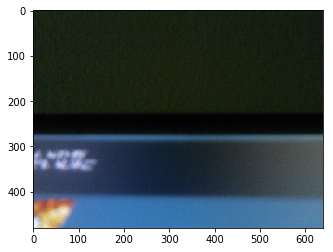

In [11]:
trainNet(AModel, n_epochs=1, learning_rate=0.00001)
torch.save(AModel,"DQClassifier50x50New.py")
imshow(test_set[5][0])

In [13]:
trainNet(AModel, n_epochs=5, learning_rate=0.00001)
torch.save(AModel,"DQClassifier50x50New.py")

===== HYPERPARAMETERS =====
epochs= 5
learning_rate= 1e-05


/home/aki/.local/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:122: UserWarning: nn.Upsampling is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.Upsampling is deprecated. Use nn.functional.interpolate instead.")


Validation loss = 0.00
Validation loss = 0.00
Validation loss = 0.00
Validation loss = 0.00
Validation loss = 0.00
Training finished, took 13.76s


/home/aki/.local/lib/python3.6/site-packages/torch/serialization.py:241: UserWarning: Couldn't retrieve source code for container of type SimpleCNN. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


In [ ]:
#CNN.forward(test_set[0][0])
train_loader = get_train_loader()
m = torch.nn.Upsample(size=(50,50))
for  data in val_loader:
    inputs, labels = data
    inputs = m(inputs)
#    inputs, labels = Variable(inputs), Variable(labels)
    imshow(inputs[0])
    print(AModel.forward(inputs)[0])
    print(labels)
    break
#    time.sleep(10)

In [ ]:
#%%timeit
m = torch.nn.Upsample(size=(50,50))
print(AModel.forward(m(torch.unsqueeze(test_set[101][0],0))).argmax()[0])
print(AModel.forward(m(torch.unsqueeze(test_set[101][0],0))))
imshow(m(torch.unsqueeze(test_set[101][0],0))[0])
print(test_set[101])

In [ ]:
print(torch.unsqueeze(test_set[0][0],0).shape)
test_set[0][0]
def cpRGBGray(x):
    y =np.zeros([3,480,640]) 
    y[0] = x
    y[1] = x
    y[2] = x
#    return y.astype(int)
    return y.astype(float)
    

In [ ]:
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import os
cap = cv2.VideoCapture(0)
m = torch.nn.Upsample(size=(50,50))
for i in range(1000):
    ret, frame = cap.read()
#    cv2.imwrite('/home/aki/Dropbox/DragonQuest5/Pics/pic_dark_non_'+str(i) + '.png',frame)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
     
    frame = torchvision.transforms.ToTensor()(frame)
#    print(frame)
#    frame = normalize(frame)
#    print(frame.shape)
    myInp = m(torch.unsqueeze(frame,0))
    val = AModel.forward(myInp).argmax()[0][0]
#    print(AModel.forward(myInp))
#    frame.div_(255)
    print(val.numpy(),AModel.forward(myInp))
    if val.numpy()== 0:
        arduinoData.write('0'.encode())
        pause(1)
    else:
        arduinoData.write('1'.encode())
        pause(1)
        

        
#    if(val.numpy() == 0):
#        os.system('play --no-show-progress --null --channels 1 synth %s sine %f' % (duration, freq))
    time.sleep(0.01)
#    print(AModel.forward(m(torch.unsqueeze(frame.float(),0))))
    if ret == True:
        imshow(myInp[0])
        if cv2.waitKey(1) & 0xFF==ord('q'):
            break
    else:
        break
        
cap.release()
cv2.destroyAllWindows()

In [ ]:
import cv2
import numpy as np
from PIL import Image


img = cv2.imread("path/to/img.png")

# You may need to convert the color.
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
im_pil = Image.fromarray(img)

# For reversing the operation:
im_np = np.asarray(im_pil)

# Take Pics

In [175]:
import numpy as np
import cv2
import time
cap = cv2.VideoCapture(0)
# take pictures N times
for i in range(100):
    ret, frame = cap.read()
    if ret == True:
        cv2.imwrite('/home/aki/Dropbox/DragonQuest5/Pics/pic_'+str(i) + '.png',frame)
        cv2.imshow('frame',frame)
        time.sleep(1)
        if cv2.waitKey(1) & 0xFF==ord('q'):
            break
    else:
        break
        
cap.release()
cv2.destroyAllWindows()

In [ ]:
# %load testArduino.py
import serial 

#serial.write(serialcmd.encode())
arduinoData = serial.Serial('/dev/serial/by-id/usb-Arduino__www.arduino.cc__0043_754333137393517061D0-if00', 9600)

arduinoData.write('0'.encode())

arduinoData.write('1'.encode())

## https://stackoverflow.com/questions/23669855/linux-pyserial-could-not-open-port-dev-ttyama0-no-such-file-or-directory
## https://www.youtube.com/watch?v=OleCp_TAXC8


In [ ]:
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import os
import serial
AModel = torch.load("DQClassifier50x50New.py")
cap = cv2.VideoCapture(0)
m = torch.nn.Upsample(size=(50,50))
##arduinoData = serial.Serial(
##    '/dev/serial/by-id/usb-Arduino__www.arduino.cc__0043_754333137393517061D0-if00'
##    , 9600, timeout=1.0)
##arduinoData = serial.Serial(
##    '/dev/ttyACM1'
##    , 9600, timeout=1.0)
i = 0
step = 0
while 1:
    print('step=',step)
    step += 1
    ret, frame = cap.read()
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
#    
#    ret, frame = cap.read()
#    if ret == True:
#        cv2.imwrite('/home/aki/Dropbox/DragonQuest5/Pics/pic_'+str(i) + '.png',frame)
#        cv2.imshow('frame',frame)
#        time.sleep(0.01)
#        i += 1
     
    frame = torchvision.transforms.ToTensor()(frame)
    myInp = m(torch.unsqueeze(frame,0))
    val = AModel.forward(myInp).argmax()[0][0]
##    arduinoData.write("8".encode())
##    time.sleep(1)
    print(val.numpy())
    if val.numpy()== 0:
##        arduinoData.write('a'.encode())
        os.system("echo \"b\" > /dev/ttyACM1")
##        arduinoData.write(0)
        time.sleep(0.35)
    else:
        os.system("echo \"a\" > /dev/ttyACM1")
##        arduinoData.write('b'.encode())
        time.sleep(0.35)
        
    print("EndStep")
    if ret == True:
        if cv2.waitKey(1) & 0xFF==ord('q'):
            break
    else:
        break
        
cap.release()
cv2.destroyAllWindows()

step= 0


/home/aki/.local/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:122: UserWarning: nn.Upsampling is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.Upsampling is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:33: UserWarning: invalid index of a 0-dim tensor. This will be an error in PyTorch 0.5. Use tensor.item() to convert a 0-dim tensor to a Python number


0
EndStep
step= 1
0
EndStep
step= 2
0
EndStep
step= 3
0
EndStep
step= 4
0
EndStep
step= 5
0
EndStep
step= 6
0
EndStep
step= 7
0
EndStep
step= 8
0
EndStep
step= 9
0
EndStep
step= 10
0
EndStep
step= 11
0
EndStep
step= 12
0
EndStep
step= 13
0
EndStep
step= 14
0
EndStep
step= 15
0
EndStep
step= 16
0
EndStep
step= 17
0
EndStep
step= 18
0
EndStep
step= 19
0
EndStep
step= 20
1
EndStep
step= 21
1
EndStep
step= 22
1
EndStep
step= 23
1
EndStep
step= 24
1
EndStep
step= 25
1
EndStep
step= 26
1
EndStep
step= 27
1
EndStep
step= 28
1
EndStep
step= 29
1
EndStep
step= 30
1
EndStep
step= 31
1
EndStep
step= 32
1
EndStep
step= 33
1
EndStep
step= 34
1
EndStep
step= 35
1
EndStep
step= 36
1
EndStep
step= 37
1
EndStep
step= 38
1
EndStep
step= 39
1
EndStep
step= 40
1
EndStep
step= 41
1
EndStep
step= 42
1
EndStep
step= 43
1
EndStep
step= 44
1
EndStep
step= 45
1
EndStep
step= 46
1
EndStep
step= 47
1
EndStep
step= 48
1
EndStep
step= 49
1
EndStep
step= 50
1
EndStep
step= 51
1
EndStep
step= 52
1
EndStep
step= 53
1


EndStep
step= 416
1
EndStep
step= 417
1
EndStep
step= 418
1
EndStep
step= 419
1
EndStep
step= 420
1
EndStep
step= 421
1
EndStep
step= 422
1
EndStep
step= 423
1
EndStep
step= 424
1
EndStep
step= 425
0
EndStep
step= 426
0
EndStep
step= 427
0
EndStep
step= 428
0
EndStep
step= 429
0
EndStep
step= 430
0
EndStep
step= 431
0
EndStep
step= 432
0
EndStep
step= 433
0
EndStep
step= 434
0
EndStep
step= 435
0
EndStep
step= 436
0
EndStep
step= 437
0
EndStep
step= 438
0
EndStep
step= 439
0
EndStep
step= 440
0
EndStep
step= 441
0
EndStep
step= 442
0
EndStep
step= 443
0
EndStep
step= 444
0
EndStep
step= 445
0
EndStep
step= 446
0
EndStep
step= 447
0
EndStep
step= 448
1
EndStep
step= 449
1
EndStep
step= 450
1
EndStep
step= 451
1
EndStep
step= 452
1
EndStep
step= 453
1
EndStep
step= 454
1
EndStep
step= 455
1
EndStep
step= 456
1
EndStep
step= 457
1
EndStep
step= 458
1
EndStep
step= 459
1
EndStep
step= 460
1
EndStep
step= 461
1
EndStep
step= 462
1
EndStep
step= 463
1
EndStep
step= 464
1
EndStep
step= 465
1


EndStep
step= 826
1
EndStep
step= 827
1
EndStep
step= 828
1
EndStep
step= 829
1
EndStep
step= 830
1
EndStep
step= 831
1
EndStep
step= 832
1
EndStep
step= 833
1
EndStep
step= 834
1
EndStep
step= 835
0
EndStep
step= 836
0
EndStep
step= 837
0
EndStep
step= 838
0
EndStep
step= 839
0
EndStep
step= 840
0
EndStep
step= 841
0
EndStep
step= 842
0
EndStep
step= 843
0
EndStep
step= 844
0
EndStep
step= 845
0
EndStep
step= 846
0
EndStep
step= 847
0
EndStep
step= 848
0
EndStep
step= 849
0
EndStep
step= 850
0
EndStep
step= 851
0
EndStep
step= 852
0
EndStep
step= 853
0
EndStep
step= 854
0
EndStep
step= 855
0
EndStep
step= 856
0
EndStep
step= 857
0
EndStep
step= 858
0
EndStep
step= 859
0
EndStep
step= 860
0
EndStep
step= 861
0
EndStep
step= 862
0
EndStep
step= 863
0
EndStep
step= 864
1
EndStep
step= 865
1
EndStep
step= 866
1
EndStep
step= 867
1
EndStep
step= 868
1
EndStep
step= 869
1
EndStep
step= 870
1
EndStep
step= 871
1
EndStep
step= 872
1
EndStep
step= 873
1
EndStep
step= 874
1
EndStep
step= 875
1


EndStep
step= 1225
0
EndStep
step= 1226
0
EndStep
step= 1227
0
EndStep
step= 1228
0
EndStep
step= 1229
0
EndStep
step= 1230
0
EndStep
step= 1231
0
EndStep
step= 1232
0
EndStep
step= 1233
0
EndStep
step= 1234
0
EndStep
step= 1235
0
EndStep
step= 1236
0
EndStep
step= 1237
0
EndStep
step= 1238
0
EndStep
step= 1239
0
EndStep
step= 1240
0
EndStep
step= 1241
0
EndStep
step= 1242
0
EndStep
step= 1243
0
EndStep
step= 1244
0
EndStep
step= 1245
0
EndStep
step= 1246
0
EndStep
step= 1247
0
EndStep
step= 1248
0
EndStep
step= 1249
0
EndStep
step= 1250
1
EndStep
step= 1251
1
EndStep
step= 1252
1
EndStep
step= 1253
1
EndStep
step= 1254
1
EndStep
step= 1255
1
EndStep
step= 1256
1
EndStep
step= 1257
1
EndStep
step= 1258
1
EndStep
step= 1259
1
EndStep
step= 1260
1
EndStep
step= 1261
1
EndStep
step= 1262
1
EndStep
step= 1263
1
EndStep
step= 1264
1
EndStep
step= 1265
1
EndStep
step= 1266
1
EndStep
step= 1267
1
EndStep
step= 1268
1
EndStep
step= 1269
1
EndStep
step= 1270
1
EndStep
step= 1271
1
EndStep
step=

EndStep
step= 1616
1
EndStep
step= 1617
1
EndStep
step= 1618
1
EndStep
step= 1619
1
EndStep
step= 1620
1
EndStep
step= 1621
1
EndStep
step= 1622
1
EndStep
step= 1623
1
EndStep
step= 1624
1
EndStep
step= 1625
1
EndStep
step= 1626
1
EndStep
step= 1627
1
EndStep
step= 1628
1
EndStep
step= 1629
1
EndStep
step= 1630
1
EndStep
step= 1631
1
EndStep
step= 1632
1
EndStep
step= 1633
0
EndStep
step= 1634
0
EndStep
step= 1635
0
EndStep
step= 1636
0
EndStep
step= 1637
0
EndStep
step= 1638
0
EndStep
step= 1639
0
EndStep
step= 1640
0
EndStep
step= 1641
0
EndStep
step= 1642
0
EndStep
step= 1643
0
EndStep
step= 1644
0
EndStep
step= 1645
0
EndStep
step= 1646
0
EndStep
step= 1647
0
EndStep
step= 1648
0
EndStep
step= 1649
0
EndStep
step= 1650
0
EndStep
step= 1651
0
EndStep
step= 1652
0
EndStep
step= 1653
0
EndStep
step= 1654
0
EndStep
step= 1655
0
EndStep
step= 1656
0
EndStep
step= 1657
0
EndStep
step= 1658
0
EndStep
step= 1659
0
EndStep
step= 1660
1
EndStep
step= 1661
1
EndStep
step= 1662
1
EndStep
step=

EndStep
step= 2007
1
EndStep
step= 2008
1
EndStep
step= 2009
1
EndStep
step= 2010
1
EndStep
step= 2011
1
EndStep
step= 2012
1
EndStep
step= 2013
1
EndStep
step= 2014
1
EndStep
step= 2015
1
EndStep
step= 2016
1
EndStep
step= 2017
1
EndStep
step= 2018
1
EndStep
step= 2019
1
EndStep
step= 2020
0
EndStep
step= 2021
0
EndStep
step= 2022
0
EndStep
step= 2023
0
EndStep
step= 2024
0
EndStep
step= 2025
0
EndStep
step= 2026
0
EndStep
step= 2027
0
EndStep
step= 2028
0
EndStep
step= 2029
0
EndStep
step= 2030
0
EndStep
step= 2031
0
EndStep
step= 2032
0
EndStep
step= 2033
0
EndStep
step= 2034
0
EndStep
step= 2035
1
EndStep
step= 2036
1
EndStep
step= 2037
1
EndStep
step= 2038
1
EndStep
step= 2039
1
EndStep
step= 2040
1
EndStep
step= 2041
1
EndStep
step= 2042
1
EndStep
step= 2043
1
EndStep
step= 2044
1
EndStep
step= 2045
1
EndStep
step= 2046
1
EndStep
step= 2047
1
EndStep
step= 2048
1
EndStep
step= 2049
1
EndStep
step= 2050
1
EndStep
step= 2051
1
EndStep
step= 2052
1
EndStep
step= 2053
1
EndStep
step=

EndStep
step= 2398
1
EndStep
step= 2399
1
EndStep
step= 2400
1
EndStep
step= 2401
1
EndStep
step= 2402
1
EndStep
step= 2403
1
EndStep
step= 2404
1
EndStep
step= 2405
1
EndStep
step= 2406
1
EndStep
step= 2407
1
EndStep
step= 2408
1
EndStep
step= 2409
1
EndStep
step= 2410
1
EndStep
step= 2411
1
EndStep
step= 2412
1
EndStep
step= 2413
1
EndStep
step= 2414
1
EndStep
step= 2415
1
EndStep
step= 2416
1
EndStep
step= 2417
1
EndStep
step= 2418
1
EndStep
step= 2419
1
EndStep
step= 2420
1
EndStep
step= 2421
0
EndStep
step= 2422
0
EndStep
step= 2423
0
EndStep
step= 2424
0
EndStep
step= 2425
0
EndStep
step= 2426
0
EndStep
step= 2427
0
EndStep
step= 2428
0
EndStep
step= 2429
0
EndStep
step= 2430
0
EndStep
step= 2431
0
EndStep
step= 2432
0
EndStep
step= 2433
0
EndStep
step= 2434
0
EndStep
step= 2435
0
EndStep
step= 2436
0
EndStep
step= 2437
0
EndStep
step= 2438
1
EndStep
step= 2439
1
EndStep
step= 2440
1
EndStep
step= 2441
1
EndStep
step= 2442
1
EndStep
step= 2443
1
EndStep
step= 2444
1
EndStep
step=

EndStep
step= 2789
0
EndStep
step= 2790
0
EndStep
step= 2791
0
EndStep
step= 2792
0
EndStep
step= 2793
0
EndStep
step= 2794
0
EndStep
step= 2795
0
EndStep
step= 2796
0
EndStep
step= 2797
0
EndStep
step= 2798
0
EndStep
step= 2799
0
EndStep
step= 2800
0
EndStep
step= 2801
0
EndStep
step= 2802
0
EndStep
step= 2803
0
EndStep
step= 2804
0
EndStep
step= 2805
1
EndStep
step= 2806
1
EndStep
step= 2807
1
EndStep
step= 2808
1
EndStep
step= 2809
1
EndStep
step= 2810
1
EndStep
step= 2811
1
EndStep
step= 2812
1
EndStep
step= 2813
1
EndStep
step= 2814
1
EndStep
step= 2815
1
EndStep
step= 2816
1
EndStep
step= 2817
1
EndStep
step= 2818
1
EndStep
step= 2819
1
EndStep
step= 2820
1
EndStep
step= 2821
1
EndStep
step= 2822
1
EndStep
step= 2823
1
EndStep
step= 2824
1
EndStep
step= 2825
1
EndStep
step= 2826
1
EndStep
step= 2827
1
EndStep
step= 2828
1
EndStep
step= 2829
1
EndStep
step= 2830
1
EndStep
step= 2831
0
EndStep
step= 2832
0
EndStep
step= 2833
0
EndStep
step= 2834
0
EndStep
step= 2835
0
EndStep
step=

EndStep
step= 3180
1
EndStep
step= 3181
1
EndStep
step= 3182
1
EndStep
step= 3183
1
EndStep
step= 3184
1
EndStep
step= 3185
1
EndStep
step= 3186
1
EndStep
step= 3187
1
EndStep
step= 3188
1
EndStep
step= 3189
1
EndStep
step= 3190
1
EndStep
step= 3191
1
EndStep
step= 3192
1
EndStep
step= 3193
0
EndStep
step= 3194
0
EndStep
step= 3195
0
EndStep
step= 3196
0
EndStep
step= 3197
0
EndStep
step= 3198
0
EndStep
step= 3199
0
EndStep
step= 3200
0
EndStep
step= 3201
0
EndStep
step= 3202
0
EndStep
step= 3203
0
EndStep
step= 3204
0
EndStep
step= 3205
0
EndStep
step= 3206
0
EndStep
step= 3207
0
EndStep
step= 3208
0
EndStep
step= 3209
0
EndStep
step= 3210
0
EndStep
step= 3211
0
EndStep
step= 3212
0
EndStep
step= 3213
0
EndStep
step= 3214
0
EndStep
step= 3215
0
EndStep
step= 3216
1
EndStep
step= 3217
1
EndStep
step= 3218
1
EndStep
step= 3219
1
EndStep
step= 3220
1
EndStep
step= 3221
1
EndStep
step= 3222
1
EndStep
step= 3223
1
EndStep
step= 3224
1
EndStep
step= 3225
1
EndStep
step= 3226
1
EndStep
step=

EndStep
step= 3571
0
EndStep
step= 3572
0
EndStep
step= 3573
0
EndStep
step= 3574
0
EndStep
step= 3575
0
EndStep
step= 3576
0
EndStep
step= 3577
0
EndStep
step= 3578
0
EndStep
step= 3579
0
EndStep
step= 3580
0
EndStep
step= 3581
0
EndStep
step= 3582
0
EndStep
step= 3583
1
EndStep
step= 3584
1
EndStep
step= 3585
1
EndStep
step= 3586
1
EndStep
step= 3587
1
EndStep
step= 3588
1
EndStep
step= 3589
1
EndStep
step= 3590
1
EndStep
step= 3591
1
EndStep
step= 3592
1
EndStep
step= 3593
1
EndStep
step= 3594
1
EndStep
step= 3595
1
EndStep
step= 3596
1
EndStep
step= 3597
1
EndStep
step= 3598
1
EndStep
step= 3599
1
EndStep
step= 3600
1
EndStep
step= 3601
1
EndStep
step= 3602
1
EndStep
step= 3603
1
EndStep
step= 3604
1
EndStep
step= 3605
1
EndStep
step= 3606
1
EndStep
step= 3607
1
EndStep
step= 3608
1
EndStep
step= 3609
0
EndStep
step= 3610
0
EndStep
step= 3611
0
EndStep
step= 3612
0
EndStep
step= 3613
0
EndStep
step= 3614
0
EndStep
step= 3615
0
EndStep
step= 3616
0
EndStep
step= 3617
0
EndStep
step=

EndStep
step= 3962
1
EndStep
step= 3963
1
EndStep
step= 3964
1
EndStep
step= 3965
1
EndStep
step= 3966
1
EndStep
step= 3967
1
EndStep
step= 3968
1
EndStep
step= 3969
1
EndStep
step= 3970
1
EndStep
step= 3971
1
EndStep
step= 3972
0
EndStep
step= 3973
0
EndStep
step= 3974
0
EndStep
step= 3975
0
EndStep
step= 3976
0
EndStep
step= 3977
0
EndStep
step= 3978
0
EndStep
step= 3979
0
EndStep
step= 3980
0
EndStep
step= 3981
0
EndStep
step= 3982
0
EndStep
step= 3983
0
EndStep
step= 3984
0
EndStep
step= 3985
0
EndStep
step= 3986
0
EndStep
step= 3987
0
EndStep
step= 3988
0
EndStep
step= 3989
0
EndStep
step= 3990
0
EndStep
step= 3991
0
EndStep
step= 3992
0
EndStep
step= 3993
0
EndStep
step= 3994
0
EndStep
step= 3995
0
EndStep
step= 3996
0
EndStep
step= 3997
0
EndStep
step= 3998
1
EndStep
step= 3999
1
EndStep
step= 4000
1
EndStep
step= 4001
1
EndStep
step= 4002
1
EndStep
step= 4003
1
EndStep
step= 4004
1
EndStep
step= 4005
1
EndStep
step= 4006
1
EndStep
step= 4007
1
EndStep
step= 4008
1
EndStep
step=

EndStep
step= 4353
0
EndStep
step= 4354
0
EndStep
step= 4355
0
EndStep
step= 4356
0
EndStep
step= 4357
0
EndStep
step= 4358
0
EndStep
step= 4359
0
EndStep
step= 4360
0
EndStep
step= 4361
0
EndStep
step= 4362
0
EndStep
step= 4363
0
EndStep
step= 4364
0
EndStep
step= 4365
0
EndStep
step= 4366
0
EndStep
step= 4367
0
EndStep
step= 4368
1
EndStep
step= 4369
1
EndStep
step= 4370
1
EndStep
step= 4371
1
EndStep
step= 4372
1
EndStep
step= 4373
1
EndStep
step= 4374
1
EndStep
step= 4375
1
EndStep
step= 4376
1
EndStep
step= 4377
1
EndStep
step= 4378
1
EndStep
step= 4379
1
EndStep
step= 4380
1
EndStep
step= 4381
1
EndStep
step= 4382
1
EndStep
step= 4383
1
EndStep
step= 4384
1
EndStep
step= 4385
1
EndStep
step= 4386
1
EndStep
step= 4387
1
EndStep
step= 4388
1
EndStep
step= 4389
1
EndStep
step= 4390
1
EndStep
step= 4391
1
EndStep
step= 4392
1
EndStep
step= 4393
1
EndStep
step= 4394
1
EndStep
step= 4395
1
EndStep
step= 4396
1
EndStep
step= 4397
0
EndStep
step= 4398
0
EndStep
step= 4399
0
EndStep
step=

EndStep
step= 4744
1
EndStep
step= 4745
1
EndStep
step= 4746
1
EndStep
step= 4747
1
EndStep
step= 4748
1
EndStep
step= 4749
1
EndStep
step= 4750
1
EndStep
step= 4751
1
EndStep
step= 4752
1
EndStep
step= 4753
1
EndStep
step= 4754
1
EndStep
step= 4755
1
EndStep
step= 4756
1
EndStep
step= 4757
1
EndStep
step= 4758
1
EndStep
step= 4759
1
EndStep
step= 4760
1
EndStep
step= 4761
1
EndStep
step= 4762
1
EndStep
step= 4763
1
EndStep
step= 4764
1
EndStep
step= 4765
1
EndStep
step= 4766
0
EndStep
step= 4767
0
EndStep
step= 4768
0
EndStep
step= 4769
0
EndStep
step= 4770
0
EndStep
step= 4771
0
EndStep
step= 4772
0
EndStep
step= 4773
0
EndStep
step= 4774
0
EndStep
step= 4775
0
EndStep
step= 4776
0
EndStep
step= 4777
0
EndStep
step= 4778
0
EndStep
step= 4779
0
EndStep
step= 4780
0
EndStep
step= 4781
0
EndStep
step= 4782
0
EndStep
step= 4783
0
EndStep
step= 4784
0
EndStep
step= 4785
0
EndStep
step= 4786
0
EndStep
step= 4787
0
EndStep
step= 4788
0
EndStep
step= 4789
0
EndStep
step= 4790
0
EndStep
step=

EndStep
step= 5135
1
EndStep
step= 5136
1
EndStep
step= 5137
1
EndStep
step= 5138
1
EndStep
step= 5139
1
EndStep
step= 5140
1
EndStep
step= 5141
1
EndStep
step= 5142
1
EndStep
step= 5143
1
EndStep
step= 5144
1
EndStep
step= 5145
1
EndStep
step= 5146
1
EndStep
step= 5147
1
EndStep
step= 5148
1
EndStep
step= 5149
0
EndStep
step= 5150
0
EndStep
step= 5151
0
EndStep
step= 5152
0
EndStep
step= 5153
0
EndStep
step= 5154
0
EndStep
step= 5155
0
EndStep
step= 5156
0
EndStep
step= 5157
0
EndStep
step= 5158
0
EndStep
step= 5159
0
EndStep
step= 5160
0
EndStep
step= 5161
0
EndStep
step= 5162
0
EndStep
step= 5163
0
EndStep
step= 5164
0
EndStep
step= 5165
0
EndStep
step= 5166
0
EndStep
step= 5167
0
EndStep
step= 5168
0
EndStep
step= 5169
0
EndStep
step= 5170
0
EndStep
step= 5171
0
EndStep
step= 5172
0
EndStep
step= 5173
0
EndStep
step= 5174
0
EndStep
step= 5175
0
EndStep
step= 5176
0
EndStep
step= 5177
0
EndStep
step= 5178
0
EndStep
step= 5179
0
EndStep
step= 5180
0
EndStep
step= 5181
1
EndStep
step=

EndStep
step= 5526
1
EndStep
step= 5527
1
EndStep
step= 5528
1
EndStep
step= 5529
1
EndStep
step= 5530
1
EndStep
step= 5531
1
EndStep
step= 5532
1
EndStep
step= 5533
1
EndStep
step= 5534
1
EndStep
step= 5535
1
EndStep
step= 5536
1
EndStep
step= 5537
1
EndStep
step= 5538
1
EndStep
step= 5539
1
EndStep
step= 5540
1
EndStep
step= 5541
1
EndStep
step= 5542
1
EndStep
step= 5543
1
EndStep
step= 5544
1
EndStep
step= 5545
1
EndStep
step= 5546
1
EndStep
step= 5547
1
EndStep
step= 5548
1
EndStep
step= 5549
1
EndStep
step= 5550
1
EndStep
step= 5551
1
EndStep
step= 5552
1
EndStep
step= 5553
1
EndStep
step= 5554
1
EndStep
step= 5555
1
EndStep
step= 5556
1
EndStep
step= 5557
1
EndStep
step= 5558
1
EndStep
step= 5559
1
EndStep
step= 5560
1
EndStep
step= 5561
1
EndStep
step= 5562
1
EndStep
step= 5563
0
EndStep
step= 5564
0
EndStep
step= 5565
0
EndStep
step= 5566
0
EndStep
step= 5567
0
EndStep
step= 5568
0
EndStep
step= 5569
0
EndStep
step= 5570
0
EndStep
step= 5571
0
EndStep
step= 5572
0
EndStep
step=

EndStep
step= 5917
0
EndStep
step= 5918
0
EndStep
step= 5919
0
EndStep
step= 5920
0
EndStep
step= 5921
0
EndStep
step= 5922
0
EndStep
step= 5923
0
EndStep
step= 5924
0
EndStep
step= 5925
0
EndStep
step= 5926
0
EndStep
step= 5927
0
EndStep
step= 5928
0
EndStep
step= 5929
0
EndStep
step= 5930
0
EndStep
step= 5931
0
EndStep
step= 5932
0
EndStep
step= 5933
1
EndStep
step= 5934
1
EndStep
step= 5935
1
EndStep
step= 5936
1
EndStep
step= 5937
1
EndStep
step= 5938
1
EndStep
step= 5939
1
EndStep
step= 5940
1
EndStep
step= 5941
1
EndStep
step= 5942
1
EndStep
step= 5943
1
EndStep
step= 5944
1
EndStep
step= 5945
1
EndStep
step= 5946
1
EndStep
step= 5947
1
EndStep
step= 5948
1
EndStep
step= 5949
1
EndStep
step= 5950
1
EndStep
step= 5951
1
EndStep
step= 5952
1
EndStep
step= 5953
1
EndStep
step= 5954
1
EndStep
step= 5955
1
EndStep
step= 5956
1
EndStep
step= 5957
1
EndStep
step= 5958
1
EndStep
step= 5959
1
EndStep
step= 5960
1
EndStep
step= 5961
1
EndStep
step= 5962
1
EndStep
step= 5963
1
EndStep
step=

EndStep
step= 6308
1
EndStep
step= 6309
1
EndStep
step= 6310
1
EndStep
step= 6311
1
EndStep
step= 6312
1
EndStep
step= 6313
1
EndStep
step= 6314
1
EndStep
step= 6315
1
EndStep
step= 6316
1
EndStep
step= 6317
1
EndStep
step= 6318
1
EndStep
step= 6319
1
EndStep
step= 6320
1
EndStep
step= 6321
1
EndStep
step= 6322
1
EndStep
step= 6323
1
EndStep
step= 6324
1
EndStep
step= 6325
1
EndStep
step= 6326
1
EndStep
step= 6327
1
EndStep
step= 6328
0
EndStep
step= 6329
0
EndStep
step= 6330
0
EndStep
step= 6331
0
EndStep
step= 6332
0
EndStep
step= 6333
0
EndStep
step= 6334
0
EndStep
step= 6335
0
EndStep
step= 6336
0
EndStep
step= 6337
0
EndStep
step= 6338
0
EndStep
step= 6339
0
EndStep
step= 6340
0
EndStep
step= 6341
0
EndStep
step= 6342
0
EndStep
step= 6343
0
EndStep
step= 6344
0
EndStep
step= 6345
0
EndStep
step= 6346
0
EndStep
step= 6347
0
EndStep
step= 6348
0
EndStep
step= 6349
0
EndStep
step= 6350
0
EndStep
step= 6351
0
EndStep
step= 6352
0
EndStep
step= 6353
0
EndStep
step= 6354
0
EndStep
step=

EndStep
step= 6699
1
EndStep
step= 6700
1
EndStep
step= 6701
1
EndStep
step= 6702
1
EndStep
step= 6703
1
EndStep
step= 6704
0
EndStep
step= 6705
0
EndStep
step= 6706
0
EndStep
step= 6707
0
EndStep
step= 6708
0
EndStep
step= 6709
0
EndStep
step= 6710
0
EndStep
step= 6711
0
EndStep
step= 6712
0
EndStep
step= 6713
0
EndStep
step= 6714
0
EndStep
step= 6715
0
EndStep
step= 6716
0
EndStep
step= 6717
0
EndStep
step= 6718
0
EndStep
step= 6719
0
EndStep
step= 6720
0
EndStep
step= 6721
0
EndStep
step= 6722
0
EndStep
step= 6723
0
EndStep
step= 6724
0
EndStep
step= 6725
0
EndStep
step= 6726
0
EndStep
step= 6727
0
EndStep
step= 6728
0
EndStep
step= 6729
0
EndStep
step= 6730
0
EndStep
step= 6731
0
EndStep
step= 6732
0
EndStep
step= 6733
1
EndStep
step= 6734
1
EndStep
step= 6735
1
EndStep
step= 6736
1
EndStep
step= 6737
1
EndStep
step= 6738
1
EndStep
step= 6739
1
EndStep
step= 6740
1
EndStep
step= 6741
1
EndStep
step= 6742
1
EndStep
step= 6743
1
EndStep
step= 6744
1
EndStep
step= 6745
1
EndStep
step=

EndStep
step= 7090
0
EndStep
step= 7091
0
EndStep
step= 7092
0
EndStep
step= 7093
0
EndStep
step= 7094
0
EndStep
step= 7095
0
EndStep
step= 7096
0
EndStep
step= 7097
0
EndStep
step= 7098
0
EndStep
step= 7099
0
EndStep
step= 7100
0
EndStep
step= 7101
0
EndStep
step= 7102
0
EndStep
step= 7103
0
EndStep
step= 7104
0
EndStep
step= 7105
0
EndStep
step= 7106
1
EndStep
step= 7107
1
EndStep
step= 7108
1
EndStep
step= 7109
1
EndStep
step= 7110
1
EndStep
step= 7111
1
EndStep
step= 7112
1
EndStep
step= 7113
1
EndStep
step= 7114
1
EndStep
step= 7115
1
EndStep
step= 7116
1
EndStep
step= 7117
1
EndStep
step= 7118
1
EndStep
step= 7119
1
EndStep
step= 7120
1
EndStep
step= 7121
1
EndStep
step= 7122
1
EndStep
step= 7123
1
EndStep
step= 7124
1
EndStep
step= 7125
1
EndStep
step= 7126
1
EndStep
step= 7127
1
EndStep
step= 7128
1
EndStep
step= 7129
1
EndStep
step= 7130
1
EndStep
step= 7131
1
EndStep
step= 7132
1
EndStep
step= 7133
1
EndStep
step= 7134
1
EndStep
step= 7135
1
EndStep
step= 7136
1
EndStep
step=

EndStep
step= 7481
0
EndStep
step= 7482
1
EndStep
step= 7483
1
EndStep
step= 7484
1
EndStep
step= 7485
1
EndStep
step= 7486
1
EndStep
step= 7487
1
EndStep
step= 7488
1
EndStep
step= 7489
1
EndStep
step= 7490
1
EndStep
step= 7491
1
EndStep
step= 7492
1
EndStep
step= 7493
1
EndStep
step= 7494
1
EndStep
step= 7495
1
EndStep
step= 7496
1
EndStep
step= 7497
1
EndStep
step= 7498
1
EndStep
step= 7499
1
EndStep
step= 7500
1
EndStep
step= 7501
1
EndStep
step= 7502
1
EndStep
step= 7503
1
EndStep
step= 7504
1
EndStep
step= 7505
1
EndStep
step= 7506
1
EndStep
step= 7507
1
EndStep
step= 7508
0
EndStep
step= 7509
0
EndStep
step= 7510
0
EndStep
step= 7511
0
EndStep
step= 7512
0
EndStep
step= 7513
0
EndStep
step= 7514
0
EndStep
step= 7515
0
EndStep
step= 7516
0
EndStep
step= 7517
0
EndStep
step= 7518
0
EndStep
step= 7519
0
EndStep
step= 7520
0
EndStep
step= 7521
0
EndStep
step= 7522
0
EndStep
step= 7523
0
EndStep
step= 7524
0
EndStep
step= 7525
0
EndStep
step= 7526
0
EndStep
step= 7527
0
EndStep
step=

EndStep
step= 7872
1
EndStep
step= 7873
1
EndStep
step= 7874
1
EndStep
step= 7875
1
EndStep
step= 7876
1
EndStep
step= 7877
1
EndStep
step= 7878
1
EndStep
step= 7879
0
EndStep
step= 7880
0
EndStep
step= 7881
0
EndStep
step= 7882
0
EndStep
step= 7883
0
EndStep
step= 7884
0
EndStep
step= 7885
0
EndStep
step= 7886
0
EndStep
step= 7887
0
EndStep
step= 7888
0
EndStep
step= 7889
0
EndStep
step= 7890
0
EndStep
step= 7891
0
EndStep
step= 7892
0
EndStep
step= 7893
0
EndStep
step= 7894
0
EndStep
step= 7895
0
EndStep
step= 7896
0
EndStep
step= 7897
0
EndStep
step= 7898
0
EndStep
step= 7899
0
EndStep
step= 7900
0
EndStep
step= 7901
0
EndStep
step= 7902
0
EndStep
step= 7903
0
EndStep
step= 7904
0
EndStep
step= 7905
0
EndStep
step= 7906
0
EndStep
step= 7907
1
EndStep
step= 7908
1
EndStep
step= 7909
1
EndStep
step= 7910
1
EndStep
step= 7911
1
EndStep
step= 7912
1
EndStep
step= 7913
1
EndStep
step= 7914
1
EndStep
step= 7915
1
EndStep
step= 7916
1
EndStep
step= 7917
1
EndStep
step= 7918
1
EndStep
step=

EndStep
step= 8263
0
EndStep
step= 8264
0
EndStep
step= 8265
0
EndStep
step= 8266
0
EndStep
step= 8267
0
EndStep
step= 8268
0
EndStep
step= 8269
0
EndStep
step= 8270
0
EndStep
step= 8271
0
EndStep
step= 8272
0
EndStep
step= 8273
0
EndStep
step= 8274
0
EndStep
step= 8275
0
EndStep
step= 8276
0
EndStep
step= 8277
0
EndStep
step= 8278
0
EndStep
step= 8279
0
EndStep
step= 8280
0
EndStep
step= 8281
0
EndStep
step= 8282
0
EndStep
step= 8283
0
EndStep
step= 8284
0
EndStep
step= 8285
0
EndStep
step= 8286
0
EndStep
step= 8287
1
EndStep
step= 8288
1
EndStep
step= 8289
1
EndStep
step= 8290
1
EndStep
step= 8291
1
EndStep
step= 8292
1
EndStep
step= 8293
1
EndStep
step= 8294
1
EndStep
step= 8295
1
EndStep
step= 8296
1
EndStep
step= 8297
1
EndStep
step= 8298
1
EndStep
step= 8299
1
EndStep
step= 8300
1
EndStep
step= 8301
1
EndStep
step= 8302
1
EndStep
step= 8303
1
EndStep
step= 8304
1
EndStep
step= 8305
1
EndStep
step= 8306
1
EndStep
step= 8307
1
EndStep
step= 8308
1
EndStep
step= 8309
1
EndStep
step=

EndStep
step= 8654
0
EndStep
step= 8655
0
EndStep
step= 8656
0
EndStep
step= 8657
0
EndStep
step= 8658
0
EndStep
step= 8659
0
EndStep
step= 8660
0
EndStep
step= 8661
0
EndStep
step= 8662
0
EndStep
step= 8663
0
EndStep
step= 8664
0
EndStep
step= 8665
0
EndStep
step= 8666
0
EndStep
step= 8667
0
EndStep
step= 8668
0
EndStep
step= 8669
0
EndStep
step= 8670
0
EndStep
step= 8671
0
EndStep
step= 8672
0
EndStep
step= 8673
0
EndStep
step= 8674
1
EndStep
step= 8675
1
EndStep
step= 8676
1
EndStep
step= 8677
1
EndStep
step= 8678
1
EndStep
step= 8679
1
EndStep
step= 8680
1
EndStep
step= 8681
1
EndStep
step= 8682
1
EndStep
step= 8683
1
EndStep
step= 8684
1
EndStep
step= 8685
1
EndStep
step= 8686
1
EndStep
step= 8687
1
EndStep
step= 8688
1
EndStep
step= 8689
1
EndStep
step= 8690
1
EndStep
step= 8691
1
EndStep
step= 8692
1
EndStep
step= 8693
1
EndStep
step= 8694
1
EndStep
step= 8695
1
EndStep
step= 8696
1
EndStep
step= 8697
1
EndStep
step= 8698
1
EndStep
step= 8699
1
EndStep
step= 8700
1
EndStep
step=

EndStep
step= 9045
0
EndStep
step= 9046
0
EndStep
step= 9047
0
EndStep
step= 9048
1
EndStep
step= 9049
1
EndStep
step= 9050
1
EndStep
step= 9051
1
EndStep
step= 9052
1
EndStep
step= 9053
1
EndStep
step= 9054
1
EndStep
step= 9055
1
EndStep
step= 9056
1
EndStep
step= 9057
1
EndStep
step= 9058
1
EndStep
step= 9059
1
EndStep
step= 9060
1
EndStep
step= 9061
1
EndStep
step= 9062
1
EndStep
step= 9063
1
EndStep
step= 9064
1
EndStep
step= 9065
1
EndStep
step= 9066
1
EndStep
step= 9067
1
EndStep
step= 9068
1
EndStep
step= 9069
1
EndStep
step= 9070
1
EndStep
step= 9071
1
EndStep
step= 9072
1
EndStep
step= 9073
1
EndStep
step= 9074
1
EndStep
step= 9075
0
EndStep
step= 9076
0
EndStep
step= 9077
0
EndStep
step= 9078
0
EndStep
step= 9079
0
EndStep
step= 9080
0
EndStep
step= 9081
0
EndStep
step= 9082
0
EndStep
step= 9083
0
EndStep
step= 9084
0
EndStep
step= 9085
0
EndStep
step= 9086
0
EndStep
step= 9087
0
EndStep
step= 9088
0
EndStep
step= 9089
0
EndStep
step= 9090
0
EndStep
step= 9091
0
EndStep
step=

EndStep
step= 9436
1
EndStep
step= 9437
1
EndStep
step= 9438
1
EndStep
step= 9439
1
EndStep
step= 9440
1
EndStep
step= 9441
0
EndStep
step= 9442
0
EndStep
step= 9443
0
EndStep
step= 9444
0
EndStep
step= 9445
0
EndStep
step= 9446
0
EndStep
step= 9447
0
EndStep
step= 9448
0
EndStep
step= 9449
0
EndStep
step= 9450
0
EndStep
step= 9451
0
EndStep
step= 9452
0
EndStep
step= 9453
0
EndStep
step= 9454
0
EndStep
step= 9455
0
EndStep
step= 9456
0
EndStep
step= 9457
0
EndStep
step= 9458
0
EndStep
step= 9459
0
EndStep
step= 9460
0
EndStep
step= 9461
0
EndStep
step= 9462
0
EndStep
step= 9463
0
EndStep
step= 9464
0
EndStep
step= 9465
0
EndStep
step= 9466
0
EndStep
step= 9467
0
EndStep
step= 9468
0
EndStep
step= 9469
0
EndStep
step= 9470
0
EndStep
step= 9471
0
EndStep
step= 9472
0
EndStep
step= 9473
1
EndStep
step= 9474
1
EndStep
step= 9475
1
EndStep
step= 9476
1
EndStep
step= 9477
1
EndStep
step= 9478
1
EndStep
step= 9479
1
EndStep
step= 9480
1
EndStep
step= 9481
1
EndStep
step= 9482
1
EndStep
step=

EndStep
step= 9827
1
EndStep
step= 9828
1
EndStep
step= 9829
1
EndStep
step= 9830
1
EndStep
step= 9831
1
EndStep
step= 9832
1
EndStep
step= 9833
1
EndStep
step= 9834
0
EndStep
step= 9835
0
EndStep
step= 9836
0
EndStep
step= 9837
0
EndStep
step= 9838
0
EndStep
step= 9839
0
EndStep
step= 9840
0
EndStep
step= 9841
0
EndStep
step= 9842
0
EndStep
step= 9843
0
EndStep
step= 9844
0
EndStep
step= 9845
0
EndStep
step= 9846
0
EndStep
step= 9847
0
EndStep
step= 9848
0
EndStep
step= 9849
0
EndStep
step= 9850
0
EndStep
step= 9851
0
EndStep
step= 9852
0
EndStep
step= 9853
0
EndStep
step= 9854
0
EndStep
step= 9855
0
EndStep
step= 9856
0
EndStep
step= 9857
0
EndStep
step= 9858
0
EndStep
step= 9859
0
EndStep
step= 9860
0
EndStep
step= 9861
0
EndStep
step= 9862
0
EndStep
step= 9863
1
EndStep
step= 9864
1
EndStep
step= 9865
1
EndStep
step= 9866
1
EndStep
step= 9867
1
EndStep
step= 9868
1
EndStep
step= 9869
1
EndStep
step= 9870
1
EndStep
step= 9871
1
EndStep
step= 9872
1
EndStep
step= 9873
1
EndStep
step=

EndStep
step= 10208
1
EndStep
step= 10209
1
EndStep
step= 10210
1
EndStep
step= 10211
1
EndStep
step= 10212
1
EndStep
step= 10213
1
EndStep
step= 10214
1
EndStep
step= 10215
1
EndStep
step= 10216
1
EndStep
step= 10217
1
EndStep
step= 10218
1
EndStep
step= 10219
1
EndStep
step= 10220
1
EndStep
step= 10221
1
EndStep
step= 10222
1
EndStep
step= 10223
1
EndStep
step= 10224
1
EndStep
step= 10225
1
EndStep
step= 10226
1
EndStep
step= 10227
1
EndStep
step= 10228
1
EndStep
step= 10229
1
EndStep
step= 10230
1
EndStep
step= 10231
1
EndStep
step= 10232
1
EndStep
step= 10233
1
EndStep
step= 10234
1
EndStep
step= 10235
1
EndStep
step= 10236
1
EndStep
step= 10237
1
EndStep
step= 10238
1
EndStep
step= 10239
1
EndStep
step= 10240
1
EndStep
step= 10241
1
EndStep
step= 10242
1
EndStep
step= 10243
1
EndStep
step= 10244
1
EndStep
step= 10245
1
EndStep
step= 10246
1
EndStep
step= 10247
1
EndStep
step= 10248
1
EndStep
step= 10249
1
EndStep
step= 10250
1
EndStep
step= 10251
1
EndStep
step= 10252
1
EndStep
st

EndStep
step= 10581
1
EndStep
step= 10582
1
EndStep
step= 10583
1
EndStep
step= 10584
1
EndStep
step= 10585
1
EndStep
step= 10586
1
EndStep
step= 10587
1
EndStep
step= 10588
1
EndStep
step= 10589
1
EndStep
step= 10590
1
EndStep
step= 10591
1
EndStep
step= 10592
1
EndStep
step= 10593
1
EndStep
step= 10594
1
EndStep
step= 10595
1
EndStep
step= 10596
1
EndStep
step= 10597
1
EndStep
step= 10598
1
EndStep
step= 10599
1
EndStep
step= 10600
0
EndStep
step= 10601
0
EndStep
step= 10602
0
EndStep
step= 10603
0
EndStep
step= 10604
0
EndStep
step= 10605
0
EndStep
step= 10606
0
EndStep
step= 10607
0
EndStep
step= 10608
0
EndStep
step= 10609
0
EndStep
step= 10610
0
EndStep
step= 10611
0
EndStep
step= 10612
0
EndStep
step= 10613
0
EndStep
step= 10614
0
EndStep
step= 10615
0
EndStep
step= 10616
0
EndStep
step= 10617
0
EndStep
step= 10618
0
EndStep
step= 10619
0
EndStep
step= 10620
0
EndStep
step= 10621
0
EndStep
step= 10622
0
EndStep
step= 10623
0
EndStep
step= 10624
0
EndStep
step= 10625
0
EndStep
st

EndStep
step= 10954
1
EndStep
step= 10955
1
EndStep
step= 10956
1
EndStep
step= 10957
1
EndStep
step= 10958
1
EndStep
step= 10959
1
EndStep
step= 10960
1
EndStep
step= 10961
1
EndStep
step= 10962
1
EndStep
step= 10963
1
EndStep
step= 10964
1
EndStep
step= 10965
1
EndStep
step= 10966
1
EndStep
step= 10967
1
EndStep
step= 10968
1
EndStep
step= 10969
1
EndStep
step= 10970
1
EndStep
step= 10971
1
EndStep
step= 10972
0
EndStep
step= 10973
0
EndStep
step= 10974
0
EndStep
step= 10975
0
EndStep
step= 10976
0
EndStep
step= 10977
0
EndStep
step= 10978
0
EndStep
step= 10979
0
EndStep
step= 10980
0
EndStep
step= 10981
0
EndStep
step= 10982
0
EndStep
step= 10983
0
EndStep
step= 10984
0
EndStep
step= 10985
0
EndStep
step= 10986
0
EndStep
step= 10987
0
EndStep
step= 10988
0
EndStep
step= 10989
0
EndStep
step= 10990
0
EndStep
step= 10991
0
EndStep
step= 10992
0
EndStep
step= 10993
0
EndStep
step= 10994
0
EndStep
step= 10995
0
EndStep
step= 10996
0
EndStep
step= 10997
0
EndStep
step= 10998
1
EndStep
st

EndStep
step= 11327
1
EndStep
step= 11328
1
EndStep
step= 11329
1
EndStep
step= 11330
1
EndStep
step= 11331
0
EndStep
step= 11332
0
EndStep
step= 11333
0
EndStep
step= 11334
0
EndStep
step= 11335
0
EndStep
step= 11336
0
EndStep
step= 11337
0
EndStep
step= 11338
0
EndStep
step= 11339
0
EndStep
step= 11340
0
EndStep
step= 11341
0
EndStep
step= 11342
0
EndStep
step= 11343
0
EndStep
step= 11344
0
EndStep
step= 11345
0
EndStep
step= 11346
0
EndStep
step= 11347
0
EndStep
step= 11348
0
EndStep
step= 11349
0
EndStep
step= 11350
0
EndStep
step= 11351
0
EndStep
step= 11352
0
EndStep
step= 11353
0
EndStep
step= 11354
0
EndStep
step= 11355
0
EndStep
step= 11356
0
EndStep
step= 11357
1
EndStep
step= 11358
1
EndStep
step= 11359
1
EndStep
step= 11360
1
EndStep
step= 11361
1
EndStep
step= 11362
1
EndStep
step= 11363
1
EndStep
step= 11364
1
EndStep
step= 11365
1
EndStep
step= 11366
1
EndStep
step= 11367
1
EndStep
step= 11368
1
EndStep
step= 11369
1
EndStep
step= 11370
1
EndStep
step= 11371
1
EndStep
st

EndStep
step= 11700
1
EndStep
step= 11701
1
EndStep
step= 11702
1
EndStep
step= 11703
1
EndStep
step= 11704
1
EndStep
step= 11705
1
EndStep
step= 11706
1
EndStep
step= 11707
1
EndStep
step= 11708
1
EndStep
step= 11709
1
EndStep
step= 11710
1
EndStep
step= 11711
1
EndStep
step= 11712
1
EndStep
step= 11713
1
EndStep
step= 11714
1
EndStep
step= 11715
0
EndStep
step= 11716
0
EndStep
step= 11717
0
EndStep
step= 11718
0
EndStep
step= 11719
0
EndStep
step= 11720
0
EndStep
step= 11721
0
EndStep
step= 11722
0
EndStep
step= 11723
0
EndStep
step= 11724
0
EndStep
step= 11725
0
EndStep
step= 11726
0
EndStep
step= 11727
0
EndStep
step= 11728
0
EndStep
step= 11729
0
EndStep
step= 11730
0
EndStep
step= 11731
0
EndStep
step= 11732
0
EndStep
step= 11733
0
EndStep
step= 11734
0
EndStep
step= 11735
0
EndStep
step= 11736
0
EndStep
step= 11737
0
EndStep
step= 11738
0
EndStep
step= 11739
0
EndStep
step= 11740
0
EndStep
step= 11741
0
EndStep
step= 11742
0
EndStep
step= 11743
0
EndStep
step= 11744
1
EndStep
st

EndStep
step= 12073
0
EndStep
step= 12074
0
EndStep
step= 12075
0
EndStep
step= 12076
0
EndStep
step= 12077
0
EndStep
step= 12078
0
EndStep
step= 12079
0
EndStep
step= 12080
0
EndStep
step= 12081
0
EndStep
step= 12082
0
EndStep
step= 12083
0
EndStep
step= 12084
0
EndStep
step= 12085
0
EndStep
step= 12086
0
EndStep
step= 12087
0
EndStep
step= 12088
1
EndStep
step= 12089
1
EndStep
step= 12090
1
EndStep
step= 12091
1
EndStep
step= 12092
1
EndStep
step= 12093
1
EndStep
step= 12094
1
EndStep
step= 12095
1
EndStep
step= 12096
1
EndStep
step= 12097
1
EndStep
step= 12098
1
EndStep
step= 12099
1
EndStep
step= 12100
1
EndStep
step= 12101
1
EndStep
step= 12102
1
EndStep
step= 12103
1
EndStep
step= 12104
1
EndStep
step= 12105
1
EndStep
step= 12106
1
EndStep
step= 12107
1
EndStep
step= 12108
1
EndStep
step= 12109
1
EndStep
step= 12110
1
EndStep
step= 12111
1
EndStep
step= 12112
1
EndStep
step= 12113
1
EndStep
step= 12114
0
EndStep
step= 12115
0
EndStep
step= 12116
0
EndStep
step= 12117
0
EndStep
st

EndStep
step= 12446
1
EndStep
step= 12447
0
EndStep
step= 12448
0
EndStep
step= 12449
0
EndStep
step= 12450
0
EndStep
step= 12451
0
EndStep
step= 12452
0
EndStep
step= 12453
0
EndStep
step= 12454
0
EndStep
step= 12455
0
EndStep
step= 12456
0
EndStep
step= 12457
0
EndStep
step= 12458
0
EndStep
step= 12459
0
EndStep
step= 12460
0
EndStep
step= 12461
0
EndStep
step= 12462
0
EndStep
step= 12463
0
EndStep
step= 12464
0
EndStep
step= 12465
0
EndStep
step= 12466
0
EndStep
step= 12467
0
EndStep
step= 12468
0
EndStep
step= 12469
0
EndStep
step= 12470
0
EndStep
step= 12471
0
EndStep
step= 12472
0
EndStep
step= 12473
0
EndStep
step= 12474
0
EndStep
step= 12475
0
EndStep
step= 12476
0
EndStep
step= 12477
0
EndStep
step= 12478
0
EndStep
step= 12479
1
EndStep
step= 12480
1
EndStep
step= 12481
1
EndStep
step= 12482
1
EndStep
step= 12483
1
EndStep
step= 12484
1
EndStep
step= 12485
1
EndStep
step= 12486
1
EndStep
step= 12487
1
EndStep
step= 12488
1
EndStep
step= 12489
1
EndStep
step= 12490
1
EndStep
st

EndStep
step= 12819
1
EndStep
step= 12820
1
EndStep
step= 12821
1
EndStep
step= 12822
1
EndStep
step= 12823
1
EndStep
step= 12824
1
EndStep
step= 12825
1
EndStep
step= 12826
1
EndStep
step= 12827
1
EndStep
step= 12828
1
EndStep
step= 12829
1
EndStep
step= 12830
1
EndStep
step= 12831
1
EndStep
step= 12832
1
EndStep
step= 12833
1
EndStep
step= 12834
1
EndStep
step= 12835
1
EndStep
step= 12836
1
EndStep
step= 12837
1
EndStep
step= 12838
1
EndStep
step= 12839
1
EndStep
step= 12840
1
EndStep
step= 12841
1
EndStep
step= 12842
1
EndStep
step= 12843
1
EndStep
step= 12844
0
EndStep
step= 12845
0
EndStep
step= 12846
0
EndStep
step= 12847
0
EndStep
step= 12848
0
EndStep
step= 12849
0
EndStep
step= 12850
0
EndStep
step= 12851
0
EndStep
step= 12852
0
EndStep
step= 12853
0
EndStep
step= 12854
0
EndStep
step= 12855
0
EndStep
step= 12856
0
EndStep
step= 12857
0
EndStep
step= 12858
0
EndStep
step= 12859
0
EndStep
step= 12860
0
EndStep
step= 12861
0
EndStep
step= 12862
0
EndStep
step= 12863
0
EndStep
st

EndStep
step= 13192
0
EndStep
step= 13193
0
EndStep
step= 13194
0
EndStep
step= 13195
0
EndStep
step= 13196
0
EndStep
step= 13197
0
EndStep
step= 13198
0
EndStep
step= 13199
0
EndStep
step= 13200
0
EndStep
step= 13201
0
EndStep
step= 13202
0
EndStep
step= 13203
0
EndStep
step= 13204
0
EndStep
step= 13205
0
EndStep
step= 13206
0
EndStep
step= 13207
0
EndStep
step= 13208
0
EndStep
step= 13209
1
EndStep
step= 13210
1
EndStep
step= 13211
1
EndStep
step= 13212
1
EndStep
step= 13213
1
EndStep
step= 13214
1
EndStep
step= 13215
1
EndStep
step= 13216
1
EndStep
step= 13217
1
EndStep
step= 13218
1
EndStep
step= 13219
1
EndStep
step= 13220
1
EndStep
step= 13221
1
EndStep
step= 13222
1
EndStep
step= 13223
1
EndStep
step= 13224
1
EndStep
step= 13225
1
EndStep
step= 13226
1
EndStep
step= 13227
1
EndStep
step= 13228
1
EndStep
step= 13229
1
EndStep
step= 13230
1
EndStep
step= 13231
1
EndStep
step= 13232
1
EndStep
step= 13233
1
EndStep
step= 13234
1
EndStep
step= 13235
1
EndStep
step= 13236
1
EndStep
st

EndStep
step= 13565
0
EndStep
step= 13566
0
EndStep
step= 13567
0
EndStep
step= 13568
0
EndStep
step= 13569
0
EndStep
step= 13570
1
EndStep
step= 13571
1
EndStep
step= 13572
1
EndStep
step= 13573
1
EndStep
step= 13574
1
EndStep
step= 13575
1
EndStep
step= 13576
1
EndStep
step= 13577
1
EndStep
step= 13578
1
EndStep
step= 13579
1
EndStep
step= 13580
1
EndStep
step= 13581
1
EndStep
step= 13582
1
EndStep
step= 13583
1
EndStep
step= 13584
1
EndStep
step= 13585
1
EndStep
step= 13586
1
EndStep
step= 13587
1
EndStep
step= 13588
1
EndStep
step= 13589
1
EndStep
step= 13590
1
EndStep
step= 13591
1
EndStep
step= 13592
1
EndStep
step= 13593
1
EndStep
step= 13594
1
EndStep
step= 13595
1
EndStep
step= 13596
1
EndStep
step= 13597
1
EndStep
step= 13598
0
EndStep
step= 13599
0
EndStep
step= 13600
0
EndStep
step= 13601
0
EndStep
step= 13602
0
EndStep
step= 13603
0
EndStep
step= 13604
0
EndStep
step= 13605
0
EndStep
step= 13606
0
EndStep
step= 13607
0
EndStep
step= 13608
0
EndStep
step= 13609
0
EndStep
st

EndStep
step= 13938
1
EndStep
step= 13939
1
EndStep
step= 13940
1
EndStep
step= 13941
1
EndStep
step= 13942
1
EndStep
step= 13943
1
EndStep
step= 13944
1
EndStep
step= 13945
1
EndStep
step= 13946
1
EndStep
step= 13947
1
EndStep
step= 13948
1
EndStep
step= 13949
1
EndStep
step= 13950
1
EndStep
step= 13951
1
EndStep
step= 13952
0
EndStep
step= 13953
0
EndStep
step= 13954
0
EndStep
step= 13955
0
EndStep
step= 13956
0
EndStep
step= 13957
0
EndStep
step= 13958
0
EndStep
step= 13959
0
EndStep
step= 13960
0
EndStep
step= 13961
0
EndStep
step= 13962
0
EndStep
step= 13963
0
EndStep
step= 13964
0
EndStep
step= 13965
0
EndStep
step= 13966
0
EndStep
step= 13967
0
EndStep
step= 13968
0
EndStep
step= 13969
0
EndStep
step= 13970
0
EndStep
step= 13971
0
EndStep
step= 13972
0
EndStep
step= 13973
0
EndStep
step= 13974
0
EndStep
step= 13975
0
EndStep
step= 13976
0
EndStep
step= 13977
0
EndStep
step= 13978
0
EndStep
step= 13979
0
EndStep
step= 13980
1
EndStep
step= 13981
1
EndStep
step= 13982
1
EndStep
st

EndStep
step= 14311
0
EndStep
step= 14312
0
EndStep
step= 14313
0
EndStep
step= 14314
0
EndStep
step= 14315
0
EndStep
step= 14316
0
EndStep
step= 14317
0
EndStep
step= 14318
0
EndStep
step= 14319
0
EndStep
step= 14320
0
EndStep
step= 14321
0
EndStep
step= 14322
0
EndStep
step= 14323
0
EndStep
step= 14324
0
EndStep
step= 14325
0
EndStep
step= 14326
1
EndStep
step= 14327
1
EndStep
step= 14328
1
EndStep
step= 14329
1
EndStep
step= 14330
1
EndStep
step= 14331
1
EndStep
step= 14332
1
EndStep
step= 14333
1
EndStep
step= 14334
1
EndStep
step= 14335
1
EndStep
step= 14336
1
EndStep
step= 14337
1
EndStep
step= 14338
1
EndStep
step= 14339
1
EndStep
step= 14340
1
EndStep
step= 14341
1
EndStep
step= 14342
1
EndStep
step= 14343
1
EndStep
step= 14344
1
EndStep
step= 14345
1
EndStep
step= 14346
1
EndStep
step= 14347
1
EndStep
step= 14348
1
EndStep
step= 14349
1
EndStep
step= 14350
1
EndStep
step= 14351
1
EndStep
step= 14352
1
EndStep
step= 14353
1
EndStep
step= 14354
0
EndStep
step= 14355
0
EndStep
st

EndStep
step= 14684
1
EndStep
step= 14685
1
EndStep
step= 14686
1
EndStep
step= 14687
1
EndStep
step= 14688
1
EndStep
step= 14689
1
EndStep
step= 14690
1
EndStep
step= 14691
1
EndStep
step= 14692
1
EndStep
step= 14693
1
EndStep
step= 14694
1
EndStep
step= 14695
1
EndStep
step= 14696
1
EndStep
step= 14697
1
EndStep
step= 14698
1
EndStep
step= 14699
1
EndStep
step= 14700
1
EndStep
step= 14701
1
EndStep
step= 14702
1
EndStep
step= 14703
1
EndStep
step= 14704
1
EndStep
step= 14705
1
EndStep
step= 14706
1
EndStep
step= 14707
1
EndStep
step= 14708
1
EndStep
step= 14709
1
EndStep
step= 14710
1
EndStep
step= 14711
1
EndStep
step= 14712
1
EndStep
step= 14713
1
EndStep
step= 14714
1
EndStep
step= 14715
1
EndStep
step= 14716
1
EndStep
step= 14717
1
EndStep
step= 14718
1
EndStep
step= 14719
1
EndStep
step= 14720
1
EndStep
step= 14721
1
EndStep
step= 14722
1
EndStep
step= 14723
1
EndStep
step= 14724
1
EndStep
step= 14725
1
EndStep
step= 14726
0
EndStep
step= 14727
0
EndStep
step= 14728
0
EndStep
st

EndStep
step= 15057
0
EndStep
step= 15058
1
EndStep
step= 15059
1
EndStep
step= 15060
1
EndStep
step= 15061
1
EndStep
step= 15062
1
EndStep
step= 15063
1
EndStep
step= 15064
1
EndStep
step= 15065
1
EndStep
step= 15066
1
EndStep
step= 15067
1
EndStep
step= 15068
1
EndStep
step= 15069
1
EndStep
step= 15070
1
EndStep
step= 15071
1
EndStep
step= 15072
1
EndStep
step= 15073
1
EndStep
step= 15074
1
EndStep
step= 15075
1
EndStep
step= 15076
1
EndStep
step= 15077
1
EndStep
step= 15078
1
EndStep
step= 15079
1
EndStep
step= 15080
1
EndStep
step= 15081
1
EndStep
step= 15082
1
EndStep
step= 15083
0
EndStep
step= 15084
0
EndStep
step= 15085
0
EndStep
step= 15086
0
EndStep
step= 15087
0
EndStep
step= 15088
0
EndStep
step= 15089
0
EndStep
step= 15090
0
EndStep
step= 15091
0
EndStep
step= 15092
0
EndStep
step= 15093
0
EndStep
step= 15094
0
EndStep
step= 15095
0
EndStep
step= 15096
0
EndStep
step= 15097
0
EndStep
step= 15098
0
EndStep
step= 15099
0
EndStep
step= 15100
0
EndStep
step= 15101
0
EndStep
st

EndStep
step= 15430
0
EndStep
step= 15431
0
EndStep
step= 15432
0
EndStep
step= 15433
0
EndStep
step= 15434
0
EndStep
step= 15435
0
EndStep
step= 15436
0
EndStep
step= 15437
0
EndStep
step= 15438
0
EndStep
step= 15439
1
EndStep
step= 15440
1
EndStep
step= 15441
1
EndStep
step= 15442
1
EndStep
step= 15443
1
EndStep
step= 15444
1
EndStep
step= 15445
1
EndStep
step= 15446
1
EndStep
step= 15447
1
EndStep
step= 15448
1
EndStep
step= 15449
1
EndStep
step= 15450
1
EndStep
step= 15451
1
EndStep
step= 15452
1
EndStep
step= 15453
1
EndStep
step= 15454
1
EndStep
step= 15455
1
EndStep
step= 15456
1
EndStep
step= 15457
1
EndStep
step= 15458
1
EndStep
step= 15459
1
EndStep
step= 15460
1
EndStep
step= 15461
1
EndStep
step= 15462
1
EndStep
step= 15463
1
EndStep
step= 15464
0
EndStep
step= 15465
0
EndStep
step= 15466
0
EndStep
step= 15467
0
EndStep
step= 15468
0
EndStep
step= 15469
0
EndStep
step= 15470
0
EndStep
step= 15471
0
EndStep
step= 15472
0
EndStep
step= 15473
0
EndStep
step= 15474
0
EndStep
st

EndStep
step= 15803
1
EndStep
step= 15804
1
EndStep
step= 15805
1
EndStep
step= 15806
1
EndStep
step= 15807
1
EndStep
step= 15808
1
EndStep
step= 15809
1
EndStep
step= 15810
1
EndStep
step= 15811
1
EndStep
step= 15812
1
EndStep
step= 15813
1
EndStep
step= 15814
1
EndStep
step= 15815
1
EndStep
step= 15816
1
EndStep
step= 15817
1
EndStep
step= 15818
1
EndStep
step= 15819
1
EndStep
step= 15820
1
EndStep
step= 15821
1
EndStep
step= 15822
1
EndStep
step= 15823
1
EndStep
step= 15824
1
EndStep
step= 15825
1
EndStep
step= 15826
1
EndStep
step= 15827
1
EndStep
step= 15828
0
EndStep
step= 15829
0
EndStep
step= 15830
0
EndStep
step= 15831
0
EndStep
step= 15832
0
EndStep
step= 15833
0
EndStep
step= 15834
0
EndStep
step= 15835
0
EndStep
step= 15836
0
EndStep
step= 15837
0
EndStep
step= 15838
0
EndStep
step= 15839
0
EndStep
step= 15840
0
EndStep
step= 15841
0
EndStep
step= 15842
0
EndStep
step= 15843
0
EndStep
step= 15844
0
EndStep
step= 15845
0
EndStep
step= 15846
0
EndStep
step= 15847
0
EndStep
st

EndStep
step= 16176
1
EndStep
step= 16177
1
EndStep
step= 16178
1
EndStep
step= 16179
1
EndStep
step= 16180
1
EndStep
step= 16181
1
EndStep
step= 16182
1
EndStep
step= 16183
1
EndStep
step= 16184
1
EndStep
step= 16185
1
EndStep
step= 16186
1
EndStep
step= 16187
1
EndStep
step= 16188
1
EndStep
step= 16189
1
EndStep
step= 16190
1
EndStep
step= 16191
1
EndStep
step= 16192
1
EndStep
step= 16193
1
EndStep
step= 16194
1
EndStep
step= 16195
1
EndStep
step= 16196
1
EndStep
step= 16197
1
EndStep
step= 16198
1
EndStep
step= 16199
1
EndStep
step= 16200
1
EndStep
step= 16201
1
EndStep
step= 16202
1
EndStep
step= 16203
0
EndStep
step= 16204
0
EndStep
step= 16205
0
EndStep
step= 16206
0
EndStep
step= 16207
0
EndStep
step= 16208
0
EndStep
step= 16209
0
EndStep
step= 16210
0
EndStep
step= 16211
0
EndStep
step= 16212
0
EndStep
step= 16213
0
EndStep
step= 16214
0
EndStep
step= 16215
0
EndStep
step= 16216
0
EndStep
step= 16217
0
EndStep
step= 16218
0
EndStep
step= 16219
0
EndStep
step= 16220
0
EndStep
st

EndStep
step= 16549
0
EndStep
step= 16550
0
EndStep
step= 16551
0
EndStep
step= 16552
0
EndStep
step= 16553
0
EndStep
step= 16554
0
EndStep
step= 16555
0
EndStep
step= 16556
0
EndStep
step= 16557
0
EndStep
step= 16558
0
EndStep
step= 16559
0
EndStep
step= 16560
0
EndStep
step= 16561
0
EndStep
step= 16562
0
EndStep
step= 16563
0
EndStep
step= 16564
0
EndStep
step= 16565
0
EndStep
step= 16566
0
EndStep
step= 16567
0
EndStep
step= 16568
0
EndStep
step= 16569
0
EndStep
step= 16570
0
EndStep
step= 16571
1
EndStep
step= 16572
1
EndStep
step= 16573
1
EndStep
step= 16574
1
EndStep
step= 16575
1
EndStep
step= 16576
1
EndStep
step= 16577
1
EndStep
step= 16578
1
EndStep
step= 16579
1
EndStep
step= 16580
1
EndStep
step= 16581
1
EndStep
step= 16582
1
EndStep
step= 16583
1
EndStep
step= 16584
1
EndStep
step= 16585
1
EndStep
step= 16586
1
EndStep
step= 16587
1
EndStep
step= 16588
1
EndStep
step= 16589
1
EndStep
step= 16590
1
EndStep
step= 16591
1
EndStep
step= 16592
1
EndStep
step= 16593
1
EndStep
st

EndStep
step= 16922
1
EndStep
step= 16923
1
EndStep
step= 16924
1
EndStep
step= 16925
1
EndStep
step= 16926
1
EndStep
step= 16927
1
EndStep
step= 16928
1
EndStep
step= 16929
1
EndStep
step= 16930
1
EndStep
step= 16931
1
EndStep
step= 16932
1
EndStep
step= 16933
1
EndStep
step= 16934
1
EndStep
step= 16935
1
EndStep
step= 16936
0
EndStep
step= 16937
0
EndStep
step= 16938
0
EndStep
step= 16939
0
EndStep
step= 16940
0
EndStep
step= 16941
0
EndStep
step= 16942
0
EndStep
step= 16943
0
EndStep
step= 16944
0
EndStep
step= 16945
0
EndStep
step= 16946
0
EndStep
step= 16947
0
EndStep
step= 16948
0
EndStep
step= 16949
0
EndStep
step= 16950
0
EndStep
step= 16951
0
EndStep
step= 16952
0
EndStep
step= 16953
0
EndStep
step= 16954
0
EndStep
step= 16955
0
EndStep
step= 16956
0
EndStep
step= 16957
0
EndStep
step= 16958
0
EndStep
step= 16959
0
EndStep
step= 16960
0
EndStep
step= 16961
0
EndStep
step= 16962
0
EndStep
step= 16963
0
EndStep
step= 16964
1
EndStep
step= 16965
1
EndStep
step= 16966
1
EndStep
st

EndStep
step= 17295
1
EndStep
step= 17296
1
EndStep
step= 17297
1
EndStep
step= 17298
1
EndStep
step= 17299
1
EndStep
step= 17300
1
EndStep
step= 17301
1
EndStep
step= 17302
1
EndStep
step= 17303
1
EndStep
step= 17304
1
EndStep
step= 17305
1
EndStep
step= 17306
1
EndStep
step= 17307
1
EndStep
step= 17308
1
EndStep
step= 17309
1
EndStep
step= 17310
1
EndStep
step= 17311
1
EndStep
step= 17312
1
EndStep
step= 17313
1
EndStep
step= 17314
1
EndStep
step= 17315
1
EndStep
step= 17316
1
EndStep
step= 17317
1
EndStep
step= 17318
1
EndStep
step= 17319
1
EndStep
step= 17320
1
EndStep
step= 17321
1
EndStep
step= 17322
1
EndStep
step= 17323
0
EndStep
step= 17324
0
EndStep
step= 17325
0
EndStep
step= 17326
0
EndStep
step= 17327
0
EndStep
step= 17328
0
EndStep
step= 17329
0
EndStep
step= 17330
0
EndStep
step= 17331
0
EndStep
step= 17332
0
EndStep
step= 17333
0
EndStep
step= 17334
0
EndStep
step= 17335
0
EndStep
step= 17336
0
EndStep
step= 17337
0
EndStep
step= 17338
0
EndStep
step= 17339
0
EndStep
st

EndStep
step= 17668
1
EndStep
step= 17669
0
EndStep
step= 17670
0
EndStep
step= 17671
0
EndStep
step= 17672
0
EndStep
step= 17673
0
EndStep
step= 17674
0
EndStep
step= 17675
0
EndStep
step= 17676
0
EndStep
step= 17677
0
EndStep
step= 17678
0
EndStep
step= 17679
0
EndStep
step= 17680
0
EndStep
step= 17681
0
EndStep
step= 17682
0
EndStep
step= 17683
0
EndStep
step= 17684
0
EndStep
step= 17685
0
EndStep
step= 17686
0
EndStep
step= 17687
0
EndStep
step= 17688
0
EndStep
step= 17689
0
EndStep
step= 17690
0
EndStep
step= 17691
0
EndStep
step= 17692
0
EndStep
step= 17693
0
EndStep
step= 17694
0
EndStep
step= 17695
0
EndStep
step= 17696
1
EndStep
step= 17697
1
EndStep
step= 17698
1
EndStep
step= 17699
1
EndStep
step= 17700
1
EndStep
step= 17701
1
EndStep
step= 17702
1
EndStep
step= 17703
1
EndStep
step= 17704
1
EndStep
step= 17705
1
EndStep
step= 17706
1
EndStep
step= 17707
1
EndStep
step= 17708
1
EndStep
step= 17709
1
EndStep
step= 17710
1
EndStep
step= 17711
1
EndStep
step= 17712
1
EndStep
st

EndStep
step= 18041
0
EndStep
step= 18042
0
EndStep
step= 18043
0
EndStep
step= 18044
0
EndStep
step= 18045
0
EndStep
step= 18046
0
EndStep
step= 18047
0
EndStep
step= 18048
0
EndStep
step= 18049
0
EndStep
step= 18050
0
EndStep
step= 18051
0
EndStep
step= 18052
0
EndStep
step= 18053
1
EndStep
step= 18054
1
EndStep
step= 18055
1
EndStep
step= 18056
1
EndStep
step= 18057
1
EndStep
step= 18058
1
EndStep
step= 18059
1
EndStep
step= 18060
1
EndStep
step= 18061
1
EndStep
step= 18062
1
EndStep
step= 18063
1
EndStep
step= 18064
1
EndStep
step= 18065
1
EndStep
step= 18066
1
EndStep
step= 18067
1
EndStep
step= 18068
1
EndStep
step= 18069
1
EndStep
step= 18070
1
EndStep
step= 18071
1
EndStep
step= 18072
1
EndStep
step= 18073
1
EndStep
step= 18074
1
EndStep
step= 18075
1
EndStep
step= 18076
1
EndStep
step= 18077
1
EndStep
step= 18078
1
EndStep
step= 18079
0
EndStep
step= 18080
0
EndStep
step= 18081
0
EndStep
step= 18082
0
EndStep
step= 18083
0
EndStep
step= 18084
0
EndStep
step= 18085
0
EndStep
st

EndStep
step= 18414
0
EndStep
step= 18415
0
EndStep
step= 18416
0
EndStep
step= 18417
0
EndStep
step= 18418
0
EndStep
step= 18419
0
EndStep
step= 18420
0
EndStep
step= 18421
0
EndStep
step= 18422
0
EndStep
step= 18423
0
EndStep
step= 18424
0
EndStep
step= 18425
0
EndStep
step= 18426
0
EndStep
step= 18427
0
EndStep
step= 18428
1
EndStep
step= 18429
1
EndStep
step= 18430
1
EndStep
step= 18431
1
EndStep
step= 18432
1
EndStep
step= 18433
1
EndStep
step= 18434
1
EndStep
step= 18435
1
EndStep
step= 18436
1
EndStep
step= 18437
1
EndStep
step= 18438
1
EndStep
step= 18439
1
EndStep
step= 18440
1
EndStep
step= 18441
1
EndStep
step= 18442
1
EndStep
step= 18443
1
EndStep
step= 18444
1
EndStep
step= 18445
1
EndStep
step= 18446
1
EndStep
step= 18447
1
EndStep
step= 18448
1
EndStep
step= 18449
1
EndStep
step= 18450
1
EndStep
step= 18451
1
EndStep
step= 18452
1
EndStep
step= 18453
1
EndStep
step= 18454
0
EndStep
step= 18455
0
EndStep
step= 18456
0
EndStep
step= 18457
0
EndStep
step= 18458
0
EndStep
st

EndStep
step= 18787
0
EndStep
step= 18788
0
EndStep
step= 18789
0
EndStep
step= 18790
0
EndStep
step= 18791
0
EndStep
step= 18792
0
EndStep
step= 18793
0
EndStep
step= 18794
0
EndStep
step= 18795
0
EndStep
step= 18796
0
EndStep
step= 18797
0
EndStep
step= 18798
0
EndStep
step= 18799
0
EndStep
step= 18800
0
EndStep
step= 18801
0
EndStep
step= 18802
0
EndStep
step= 18803
0
EndStep
step= 18804
0
EndStep
step= 18805
0
EndStep
step= 18806
0
EndStep
step= 18807
0
EndStep
step= 18808
0
EndStep
step= 18809
1
EndStep
step= 18810
1
EndStep
step= 18811
1
EndStep
step= 18812
1
EndStep
step= 18813
1
EndStep
step= 18814
1
EndStep
step= 18815
1
EndStep
step= 18816
1
EndStep
step= 18817
1
EndStep
step= 18818
1
EndStep
step= 18819
1
EndStep
step= 18820
1
EndStep
step= 18821
1
EndStep
step= 18822
1
EndStep
step= 18823
1
EndStep
step= 18824
1
EndStep
step= 18825
1
EndStep
step= 18826
1
EndStep
step= 18827
1
EndStep
step= 18828
1
EndStep
step= 18829
1
EndStep
step= 18830
1
EndStep
step= 18831
1
EndStep
st

EndStep
step= 19160
1
EndStep
step= 19161
1
EndStep
step= 19162
1
EndStep
step= 19163
1
EndStep
step= 19164
1
EndStep
step= 19165
1
EndStep
step= 19166
1
EndStep
step= 19167
1
EndStep
step= 19168
1
EndStep
step= 19169
1
EndStep
step= 19170
1
EndStep
step= 19171
1
EndStep
step= 19172
1
EndStep
step= 19173
1
EndStep
step= 19174
1
EndStep
step= 19175
1
EndStep
step= 19176
1
EndStep
step= 19177
1
EndStep
step= 19178
1
EndStep
step= 19179
1
EndStep
step= 19180
1
EndStep
step= 19181
0
EndStep
step= 19182
0
EndStep
step= 19183
0
EndStep
step= 19184
0
EndStep
step= 19185
0
EndStep
step= 19186
0
EndStep
step= 19187
0
EndStep
step= 19188
0
EndStep
step= 19189
0
EndStep
step= 19190
0
EndStep
step= 19191
0
EndStep
step= 19192
0
EndStep
step= 19193
0
EndStep
step= 19194
0
EndStep
step= 19195
0
EndStep
step= 19196
0
EndStep
step= 19197
0
EndStep
step= 19198
0
EndStep
step= 19199
0
EndStep
step= 19200
0
EndStep
step= 19201
0
EndStep
step= 19202
0
EndStep
step= 19203
0
EndStep
step= 19204
0
EndStep
st

EndStep
step= 19533
1
EndStep
step= 19534
1
EndStep
step= 19535
1
EndStep
step= 19536
1
EndStep
step= 19537
1
EndStep
step= 19538
1
EndStep
step= 19539
1
EndStep
step= 19540
1
EndStep
step= 19541
1
EndStep
step= 19542
1
EndStep
step= 19543
1
EndStep
step= 19544
1
EndStep
step= 19545
1
EndStep
step= 19546
1
EndStep
step= 19547
1
EndStep
step= 19548
1
EndStep
step= 19549
1
EndStep
step= 19550
0
EndStep
step= 19551
0
EndStep
step= 19552
0
EndStep
step= 19553
0
EndStep
step= 19554
0
EndStep
step= 19555
0
EndStep
step= 19556
0
EndStep
step= 19557
0
EndStep
step= 19558
0
EndStep
step= 19559
0
EndStep
step= 19560
0
EndStep
step= 19561
0
EndStep
step= 19562
0
EndStep
step= 19563
0
EndStep
step= 19564
0
EndStep
step= 19565
0
EndStep
step= 19566
0
EndStep
step= 19567
0
EndStep
step= 19568
0
EndStep
step= 19569
0
EndStep
step= 19570
0
EndStep
step= 19571
0
EndStep
step= 19572
0
EndStep
step= 19573
0
EndStep
step= 19574
0
EndStep
step= 19575
0
EndStep
step= 19576
0
EndStep
step= 19577
0
EndStep
st

EndStep
step= 19906
0
EndStep
step= 19907
0
EndStep
step= 19908
0
EndStep
step= 19909
0
EndStep
step= 19910
0
EndStep
step= 19911
0
EndStep
step= 19912
0
EndStep
step= 19913
0
EndStep
step= 19914
0
EndStep
step= 19915
0
EndStep
step= 19916
0
EndStep
step= 19917
1
EndStep
step= 19918
1
EndStep
step= 19919
1
EndStep
step= 19920
1
EndStep
step= 19921
1
EndStep
step= 19922
1
EndStep
step= 19923
1
EndStep
step= 19924
1
EndStep
step= 19925
1
EndStep
step= 19926
1
EndStep
step= 19927
1
EndStep
step= 19928
1
EndStep
step= 19929
1
EndStep
step= 19930
1
EndStep
step= 19931
1
EndStep
step= 19932
1
EndStep
step= 19933
1
EndStep
step= 19934
1
EndStep
step= 19935
1
EndStep
step= 19936
1
EndStep
step= 19937
1
EndStep
step= 19938
1
EndStep
step= 19939
1
EndStep
step= 19940
1
EndStep
step= 19941
0
EndStep
step= 19942
0
EndStep
step= 19943
0
EndStep
step= 19944
0
EndStep
step= 19945
0
EndStep
step= 19946
0
EndStep
step= 19947
0
EndStep
step= 19948
0
EndStep
step= 19949
0
EndStep
step= 19950
0
EndStep
st

EndStep
step= 20279
1
EndStep
step= 20280
1
EndStep
step= 20281
1
EndStep
step= 20282
1
EndStep
step= 20283
1
EndStep
step= 20284
1
EndStep
step= 20285
1
EndStep
step= 20286
1
EndStep
step= 20287
1
EndStep
step= 20288
1
EndStep
step= 20289
1
EndStep
step= 20290
1
EndStep
step= 20291
1
EndStep
step= 20292
1
EndStep
step= 20293
1
EndStep
step= 20294
1
EndStep
step= 20295
1
EndStep
step= 20296
1
EndStep
step= 20297
1
EndStep
step= 20298
1
EndStep
step= 20299
0
EndStep
step= 20300
0
EndStep
step= 20301
0
EndStep
step= 20302
0
EndStep
step= 20303
0
EndStep
step= 20304
0
EndStep
step= 20305
0
EndStep
step= 20306
0
EndStep
step= 20307
0
EndStep
step= 20308
0
EndStep
step= 20309
0
EndStep
step= 20310
0
EndStep
step= 20311
0
EndStep
step= 20312
0
EndStep
step= 20313
0
EndStep
step= 20314
0
EndStep
step= 20315
0
EndStep
step= 20316
0
EndStep
step= 20317
0
EndStep
step= 20318
0
EndStep
step= 20319
0
EndStep
step= 20320
0
EndStep
step= 20321
0
EndStep
step= 20322
0
EndStep
step= 20323
0
EndStep
st

EndStep
step= 20652
1
EndStep
step= 20653
1
EndStep
step= 20654
1
EndStep
step= 20655
1
EndStep
step= 20656
0
EndStep
step= 20657
0
EndStep
step= 20658
0
EndStep
step= 20659
0
EndStep
step= 20660
0
EndStep
step= 20661
0
EndStep
step= 20662
0
EndStep
step= 20663
0
EndStep
step= 20664
0
EndStep
step= 20665
0
EndStep
step= 20666
0
EndStep
step= 20667
0
EndStep
step= 20668
0
EndStep
step= 20669
0
EndStep
step= 20670
0
EndStep
step= 20671
0
EndStep
step= 20672
0
EndStep
step= 20673
0
EndStep
step= 20674
0
EndStep
step= 20675
0
EndStep
step= 20676
0
EndStep
step= 20677
0
EndStep
step= 20678
0
EndStep
step= 20679
0
EndStep
step= 20680
0
EndStep
step= 20681
0
EndStep
step= 20682
1
EndStep
step= 20683
1
EndStep
step= 20684
1
EndStep
step= 20685
1
EndStep
step= 20686
1
EndStep
step= 20687
1
EndStep
step= 20688
1
EndStep
step= 20689
1
EndStep
step= 20690
1
EndStep
step= 20691
1
EndStep
step= 20692
1
EndStep
step= 20693
1
EndStep
step= 20694
1
EndStep
step= 20695
1
EndStep
step= 20696
1
EndStep
st

EndStep
step= 21025
0
EndStep
step= 21026
0
EndStep
step= 21027
0
EndStep
step= 21028
0
EndStep
step= 21029
1
EndStep
step= 21030
1
EndStep
step= 21031
1
EndStep
step= 21032
1
EndStep
step= 21033
1
EndStep
step= 21034
1
EndStep
step= 21035
1
EndStep
step= 21036
1
EndStep
step= 21037
1
EndStep
step= 21038
1
EndStep
step= 21039
1
EndStep
step= 21040
1
EndStep
step= 21041
1
EndStep
step= 21042
1
EndStep
step= 21043
1
EndStep
step= 21044
1
EndStep
step= 21045
1
EndStep
step= 21046
1
EndStep
step= 21047
1
EndStep
step= 21048
1
EndStep
step= 21049
1
EndStep
step= 21050
1
EndStep
step= 21051
1
EndStep
step= 21052
1
EndStep
step= 21053
1
EndStep
step= 21054
1
EndStep
step= 21055
1
EndStep
step= 21056
1
EndStep
step= 21057
1
EndStep
step= 21058
1
EndStep
step= 21059
1
EndStep
step= 21060
1
EndStep
step= 21061
1
EndStep
step= 21062
1
EndStep
step= 21063
1
EndStep
step= 21064
1
EndStep
step= 21065
1
EndStep
step= 21066
1
EndStep
step= 21067
1
EndStep
step= 21068
1
EndStep
step= 21069
1
EndStep
st

EndStep
step= 21398
1
EndStep
step= 21399
1
EndStep
step= 21400
1
EndStep
step= 21401
1
EndStep
step= 21402
1
EndStep
step= 21403
1
EndStep
step= 21404
1
EndStep
step= 21405
1
EndStep
step= 21406
1
EndStep
step= 21407
1
EndStep
step= 21408
1
EndStep
step= 21409
1
EndStep
step= 21410
1
EndStep
step= 21411
1
EndStep
step= 21412
1
EndStep
step= 21413
1
EndStep
step= 21414
1
EndStep
step= 21415
1
EndStep
step= 21416
1
EndStep
step= 21417
1
EndStep
step= 21418
1
EndStep
step= 21419
1
EndStep
step= 21420
1
EndStep
step= 21421
1
EndStep
step= 21422
1
EndStep
step= 21423
1
EndStep
step= 21424
0
EndStep
step= 21425
0
EndStep
step= 21426
0
EndStep
step= 21427
0
EndStep
step= 21428
0
EndStep
step= 21429
0
EndStep
step= 21430
0
EndStep
step= 21431
0
EndStep
step= 21432
0
EndStep
step= 21433
0
EndStep
step= 21434
0
EndStep
step= 21435
0
EndStep
step= 21436
0
EndStep
step= 21437
0
EndStep
step= 21438
0
EndStep
step= 21439
0
EndStep
step= 21440
0
EndStep
step= 21441
0
EndStep
step= 21442
0
EndStep
st

EndStep
step= 21771
1
EndStep
step= 21772
1
EndStep
step= 21773
1
EndStep
step= 21774
1
EndStep
step= 21775
1
EndStep
step= 21776
1
EndStep
step= 21777
1
EndStep
step= 21778
1
EndStep
step= 21779
1
EndStep
step= 21780
1
EndStep
step= 21781
1
EndStep
step= 21782
1
EndStep
step= 21783
1
EndStep
step= 21784
1
EndStep
step= 21785
1
EndStep
step= 21786
1
EndStep
step= 21787
1
EndStep
step= 21788
1
EndStep
step= 21789
1
EndStep
step= 21790
1
EndStep
step= 21791
1
EndStep
step= 21792
1
EndStep
step= 21793
0
EndStep
step= 21794
0
EndStep
step= 21795
0
EndStep
step= 21796
0
EndStep
step= 21797
0
EndStep
step= 21798
0
EndStep
step= 21799
0
EndStep
step= 21800
0
EndStep
step= 21801
0
EndStep
step= 21802
0
EndStep
step= 21803
0
EndStep
step= 21804
0
EndStep
step= 21805
0
EndStep
step= 21806
0
EndStep
step= 21807
0
EndStep
step= 21808
0
EndStep
step= 21809
0
EndStep
step= 21810
0
EndStep
step= 21811
0
EndStep
step= 21812
0
EndStep
step= 21813
0
EndStep
step= 21814
0
EndStep
step= 21815
0
EndStep
st

EndStep
step= 22144
1
EndStep
step= 22145
1
EndStep
step= 22146
1
EndStep
step= 22147
1
EndStep
step= 22148
1
EndStep
step= 22149
0
EndStep
step= 22150
0
EndStep
step= 22151
0
EndStep
step= 22152
0
EndStep
step= 22153
0
EndStep
step= 22154
0
EndStep
step= 22155
0
EndStep
step= 22156
0
EndStep
step= 22157
0
EndStep
step= 22158
0
EndStep
step= 22159
0
EndStep
step= 22160
0
EndStep
step= 22161
0
EndStep
step= 22162
0
EndStep
step= 22163
0
EndStep
step= 22164
0
EndStep
step= 22165
0
EndStep
step= 22166
0
EndStep
step= 22167
0
EndStep
step= 22168
0
EndStep
step= 22169
0
EndStep
step= 22170
0
EndStep
step= 22171
0
EndStep
step= 22172
0
EndStep
step= 22173
0
EndStep
step= 22174
0
EndStep
step= 22175
0
EndStep
step= 22176
0
EndStep
step= 22177
0
EndStep
step= 22178
1
EndStep
step= 22179
1
EndStep
step= 22180
1
EndStep
step= 22181
1
EndStep
step= 22182
1
EndStep
step= 22183
1
EndStep
step= 22184
1
EndStep
step= 22185
1
EndStep
step= 22186
1
EndStep
step= 22187
1
EndStep
step= 22188
1
EndStep
st

EndStep
step= 22517
1
EndStep
step= 22518
1
EndStep
step= 22519
1
EndStep
step= 22520
1
EndStep
step= 22521
1
EndStep
step= 22522
1
EndStep
step= 22523
1
EndStep
step= 22524
1
EndStep
step= 22525
1
EndStep
step= 22526
0
EndStep
step= 22527
0
EndStep
step= 22528
0
EndStep
step= 22529
0
EndStep
step= 22530
0
EndStep
step= 22531
0
EndStep
step= 22532
0
EndStep
step= 22533
0
EndStep
step= 22534
0
EndStep
step= 22535
0
EndStep
step= 22536
0
EndStep
step= 22537
0
EndStep
step= 22538
0
EndStep
step= 22539
0
EndStep
step= 22540
0
EndStep
step= 22541
0
EndStep
step= 22542
0
EndStep
step= 22543
0
EndStep
step= 22544
0
EndStep
step= 22545
0
EndStep
step= 22546
0
EndStep
step= 22547
0
EndStep
step= 22548
0
EndStep
step= 22549
0
EndStep
step= 22550
0
EndStep
step= 22551
0
EndStep
step= 22552
0
EndStep
step= 22553
0
EndStep
step= 22554
0
EndStep
step= 22555
1
EndStep
step= 22556
1
EndStep
step= 22557
1
EndStep
step= 22558
1
EndStep
step= 22559
1
EndStep
step= 22560
1
EndStep
step= 22561
1
EndStep
st

EndStep
step= 22890
0
EndStep
step= 22891
0
EndStep
step= 22892
0
EndStep
step= 22893
0
EndStep
step= 22894
0
EndStep
step= 22895
0
EndStep
step= 22896
0
EndStep
step= 22897
1
EndStep
step= 22898
1
EndStep
step= 22899
1
EndStep
step= 22900
1
EndStep
step= 22901
1
EndStep
step= 22902
1
EndStep
step= 22903
1
EndStep
step= 22904
1
EndStep
step= 22905
1
EndStep
step= 22906
1
EndStep
step= 22907
1
EndStep
step= 22908
1
EndStep
step= 22909
1
EndStep
step= 22910
1
EndStep
step= 22911
1
EndStep
step= 22912
1
EndStep
step= 22913
1
EndStep
step= 22914
1
EndStep
step= 22915
1
EndStep
step= 22916
1
EndStep
step= 22917
1
EndStep
step= 22918
1
EndStep
step= 22919
1
EndStep
step= 22920
1
EndStep
step= 22921
1
EndStep
step= 22922
1
EndStep
step= 22923
1
EndStep
step= 22924
1
EndStep
step= 22925
1
EndStep
step= 22926
1
EndStep
step= 22927
1
EndStep
step= 22928
1
EndStep
step= 22929
1
EndStep
step= 22930
1
EndStep
step= 22931
1
EndStep
step= 22932
1
EndStep
step= 22933
1
EndStep
step= 22934
1
EndStep
st

EndStep
step= 23263
1
EndStep
step= 23264
1
EndStep
step= 23265
1
EndStep
step= 23266
1
EndStep
step= 23267
1
EndStep
step= 23268
1
EndStep
step= 23269
1
EndStep
step= 23270
1
EndStep
step= 23271
1
EndStep
step= 23272
1
EndStep
step= 23273
1
EndStep
step= 23274
1
EndStep
step= 23275
1
EndStep
step= 23276
1
EndStep
step= 23277
1
EndStep
step= 23278
1
EndStep
step= 23279
1
EndStep
step= 23280
1
EndStep
step= 23281
1
EndStep
step= 23282
0
EndStep
step= 23283
0
EndStep
step= 23284
0
EndStep
step= 23285
0
EndStep
step= 23286
0
EndStep
step= 23287
0
EndStep
step= 23288
0
EndStep
step= 23289
0
EndStep
step= 23290
0
EndStep
step= 23291
0
EndStep
step= 23292
0
EndStep
step= 23293
0
EndStep
step= 23294
0
EndStep
step= 23295
0
EndStep
step= 23296
0
EndStep
step= 23297
0
EndStep
step= 23298
0
EndStep
step= 23299
0
EndStep
step= 23300
0
EndStep
step= 23301
0
EndStep
step= 23302
0
EndStep
step= 23303
0
EndStep
step= 23304
0
EndStep
step= 23305
0
EndStep
step= 23306
0
EndStep
step= 23307
0
EndStep
st

EndStep
step= 23636
1
EndStep
step= 23637
1
EndStep
step= 23638
1
EndStep
step= 23639
1
EndStep
step= 23640
1
EndStep
step= 23641
1
EndStep
step= 23642
1
EndStep
step= 23643
1
EndStep
step= 23644
0
EndStep
step= 23645
0
EndStep
step= 23646
0
EndStep
step= 23647
0
EndStep
step= 23648
0
EndStep
step= 23649
0
EndStep
step= 23650
0
EndStep
step= 23651
0
EndStep
step= 23652
0
EndStep
step= 23653
0
EndStep
step= 23654
0
EndStep
step= 23655
0
EndStep
step= 23656
0
EndStep
step= 23657
0
EndStep
step= 23658
0
EndStep
step= 23659
0
EndStep
step= 23660
0
EndStep
step= 23661
0
EndStep
step= 23662
0
EndStep
step= 23663
0
EndStep
step= 23664
0
EndStep
step= 23665
0
EndStep
step= 23666
0
EndStep
step= 23667
0
EndStep
step= 23668
0
EndStep
step= 23669
0
EndStep
step= 23670
0
EndStep
step= 23671
0
EndStep
step= 23672
0
EndStep
step= 23673
0
EndStep
step= 23674
1
EndStep
step= 23675
1
EndStep
step= 23676
1
EndStep
step= 23677
1
EndStep
step= 23678
1
EndStep
step= 23679
1
EndStep
step= 23680
1
EndStep
st

EndStep
step= 24009
0
EndStep
step= 24010
0
EndStep
step= 24011
0
EndStep
step= 24012
0
EndStep
step= 24013
0
EndStep
step= 24014
0
EndStep
step= 24015
0
EndStep
step= 24016
0
EndStep
step= 24017
0
EndStep
step= 24018
0
EndStep
step= 24019
0
EndStep
step= 24020
0
EndStep
step= 24021
0
EndStep
step= 24022
0
EndStep
step= 24023
0
EndStep
step= 24024
0
EndStep
step= 24025
0
EndStep
step= 24026
0
EndStep
step= 24027
0
EndStep
step= 24028
0
EndStep
step= 24029
1
EndStep
step= 24030
1
EndStep
step= 24031
1
EndStep
step= 24032
1
EndStep
step= 24033
1
EndStep
step= 24034
1
EndStep
step= 24035
1
EndStep
step= 24036
1
EndStep
step= 24037
1
EndStep
step= 24038
1
EndStep
step= 24039
1
EndStep
step= 24040
1
EndStep
step= 24041
1
EndStep
step= 24042
1
EndStep
step= 24043
1
EndStep
step= 24044
1
EndStep
step= 24045
1
EndStep
step= 24046
1
EndStep
step= 24047
1
EndStep
step= 24048
1
EndStep
step= 24049
1
EndStep
step= 24050
1
EndStep
step= 24051
1
EndStep
step= 24052
1
EndStep
step= 24053
1
EndStep
st

EndStep
step= 24382
0
EndStep
step= 24383
0
EndStep
step= 24384
0
EndStep
step= 24385
0
EndStep
step= 24386
0
EndStep
step= 24387
0
EndStep
step= 24388
0
EndStep
step= 24389
1
EndStep
step= 24390
1
EndStep
step= 24391
1
EndStep
step= 24392
1
EndStep
step= 24393
1
EndStep
step= 24394
1
EndStep
step= 24395
1
EndStep
step= 24396
1
EndStep
step= 24397
1
EndStep
step= 24398
1
EndStep
step= 24399
1
EndStep
step= 24400
1
EndStep
step= 24401
1
EndStep
step= 24402
1
EndStep
step= 24403
1
EndStep
step= 24404
1
EndStep
step= 24405
1
EndStep
step= 24406
1
EndStep
step= 24407
1
EndStep
step= 24408
1
EndStep
step= 24409
1
EndStep
step= 24410
1
EndStep
step= 24411
1
EndStep
step= 24412
1
EndStep
step= 24413
1
EndStep
step= 24414
1
EndStep
step= 24415
1
EndStep
step= 24416
1
EndStep
step= 24417
0
EndStep
step= 24418
0
EndStep
step= 24419
0
EndStep
step= 24420
0
EndStep
step= 24421
0
EndStep
step= 24422
0
EndStep
step= 24423
0
EndStep
step= 24424
0
EndStep
step= 24425
0
EndStep
step= 24426
0
EndStep
st

EndStep
step= 24755
0
EndStep
step= 24756
0
EndStep
step= 24757
0
EndStep
step= 24758
0
EndStep
step= 24759
0
EndStep
step= 24760
0
EndStep
step= 24761
0
EndStep
step= 24762
0
EndStep
step= 24763
0
EndStep
step= 24764
0
EndStep
step= 24765
0
EndStep
step= 24766
0
EndStep
step= 24767
0
EndStep
step= 24768
0
EndStep
step= 24769
0
EndStep
step= 24770
0
EndStep
step= 24771
0
EndStep
step= 24772
0
EndStep
step= 24773
0
EndStep
step= 24774
0
EndStep
step= 24775
0
EndStep
step= 24776
1
EndStep
step= 24777
1
EndStep
step= 24778
1
EndStep
step= 24779
1
EndStep
step= 24780
1
EndStep
step= 24781
1
EndStep
step= 24782
1
EndStep
step= 24783
1
EndStep
step= 24784
1
EndStep
step= 24785
1
EndStep
step= 24786
1
EndStep
step= 24787
1
EndStep
step= 24788
1
EndStep
step= 24789
1
EndStep
step= 24790
1
EndStep
step= 24791
1
EndStep
step= 24792
1
EndStep
step= 24793
1
EndStep
step= 24794
1
EndStep
step= 24795
1
EndStep
step= 24796
1
EndStep
step= 24797
1
EndStep
step= 24798
1
EndStep
step= 24799
1
EndStep
st

EndStep
step= 25128
1
EndStep
step= 25129
1
EndStep
step= 25130
1
EndStep
step= 25131
1
EndStep
step= 25132
1
EndStep
step= 25133
1
EndStep
step= 25134
1
EndStep
step= 25135
1
EndStep
step= 25136
1
EndStep
step= 25137
1
EndStep
step= 25138
1
EndStep
step= 25139
1
EndStep
step= 25140
1
EndStep
step= 25141
1
EndStep
step= 25142
1
EndStep
step= 25143
1
EndStep
step= 25144
1
EndStep
step= 25145
1
EndStep
step= 25146
1
EndStep
step= 25147
1
EndStep
step= 25148
1
EndStep
step= 25149
1
EndStep
step= 25150
1
EndStep
step= 25151
1
EndStep
step= 25152
1
EndStep
step= 25153
1
EndStep
step= 25154
1
EndStep
step= 25155
1
EndStep
step= 25156
1
EndStep
step= 25157
1
EndStep
step= 25158
1
EndStep
step= 25159
1
EndStep
step= 25160
1
EndStep
step= 25161
1
EndStep
step= 25162
1
EndStep
step= 25163
1
EndStep
step= 25164
1
EndStep
step= 25165
1
EndStep
step= 25166
1
EndStep
step= 25167
1
EndStep
step= 25168
1
EndStep
step= 25169
1
EndStep
step= 25170
0
EndStep
step= 25171
0
EndStep
step= 25172
0
EndStep
st

EndStep
step= 25501
1
EndStep
step= 25502
1
EndStep
step= 25503
1
EndStep
step= 25504
1
EndStep
step= 25505
1
EndStep
step= 25506
1
EndStep
step= 25507
1
EndStep
step= 25508
0
EndStep
step= 25509
0
EndStep
step= 25510
0
EndStep
step= 25511
0
EndStep
step= 25512
0
EndStep
step= 25513
0
EndStep
step= 25514
0
EndStep
step= 25515
0
EndStep
step= 25516
0
EndStep
step= 25517
0
EndStep
step= 25518
0
EndStep
step= 25519
0
EndStep
step= 25520
0
EndStep
step= 25521
0
EndStep
step= 25522
0
EndStep
step= 25523
0
EndStep
step= 25524
0
EndStep
step= 25525
0
EndStep
step= 25526
0
EndStep
step= 25527
0
EndStep
step= 25528
0
EndStep
step= 25529
0
EndStep
step= 25530
0
EndStep
step= 25531
0
EndStep
step= 25532
0
EndStep
step= 25533
0
EndStep
step= 25534
0
EndStep
step= 25535
0
EndStep
step= 25536
0
EndStep
step= 25537
0
EndStep
step= 25538
1
EndStep
step= 25539
1
EndStep
step= 25540
1
EndStep
step= 25541
1
EndStep
step= 25542
1
EndStep
step= 25543
1
EndStep
step= 25544
1
EndStep
step= 25545
1
EndStep
st

EndStep
step= 25874
1
EndStep
step= 25875
1
EndStep
step= 25876
1
EndStep
step= 25877
1
EndStep
step= 25878
1
EndStep
step= 25879
1
EndStep
step= 25880
1
EndStep
step= 25881
0
EndStep
step= 25882
0
EndStep
step= 25883
0
EndStep
step= 25884
0
EndStep
step= 25885
0
EndStep
step= 25886
0
EndStep
step= 25887
0
EndStep
step= 25888
0
EndStep
step= 25889
0
EndStep
step= 25890
0
EndStep
step= 25891
0
EndStep
step= 25892
0
EndStep
step= 25893
0
EndStep
step= 25894
0
EndStep
step= 25895
0
EndStep
step= 25896
0
EndStep
step= 25897
0
EndStep
step= 25898
0
EndStep
step= 25899
0
EndStep
step= 25900
0
EndStep
step= 25901
0
EndStep
step= 25902
0
EndStep
step= 25903
0
EndStep
step= 25904
0
EndStep
step= 25905
0
EndStep
step= 25906
0
EndStep
step= 25907
0
EndStep
step= 25908
0
EndStep
step= 25909
0
EndStep
step= 25910
1
EndStep
step= 25911
1
EndStep
step= 25912
1
EndStep
step= 25913
1
EndStep
step= 25914
1
EndStep
step= 25915
1
EndStep
step= 25916
1
EndStep
step= 25917
1
EndStep
step= 25918
1
EndStep
st

EndStep
step= 26247
0
EndStep
step= 26248
0
EndStep
step= 26249
0
EndStep
step= 26250
0
EndStep
step= 26251
0
EndStep
step= 26252
0
EndStep
step= 26253
0
EndStep
step= 26254
0
EndStep
step= 26255
0
EndStep
step= 26256
0
EndStep
step= 26257
0
EndStep
step= 26258
0
EndStep
step= 26259
0
EndStep
step= 26260
0
EndStep
step= 26261
0
EndStep
step= 26262
1
EndStep
step= 26263
1
EndStep
step= 26264
1
EndStep
step= 26265
1
EndStep
step= 26266
1
EndStep
step= 26267
1
EndStep
step= 26268
1
EndStep
step= 26269
1
EndStep
step= 26270
1
EndStep
step= 26271
1
EndStep
step= 26272
1
EndStep
step= 26273
1
EndStep
step= 26274
1
EndStep
step= 26275
1
EndStep
step= 26276
1
EndStep
step= 26277
1
EndStep
step= 26278
1
EndStep
step= 26279
1
EndStep
step= 26280
1
EndStep
step= 26281
1
EndStep
step= 26282
1
EndStep
step= 26283
1
EndStep
step= 26284
1
EndStep
step= 26285
1
EndStep
step= 26286
1
EndStep
step= 26287
0
EndStep
step= 26288
0
EndStep
step= 26289
0
EndStep
step= 26290
0
EndStep
step= 26291
0
EndStep
st

EndStep
step= 26620
1
EndStep
step= 26621
1
EndStep
step= 26622
1
EndStep
step= 26623
1
EndStep
step= 26624
1
EndStep
step= 26625
1
EndStep
step= 26626
1
EndStep
step= 26627
1
EndStep
step= 26628
1
EndStep
step= 26629
1
EndStep
step= 26630
1
EndStep
step= 26631
1
EndStep
step= 26632
1
EndStep
step= 26633
1
EndStep
step= 26634
1
EndStep
step= 26635
1
EndStep
step= 26636
1
EndStep
step= 26637
1
EndStep
step= 26638
1
EndStep
step= 26639
1
EndStep
step= 26640
1
EndStep
step= 26641
1
EndStep
step= 26642
1
EndStep
step= 26643
1
EndStep
step= 26644
0
EndStep
step= 26645
0
EndStep
step= 26646
0
EndStep
step= 26647
0
EndStep
step= 26648
0
EndStep
step= 26649
0
EndStep
step= 26650
0
EndStep
step= 26651
0
EndStep
step= 26652
0
EndStep
step= 26653
0
EndStep
step= 26654
0
EndStep
step= 26655
0
EndStep
step= 26656
0
EndStep
step= 26657
0
EndStep
step= 26658
0
EndStep
step= 26659
0
EndStep
step= 26660
0
EndStep
step= 26661
0
EndStep
step= 26662
0
EndStep
step= 26663
0
EndStep
step= 26664
0
EndStep
st

EndStep
step= 26993
1
EndStep
step= 26994
1
EndStep
step= 26995
1
EndStep
step= 26996
1
EndStep
step= 26997
1
EndStep
step= 26998
1
EndStep
step= 26999
1
EndStep
step= 27000
1
EndStep
step= 27001
1
EndStep
step= 27002
1
EndStep
step= 27003
1
EndStep
step= 27004
1
EndStep
step= 27005
1
EndStep
step= 27006
1
EndStep
step= 27007
1
EndStep
step= 27008
1
EndStep
step= 27009
1
EndStep
step= 27010
1
EndStep
step= 27011
0
EndStep
step= 27012
0
EndStep
step= 27013
0
EndStep
step= 27014
0
EndStep
step= 27015
0
EndStep
step= 27016
0
EndStep
step= 27017
0
EndStep
step= 27018
0
EndStep
step= 27019
0
EndStep
step= 27020
0
EndStep
step= 27021
0
EndStep
step= 27022
0
EndStep
step= 27023
0
EndStep
step= 27024
0
EndStep
step= 27025
0
EndStep
step= 27026
0
EndStep
step= 27027
0
EndStep
step= 27028
0
EndStep
step= 27029
0
EndStep
step= 27030
0
EndStep
step= 27031
0
EndStep
step= 27032
0
EndStep
step= 27033
0
EndStep
step= 27034
0
EndStep
step= 27035
0
EndStep
step= 27036
0
EndStep
step= 27037
0
EndStep
st

EndStep
step= 27366
1
EndStep
step= 27367
1
EndStep
step= 27368
1
EndStep
step= 27369
1
EndStep
step= 27370
1
EndStep
step= 27371
1
EndStep
step= 27372
1
EndStep
step= 27373
1
EndStep
step= 27374
1
EndStep
step= 27375
1
EndStep
step= 27376
1
EndStep
step= 27377
1
EndStep
step= 27378
0
EndStep
step= 27379
0
EndStep
step= 27380
0
EndStep
step= 27381
0
EndStep
step= 27382
0
EndStep
step= 27383
0
EndStep
step= 27384
0
EndStep
step= 27385
0
EndStep
step= 27386
0
EndStep
step= 27387
0
EndStep
step= 27388
0
EndStep
step= 27389
0
EndStep
step= 27390
0
EndStep
step= 27391
0
EndStep
step= 27392
0
EndStep
step= 27393
0
EndStep
step= 27394
0
EndStep
step= 27395
0
EndStep
step= 27396
0
EndStep
step= 27397
0
EndStep
step= 27398
0
EndStep
step= 27399
0
EndStep
step= 27400
0
EndStep
step= 27401
0
EndStep
step= 27402
0
EndStep
step= 27403
0
EndStep
step= 27404
0
EndStep
step= 27405
1
EndStep
step= 27406
1
EndStep
step= 27407
1
EndStep
step= 27408
1
EndStep
step= 27409
1
EndStep
step= 27410
1
EndStep
st

EndStep
step= 27739
1
EndStep
step= 27740
1
EndStep
step= 27741
1
EndStep
step= 27742
1
EndStep
step= 27743
1
EndStep
step= 27744
1
EndStep
step= 27745
1
EndStep
step= 27746
1
EndStep
step= 27747
1
EndStep
step= 27748
1
EndStep
step= 27749
1
EndStep
step= 27750
1
EndStep
step= 27751
1
EndStep
step= 27752
1
EndStep
step= 27753
1
EndStep
step= 27754
1
EndStep
step= 27755
1
EndStep
step= 27756
1
EndStep
step= 27757
1
EndStep
step= 27758
1
EndStep
step= 27759
1
EndStep
step= 27760
1
EndStep
step= 27761
0
EndStep
step= 27762
0
EndStep
step= 27763
0
EndStep
step= 27764
0
EndStep
step= 27765
0
EndStep
step= 27766
0
EndStep
step= 27767
0
EndStep
step= 27768
0
EndStep
step= 27769
0
EndStep
step= 27770
0
EndStep
step= 27771
0
EndStep
step= 27772
0
EndStep
step= 27773
0
EndStep
step= 27774
0
EndStep
step= 27775
0
EndStep
step= 27776
0
EndStep
step= 27777
0
EndStep
step= 27778
0
EndStep
step= 27779
0
EndStep
step= 27780
0
EndStep
step= 27781
0
EndStep
step= 27782
0
EndStep
step= 27783
0
EndStep
st

EndStep
step= 28112
1
EndStep
step= 28113
1
EndStep
step= 28114
1
EndStep
step= 28115
1
EndStep
step= 28116
1
EndStep
step= 28117
1
EndStep
step= 28118
1
EndStep
step= 28119
1
EndStep
step= 28120
1
EndStep
step= 28121
1
EndStep
step= 28122
1
EndStep
step= 28123
1
EndStep
step= 28124
1
EndStep
step= 28125
1
EndStep
step= 28126
1
EndStep
step= 28127
1
EndStep
step= 28128
1
EndStep
step= 28129
1
EndStep
step= 28130
1
EndStep
step= 28131
1
EndStep
step= 28132
1
EndStep
step= 28133
0
EndStep
step= 28134
0
EndStep
step= 28135
0
EndStep
step= 28136
0
EndStep
step= 28137
0
EndStep
step= 28138
0
EndStep
step= 28139
0
EndStep
step= 28140
0
EndStep
step= 28141
0
EndStep
step= 28142
0
EndStep
step= 28143
0
EndStep
step= 28144
0
EndStep
step= 28145
0
EndStep
step= 28146
0
EndStep
step= 28147
0
EndStep
step= 28148
0
EndStep
step= 28149
0
EndStep
step= 28150
0
EndStep
step= 28151
0
EndStep
step= 28152
0
EndStep
step= 28153
0
EndStep
step= 28154
0
EndStep
step= 28155
0
EndStep
step= 28156
0
EndStep
st

EndStep
step= 28485
1
EndStep
step= 28486
1
EndStep
step= 28487
0
EndStep
step= 28488
0
EndStep
step= 28489
0
EndStep
step= 28490
0
EndStep
step= 28491
0
EndStep
step= 28492
0
EndStep
step= 28493
0
EndStep
step= 28494
0
EndStep
step= 28495
0
EndStep
step= 28496
0
EndStep
step= 28497
0
EndStep
step= 28498
0
EndStep
step= 28499
0
EndStep
step= 28500
0
EndStep
step= 28501
0
EndStep
step= 28502
0
EndStep
step= 28503
0
EndStep
step= 28504
0
EndStep
step= 28505
0
EndStep
step= 28506
0
EndStep
step= 28507
0
EndStep
step= 28508
0
EndStep
step= 28509
0
EndStep
step= 28510
0
EndStep
step= 28511
0
EndStep
step= 28512
0
EndStep
step= 28513
0
EndStep
step= 28514
0
EndStep
step= 28515
1
EndStep
step= 28516
1
EndStep
step= 28517
1
EndStep
step= 28518
1
EndStep
step= 28519
1
EndStep
step= 28520
1
EndStep
step= 28521
1
EndStep
step= 28522
1
EndStep
step= 28523
1
EndStep
step= 28524
1
EndStep
step= 28525
1
EndStep
step= 28526
1
EndStep
step= 28527
1
EndStep
step= 28528
1
EndStep
step= 28529
1
EndStep
st

EndStep
step= 28858
0
EndStep
step= 28859
0
EndStep
step= 28860
0
EndStep
step= 28861
0
EndStep
step= 28862
0
EndStep
step= 28863
0
EndStep
step= 28864
0
EndStep
step= 28865
0
EndStep
step= 28866
0
EndStep
step= 28867
0
EndStep
step= 28868
0
EndStep
step= 28869
0
EndStep
step= 28870
0
EndStep
step= 28871
0
EndStep
step= 28872
0
EndStep
step= 28873
0
EndStep
step= 28874
0
EndStep
step= 28875
1
EndStep
step= 28876
1
EndStep
step= 28877
1
EndStep
step= 28878
1
EndStep
step= 28879
1
EndStep
step= 28880
1
EndStep
step= 28881
1
EndStep
step= 28882
1
EndStep
step= 28883
1
EndStep
step= 28884
1
EndStep
step= 28885
1
EndStep
step= 28886
1
EndStep
step= 28887
1
EndStep
step= 28888
1
EndStep
step= 28889
1
EndStep
step= 28890
1
EndStep
step= 28891
1
EndStep
step= 28892
1
EndStep
step= 28893
1
EndStep
step= 28894
1
EndStep
step= 28895
1
EndStep
step= 28896
1
EndStep
step= 28897
1
EndStep
step= 28898
1
EndStep
step= 28899
1
EndStep
step= 28900
1
EndStep
step= 28901
0
EndStep
step= 28902
0
EndStep
st

EndStep
step= 29231
1
EndStep
step= 29232
1
EndStep
step= 29233
1
EndStep
step= 29234
1
EndStep
step= 29235
1
EndStep
step= 29236
1
EndStep
step= 29237
1
EndStep
step= 29238
1
EndStep
step= 29239
1
EndStep
step= 29240
1
EndStep
step= 29241
1
EndStep
step= 29242
1
EndStep
step= 29243
1
EndStep
step= 29244
1
EndStep
step= 29245
1
EndStep
step= 29246
1
EndStep
step= 29247
1
EndStep
step= 29248
1
EndStep
step= 29249
1
EndStep
step= 29250
1
EndStep
step= 29251
1
EndStep
step= 29252
1
EndStep
step= 29253
1
EndStep
step= 29254
1
EndStep
step= 29255
1
EndStep
step= 29256
1
EndStep
step= 29257
1
EndStep
step= 29258
1
EndStep
step= 29259
1
EndStep
step= 29260
1
EndStep
step= 29261
1
EndStep
step= 29262
1
EndStep
step= 29263
1
EndStep
step= 29264
1
EndStep
step= 29265
0
EndStep
step= 29266
0
EndStep
step= 29267
0
EndStep
step= 29268
0
EndStep
step= 29269
0
EndStep
step= 29270
0
EndStep
step= 29271
0
EndStep
step= 29272
0
EndStep
step= 29273
0
EndStep
step= 29274
0
EndStep
step= 29275
0
EndStep
st

EndStep
step= 29604
1
EndStep
step= 29605
1
EndStep
step= 29606
1
EndStep
step= 29607
1
EndStep
step= 29608
1
EndStep
step= 29609
1
EndStep
step= 29610
0
EndStep
step= 29611
0
EndStep
step= 29612
0
EndStep
step= 29613
0
EndStep
step= 29614
0
EndStep
step= 29615
0
EndStep
step= 29616
0
EndStep
step= 29617
0
EndStep
step= 29618
0
EndStep
step= 29619
0
EndStep
step= 29620
0
EndStep
step= 29621
0
EndStep
step= 29622
0
EndStep
step= 29623
0
EndStep
step= 29624
0
EndStep
step= 29625
0
EndStep
step= 29626
0
EndStep
step= 29627
0
EndStep
step= 29628
0
EndStep
step= 29629
0
EndStep
step= 29630
0
EndStep
step= 29631
0
EndStep
step= 29632
0
EndStep
step= 29633
0
EndStep
step= 29634
0
EndStep
step= 29635
0
EndStep
step= 29636
0
EndStep
step= 29637
1
EndStep
step= 29638
1
EndStep
step= 29639
1
EndStep
step= 29640
1
EndStep
step= 29641
1
EndStep
step= 29642
1
EndStep
step= 29643
1
EndStep
step= 29644
1
EndStep
step= 29645
1
EndStep
step= 29646
1
EndStep
step= 29647
1
EndStep
step= 29648
1
EndStep
st

EndStep
step= 29977
1
EndStep
step= 29978
1
EndStep
step= 29979
1
EndStep
step= 29980
1
EndStep
step= 29981
1
EndStep
step= 29982
1
EndStep
step= 29983
1
EndStep
step= 29984
1
EndStep
step= 29985
1
EndStep
step= 29986
1
EndStep
step= 29987
1
EndStep
step= 29988
1
EndStep
step= 29989
1
EndStep
step= 29990
1
EndStep
step= 29991
1
EndStep
step= 29992
1
EndStep
step= 29993
1
EndStep
step= 29994
1
EndStep
step= 29995
0
EndStep
step= 29996
0
EndStep
step= 29997
0
EndStep
step= 29998
0
EndStep
step= 29999
0
EndStep
step= 30000
0
EndStep
step= 30001
0
EndStep
step= 30002
0
EndStep
step= 30003
0
EndStep
step= 30004
0
EndStep
step= 30005
0
EndStep
step= 30006
0
EndStep
step= 30007
0
EndStep
step= 30008
0
EndStep
step= 30009
0
EndStep
step= 30010
0
EndStep
step= 30011
0
EndStep
step= 30012
0
EndStep
step= 30013
0
EndStep
step= 30014
0
EndStep
step= 30015
0
EndStep
step= 30016
0
EndStep
step= 30017
0
EndStep
step= 30018
0
EndStep
step= 30019
0
EndStep
step= 30020
1
EndStep
step= 30021
1
EndStep
st

EndStep
step= 30350
0
EndStep
step= 30351
0
EndStep
step= 30352
0
EndStep
step= 30353
0
EndStep
step= 30354
0
EndStep
step= 30355
0
EndStep
step= 30356
0
EndStep
step= 30357
0
EndStep
step= 30358
0
EndStep
step= 30359
0
EndStep
step= 30360
0
EndStep
step= 30361
0
EndStep
step= 30362
0
EndStep
step= 30363
0
EndStep
step= 30364
0
EndStep
step= 30365
0
EndStep
step= 30366
0
EndStep
step= 30367
0
EndStep
step= 30368
1
EndStep
step= 30369
1
EndStep
step= 30370
1
EndStep
step= 30371
1
EndStep
step= 30372
1
EndStep
step= 30373
1
EndStep
step= 30374
1
EndStep
step= 30375
1
EndStep
step= 30376
1
EndStep
step= 30377
1
EndStep
step= 30378
1
EndStep
step= 30379
1
EndStep
step= 30380
1
EndStep
step= 30381
1
EndStep
step= 30382
1
EndStep
step= 30383
1
EndStep
step= 30384
1
EndStep
step= 30385
1
EndStep
step= 30386
1
EndStep
step= 30387
1
EndStep
step= 30388
1
EndStep
step= 30389
1
EndStep
step= 30390
1
EndStep
step= 30391
1
EndStep
step= 30392
0
EndStep
step= 30393
0
EndStep
step= 30394
0
EndStep
st

EndStep
step= 30723
0
EndStep
step= 30724
0
EndStep
step= 30725
0
EndStep
step= 30726
0
EndStep
step= 30727
0
EndStep
step= 30728
0
EndStep
step= 30729
0
EndStep
step= 30730
0
EndStep
step= 30731
0
EndStep
step= 30732
0
EndStep
step= 30733
0
EndStep
step= 30734
1
EndStep
step= 30735
1
EndStep
step= 30736
1
EndStep
step= 30737
1
EndStep
step= 30738
1
EndStep
step= 30739
1
EndStep
step= 30740
1
EndStep
step= 30741
1
EndStep
step= 30742
1
EndStep
step= 30743
1
EndStep
step= 30744
1
EndStep
step= 30745
1
EndStep
step= 30746
1
EndStep
step= 30747
1
EndStep
step= 30748
1
EndStep
step= 30749
1
EndStep
step= 30750
1
EndStep
step= 30751
1
EndStep
step= 30752
1
EndStep
step= 30753
1
EndStep
step= 30754
1
EndStep
step= 30755
1
EndStep
step= 30756
1
EndStep
step= 30757
1
EndStep
step= 30758
1
EndStep
step= 30759
1
EndStep
step= 30760
1
EndStep
step= 30761
1
EndStep
step= 30762
1
EndStep
step= 30763
0
EndStep
step= 30764
0
EndStep
step= 30765
0
EndStep
step= 30766
0
EndStep
step= 30767
0
EndStep
st

EndStep
step= 31096
1
EndStep
step= 31097
1
EndStep
step= 31098
1
EndStep
step= 31099
0
EndStep
step= 31100
0
EndStep
step= 31101
0
EndStep
step= 31102
0
EndStep
step= 31103
0
EndStep
step= 31104
0
EndStep
step= 31105
0
EndStep
step= 31106
0
EndStep
step= 31107
0
EndStep
step= 31108
0
EndStep
step= 31109
0
EndStep
step= 31110
0
EndStep
step= 31111
0
EndStep
step= 31112
0
EndStep
step= 31113
0
EndStep
step= 31114
0
EndStep
step= 31115
0
EndStep
step= 31116
0
EndStep
step= 31117
0
EndStep
step= 31118
0
EndStep
step= 31119
0
EndStep
step= 31120
0
EndStep
step= 31121
0
EndStep
step= 31122
0
EndStep
step= 31123
0
EndStep
step= 31124
0
EndStep
step= 31125
0
EndStep
step= 31126
0
EndStep
step= 31127
0
EndStep
step= 31128
1
EndStep
step= 31129
1
EndStep
step= 31130
1
EndStep
step= 31131
1
EndStep
step= 31132
1
EndStep
step= 31133
1
EndStep
step= 31134
1
EndStep
step= 31135
1
EndStep
step= 31136
1
EndStep
step= 31137
1
EndStep
step= 31138
1
EndStep
step= 31139
1
EndStep
step= 31140
1
EndStep
st

EndStep
step= 31469
1
EndStep
step= 31470
1
EndStep
step= 31471
1
EndStep
step= 31472
1
EndStep
step= 31473
1
EndStep
step= 31474
1
EndStep
step= 31475
1
EndStep
step= 31476
1
EndStep
step= 31477
1
EndStep
step= 31478
1
EndStep
step= 31479
1
EndStep
step= 31480
1
EndStep
step= 31481
0
EndStep
step= 31482
0
EndStep
step= 31483
0
EndStep
step= 31484
0
EndStep
step= 31485
0
EndStep
step= 31486
0
EndStep
step= 31487
0
EndStep
step= 31488
0
EndStep
step= 31489
0
EndStep
step= 31490
0
EndStep
step= 31491
0
EndStep
step= 31492
0
EndStep
step= 31493
0
EndStep
step= 31494
0
EndStep
step= 31495
0
EndStep
step= 31496
0
EndStep
step= 31497
0
EndStep
step= 31498
0
EndStep
step= 31499
0
EndStep
step= 31500
0
EndStep
step= 31501
0
EndStep
step= 31502
0
EndStep
step= 31503
0
EndStep
step= 31504
0
EndStep
step= 31505
0
EndStep
step= 31506
0
EndStep
step= 31507
0
EndStep
step= 31508
0
EndStep
step= 31509
1
EndStep
step= 31510
1
EndStep
step= 31511
1
EndStep
step= 31512
1
EndStep
step= 31513
1
EndStep
st

EndStep
step= 31842
0
EndStep
step= 31843
0
EndStep
step= 31844
0
EndStep
step= 31845
0
EndStep
step= 31846
0
EndStep
step= 31847
0
EndStep
step= 31848
0
EndStep
step= 31849
0
EndStep
step= 31850
0
EndStep
step= 31851
0
EndStep
step= 31852
0
EndStep
step= 31853
0
EndStep
step= 31854
0
EndStep
step= 31855
0
EndStep
step= 31856
0
EndStep
step= 31857
0
EndStep
step= 31858
0
EndStep
step= 31859
0
EndStep
step= 31860
0
EndStep
step= 31861
0
EndStep
step= 31862
0
EndStep
step= 31863
0
EndStep
step= 31864
0
EndStep
step= 31865
0
EndStep
step= 31866
0
EndStep
step= 31867
0
EndStep
step= 31868
0
EndStep
step= 31869
1
EndStep
step= 31870
1
EndStep
step= 31871
1
EndStep
step= 31872
1
EndStep
step= 31873
1
EndStep
step= 31874
1
EndStep
step= 31875
1
EndStep
step= 31876
1
EndStep
step= 31877
1
EndStep
step= 31878
1
EndStep
step= 31879
1
EndStep
step= 31880
1
EndStep
step= 31881
1
EndStep
step= 31882
1
EndStep
step= 31883
1
EndStep
step= 31884
1
EndStep
step= 31885
1
EndStep
step= 31886
1
EndStep
st

EndStep
step= 32215
1
EndStep
step= 32216
1
EndStep
step= 32217
1
EndStep
step= 32218
1
EndStep
step= 32219
0
EndStep
step= 32220
0
EndStep
step= 32221
0
EndStep
step= 32222
0
EndStep
step= 32223
0
EndStep
step= 32224
0
EndStep
step= 32225
0
EndStep
step= 32226
0
EndStep
step= 32227
0
EndStep
step= 32228
0
EndStep
step= 32229
0
EndStep
step= 32230
0
EndStep
step= 32231
0
EndStep
step= 32232
0
EndStep
step= 32233
0
EndStep
step= 32234
0
EndStep
step= 32235
0
EndStep
step= 32236
0
EndStep
step= 32237
0
EndStep
step= 32238
0
EndStep
step= 32239
0
EndStep
step= 32240
0
EndStep
step= 32241
0
EndStep
step= 32242
0
EndStep
step= 32243
0
EndStep
step= 32244
0
EndStep
step= 32245
0
EndStep
step= 32246
0
EndStep
step= 32247
1
EndStep
step= 32248
1
EndStep
step= 32249
1
EndStep
step= 32250
1
EndStep
step= 32251
1
EndStep
step= 32252
1
EndStep
step= 32253
1
EndStep
step= 32254
1
EndStep
step= 32255
1
EndStep
step= 32256
1
EndStep
step= 32257
1
EndStep
step= 32258
1
EndStep
step= 32259
1
EndStep
st

EndStep
step= 32588
1
EndStep
step= 32589
1
EndStep
step= 32590
1
EndStep
step= 32591
1
EndStep
step= 32592
1
EndStep
step= 32593
1
EndStep
step= 32594
1
EndStep
step= 32595
1
EndStep
step= 32596
1
EndStep
step= 32597
1
EndStep
step= 32598
1
EndStep
step= 32599
1
EndStep
step= 32600
1
EndStep
step= 32601
1
EndStep
step= 32602
1
EndStep
step= 32603
1
EndStep
step= 32604
1
EndStep
step= 32605
1
EndStep
step= 32606
1
EndStep
step= 32607
1
EndStep
step= 32608
1
EndStep
step= 32609
1
EndStep
step= 32610
0
EndStep
step= 32611
0
EndStep
step= 32612
0
EndStep
step= 32613
0
EndStep
step= 32614
0
EndStep
step= 32615
0
EndStep
step= 32616
0
EndStep
step= 32617
0
EndStep
step= 32618
0
EndStep
step= 32619
0
EndStep
step= 32620
0
EndStep
step= 32621
0
EndStep
step= 32622
0
EndStep
step= 32623
0
EndStep
step= 32624
0
EndStep
step= 32625
0
EndStep
step= 32626
0
EndStep
step= 32627
0
EndStep
step= 32628
0
EndStep
step= 32629
0
EndStep
step= 32630
0
EndStep
step= 32631
0
EndStep
step= 32632
0
EndStep
st

EndStep
step= 32961
0
EndStep
step= 32962
0
EndStep
step= 32963
0
EndStep
step= 32964
0
EndStep
step= 32965
0
EndStep
step= 32966
0
EndStep
step= 32967
0
EndStep
step= 32968
0
EndStep
step= 32969
0
EndStep
step= 32970
0
EndStep
step= 32971
0
EndStep
step= 32972
0
EndStep
step= 32973
0
EndStep
step= 32974
0
EndStep
step= 32975
0
EndStep
step= 32976
0
EndStep
step= 32977
0
EndStep
step= 32978
0
EndStep
step= 32979
0
EndStep
step= 32980
0
EndStep
step= 32981
0
EndStep
step= 32982
0
EndStep
step= 32983
1
EndStep
step= 32984
1
EndStep
step= 32985
1
EndStep
step= 32986
1
EndStep
step= 32987
1
EndStep
step= 32988
1
EndStep
step= 32989
1
EndStep
step= 32990
1
EndStep
step= 32991
1
EndStep
step= 32992
1
EndStep
step= 32993
1
EndStep
step= 32994
1
EndStep
step= 32995
1
EndStep
step= 32996
1
EndStep
step= 32997
1
EndStep
step= 32998
1
EndStep
step= 32999
1
EndStep
step= 33000
1
EndStep
step= 33001
1
EndStep
step= 33002
1
EndStep
step= 33003
1
EndStep
step= 33004
1
EndStep
step= 33005
1
EndStep
st

EndStep
step= 33334
1
EndStep
step= 33335
1
EndStep
step= 33336
1
EndStep
step= 33337
1
EndStep
step= 33338
1
EndStep
step= 33339
1
EndStep
step= 33340
1
EndStep
step= 33341
1
EndStep
step= 33342
1
EndStep
step= 33343
1
EndStep
step= 33344
1
EndStep
step= 33345
1
EndStep
step= 33346
1
EndStep
step= 33347
1
EndStep
step= 33348
1
EndStep
step= 33349
1
EndStep
step= 33350
1
EndStep
step= 33351
1
EndStep
step= 33352
1
EndStep
step= 33353
1
EndStep
step= 33354
0
EndStep
step= 33355
0
EndStep
step= 33356
0
EndStep
step= 33357
0
EndStep
step= 33358
0
EndStep
step= 33359
0
EndStep
step= 33360
0
EndStep
step= 33361
0
EndStep
step= 33362
0
EndStep
step= 33363
0
EndStep
step= 33364
0
EndStep
step= 33365
0
EndStep
step= 33366
0
EndStep
step= 33367
0
EndStep
step= 33368
0
EndStep
step= 33369
0
EndStep
step= 33370
0
EndStep
step= 33371
0
EndStep
step= 33372
0
EndStep
step= 33373
0
EndStep
step= 33374
0
EndStep
step= 33375
0
EndStep
step= 33376
0
EndStep
step= 33377
0
EndStep
step= 33378
0
EndStep
st

EndStep
step= 33707
1
EndStep
step= 33708
1
EndStep
step= 33709
1
EndStep
step= 33710
1
EndStep
step= 33711
1
EndStep
step= 33712
1
EndStep
step= 33713
1
EndStep
step= 33714
1
EndStep
step= 33715
1
EndStep
step= 33716
0
EndStep
step= 33717
0
EndStep
step= 33718
0
EndStep
step= 33719
0
EndStep
step= 33720
0
EndStep
step= 33721
0
EndStep
step= 33722
0
EndStep
step= 33723
0
EndStep
step= 33724
0
EndStep
step= 33725
0
EndStep
step= 33726
0
EndStep
step= 33727
0
EndStep
step= 33728
0
EndStep
step= 33729
0
EndStep
step= 33730
0
EndStep
step= 33731
0
EndStep
step= 33732
0
EndStep
step= 33733
0
EndStep
step= 33734
0
EndStep
step= 33735
0
EndStep
step= 33736
0
EndStep
step= 33737
0
EndStep
step= 33738
0
EndStep
step= 33739
0
EndStep
step= 33740
0
EndStep
step= 33741
0
EndStep
step= 33742
0
EndStep
step= 33743
1
EndStep
step= 33744
1
EndStep
step= 33745
1
EndStep
step= 33746
1
EndStep
step= 33747
1
EndStep
step= 33748
1
EndStep
step= 33749
1
EndStep
step= 33750
1
EndStep
step= 33751
1
EndStep
st

EndStep
step= 34080
1
EndStep
step= 34081
1
EndStep
step= 34082
1
EndStep
step= 34083
1
EndStep
step= 34084
1
EndStep
step= 34085
1
EndStep
step= 34086
1
EndStep
step= 34087
1
EndStep
step= 34088
1
EndStep
step= 34089
1
EndStep
step= 34090
1
EndStep
step= 34091
1
EndStep
step= 34092
1
EndStep
step= 34093
1
EndStep
step= 34094
1
EndStep
step= 34095
1
EndStep
step= 34096
1
EndStep
step= 34097
1
EndStep
step= 34098
1
EndStep
step= 34099
1
EndStep
step= 34100
1
EndStep
step= 34101
0
EndStep
step= 34102
0
EndStep
step= 34103
0
EndStep
step= 34104
0
EndStep
step= 34105
0
EndStep
step= 34106
0
EndStep
step= 34107
0
EndStep
step= 34108
0
EndStep
step= 34109
0
EndStep
step= 34110
0
EndStep
step= 34111
0
EndStep
step= 34112
0
EndStep
step= 34113
0
EndStep
step= 34114
0
EndStep
step= 34115
0
EndStep
step= 34116
0
EndStep
step= 34117
0
EndStep
step= 34118
0
EndStep
step= 34119
0
EndStep
step= 34120
0
EndStep
step= 34121
0
EndStep
step= 34122
0
EndStep
step= 34123
0
EndStep
step= 34124
0
EndStep
st

EndStep
step= 34453
1
EndStep
step= 34454
1
EndStep
step= 34455
1
EndStep
step= 34456
1
EndStep
step= 34457
1
EndStep
step= 34458
1
EndStep
step= 34459
1
EndStep
step= 34460
1
EndStep
step= 34461
1
EndStep
step= 34462
1
EndStep
step= 34463
1
EndStep
step= 34464
1
EndStep
step= 34465
1
EndStep
step= 34466
1
EndStep
step= 34467
1
EndStep
step= 34468
1
EndStep
step= 34469
1
EndStep
step= 34470
1
EndStep
step= 34471
1
EndStep
step= 34472
1
EndStep
step= 34473
0
EndStep
step= 34474
0
EndStep
step= 34475
0
EndStep
step= 34476
0
EndStep
step= 34477
0
EndStep
step= 34478
0
EndStep
step= 34479
0
EndStep
step= 34480
0
EndStep
step= 34481
0
EndStep
step= 34482
0
EndStep
step= 34483
0
EndStep
step= 34484
0
EndStep
step= 34485
0
EndStep
step= 34486
0
EndStep
step= 34487
0
EndStep
step= 34488
0
EndStep
step= 34489
0
EndStep
step= 34490
0
EndStep
step= 34491
0
EndStep
step= 34492
0
EndStep
step= 34493
0
EndStep
step= 34494
0
EndStep
step= 34495
0
EndStep
step= 34496
0
EndStep
step= 34497
0
EndStep
st

EndStep
step= 34826
0
EndStep
step= 34827
0
EndStep
step= 34828
0
EndStep
step= 34829
0
EndStep
step= 34830
0
EndStep
step= 34831
0
EndStep
step= 34832
0
EndStep
step= 34833
0
EndStep
step= 34834
0
EndStep
step= 34835
1
EndStep
step= 34836
1
EndStep
step= 34837
1
EndStep
step= 34838
1
EndStep
step= 34839
1
EndStep
step= 34840
1
EndStep
step= 34841
1
EndStep
step= 34842
1
EndStep
step= 34843
1
EndStep
step= 34844
1
EndStep
step= 34845
1
EndStep
step= 34846
1
EndStep
step= 34847
1
EndStep
step= 34848
1
EndStep
step= 34849
1
EndStep
step= 34850
1
EndStep
step= 34851
1
EndStep
step= 34852
1
EndStep
step= 34853
1
EndStep
step= 34854
1
EndStep
step= 34855
1
EndStep
step= 34856
1
EndStep
step= 34857
1
EndStep
step= 34858
1
EndStep
step= 34859
1
EndStep
step= 34860
1
EndStep
step= 34861
1
EndStep
step= 34862
1
EndStep
step= 34863
1
EndStep
step= 34864
1
EndStep
step= 34865
1
EndStep
step= 34866
1
EndStep
step= 34867
1
EndStep
step= 34868
1
EndStep
step= 34869
1
EndStep
step= 34870
1
EndStep
st

EndStep
step= 35199
0
EndStep
step= 35200
0
EndStep
step= 35201
0
EndStep
step= 35202
0
EndStep
step= 35203
0
EndStep
step= 35204
0
EndStep
step= 35205
0
EndStep
step= 35206
0
EndStep
step= 35207
0
EndStep
step= 35208
0
EndStep
step= 35209
0
EndStep
step= 35210
0
EndStep
step= 35211
0
EndStep
step= 35212
0
EndStep
step= 35213
0
EndStep
step= 35214
0
EndStep
step= 35215
0
EndStep
step= 35216
0
EndStep
step= 35217
0
EndStep
step= 35218
0
EndStep
step= 35219
0
EndStep
step= 35220
0
EndStep
step= 35221
0
EndStep
step= 35222
0
EndStep
step= 35223
0
EndStep
step= 35224
0
EndStep
step= 35225
1
EndStep
step= 35226
1
EndStep
step= 35227
1
EndStep
step= 35228
1
EndStep
step= 35229
1
EndStep
step= 35230
1
EndStep
step= 35231
1
EndStep
step= 35232
1
EndStep
step= 35233
1
EndStep
step= 35234
1
EndStep
step= 35235
1
EndStep
step= 35236
1
EndStep
step= 35237
1
EndStep
step= 35238
1
EndStep
step= 35239
1
EndStep
step= 35240
1
EndStep
step= 35241
1
EndStep
step= 35242
1
EndStep
step= 35243
1
EndStep
st

EndStep
step= 35572
0
EndStep
step= 35573
0
EndStep
step= 35574
0
EndStep
step= 35575
0
EndStep
step= 35576
0
EndStep
step= 35577
0
EndStep
step= 35578
0
EndStep
step= 35579
0
EndStep
step= 35580
0
EndStep
step= 35581
0
EndStep
step= 35582
1
EndStep
step= 35583
1
EndStep
step= 35584
1
EndStep
step= 35585
1
EndStep
step= 35586
1
EndStep
step= 35587
1
EndStep
step= 35588
1
EndStep
step= 35589
1
EndStep
step= 35590
1
EndStep
step= 35591
1
EndStep
step= 35592
1
EndStep
step= 35593
1
EndStep
step= 35594
1
EndStep
step= 35595
1
EndStep
step= 35596
1
EndStep
step= 35597
1
EndStep
step= 35598
1
EndStep
step= 35599
1
EndStep
step= 35600
1
EndStep
step= 35601
1
EndStep
step= 35602
1
EndStep
step= 35603
1
EndStep
step= 35604
1
EndStep
step= 35605
1
EndStep
step= 35606
1
EndStep
step= 35607
1
EndStep
step= 35608
1
EndStep
step= 35609
0
EndStep
step= 35610
0
EndStep
step= 35611
0
EndStep
step= 35612
0
EndStep
step= 35613
0
EndStep
step= 35614
0
EndStep
step= 35615
0
EndStep
step= 35616
0
EndStep
st

EndStep
step= 35945
0
EndStep
step= 35946
0
EndStep
step= 35947
0
EndStep
step= 35948
1
EndStep
step= 35949
1
EndStep
step= 35950
1
EndStep
step= 35951
1
EndStep
step= 35952
1
EndStep
step= 35953
1
EndStep
step= 35954
1
EndStep
step= 35955
1
EndStep
step= 35956
1
EndStep
step= 35957
1
EndStep
step= 35958
1
EndStep
step= 35959
1
EndStep
step= 35960
1
EndStep
step= 35961
1
EndStep
step= 35962
1
EndStep
step= 35963
1
EndStep
step= 35964
1
EndStep
step= 35965
1
EndStep
step= 35966
1
EndStep
step= 35967
1
EndStep
step= 35968
1
EndStep
step= 35969
1
EndStep
step= 35970
1
EndStep
step= 35971
1
EndStep
step= 35972
1
EndStep
step= 35973
1
EndStep
step= 35974
1
EndStep
step= 35975
1
EndStep
step= 35976
1
EndStep
step= 35977
1
EndStep
step= 35978
1
EndStep
step= 35979
1
EndStep
step= 35980
1
EndStep
step= 35981
1
EndStep
step= 35982
1
EndStep
step= 35983
1
EndStep
step= 35984
1
EndStep
step= 35985
1
EndStep
step= 35986
1
EndStep
step= 35987
1
EndStep
step= 35988
1
EndStep
step= 35989
1
EndStep
st

EndStep
step= 36318
0
EndStep
step= 36319
0
EndStep
step= 36320
0
EndStep
step= 36321
0
EndStep
step= 36322
0
EndStep
step= 36323
0
EndStep
step= 36324
1
EndStep
step= 36325
1
EndStep
step= 36326
1
EndStep
step= 36327
1
EndStep
step= 36328
1
EndStep
step= 36329
1
EndStep
step= 36330
1
EndStep
step= 36331
1
EndStep
step= 36332
1
EndStep
step= 36333
1
EndStep
step= 36334
1
EndStep
step= 36335
1
EndStep
step= 36336
1
EndStep
step= 36337
1
EndStep
step= 36338
1
EndStep
step= 36339
1
EndStep
step= 36340
1
EndStep
step= 36341
1
EndStep
step= 36342
1
EndStep
step= 36343
1
EndStep
step= 36344
1
EndStep
step= 36345
1
EndStep
step= 36346
1
EndStep
step= 36347
1
EndStep
step= 36348
1
EndStep
step= 36349
1
EndStep
step= 36350
1
EndStep
step= 36351
1
EndStep
step= 36352
1
EndStep
step= 36353
0
EndStep
step= 36354
0
EndStep
step= 36355
0
EndStep
step= 36356
0
EndStep
step= 36357
0
EndStep
step= 36358
0
EndStep
step= 36359
0
EndStep
step= 36360
0
EndStep
step= 36361
0
EndStep
step= 36362
0
EndStep
st

EndStep
step= 36691
1
EndStep
step= 36692
1
EndStep
step= 36693
1
EndStep
step= 36694
1
EndStep
step= 36695
1
EndStep
step= 36696
1
EndStep
step= 36697
1
EndStep
step= 36698
1
EndStep
step= 36699
1
EndStep
step= 36700
1
EndStep
step= 36701
1
EndStep
step= 36702
1
EndStep
step= 36703
1
EndStep
step= 36704
1
EndStep
step= 36705
1
EndStep
step= 36706
1
EndStep
step= 36707
0
EndStep
step= 36708
0
EndStep
step= 36709
0
EndStep
step= 36710
0
EndStep
step= 36711
0
EndStep
step= 36712
0
EndStep
step= 36713
0
EndStep
step= 36714
0
EndStep
step= 36715
0
EndStep
step= 36716
0
EndStep
step= 36717
0
EndStep
step= 36718
0
EndStep
step= 36719
0
EndStep
step= 36720
0
EndStep
step= 36721
0
EndStep
step= 36722
0
EndStep
step= 36723
0
EndStep
step= 36724
0
EndStep
step= 36725
0
EndStep
step= 36726
0
EndStep
step= 36727
0
EndStep
step= 36728
0
EndStep
step= 36729
0
EndStep
step= 36730
0
EndStep
step= 36731
0
EndStep
step= 36732
0
EndStep
step= 36733
0
EndStep
step= 36734
0
EndStep
step= 36735
0
EndStep
st

EndStep
step= 37064
0
EndStep
step= 37065
0
EndStep
step= 37066
0
EndStep
step= 37067
0
EndStep
step= 37068
0
EndStep
step= 37069
1
EndStep
step= 37070
1
EndStep
step= 37071
1
EndStep
step= 37072
1
EndStep
step= 37073
1
EndStep
step= 37074
1
EndStep
step= 37075
1
EndStep
step= 37076
1
EndStep
step= 37077
1
EndStep
step= 37078
1
EndStep
step= 37079
1
EndStep
step= 37080
1
EndStep
step= 37081
1
EndStep
step= 37082
1
EndStep
step= 37083
1
EndStep
step= 37084
1
EndStep
step= 37085
1
EndStep
step= 37086
1
EndStep
step= 37087
1
EndStep
step= 37088
1
EndStep
step= 37089
1
EndStep
step= 37090
1
EndStep
step= 37091
1
EndStep
step= 37092
1
EndStep
step= 37093
1
EndStep
step= 37094
1
EndStep
step= 37095
0
EndStep
step= 37096
0
EndStep
step= 37097
0
EndStep
step= 37098
0
EndStep
step= 37099
0
EndStep
step= 37100
0
EndStep
step= 37101
0
EndStep
step= 37102
0
EndStep
step= 37103
0
EndStep
step= 37104
0
EndStep
step= 37105
0
EndStep
step= 37106
0
EndStep
step= 37107
0
EndStep
step= 37108
0
EndStep
st

EndStep
step= 37437
1
EndStep
step= 37438
1
EndStep
step= 37439
1
EndStep
step= 37440
1
EndStep
step= 37441
1
EndStep
step= 37442
1
EndStep
step= 37443
1
EndStep
step= 37444
1
EndStep
step= 37445
1
EndStep
step= 37446
0
EndStep
step= 37447
0
EndStep
step= 37448
0
EndStep
step= 37449
0
EndStep
step= 37450
0
EndStep
step= 37451
0
EndStep
step= 37452
0
EndStep
step= 37453
0
EndStep
step= 37454
0
EndStep
step= 37455
0
EndStep
step= 37456
0
EndStep
step= 37457
0
EndStep
step= 37458
0
EndStep
step= 37459
0
EndStep
step= 37460
0
EndStep
step= 37461
0
EndStep
step= 37462
0
EndStep
step= 37463
0
EndStep
step= 37464
0
EndStep
step= 37465
0
EndStep
step= 37466
0
EndStep
step= 37467
0
EndStep
step= 37468
0
EndStep
step= 37469
0
EndStep
step= 37470
0
EndStep
step= 37471
0
EndStep
step= 37472
1
EndStep
step= 37473
1
EndStep
step= 37474
1
EndStep
step= 37475
1
EndStep
step= 37476
1
EndStep
step= 37477
1
EndStep
step= 37478
1
EndStep
step= 37479
1
EndStep
step= 37480
1
EndStep
step= 37481
1
EndStep
st

EndStep
step= 37810
0
EndStep
step= 37811
0
EndStep
step= 37812
0
EndStep
step= 37813
0
EndStep
step= 37814
0
EndStep
step= 37815
0
EndStep
step= 37816
0
EndStep
step= 37817
0
EndStep
step= 37818
0
EndStep
step= 37819
0
EndStep
step= 37820
0
EndStep
step= 37821
0
EndStep
step= 37822
0
EndStep
step= 37823
0
EndStep
step= 37824
0
EndStep
step= 37825
0
EndStep
step= 37826
0
EndStep
step= 37827
0
EndStep
step= 37828
1
EndStep
step= 37829
1
EndStep
step= 37830
1
EndStep
step= 37831
1
EndStep
step= 37832
1
EndStep
step= 37833
1
EndStep
step= 37834
1
EndStep
step= 37835
1
EndStep
step= 37836
1
EndStep
step= 37837
1
EndStep
step= 37838
1
EndStep
step= 37839
1
EndStep
step= 37840
1
EndStep
step= 37841
1
EndStep
step= 37842
1
EndStep
step= 37843
1
EndStep
step= 37844
1
EndStep
step= 37845
1
EndStep
step= 37846
1
EndStep
step= 37847
1
EndStep
step= 37848
1
EndStep
step= 37849
1
EndStep
step= 37850
1
EndStep
step= 37851
1
EndStep
step= 37852
1
EndStep
step= 37853
1
EndStep
step= 37854
0
EndStep
st

EndStep
step= 38183
1
EndStep
step= 38184
1
EndStep
step= 38185
1
EndStep
step= 38186
1
EndStep
step= 38187
1
EndStep
step= 38188
1
EndStep
step= 38189
1
EndStep
step= 38190
1
EndStep
step= 38191
1
EndStep
step= 38192
1
EndStep
step= 38193
1
EndStep
step= 38194
1
EndStep
step= 38195
1
EndStep
step= 38196
1
EndStep
step= 38197
0
EndStep
step= 38198
0
EndStep
step= 38199
0
EndStep
step= 38200
0
EndStep
step= 38201
0
EndStep
step= 38202
0
EndStep
step= 38203
0
EndStep
step= 38204
0
EndStep
step= 38205
0
EndStep
step= 38206
0
EndStep
step= 38207
0
EndStep
step= 38208
0
EndStep
step= 38209
0
EndStep
step= 38210
0
EndStep
step= 38211
0
EndStep
step= 38212
0
EndStep
step= 38213
0
EndStep
step= 38214
0
EndStep
step= 38215
0
EndStep
step= 38216
0
EndStep
step= 38217
0
EndStep
step= 38218
0
EndStep
step= 38219
0
EndStep
step= 38220
0
EndStep
step= 38221
0
EndStep
step= 38222
0
EndStep
step= 38223
0
EndStep
step= 38224
0
EndStep
step= 38225
0
EndStep
step= 38226
1
EndStep
step= 38227
1
EndStep
st

EndStep
step= 38556
0
EndStep
step= 38557
0
EndStep
step= 38558
0
EndStep
step= 38559
0
EndStep
step= 38560
1
EndStep
step= 38561
1
EndStep
step= 38562
1
EndStep
step= 38563
1
EndStep
step= 38564
1
EndStep
step= 38565
1
EndStep
step= 38566
1
EndStep
step= 38567
1
EndStep
step= 38568
1
EndStep
step= 38569
1
EndStep
step= 38570
1
EndStep
step= 38571
1
EndStep
step= 38572
1
EndStep
step= 38573
1
EndStep
step= 38574
1
EndStep
step= 38575
1
EndStep
step= 38576
1
EndStep
step= 38577
1
EndStep
step= 38578
1
EndStep
step= 38579
1
EndStep
step= 38580
1
EndStep
step= 38581
1
EndStep
step= 38582
1
EndStep
step= 38583
1
EndStep
step= 38584
1
EndStep
step= 38585
1
EndStep
step= 38586
0
EndStep
step= 38587
0
EndStep
step= 38588
0
EndStep
step= 38589
0
EndStep
step= 38590
0
EndStep
step= 38591
0
EndStep
step= 38592
0
EndStep
step= 38593
0
EndStep
step= 38594
0
EndStep
step= 38595
0
EndStep
step= 38596
0
EndStep
step= 38597
0
EndStep
step= 38598
0
EndStep
step= 38599
0
EndStep
step= 38600
0
EndStep
st

EndStep
step= 38929
0
EndStep
step= 38930
0
EndStep
step= 38931
0
EndStep
step= 38932
0
EndStep
step= 38933
0
EndStep
step= 38934
0
EndStep
step= 38935
0
EndStep
step= 38936
0
EndStep
step= 38937
0
EndStep
step= 38938
0
EndStep
step= 38939
0
EndStep
step= 38940
0
EndStep
step= 38941
0
EndStep
step= 38942
0
EndStep
step= 38943
0
EndStep
step= 38944
0
EndStep
step= 38945
0
EndStep
step= 38946
0
EndStep
step= 38947
0
EndStep
step= 38948
0
EndStep
step= 38949
0
EndStep
step= 38950
1
EndStep
step= 38951
1
EndStep
step= 38952
1
EndStep
step= 38953
1
EndStep
step= 38954
1
EndStep
step= 38955
1
EndStep
step= 38956
1
EndStep
step= 38957
1
EndStep
step= 38958
1
EndStep
step= 38959
1
EndStep
step= 38960
1
EndStep
step= 38961
1
EndStep
step= 38962
1
EndStep
step= 38963
1
EndStep
step= 38964
1
EndStep
step= 38965
1
EndStep
step= 38966
1
EndStep
step= 38967
1
EndStep
step= 38968
1
EndStep
step= 38969
1
EndStep
step= 38970
1
EndStep
step= 38971
1
EndStep
step= 38972
1
EndStep
step= 38973
1
EndStep
st

EndStep
step= 39302
1
EndStep
step= 39303
1
EndStep
step= 39304
1
EndStep
step= 39305
1
EndStep
step= 39306
1
EndStep
step= 39307
1
EndStep
step= 39308
1
EndStep
step= 39309
1
EndStep
step= 39310
1
EndStep
step= 39311
1
EndStep
step= 39312
1
EndStep
step= 39313
1
EndStep
step= 39314
1
EndStep
step= 39315
1
EndStep
step= 39316
1
EndStep
step= 39317
1
EndStep
step= 39318
1
EndStep
step= 39319
1
EndStep
step= 39320
1
EndStep
step= 39321
1
EndStep
step= 39322
1
EndStep
step= 39323
1
EndStep
step= 39324
1
EndStep
step= 39325
1
EndStep
step= 39326
1
EndStep
step= 39327
1
EndStep
step= 39328
1
EndStep
step= 39329
1
EndStep
step= 39330
1
EndStep
step= 39331
1
EndStep
step= 39332
1
EndStep
step= 39333
1
EndStep
step= 39334
1
EndStep
step= 39335
1
EndStep
step= 39336
0
EndStep
step= 39337
0
EndStep
step= 39338
0
EndStep
step= 39339
0
EndStep
step= 39340
0
EndStep
step= 39341
0
EndStep
step= 39342
0
EndStep
step= 39343
0
EndStep
step= 39344
0
EndStep
step= 39345
0
EndStep
step= 39346
0
EndStep
st

EndStep
step= 39675
1
EndStep
step= 39676
1
EndStep
step= 39677
1
EndStep
step= 39678
1
EndStep
step= 39679
1
EndStep
step= 39680
1
EndStep
step= 39681
1
EndStep
step= 39682
1
EndStep
step= 39683
1
EndStep
step= 39684
1
EndStep
step= 39685
1
EndStep
step= 39686
1
EndStep
step= 39687
1
EndStep
step= 39688
1
EndStep
step= 39689
1
EndStep
step= 39690
1
EndStep
step= 39691
1
EndStep
step= 39692
1
EndStep
step= 39693
1
EndStep
step= 39694
1
EndStep
step= 39695
0
EndStep
step= 39696
0
EndStep
step= 39697
0
EndStep
step= 39698
0
EndStep
step= 39699
0
EndStep
step= 39700
0
EndStep
step= 39701
0
EndStep
step= 39702
0
EndStep
step= 39703
0
EndStep
step= 39704
0
EndStep
step= 39705
0
EndStep
step= 39706
0
EndStep
step= 39707
0
EndStep
step= 39708
0
EndStep
step= 39709
0
EndStep
step= 39710
0
EndStep
step= 39711
0
EndStep
step= 39712
0
EndStep
step= 39713
0
EndStep
step= 39714
0
EndStep
step= 39715
0
EndStep
step= 39716
0
EndStep
step= 39717
0
EndStep
step= 39718
0
EndStep
step= 39719
0
EndStep
st

EndStep
step= 40048
0
EndStep
step= 40049
0
EndStep
step= 40050
0
EndStep
step= 40051
0
EndStep
step= 40052
0
EndStep
step= 40053
0
EndStep
step= 40054
0
EndStep
step= 40055
0
EndStep
step= 40056
0
EndStep
step= 40057
0
EndStep
step= 40058
0
EndStep
step= 40059
0
EndStep
step= 40060
0
EndStep
step= 40061
0
EndStep
step= 40062
0
EndStep
step= 40063
1
EndStep
step= 40064
1
EndStep
step= 40065
1
EndStep
step= 40066
1
EndStep
step= 40067
1
EndStep
step= 40068
1
EndStep
step= 40069
1
EndStep
step= 40070
1
EndStep
step= 40071
1
EndStep
step= 40072
1
EndStep
step= 40073
1
EndStep
step= 40074
1
EndStep
step= 40075
1
EndStep
step= 40076
1
EndStep
step= 40077
1
EndStep
step= 40078
1
EndStep
step= 40079
1
EndStep
step= 40080
1
EndStep
step= 40081
1
EndStep
step= 40082
1
EndStep
step= 40083
1
EndStep
step= 40084
1
EndStep
step= 40085
1
EndStep
step= 40086
1
EndStep
step= 40087
1
EndStep
step= 40088
1
EndStep
step= 40089
0
EndStep
step= 40090
0
EndStep
step= 40091
0
EndStep
step= 40092
0
EndStep
st

EndStep
step= 40421
0
EndStep
step= 40422
0
EndStep
step= 40423
0
EndStep
step= 40424
0
EndStep
step= 40425
0
EndStep
step= 40426
0
EndStep
step= 40427
0
EndStep
step= 40428
0
EndStep
step= 40429
0
EndStep
step= 40430
0
EndStep
step= 40431
0
EndStep
step= 40432
0
EndStep
step= 40433
0
EndStep
step= 40434
0
EndStep
step= 40435
0
EndStep
step= 40436
0
EndStep
step= 40437
0
EndStep
step= 40438
0
EndStep
step= 40439
0
EndStep
step= 40440
0
EndStep
step= 40441
0
EndStep
step= 40442
0
EndStep
step= 40443
0
EndStep
step= 40444
0
EndStep
step= 40445
0
EndStep
step= 40446
0
EndStep
step= 40447
0
EndStep
step= 40448
1
EndStep
step= 40449
1
EndStep
step= 40450
1
EndStep
step= 40451
1
EndStep
step= 40452
1
EndStep
step= 40453
1
EndStep
step= 40454
1
EndStep
step= 40455
1
EndStep
step= 40456
1
EndStep
step= 40457
1
EndStep
step= 40458
1
EndStep
step= 40459
1
EndStep
step= 40460
1
EndStep
step= 40461
1
EndStep
step= 40462
1
EndStep
step= 40463
1
EndStep
step= 40464
1
EndStep
step= 40465
1
EndStep
st

EndStep
step= 40794
1
EndStep
step= 40795
1
EndStep
step= 40796
1
EndStep
step= 40797
1
EndStep
step= 40798
1
EndStep
step= 40799
1
EndStep
step= 40800
1
EndStep
step= 40801
1
EndStep
step= 40802
0
EndStep
step= 40803
0
EndStep
step= 40804
0
EndStep
step= 40805
0
EndStep
step= 40806
0
EndStep
step= 40807
0
EndStep
step= 40808
0
EndStep
step= 40809
0
EndStep
step= 40810
0
EndStep
step= 40811
0
EndStep
step= 40812
0
EndStep
step= 40813
0
EndStep
step= 40814
0
EndStep
step= 40815
0
EndStep
step= 40816
0
EndStep
step= 40817
0
EndStep
step= 40818
0
EndStep
step= 40819
0
EndStep
step= 40820
0
EndStep
step= 40821
0
EndStep
step= 40822
0
EndStep
step= 40823
0
EndStep
step= 40824
0
EndStep
step= 40825
0
EndStep
step= 40826
0
EndStep
step= 40827
0
EndStep
step= 40828
0
EndStep
step= 40829
1
EndStep
step= 40830
1
EndStep
step= 40831
1
EndStep
step= 40832
1
EndStep
step= 40833
1
EndStep
step= 40834
1
EndStep
step= 40835
1
EndStep
step= 40836
1
EndStep
step= 40837
1
EndStep
step= 40838
1
EndStep
st

EndStep
step= 41167
1
EndStep
step= 41168
1
EndStep
step= 41169
1
EndStep
step= 41170
1
EndStep
step= 41171
1
EndStep
step= 41172
1
EndStep
step= 41173
1
EndStep
step= 41174
1
EndStep
step= 41175
1
EndStep
step= 41176
1
EndStep
step= 41177
1
EndStep
step= 41178
1
EndStep
step= 41179
1
EndStep
step= 41180
1
EndStep
step= 41181
1
EndStep
step= 41182
1
EndStep
step= 41183
1
EndStep
step= 41184
1
EndStep
step= 41185
1
EndStep
step= 41186
1
EndStep
step= 41187
1
EndStep
step= 41188
1
EndStep
step= 41189
1
EndStep
step= 41190
1
EndStep
step= 41191
1
EndStep
step= 41192
1
EndStep
step= 41193
0
EndStep
step= 41194
0
EndStep
step= 41195
0
EndStep
step= 41196
0
EndStep
step= 41197
0
EndStep
step= 41198
0
EndStep
step= 41199
0
EndStep
step= 41200
0
EndStep
step= 41201
0
EndStep
step= 41202
0
EndStep
step= 41203
0
EndStep
step= 41204
0
EndStep
step= 41205
0
EndStep
step= 41206
0
EndStep
step= 41207
0
EndStep
step= 41208
0
EndStep
step= 41209
0
EndStep
step= 41210
0
EndStep
step= 41211
0
EndStep
st

EndStep
step= 41540
1
EndStep
step= 41541
1
EndStep
step= 41542
1
EndStep
step= 41543
1
EndStep
step= 41544
1
EndStep
step= 41545
1
EndStep
step= 41546
1
EndStep
step= 41547
1
EndStep
step= 41548
1
EndStep
step= 41549
1
EndStep
step= 41550
1
EndStep
step= 41551
1
EndStep
step= 41552
1
EndStep
step= 41553
1
EndStep
step= 41554
1
EndStep
step= 41555
1
EndStep
step= 41556
1
EndStep
step= 41557
1
EndStep
step= 41558
1
EndStep
step= 41559
1
EndStep
step= 41560
1
EndStep
step= 41561
0
EndStep
step= 41562
0
EndStep
step= 41563
0
EndStep
step= 41564
0
EndStep
step= 41565
0
EndStep
step= 41566
0
EndStep
step= 41567
0
EndStep
step= 41568
0
EndStep
step= 41569
0
EndStep
step= 41570
0
EndStep
step= 41571
0
EndStep
step= 41572
0
EndStep
step= 41573
0
EndStep
step= 41574
0
EndStep
step= 41575
0
EndStep
step= 41576
0
EndStep
step= 41577
0
EndStep
step= 41578
0
EndStep
step= 41579
0
EndStep
step= 41580
0
EndStep
step= 41581
0
EndStep
step= 41582
0
EndStep
step= 41583
0
EndStep
step= 41584
0
EndStep
st

EndStep
step= 41913
0
EndStep
step= 41914
0
EndStep
step= 41915
0
EndStep
step= 41916
0
EndStep
step= 41917
0
EndStep
step= 41918
1
EndStep
step= 41919
1
EndStep
step= 41920
1
EndStep
step= 41921
1
EndStep
step= 41922
1
EndStep
step= 41923
1
EndStep
step= 41924
1
EndStep
step= 41925
1
EndStep
step= 41926
1
EndStep
step= 41927
1
EndStep
step= 41928
1
EndStep
step= 41929
1
EndStep
step= 41930
1
EndStep
step= 41931
1
EndStep
step= 41932
1
EndStep
step= 41933
1
EndStep
step= 41934
1
EndStep
step= 41935
1
EndStep
step= 41936
1
EndStep
step= 41937
1
EndStep
step= 41938
1
EndStep
step= 41939
1
EndStep
step= 41940
1
EndStep
step= 41941
1
EndStep
step= 41942
1
EndStep
step= 41943
1
EndStep
step= 41944
0
EndStep
step= 41945
0
EndStep
step= 41946
0
EndStep
step= 41947
0
EndStep
step= 41948
0
EndStep
step= 41949
0
EndStep
step= 41950
0
EndStep
step= 41951
0
EndStep
step= 41952
0
EndStep
step= 41953
0
EndStep
step= 41954
0
EndStep
step= 41955
0
EndStep
step= 41956
0
EndStep
step= 41957
0
EndStep
st

EndStep
step= 42286
1
EndStep
step= 42287
1
EndStep
step= 42288
1
EndStep
step= 42289
1
EndStep
step= 42290
1
EndStep
step= 42291
1
EndStep
step= 42292
1
EndStep
step= 42293
1
EndStep
step= 42294
1
EndStep
step= 42295
1
EndStep
step= 42296
1
EndStep
step= 42297
1
EndStep
step= 42298
1
EndStep
step= 42299
1
EndStep
step= 42300
1
EndStep
step= 42301
1
EndStep
step= 42302
1
EndStep
step= 42303
1
EndStep
step= 42304
1
EndStep
step= 42305
1
EndStep
step= 42306
1
EndStep
step= 42307
1
EndStep
step= 42308
1
EndStep
step= 42309
1
EndStep
step= 42310
1
EndStep
step= 42311
1
EndStep
step= 42312
1
EndStep
step= 42313
1
EndStep
step= 42314
1
EndStep
step= 42315
1
EndStep
step= 42316
1
EndStep
step= 42317
1
EndStep
step= 42318
1
EndStep
step= 42319
1
EndStep
step= 42320
1
EndStep
step= 42321
1
EndStep
step= 42322
1
EndStep
step= 42323
0
EndStep
step= 42324
0
EndStep
step= 42325
0
EndStep
step= 42326
0
EndStep
step= 42327
0
EndStep
step= 42328
0
EndStep
step= 42329
0
EndStep
step= 42330
0
EndStep
st

EndStep
step= 42659
0
EndStep
step= 42660
0
EndStep
step= 42661
0
EndStep
step= 42662
0
EndStep
step= 42663
1
EndStep
step= 42664
1
EndStep
step= 42665
1
EndStep
step= 42666
1
EndStep
step= 42667
1
EndStep
step= 42668
1
EndStep
step= 42669
1
EndStep
step= 42670
1
EndStep
step= 42671
1
EndStep
step= 42672
1
EndStep
step= 42673
1
EndStep
step= 42674
1
EndStep
step= 42675
1
EndStep
step= 42676
1
EndStep
step= 42677
1
EndStep
step= 42678
1
EndStep
step= 42679
1
EndStep
step= 42680
1
EndStep
step= 42681
1
EndStep
step= 42682
1
EndStep
step= 42683
1
EndStep
step= 42684
1
EndStep
step= 42685
1
EndStep
step= 42686
1
EndStep
step= 42687
1
EndStep
step= 42688
0
EndStep
step= 42689
0
EndStep
step= 42690
0
EndStep
step= 42691
0
EndStep
step= 42692
0
EndStep
step= 42693
0
EndStep
step= 42694
0
EndStep
step= 42695
0
EndStep
step= 42696
0
EndStep
step= 42697
0
EndStep
step= 42698
0
EndStep
step= 42699
0
EndStep
step= 42700
0
EndStep
step= 42701
0
EndStep
step= 42702
0
EndStep
step= 42703
0
EndStep
st

EndStep
step= 43032
0
EndStep
step= 43033
0
EndStep
step= 43034
0
EndStep
step= 43035
0
EndStep
step= 43036
0
EndStep
step= 43037
0
EndStep
step= 43038
0
EndStep
step= 43039
0
EndStep
step= 43040
0
EndStep
step= 43041
0
EndStep
step= 43042
0
EndStep
step= 43043
0
EndStep
step= 43044
0
EndStep
step= 43045
0
EndStep
step= 43046
0
EndStep
step= 43047
0
EndStep
step= 43048
0
EndStep
step= 43049
0
EndStep
step= 43050
0
EndStep
step= 43051
0
EndStep
step= 43052
0
EndStep
step= 43053
0
EndStep
step= 43054
1
EndStep
step= 43055
1
EndStep
step= 43056
1
EndStep
step= 43057
1
EndStep
step= 43058
1
EndStep
step= 43059
1
EndStep
step= 43060
1
EndStep
step= 43061
1
EndStep
step= 43062
1
EndStep
step= 43063
1
EndStep
step= 43064
1
EndStep
step= 43065
1
EndStep
step= 43066
1
EndStep
step= 43067
1
EndStep
step= 43068
1
EndStep
step= 43069
1
EndStep
step= 43070
1
EndStep
step= 43071
1
EndStep
step= 43072
1
EndStep
step= 43073
1
EndStep
step= 43074
1
EndStep
step= 43075
1
EndStep
step= 43076
1
EndStep
st

EndStep
step= 43405
1
EndStep
step= 43406
1
EndStep
step= 43407
1
EndStep
step= 43408
1
EndStep
step= 43409
1
EndStep
step= 43410
1
EndStep
step= 43411
1
EndStep
step= 43412
1
EndStep
step= 43413
1
EndStep
step= 43414
1
EndStep
step= 43415
1
EndStep
step= 43416
1
EndStep
step= 43417
1
EndStep
step= 43418
1
EndStep
step= 43419
1
EndStep
step= 43420
1
EndStep
step= 43421
1
EndStep
step= 43422
1
EndStep
step= 43423
1
EndStep
step= 43424
1
EndStep
step= 43425
1
EndStep
step= 43426
1
EndStep
step= 43427
1
EndStep
step= 43428
1
EndStep
step= 43429
1
EndStep
step= 43430
1
EndStep
step= 43431
1
EndStep
step= 43432
1
EndStep
step= 43433
1
EndStep
step= 43434
0
EndStep
step= 43435
0
EndStep
step= 43436
0
EndStep
step= 43437
0
EndStep
step= 43438
0
EndStep
step= 43439
0
EndStep
step= 43440
0
EndStep
step= 43441
0
EndStep
step= 43442
0
EndStep
step= 43443
0
EndStep
step= 43444
0
EndStep
step= 43445
0
EndStep
step= 43446
0
EndStep
step= 43447
0
EndStep
step= 43448
0
EndStep
step= 43449
0
EndStep
st

EndStep
step= 43778
0
EndStep
step= 43779
0
EndStep
step= 43780
0
EndStep
step= 43781
0
EndStep
step= 43782
0
EndStep
step= 43783
0
EndStep
step= 43784
0
EndStep
step= 43785
0
EndStep
step= 43786
0
EndStep
step= 43787
0
EndStep
step= 43788
0
EndStep
step= 43789
0
EndStep
step= 43790
0
EndStep
step= 43791
0
EndStep
step= 43792
1
EndStep
step= 43793
1
EndStep
step= 43794
1
EndStep
step= 43795
1
EndStep
step= 43796
1
EndStep
step= 43797
1
EndStep
step= 43798
1
EndStep
step= 43799
1
EndStep
step= 43800
1
EndStep
step= 43801
1
EndStep
step= 43802
1
EndStep
step= 43803
1
EndStep
step= 43804
1
EndStep
step= 43805
1
EndStep
step= 43806
1
EndStep
step= 43807
1
EndStep
step= 43808
1
EndStep
step= 43809
1
EndStep
step= 43810
1
EndStep
step= 43811
1
EndStep
step= 43812
1
EndStep
step= 43813
1
EndStep
step= 43814
1
EndStep
step= 43815
1
EndStep
step= 43816
1
EndStep
step= 43817
1
EndStep
step= 43818
1
EndStep
step= 43819
1
EndStep
step= 43820
1
EndStep
step= 43821
1
EndStep
step= 43822
1
EndStep
st

EndStep
step= 44151
1
EndStep
step= 44152
0
EndStep
step= 44153
0
EndStep
step= 44154
0
EndStep
step= 44155
0
EndStep
step= 44156
0
EndStep
step= 44157
0
EndStep
step= 44158
0
EndStep
step= 44159
0
EndStep
step= 44160
0
EndStep
step= 44161
0
EndStep
step= 44162
0
EndStep
step= 44163
0
EndStep
step= 44164
0
EndStep
step= 44165
0
EndStep
step= 44166
0
EndStep
step= 44167
0
EndStep
step= 44168
0
EndStep
step= 44169
0
EndStep
step= 44170
0
EndStep
step= 44171
0
EndStep
step= 44172
0
EndStep
step= 44173
0
EndStep
step= 44174
0
EndStep
step= 44175
0
EndStep
step= 44176
0
EndStep
step= 44177
0
EndStep
step= 44178
1
EndStep
step= 44179
1
EndStep
step= 44180
1
EndStep
step= 44181
1
EndStep
step= 44182
1
EndStep
step= 44183
1
EndStep
step= 44184
1
EndStep
step= 44185
1
EndStep
step= 44186
1
EndStep
step= 44187
1
EndStep
step= 44188
1
EndStep
step= 44189
1
EndStep
step= 44190
1
EndStep
step= 44191
1
EndStep
step= 44192
1
EndStep
step= 44193
1
EndStep
step= 44194
1
EndStep
step= 44195
1
EndStep
st

EndStep
step= 44524
1
EndStep
step= 44525
1
EndStep
step= 44526
1
EndStep
step= 44527
1
EndStep
step= 44528
1
EndStep
step= 44529
1
EndStep
step= 44530
1
EndStep
step= 44531
1
EndStep
step= 44532
1
EndStep
step= 44533
1
EndStep
step= 44534
1
EndStep
step= 44535
1
EndStep
step= 44536
1
EndStep
step= 44537
1
EndStep
step= 44538
1
EndStep
step= 44539
1
EndStep
step= 44540
1
EndStep
step= 44541
1
EndStep
step= 44542
1
EndStep
step= 44543
1
EndStep
step= 44544
1
EndStep
step= 44545
1
EndStep
step= 44546
1
EndStep
step= 44547
1
EndStep
step= 44548
1
EndStep
step= 44549
0
EndStep
step= 44550
0
EndStep
step= 44551
0
EndStep
step= 44552
0
EndStep
step= 44553
0
EndStep
step= 44554
0
EndStep
step= 44555
0
EndStep
step= 44556
0
EndStep
step= 44557
0
EndStep
step= 44558
0
EndStep
step= 44559
0
EndStep
step= 44560
0
EndStep
step= 44561
0
EndStep
step= 44562
0
EndStep
step= 44563
0
EndStep
step= 44564
0
EndStep
step= 44565
0
EndStep
step= 44566
0
EndStep
step= 44567
0
EndStep
step= 44568
0
EndStep
st

EndStep
step= 44897
0
EndStep
step= 44898
0
EndStep
step= 44899
0
EndStep
step= 44900
0
EndStep
step= 44901
0
EndStep
step= 44902
0
EndStep
step= 44903
0
EndStep
step= 44904
0
EndStep
step= 44905
0
EndStep
step= 44906
0
EndStep
step= 44907
0
EndStep
step= 44908
0
EndStep
step= 44909
0
EndStep
step= 44910
0
EndStep
step= 44911
1
EndStep
step= 44912
1
EndStep
step= 44913
1
EndStep
step= 44914
1
EndStep
step= 44915
1
EndStep
step= 44916
1
EndStep
step= 44917
1
EndStep
step= 44918
1
EndStep
step= 44919
1
EndStep
step= 44920
1
EndStep
step= 44921
1
EndStep
step= 44922
1
EndStep
step= 44923
1
EndStep
step= 44924
1
EndStep
step= 44925
1
EndStep
step= 44926
1
EndStep
step= 44927
1
EndStep
step= 44928
1
EndStep
step= 44929
1
EndStep
step= 44930
1
EndStep
step= 44931
1
EndStep
step= 44932
1
EndStep
step= 44933
1
EndStep
step= 44934
1
EndStep
step= 44935
1
EndStep
step= 44936
1
EndStep
step= 44937
1
EndStep
step= 44938
1
EndStep
step= 44939
1
EndStep
step= 44940
1
EndStep
step= 44941
1
EndStep
st

EndStep
step= 45270
1
EndStep
step= 45271
1
EndStep
step= 45272
1
EndStep
step= 45273
1
EndStep
step= 45274
1
EndStep
step= 45275
1
EndStep
step= 45276
1
EndStep
step= 45277
1
EndStep
step= 45278
1
EndStep
step= 45279
1
EndStep
step= 45280
1
EndStep
step= 45281
1
EndStep
step= 45282
1
EndStep
step= 45283
1
EndStep
step= 45284
1
EndStep
step= 45285
1
EndStep
step= 45286
1
EndStep
step= 45287
1
EndStep
step= 45288
1
EndStep
step= 45289
1
EndStep
step= 45290
1
EndStep
step= 45291
1
EndStep
step= 45292
1
EndStep
step= 45293
1
EndStep
step= 45294
1
EndStep
step= 45295
1
EndStep
step= 45296
1
EndStep
step= 45297
1
EndStep
step= 45298
1
EndStep
step= 45299
1
EndStep
step= 45300
1
EndStep
step= 45301
1
EndStep
step= 45302
1
EndStep
step= 45303
1
EndStep
step= 45304
1
EndStep
step= 45305
1
EndStep
step= 45306
1
EndStep
step= 45307
1
EndStep
step= 45308
1
EndStep
step= 45309
1
EndStep
step= 45310
1
EndStep
step= 45311
1
EndStep
step= 45312
1
EndStep
step= 45313
1
EndStep
step= 45314
1
EndStep
st

EndStep
step= 45643
1
EndStep
step= 45644
1
EndStep
step= 45645
1
EndStep
step= 45646
1
EndStep
step= 45647
1
EndStep
step= 45648
1
EndStep
step= 45649
1
EndStep
step= 45650
1
EndStep
step= 45651
1
EndStep
step= 45652
1
EndStep
step= 45653
1
EndStep
step= 45654
1
EndStep
step= 45655
1
EndStep
step= 45656
1
EndStep
step= 45657
1
EndStep
step= 45658
1
EndStep
step= 45659
1
EndStep
step= 45660
1
EndStep
step= 45661
1
EndStep
step= 45662
1
EndStep
step= 45663
1
EndStep
step= 45664
1
EndStep
step= 45665
1
EndStep
step= 45666
1
EndStep
step= 45667
0
EndStep
step= 45668
0
EndStep
step= 45669
0
EndStep
step= 45670
0
EndStep
step= 45671
0
EndStep
step= 45672
0
EndStep
step= 45673
0
EndStep
step= 45674
0
EndStep
step= 45675
0
EndStep
step= 45676
0
EndStep
step= 45677
0
EndStep
step= 45678
0
EndStep
step= 45679
0
EndStep
step= 45680
0
EndStep
step= 45681
0
EndStep
step= 45682
0
EndStep
step= 45683
0
EndStep
step= 45684
0
EndStep
step= 45685
0
EndStep
step= 45686
0
EndStep
step= 45687
0
EndStep
st

EndStep
step= 46016
1
EndStep
step= 46017
1
EndStep
step= 46018
1
EndStep
step= 46019
1
EndStep
step= 46020
1
EndStep
step= 46021
1
EndStep
step= 46022
1
EndStep
step= 46023
1
EndStep
step= 46024
1
EndStep
step= 46025
1
EndStep
step= 46026
1
EndStep
step= 46027
1
EndStep
step= 46028
1
EndStep
step= 46029
1
EndStep
step= 46030
1
EndStep
step= 46031
1
EndStep
step= 46032
1
EndStep
step= 46033
1
EndStep
step= 46034
1
EndStep
step= 46035
1
EndStep
step= 46036
1
EndStep
step= 46037
1
EndStep
step= 46038
1
EndStep
step= 46039
1
EndStep
step= 46040
1
EndStep
step= 46041
1
EndStep
step= 46042
1
EndStep
step= 46043
1
EndStep
step= 46044
1
EndStep
step= 46045
0
EndStep
step= 46046
0
EndStep
step= 46047
0
EndStep
step= 46048
0
EndStep
step= 46049
0
EndStep
step= 46050
0
EndStep
step= 46051
0
EndStep
step= 46052
0
EndStep
step= 46053
0
EndStep
step= 46054
0
EndStep
step= 46055
0
EndStep
step= 46056
0
EndStep
step= 46057
0
EndStep
step= 46058
0
EndStep
step= 46059
0
EndStep
step= 46060
0
EndStep
st

EndStep
step= 46389
1
EndStep
step= 46390
1
EndStep
step= 46391
1
EndStep
step= 46392
1
EndStep
step= 46393
1
EndStep
step= 46394
1
EndStep
step= 46395
0
EndStep
step= 46396
0
EndStep
step= 46397
0
EndStep
step= 46398
0
EndStep
step= 46399
0
EndStep
step= 46400
0
EndStep
step= 46401
0
EndStep
step= 46402
0
EndStep
step= 46403
0
EndStep
step= 46404
0
EndStep
step= 46405
0
EndStep
step= 46406
0
EndStep
step= 46407
0
EndStep
step= 46408
0
EndStep
step= 46409
0
EndStep
step= 46410
0
EndStep
step= 46411
0
EndStep
step= 46412
0
EndStep
step= 46413
0
EndStep
step= 46414
0
EndStep
step= 46415
0
EndStep
step= 46416
0
EndStep
step= 46417
0
EndStep
step= 46418
0
EndStep
step= 46419
0
EndStep
step= 46420
0
EndStep
step= 46421
1
EndStep
step= 46422
1
EndStep
step= 46423
1
EndStep
step= 46424
1
EndStep
step= 46425
1
EndStep
step= 46426
1
EndStep
step= 46427
1
EndStep
step= 46428
1
EndStep
step= 46429
1
EndStep
step= 46430
1
EndStep
step= 46431
1
EndStep
step= 46432
1
EndStep
step= 46433
1
EndStep
st

EndStep
step= 46762
0
EndStep
step= 46763
0
EndStep
step= 46764
0
EndStep
step= 46765
0
EndStep
step= 46766
0
EndStep
step= 46767
0
EndStep
step= 46768
0
EndStep
step= 46769
0
EndStep
step= 46770
1
EndStep
step= 46771
1
EndStep
step= 46772
1
EndStep
step= 46773
1
EndStep
step= 46774
1
EndStep
step= 46775
1
EndStep
step= 46776
1
EndStep
step= 46777
1
EndStep
step= 46778
1
EndStep
step= 46779
1
EndStep
step= 46780
1
EndStep
step= 46781
1
EndStep
step= 46782
1
EndStep
step= 46783
1
EndStep
step= 46784
1
EndStep
step= 46785
1
EndStep
step= 46786
1
EndStep
step= 46787
1
EndStep
step= 46788
1
EndStep
step= 46789
1
EndStep
step= 46790
1
EndStep
step= 46791
1
EndStep
step= 46792
1
EndStep
step= 46793
1
EndStep
step= 46794
1
EndStep
step= 46795
1
EndStep
step= 46796
0
EndStep
step= 46797
0
EndStep
step= 46798
0
EndStep
step= 46799
0
EndStep
step= 46800
0
EndStep
step= 46801
0
EndStep
step= 46802
0
EndStep
step= 46803
0
EndStep
step= 46804
0
EndStep
step= 46805
0
EndStep
step= 46806
0
EndStep
st

EndStep
step= 47135
1
EndStep
step= 47136
1
EndStep
step= 47137
1
EndStep
step= 47138
1
EndStep
step= 47139
1
EndStep
step= 47140
1
EndStep
step= 47141
1
EndStep
step= 47142
1
EndStep
step= 47143
1
EndStep
step= 47144
1
EndStep
step= 47145
1
EndStep
step= 47146
1
EndStep
step= 47147
1
EndStep
step= 47148
1
EndStep
step= 47149
1
EndStep
step= 47150
1
EndStep
step= 47151
1
EndStep
step= 47152
1
EndStep
step= 47153
1
EndStep
step= 47154
1
EndStep
step= 47155
1
EndStep
step= 47156
1
EndStep
step= 47157
1
EndStep
step= 47158
1
EndStep
step= 47159
1
EndStep
step= 47160
1
EndStep
step= 47161
1
EndStep
step= 47162
1
EndStep
step= 47163
1
EndStep
step= 47164
1
EndStep
step= 47165
1
EndStep
step= 47166
1
EndStep
step= 47167
1
EndStep
step= 47168
1
EndStep
step= 47169
1
EndStep
step= 47170
1
EndStep
step= 47171
1
EndStep
step= 47172
1
EndStep
step= 47173
1
EndStep
step= 47174
1
EndStep
step= 47175
1
EndStep
step= 47176
1
EndStep
step= 47177
1
EndStep
step= 47178
1
EndStep
step= 47179
1
EndStep
st

EndStep
step= 47508
1
EndStep
step= 47509
1
EndStep
step= 47510
1
EndStep
step= 47511
1
EndStep
step= 47512
1
EndStep
step= 47513
1
EndStep
step= 47514
1
EndStep
step= 47515
1
EndStep
step= 47516
1
EndStep
step= 47517
1
EndStep
step= 47518
1
EndStep
step= 47519
1
EndStep
step= 47520
1
EndStep
step= 47521
1
EndStep
step= 47522
1
EndStep
step= 47523
1
EndStep
step= 47524
1
EndStep
step= 47525
1
EndStep
step= 47526
1
EndStep
step= 47527
1
EndStep
step= 47528
1
EndStep
step= 47529
1
EndStep
step= 47530
1
EndStep
step= 47531
1
EndStep
step= 47532
1
EndStep
step= 47533
1
EndStep
step= 47534
1
EndStep
step= 47535
1
EndStep
step= 47536
1
EndStep
step= 47537
1
EndStep
step= 47538
1
EndStep
step= 47539
1
EndStep
step= 47540
1
EndStep
step= 47541
1
EndStep
step= 47542
1
EndStep
step= 47543
1
EndStep
step= 47544
1
EndStep
step= 47545
1
EndStep
step= 47546
1
EndStep
step= 47547
1
EndStep
step= 47548
1
EndStep
step= 47549
1
EndStep
step= 47550
1
EndStep
step= 47551
1
EndStep
step= 47552
1
EndStep
st

EndStep
step= 47881
1
EndStep
step= 47882
1
EndStep
step= 47883
1
EndStep
step= 47884
1
EndStep
step= 47885
1
EndStep
step= 47886
1
EndStep
step= 47887
1
EndStep
step= 47888
1
EndStep
step= 47889
1
EndStep
step= 47890
1
EndStep
step= 47891
1
EndStep
step= 47892
1
EndStep
step= 47893
1
EndStep
step= 47894
1
EndStep
step= 47895
1
EndStep
step= 47896
1
EndStep
step= 47897
1
EndStep
step= 47898
1
EndStep
step= 47899
1
EndStep
step= 47900
1
EndStep
step= 47901
1
EndStep
step= 47902
1
EndStep
step= 47903
0
EndStep
step= 47904
0
EndStep
step= 47905
0
EndStep
step= 47906
1
EndStep
step= 47907
1
EndStep
step= 47908
1
EndStep
step= 47909
1
EndStep
step= 47910
1
EndStep
step= 47911
1
EndStep
step= 47912
1
EndStep
step= 47913
1
EndStep
step= 47914
0
EndStep
step= 47915
1
EndStep
step= 47916
1
EndStep
step= 47917
1
EndStep
step= 47918
1
EndStep
step= 47919
1
EndStep
step= 47920
1
EndStep
step= 47921
1
EndStep
step= 47922
1
EndStep
step= 47923
1
EndStep
step= 47924
1
EndStep
step= 47925
1
EndStep
st

EndStep
step= 48254
1
EndStep
step= 48255
1
EndStep
step= 48256
1
EndStep
step= 48257
1
EndStep
step= 48258
1
EndStep
step= 48259
1
EndStep
step= 48260
1
EndStep
step= 48261
1
EndStep
step= 48262
1
EndStep
step= 48263
1
EndStep
step= 48264
1
EndStep
step= 48265
1
EndStep
step= 48266
1
EndStep
step= 48267
0
EndStep
step= 48268
0
EndStep
step= 48269
0
EndStep
step= 48270
0
EndStep
step= 48271
0
EndStep
step= 48272
0
EndStep
step= 48273
0
EndStep
step= 48274
0
EndStep
step= 48275
0
EndStep
step= 48276
0
EndStep
step= 48277
0
EndStep
step= 48278
0
EndStep
step= 48279
0
EndStep
step= 48280
0
EndStep
step= 48281
0
EndStep
step= 48282
0
EndStep
step= 48283
0
EndStep
step= 48284
0
EndStep
step= 48285
0
EndStep
step= 48286
0
EndStep
step= 48287
0
EndStep
step= 48288
0
EndStep
step= 48289
0
EndStep
step= 48290
0
EndStep
step= 48291
0
EndStep
step= 48292
0
EndStep
step= 48293
0
EndStep
step= 48294
0
EndStep
step= 48295
1
EndStep
step= 48296
1
EndStep
step= 48297
1
EndStep
step= 48298
1
EndStep
st

EndStep
step= 48627
0
EndStep
step= 48628
0
EndStep
step= 48629
0
EndStep
step= 48630
0
EndStep
step= 48631
0
EndStep
step= 48632
0
EndStep
step= 48633
0
EndStep
step= 48634
0
EndStep
step= 48635
0
EndStep
step= 48636
0
EndStep
step= 48637
0
EndStep
step= 48638
0
EndStep
step= 48639
1
EndStep
step= 48640
1
EndStep
step= 48641
1
EndStep
step= 48642
1
EndStep
step= 48643
1
EndStep
step= 48644
1
EndStep
step= 48645
1
EndStep
step= 48646
1
EndStep
step= 48647
1
EndStep
step= 48648
1
EndStep
step= 48649
1
EndStep
step= 48650
1
EndStep
step= 48651
1
EndStep
step= 48652
1
EndStep
step= 48653
1
EndStep
step= 48654
1
EndStep
step= 48655
1
EndStep
step= 48656
1
EndStep
step= 48657
1
EndStep
step= 48658
1
EndStep
step= 48659
1
EndStep
step= 48660
1
EndStep
step= 48661
1
EndStep
step= 48662
1
EndStep
step= 48663
1
EndStep
step= 48664
1
EndStep
step= 48665
1
EndStep
step= 48666
1
EndStep
step= 48667
0
EndStep
step= 48668
0
EndStep
step= 48669
0
EndStep
step= 48670
0
EndStep
step= 48671
0
EndStep
st

EndStep
step= 49000
1
EndStep
step= 49001
1
EndStep
step= 49002
1
EndStep
step= 49003
1
EndStep
step= 49004
1
EndStep
step= 49005
1
EndStep
step= 49006
1
EndStep
step= 49007
1
EndStep
step= 49008
1
EndStep
step= 49009
1
EndStep
step= 49010
1
EndStep
step= 49011
1
EndStep
step= 49012
1
EndStep
step= 49013
1
EndStep
step= 49014
1
EndStep
step= 49015
1
EndStep
step= 49016
1
EndStep
step= 49017
1
EndStep
step= 49018
1
EndStep
step= 49019
1
EndStep
step= 49020
1
EndStep
step= 49021
1
EndStep
step= 49022
1
EndStep
step= 49023
1
EndStep
step= 49024
1
EndStep
step= 49025
1
EndStep
step= 49026
1
EndStep
step= 49027
1
EndStep
step= 49028
1
EndStep
step= 49029
1
EndStep
step= 49030
1
EndStep
step= 49031
1
EndStep
step= 49032
1
EndStep
step= 49033
0
EndStep
step= 49034
0
EndStep
step= 49035
0
EndStep
step= 49036
0
EndStep
step= 49037
0
EndStep
step= 49038
0
EndStep
step= 49039
0
EndStep
step= 49040
0
EndStep
step= 49041
0
EndStep
step= 49042
0
EndStep
step= 49043
0
EndStep
step= 49044
0
EndStep
st

EndStep
step= 49373
0
EndStep
step= 49374
0
EndStep
step= 49375
0
EndStep
step= 49376
0
EndStep
step= 49377
0
EndStep
step= 49378
0
EndStep
step= 49379
0
EndStep
step= 49380
0
EndStep
step= 49381
0
EndStep
step= 49382
0
EndStep
step= 49383
0
EndStep
step= 49384
1
EndStep
step= 49385
1
EndStep
step= 49386
1
EndStep
step= 49387
1
EndStep
step= 49388
1
EndStep
step= 49389
1
EndStep
step= 49390
1
EndStep
step= 49391
1
EndStep
step= 49392
1
EndStep
step= 49393
1
EndStep
step= 49394
1
EndStep
step= 49395
1
EndStep
step= 49396
1
EndStep
step= 49397
1
EndStep
step= 49398
1
EndStep
step= 49399
1
EndStep
step= 49400
1
EndStep
step= 49401
1
EndStep
step= 49402
1
EndStep
step= 49403
1
EndStep
step= 49404
1
EndStep
step= 49405
1
EndStep
step= 49406
1
EndStep
step= 49407
1
EndStep
step= 49408
1
EndStep
step= 49409
1
EndStep
step= 49410
1
EndStep
step= 49411
1
EndStep
step= 49412
0
EndStep
step= 49413
0
EndStep
step= 49414
0
EndStep
step= 49415
0
EndStep
step= 49416
0
EndStep
step= 49417
0
EndStep
st

EndStep
step= 49746
0
EndStep
step= 49747
1
EndStep
step= 49748
1
EndStep
step= 49749
1
EndStep
step= 49750
1
EndStep
step= 49751
1
EndStep
step= 49752
1
EndStep
step= 49753
1
EndStep
step= 49754
1
EndStep
step= 49755
1
EndStep
step= 49756
1
EndStep
step= 49757
1
EndStep
step= 49758
1
EndStep
step= 49759
1
EndStep
step= 49760
1
EndStep
step= 49761
1
EndStep
step= 49762
1
EndStep
step= 49763
1
EndStep
step= 49764
1
EndStep
step= 49765
1
EndStep
step= 49766
1
EndStep
step= 49767
1
EndStep
step= 49768
1
EndStep
step= 49769
1
EndStep
step= 49770
1
EndStep
step= 49771
1
EndStep
step= 49772
1
EndStep
step= 49773
1
EndStep
step= 49774
1
EndStep
step= 49775
1
EndStep
step= 49776
1
EndStep
step= 49777
0
EndStep
step= 49778
0
EndStep
step= 49779
0
EndStep
step= 49780
0
EndStep
step= 49781
0
EndStep
step= 49782
0
EndStep
step= 49783
0
EndStep
step= 49784
0
EndStep
step= 49785
0
EndStep
step= 49786
0
EndStep
step= 49787
0
EndStep
step= 49788
0
EndStep
step= 49789
0
EndStep
step= 49790
0
EndStep
st

EndStep
step= 50119
1
EndStep
step= 50120
1
EndStep
step= 50121
1
EndStep
step= 50122
1
EndStep
step= 50123
1
EndStep
step= 50124
1
EndStep
step= 50125
1
EndStep
step= 50126
1
EndStep
step= 50127
1
EndStep
step= 50128
1
EndStep
step= 50129
1
EndStep
step= 50130
1
EndStep
step= 50131
1
EndStep
step= 50132
1
EndStep
step= 50133
1
EndStep
step= 50134
1
EndStep
step= 50135
1
EndStep
step= 50136
1
EndStep
step= 50137
1
EndStep
step= 50138
1
EndStep
step= 50139
1
EndStep
step= 50140
1
EndStep
step= 50141
1
EndStep
step= 50142
1
EndStep
step= 50143
1
EndStep
step= 50144
1
EndStep
step= 50145
1
EndStep
step= 50146
1
EndStep
step= 50147
1
EndStep
step= 50148
0
EndStep
step= 50149
0
EndStep
step= 50150
0
EndStep
step= 50151
0
EndStep
step= 50152
0
EndStep
step= 50153
0
EndStep
step= 50154
0
EndStep
step= 50155
0
EndStep
step= 50156
0
EndStep
step= 50157
0
EndStep
step= 50158
0
EndStep
step= 50159
0
EndStep
step= 50160
0
EndStep
step= 50161
0
EndStep
step= 50162
0
EndStep
step= 50163
0
EndStep
st

EndStep
step= 50492
1
EndStep
step= 50493
1
EndStep
step= 50494
0
EndStep
step= 50495
0
EndStep
step= 50496
0
EndStep
step= 50497
0
EndStep
step= 50498
0
EndStep
step= 50499
0
EndStep
step= 50500
0
EndStep
step= 50501
0
EndStep
step= 50502
0
EndStep
step= 50503
0
EndStep
step= 50504
0
EndStep
step= 50505
0
EndStep
step= 50506
0
EndStep
step= 50507
0
EndStep
step= 50508
0
EndStep
step= 50509
0
EndStep
step= 50510
0
EndStep
step= 50511
0
EndStep
step= 50512
0
EndStep
step= 50513
0
EndStep
step= 50514
0
EndStep
step= 50515
0
EndStep
step= 50516
0
EndStep
step= 50517
0
EndStep
step= 50518
0
EndStep
step= 50519
0
EndStep
step= 50520
0
EndStep
step= 50521
1
EndStep
step= 50522
1
EndStep
step= 50523
1
EndStep
step= 50524
1
EndStep
step= 50525
1
EndStep
step= 50526
1
EndStep
step= 50527
1
EndStep
step= 50528
1
EndStep
step= 50529
1
EndStep
step= 50530
1
EndStep
step= 50531
1
EndStep
step= 50532
1
EndStep
step= 50533
1
EndStep
step= 50534
1
EndStep
step= 50535
1
EndStep
step= 50536
1
EndStep
st

EndStep
step= 50865
0
EndStep
step= 50866
0
EndStep
step= 50867
0
EndStep
step= 50868
0
EndStep
step= 50869
0
EndStep
step= 50870
0
EndStep
step= 50871
0
EndStep
step= 50872
1
EndStep
step= 50873
1
EndStep
step= 50874
1
EndStep
step= 50875
1
EndStep
step= 50876
1
EndStep
step= 50877
1
EndStep
step= 50878
1
EndStep
step= 50879
1
EndStep
step= 50880
1
EndStep
step= 50881
1
EndStep
step= 50882
1
EndStep
step= 50883
1
EndStep
step= 50884
1
EndStep
step= 50885
1
EndStep
step= 50886
1
EndStep
step= 50887
1
EndStep
step= 50888
1
EndStep
step= 50889
1
EndStep
step= 50890
1
EndStep
step= 50891
1
EndStep
step= 50892
1
EndStep
step= 50893
1
EndStep
step= 50894
1
EndStep
step= 50895
1
EndStep
step= 50896
1
EndStep
step= 50897
1
EndStep
step= 50898
1
EndStep
step= 50899
1
EndStep
step= 50900
1
EndStep
step= 50901
1
EndStep
step= 50902
0
EndStep
step= 50903
0
EndStep
step= 50904
0
EndStep
step= 50905
0
EndStep
step= 50906
0
EndStep
step= 50907
0
EndStep
step= 50908
0
EndStep
step= 50909
0
EndStep
st

EndStep
step= 51238
1
EndStep
step= 51239
1
EndStep
step= 51240
1
EndStep
step= 51241
1
EndStep
step= 51242
1
EndStep
step= 51243
0
EndStep
step= 51244
0
EndStep
step= 51245
0
EndStep
step= 51246
0
EndStep
step= 51247
0
EndStep
step= 51248
0
EndStep
step= 51249
0
EndStep
step= 51250
0
EndStep
step= 51251
0
EndStep
step= 51252
0
EndStep
step= 51253
0
EndStep
step= 51254
0
EndStep
step= 51255
0
EndStep
step= 51256
0
EndStep
step= 51257
0
EndStep
step= 51258
0
EndStep
step= 51259
0
EndStep
step= 51260
0
EndStep
step= 51261
0
EndStep
step= 51262
0
EndStep
step= 51263
0
EndStep
step= 51264
0
EndStep
step= 51265
0
EndStep
step= 51266
0
EndStep
step= 51267
0
EndStep
step= 51268
0
EndStep
step= 51269
1
EndStep
step= 51270
1
EndStep
step= 51271
1
EndStep
step= 51272
1
EndStep
step= 51273
1
EndStep
step= 51274
1
EndStep
step= 51275
1
EndStep
step= 51276
1
EndStep
step= 51277
1
EndStep
step= 51278
1
EndStep
step= 51279
1
EndStep
step= 51280
1
EndStep
step= 51281
1
EndStep
step= 51282
1
EndStep
st

EndStep
step= 51611
0
EndStep
step= 51612
0
EndStep
step= 51613
0
EndStep
step= 51614
0
EndStep
step= 51615
0
EndStep
step= 51616
0
EndStep
step= 51617
1
EndStep
step= 51618
1
EndStep
step= 51619
1
EndStep
step= 51620
1
EndStep
step= 51621
1
EndStep
step= 51622
1
EndStep
step= 51623
1
EndStep
step= 51624
1
EndStep
step= 51625
1
EndStep
step= 51626
1
EndStep
step= 51627
1
EndStep
step= 51628
1
EndStep
step= 51629
1
EndStep
step= 51630
1
EndStep
step= 51631
1
EndStep
step= 51632
1
EndStep
step= 51633
1
EndStep
step= 51634
1
EndStep
step= 51635
1
EndStep
step= 51636
1
EndStep
step= 51637
1
EndStep
step= 51638
1
EndStep
step= 51639
1
EndStep
step= 51640
1
EndStep
step= 51641
1
EndStep
step= 51642
1
EndStep
step= 51643
1
EndStep
step= 51644
0
EndStep
step= 51645
0
EndStep
step= 51646
0
EndStep
step= 51647
0
EndStep
step= 51648
0
EndStep
step= 51649
0
EndStep
step= 51650
0
EndStep
step= 51651
0
EndStep
step= 51652
0
EndStep
step= 51653
0
EndStep
step= 51654
0
EndStep
step= 51655
0
EndStep
st

EndStep
step= 51984
1
EndStep
step= 51985
1
EndStep
step= 51986
1
EndStep
step= 51987
1
EndStep
step= 51988
1
EndStep
step= 51989
1
EndStep
step= 51990
1
EndStep
step= 51991
0
EndStep
step= 51992
0
EndStep
step= 51993
0
EndStep
step= 51994
0
EndStep
step= 51995
0
EndStep
step= 51996
0
EndStep
step= 51997
0
EndStep
step= 51998
0
EndStep
step= 51999
0
EndStep
step= 52000
0
EndStep
step= 52001
0
EndStep
step= 52002
0
EndStep
step= 52003
0
EndStep
step= 52004
0
EndStep
step= 52005
0
EndStep
step= 52006
0
EndStep
step= 52007
0
EndStep
step= 52008
0
EndStep
step= 52009
0
EndStep
step= 52010
0
EndStep
step= 52011
0
EndStep
step= 52012
0
EndStep
step= 52013
0
EndStep
step= 52014
0
EndStep
step= 52015
0
EndStep
step= 52016
0
EndStep
step= 52017
0
EndStep
step= 52018
1
EndStep
step= 52019
1
EndStep
step= 52020
1
EndStep
step= 52021
1
EndStep
step= 52022
1
EndStep
step= 52023
1
EndStep
step= 52024
1
EndStep
step= 52025
1
EndStep
step= 52026
1
EndStep
step= 52027
1
EndStep
step= 52028
1
EndStep
st

EndStep
step= 52357
1
EndStep
step= 52358
1
EndStep
step= 52359
1
EndStep
step= 52360
1
EndStep
step= 52361
1
EndStep
step= 52362
1
EndStep
step= 52363
1
EndStep
step= 52364
1
EndStep
step= 52365
1
EndStep
step= 52366
1
EndStep
step= 52367
1
EndStep
step= 52368
1
EndStep
step= 52369
1
EndStep
step= 52370
1
EndStep
step= 52371
1
EndStep
step= 52372
1
EndStep
step= 52373
1
EndStep
step= 52374
1
EndStep
step= 52375
1
EndStep
step= 52376
1
EndStep
step= 52377
1
EndStep
step= 52378
1
EndStep
step= 52379
1
EndStep
step= 52380
1
EndStep
step= 52381
0
EndStep
step= 52382
0
EndStep
step= 52383
0
EndStep
step= 52384
0
EndStep
step= 52385
0
EndStep
step= 52386
0
EndStep
step= 52387
0
EndStep
step= 52388
0
EndStep
step= 52389
0
EndStep
step= 52390
0
EndStep
step= 52391
0
EndStep
step= 52392
0
EndStep
step= 52393
0
EndStep
step= 52394
0
EndStep
step= 52395
0
EndStep
step= 52396
0
EndStep
step= 52397
0
EndStep
step= 52398
0
EndStep
step= 52399
0
EndStep
step= 52400
0
EndStep
step= 52401
0
EndStep
st

EndStep
step= 52730
0
EndStep
step= 52731
0
EndStep
step= 52732
0
EndStep
step= 52733
0
EndStep
step= 52734
0
EndStep
step= 52735
0
EndStep
step= 52736
0
EndStep
step= 52737
0
EndStep
step= 52738
0
EndStep
step= 52739
0
EndStep
step= 52740
0
EndStep
step= 52741
0
EndStep
step= 52742
0
EndStep
step= 52743
0
EndStep
step= 52744
0
EndStep
step= 52745
1
EndStep
step= 52746
1
EndStep
step= 52747
1
EndStep
step= 52748
1
EndStep
step= 52749
1
EndStep
step= 52750
1
EndStep
step= 52751
1
EndStep
step= 52752
1
EndStep
step= 52753
1
EndStep
step= 52754
1
EndStep
step= 52755
1
EndStep
step= 52756
1
EndStep
step= 52757
1
EndStep
step= 52758
1
EndStep
step= 52759
1
EndStep
step= 52760
1
EndStep
step= 52761
1
EndStep
step= 52762
1
EndStep
step= 52763
1
EndStep
step= 52764
1
EndStep
step= 52765
1
EndStep
step= 52766
1
EndStep
step= 52767
1
EndStep
step= 52768
1
EndStep
step= 52769
1
EndStep
step= 52770
1
EndStep
step= 52771
1
EndStep
step= 52772
1
EndStep
step= 52773
1
EndStep
step= 52774
1
EndStep
st

EndStep
step= 53103
0
EndStep
step= 53104
0
EndStep
step= 53105
0
EndStep
step= 53106
0
EndStep
step= 53107
0
EndStep
step= 53108
0
EndStep
step= 53109
0
EndStep
step= 53110
0
EndStep
step= 53111
0
EndStep
step= 53112
0
EndStep
step= 53113
0
EndStep
step= 53114
0
EndStep
step= 53115
0
EndStep
step= 53116
0
EndStep
step= 53117
0
EndStep
step= 53118
0
EndStep
step= 53119
0
EndStep
step= 53120
0
EndStep
step= 53121
0
EndStep
step= 53122
0
EndStep
step= 53123
0
EndStep
step= 53124
0
EndStep
step= 53125
0
EndStep
step= 53126
0
EndStep
step= 53127
0
EndStep
step= 53128
0
EndStep
step= 53129
1
EndStep
step= 53130
1
EndStep
step= 53131
1
EndStep
step= 53132
1
EndStep
step= 53133
1
EndStep
step= 53134
1
EndStep
step= 53135
1
EndStep
step= 53136
1
EndStep
step= 53137
1
EndStep
step= 53138
1
EndStep
step= 53139
1
EndStep
step= 53140
1
EndStep
step= 53141
1
EndStep
step= 53142
1
EndStep
step= 53143
1
EndStep
step= 53144
1
EndStep
step= 53145
1
EndStep
step= 53146
1
EndStep
step= 53147
1
EndStep
st

EndStep
step= 53476
1
EndStep
step= 53477
1
EndStep
step= 53478
1
EndStep
step= 53479
1
EndStep
step= 53480
1
EndStep
step= 53481
1
EndStep
step= 53482
1
EndStep
step= 53483
1
EndStep
step= 53484
1
EndStep
step= 53485
1
EndStep
step= 53486
1
EndStep
step= 53487
1
EndStep
step= 53488
1
EndStep
step= 53489
1
EndStep
step= 53490
1
EndStep
step= 53491
1
EndStep
step= 53492
1
EndStep
step= 53493
1
EndStep
step= 53494
1
EndStep
step= 53495
1
EndStep
step= 53496
1
EndStep
step= 53497
1
EndStep
step= 53498
1
EndStep
step= 53499
1
EndStep
step= 53500
1
EndStep
step= 53501
1
EndStep
step= 53502
0
EndStep
step= 53503
0
EndStep
step= 53504
0
EndStep
step= 53505
0
EndStep
step= 53506
0
EndStep
step= 53507
0
EndStep
step= 53508
0
EndStep
step= 53509
0
EndStep
step= 53510
0
EndStep
step= 53511
0
EndStep
step= 53512
0
EndStep
step= 53513
0
EndStep
step= 53514
0
EndStep
step= 53515
0
EndStep
step= 53516
0
EndStep
step= 53517
0
EndStep
step= 53518
0
EndStep
step= 53519
0
EndStep
step= 53520
0
EndStep
st

EndStep
step= 53849
1
EndStep
step= 53850
1
EndStep
step= 53851
1
EndStep
step= 53852
1
EndStep
step= 53853
1
EndStep
step= 53854
0
EndStep
step= 53855
0
EndStep
step= 53856
0
EndStep
step= 53857
0
EndStep
step= 53858
0
EndStep
step= 53859
0
EndStep
step= 53860
0
EndStep
step= 53861
0
EndStep
step= 53862
0
EndStep
step= 53863
0
EndStep
step= 53864
0
EndStep
step= 53865
0
EndStep
step= 53866
0
EndStep
step= 53867
0
EndStep
step= 53868
0
EndStep
step= 53869
0
EndStep
step= 53870
0
EndStep
step= 53871
0
EndStep
step= 53872
0
EndStep
step= 53873
0
EndStep
step= 53874
0
EndStep
step= 53875
0
EndStep
step= 53876
0
EndStep
step= 53877
0
EndStep
step= 53878
0
EndStep
step= 53879
0
EndStep
step= 53880
0
EndStep
step= 53881
0
EndStep
step= 53882
0
EndStep
step= 53883
0
EndStep
step= 53884
1
EndStep
step= 53885
1
EndStep
step= 53886
1
EndStep
step= 53887
1
EndStep
step= 53888
1
EndStep
step= 53889
1
EndStep
step= 53890
1
EndStep
step= 53891
1
EndStep
step= 53892
1
EndStep
step= 53893
1
EndStep
st

EndStep
step= 54222
1
EndStep
step= 54223
0
EndStep
step= 54224
0
EndStep
step= 54225
0
EndStep
step= 54226
0
EndStep
step= 54227
0
EndStep
step= 54228
0
EndStep
step= 54229
0
EndStep
step= 54230
0
EndStep
step= 54231
0
EndStep
step= 54232
0
EndStep
step= 54233
0
EndStep
step= 54234
0
EndStep
step= 54235
0
EndStep
step= 54236
0
EndStep
step= 54237
0
EndStep
step= 54238
0
EndStep
step= 54239
0
EndStep
step= 54240
0
EndStep
step= 54241
0
EndStep
step= 54242
0
EndStep
step= 54243
0
EndStep
step= 54244
0
EndStep
step= 54245
0
EndStep
step= 54246
0
EndStep
step= 54247
0
EndStep
step= 54248
0
EndStep
step= 54249
0
EndStep
step= 54250
1
EndStep
step= 54251
1
EndStep
step= 54252
1
EndStep
step= 54253
1
EndStep
step= 54254
1
EndStep
step= 54255
1
EndStep
step= 54256
1
EndStep
step= 54257
1
EndStep
step= 54258
1
EndStep
step= 54259
1
EndStep
step= 54260
1
EndStep
step= 54261
1
EndStep
step= 54262
1
EndStep
step= 54263
1
EndStep
step= 54264
1
EndStep
step= 54265
1
EndStep
step= 54266
1
EndStep
st

EndStep
step= 54595
1
EndStep
step= 54596
1
EndStep
step= 54597
1
EndStep
step= 54598
1
EndStep
step= 54599
1
EndStep
step= 54600
1
EndStep
step= 54601
1
EndStep
step= 54602
1
EndStep
step= 54603
1
EndStep
step= 54604
1
EndStep
step= 54605
1
EndStep
step= 54606
1
EndStep
step= 54607
1
EndStep
step= 54608
1
EndStep
step= 54609
1
EndStep
step= 54610
1
EndStep
step= 54611
1
EndStep
step= 54612
1
EndStep
step= 54613
1
EndStep
step= 54614
1
EndStep
step= 54615
1
EndStep
step= 54616
1
EndStep
step= 54617
1
EndStep
step= 54618
1
EndStep
step= 54619
1
EndStep
step= 54620
1
EndStep
step= 54621
1
EndStep
step= 54622
1
EndStep
step= 54623
1
EndStep
step= 54624
1
EndStep
step= 54625
1
EndStep
step= 54626
1
EndStep
step= 54627
1
EndStep
step= 54628
1
EndStep
step= 54629
1
EndStep
step= 54630
1
EndStep
step= 54631
1
EndStep
step= 54632
1
EndStep
step= 54633
1
EndStep
step= 54634
1
EndStep
step= 54635
1
EndStep
step= 54636
1
EndStep
step= 54637
1
EndStep
step= 54638
1
EndStep
step= 54639
1
EndStep
st

EndStep
step= 54968
1
EndStep
step= 54969
1
EndStep
step= 54970
1
EndStep
step= 54971
1
EndStep
step= 54972
1
EndStep
step= 54973
1
EndStep
step= 54974
1
EndStep
step= 54975
1
EndStep
step= 54976
1
EndStep
step= 54977
1
EndStep
step= 54978
1
EndStep
step= 54979
1
EndStep
step= 54980
1
EndStep
step= 54981
1
EndStep
step= 54982
1
EndStep
step= 54983
1
EndStep
step= 54984
1
EndStep
step= 54985
1
EndStep
step= 54986
1
EndStep
step= 54987
1
EndStep
step= 54988
1
EndStep
step= 54989
1
EndStep
step= 54990
1
EndStep
step= 54991
1
EndStep
step= 54992
1
EndStep
step= 54993
1
EndStep
step= 54994
1
EndStep
step= 54995
1
EndStep
step= 54996
1
EndStep
step= 54997
1
EndStep
step= 54998
1
EndStep
step= 54999
1
EndStep
step= 55000
1
EndStep
step= 55001
1
EndStep
step= 55002
1
EndStep
step= 55003
1
EndStep
step= 55004
1
EndStep
step= 55005
1
EndStep
step= 55006
1
EndStep
step= 55007
1
EndStep
step= 55008
1
EndStep
step= 55009
1
EndStep
step= 55010
1
EndStep
step= 55011
1
EndStep
step= 55012
1
EndStep
st

EndStep
step= 55341
1
EndStep
step= 55342
1
EndStep
step= 55343
1
EndStep
step= 55344
1
EndStep
step= 55345
1
EndStep
step= 55346
1
EndStep
step= 55347
1
EndStep
step= 55348
1
EndStep
step= 55349
1
EndStep
step= 55350
1
EndStep
step= 55351
1
EndStep
step= 55352
1
EndStep
step= 55353
1
EndStep
step= 55354
1
EndStep
step= 55355
1
EndStep
step= 55356
1
EndStep
step= 55357
1
EndStep
step= 55358
1
EndStep
step= 55359
1
EndStep
step= 55360
1
EndStep
step= 55361
1
EndStep
step= 55362
1
EndStep
step= 55363
1
EndStep
step= 55364
1
EndStep
step= 55365
1
EndStep
step= 55366
1
EndStep
step= 55367
1
EndStep
step= 55368
1
EndStep
step= 55369
1
EndStep
step= 55370
1
EndStep
step= 55371
1
EndStep
step= 55372
1
EndStep
step= 55373
1
EndStep
step= 55374
1
EndStep
step= 55375
1
EndStep
step= 55376
1
EndStep
step= 55377
1
EndStep
step= 55378
1
EndStep
step= 55379
1
EndStep
step= 55380
1
EndStep
step= 55381
1
EndStep
step= 55382
1
EndStep
step= 55383
1
EndStep
step= 55384
1
EndStep
step= 55385
1
EndStep
st

EndStep
step= 55714
1
EndStep
step= 55715
1
EndStep
step= 55716
1
EndStep
step= 55717
1
EndStep
step= 55718
1
EndStep
step= 55719
1
EndStep
step= 55720
1
EndStep
step= 55721
1
EndStep
step= 55722
1
EndStep
step= 55723
1
EndStep
step= 55724
1
EndStep
step= 55725
1
EndStep
step= 55726
1
EndStep
step= 55727
1
EndStep
step= 55728
1
EndStep
step= 55729
1
EndStep
step= 55730
1
EndStep
step= 55731
1
EndStep
step= 55732
1
EndStep
step= 55733
1
EndStep
step= 55734
1
EndStep
step= 55735
1
EndStep
step= 55736
1
EndStep
step= 55737
1
EndStep
step= 55738
1
EndStep
step= 55739
1
EndStep
step= 55740
1
EndStep
step= 55741
1
EndStep
step= 55742
1
EndStep
step= 55743
1
EndStep
step= 55744
1
EndStep
step= 55745
1
EndStep
step= 55746
1
EndStep
step= 55747
1
EndStep
step= 55748
1
EndStep
step= 55749
1
EndStep
step= 55750
1
EndStep
step= 55751
1
EndStep
step= 55752
1
EndStep
step= 55753
1
EndStep
step= 55754
1
EndStep
step= 55755
1
EndStep
step= 55756
1
EndStep
step= 55757
1
EndStep
step= 55758
1
EndStep
st

EndStep
step= 56087
1
EndStep
step= 56088
1
EndStep
step= 56089
1
EndStep
step= 56090
1
EndStep
step= 56091
1
EndStep
step= 56092
1
EndStep
step= 56093
1
EndStep
step= 56094
1
EndStep
step= 56095
1
EndStep
step= 56096
1
EndStep
step= 56097
1
EndStep
step= 56098
1
EndStep
step= 56099
1
EndStep
step= 56100
1
EndStep
step= 56101
1
EndStep
step= 56102
1
EndStep
step= 56103
1
EndStep
step= 56104
1
EndStep
step= 56105
1
EndStep
step= 56106
1
EndStep
step= 56107
1
EndStep
step= 56108
1
EndStep
step= 56109
1
EndStep
step= 56110
1
EndStep
step= 56111
1
EndStep
step= 56112
1
EndStep
step= 56113
1
EndStep
step= 56114
1
EndStep
step= 56115
1
EndStep
step= 56116
1
EndStep
step= 56117
1
EndStep
step= 56118
1
EndStep
step= 56119
1
EndStep
step= 56120
1
EndStep
step= 56121
1
EndStep
step= 56122
1
EndStep
step= 56123
1
EndStep
step= 56124
1
EndStep
step= 56125
1
EndStep
step= 56126
1
EndStep
step= 56127
1
EndStep
step= 56128
1
EndStep
step= 56129
1
EndStep
step= 56130
1
EndStep
step= 56131
1
EndStep
st

EndStep
step= 56460
1
EndStep
step= 56461
1
EndStep
step= 56462
1
EndStep
step= 56463
1
EndStep
step= 56464
1
EndStep
step= 56465
1
EndStep
step= 56466
1
EndStep
step= 56467
1
EndStep
step= 56468
1
EndStep
step= 56469
1
EndStep
step= 56470
1
EndStep
step= 56471
1
EndStep
step= 56472
1
EndStep
step= 56473
1
EndStep
step= 56474
1
EndStep
step= 56475
1
EndStep
step= 56476
1
EndStep
step= 56477
1
EndStep
step= 56478
1
EndStep
step= 56479
1
EndStep
step= 56480
1
EndStep
step= 56481
1
EndStep
step= 56482
1
EndStep
step= 56483
1
EndStep
step= 56484
1
EndStep
step= 56485
1
EndStep
step= 56486
1
EndStep
step= 56487
1
EndStep
step= 56488
1
EndStep
step= 56489
1
EndStep
step= 56490
1
EndStep
step= 56491
1
EndStep
step= 56492
1
EndStep
step= 56493
1
EndStep
step= 56494
1
EndStep
step= 56495
1
EndStep
step= 56496
1
EndStep
step= 56497
1
EndStep
step= 56498
1
EndStep
step= 56499
1
EndStep
step= 56500
1
EndStep
step= 56501
1
EndStep
step= 56502
1
EndStep
step= 56503
1
EndStep
step= 56504
1
EndStep
st

EndStep
step= 56833
1
EndStep
step= 56834
1
EndStep
step= 56835
1
EndStep
step= 56836
1
EndStep
step= 56837
1
EndStep
step= 56838
1
EndStep
step= 56839
1
EndStep
step= 56840
1
EndStep
step= 56841
1
EndStep
step= 56842
1
EndStep
step= 56843
1
EndStep
step= 56844
1
EndStep
step= 56845
1
EndStep
step= 56846
1
EndStep
step= 56847
1
EndStep
step= 56848
1
EndStep
step= 56849
1
EndStep
step= 56850
1
EndStep
step= 56851
1
EndStep
step= 56852
1
EndStep
step= 56853
1
EndStep
step= 56854
1
EndStep
step= 56855
1
EndStep
step= 56856
1
EndStep
step= 56857
1
EndStep
step= 56858
1
EndStep
step= 56859
1
EndStep
step= 56860
1
EndStep
step= 56861
1
EndStep
step= 56862
1
EndStep
step= 56863
1
EndStep
step= 56864
1
EndStep
step= 56865
1
EndStep
step= 56866
1
EndStep
step= 56867
1
EndStep
step= 56868
1
EndStep
step= 56869
1
EndStep
step= 56870
1
EndStep
step= 56871
1
EndStep
step= 56872
1
EndStep
step= 56873
1
EndStep
step= 56874
1
EndStep
step= 56875
1
EndStep
step= 56876
1
EndStep
step= 56877
1
EndStep
st

EndStep
step= 57206
1
EndStep
step= 57207
1
EndStep
step= 57208
1
EndStep
step= 57209
1
EndStep
step= 57210
1
EndStep
step= 57211
1
EndStep
step= 57212
1
EndStep
step= 57213
1
EndStep
step= 57214
1
EndStep
step= 57215
1
EndStep
step= 57216
1
EndStep
step= 57217
1
EndStep
step= 57218
1
EndStep
step= 57219
1
EndStep
step= 57220
1
EndStep
step= 57221
1
EndStep
step= 57222
1
EndStep
step= 57223
1
EndStep
step= 57224
1
EndStep
step= 57225
1
EndStep
step= 57226
1
EndStep
step= 57227
1
EndStep
step= 57228
1
EndStep
step= 57229
1
EndStep
step= 57230
1
EndStep
step= 57231
1
EndStep
step= 57232
1
EndStep
step= 57233
1
EndStep
step= 57234
1
EndStep
step= 57235
1
EndStep
step= 57236
1
EndStep
step= 57237
1
EndStep
step= 57238
1
EndStep
step= 57239
1
EndStep
step= 57240
1
EndStep
step= 57241
1
EndStep
step= 57242
1
EndStep
step= 57243
1
EndStep
step= 57244
1
EndStep
step= 57245
1
EndStep
step= 57246
1
EndStep
step= 57247
1
EndStep
step= 57248
1
EndStep
step= 57249
1
EndStep
step= 57250
1
EndStep
st

EndStep
step= 57579
1
EndStep
step= 57580
1
EndStep
step= 57581
1
EndStep
step= 57582
1
EndStep
step= 57583
1
EndStep
step= 57584
1
EndStep
step= 57585
1
EndStep
step= 57586
1
EndStep
step= 57587
1
EndStep
step= 57588
1
EndStep
step= 57589
1
EndStep
step= 57590
1
EndStep
step= 57591
1
EndStep
step= 57592
1
EndStep
step= 57593
1
EndStep
step= 57594
1
EndStep
step= 57595
1
EndStep
step= 57596
1
EndStep
step= 57597
1
EndStep
step= 57598
1
EndStep
step= 57599
1
EndStep
step= 57600
1
EndStep
step= 57601
1
EndStep
step= 57602
1
EndStep
step= 57603
1
EndStep
step= 57604
1
EndStep
step= 57605
1
EndStep
step= 57606
1
EndStep
step= 57607
1
EndStep
step= 57608
1
EndStep
step= 57609
1
EndStep
step= 57610
1
EndStep
step= 57611
1
EndStep
step= 57612
1
EndStep
step= 57613
1
EndStep
step= 57614
1
EndStep
step= 57615
1
EndStep
step= 57616
1
EndStep
step= 57617
1
EndStep
step= 57618
1
EndStep
step= 57619
1
EndStep
step= 57620
1
EndStep
step= 57621
1
EndStep
step= 57622
1
EndStep
step= 57623
1
EndStep
st

EndStep
step= 57952
1
EndStep
step= 57953
1
EndStep
step= 57954
1
EndStep
step= 57955
1
EndStep
step= 57956
1
EndStep
step= 57957
1
EndStep
step= 57958
1
EndStep
step= 57959
1
EndStep
step= 57960
1
EndStep
step= 57961
1
EndStep
step= 57962
1
EndStep
step= 57963
1
EndStep
step= 57964
1
EndStep
step= 57965
1
EndStep
step= 57966
1
EndStep
step= 57967
1
EndStep
step= 57968
1
EndStep
step= 57969
1
EndStep
step= 57970
1
EndStep
step= 57971
1
EndStep
step= 57972
1
EndStep
step= 57973
1
EndStep
step= 57974
1
EndStep
step= 57975
1
EndStep
step= 57976
1
EndStep
step= 57977
1
EndStep
step= 57978
1
EndStep
step= 57979
1
EndStep
step= 57980
1
EndStep
step= 57981
1
EndStep
step= 57982
1
EndStep
step= 57983
1
EndStep
step= 57984
1
EndStep
step= 57985
1
EndStep
step= 57986
1
EndStep
step= 57987
1
EndStep
step= 57988
1
EndStep
step= 57989
1
EndStep
step= 57990
1
EndStep
step= 57991
1
EndStep
step= 57992
1
EndStep
step= 57993
1
EndStep
step= 57994
1
EndStep
step= 57995
1
EndStep
step= 57996
1
EndStep
st

EndStep
step= 58325
1
EndStep
step= 58326
1
EndStep
step= 58327
1
EndStep
step= 58328
1
EndStep
step= 58329
1
EndStep
step= 58330
1
EndStep
step= 58331
1
EndStep
step= 58332
1
EndStep
step= 58333
1
EndStep
step= 58334
1
EndStep
step= 58335
1
EndStep
step= 58336
1
EndStep
step= 58337
1
EndStep
step= 58338
1
EndStep
step= 58339
1
EndStep
step= 58340
1
EndStep
step= 58341
1
EndStep
step= 58342
1
EndStep
step= 58343
1
EndStep
step= 58344
1
EndStep
step= 58345
1
EndStep
step= 58346
1
EndStep
step= 58347
1
EndStep
step= 58348
1
EndStep
step= 58349
1
EndStep
step= 58350
1
EndStep
step= 58351
1
EndStep
step= 58352
1
EndStep
step= 58353
1
EndStep
step= 58354
1
EndStep
step= 58355
1
EndStep
step= 58356
1
EndStep
step= 58357
1
EndStep
step= 58358
1
EndStep
step= 58359
1
EndStep
step= 58360
1
EndStep
step= 58361
1
EndStep
step= 58362
1
EndStep
step= 58363
1
EndStep
step= 58364
1
EndStep
step= 58365
1
EndStep
step= 58366
1
EndStep
step= 58367
1
EndStep
step= 58368
1
EndStep
step= 58369
1
EndStep
st

EndStep
step= 58698
1
EndStep
step= 58699
1
EndStep
step= 58700
1
EndStep
step= 58701
1
EndStep
step= 58702
1
EndStep
step= 58703
1
EndStep
step= 58704
1
EndStep
step= 58705
1
EndStep
step= 58706
1
EndStep
step= 58707
1
EndStep
step= 58708
1
EndStep
step= 58709
1
EndStep
step= 58710
1
EndStep
step= 58711
1
EndStep
step= 58712
1
EndStep
step= 58713
1
EndStep
step= 58714
1
EndStep
step= 58715
1
EndStep
step= 58716
1
EndStep
step= 58717
1
EndStep
step= 58718
1
EndStep
step= 58719
1
EndStep
step= 58720
1
EndStep
step= 58721
1
EndStep
step= 58722
1
EndStep
step= 58723
1
EndStep
step= 58724
1
EndStep
step= 58725
1
EndStep
step= 58726
1
EndStep
step= 58727
1
EndStep
step= 58728
1
EndStep
step= 58729
1
EndStep
step= 58730
1
EndStep
step= 58731
1
EndStep
step= 58732
1
EndStep
step= 58733
1
EndStep
step= 58734
1
EndStep
step= 58735
1
EndStep
step= 58736
1
EndStep
step= 58737
1
EndStep
step= 58738
1
EndStep
step= 58739
1
EndStep
step= 58740
1
EndStep
step= 58741
1
EndStep
step= 58742
1
EndStep
st

EndStep
step= 59071
1
EndStep
step= 59072
1
EndStep
step= 59073
1
EndStep
step= 59074
1
EndStep
step= 59075
1
EndStep
step= 59076
1
EndStep
step= 59077
1
EndStep
step= 59078
1
EndStep
step= 59079
1
EndStep
step= 59080
1
EndStep
step= 59081
1
EndStep
step= 59082
1
EndStep
step= 59083
1
EndStep
step= 59084
1
EndStep
step= 59085
1
EndStep
step= 59086
1
EndStep
step= 59087
1
EndStep
step= 59088
1
EndStep
step= 59089
1
EndStep
step= 59090
1
EndStep
step= 59091
1
EndStep
step= 59092
1
EndStep
step= 59093
1
EndStep
step= 59094
1
EndStep
step= 59095
1
EndStep
step= 59096
1
EndStep
step= 59097
1
EndStep
step= 59098
1
EndStep
step= 59099
1
EndStep
step= 59100
1
EndStep
step= 59101
1
EndStep
step= 59102
1
EndStep
step= 59103
1
EndStep
step= 59104
1
EndStep
step= 59105
1
EndStep
step= 59106
1
EndStep
step= 59107
1
EndStep
step= 59108
1
EndStep
step= 59109
1
EndStep
step= 59110
1
EndStep
step= 59111
1
EndStep
step= 59112
1
EndStep
step= 59113
1
EndStep
step= 59114
1
EndStep
step= 59115
1
EndStep
st

EndStep
step= 59444
1
EndStep
step= 59445
1
EndStep
step= 59446
1
EndStep
step= 59447
1
EndStep
step= 59448
1
EndStep
step= 59449
1
EndStep
step= 59450
1
EndStep
step= 59451
1
EndStep
step= 59452
1
EndStep
step= 59453
1
EndStep
step= 59454
1
EndStep
step= 59455
1
EndStep
step= 59456
1
EndStep
step= 59457
1
EndStep
step= 59458
1
EndStep
step= 59459
1
EndStep
step= 59460
1
EndStep
step= 59461
1
EndStep
step= 59462
1
EndStep
step= 59463
1
EndStep
step= 59464
1
EndStep
step= 59465
1
EndStep
step= 59466
1
EndStep
step= 59467
1
EndStep
step= 59468
1
EndStep
step= 59469
1
EndStep
step= 59470
1
EndStep
step= 59471
1
EndStep
step= 59472
1
EndStep
step= 59473
1
EndStep
step= 59474
1
EndStep
step= 59475
1
EndStep
step= 59476
1
EndStep
step= 59477
1
EndStep
step= 59478
1
EndStep
step= 59479
1
EndStep
step= 59480
1
EndStep
step= 59481
1
EndStep
step= 59482
1
EndStep
step= 59483
1
EndStep
step= 59484
1
EndStep
step= 59485
1
EndStep
step= 59486
1
EndStep
step= 59487
1
EndStep
step= 59488
1
EndStep
st

EndStep
step= 59817
1
EndStep
step= 59818
1
EndStep
step= 59819
1
EndStep
step= 59820
1
EndStep
step= 59821
1
EndStep
step= 59822
1
EndStep
step= 59823
1
EndStep
step= 59824
1
EndStep
step= 59825
1
EndStep
step= 59826
1
EndStep
step= 59827
1
EndStep
step= 59828
1
EndStep
step= 59829
1
EndStep
step= 59830
1
EndStep
step= 59831
1
EndStep
step= 59832
1
EndStep
step= 59833
1
EndStep
step= 59834
1
EndStep
step= 59835
1
EndStep
step= 59836
1
EndStep
step= 59837
1
EndStep
step= 59838
1
EndStep
step= 59839
1
EndStep
step= 59840
1
EndStep
step= 59841
1
EndStep
step= 59842
1
EndStep
step= 59843
1
EndStep
step= 59844
1
EndStep
step= 59845
1
EndStep
step= 59846
1
EndStep
step= 59847
1
EndStep
step= 59848
1
EndStep
step= 59849
1
EndStep
step= 59850
1
EndStep
step= 59851
1
EndStep
step= 59852
1
EndStep
step= 59853
1
EndStep
step= 59854
1
EndStep
step= 59855
1
EndStep
step= 59856
1
EndStep
step= 59857
1
EndStep
step= 59858
1
EndStep
step= 59859
1
EndStep
step= 59860
1
EndStep
step= 59861
1
EndStep
st

EndStep
step= 60190
1
EndStep
step= 60191
1
EndStep
step= 60192
1
EndStep
step= 60193
1
EndStep
step= 60194
1
EndStep
step= 60195
1
EndStep
step= 60196
1
EndStep
step= 60197
1
EndStep
step= 60198
1
EndStep
step= 60199
1
EndStep
step= 60200
1
EndStep
step= 60201
1
EndStep
step= 60202
1
EndStep
step= 60203
1
EndStep
step= 60204
1
EndStep
step= 60205
1
EndStep
step= 60206
1
EndStep
step= 60207
1
EndStep
step= 60208
1
EndStep
step= 60209
1
EndStep
step= 60210
1
EndStep
step= 60211
1
EndStep
step= 60212
1
EndStep
step= 60213
1
EndStep
step= 60214
1
EndStep
step= 60215
1
EndStep
step= 60216
1
EndStep
step= 60217
1
EndStep
step= 60218
1
EndStep
step= 60219
1
EndStep
step= 60220
1
EndStep
step= 60221
1
EndStep
step= 60222
1
EndStep
step= 60223
1
EndStep
step= 60224
1
EndStep
step= 60225
1
EndStep
step= 60226
1
EndStep
step= 60227
1
EndStep
step= 60228
1
EndStep
step= 60229
1
EndStep
step= 60230
1
EndStep
step= 60231
1
EndStep
step= 60232
1
EndStep
step= 60233
1
EndStep
step= 60234
1
EndStep
st

EndStep
step= 60563
1
EndStep
step= 60564
1
EndStep
step= 60565
1
EndStep
step= 60566
1
EndStep
step= 60567
1
EndStep
step= 60568
1
EndStep
step= 60569
1
EndStep
step= 60570
1
EndStep
step= 60571
1
EndStep
step= 60572
1
EndStep
step= 60573
1
EndStep
step= 60574
1
EndStep
step= 60575
1
EndStep
step= 60576
1
EndStep
step= 60577
1
EndStep
step= 60578
1
EndStep
step= 60579
1
EndStep
step= 60580
1
EndStep
step= 60581
1
EndStep
step= 60582
1
EndStep
step= 60583
1
EndStep
step= 60584
1
EndStep
step= 60585
1
EndStep
step= 60586
1
EndStep
step= 60587
1
EndStep
step= 60588
1
EndStep
step= 60589
1
EndStep
step= 60590
1
EndStep
step= 60591
1
EndStep
step= 60592
1
EndStep
step= 60593
1
EndStep
step= 60594
1
EndStep
step= 60595
1
EndStep
step= 60596
1
EndStep
step= 60597
1
EndStep
step= 60598
1
EndStep
step= 60599
1
EndStep
step= 60600
1
EndStep
step= 60601
1
EndStep
step= 60602
1
EndStep
step= 60603
1
EndStep
step= 60604
1
EndStep
step= 60605
1
EndStep
step= 60606
1
EndStep
step= 60607
1
EndStep
st

EndStep
step= 60936
1
EndStep
step= 60937
1
EndStep
step= 60938
1
EndStep
step= 60939
1
EndStep
step= 60940
1
EndStep
step= 60941
1
EndStep
step= 60942
1
EndStep
step= 60943
1
EndStep
step= 60944
1
EndStep
step= 60945
1
EndStep
step= 60946
1
EndStep
step= 60947
1
EndStep
step= 60948
1
EndStep
step= 60949
1
EndStep
step= 60950
1
EndStep
step= 60951
1
EndStep
step= 60952
1
EndStep
step= 60953
1
EndStep
step= 60954
1
EndStep
step= 60955
1
EndStep
step= 60956
1
EndStep
step= 60957
1
EndStep
step= 60958
1
EndStep
step= 60959
1
EndStep
step= 60960
1
EndStep
step= 60961
1
EndStep
step= 60962
1
EndStep
step= 60963
1
EndStep
step= 60964
1
EndStep
step= 60965
1
EndStep
step= 60966
1
EndStep
step= 60967
1
EndStep
step= 60968
1
EndStep
step= 60969
1
EndStep
step= 60970
1
EndStep
step= 60971
1
EndStep
step= 60972
1
EndStep
step= 60973
1
EndStep
step= 60974
1
EndStep
step= 60975
1
EndStep
step= 60976
1
EndStep
step= 60977
1
EndStep
step= 60978
1
EndStep
step= 60979
1
EndStep
step= 60980
1
EndStep
st

EndStep
step= 61309
1
EndStep
step= 61310
1
EndStep
step= 61311
1
EndStep
step= 61312
1
EndStep
step= 61313
1
EndStep
step= 61314
1
EndStep
step= 61315
1
EndStep
step= 61316
1
EndStep
step= 61317
1
EndStep
step= 61318
1
EndStep
step= 61319
1
EndStep
step= 61320
1
EndStep
step= 61321
1
EndStep
step= 61322
1
EndStep
step= 61323
1
EndStep
step= 61324
1
EndStep
step= 61325
1
EndStep
step= 61326
1
EndStep
step= 61327
1
EndStep
step= 61328
1
EndStep
step= 61329
1
EndStep
step= 61330
1
EndStep
step= 61331
1
EndStep
step= 61332
1
EndStep
step= 61333
1
EndStep
step= 61334
1
EndStep
step= 61335
1
EndStep
step= 61336
1
EndStep
step= 61337
1
EndStep
step= 61338
1
EndStep
step= 61339
1
EndStep
step= 61340
1
EndStep
step= 61341
1
EndStep
step= 61342
1
EndStep
step= 61343
1
EndStep
step= 61344
1
EndStep
step= 61345
1
EndStep
step= 61346
1
EndStep
step= 61347
1
EndStep
step= 61348
1
EndStep
step= 61349
1
EndStep
step= 61350
1
EndStep
step= 61351
1
EndStep
step= 61352
1
EndStep
step= 61353
1
EndStep
st

EndStep
step= 61682
1
EndStep
step= 61683
1
EndStep
step= 61684
1
EndStep
step= 61685
1
EndStep
step= 61686
1
EndStep
step= 61687
1
EndStep
step= 61688
1
EndStep
step= 61689
1
EndStep
step= 61690
1
EndStep
step= 61691
1
EndStep
step= 61692
1
EndStep
step= 61693
1
EndStep
step= 61694
1
EndStep
step= 61695
1
EndStep
step= 61696
1
EndStep
step= 61697
1
EndStep
step= 61698
1
EndStep
step= 61699
1
EndStep
step= 61700
1
EndStep
step= 61701
1
EndStep
step= 61702
1
EndStep
step= 61703
1
EndStep
step= 61704
1
EndStep
step= 61705
1
EndStep
step= 61706
1
EndStep
step= 61707
1
EndStep
step= 61708
1
EndStep
step= 61709
1
EndStep
step= 61710
1
EndStep
step= 61711
1
EndStep
step= 61712
1
EndStep
step= 61713
1
EndStep
step= 61714
1
EndStep
step= 61715
1
EndStep
step= 61716
1
EndStep
step= 61717
1
EndStep
step= 61718
1
EndStep
step= 61719
1
EndStep
step= 61720
1
EndStep
step= 61721
1
EndStep
step= 61722
1
EndStep
step= 61723
1
EndStep
step= 61724
1
EndStep
step= 61725
1
EndStep
step= 61726
1
EndStep
st

EndStep
step= 62055
1
EndStep
step= 62056
1
EndStep
step= 62057
1
EndStep
step= 62058
1
EndStep
step= 62059
1
EndStep
step= 62060
1
EndStep
step= 62061
1
EndStep
step= 62062
1
EndStep
step= 62063
1
EndStep
step= 62064
1
EndStep
step= 62065
1
EndStep
step= 62066
1
EndStep
step= 62067
1
EndStep
step= 62068
1
EndStep
step= 62069
1
EndStep
step= 62070
1
EndStep
step= 62071
1
EndStep
step= 62072
1
EndStep
step= 62073
1
EndStep
step= 62074
1
EndStep
step= 62075
1
EndStep
step= 62076
1
EndStep
step= 62077
1
EndStep
step= 62078
1
EndStep
step= 62079
1
EndStep
step= 62080
1
EndStep
step= 62081
1
EndStep
step= 62082
1
EndStep
step= 62083
1
EndStep
step= 62084
1
EndStep
step= 62085
1
EndStep
step= 62086
1
EndStep
step= 62087
1
EndStep
step= 62088
1
EndStep
step= 62089
1
EndStep
step= 62090
1
EndStep
step= 62091
1
EndStep
step= 62092
1
EndStep
step= 62093
1
EndStep
step= 62094
1
EndStep
step= 62095
1
EndStep
step= 62096
1
EndStep
step= 62097
1
EndStep
step= 62098
1
EndStep
step= 62099
1
EndStep
st

EndStep
step= 62428
1
EndStep
step= 62429
1
EndStep
step= 62430
1
EndStep
step= 62431
1
EndStep
step= 62432
1
EndStep
step= 62433
1
EndStep
step= 62434
1
EndStep
step= 62435
1
EndStep
step= 62436
1
EndStep
step= 62437
1
EndStep
step= 62438
1
EndStep
step= 62439
1
EndStep
step= 62440
1
EndStep
step= 62441
1
EndStep
step= 62442
1
EndStep
step= 62443
1
EndStep
step= 62444
1
EndStep
step= 62445
1
EndStep
step= 62446
1
EndStep
step= 62447
1
EndStep
step= 62448
1
EndStep
step= 62449
1
EndStep
step= 62450
1
EndStep
step= 62451
1
EndStep
step= 62452
1
EndStep
step= 62453
1
EndStep
step= 62454
1
EndStep
step= 62455
1
EndStep
step= 62456
1
EndStep
step= 62457
1
EndStep
step= 62458
1
EndStep
step= 62459
1
EndStep
step= 62460
1
EndStep
step= 62461
1
EndStep
step= 62462
1
EndStep
step= 62463
1
EndStep
step= 62464
1
EndStep
step= 62465
1
EndStep
step= 62466
1
EndStep
step= 62467
1
EndStep
step= 62468
1
EndStep
step= 62469
1
EndStep
step= 62470
1
EndStep
step= 62471
1
EndStep
step= 62472
1
EndStep
st

EndStep
step= 62801
1
EndStep
step= 62802
1
EndStep
step= 62803
1
EndStep
step= 62804
1
EndStep
step= 62805
1
EndStep
step= 62806
1
EndStep
step= 62807
1
EndStep
step= 62808
1
EndStep
step= 62809
1
EndStep
step= 62810
1
EndStep
step= 62811
1
EndStep
step= 62812
1
EndStep
step= 62813
1
EndStep
step= 62814
1
EndStep
step= 62815
1
EndStep
step= 62816
1
EndStep
step= 62817
1
EndStep
step= 62818
1
EndStep
step= 62819
1
EndStep
step= 62820
1
EndStep
step= 62821
1
EndStep
step= 62822
1
EndStep
step= 62823
1
EndStep
step= 62824
1
EndStep
step= 62825
1
EndStep
step= 62826
1
EndStep
step= 62827
1
EndStep
step= 62828
1
EndStep
step= 62829
1
EndStep
step= 62830
1
EndStep
step= 62831
1
EndStep
step= 62832
1
EndStep
step= 62833
1
EndStep
step= 62834
1
EndStep
step= 62835
1
EndStep
step= 62836
1
EndStep
step= 62837
1
EndStep
step= 62838
1
EndStep
step= 62839
1
EndStep
step= 62840
1
EndStep
step= 62841
1
EndStep
step= 62842
1
EndStep
step= 62843
1
EndStep
step= 62844
1
EndStep
step= 62845
1
EndStep
st

EndStep
step= 63174
1
EndStep
step= 63175
1
EndStep
step= 63176
1
EndStep
step= 63177
1
EndStep
step= 63178
1
EndStep
step= 63179
1
EndStep
step= 63180
1
EndStep
step= 63181
1
EndStep
step= 63182
1
EndStep
step= 63183
1
EndStep
step= 63184
1
EndStep
step= 63185
1
EndStep
step= 63186
1
EndStep
step= 63187
1
EndStep
step= 63188
1
EndStep
step= 63189
1
EndStep
step= 63190
1
EndStep
step= 63191
1
EndStep
step= 63192
1
EndStep
step= 63193
1
EndStep
step= 63194
1
EndStep
step= 63195
1
EndStep
step= 63196
1
EndStep
step= 63197
1
EndStep
step= 63198
1
EndStep
step= 63199
1
EndStep
step= 63200
1
EndStep
step= 63201
1
EndStep
step= 63202
1
EndStep
step= 63203
1
EndStep
step= 63204
1
EndStep
step= 63205
1
EndStep
step= 63206
1
EndStep
step= 63207
1
EndStep
step= 63208
1
EndStep
step= 63209
1
EndStep
step= 63210
1
EndStep
step= 63211
1
EndStep
step= 63212
1
EndStep
step= 63213
1
EndStep
step= 63214
1
EndStep
step= 63215
1
EndStep
step= 63216
1
EndStep
step= 63217
1
EndStep
step= 63218
1
EndStep
st

EndStep
step= 63547
1
EndStep
step= 63548
1
EndStep
step= 63549
1
EndStep
step= 63550
1
EndStep
step= 63551
1
EndStep
step= 63552
1
EndStep
step= 63553
1
EndStep
step= 63554
1
EndStep
step= 63555
1
EndStep
step= 63556
1
EndStep
step= 63557
1
EndStep
step= 63558
1
EndStep
step= 63559
1
EndStep
step= 63560
1
EndStep
step= 63561
1
EndStep
step= 63562
1
EndStep
step= 63563
1
EndStep
step= 63564
1
EndStep
step= 63565
1
EndStep
step= 63566
1
EndStep
step= 63567
1
EndStep
step= 63568
1
EndStep
step= 63569
1
EndStep
step= 63570
1
EndStep
step= 63571
1
EndStep
step= 63572
1
EndStep
step= 63573
1
EndStep
step= 63574
1
EndStep
step= 63575
1
EndStep
step= 63576
1
EndStep
step= 63577
1
EndStep
step= 63578
1
EndStep
step= 63579
1
EndStep
step= 63580
1
EndStep
step= 63581
1
EndStep
step= 63582
1
EndStep
step= 63583
1
EndStep
step= 63584
1
EndStep
step= 63585
1
EndStep
step= 63586
1
EndStep
step= 63587
1
EndStep
step= 63588
1
EndStep
step= 63589
1
EndStep
step= 63590
1
EndStep
step= 63591
1
EndStep
st

EndStep
step= 63920
1
EndStep
step= 63921
1
EndStep
step= 63922
1
EndStep
step= 63923
1
EndStep
step= 63924
1
EndStep
step= 63925
1
EndStep
step= 63926
1
EndStep
step= 63927
1
EndStep
step= 63928
1
EndStep
step= 63929
1
EndStep
step= 63930
1
EndStep
step= 63931
1
EndStep
step= 63932
1
EndStep
step= 63933
1
EndStep
step= 63934
1
EndStep
step= 63935
1
EndStep
step= 63936
1
EndStep
step= 63937
1
EndStep
step= 63938
1
EndStep
step= 63939
1
EndStep
step= 63940
1
EndStep
step= 63941
1
EndStep
step= 63942
1
EndStep
step= 63943
1
EndStep
step= 63944
1
EndStep
step= 63945
1
EndStep
step= 63946
1
EndStep
step= 63947
1
EndStep
step= 63948
1
EndStep
step= 63949
1
EndStep
step= 63950
1
EndStep
step= 63951
1
EndStep
step= 63952
1
EndStep
step= 63953
1
EndStep
step= 63954
1
EndStep
step= 63955
1
EndStep
step= 63956
1
EndStep
step= 63957
1
EndStep
step= 63958
1
EndStep
step= 63959
1
EndStep
step= 63960
1
EndStep
step= 63961
1
EndStep
step= 63962
1
EndStep
step= 63963
1
EndStep
step= 63964
1
EndStep
st

EndStep
step= 64293
1
EndStep
step= 64294
1
EndStep
step= 64295
1
EndStep
step= 64296
1
EndStep
step= 64297
1
EndStep
step= 64298
1
EndStep
step= 64299
1
EndStep
step= 64300
1
EndStep
step= 64301
1
EndStep
step= 64302
1
EndStep
step= 64303
1
EndStep
step= 64304
1
EndStep
step= 64305
1
EndStep
step= 64306
1
EndStep
step= 64307
1
EndStep
step= 64308
1
EndStep
step= 64309
1
EndStep
step= 64310
1
EndStep
step= 64311
1
EndStep
step= 64312
1
EndStep
step= 64313
1
EndStep
step= 64314
1
EndStep
step= 64315
1
EndStep
step= 64316
1
EndStep
step= 64317
1
EndStep
step= 64318
1
EndStep
step= 64319
1
EndStep
step= 64320
1
EndStep
step= 64321
1
EndStep
step= 64322
1
EndStep
step= 64323
1
EndStep
step= 64324
1
EndStep
step= 64325
1
EndStep
step= 64326
1
EndStep
step= 64327
1
EndStep
step= 64328
1
EndStep
step= 64329
1
EndStep
step= 64330
1
EndStep
step= 64331
1
EndStep
step= 64332
1
EndStep
step= 64333
1
EndStep
step= 64334
1
EndStep
step= 64335
1
EndStep
step= 64336
1
EndStep
step= 64337
1
EndStep
st

EndStep
step= 64666
1
EndStep
step= 64667
1
EndStep
step= 64668
1
EndStep
step= 64669
1
EndStep
step= 64670
1
EndStep
step= 64671
1
EndStep
step= 64672
1
EndStep
step= 64673
1
EndStep
step= 64674
1
EndStep
step= 64675
1
EndStep
step= 64676
1
EndStep
step= 64677
1
EndStep
step= 64678
1
EndStep
step= 64679
1
EndStep
step= 64680
1
EndStep
step= 64681
1
EndStep
step= 64682
1
EndStep
step= 64683
1
EndStep
step= 64684
1
EndStep
step= 64685
1
EndStep
step= 64686
1
EndStep
step= 64687
1
EndStep
step= 64688
1
EndStep
step= 64689
1
EndStep
step= 64690
1
EndStep
step= 64691
1
EndStep
step= 64692
1
EndStep
step= 64693
1
EndStep
step= 64694
1
EndStep
step= 64695
1
EndStep
step= 64696
1
EndStep
step= 64697
1
EndStep
step= 64698
1
EndStep
step= 64699
1
EndStep
step= 64700
1
EndStep
step= 64701
1
EndStep
step= 64702
1
EndStep
step= 64703
1
EndStep
step= 64704
1
EndStep
step= 64705
1
EndStep
step= 64706
1
EndStep
step= 64707
1
EndStep
step= 64708
1
EndStep
step= 64709
1
EndStep
step= 64710
1
EndStep
st

EndStep
step= 65039
1
EndStep
step= 65040
1
EndStep
step= 65041
1
EndStep
step= 65042
1
EndStep
step= 65043
1
EndStep
step= 65044
1
EndStep
step= 65045
1
EndStep
step= 65046
1
EndStep
step= 65047
1
EndStep
step= 65048
1
EndStep
step= 65049
1
EndStep
step= 65050
1
EndStep
step= 65051
1
EndStep
step= 65052
1
EndStep
step= 65053
1
EndStep
step= 65054
1
EndStep
step= 65055
1
EndStep
step= 65056
1
EndStep
step= 65057
1
EndStep
step= 65058
1
EndStep
step= 65059
1
EndStep
step= 65060
1
EndStep
step= 65061
1
EndStep
step= 65062
1
EndStep
step= 65063
1
EndStep
step= 65064
1
EndStep
step= 65065
1
EndStep
step= 65066
1
EndStep
step= 65067
1
EndStep
step= 65068
1
EndStep
step= 65069
1
EndStep
step= 65070
1
EndStep
step= 65071
1
EndStep
step= 65072
1
EndStep
step= 65073
1
EndStep
step= 65074
1
EndStep
step= 65075
1
EndStep
step= 65076
1
EndStep
step= 65077
1
EndStep
step= 65078
1
EndStep
step= 65079
1
EndStep
step= 65080
1
EndStep
step= 65081
1
EndStep
step= 65082
1
EndStep
step= 65083
1
EndStep
st

EndStep
step= 65412
1
EndStep
step= 65413
1
EndStep
step= 65414
1
EndStep
step= 65415
1
EndStep
step= 65416
1
EndStep
step= 65417
1
EndStep
step= 65418
1
EndStep
step= 65419
1
EndStep
step= 65420
1
EndStep
step= 65421
1
EndStep
step= 65422
1
EndStep
step= 65423
1
EndStep
step= 65424
1
EndStep
step= 65425
1
EndStep
step= 65426
1
EndStep
step= 65427
1
EndStep
step= 65428
1
EndStep
step= 65429
1
EndStep
step= 65430
1
EndStep
step= 65431
1
EndStep
step= 65432
1
EndStep
step= 65433
1
EndStep
step= 65434
1
EndStep
step= 65435
1
EndStep
step= 65436
1
EndStep
step= 65437
1
EndStep
step= 65438
1
EndStep
step= 65439
1
EndStep
step= 65440
1
EndStep
step= 65441
1
EndStep
step= 65442
1
EndStep
step= 65443
1
EndStep
step= 65444
1
EndStep
step= 65445
1
EndStep
step= 65446
1
EndStep
step= 65447
1
EndStep
step= 65448
1
EndStep
step= 65449
1
EndStep
step= 65450
1
EndStep
step= 65451
1
EndStep
step= 65452
1
EndStep
step= 65453
1
EndStep
step= 65454
1
EndStep
step= 65455
1
EndStep
step= 65456
1
EndStep
st

EndStep
step= 65785
1
EndStep
step= 65786
1
EndStep
step= 65787
1
EndStep
step= 65788
1
EndStep
step= 65789
1
EndStep
step= 65790
1
EndStep
step= 65791
1
EndStep
step= 65792
1
EndStep
step= 65793
1
EndStep
step= 65794
1
EndStep
step= 65795
1
EndStep
step= 65796
1
EndStep
step= 65797
1
EndStep
step= 65798
1
EndStep
step= 65799
1
EndStep
step= 65800
1
EndStep
step= 65801
1
EndStep
step= 65802
1
EndStep
step= 65803
1
EndStep
step= 65804
1
EndStep
step= 65805
1
EndStep
step= 65806
1
EndStep
step= 65807
1
EndStep
step= 65808
1
EndStep
step= 65809
1
EndStep
step= 65810
1
EndStep
step= 65811
1
EndStep
step= 65812
1
EndStep
step= 65813
1
EndStep
step= 65814
1
EndStep
step= 65815
1
EndStep
step= 65816
1
EndStep
step= 65817
1
EndStep
step= 65818
1
EndStep
step= 65819
1
EndStep
step= 65820
1
EndStep
step= 65821
1
EndStep
step= 65822
1
EndStep
step= 65823
1
EndStep
step= 65824
1
EndStep
step= 65825
1
EndStep
step= 65826
1
EndStep
step= 65827
1
EndStep
step= 65828
1
EndStep
step= 65829
1
EndStep
st

EndStep
step= 66158
1
EndStep
step= 66159
1
EndStep
step= 66160
1
EndStep
step= 66161
1
EndStep
step= 66162
1
EndStep
step= 66163
1
EndStep
step= 66164
1
EndStep
step= 66165
1
EndStep
step= 66166
1
EndStep
step= 66167
1
EndStep
step= 66168
1
EndStep
step= 66169
1
EndStep
step= 66170
1
EndStep
step= 66171
1
EndStep
step= 66172
1
EndStep
step= 66173
1
EndStep
step= 66174
1
EndStep
step= 66175
1
EndStep
step= 66176
1
EndStep
step= 66177
1
EndStep
step= 66178
1
EndStep
step= 66179
1
EndStep
step= 66180
1
EndStep
step= 66181
1
EndStep
step= 66182
1
EndStep
step= 66183
1
EndStep
step= 66184
1
EndStep
step= 66185
1
EndStep
step= 66186
1
EndStep
step= 66187
1
EndStep
step= 66188
1
EndStep
step= 66189
1
EndStep
step= 66190
1
EndStep
step= 66191
1
EndStep
step= 66192
1
EndStep
step= 66193
1
EndStep
step= 66194
1
EndStep
step= 66195
1
EndStep
step= 66196
1
EndStep
step= 66197
1
EndStep
step= 66198
1
EndStep
step= 66199
1
EndStep
step= 66200
1
EndStep
step= 66201
1
EndStep
step= 66202
1
EndStep
st

EndStep
step= 66531
1
EndStep
step= 66532
1
EndStep
step= 66533
1
EndStep
step= 66534
1
EndStep
step= 66535
1
EndStep
step= 66536
1
EndStep
step= 66537
1
EndStep
step= 66538
1
EndStep
step= 66539
1
EndStep
step= 66540
1
EndStep
step= 66541
1
EndStep
step= 66542
1
EndStep
step= 66543
1
EndStep
step= 66544
1
EndStep
step= 66545
1
EndStep
step= 66546
1
EndStep
step= 66547
1
EndStep
step= 66548
1
EndStep
step= 66549
1
EndStep
step= 66550
1
EndStep
step= 66551
1
EndStep
step= 66552
1
EndStep
step= 66553
1
EndStep
step= 66554
1
EndStep
step= 66555
1
EndStep
step= 66556
1
EndStep
step= 66557
1
EndStep
step= 66558
1
EndStep
step= 66559
1
EndStep
step= 66560
1
EndStep
step= 66561
1
EndStep
step= 66562
1
EndStep
step= 66563
1
EndStep
step= 66564
1
EndStep
step= 66565
1
EndStep
step= 66566
1
EndStep
step= 66567
1
EndStep
step= 66568
1
EndStep
step= 66569
1
EndStep
step= 66570
1
EndStep
step= 66571
1
EndStep
step= 66572
1
EndStep
step= 66573
1
EndStep
step= 66574
1
EndStep
step= 66575
1
EndStep
st

EndStep
step= 66904
1
EndStep
step= 66905
1
EndStep
step= 66906
1
EndStep
step= 66907
1
EndStep
step= 66908
1
EndStep
step= 66909
1
EndStep
step= 66910
1
EndStep
step= 66911
1
EndStep
step= 66912
1
EndStep
step= 66913
1
EndStep
step= 66914
1
EndStep
step= 66915
1
EndStep
step= 66916
1
EndStep
step= 66917
1
EndStep
step= 66918
1
EndStep
step= 66919
1
EndStep
step= 66920
1
EndStep
step= 66921
1
EndStep
step= 66922
1
EndStep
step= 66923
1
EndStep
step= 66924
1
EndStep
step= 66925
1
EndStep
step= 66926
1
EndStep
step= 66927
1
EndStep
step= 66928
1
EndStep
step= 66929
1
EndStep
step= 66930
1
EndStep
step= 66931
1
EndStep
step= 66932
1
EndStep
step= 66933
1
EndStep
step= 66934
1
EndStep
step= 66935
1
EndStep
step= 66936
1
EndStep
step= 66937
1
EndStep
step= 66938
1
EndStep
step= 66939
1
EndStep
step= 66940
1
EndStep
step= 66941
1
EndStep
step= 66942
1
EndStep
step= 66943
1
EndStep
step= 66944
1
EndStep
step= 66945
1
EndStep
step= 66946
1
EndStep
step= 66947
1
EndStep
step= 66948
1
EndStep
st

EndStep
step= 67277
1
EndStep
step= 67278
1
EndStep
step= 67279
1
EndStep
step= 67280
1
EndStep
step= 67281
1
EndStep
step= 67282
1
EndStep
step= 67283
1
EndStep
step= 67284
1
EndStep
step= 67285
1
EndStep
step= 67286
1
EndStep
step= 67287
1
EndStep
step= 67288
1
EndStep
step= 67289
1
EndStep
step= 67290
1
EndStep
step= 67291
1
EndStep
step= 67292
1
EndStep
step= 67293
1
EndStep
step= 67294
1
EndStep
step= 67295
1
EndStep
step= 67296
1
EndStep
step= 67297
1
EndStep
step= 67298
1
EndStep
step= 67299
1
EndStep
step= 67300
1
EndStep
step= 67301
1
EndStep
step= 67302
1
EndStep
step= 67303
1
EndStep
step= 67304
1
EndStep
step= 67305
1
EndStep
step= 67306
1
EndStep
step= 67307
1
EndStep
step= 67308
1
EndStep
step= 67309
1
EndStep
step= 67310
1
EndStep
step= 67311
1
EndStep
step= 67312
1
EndStep
step= 67313
1
EndStep
step= 67314
1
EndStep
step= 67315
1
EndStep
step= 67316
1
EndStep
step= 67317
1
EndStep
step= 67318
1
EndStep
step= 67319
1
EndStep
step= 67320
1
EndStep
step= 67321
1
EndStep
st

EndStep
step= 67650
1
EndStep
step= 67651
1
EndStep
step= 67652
1
EndStep
step= 67653
1
EndStep
step= 67654
1
EndStep
step= 67655
1
EndStep
step= 67656
1
EndStep
step= 67657
1
EndStep
step= 67658
1
EndStep
step= 67659
1
EndStep
step= 67660
1
EndStep
step= 67661
1
EndStep
step= 67662
1
EndStep
step= 67663
1
EndStep
step= 67664
1
EndStep
step= 67665
1
EndStep
step= 67666
1
EndStep
step= 67667
1
EndStep
step= 67668
1
EndStep
step= 67669
1
EndStep
step= 67670
1
EndStep
step= 67671
1
EndStep
step= 67672
1
EndStep
step= 67673
1
EndStep
step= 67674
1
EndStep
step= 67675
1
EndStep
step= 67676
1
EndStep
step= 67677
1
EndStep
step= 67678
1
EndStep
step= 67679
1
EndStep
step= 67680
1
EndStep
step= 67681
1
EndStep
step= 67682
1
EndStep
step= 67683
1
EndStep
step= 67684
1
EndStep
step= 67685
1
EndStep
step= 67686
1
EndStep
step= 67687
1
EndStep
step= 67688
1
EndStep
step= 67689
1
EndStep
step= 67690
1
EndStep
step= 67691
1
EndStep
step= 67692
1
EndStep
step= 67693
1
EndStep
step= 67694
1
EndStep
st

EndStep
step= 68023
1
EndStep
step= 68024
1
EndStep
step= 68025
1
EndStep
step= 68026
1
EndStep
step= 68027
1
EndStep
step= 68028
1
EndStep
step= 68029
1
EndStep
step= 68030
1
EndStep
step= 68031
1
EndStep
step= 68032
1
EndStep
step= 68033
1
EndStep
step= 68034
1
EndStep
step= 68035
1
EndStep
step= 68036
1
EndStep
step= 68037
1
EndStep
step= 68038
1
EndStep
step= 68039
1
EndStep
step= 68040
1
EndStep
step= 68041
1
EndStep
step= 68042
1
EndStep
step= 68043
1
EndStep
step= 68044
1
EndStep
step= 68045
1
EndStep
step= 68046
1
EndStep
step= 68047
1
EndStep
step= 68048
1
EndStep
step= 68049
1
EndStep
step= 68050
1
EndStep
step= 68051
1
EndStep
step= 68052
1
EndStep
step= 68053
1
EndStep
step= 68054
1
EndStep
step= 68055
1
EndStep
step= 68056
1
EndStep
step= 68057
1
EndStep
step= 68058
1
EndStep
step= 68059
1
EndStep
step= 68060
1
EndStep
step= 68061
1
EndStep
step= 68062
1
EndStep
step= 68063
1
EndStep
step= 68064
1
EndStep
step= 68065
1
EndStep
step= 68066
1
EndStep
step= 68067
1
EndStep
st

EndStep
step= 68396
1
EndStep
step= 68397
1
EndStep
step= 68398
1
EndStep
step= 68399
1
EndStep
step= 68400
1
EndStep
step= 68401
1
EndStep
step= 68402
1
EndStep
step= 68403
1
EndStep
step= 68404
1
EndStep
step= 68405
1
EndStep
step= 68406
1
EndStep
step= 68407
1
EndStep
step= 68408
1
EndStep
step= 68409
1
EndStep
step= 68410
1
EndStep
step= 68411
1
EndStep
step= 68412
1
EndStep
step= 68413
1
EndStep
step= 68414
1
EndStep
step= 68415
1
EndStep
step= 68416
1
EndStep
step= 68417
1
EndStep
step= 68418
1
EndStep
step= 68419
1
EndStep
step= 68420
1
EndStep
step= 68421
1
EndStep
step= 68422
1
EndStep
step= 68423
1
EndStep
step= 68424
1
EndStep
step= 68425
1
EndStep
step= 68426
1
EndStep
step= 68427
1
EndStep
step= 68428
1
EndStep
step= 68429
1
EndStep
step= 68430
1
EndStep
step= 68431
1
EndStep
step= 68432
1
EndStep
step= 68433
1
EndStep
step= 68434
1
EndStep
step= 68435
1
EndStep
step= 68436
1
EndStep
step= 68437
1
EndStep
step= 68438
1
EndStep
step= 68439
1
EndStep
step= 68440
1
EndStep
st

EndStep
step= 68769
1
EndStep
step= 68770
1
EndStep
step= 68771
1
EndStep
step= 68772
1
EndStep
step= 68773
1
EndStep
step= 68774
1
EndStep
step= 68775
1
EndStep
step= 68776
1
EndStep
step= 68777
1
EndStep
step= 68778
1
EndStep
step= 68779
1
EndStep
step= 68780
1
EndStep
step= 68781
1
EndStep
step= 68782
1
EndStep
step= 68783
1
EndStep
step= 68784
1
EndStep
step= 68785
1
EndStep
step= 68786
1
EndStep
step= 68787
1
EndStep
step= 68788
1
EndStep
step= 68789
1
EndStep
step= 68790
1
EndStep
step= 68791
1
EndStep
step= 68792
1
EndStep
step= 68793
1
EndStep
step= 68794
1
EndStep
step= 68795
1
EndStep
step= 68796
1
EndStep
step= 68797
1
EndStep
step= 68798
1
EndStep
step= 68799
1
EndStep
step= 68800
1
EndStep
step= 68801
1
EndStep
step= 68802
1
EndStep
step= 68803
1
EndStep
step= 68804
1
EndStep
step= 68805
1
EndStep
step= 68806
1
EndStep
step= 68807
1
EndStep
step= 68808
1
EndStep
step= 68809
1
EndStep
step= 68810
1
EndStep
step= 68811
1
EndStep
step= 68812
1
EndStep
step= 68813
1
EndStep
st

EndStep
step= 69142
1
EndStep
step= 69143
1
EndStep
step= 69144
1
EndStep
step= 69145
1
EndStep
step= 69146
1
EndStep
step= 69147
1
EndStep
step= 69148
1
EndStep
step= 69149
1
EndStep
step= 69150
1
EndStep
step= 69151
1
EndStep
step= 69152
1
EndStep
step= 69153
1
EndStep
step= 69154
1
EndStep
step= 69155
1
EndStep
step= 69156
1
EndStep
step= 69157
1
EndStep
step= 69158
1
EndStep
step= 69159
1
EndStep
step= 69160
1
EndStep
step= 69161
1
EndStep
step= 69162
1
EndStep
step= 69163
1
EndStep
step= 69164
1
EndStep
step= 69165
1
EndStep
step= 69166
1
EndStep
step= 69167
1
EndStep
step= 69168
1
EndStep
step= 69169
1
EndStep
step= 69170
1
EndStep
step= 69171
1
EndStep
step= 69172
1
EndStep
step= 69173
1
EndStep
step= 69174
1
EndStep
step= 69175
1
EndStep
step= 69176
1
EndStep
step= 69177
1
EndStep
step= 69178
1
EndStep
step= 69179
1
EndStep
step= 69180
1
EndStep
step= 69181
1
EndStep
step= 69182
1
EndStep
step= 69183
1
EndStep
step= 69184
1
EndStep
step= 69185
1
EndStep
step= 69186
1
EndStep
st

EndStep
step= 69515
1
EndStep
step= 69516
1
EndStep
step= 69517
1
EndStep
step= 69518
1
EndStep
step= 69519
1
EndStep
step= 69520
1
EndStep
step= 69521
1
EndStep
step= 69522
1
EndStep
step= 69523
1
EndStep
step= 69524
1
EndStep
step= 69525
1
EndStep
step= 69526
1
EndStep
step= 69527
1
EndStep
step= 69528
1
EndStep
step= 69529
1
EndStep
step= 69530
1
EndStep
step= 69531
1
EndStep
step= 69532
1
EndStep
step= 69533
1
EndStep
step= 69534
1
EndStep
step= 69535
1
EndStep
step= 69536
1
EndStep
step= 69537
1
EndStep
step= 69538
1
EndStep
step= 69539
1
EndStep
step= 69540
1
EndStep
step= 69541
1
EndStep
step= 69542
1
EndStep
step= 69543
1
EndStep
step= 69544
1
EndStep
step= 69545
1
EndStep
step= 69546
1
EndStep
step= 69547
1
EndStep
step= 69548
1
EndStep
step= 69549
1
EndStep
step= 69550
1
EndStep
step= 69551
1
EndStep
step= 69552
1
EndStep
step= 69553
1
EndStep
step= 69554
1
EndStep
step= 69555
1
EndStep
step= 69556
1
EndStep
step= 69557
1
EndStep
step= 69558
1
EndStep
step= 69559
1
EndStep
st

EndStep
step= 69888
1
EndStep
step= 69889
1
EndStep
step= 69890
1
EndStep
step= 69891
1
EndStep
step= 69892
1
EndStep
step= 69893
1
EndStep
step= 69894
1
EndStep
step= 69895
1
EndStep
step= 69896
1
EndStep
step= 69897
1
EndStep
step= 69898
1
EndStep
step= 69899
1
EndStep
step= 69900
1
EndStep
step= 69901
1
EndStep
step= 69902
1
EndStep
step= 69903
1
EndStep
step= 69904
1
EndStep
step= 69905
1
EndStep
step= 69906
1
EndStep
step= 69907
1
EndStep
step= 69908
1
EndStep
step= 69909
1
EndStep
step= 69910
1
EndStep
step= 69911
1
EndStep
step= 69912
1
EndStep
step= 69913
1
EndStep
step= 69914
1
EndStep
step= 69915
1
EndStep
step= 69916
1
EndStep
step= 69917
1
EndStep
step= 69918
1
EndStep
step= 69919
1
EndStep
step= 69920
1
EndStep
step= 69921
1
EndStep
step= 69922
1
EndStep
step= 69923
1
EndStep
step= 69924
1
EndStep
step= 69925
1
EndStep
step= 69926
1
EndStep
step= 69927
1
EndStep
step= 69928
1
EndStep
step= 69929
1
EndStep
step= 69930
1
EndStep
step= 69931
1
EndStep
step= 69932
1
EndStep
st

EndStep
step= 70261
1
EndStep
step= 70262
1
EndStep
step= 70263
1
EndStep
step= 70264
1
EndStep
step= 70265
1
EndStep
step= 70266
1
EndStep
step= 70267
1
EndStep
step= 70268
1
EndStep
step= 70269
1
EndStep
step= 70270
1
EndStep
step= 70271
1
EndStep
step= 70272
1
EndStep
step= 70273
1
EndStep
step= 70274
1
EndStep
step= 70275
1
EndStep
step= 70276
1
EndStep
step= 70277
1
EndStep
step= 70278
1
EndStep
step= 70279
1
EndStep
step= 70280
1
EndStep
step= 70281
1
EndStep
step= 70282
1
EndStep
step= 70283
1
EndStep
step= 70284
1
EndStep
step= 70285
1
EndStep
step= 70286
1
EndStep
step= 70287
1
EndStep
step= 70288
1
EndStep
step= 70289
1
EndStep
step= 70290
1
EndStep
step= 70291
1
EndStep
step= 70292
1
EndStep
step= 70293
1
EndStep
step= 70294
1
EndStep
step= 70295
1
EndStep
step= 70296
1
EndStep
step= 70297
1
EndStep
step= 70298
1
EndStep
step= 70299
1
EndStep
step= 70300
1
EndStep
step= 70301
1
EndStep
step= 70302
1
EndStep
step= 70303
1
EndStep
step= 70304
1
EndStep
step= 70305
1
EndStep
st

EndStep
step= 70634
1
EndStep
step= 70635
1
EndStep
step= 70636
1
EndStep
step= 70637
1
EndStep
step= 70638
1
EndStep
step= 70639
1
EndStep
step= 70640
1
EndStep
step= 70641
1
EndStep
step= 70642
1
EndStep
step= 70643
1
EndStep
step= 70644
1
EndStep
step= 70645
1
EndStep
step= 70646
1
EndStep
step= 70647
1
EndStep
step= 70648
1
EndStep
step= 70649
1
EndStep
step= 70650
1
EndStep
step= 70651
1
EndStep
step= 70652
1
EndStep
step= 70653
1
EndStep
step= 70654
1
EndStep
step= 70655
1
EndStep
step= 70656
1
EndStep
step= 70657
1
EndStep
step= 70658
1
EndStep
step= 70659
1
EndStep
step= 70660
1
EndStep
step= 70661
1
EndStep
step= 70662
1
EndStep
step= 70663
1
EndStep
step= 70664
1
EndStep
step= 70665
1
EndStep
step= 70666
1
EndStep
step= 70667
1
EndStep
step= 70668
1
EndStep
step= 70669
1
EndStep
step= 70670
1
EndStep
step= 70671
1
EndStep
step= 70672
1
EndStep
step= 70673
1
EndStep
step= 70674
1
EndStep
step= 70675
1
EndStep
step= 70676
1
EndStep
step= 70677
1
EndStep
step= 70678
1
EndStep
st

EndStep
step= 71007
1
EndStep
step= 71008
1
EndStep
step= 71009
1
EndStep
step= 71010
1
EndStep
step= 71011
1
EndStep
step= 71012
1
EndStep
step= 71013
1
EndStep
step= 71014
1
EndStep
step= 71015
1
EndStep
step= 71016
1
EndStep
step= 71017
1
EndStep
step= 71018
1
EndStep
step= 71019
1
EndStep
step= 71020
1
EndStep
step= 71021
1
EndStep
step= 71022
1
EndStep
step= 71023
1
EndStep
step= 71024
1
EndStep
step= 71025
1
EndStep
step= 71026
1
EndStep
step= 71027
1
EndStep
step= 71028
1
EndStep
step= 71029
1
EndStep
step= 71030
1
EndStep
step= 71031
1
EndStep
step= 71032
1
EndStep
step= 71033
1
EndStep
step= 71034
1
EndStep
step= 71035
1
EndStep
step= 71036
1
EndStep
step= 71037
1
EndStep
step= 71038
1
EndStep
step= 71039
1
EndStep
step= 71040
1
EndStep
step= 71041
1
EndStep
step= 71042
1
EndStep
step= 71043
1
EndStep
step= 71044
1
EndStep
step= 71045
1
EndStep
step= 71046
1
EndStep
step= 71047
1
EndStep
step= 71048
1
EndStep
step= 71049
1
EndStep
step= 71050
1
EndStep
step= 71051
1
EndStep
st

EndStep
step= 71380
1
EndStep
step= 71381
1
EndStep
step= 71382
1
EndStep
step= 71383
1
EndStep
step= 71384
1
EndStep
step= 71385
1
EndStep
step= 71386
1
EndStep
step= 71387
1
EndStep
step= 71388
1
EndStep
step= 71389
1
EndStep
step= 71390
1
EndStep
step= 71391
1
EndStep
step= 71392
1
EndStep
step= 71393
1
EndStep
step= 71394
1
EndStep
step= 71395
1
EndStep
step= 71396
1
EndStep
step= 71397
1
EndStep
step= 71398
1
EndStep
step= 71399
1
EndStep
step= 71400
1
EndStep
step= 71401
1
EndStep
step= 71402
1
EndStep
step= 71403
1
EndStep
step= 71404
1
EndStep
step= 71405
1
EndStep
step= 71406
1
EndStep
step= 71407
1
EndStep
step= 71408
1
EndStep
step= 71409
1
EndStep
step= 71410
1
EndStep
step= 71411
1
EndStep
step= 71412
1
EndStep
step= 71413
1
EndStep
step= 71414
1
EndStep
step= 71415
1
EndStep
step= 71416
1
EndStep
step= 71417
1
EndStep
step= 71418
1
EndStep
step= 71419
1
EndStep
step= 71420
1
EndStep
step= 71421
1
EndStep
step= 71422
1
EndStep
step= 71423
1
EndStep
step= 71424
1
EndStep
st

EndStep
step= 71753
1
EndStep
step= 71754
1
EndStep
step= 71755
1
EndStep
step= 71756
1
EndStep
step= 71757
1
EndStep
step= 71758
1
EndStep
step= 71759
1
EndStep
step= 71760
1
EndStep
step= 71761
1
EndStep
step= 71762
1
EndStep
step= 71763
1
EndStep
step= 71764
1
EndStep
step= 71765
1
EndStep
step= 71766
1
EndStep
step= 71767
1
EndStep
step= 71768
1
EndStep
step= 71769
1
EndStep
step= 71770
1
EndStep
step= 71771
1
EndStep
step= 71772
1
EndStep
step= 71773
1
EndStep
step= 71774
1
EndStep
step= 71775
1
EndStep
step= 71776
1
EndStep
step= 71777
1
EndStep
step= 71778
1
EndStep
step= 71779
1
EndStep
step= 71780
1
EndStep
step= 71781
1
EndStep
step= 71782
1
EndStep
step= 71783
1
EndStep
step= 71784
1
EndStep
step= 71785
1
EndStep
step= 71786
1
EndStep
step= 71787
1
EndStep
step= 71788
1
EndStep
step= 71789
1
EndStep
step= 71790
1
EndStep
step= 71791
1
EndStep
step= 71792
1
EndStep
step= 71793
1
EndStep
step= 71794
1
EndStep
step= 71795
1
EndStep
step= 71796
1
EndStep
step= 71797
1
EndStep
st

EndStep
step= 72126
1
EndStep
step= 72127
1
EndStep
step= 72128
1
EndStep
step= 72129
1
EndStep
step= 72130
1
EndStep
step= 72131
1
EndStep
step= 72132
1
EndStep
step= 72133
1
EndStep
step= 72134
1
EndStep
step= 72135
1
EndStep
step= 72136
1
EndStep
step= 72137
1
EndStep
step= 72138
1
EndStep
step= 72139
1
EndStep
step= 72140
1
EndStep
step= 72141
1
EndStep
step= 72142
1
EndStep
step= 72143
1
EndStep
step= 72144
1
EndStep
step= 72145
1
EndStep
step= 72146
1
EndStep
step= 72147
1
EndStep
step= 72148
1
EndStep
step= 72149
1
EndStep
step= 72150
1
EndStep
step= 72151
1
EndStep
step= 72152
1
EndStep
step= 72153
1
EndStep
step= 72154
1
EndStep
step= 72155
1
EndStep
step= 72156
1
EndStep
step= 72157
1
EndStep
step= 72158
1
EndStep
step= 72159
1
EndStep
step= 72160
1
EndStep
step= 72161
1
EndStep
step= 72162
1
EndStep
step= 72163
1
EndStep
step= 72164
1
EndStep
step= 72165
1
EndStep
step= 72166
1
EndStep
step= 72167
1
EndStep
step= 72168
1
EndStep
step= 72169
1
EndStep
step= 72170
1
EndStep
st

EndStep
step= 72499
1
EndStep
step= 72500
1
EndStep
step= 72501
1
EndStep
step= 72502
1
EndStep
step= 72503
1
EndStep
step= 72504
1
EndStep
step= 72505
1
EndStep
step= 72506
1
EndStep
step= 72507
1
EndStep
step= 72508
1
EndStep
step= 72509
1
EndStep
step= 72510
1
EndStep
step= 72511
1
EndStep
step= 72512
1
EndStep
step= 72513
1
EndStep
step= 72514
1
EndStep
step= 72515
1
EndStep
step= 72516
1
EndStep
step= 72517
1
EndStep
step= 72518
1
EndStep
step= 72519
1
EndStep
step= 72520
1
EndStep
step= 72521
1
EndStep
step= 72522
1
EndStep
step= 72523
1
EndStep
step= 72524
1
EndStep
step= 72525
1
EndStep
step= 72526
1
EndStep
step= 72527
1
EndStep
step= 72528
1
EndStep
step= 72529
1
EndStep
step= 72530
1
EndStep
step= 72531
1
EndStep
step= 72532
1
EndStep
step= 72533
1
EndStep
step= 72534
1
EndStep
step= 72535
1
EndStep
step= 72536
1
EndStep
step= 72537
1
EndStep
step= 72538
1
EndStep
step= 72539
1
EndStep
step= 72540
1
EndStep
step= 72541
1
EndStep
step= 72542
1
EndStep
step= 72543
1
EndStep
st

EndStep
step= 72872
1
EndStep
step= 72873
1
EndStep
step= 72874
1
EndStep
step= 72875
1
EndStep
step= 72876
1
EndStep
step= 72877
1
EndStep
step= 72878
1
EndStep
step= 72879
1
EndStep
step= 72880
1
EndStep
step= 72881
1
EndStep
step= 72882
1
EndStep
step= 72883
1
EndStep
step= 72884
1
EndStep
step= 72885
1
EndStep
step= 72886
1
EndStep
step= 72887
1
EndStep
step= 72888
1
EndStep
step= 72889
1
EndStep
step= 72890
1
EndStep
step= 72891
1
EndStep
step= 72892
1
EndStep
step= 72893
1
EndStep
step= 72894
1
EndStep
step= 72895
1
EndStep
step= 72896
1
EndStep
step= 72897
1
EndStep
step= 72898
1
EndStep
step= 72899
1
EndStep
step= 72900
1
EndStep
step= 72901
1
EndStep
step= 72902
1
EndStep
step= 72903
1
EndStep
step= 72904
1
EndStep
step= 72905
1
EndStep
step= 72906
1
EndStep
step= 72907
1
EndStep
step= 72908
1
EndStep
step= 72909
1
EndStep
step= 72910
1
EndStep
step= 72911
1
EndStep
step= 72912
1
EndStep
step= 72913
1
EndStep
step= 72914
1
EndStep
step= 72915
1
EndStep
step= 72916
1
EndStep
st

EndStep
step= 73245
1
EndStep
step= 73246
1
EndStep
step= 73247
1
EndStep
step= 73248
1
EndStep
step= 73249
1
EndStep
step= 73250
1
EndStep
step= 73251
1
EndStep
step= 73252
1
EndStep
step= 73253
1
EndStep
step= 73254
1
EndStep
step= 73255
1
EndStep
step= 73256
1
EndStep
step= 73257
1
EndStep
step= 73258
1
EndStep
step= 73259
1
EndStep
step= 73260
1
EndStep
step= 73261
1
EndStep
step= 73262
1
EndStep
step= 73263
1
EndStep
step= 73264
1
EndStep
step= 73265
1
EndStep
step= 73266
1
EndStep
step= 73267
1
EndStep
step= 73268
1
EndStep
step= 73269
1
EndStep
step= 73270
1
EndStep
step= 73271
1
EndStep
step= 73272
1
EndStep
step= 73273
1
EndStep
step= 73274
1
EndStep
step= 73275
1
EndStep
step= 73276
1
EndStep
step= 73277
1
EndStep
step= 73278
1
EndStep
step= 73279
1
EndStep
step= 73280
1
EndStep
step= 73281
1
EndStep
step= 73282
1
EndStep
step= 73283
1
EndStep
step= 73284
1
EndStep
step= 73285
1
EndStep
step= 73286
1
EndStep
step= 73287
1
EndStep
step= 73288
1
EndStep
step= 73289
1
EndStep
st

EndStep
step= 73618
1
EndStep
step= 73619
1
EndStep
step= 73620
1
EndStep
step= 73621
1
EndStep
step= 73622
1
EndStep
step= 73623
1
EndStep
step= 73624
1
EndStep
step= 73625
1
EndStep
step= 73626
1
EndStep
step= 73627
1
EndStep
step= 73628
1
EndStep
step= 73629
1
EndStep
step= 73630
1
EndStep
step= 73631
1
EndStep
step= 73632
1
EndStep
step= 73633
1
EndStep
step= 73634
1
EndStep
step= 73635
1
EndStep
step= 73636
1
EndStep
step= 73637
1
EndStep
step= 73638
1
EndStep
step= 73639
1
EndStep
step= 73640
1
EndStep
step= 73641
1
EndStep
step= 73642
1
EndStep
step= 73643
1
EndStep
step= 73644
1
EndStep
step= 73645
1
EndStep
step= 73646
1
EndStep
step= 73647
1
EndStep
step= 73648
1
EndStep
step= 73649
1
EndStep
step= 73650
1
EndStep
step= 73651
1
EndStep
step= 73652
1
EndStep
step= 73653
1
EndStep
step= 73654
1
EndStep
step= 73655
1
EndStep
step= 73656
1
EndStep
step= 73657
1
EndStep
step= 73658
1
EndStep
step= 73659
1
EndStep
step= 73660
1
EndStep
step= 73661
1
EndStep
step= 73662
1
EndStep
st

EndStep
step= 73991
1
EndStep
step= 73992
1
EndStep
step= 73993
1
EndStep
step= 73994
1
EndStep
step= 73995
1
EndStep
step= 73996
1
EndStep
step= 73997
1
EndStep
step= 73998
1
EndStep
step= 73999
1
EndStep
step= 74000
1
EndStep
step= 74001
1
EndStep
step= 74002
1
EndStep
step= 74003
1
EndStep
step= 74004
1
EndStep
step= 74005
1
EndStep
step= 74006
1
EndStep
step= 74007
1
EndStep
step= 74008
1
EndStep
step= 74009
1
EndStep
step= 74010
1
EndStep
step= 74011
1
EndStep
step= 74012
1
EndStep
step= 74013
1
EndStep
step= 74014
1
EndStep
step= 74015
1
EndStep
step= 74016
1
EndStep
step= 74017
1
EndStep
step= 74018
1
EndStep
step= 74019
1
EndStep
step= 74020
1
EndStep
step= 74021
1
EndStep
step= 74022
1
EndStep
step= 74023
1
EndStep
step= 74024
1
EndStep
step= 74025
1
EndStep
step= 74026
1
EndStep
step= 74027
1
EndStep
step= 74028
1
EndStep
step= 74029
1
EndStep
step= 74030
1
EndStep
step= 74031
1
EndStep
step= 74032
1
EndStep
step= 74033
1
EndStep
step= 74034
1
EndStep
step= 74035
1
EndStep
st

EndStep
step= 74364
1
EndStep
step= 74365
1
EndStep
step= 74366
1
EndStep
step= 74367
1
EndStep
step= 74368
1
EndStep
step= 74369
1
EndStep
step= 74370
1
EndStep
step= 74371
1
EndStep
step= 74372
1
EndStep
step= 74373
1
EndStep
step= 74374
1
EndStep
step= 74375
1
EndStep
step= 74376
1
EndStep
step= 74377
1
EndStep
step= 74378
1
EndStep
step= 74379
1
EndStep
step= 74380
1
EndStep
step= 74381
1
EndStep
step= 74382
1
EndStep
step= 74383
1
EndStep
step= 74384
1
EndStep
step= 74385
1
EndStep
step= 74386
1
EndStep
step= 74387
1
EndStep
step= 74388
1
EndStep
step= 74389
1
EndStep
step= 74390
1
EndStep
step= 74391
1
EndStep
step= 74392
1
EndStep
step= 74393
1
EndStep
step= 74394
1
EndStep
step= 74395
1
EndStep
step= 74396
1
EndStep
step= 74397
1
EndStep
step= 74398
1
EndStep
step= 74399
1
EndStep
step= 74400
1
EndStep
step= 74401
1
EndStep
step= 74402
1
EndStep
step= 74403
1
EndStep
step= 74404
1
EndStep
step= 74405
1
EndStep
step= 74406
1
EndStep
step= 74407
1
EndStep
step= 74408
1
EndStep
st

EndStep
step= 74737
1
EndStep
step= 74738
1
EndStep
step= 74739
1
EndStep
step= 74740
1
EndStep
step= 74741
1
EndStep
step= 74742
1
EndStep
step= 74743
1
EndStep
step= 74744
1
EndStep
step= 74745
1
EndStep
step= 74746
1
EndStep
step= 74747
1
EndStep
step= 74748
1
EndStep
step= 74749
1
EndStep
step= 74750
1
EndStep
step= 74751
1
EndStep
step= 74752
1
EndStep
step= 74753
1
EndStep
step= 74754
1
EndStep
step= 74755
1
EndStep
step= 74756
1
EndStep
step= 74757
1
EndStep
step= 74758
1
EndStep
step= 74759
1
EndStep
step= 74760
1
EndStep
step= 74761
1
EndStep
step= 74762
1
EndStep
step= 74763
1
EndStep
step= 74764
1
EndStep
step= 74765
1
EndStep
step= 74766
1
EndStep
step= 74767
1
EndStep
step= 74768
1
EndStep
step= 74769
1
EndStep
step= 74770
1
EndStep
step= 74771
1
EndStep
step= 74772
1
EndStep
step= 74773
1
EndStep
step= 74774
1
EndStep
step= 74775
1
EndStep
step= 74776
1
EndStep
step= 74777
1
EndStep
step= 74778
1
EndStep
step= 74779
1
EndStep
step= 74780
1
EndStep
step= 74781
1
EndStep
st

EndStep
step= 75110
1
EndStep
step= 75111
1
EndStep
step= 75112
1
EndStep
step= 75113
1
EndStep
step= 75114
1
EndStep
step= 75115
1
EndStep
step= 75116
1
EndStep
step= 75117
1
EndStep
step= 75118
1
EndStep
step= 75119
1
EndStep
step= 75120
1
EndStep
step= 75121
1
EndStep
step= 75122
1
EndStep
step= 75123
1
EndStep
step= 75124
1
EndStep
step= 75125
1
EndStep
step= 75126
1
EndStep
step= 75127
1
EndStep
step= 75128
1
EndStep
step= 75129
1
EndStep
step= 75130
1
EndStep
step= 75131
1
EndStep
step= 75132
1
EndStep
step= 75133
1
EndStep
step= 75134
1
EndStep
step= 75135
1
EndStep
step= 75136
1
EndStep
step= 75137
1
EndStep
step= 75138
1
EndStep
step= 75139
1
EndStep
step= 75140
1
EndStep
step= 75141
1
EndStep
step= 75142
1
EndStep
step= 75143
1
EndStep
step= 75144
1
EndStep
step= 75145
1
EndStep
step= 75146
1
EndStep
step= 75147
1
EndStep
step= 75148
1
EndStep
step= 75149
1
EndStep
step= 75150
1
EndStep
step= 75151
1
EndStep
step= 75152
1
EndStep
step= 75153
1
EndStep
step= 75154
1
EndStep
st

EndStep
step= 75483
1
EndStep
step= 75484
1
EndStep
step= 75485
1
EndStep
step= 75486
1
EndStep
step= 75487
1
EndStep
step= 75488
1
EndStep
step= 75489
1
EndStep
step= 75490
1
EndStep
step= 75491
1
EndStep
step= 75492
1
EndStep
step= 75493
1
EndStep
step= 75494
1
EndStep
step= 75495
1
EndStep
step= 75496
1
EndStep
step= 75497
1
EndStep
step= 75498
1
EndStep
step= 75499
1
EndStep
step= 75500
1
EndStep
step= 75501
1
EndStep
step= 75502
1
EndStep
step= 75503
1
EndStep
step= 75504
1
EndStep
step= 75505
1
EndStep
step= 75506
1
EndStep
step= 75507
1
EndStep
step= 75508
1
EndStep
step= 75509
1
EndStep
step= 75510
1
EndStep
step= 75511
1
EndStep
step= 75512
1
EndStep
step= 75513
1
EndStep
step= 75514
1
EndStep
step= 75515
1
EndStep
step= 75516
1
EndStep
step= 75517
1
EndStep
step= 75518
1
EndStep
step= 75519
1
EndStep
step= 75520
1
EndStep
step= 75521
1
EndStep
step= 75522
1
EndStep
step= 75523
1
EndStep
step= 75524
1
EndStep
step= 75525
1
EndStep
step= 75526
1
EndStep
step= 75527
1
EndStep
st

EndStep
step= 75856
1
EndStep
step= 75857
1
EndStep
step= 75858
1
EndStep
step= 75859
1
EndStep
step= 75860
1
EndStep
step= 75861
1
EndStep
step= 75862
1
EndStep
step= 75863
1
EndStep
step= 75864
1
EndStep
step= 75865
1
EndStep
step= 75866
1
EndStep
step= 75867
1
EndStep
step= 75868
1
EndStep
step= 75869
1
EndStep
step= 75870
1
EndStep
step= 75871
1
EndStep
step= 75872
1
EndStep
step= 75873
1
EndStep
step= 75874
1
EndStep
step= 75875
1
EndStep
step= 75876
1
EndStep
step= 75877
1
EndStep
step= 75878
1
EndStep
step= 75879
1
EndStep
step= 75880
1
EndStep
step= 75881
1
EndStep
step= 75882
1
EndStep
step= 75883
1
EndStep
step= 75884
1
EndStep
step= 75885
1
EndStep
step= 75886
1
EndStep
step= 75887
1
EndStep
step= 75888
1
EndStep
step= 75889
1
EndStep
step= 75890
1
EndStep
step= 75891
1
EndStep
step= 75892
1
EndStep
step= 75893
1
EndStep
step= 75894
1
EndStep
step= 75895
1
EndStep
step= 75896
1
EndStep
step= 75897
1
EndStep
step= 75898
1
EndStep
step= 75899
1
EndStep
step= 75900
1
EndStep
st

EndStep
step= 76229
1
EndStep
step= 76230
1
EndStep
step= 76231
1
EndStep
step= 76232
1
EndStep
step= 76233
1
EndStep
step= 76234
1
EndStep
step= 76235
1
EndStep
step= 76236
1
EndStep
step= 76237
1
EndStep
step= 76238
1
EndStep
step= 76239
1
EndStep
step= 76240
1
EndStep
step= 76241
1
EndStep
step= 76242
1
EndStep
step= 76243
1
EndStep
step= 76244
1
EndStep
step= 76245
1
EndStep
step= 76246
1
EndStep
step= 76247
1
EndStep
step= 76248
1
EndStep
step= 76249
1
EndStep
step= 76250
1
EndStep
step= 76251
1
EndStep
step= 76252
1
EndStep
step= 76253
1
EndStep
step= 76254
1
EndStep
step= 76255
1
EndStep
step= 76256
1
EndStep
step= 76257
1
EndStep
step= 76258
1
EndStep
step= 76259
1
EndStep
step= 76260
1
EndStep
step= 76261
1
EndStep
step= 76262
1
EndStep
step= 76263
1
EndStep
step= 76264
1
EndStep
step= 76265
1
EndStep
step= 76266
1
EndStep
step= 76267
1
EndStep
step= 76268
1
EndStep
step= 76269
1
EndStep
step= 76270
1
EndStep
step= 76271
1
EndStep
step= 76272
1
EndStep
step= 76273
1
EndStep
st

EndStep
step= 76602
1
EndStep
step= 76603
1
EndStep
step= 76604
1
EndStep
step= 76605
1
EndStep
step= 76606
1
EndStep
step= 76607
1
EndStep
step= 76608
1
EndStep
step= 76609
1
EndStep
step= 76610
1
EndStep
step= 76611
1
EndStep
step= 76612
1
EndStep
step= 76613
1
EndStep
step= 76614
1
EndStep
step= 76615
1
EndStep
step= 76616
1
EndStep
step= 76617
1
EndStep
step= 76618
1
EndStep
step= 76619
1
EndStep
step= 76620
1
EndStep
step= 76621
1
EndStep
step= 76622
1
EndStep
step= 76623
1
EndStep
step= 76624
1
EndStep
step= 76625
1
EndStep
step= 76626
1
EndStep
step= 76627
1
EndStep
step= 76628
1
EndStep
step= 76629
1
EndStep
step= 76630
1
EndStep
step= 76631
1
EndStep
step= 76632
1
EndStep
step= 76633
1
EndStep
step= 76634
1
EndStep
step= 76635
1
EndStep
step= 76636
1
EndStep
step= 76637
1
EndStep
step= 76638
1
EndStep
step= 76639
1
EndStep
step= 76640
1
EndStep
step= 76641
1
EndStep
step= 76642
1
EndStep
step= 76643
1
EndStep
step= 76644
1
EndStep
step= 76645
1
EndStep
step= 76646
1
EndStep
st

EndStep
step= 76975
1
EndStep
step= 76976
1
EndStep
step= 76977
1
EndStep
step= 76978
1
EndStep
step= 76979
1
EndStep
step= 76980
1
EndStep
step= 76981
1
EndStep
step= 76982
1
EndStep
step= 76983
1
EndStep
step= 76984
1
EndStep
step= 76985
1
EndStep
step= 76986
1
EndStep
step= 76987
1
EndStep
step= 76988
1
EndStep
step= 76989
1
EndStep
step= 76990
1
EndStep
step= 76991
1
EndStep
step= 76992
1
EndStep
step= 76993
1
EndStep
step= 76994
1
EndStep
step= 76995
1
EndStep
step= 76996
1
EndStep
step= 76997
1
EndStep
step= 76998
1
EndStep
step= 76999
1
EndStep
step= 77000
1
EndStep
step= 77001
1
EndStep
step= 77002
1
EndStep
step= 77003
1
EndStep
step= 77004
1
EndStep
step= 77005
1
EndStep
step= 77006
1
EndStep
step= 77007
1
EndStep
step= 77008
1
EndStep
step= 77009
1
EndStep
step= 77010
1
EndStep
step= 77011
1
EndStep
step= 77012
1
EndStep
step= 77013
1
EndStep
step= 77014
1
EndStep
step= 77015
1
EndStep
step= 77016
1
EndStep
step= 77017
1
EndStep
step= 77018
1
EndStep
step= 77019
1
EndStep
st

EndStep
step= 77348
1
EndStep
step= 77349
1
EndStep
step= 77350
1
EndStep
step= 77351
1
EndStep
step= 77352
1
EndStep
step= 77353
1
EndStep
step= 77354
1
EndStep
step= 77355
1
EndStep
step= 77356
1
EndStep
step= 77357
1
EndStep
step= 77358
1
EndStep
step= 77359
1
EndStep
step= 77360
1
EndStep
step= 77361
1
EndStep
step= 77362
1
EndStep
step= 77363
1
EndStep
step= 77364
1
EndStep
step= 77365
1
EndStep
step= 77366
1
EndStep
step= 77367
1
EndStep
step= 77368
1
EndStep
step= 77369
1
EndStep
step= 77370
1
EndStep
step= 77371
1
EndStep
step= 77372
1
EndStep
step= 77373
1
EndStep
step= 77374
1
EndStep
step= 77375
1
EndStep
step= 77376
1
EndStep
step= 77377
1
EndStep
step= 77378
1
EndStep
step= 77379
1
EndStep
step= 77380
1
EndStep
step= 77381
1
EndStep
step= 77382
1
EndStep
step= 77383
1
EndStep
step= 77384
1
EndStep
step= 77385
1
EndStep
step= 77386
1
EndStep
step= 77387
1
EndStep
step= 77388
1
EndStep
step= 77389
1
EndStep
step= 77390
1
EndStep
step= 77391
1
EndStep
step= 77392
1
EndStep
st

EndStep
step= 77721
1
EndStep
step= 77722
1
EndStep
step= 77723
1
EndStep
step= 77724
1
EndStep
step= 77725
1
EndStep
step= 77726
1
EndStep
step= 77727
1
EndStep
step= 77728
1
EndStep
step= 77729
1
EndStep
step= 77730
1
EndStep
step= 77731
1
EndStep
step= 77732
1
EndStep
step= 77733
1
EndStep
step= 77734
1
EndStep
step= 77735
1
EndStep
step= 77736
1
EndStep
step= 77737
1
EndStep
step= 77738
1
EndStep
step= 77739
1
EndStep
step= 77740
1
EndStep
step= 77741
1
EndStep
step= 77742
1
EndStep
step= 77743
1
EndStep
step= 77744
1
EndStep
step= 77745
1
EndStep
step= 77746
1
EndStep
step= 77747
1
EndStep
step= 77748
1
EndStep
step= 77749
1
EndStep
step= 77750
1
EndStep
step= 77751
1
EndStep
step= 77752
1
EndStep
step= 77753
1
EndStep
step= 77754
1
EndStep
step= 77755
1
EndStep
step= 77756
1
EndStep
step= 77757
1
EndStep
step= 77758
1
EndStep
step= 77759
1
EndStep
step= 77760
1
EndStep
step= 77761
1
EndStep
step= 77762
1
EndStep
step= 77763
1
EndStep
step= 77764
1
EndStep
step= 77765
1
EndStep
st

EndStep
step= 78094
1
EndStep
step= 78095
1
EndStep
step= 78096
1
EndStep
step= 78097
1
EndStep
step= 78098
1
EndStep
step= 78099
1
EndStep
step= 78100
1
EndStep
step= 78101
1
EndStep
step= 78102
1
EndStep
step= 78103
1
EndStep
step= 78104
1
EndStep
step= 78105
1
EndStep
step= 78106
1
EndStep
step= 78107
1
EndStep
step= 78108
1
EndStep
step= 78109
1
EndStep
step= 78110
1
EndStep
step= 78111
1
EndStep
step= 78112
1
EndStep
step= 78113
1
EndStep
step= 78114
1
EndStep
step= 78115
1
EndStep
step= 78116
1
EndStep
step= 78117
1
EndStep
step= 78118
1
EndStep
step= 78119
1
EndStep
step= 78120
1
EndStep
step= 78121
1
EndStep
step= 78122
1
EndStep
step= 78123
1
EndStep
step= 78124
1
EndStep
step= 78125
1
EndStep
step= 78126
1
EndStep
step= 78127
1
EndStep
step= 78128
1
EndStep
step= 78129
1
EndStep
step= 78130
1
EndStep
step= 78131
1
EndStep
step= 78132
1
EndStep
step= 78133
1
EndStep
step= 78134
1
EndStep
step= 78135
1
EndStep
step= 78136
1
EndStep
step= 78137
1
EndStep
step= 78138
1
EndStep
st

EndStep
step= 78467
1
EndStep
step= 78468
1
EndStep
step= 78469
1
EndStep
step= 78470
1
EndStep
step= 78471
1
EndStep
step= 78472
1
EndStep
step= 78473
1
EndStep
step= 78474
1
EndStep
step= 78475
1
EndStep
step= 78476
1
EndStep
step= 78477
1
EndStep
step= 78478
1
EndStep
step= 78479
1
EndStep
step= 78480
1
EndStep
step= 78481
1
EndStep
step= 78482
1
EndStep
step= 78483
1
EndStep
step= 78484
1
EndStep
step= 78485
1
EndStep
step= 78486
1
EndStep
step= 78487
1
EndStep
step= 78488
1
EndStep
step= 78489
1
EndStep
step= 78490
1
EndStep
step= 78491
1
EndStep
step= 78492
1
EndStep
step= 78493
1
EndStep
step= 78494
1
EndStep
step= 78495
1
EndStep
step= 78496
1
EndStep
step= 78497
1
EndStep
step= 78498
1
EndStep
step= 78499
1
EndStep
step= 78500
1
EndStep
step= 78501
1
EndStep
step= 78502
1
EndStep
step= 78503
1
EndStep
step= 78504
1
EndStep
step= 78505
1
EndStep
step= 78506
1
EndStep
step= 78507
1
EndStep
step= 78508
1
EndStep
step= 78509
1
EndStep
step= 78510
1
EndStep
step= 78511
1
EndStep
st

EndStep
step= 78840
1
EndStep
step= 78841
1
EndStep
step= 78842
1
EndStep
step= 78843
1
EndStep
step= 78844
1
EndStep
step= 78845
1
EndStep
step= 78846
1
EndStep
step= 78847
1
EndStep
step= 78848
1
EndStep
step= 78849
1
EndStep
step= 78850
1
EndStep
step= 78851
1
EndStep
step= 78852
1
EndStep
step= 78853
1
EndStep
step= 78854
1
EndStep
step= 78855
1
EndStep
step= 78856
1
EndStep
step= 78857
1
EndStep
step= 78858
1
EndStep
step= 78859
1
EndStep
step= 78860
1
EndStep
step= 78861
1
EndStep
step= 78862
1
EndStep
step= 78863
1
EndStep
step= 78864
1
EndStep
step= 78865
1
EndStep
step= 78866
1
EndStep
step= 78867
1
EndStep
step= 78868
1
EndStep
step= 78869
1
EndStep
step= 78870
1
EndStep
step= 78871
1
EndStep
step= 78872
1
EndStep
step= 78873
1
EndStep
step= 78874
1
EndStep
step= 78875
1
EndStep
step= 78876
1
EndStep
step= 78877
1
EndStep
step= 78878
1
EndStep
step= 78879
1
EndStep
step= 78880
1
EndStep
step= 78881
1
EndStep
step= 78882
1
EndStep
step= 78883
1
EndStep
step= 78884
1
EndStep
st

EndStep
step= 79213
1
EndStep
step= 79214
1
EndStep
step= 79215
1
EndStep
step= 79216
1
EndStep
step= 79217
1
EndStep
step= 79218
1
EndStep
step= 79219
1
EndStep
step= 79220
1
EndStep
step= 79221
1
EndStep
step= 79222
1
EndStep
step= 79223
1
EndStep
step= 79224
1
EndStep
step= 79225
1
EndStep
step= 79226
1
EndStep
step= 79227
1
EndStep
step= 79228
1
EndStep
step= 79229
1
EndStep
step= 79230
1
EndStep
step= 79231
1
EndStep
step= 79232
1
EndStep
step= 79233
1
EndStep
step= 79234
1
EndStep
step= 79235
1
EndStep
step= 79236
1
EndStep
step= 79237
1
EndStep
step= 79238
1
EndStep
step= 79239
1
EndStep
step= 79240
1
EndStep
step= 79241
1
EndStep
step= 79242
1
EndStep
step= 79243
1
EndStep
step= 79244
1
EndStep
step= 79245
1
EndStep
step= 79246
1
EndStep
step= 79247
1
EndStep
step= 79248
1
EndStep
step= 79249
1
EndStep
step= 79250
1
EndStep
step= 79251
1
EndStep
step= 79252
1
EndStep
step= 79253
1
EndStep
step= 79254
1
EndStep
step= 79255
1
EndStep
step= 79256
1
EndStep
step= 79257
1
EndStep
st

EndStep
step= 79586
1
EndStep
step= 79587
1
EndStep
step= 79588
1
EndStep
step= 79589
1
EndStep
step= 79590
1
EndStep
step= 79591
1
EndStep
step= 79592
1
EndStep
step= 79593
1
EndStep
step= 79594
1
EndStep
step= 79595
1
EndStep
step= 79596
1
EndStep
step= 79597
1
EndStep
step= 79598
1
EndStep
step= 79599
1
EndStep
step= 79600
1
EndStep
step= 79601
1
EndStep
step= 79602
1
EndStep
step= 79603
1
EndStep
step= 79604
1
EndStep
step= 79605
1
EndStep
step= 79606
1
EndStep
step= 79607
1
EndStep
step= 79608
1
EndStep
step= 79609
1
EndStep
step= 79610
1
EndStep
step= 79611
1
EndStep
step= 79612
1
EndStep
step= 79613
1
EndStep
step= 79614
1
EndStep
step= 79615
1
EndStep
step= 79616
1
EndStep
step= 79617
1
EndStep
step= 79618
1
EndStep
step= 79619
1
EndStep
step= 79620
1
EndStep
step= 79621
1
EndStep
step= 79622
1
EndStep
step= 79623
1
EndStep
step= 79624
1
EndStep
step= 79625
1
EndStep
step= 79626
1
EndStep
step= 79627
1
EndStep
step= 79628
1
EndStep
step= 79629
1
EndStep
step= 79630
1
EndStep
st

EndStep
step= 79959
1
EndStep
step= 79960
1
EndStep
step= 79961
1
EndStep
step= 79962
1
EndStep
step= 79963
1
EndStep
step= 79964
1
EndStep
step= 79965
1
EndStep
step= 79966
1
EndStep
step= 79967
1
EndStep
step= 79968
1
EndStep
step= 79969
1
EndStep
step= 79970
1
EndStep
step= 79971
1
EndStep
step= 79972
1
EndStep
step= 79973
1
EndStep
step= 79974
1
EndStep
step= 79975
1
EndStep
step= 79976
1
EndStep
step= 79977
1
EndStep
step= 79978
1
EndStep
step= 79979
1
EndStep
step= 79980
1
EndStep
step= 79981
1
EndStep
step= 79982
1
EndStep
step= 79983
1
EndStep
step= 79984
1
EndStep
step= 79985
1
EndStep
step= 79986
1
EndStep
step= 79987
1
EndStep
step= 79988
1
EndStep
step= 79989
1
EndStep
step= 79990
1
EndStep
step= 79991
1
EndStep
step= 79992
1
EndStep
step= 79993
1
EndStep
step= 79994
1
EndStep
step= 79995
1
EndStep
step= 79996
1
EndStep
step= 79997
1
EndStep
step= 79998
1
EndStep
step= 79999
1
EndStep
step= 80000
1
EndStep
step= 80001
1
EndStep
step= 80002
1
EndStep
step= 80003
1
EndStep
st

EndStep
step= 80332
1
EndStep
step= 80333
1
EndStep
step= 80334
1
EndStep
step= 80335
1
EndStep
step= 80336
1
EndStep
step= 80337
1
EndStep
step= 80338
1
EndStep
step= 80339
1
EndStep
step= 80340
1
EndStep
step= 80341
1
EndStep
step= 80342
1
EndStep
step= 80343
1
EndStep
step= 80344
1
EndStep
step= 80345
1
EndStep
step= 80346
1
EndStep
step= 80347
1
EndStep
step= 80348
1
EndStep
step= 80349
1
EndStep
step= 80350
1
EndStep
step= 80351
1
EndStep
step= 80352
1
EndStep
step= 80353
1
EndStep
step= 80354
1
EndStep
step= 80355
1
EndStep
step= 80356
1
EndStep
step= 80357
1
EndStep
step= 80358
1
EndStep
step= 80359
1
EndStep
step= 80360
1
EndStep
step= 80361
1
EndStep
step= 80362
1
EndStep
step= 80363
1
EndStep
step= 80364
1
EndStep
step= 80365
1
EndStep
step= 80366
1
EndStep
step= 80367
1
EndStep
step= 80368
1
EndStep
step= 80369
1
EndStep
step= 80370
1
EndStep
step= 80371
1
EndStep
step= 80372
1
EndStep
step= 80373
1
EndStep
step= 80374
1
EndStep
step= 80375
1
EndStep
step= 80376
1
EndStep
st

EndStep
step= 80705
1
EndStep
step= 80706
1
EndStep
step= 80707
1
EndStep
step= 80708
1
EndStep
step= 80709
1
EndStep
step= 80710
1
EndStep
step= 80711
1
EndStep
step= 80712
1
EndStep
step= 80713
1
EndStep
step= 80714
1
EndStep
step= 80715
1
EndStep
step= 80716
1
EndStep
step= 80717
1
EndStep
step= 80718
1
EndStep
step= 80719
1
EndStep
step= 80720
1
EndStep
step= 80721
1
EndStep
step= 80722
1
EndStep
step= 80723
1
EndStep
step= 80724
1
EndStep
step= 80725
1
EndStep
step= 80726
1
EndStep
step= 80727
1
EndStep
step= 80728
1
EndStep
step= 80729
1
EndStep
step= 80730
1
EndStep
step= 80731
1
EndStep
step= 80732
1
EndStep
step= 80733
1
EndStep
step= 80734
1
EndStep
step= 80735
1
EndStep
step= 80736
1
EndStep
step= 80737
1
EndStep
step= 80738
1
EndStep
step= 80739
1
EndStep
step= 80740
1
EndStep
step= 80741
1
EndStep
step= 80742
1
EndStep
step= 80743
1
EndStep
step= 80744
1
EndStep
step= 80745
1
EndStep
step= 80746
1
EndStep
step= 80747
1
EndStep
step= 80748
1
EndStep
step= 80749
1
EndStep
st

EndStep
step= 81078
1
EndStep
step= 81079
1
EndStep
step= 81080
1
EndStep
step= 81081
1
EndStep
step= 81082
1
EndStep
step= 81083
1
EndStep
step= 81084
1
EndStep
step= 81085
1
EndStep
step= 81086
1
EndStep
step= 81087
1
EndStep
step= 81088
1
EndStep
step= 81089
1
EndStep
step= 81090
1
EndStep
step= 81091
1
EndStep
step= 81092
1
EndStep
step= 81093
1
EndStep
step= 81094
1
EndStep
step= 81095
1
EndStep
step= 81096
1
EndStep
step= 81097
1
EndStep
step= 81098
1
EndStep
step= 81099
1
EndStep
step= 81100
1
EndStep
step= 81101
1
EndStep
step= 81102
1
EndStep
step= 81103
1
EndStep
step= 81104
1
EndStep
step= 81105
1
EndStep
step= 81106
1
EndStep
step= 81107
1
EndStep
step= 81108
1
EndStep
step= 81109
1
EndStep
step= 81110
1
EndStep
step= 81111
1
EndStep
step= 81112
1
EndStep
step= 81113
1
EndStep
step= 81114
1
EndStep
step= 81115
1
EndStep
step= 81116
1
EndStep
step= 81117
1
EndStep
step= 81118
1
EndStep
step= 81119
1
EndStep
step= 81120
1
EndStep
step= 81121
1
EndStep
step= 81122
1
EndStep
st

EndStep
step= 81451
1
EndStep
step= 81452
1
EndStep
step= 81453
1
EndStep
step= 81454
1
EndStep
step= 81455
1
EndStep
step= 81456
1
EndStep
step= 81457
1
EndStep
step= 81458
1
EndStep
step= 81459
1
EndStep
step= 81460
1
EndStep
step= 81461
1
EndStep
step= 81462
1
EndStep
step= 81463
1
EndStep
step= 81464
1
EndStep
step= 81465
1
EndStep
step= 81466
1
EndStep
step= 81467
1
EndStep
step= 81468
1
EndStep
step= 81469
1
EndStep
step= 81470
1
EndStep
step= 81471
1
EndStep
step= 81472
1
EndStep
step= 81473
1
EndStep
step= 81474
1
EndStep
step= 81475
1
EndStep
step= 81476
1
EndStep
step= 81477
1
EndStep
step= 81478
1
EndStep
step= 81479
1
EndStep
step= 81480
1
EndStep
step= 81481
1
EndStep
step= 81482
1
EndStep
step= 81483
1
EndStep
step= 81484
1
EndStep
step= 81485
1
EndStep
step= 81486
1
EndStep
step= 81487
1
EndStep
step= 81488
1
EndStep
step= 81489
1
EndStep
step= 81490
1
EndStep
step= 81491
1
EndStep
step= 81492
1
EndStep
step= 81493
1
EndStep
step= 81494
1
EndStep
step= 81495
1
EndStep
st

EndStep
step= 81824
1
EndStep
step= 81825
1
EndStep
step= 81826
1
EndStep
step= 81827
1
EndStep
step= 81828
1
EndStep
step= 81829
1
EndStep
step= 81830
1
EndStep
step= 81831
1
EndStep
step= 81832
1
EndStep
step= 81833
1
EndStep
step= 81834
1
EndStep
step= 81835
1
EndStep
step= 81836
1
EndStep
step= 81837
1
EndStep
step= 81838
1
EndStep
step= 81839
1
EndStep
step= 81840
1
EndStep
step= 81841
1
EndStep
step= 81842
1
EndStep
step= 81843
1
EndStep
step= 81844
1
EndStep
step= 81845
1
EndStep
step= 81846
1
EndStep
step= 81847
1
EndStep
step= 81848
1
EndStep
step= 81849
1
EndStep
step= 81850
1
EndStep
step= 81851
1
EndStep
step= 81852
1
EndStep
step= 81853
1
EndStep
step= 81854
1
EndStep
step= 81855
1
EndStep
step= 81856
1
EndStep
step= 81857
1
EndStep
step= 81858
1
EndStep
step= 81859
1
EndStep
step= 81860
1
EndStep
step= 81861
1
EndStep
step= 81862
1
EndStep
step= 81863
1
EndStep
step= 81864
1
EndStep
step= 81865
1
EndStep
step= 81866
1
EndStep
step= 81867
1
EndStep
step= 81868
1
EndStep
st

EndStep
step= 82197
1
EndStep
step= 82198
1
EndStep
step= 82199
1
EndStep
step= 82200
1
EndStep
step= 82201
1
EndStep
step= 82202
1
EndStep
step= 82203
1
EndStep
step= 82204
1
EndStep
step= 82205
1
EndStep
step= 82206
1
EndStep
step= 82207
1
EndStep
step= 82208
1
EndStep
step= 82209
1
EndStep
step= 82210
1
EndStep
step= 82211
1
EndStep
step= 82212
1
EndStep
step= 82213
1
EndStep
step= 82214
1
EndStep
step= 82215
1
EndStep
step= 82216
1
EndStep
step= 82217
1
EndStep
step= 82218
1
EndStep
step= 82219
1
EndStep
step= 82220
1
EndStep
step= 82221
1
EndStep
step= 82222
1
EndStep
step= 82223
1
EndStep
step= 82224
1
EndStep
step= 82225
1
EndStep
step= 82226
1
EndStep
step= 82227
1
EndStep
step= 82228
1
EndStep
step= 82229
1
EndStep
step= 82230
1
EndStep
step= 82231
1
EndStep
step= 82232
1
EndStep
step= 82233
1
EndStep
step= 82234
1
EndStep
step= 82235
1
EndStep
step= 82236
1
EndStep
step= 82237
1
EndStep
step= 82238
1
EndStep
step= 82239
1
EndStep
step= 82240
1
EndStep
step= 82241
1
EndStep
st

EndStep
step= 82570
1
EndStep
step= 82571
1
EndStep
step= 82572
1
EndStep
step= 82573
1
EndStep
step= 82574
1
EndStep
step= 82575
1
EndStep
step= 82576
1
EndStep
step= 82577
1
EndStep
step= 82578
1
EndStep
step= 82579
1
EndStep
step= 82580
1
EndStep
step= 82581
1
EndStep
step= 82582
1
EndStep
step= 82583
1
EndStep
step= 82584
1
EndStep
step= 82585
1
EndStep
step= 82586
1
EndStep
step= 82587
1
EndStep
step= 82588
1
EndStep
step= 82589
1
EndStep
step= 82590
1
EndStep
step= 82591
1
EndStep
step= 82592
1
EndStep
step= 82593
1
EndStep
step= 82594
1
EndStep
step= 82595
1
EndStep
step= 82596
1
EndStep
step= 82597
1
EndStep
step= 82598
1
EndStep
step= 82599
1
EndStep
step= 82600
1
EndStep
step= 82601
1
EndStep
step= 82602
1
EndStep
step= 82603
1
EndStep
step= 82604
1
EndStep
step= 82605
1
EndStep
step= 82606
1
EndStep
step= 82607
1
EndStep
step= 82608
1
EndStep
step= 82609
1
EndStep
step= 82610
1
EndStep
step= 82611
1
EndStep
step= 82612
1
EndStep
step= 82613
1
EndStep
step= 82614
1
EndStep
st

EndStep
step= 82943
1
EndStep
step= 82944
1
EndStep
step= 82945
1
EndStep
step= 82946
1
EndStep
step= 82947
1
EndStep
step= 82948
1
EndStep
step= 82949
1
EndStep
step= 82950
1
EndStep
step= 82951
1
EndStep
step= 82952
1
EndStep
step= 82953
1
EndStep
step= 82954
1
EndStep
step= 82955
1
EndStep
step= 82956
1
EndStep
step= 82957
1
EndStep
step= 82958
1
EndStep
step= 82959
1
EndStep
step= 82960
1
EndStep
step= 82961
1
EndStep
step= 82962
1
EndStep
step= 82963
1
EndStep
step= 82964
1
EndStep
step= 82965
1
EndStep
step= 82966
1
EndStep
step= 82967
1
EndStep
step= 82968
1
EndStep
step= 82969
1
EndStep
step= 82970
1
EndStep
step= 82971
1
EndStep
step= 82972
1
EndStep
step= 82973
1
EndStep
step= 82974
1
EndStep
step= 82975
1
EndStep
step= 82976
1
EndStep
step= 82977
1
EndStep
step= 82978
1
EndStep
step= 82979
1
EndStep
step= 82980
1
EndStep
step= 82981
1
EndStep
step= 82982
1
EndStep
step= 82983
1
EndStep
step= 82984
1
EndStep
step= 82985
1
EndStep
step= 82986
1
EndStep
step= 82987
1
EndStep
st

EndStep
step= 83316
1
EndStep
step= 83317
1
EndStep
step= 83318
1
EndStep
step= 83319
1
EndStep
step= 83320
1
EndStep
step= 83321
1
EndStep
step= 83322
1
EndStep
step= 83323
1
EndStep
step= 83324
1
EndStep
step= 83325
1
EndStep
step= 83326
1
EndStep
step= 83327
1
EndStep
step= 83328
1
EndStep
step= 83329
1
EndStep
step= 83330
1
EndStep
step= 83331
1
EndStep
step= 83332
1
EndStep
step= 83333
1
EndStep
step= 83334
1
EndStep
step= 83335
1
EndStep
step= 83336
1
EndStep
step= 83337
1
EndStep
step= 83338
1
EndStep
step= 83339
1
EndStep
step= 83340
1
EndStep
step= 83341
1
EndStep
step= 83342
1
EndStep
step= 83343
1
EndStep
step= 83344
1
EndStep
step= 83345
1
EndStep
step= 83346
1
EndStep
step= 83347
1
EndStep
step= 83348
1
EndStep
step= 83349
1
EndStep
step= 83350
1
EndStep
step= 83351
1
EndStep
step= 83352
1
EndStep
step= 83353
1
EndStep
step= 83354
1
EndStep
step= 83355
1
EndStep
step= 83356
1
EndStep
step= 83357
1
EndStep
step= 83358
1
EndStep
step= 83359
1
EndStep
step= 83360
1
EndStep
st

EndStep
step= 83689
1
EndStep
step= 83690
1
EndStep
step= 83691
1
EndStep
step= 83692
1
EndStep
step= 83693
1
EndStep
step= 83694
1
EndStep
step= 83695
1
EndStep
step= 83696
1
EndStep
step= 83697
1
EndStep
step= 83698
1
EndStep
step= 83699
1
EndStep
step= 83700
1
EndStep
step= 83701
1
EndStep
step= 83702
1
EndStep
step= 83703
1
EndStep
step= 83704
1
EndStep
step= 83705
1
EndStep
step= 83706
1
EndStep
step= 83707
1
EndStep
step= 83708
1
EndStep
step= 83709
1
EndStep
step= 83710
1
EndStep
step= 83711
1
EndStep
step= 83712
1
EndStep
step= 83713
1
EndStep
step= 83714
1
EndStep
step= 83715
1
EndStep
step= 83716
1
EndStep
step= 83717
1
EndStep
step= 83718
1
EndStep
step= 83719
1
EndStep
step= 83720
1
EndStep
step= 83721
1
EndStep
step= 83722
1
EndStep
step= 83723
1
EndStep
step= 83724
1
EndStep
step= 83725
1
EndStep
step= 83726
1
EndStep
step= 83727
1
EndStep
step= 83728
1
EndStep
step= 83729
1
EndStep
step= 83730
1
EndStep
step= 83731
1
EndStep
step= 83732
1
EndStep
step= 83733
1
EndStep
st

EndStep
step= 84062
1
EndStep
step= 84063
1
EndStep
step= 84064
1
EndStep
step= 84065
1
EndStep
step= 84066
1
EndStep
step= 84067
1
EndStep
step= 84068
1
EndStep
step= 84069
1
EndStep
step= 84070
1
EndStep
step= 84071
1
EndStep
step= 84072
1
EndStep
step= 84073
1
EndStep
step= 84074
1
EndStep
step= 84075
1
EndStep
step= 84076
1
EndStep
step= 84077
1
EndStep
step= 84078
1
EndStep
step= 84079
1
EndStep
step= 84080
1
EndStep
step= 84081
1
EndStep
step= 84082
1
EndStep
step= 84083
1
EndStep
step= 84084
1
EndStep
step= 84085
1
EndStep
step= 84086
1
EndStep
step= 84087
1
EndStep
step= 84088
1
EndStep
step= 84089
1
EndStep
step= 84090
1
EndStep
step= 84091
1
EndStep
step= 84092
1
EndStep
step= 84093
1
EndStep
step= 84094
1
EndStep
step= 84095
1
EndStep
step= 84096
1
EndStep
step= 84097
1
EndStep
step= 84098
1
EndStep
step= 84099
1
EndStep
step= 84100
1
EndStep
step= 84101
1
EndStep
step= 84102
1
EndStep
step= 84103
1
EndStep
step= 84104
1
EndStep
step= 84105
1
EndStep
step= 84106
1
EndStep
st

EndStep
step= 84435
1
EndStep
step= 84436
1
EndStep
step= 84437
1
EndStep
step= 84438
1
EndStep
step= 84439
1
EndStep
step= 84440
1
EndStep
step= 84441
1
EndStep
step= 84442
1
EndStep
step= 84443
1
EndStep
step= 84444
1
EndStep
step= 84445
1
EndStep
step= 84446
1
EndStep
step= 84447
1
EndStep
step= 84448
1
EndStep
step= 84449
1
EndStep
step= 84450
1
EndStep
step= 84451
1
EndStep
step= 84452
1
EndStep
step= 84453
1
EndStep
step= 84454
1
EndStep
step= 84455
1
EndStep
step= 84456
1
EndStep
step= 84457
1
EndStep
step= 84458
1
EndStep
step= 84459
1
EndStep
step= 84460
1
EndStep
step= 84461
1
EndStep
step= 84462
1
EndStep
step= 84463
1
EndStep
step= 84464
1
EndStep
step= 84465
1
EndStep
step= 84466
1
EndStep
step= 84467
1
EndStep
step= 84468
1
EndStep
step= 84469
1
EndStep
step= 84470
1
EndStep
step= 84471
1
EndStep
step= 84472
1
EndStep
step= 84473
1
EndStep
step= 84474
1
EndStep
step= 84475
1
EndStep
step= 84476
1
EndStep
step= 84477
1
EndStep
step= 84478
1
EndStep
step= 84479
1
EndStep
st

EndStep
step= 84808
1
EndStep
step= 84809
1
EndStep
step= 84810
1
EndStep
step= 84811
1
EndStep
step= 84812
1
EndStep
step= 84813
1
EndStep
step= 84814
1
EndStep
step= 84815
1
EndStep
step= 84816
1
EndStep
step= 84817
1
EndStep
step= 84818
1
EndStep
step= 84819
1
EndStep
step= 84820
1
EndStep
step= 84821
1
EndStep
step= 84822
1
EndStep
step= 84823
1
EndStep
step= 84824
1
EndStep
step= 84825
1
EndStep
step= 84826
1
EndStep
step= 84827
1
EndStep
step= 84828
1
EndStep
step= 84829
1
EndStep
step= 84830
1
EndStep
step= 84831
1
EndStep
step= 84832
1
EndStep
step= 84833
1
EndStep
step= 84834
1
EndStep
step= 84835
1
EndStep
step= 84836
1
EndStep
step= 84837
1
EndStep
step= 84838
1
EndStep
step= 84839
1
EndStep
step= 84840
1
EndStep
step= 84841
1
EndStep
step= 84842
1
EndStep
step= 84843
1
EndStep
step= 84844
1
EndStep
step= 84845
1
EndStep
step= 84846
1
EndStep
step= 84847
1
EndStep
step= 84848
1
EndStep
step= 84849
1
EndStep
step= 84850
1
EndStep
step= 84851
1
EndStep
step= 84852
1
EndStep
st

EndStep
step= 85181
1
EndStep
step= 85182
1
EndStep
step= 85183
1
EndStep
step= 85184
1
EndStep
step= 85185
1
EndStep
step= 85186
1
EndStep
step= 85187
1
EndStep
step= 85188
1
EndStep
step= 85189
1
EndStep
step= 85190
1
EndStep
step= 85191
1
EndStep
step= 85192
1
EndStep
step= 85193
1
EndStep
step= 85194
1
EndStep
step= 85195
1
EndStep
step= 85196
1
EndStep
step= 85197
1
EndStep
step= 85198
1
EndStep
step= 85199
1
EndStep
step= 85200
1
EndStep
step= 85201
1
EndStep
step= 85202
1
EndStep
step= 85203
1
EndStep
step= 85204
1
EndStep
step= 85205
1
EndStep
step= 85206
1
EndStep
step= 85207
1
EndStep
step= 85208
1
EndStep
step= 85209
1
EndStep
step= 85210
1
EndStep
step= 85211
1
EndStep
step= 85212
1
EndStep
step= 85213
1
EndStep
step= 85214
1
EndStep
step= 85215
1
EndStep
step= 85216
1
EndStep
step= 85217
1
EndStep
step= 85218
1
EndStep
step= 85219
1
EndStep
step= 85220
1
EndStep
step= 85221
1
EndStep
step= 85222
1
EndStep
step= 85223
1
EndStep
step= 85224
1
EndStep
step= 85225
1
EndStep
st

EndStep
step= 85554
1
EndStep
step= 85555
1
EndStep
step= 85556
1
EndStep
step= 85557
1
EndStep
step= 85558
1
EndStep
step= 85559
1
EndStep
step= 85560
1
EndStep
step= 85561
1
EndStep
step= 85562
1
EndStep
step= 85563
1
EndStep
step= 85564
1
EndStep
step= 85565
1
EndStep
step= 85566
1
EndStep
step= 85567
1
EndStep
step= 85568
1
EndStep
step= 85569
1
EndStep
step= 85570
1
EndStep
step= 85571
1
EndStep
step= 85572
1
EndStep
step= 85573
1
EndStep
step= 85574
1
EndStep
step= 85575
1
EndStep
step= 85576
1
EndStep
step= 85577
1
EndStep
step= 85578
1
EndStep
step= 85579
1
EndStep
step= 85580
1
EndStep
step= 85581
1
EndStep
step= 85582
1
EndStep
step= 85583
1
EndStep
step= 85584
1
EndStep
step= 85585
1
EndStep
step= 85586
1
EndStep
step= 85587
1
EndStep
step= 85588
1
EndStep
step= 85589
1
EndStep
step= 85590
1
EndStep
step= 85591
1
EndStep
step= 85592
1
EndStep
step= 85593
1
EndStep
step= 85594
1
EndStep
step= 85595
1
EndStep
step= 85596
1
EndStep
step= 85597
1
EndStep
step= 85598
1
EndStep
st

EndStep
step= 85927
1
EndStep
step= 85928
1
EndStep
step= 85929
1
EndStep
step= 85930
1
EndStep
step= 85931
1
EndStep
step= 85932
1
EndStep
step= 85933
1
EndStep
step= 85934
1
EndStep
step= 85935
1
EndStep
step= 85936
1
EndStep
step= 85937
1
EndStep
step= 85938
1
EndStep
step= 85939
1
EndStep
step= 85940
1
EndStep
step= 85941
1
EndStep
step= 85942
1
EndStep
step= 85943
1
EndStep
step= 85944
1
EndStep
step= 85945
1
EndStep
step= 85946
1
EndStep
step= 85947
1
EndStep
step= 85948
1
EndStep
step= 85949
1
EndStep
step= 85950
1
EndStep
step= 85951
1
EndStep
step= 85952
1
EndStep
step= 85953
1
EndStep
step= 85954
1
EndStep
step= 85955
1
EndStep
step= 85956
1
EndStep
step= 85957
1
EndStep
step= 85958
1
EndStep
step= 85959
1
EndStep
step= 85960
1
EndStep
step= 85961
1
EndStep
step= 85962
1
EndStep
step= 85963
1
EndStep
step= 85964
1
EndStep
step= 85965
1
EndStep
step= 85966
1
EndStep
step= 85967
1
EndStep
step= 85968
1
EndStep
step= 85969
1
EndStep
step= 85970
1
EndStep
step= 85971
1
EndStep
st

EndStep
step= 86300
1
EndStep
step= 86301
1
EndStep
step= 86302
1
EndStep
step= 86303
1
EndStep
step= 86304
1
EndStep
step= 86305
1
EndStep
step= 86306
1
EndStep
step= 86307
1
EndStep
step= 86308
1
EndStep
step= 86309
1
EndStep
step= 86310
1
EndStep
step= 86311
1
EndStep
step= 86312
1
EndStep
step= 86313
1
EndStep
step= 86314
1
EndStep
step= 86315
1
EndStep
step= 86316
1
EndStep
step= 86317
1
EndStep
step= 86318
1
EndStep
step= 86319
1
EndStep
step= 86320
1
EndStep
step= 86321
1
EndStep
step= 86322
1
EndStep
step= 86323
1
EndStep
step= 86324
1
EndStep
step= 86325
1
EndStep
step= 86326
1
EndStep
step= 86327
1
EndStep
step= 86328
1
EndStep
step= 86329
1
EndStep
step= 86330
1
EndStep
step= 86331
1
EndStep
step= 86332
1
EndStep
step= 86333
1
EndStep
step= 86334
1
EndStep
step= 86335
1
EndStep
step= 86336
1
EndStep
step= 86337
1
EndStep
step= 86338
1
EndStep
step= 86339
1
EndStep
step= 86340
1
EndStep
step= 86341
1
EndStep
step= 86342
1
EndStep
step= 86343
1
EndStep
step= 86344
1
EndStep
st

EndStep
step= 86673
1
EndStep
step= 86674
1
EndStep
step= 86675
1
EndStep
step= 86676
1
EndStep
step= 86677
1
EndStep
step= 86678
1
EndStep
step= 86679
1
EndStep
step= 86680
1
EndStep
step= 86681
1
EndStep
step= 86682
1
EndStep
step= 86683
1
EndStep
step= 86684
1
EndStep
step= 86685
1
EndStep
step= 86686
1
EndStep
step= 86687
1
EndStep
step= 86688
1
EndStep
step= 86689
1
EndStep
step= 86690
1
EndStep
step= 86691
1
EndStep
step= 86692
1
EndStep
step= 86693
1
EndStep
step= 86694
1
EndStep
step= 86695
1
EndStep
step= 86696
1
EndStep
step= 86697
1
EndStep
step= 86698
1
EndStep
step= 86699
1
EndStep
step= 86700
1
EndStep
step= 86701
1
EndStep
step= 86702
1
EndStep
step= 86703
1
EndStep
step= 86704
1
EndStep
step= 86705
1
EndStep
step= 86706
1
EndStep
step= 86707
1
EndStep
step= 86708
1
EndStep
step= 86709
1
EndStep
step= 86710
1
EndStep
step= 86711
1
EndStep
step= 86712
1
EndStep
step= 86713
1
EndStep
step= 86714
1
EndStep
step= 86715
1
EndStep
step= 86716
1
EndStep
step= 86717
1
EndStep
st

EndStep
step= 87046
1
EndStep
step= 87047
1
EndStep
step= 87048
1
EndStep
step= 87049
1
EndStep
step= 87050
1
EndStep
step= 87051
1
EndStep
step= 87052
1
EndStep
step= 87053
1
EndStep
step= 87054
1
EndStep
step= 87055
1
EndStep
step= 87056
1
EndStep
step= 87057
1
EndStep
step= 87058
1
EndStep
step= 87059
1
EndStep
step= 87060
1
EndStep
step= 87061
1
EndStep
step= 87062
1
EndStep
step= 87063
1
EndStep
step= 87064
1
EndStep
step= 87065
1
EndStep
step= 87066
1
EndStep
step= 87067
1
EndStep
step= 87068
1
EndStep
step= 87069
1
EndStep
step= 87070
1
EndStep
step= 87071
1
EndStep
step= 87072
1
EndStep
step= 87073
1
EndStep
step= 87074
1
EndStep
step= 87075
1
EndStep
step= 87076
1
EndStep
step= 87077
1
EndStep
step= 87078
1
EndStep
step= 87079
1
EndStep
step= 87080
1
EndStep
step= 87081
1
EndStep
step= 87082
1
EndStep
step= 87083
1
EndStep
step= 87084
1
EndStep
step= 87085
1
EndStep
step= 87086
1
EndStep
step= 87087
1
EndStep
step= 87088
1
EndStep
step= 87089
1
EndStep
step= 87090
1
EndStep
st

EndStep
step= 87419
1
EndStep
step= 87420
1
EndStep
step= 87421
1
EndStep
step= 87422
1
EndStep
step= 87423
1
EndStep
step= 87424
1
EndStep
step= 87425
1
EndStep
step= 87426
1
EndStep
step= 87427
1
EndStep
step= 87428
1
EndStep
step= 87429
1
EndStep
step= 87430
1
EndStep
step= 87431
1
EndStep
step= 87432
1
EndStep
step= 87433
1
EndStep
step= 87434
1
EndStep
step= 87435
1
EndStep
step= 87436
1
EndStep
step= 87437
1
EndStep
step= 87438
1
EndStep
step= 87439
1
EndStep
step= 87440
1
EndStep
step= 87441
1
EndStep
step= 87442
1
EndStep
step= 87443
1
EndStep
step= 87444
1
EndStep
step= 87445
1
EndStep
step= 87446
1
EndStep
step= 87447
1
EndStep
step= 87448
1
EndStep
step= 87449
1
EndStep
step= 87450
1
EndStep
step= 87451
1
EndStep
step= 87452
1
EndStep
step= 87453
1
EndStep
step= 87454
1
EndStep
step= 87455
1
EndStep
step= 87456
1
EndStep
step= 87457
1
EndStep
step= 87458
1
EndStep
step= 87459
1
EndStep
step= 87460
1
EndStep
step= 87461
1
EndStep
step= 87462
1
EndStep
step= 87463
1
EndStep
st

EndStep
step= 87792
1
EndStep
step= 87793
1
EndStep
step= 87794
1
EndStep
step= 87795
1
EndStep
step= 87796
1
EndStep
step= 87797
1
EndStep
step= 87798
1
EndStep
step= 87799
1
EndStep
step= 87800
1
EndStep
step= 87801
1
EndStep
step= 87802
1
EndStep
step= 87803
1
EndStep
step= 87804
1
EndStep
step= 87805
1
EndStep
step= 87806
1
EndStep
step= 87807
1
EndStep
step= 87808
1
EndStep
step= 87809
1
EndStep
step= 87810
1
EndStep
step= 87811
1
EndStep
step= 87812
1
EndStep
step= 87813
1
EndStep
step= 87814
1
EndStep
step= 87815
1
EndStep
step= 87816
1
EndStep
step= 87817
1
EndStep
step= 87818
1
EndStep
step= 87819
1
EndStep
step= 87820
1
EndStep
step= 87821
1
EndStep
step= 87822
1
EndStep
step= 87823
1
EndStep
step= 87824
1
EndStep
step= 87825
1
EndStep
step= 87826
1
EndStep
step= 87827
1
EndStep
step= 87828
1
EndStep
step= 87829
1
EndStep
step= 87830
1
EndStep
step= 87831
1
EndStep
step= 87832
1
EndStep
step= 87833
1
EndStep
step= 87834
1
EndStep
step= 87835
1
EndStep
step= 87836
1
EndStep
st

EndStep
step= 88165
1
EndStep
step= 88166
1
EndStep
step= 88167
1
EndStep
step= 88168
1
EndStep
step= 88169
1
EndStep
step= 88170
1
EndStep
step= 88171
1
EndStep
step= 88172
1
EndStep
step= 88173
1
EndStep
step= 88174
1
EndStep
step= 88175
1
EndStep
step= 88176
1
EndStep
step= 88177
1
EndStep
step= 88178
1
EndStep
step= 88179
1
EndStep
step= 88180
1
EndStep
step= 88181
1
EndStep
step= 88182
1
EndStep
step= 88183
1
EndStep
step= 88184
1
EndStep
step= 88185
1
EndStep
step= 88186
1
EndStep
step= 88187
1
EndStep
step= 88188
1
EndStep
step= 88189
1
EndStep
step= 88190
1
EndStep
step= 88191
1
EndStep
step= 88192
1
EndStep
step= 88193
1
EndStep
step= 88194
1
EndStep
step= 88195
1
EndStep
step= 88196
1
EndStep
step= 88197
1
EndStep
step= 88198
1
EndStep
step= 88199
1
EndStep
step= 88200
1
EndStep
step= 88201
1
EndStep
step= 88202
1
EndStep
step= 88203
1
EndStep
step= 88204
1
EndStep
step= 88205
1
EndStep
step= 88206
1
EndStep
step= 88207
1
EndStep
step= 88208
1
EndStep
step= 88209
1
EndStep
st

EndStep
step= 88538
1
EndStep
step= 88539
1
EndStep
step= 88540
1
EndStep
step= 88541
1
EndStep
step= 88542
1
EndStep
step= 88543
1
EndStep
step= 88544
1
EndStep
step= 88545
1
EndStep
step= 88546
1
EndStep
step= 88547
1
EndStep
step= 88548
1
EndStep
step= 88549
1
EndStep
step= 88550
1
EndStep
step= 88551
1
EndStep
step= 88552
1
EndStep
step= 88553
1
EndStep
step= 88554
1
EndStep
step= 88555
1
EndStep
step= 88556
1
EndStep
step= 88557
1
EndStep
step= 88558
1
EndStep
step= 88559
1
EndStep
step= 88560
1
EndStep
step= 88561
1
EndStep
step= 88562
1
EndStep
step= 88563
1
EndStep
step= 88564
1
EndStep
step= 88565
1
EndStep
step= 88566
1
EndStep
step= 88567
1
EndStep
step= 88568
1
EndStep
step= 88569
1
EndStep
step= 88570
1
EndStep
step= 88571
1
EndStep
step= 88572
1
EndStep
step= 88573
1
EndStep
step= 88574
1
EndStep
step= 88575
1
EndStep
step= 88576
1
EndStep
step= 88577
1
EndStep
step= 88578
1
EndStep
step= 88579
1
EndStep
step= 88580
1
EndStep
step= 88581
1
EndStep
step= 88582
1
EndStep
st

EndStep
step= 88911
1
EndStep
step= 88912
1
EndStep
step= 88913
1
EndStep
step= 88914
1
EndStep
step= 88915
1
EndStep
step= 88916
1
EndStep
step= 88917
1
EndStep
step= 88918
1
EndStep
step= 88919
1
EndStep
step= 88920
1
EndStep
step= 88921
1
EndStep
step= 88922
1
EndStep
step= 88923
1
EndStep
step= 88924
1
EndStep
step= 88925
1
EndStep
step= 88926
1
EndStep
step= 88927
1
EndStep
step= 88928
1
EndStep
step= 88929
1
EndStep
step= 88930
1
EndStep
step= 88931
1
EndStep
step= 88932
1
EndStep
step= 88933
1
EndStep
step= 88934
1
EndStep
step= 88935
1
EndStep
step= 88936
1
EndStep
step= 88937
1
EndStep
step= 88938
1
EndStep
step= 88939
1
EndStep
step= 88940
1
EndStep
step= 88941
1
EndStep
step= 88942
1
EndStep
step= 88943
1
EndStep
step= 88944
1
EndStep
step= 88945
1
EndStep
step= 88946
1
EndStep
step= 88947
1
EndStep
step= 88948
1
EndStep
step= 88949
1
EndStep
step= 88950
1
EndStep
step= 88951
1
EndStep
step= 88952
1
EndStep
step= 88953
1
EndStep
step= 88954
1
EndStep
step= 88955
1
EndStep
st

EndStep
step= 89284
1
EndStep
step= 89285
1
EndStep
step= 89286
1
EndStep
step= 89287
1
EndStep
step= 89288
1
EndStep
step= 89289
1
EndStep
step= 89290
1
EndStep
step= 89291
1
EndStep
step= 89292
1
EndStep
step= 89293
1
EndStep
step= 89294
1
EndStep
step= 89295
1
EndStep
step= 89296
1
EndStep
step= 89297
1
EndStep
step= 89298
1
EndStep
step= 89299
1
EndStep
step= 89300
1
EndStep
step= 89301
1
EndStep
step= 89302
1
EndStep
step= 89303
1
EndStep
step= 89304
1
EndStep
step= 89305
1
EndStep
step= 89306
1
EndStep
step= 89307
1
EndStep
step= 89308
1
EndStep
step= 89309
1
EndStep
step= 89310
1
EndStep
step= 89311
1
EndStep
step= 89312
1
EndStep
step= 89313
1
EndStep
step= 89314
1
EndStep
step= 89315
1
EndStep
step= 89316
1
EndStep
step= 89317
1
EndStep
step= 89318
1
EndStep
step= 89319
1
EndStep
step= 89320
1
EndStep
step= 89321
1
EndStep
step= 89322
1
EndStep
step= 89323
1
EndStep
step= 89324
1
EndStep
step= 89325
1
EndStep
step= 89326
1
EndStep
step= 89327
1
EndStep
step= 89328
1
EndStep
st

EndStep
step= 89657
1
EndStep
step= 89658
1
EndStep
step= 89659
1
EndStep
step= 89660
1
EndStep
step= 89661
1
EndStep
step= 89662
1
EndStep
step= 89663
1
EndStep
step= 89664
1
EndStep
step= 89665
1
EndStep
step= 89666
1
EndStep
step= 89667
1
EndStep
step= 89668
1
EndStep
step= 89669
1
EndStep
step= 89670
1
EndStep
step= 89671
1
EndStep
step= 89672
1
EndStep
step= 89673
1
EndStep
step= 89674
1
EndStep
step= 89675
1
EndStep
step= 89676
1
EndStep
step= 89677
1
EndStep
step= 89678
1
EndStep
step= 89679
1
EndStep
step= 89680
1
EndStep
step= 89681
1
EndStep
step= 89682
1
EndStep
step= 89683
1
EndStep
step= 89684
1
EndStep
step= 89685
1
EndStep
step= 89686
1
EndStep
step= 89687
1
EndStep
step= 89688
1
EndStep
step= 89689
1
EndStep
step= 89690
1
EndStep
step= 89691
1
EndStep
step= 89692
1
EndStep
step= 89693
1
EndStep
step= 89694
1
EndStep
step= 89695
1
EndStep
step= 89696
1
EndStep
step= 89697
1
EndStep
step= 89698
1
EndStep
step= 89699
1
EndStep
step= 89700
1
EndStep
step= 89701
1
EndStep
st

EndStep
step= 90030
1
EndStep
step= 90031
1
EndStep
step= 90032
1
EndStep
step= 90033
1
EndStep
step= 90034
1
EndStep
step= 90035
1
EndStep
step= 90036
1
EndStep
step= 90037
1
EndStep
step= 90038
1
EndStep
step= 90039
1
EndStep
step= 90040
1
EndStep
step= 90041
1
EndStep
step= 90042
1
EndStep
step= 90043
1
EndStep
step= 90044
1
EndStep
step= 90045
1
EndStep
step= 90046
1
EndStep
step= 90047
1
EndStep
step= 90048
1
EndStep
step= 90049
1
EndStep
step= 90050
1
EndStep
step= 90051
1
EndStep
step= 90052
1
EndStep
step= 90053
1
EndStep
step= 90054
1
EndStep
step= 90055
1
EndStep
step= 90056
1
EndStep
step= 90057
1
EndStep
step= 90058
1
EndStep
step= 90059
1
EndStep
step= 90060
1
EndStep
step= 90061
1
EndStep
step= 90062
1
EndStep
step= 90063
1
EndStep
step= 90064
1
EndStep
step= 90065
1
EndStep
step= 90066
1
EndStep
step= 90067
1
EndStep
step= 90068
1
EndStep
step= 90069
1
EndStep
step= 90070
1
EndStep
step= 90071
1
EndStep
step= 90072
1
EndStep
step= 90073
1
EndStep
step= 90074
1
EndStep
st

EndStep
step= 90403
1
EndStep
step= 90404
1
EndStep
step= 90405
1
EndStep
step= 90406
1
EndStep
step= 90407
1
EndStep
step= 90408
1
EndStep
step= 90409
1
EndStep
step= 90410
1
EndStep
step= 90411
1
EndStep
step= 90412
1
EndStep
step= 90413
1
EndStep
step= 90414
1
EndStep
step= 90415
1
EndStep
step= 90416
1
EndStep
step= 90417
1
EndStep
step= 90418
1
EndStep
step= 90419
1
EndStep
step= 90420
1
EndStep
step= 90421
1
EndStep
step= 90422
1
EndStep
step= 90423
1
EndStep
step= 90424
1
EndStep
step= 90425
1
EndStep
step= 90426
1
EndStep
step= 90427
1
EndStep
step= 90428
1
EndStep
step= 90429
1
EndStep
step= 90430
1
EndStep
step= 90431
1
EndStep
step= 90432
1
EndStep
step= 90433
1
EndStep
step= 90434
1
EndStep
step= 90435
1
EndStep
step= 90436
1
EndStep
step= 90437
1
EndStep
step= 90438
1
EndStep
step= 90439
1
EndStep
step= 90440
1
EndStep
step= 90441
1
EndStep
step= 90442
1
EndStep
step= 90443
1
EndStep
step= 90444
1
EndStep
step= 90445
1
EndStep
step= 90446
1
EndStep
step= 90447
1
EndStep
st

EndStep
step= 90776
1
EndStep
step= 90777
1
EndStep
step= 90778
1
EndStep
step= 90779
1
EndStep
step= 90780
1
EndStep
step= 90781
1
EndStep
step= 90782
1
EndStep
step= 90783
1
EndStep
step= 90784
1
EndStep
step= 90785
1
EndStep
step= 90786
1
EndStep
step= 90787
1
EndStep
step= 90788
1
EndStep
step= 90789
1
EndStep
step= 90790
1
EndStep
step= 90791
1
EndStep
step= 90792
1
EndStep
step= 90793
1
EndStep
step= 90794
1
EndStep
step= 90795
1
EndStep
step= 90796
1
EndStep
step= 90797
1
EndStep
step= 90798
1
EndStep
step= 90799
1
EndStep
step= 90800
1
EndStep
step= 90801
1
EndStep
step= 90802
1
EndStep
step= 90803
1
EndStep
step= 90804
1
EndStep
step= 90805
1
EndStep
step= 90806
1
EndStep
step= 90807
1
EndStep
step= 90808
1
EndStep
step= 90809
1
EndStep
step= 90810
1
EndStep
step= 90811
1
EndStep
step= 90812
1
EndStep
step= 90813
1
EndStep
step= 90814
1
EndStep
step= 90815
1
EndStep
step= 90816
1
EndStep
step= 90817
1
EndStep
step= 90818
1
EndStep
step= 90819
1
EndStep
step= 90820
1
EndStep
st

EndStep
step= 91149
1
EndStep
step= 91150
1
EndStep
step= 91151
1
EndStep
step= 91152
1
EndStep
step= 91153
1
EndStep
step= 91154
1
EndStep
step= 91155
1
EndStep
step= 91156
1
EndStep
step= 91157
1
EndStep
step= 91158
1
EndStep
step= 91159
1
EndStep
step= 91160
1
EndStep
step= 91161
1
EndStep
step= 91162
1
EndStep
step= 91163
1
EndStep
step= 91164
1
EndStep
step= 91165
1
EndStep
step= 91166
1
EndStep
step= 91167
1
EndStep
step= 91168
1
EndStep
step= 91169
1
EndStep
step= 91170
1
EndStep
step= 91171
1
EndStep
step= 91172
1
EndStep
step= 91173
1
EndStep
step= 91174
1
EndStep
step= 91175
1
EndStep
step= 91176
1
EndStep
step= 91177
1
EndStep
step= 91178
1
EndStep
step= 91179
1
EndStep
step= 91180
1
EndStep
step= 91181
1
EndStep
step= 91182
1
EndStep
step= 91183
1
EndStep
step= 91184
1
EndStep
step= 91185
1
EndStep
step= 91186
1
EndStep
step= 91187
1
EndStep
step= 91188
1
EndStep
step= 91189
1
EndStep
step= 91190
1
EndStep
step= 91191
1
EndStep
step= 91192
1
EndStep
step= 91193
1
EndStep
st

EndStep
step= 91522
1
EndStep
step= 91523
1
EndStep
step= 91524
1
EndStep
step= 91525
1
EndStep
step= 91526
1
EndStep
step= 91527
1
EndStep
step= 91528
1
EndStep
step= 91529
1
EndStep
step= 91530
1
EndStep
step= 91531
1
EndStep
step= 91532
1
EndStep
step= 91533
1
EndStep
step= 91534
1
EndStep
step= 91535
1
EndStep
step= 91536
1
EndStep
step= 91537
1
EndStep
step= 91538
1
EndStep
step= 91539
1
EndStep
step= 91540
1
EndStep
step= 91541
1
EndStep
step= 91542
1
EndStep
step= 91543
1
EndStep
step= 91544
1
EndStep
step= 91545
1
EndStep
step= 91546
1
EndStep
step= 91547
1
EndStep
step= 91548
1
EndStep
step= 91549
1
EndStep
step= 91550
1
EndStep
step= 91551
1
EndStep
step= 91552
1
EndStep
step= 91553
1
EndStep
step= 91554
1
EndStep
step= 91555
1
EndStep
step= 91556
1
EndStep
step= 91557
1
EndStep
step= 91558
1
EndStep
step= 91559
1
EndStep
step= 91560
1
EndStep
step= 91561
1
EndStep
step= 91562
1
EndStep
step= 91563
1
EndStep
step= 91564
1
EndStep
step= 91565
1
EndStep
step= 91566
1
EndStep
st

EndStep
step= 91895
1
EndStep
step= 91896
1
EndStep
step= 91897
1
EndStep
step= 91898
1
EndStep
step= 91899
1
EndStep
step= 91900
1
EndStep
step= 91901
1
EndStep
step= 91902
1
EndStep
step= 91903
1
EndStep
step= 91904
1
EndStep
step= 91905
1
EndStep
step= 91906
1
EndStep
step= 91907
1
EndStep
step= 91908
1
EndStep
step= 91909
1
EndStep
step= 91910
1
EndStep
step= 91911
1
EndStep
step= 91912
1
EndStep
step= 91913
1
EndStep
step= 91914
1
EndStep
step= 91915
1
EndStep
step= 91916
1
EndStep
step= 91917
1
EndStep
step= 91918
1
EndStep
step= 91919
1
EndStep
step= 91920
1
EndStep
step= 91921
1
EndStep
step= 91922
1
EndStep
step= 91923
1
EndStep
step= 91924
1
EndStep
step= 91925
1
EndStep
step= 91926
1
EndStep
step= 91927
1
EndStep
step= 91928
1
EndStep
step= 91929
1
EndStep
step= 91930
1
EndStep
step= 91931
1
EndStep
step= 91932
1
EndStep
step= 91933
1
EndStep
step= 91934
1
EndStep
step= 91935
1
EndStep
step= 91936
1
EndStep
step= 91937
1
EndStep
step= 91938
1
EndStep
step= 91939
1
EndStep
st

EndStep
step= 92268
1
EndStep
step= 92269
1
EndStep
step= 92270
1
EndStep
step= 92271
1
EndStep
step= 92272
1
EndStep
step= 92273
1
EndStep
step= 92274
1
EndStep
step= 92275
1
EndStep
step= 92276
1
EndStep
step= 92277
1
EndStep
step= 92278
1
EndStep
step= 92279
1
EndStep
step= 92280
1
EndStep
step= 92281
1
EndStep
step= 92282
1
EndStep
step= 92283
1
EndStep
step= 92284
1
EndStep
step= 92285
1
EndStep
step= 92286
1
EndStep
step= 92287
1
EndStep
step= 92288
1
EndStep
step= 92289
1
EndStep
step= 92290
1
EndStep
step= 92291
1
EndStep
step= 92292
1
EndStep
step= 92293
1
EndStep
step= 92294
1
EndStep
step= 92295
1
EndStep
step= 92296
1
EndStep
step= 92297
1
EndStep
step= 92298
1
EndStep
step= 92299
1
EndStep
step= 92300
1
EndStep
step= 92301
1
EndStep
step= 92302
1
EndStep
step= 92303
1
EndStep
step= 92304
1
EndStep
step= 92305
1
EndStep
step= 92306
1
EndStep
step= 92307
1
EndStep
step= 92308
1
EndStep
step= 92309
1
EndStep
step= 92310
1
EndStep
step= 92311
1
EndStep
step= 92312
1
EndStep
st

EndStep
step= 92641
1
EndStep
step= 92642
1
EndStep
step= 92643
1
EndStep
step= 92644
1
EndStep
step= 92645
1
EndStep
step= 92646
1
EndStep
step= 92647
1
EndStep
step= 92648
1
EndStep
step= 92649
1
EndStep
step= 92650
1
EndStep
step= 92651
1
EndStep
step= 92652
1
EndStep
step= 92653
1
EndStep
step= 92654
1
EndStep
step= 92655
1
EndStep
step= 92656
1
EndStep
step= 92657
1
EndStep
step= 92658
1
EndStep
step= 92659
1
EndStep
step= 92660
1
EndStep
step= 92661
1
EndStep
step= 92662
1
EndStep
step= 92663
1
EndStep
step= 92664
1
EndStep
step= 92665
1
EndStep
step= 92666
1
EndStep
step= 92667
1
EndStep
step= 92668
1
EndStep
step= 92669
1
EndStep
step= 92670
1
EndStep
step= 92671
1
EndStep
step= 92672
1
EndStep
step= 92673
1
EndStep
step= 92674
1
EndStep
step= 92675
1
EndStep
step= 92676
1
EndStep
step= 92677
1
EndStep
step= 92678
1
EndStep
step= 92679
1
EndStep
step= 92680
1
EndStep
step= 92681
1
EndStep
step= 92682
1
EndStep
step= 92683
1
EndStep
step= 92684
1
EndStep
step= 92685
1
EndStep
st

EndStep
step= 93014
1
EndStep
step= 93015
1
EndStep
step= 93016
1
EndStep
step= 93017
1
EndStep
step= 93018
1
EndStep
step= 93019
1
EndStep
step= 93020
1
EndStep
step= 93021
1
EndStep
step= 93022
1
EndStep
step= 93023
1
EndStep
step= 93024
1
EndStep
step= 93025
1
EndStep
step= 93026
1
EndStep
step= 93027
1
EndStep
step= 93028
1
EndStep
step= 93029
1
EndStep
step= 93030
1
EndStep
step= 93031
1
EndStep
step= 93032
1
EndStep
step= 93033
1
EndStep
step= 93034
1
EndStep
step= 93035
1
EndStep
step= 93036
1
EndStep
step= 93037
1
EndStep
step= 93038
1
EndStep
step= 93039
1
EndStep
step= 93040
1
EndStep
step= 93041
1
EndStep
step= 93042
1
EndStep
step= 93043
1
EndStep
step= 93044
1
EndStep
step= 93045
1
EndStep
step= 93046
1
EndStep
step= 93047
1
EndStep
step= 93048
1
EndStep
step= 93049
1
EndStep
step= 93050
1
EndStep
step= 93051
1
EndStep
step= 93052
1
EndStep
step= 93053
1
EndStep
step= 93054
1
EndStep
step= 93055
1
EndStep
step= 93056
1
EndStep
step= 93057
1
EndStep
step= 93058
1
EndStep
st

EndStep
step= 93387
1
EndStep
step= 93388
1
EndStep
step= 93389
1
EndStep
step= 93390
1
EndStep
step= 93391
1
EndStep
step= 93392
1
EndStep
step= 93393
1
EndStep
step= 93394
1
EndStep
step= 93395
1
EndStep
step= 93396
1
EndStep
step= 93397
1
EndStep
step= 93398
1
EndStep
step= 93399
1
EndStep
step= 93400
1
EndStep
step= 93401
1
EndStep
step= 93402
1
EndStep
step= 93403
1
EndStep
step= 93404
1
EndStep
step= 93405
1
EndStep
step= 93406
1
EndStep
step= 93407
1
EndStep
step= 93408
1
EndStep
step= 93409
1
EndStep
step= 93410
1
EndStep
step= 93411
1
EndStep
step= 93412
1
EndStep
step= 93413
1
EndStep
step= 93414
1
EndStep
step= 93415
1
EndStep
step= 93416
1
EndStep
step= 93417
1
EndStep
step= 93418
1
EndStep
step= 93419
1
EndStep
step= 93420
1
EndStep
step= 93421
1
EndStep
step= 93422
1
EndStep
step= 93423
1
EndStep
step= 93424
1
EndStep
step= 93425
1
EndStep
step= 93426
1
EndStep
step= 93427
1
EndStep
step= 93428
1
EndStep
step= 93429
1
EndStep
step= 93430
1
EndStep
step= 93431
1
EndStep
st

EndStep
step= 93760
1
EndStep
step= 93761
1
EndStep
step= 93762
1
EndStep
step= 93763
1
EndStep
step= 93764
1
EndStep
step= 93765
1
EndStep
step= 93766
1
EndStep
step= 93767
1
EndStep
step= 93768
1
EndStep
step= 93769
1
EndStep
step= 93770
1
EndStep
step= 93771
1
EndStep
step= 93772
1
EndStep
step= 93773
1
EndStep
step= 93774
1
EndStep
step= 93775
1
EndStep
step= 93776
1
EndStep
step= 93777
1
EndStep
step= 93778
1
EndStep
step= 93779
1
EndStep
step= 93780
1
EndStep
step= 93781
1
EndStep
step= 93782
1
EndStep
step= 93783
1
EndStep
step= 93784
1
EndStep
step= 93785
1
EndStep
step= 93786
1
EndStep
step= 93787
1
EndStep
step= 93788
1
EndStep
step= 93789
1
EndStep
step= 93790
1
EndStep
step= 93791
1
EndStep
step= 93792
1
EndStep
step= 93793
1
EndStep
step= 93794
1
EndStep
step= 93795
1
EndStep
step= 93796
1
EndStep
step= 93797
1
EndStep
step= 93798
1
EndStep
step= 93799
1
EndStep
step= 93800
1
EndStep
step= 93801
1
EndStep
step= 93802
1
EndStep
step= 93803
1
EndStep
step= 93804
1
EndStep
st

EndStep
step= 94133
1
EndStep
step= 94134
1
EndStep
step= 94135
1
EndStep
step= 94136
1
EndStep
step= 94137
1
EndStep
step= 94138
1
EndStep
step= 94139
1
EndStep
step= 94140
1
EndStep
step= 94141
1
EndStep
step= 94142
1
EndStep
step= 94143
1
EndStep
step= 94144
1
EndStep
step= 94145
1
EndStep
step= 94146
1
EndStep
step= 94147
1
EndStep
step= 94148
1
EndStep
step= 94149
1
EndStep
step= 94150
1
EndStep
step= 94151
1
EndStep
step= 94152
1
EndStep
step= 94153
1
EndStep
step= 94154
1
EndStep
step= 94155
1
EndStep
step= 94156
1
EndStep
step= 94157
1
EndStep
step= 94158
1
EndStep
step= 94159
1
EndStep
step= 94160
1
EndStep
step= 94161
1
EndStep
step= 94162
1
EndStep
step= 94163
1
EndStep
step= 94164
1
EndStep
step= 94165
1
EndStep
step= 94166
1
EndStep
step= 94167
1
EndStep
step= 94168
1
EndStep
step= 94169
1
EndStep
step= 94170
1
EndStep
step= 94171
1
EndStep
step= 94172
1
EndStep
step= 94173
1
EndStep
step= 94174
1
EndStep
step= 94175
1
EndStep
step= 94176
1
EndStep
step= 94177
1
EndStep
st

EndStep
step= 94506
1
EndStep
step= 94507
1
EndStep
step= 94508
1
EndStep
step= 94509
1
EndStep
step= 94510
1
EndStep
step= 94511
1
EndStep
step= 94512
1
EndStep
step= 94513
1
EndStep
step= 94514
1
EndStep
step= 94515
1
EndStep
step= 94516
1
EndStep
step= 94517
1
EndStep
step= 94518
1
EndStep
step= 94519
1
EndStep
step= 94520
1
EndStep
step= 94521
1
EndStep
step= 94522
1
EndStep
step= 94523
1
EndStep
step= 94524
1
EndStep
step= 94525
1
EndStep
step= 94526
1
EndStep
step= 94527
1
EndStep
step= 94528
1
EndStep
step= 94529
1
EndStep
step= 94530
1
EndStep
step= 94531
1
EndStep
step= 94532
1
EndStep
step= 94533
1
EndStep
step= 94534
1
EndStep
step= 94535
1
EndStep
step= 94536
1
EndStep
step= 94537
1
EndStep
step= 94538
1
EndStep
step= 94539
1
EndStep
step= 94540
1
EndStep
step= 94541
1
EndStep
step= 94542
1
EndStep
step= 94543
1
EndStep
step= 94544
1
EndStep
step= 94545
1
EndStep
step= 94546
1
EndStep
step= 94547
1
EndStep
step= 94548
1
EndStep
step= 94549
1
EndStep
step= 94550
1
EndStep
st

EndStep
step= 94879
1
EndStep
step= 94880
1
EndStep
step= 94881
1
EndStep
step= 94882
1
EndStep
step= 94883
1
EndStep
step= 94884
1
EndStep
step= 94885
1
EndStep
step= 94886
1
EndStep
step= 94887
1
EndStep
step= 94888
1
EndStep
step= 94889
1
EndStep
step= 94890
1
EndStep
step= 94891
1
EndStep
step= 94892
1
EndStep
step= 94893
1
EndStep
step= 94894
1
EndStep
step= 94895
1
EndStep
step= 94896
1
EndStep
step= 94897
1
EndStep
step= 94898
1
EndStep
step= 94899
1
EndStep
step= 94900
1
EndStep
step= 94901
1
EndStep
step= 94902
1
EndStep
step= 94903
1
EndStep
step= 94904
1
EndStep
step= 94905
1
EndStep
step= 94906
1
EndStep
step= 94907
1
EndStep
step= 94908
1
EndStep
step= 94909
1
EndStep
step= 94910
1
EndStep
step= 94911
1
EndStep
step= 94912
1
EndStep
step= 94913
1
EndStep
step= 94914
1
EndStep
step= 94915
1
EndStep
step= 94916
1
EndStep
step= 94917
1
EndStep
step= 94918
1
EndStep
step= 94919
1
EndStep
step= 94920
1
EndStep
step= 94921
1
EndStep
step= 94922
1
EndStep
step= 94923
1
EndStep
st

EndStep
step= 95252
1
EndStep
step= 95253
1
EndStep
step= 95254
1
EndStep
step= 95255
1
EndStep
step= 95256
1
EndStep
step= 95257
1
EndStep
step= 95258
1
EndStep
step= 95259
1
EndStep
step= 95260
1
EndStep
step= 95261
1
EndStep
step= 95262
1
EndStep
step= 95263
1
EndStep
step= 95264
1
EndStep
step= 95265
1
EndStep
step= 95266
1
EndStep
step= 95267
1
EndStep
step= 95268
1
EndStep
step= 95269
1
EndStep
step= 95270
1
EndStep
step= 95271
1
EndStep
step= 95272
1
EndStep
step= 95273
1
EndStep
step= 95274
1
EndStep
step= 95275
1
EndStep
step= 95276
1
EndStep
step= 95277
1
EndStep
step= 95278
1
EndStep
step= 95279
1
EndStep
step= 95280
1
EndStep
step= 95281
1
EndStep
step= 95282
1
EndStep
step= 95283
1
EndStep
step= 95284
1
EndStep
step= 95285
1
EndStep
step= 95286
1
EndStep
step= 95287
1
EndStep
step= 95288
1
EndStep
step= 95289
1
EndStep
step= 95290
1
EndStep
step= 95291
1
EndStep
step= 95292
1
EndStep
step= 95293
1
EndStep
step= 95294
1
EndStep
step= 95295
1
EndStep
step= 95296
1
EndStep
st

EndStep
step= 95625
1
EndStep
step= 95626
1
EndStep
step= 95627
1
EndStep
step= 95628
1
EndStep
step= 95629
1
EndStep
step= 95630
1
EndStep
step= 95631
1
EndStep
step= 95632
1
EndStep
step= 95633
1
EndStep
step= 95634
1
EndStep
step= 95635
1
EndStep
step= 95636
1
EndStep
step= 95637
1
EndStep
step= 95638
1
EndStep
step= 95639
1
EndStep
step= 95640
1
EndStep
step= 95641
1
EndStep
step= 95642
1
EndStep
step= 95643
1
EndStep
step= 95644
1
EndStep
step= 95645
1
EndStep
step= 95646
1
EndStep
step= 95647
1
EndStep
step= 95648
1
EndStep
step= 95649
1
EndStep
step= 95650
1
EndStep
step= 95651
1
EndStep
step= 95652
1
EndStep
step= 95653
1
EndStep
step= 95654
1
EndStep
step= 95655
1
EndStep
step= 95656
1
EndStep
step= 95657
1
EndStep
step= 95658
1
EndStep
step= 95659
1
EndStep
step= 95660
1
EndStep
step= 95661
1
EndStep
step= 95662
1
EndStep
step= 95663
1
EndStep
step= 95664
1
EndStep
step= 95665
1
EndStep
step= 95666
1
EndStep
step= 95667
1
EndStep
step= 95668
1
EndStep
step= 95669
1
EndStep
st

EndStep
step= 95998
1
EndStep
step= 95999
1
EndStep
step= 96000
1
EndStep
step= 96001
1
EndStep
step= 96002
1
EndStep
step= 96003
1
EndStep
step= 96004
1
EndStep
step= 96005
1
EndStep
step= 96006
1
EndStep
step= 96007
1
EndStep
step= 96008
1
EndStep
step= 96009
1
EndStep
step= 96010
1
EndStep
step= 96011
1
EndStep
step= 96012
1
EndStep
step= 96013
1
EndStep
step= 96014
1
EndStep
step= 96015
1
EndStep
step= 96016
1
EndStep
step= 96017
1
EndStep
step= 96018
1
EndStep
step= 96019
1
EndStep
step= 96020
1
EndStep
step= 96021
1
EndStep
step= 96022
1
EndStep
step= 96023
1
EndStep
step= 96024
1
EndStep
step= 96025
1
EndStep
step= 96026
1
EndStep
step= 96027
1
EndStep
step= 96028
1
EndStep
step= 96029
1
EndStep
step= 96030
1
EndStep
step= 96031
1
EndStep
step= 96032
1
EndStep
step= 96033
1
EndStep
step= 96034
1
EndStep
step= 96035
1
EndStep
step= 96036
1
EndStep
step= 96037
1
EndStep
step= 96038
1
EndStep
step= 96039
1
EndStep
step= 96040
1
EndStep
step= 96041
1
EndStep
step= 96042
1
EndStep
st

EndStep
step= 96371
1
EndStep
step= 96372
1
EndStep
step= 96373
1
EndStep
step= 96374
1
EndStep
step= 96375
1
EndStep
step= 96376
1
EndStep
step= 96377
1
EndStep
step= 96378
1
EndStep
step= 96379
1
EndStep
step= 96380
1
EndStep
step= 96381
1
EndStep
step= 96382
1
EndStep
step= 96383
1
EndStep
step= 96384
1
EndStep
step= 96385
1
EndStep
step= 96386
1
EndStep
step= 96387
1
EndStep
step= 96388
1
EndStep
step= 96389
1
EndStep
step= 96390
1
EndStep
step= 96391
1
EndStep
step= 96392
1
EndStep
step= 96393
1
EndStep
step= 96394
1
EndStep
step= 96395
1
EndStep
step= 96396
1
EndStep
step= 96397
1
EndStep
step= 96398
1
EndStep
step= 96399
1
EndStep
step= 96400
1
EndStep
step= 96401
1
EndStep
step= 96402
1
EndStep
step= 96403
1
EndStep
step= 96404
1
EndStep
step= 96405
1
EndStep
step= 96406
1
EndStep
step= 96407
1
EndStep
step= 96408
1
EndStep
step= 96409
1
EndStep
step= 96410
1
EndStep
step= 96411
1
EndStep
step= 96412
1
EndStep
step= 96413
1
EndStep
step= 96414
1
EndStep
step= 96415
1
EndStep
st

EndStep
step= 96744
1
EndStep
step= 96745
1
EndStep
step= 96746
1
EndStep
step= 96747
1
EndStep
step= 96748
1
EndStep
step= 96749
1
EndStep
step= 96750
1
EndStep
step= 96751
1
EndStep
step= 96752
1
EndStep
step= 96753
1
EndStep
step= 96754
1
EndStep
step= 96755
1
EndStep
step= 96756
1
EndStep
step= 96757
1
EndStep
step= 96758
1
EndStep
step= 96759
1
EndStep
step= 96760
1
EndStep
step= 96761
1
EndStep
step= 96762
1
EndStep
step= 96763
1
EndStep
step= 96764
1
EndStep
step= 96765
1
EndStep
step= 96766
1
EndStep
step= 96767
1
EndStep
step= 96768
1
EndStep
step= 96769
1
EndStep
step= 96770
1
EndStep
step= 96771
1
EndStep
step= 96772
1
EndStep
step= 96773
1
EndStep
step= 96774
1
EndStep
step= 96775
1
EndStep
step= 96776
1
EndStep
step= 96777
1
EndStep
step= 96778
1
EndStep
step= 96779
1
EndStep
step= 96780
1
EndStep
step= 96781
1
EndStep
step= 96782
1
EndStep
step= 96783
1
EndStep
step= 96784
1
EndStep
step= 96785
1
EndStep
step= 96786
1
EndStep
step= 96787
1
EndStep
step= 96788
1
EndStep
st

EndStep
step= 97117
1
EndStep
step= 97118
1
EndStep
step= 97119
1
EndStep
step= 97120
1
EndStep
step= 97121
1
EndStep
step= 97122
1
EndStep
step= 97123
1
EndStep
step= 97124
1
EndStep
step= 97125
1
EndStep
step= 97126
1
EndStep
step= 97127
1
EndStep
step= 97128
1
EndStep
step= 97129
1
EndStep
step= 97130
1
EndStep
step= 97131
1
EndStep
step= 97132
1
EndStep
step= 97133
1
EndStep
step= 97134
1
EndStep
step= 97135
1
EndStep
step= 97136
1
EndStep
step= 97137
1
EndStep
step= 97138
1
EndStep
step= 97139
1
EndStep
step= 97140
1
EndStep
step= 97141
1
EndStep
step= 97142
1
EndStep
step= 97143
1
EndStep
step= 97144
1
EndStep
step= 97145
1
EndStep
step= 97146
1
EndStep
step= 97147
1
EndStep
step= 97148
1
EndStep
step= 97149
1
EndStep
step= 97150
1
EndStep
step= 97151
1
EndStep
step= 97152
1
EndStep
step= 97153
1
EndStep
step= 97154
1
EndStep
step= 97155
1
EndStep
step= 97156
1
EndStep
step= 97157
1
EndStep
step= 97158
1
EndStep
step= 97159
1
EndStep
step= 97160
1
EndStep
step= 97161
1
EndStep
st

EndStep
step= 97490
1
EndStep
step= 97491
1
EndStep
step= 97492
1
EndStep
step= 97493
1
EndStep
step= 97494
1
EndStep
step= 97495
1
EndStep
step= 97496
1
EndStep
step= 97497
1
EndStep
step= 97498
1
EndStep
step= 97499
1
EndStep
step= 97500
1
EndStep
step= 97501
1
EndStep
step= 97502
1
EndStep
step= 97503
1
EndStep
step= 97504
1
EndStep
step= 97505
1
EndStep
step= 97506
1
EndStep
step= 97507
1
EndStep
step= 97508
1
EndStep
step= 97509
1
EndStep
step= 97510
1
EndStep
step= 97511
1
EndStep
step= 97512
1
EndStep
step= 97513
1
EndStep
step= 97514
1
EndStep
step= 97515
1
EndStep
step= 97516
1
EndStep
step= 97517
1
EndStep
step= 97518
1
EndStep
step= 97519
1
EndStep
step= 97520
1
EndStep
step= 97521
1
EndStep
step= 97522
1
EndStep
step= 97523
1
EndStep
step= 97524
1
EndStep
step= 97525
1
EndStep
step= 97526
1
EndStep
step= 97527
1
EndStep
step= 97528
1
EndStep
step= 97529
1
EndStep
step= 97530
1
EndStep
step= 97531
1
EndStep
step= 97532
1
EndStep
step= 97533
1
EndStep
step= 97534
1
EndStep
st

EndStep
step= 97863
1
EndStep
step= 97864
1
EndStep
step= 97865
1
EndStep
step= 97866
1
EndStep
step= 97867
1
EndStep
step= 97868
1
EndStep
step= 97869
1
EndStep
step= 97870
1
EndStep
step= 97871
1
EndStep
step= 97872
1
EndStep
step= 97873
1
EndStep
step= 97874
1
EndStep
step= 97875
1
EndStep
step= 97876
1
EndStep
step= 97877
1
EndStep
step= 97878
1
EndStep
step= 97879
1
EndStep
step= 97880
1
EndStep
step= 97881
1
EndStep
step= 97882
1
EndStep
step= 97883
1
EndStep
step= 97884
1
EndStep
step= 97885
1
EndStep
step= 97886
1
EndStep
step= 97887
1
EndStep
step= 97888
1
EndStep
step= 97889
1
EndStep
step= 97890
1
EndStep
step= 97891
1
EndStep
step= 97892
1
EndStep
step= 97893
1
EndStep
step= 97894
1
EndStep
step= 97895
1
EndStep
step= 97896
1
EndStep
step= 97897
1
EndStep
step= 97898
1
EndStep
step= 97899
1
EndStep
step= 97900
1
EndStep
step= 97901
1
EndStep
step= 97902
1
EndStep
step= 97903
1
EndStep
step= 97904
1
EndStep
step= 97905
1
EndStep
step= 97906
1
EndStep
step= 97907
1
EndStep
st

EndStep
step= 98236
1
EndStep
step= 98237
1
EndStep
step= 98238
1
EndStep
step= 98239
1
EndStep
step= 98240
1
EndStep
step= 98241
1
EndStep
step= 98242
1
EndStep
step= 98243
1
EndStep
step= 98244
1
EndStep
step= 98245
1
EndStep
step= 98246
1
EndStep
step= 98247
1
EndStep
step= 98248
1
EndStep
step= 98249
1
EndStep
step= 98250
1
EndStep
step= 98251
1
EndStep
step= 98252
1
EndStep
step= 98253
1
EndStep
step= 98254
1
EndStep
step= 98255
1
EndStep
step= 98256
1
EndStep
step= 98257
1
EndStep
step= 98258
1
EndStep
step= 98259
1
EndStep
step= 98260
1
EndStep
step= 98261
1
EndStep
step= 98262
1
EndStep
step= 98263
1
EndStep
step= 98264
1
EndStep
step= 98265
1
EndStep
step= 98266
1
EndStep
step= 98267
1
EndStep
step= 98268
1
EndStep
step= 98269
1
EndStep
step= 98270
1
EndStep
step= 98271
1
EndStep
step= 98272
1
EndStep
step= 98273
1
EndStep
step= 98274
1
EndStep
step= 98275
1
EndStep
step= 98276
1
EndStep
step= 98277
1
EndStep
step= 98278
1
EndStep
step= 98279
1
EndStep
step= 98280
1
EndStep
st

EndStep
step= 98609
1
EndStep
step= 98610
1
EndStep
step= 98611
1
EndStep
step= 98612
1
EndStep
step= 98613
1
EndStep
step= 98614
1
EndStep
step= 98615
1
EndStep
step= 98616
1
EndStep
step= 98617
1
EndStep
step= 98618
1
EndStep
step= 98619
1
EndStep
step= 98620
1
EndStep
step= 98621
1
EndStep
step= 98622
1
EndStep
step= 98623
1
EndStep
step= 98624
1
EndStep
step= 98625
1
EndStep
step= 98626
1
EndStep
step= 98627
1
EndStep
step= 98628
1
EndStep
step= 98629
1
EndStep
step= 98630
1
EndStep
step= 98631
1
EndStep
step= 98632
1
EndStep
step= 98633
1
EndStep
step= 98634
1
EndStep
step= 98635
1
EndStep
step= 98636
1
EndStep
step= 98637
1
EndStep
step= 98638
1
EndStep
step= 98639
1
EndStep
step= 98640
1
EndStep
step= 98641
1
EndStep
step= 98642
1
EndStep
step= 98643
1
EndStep
step= 98644
1
EndStep
step= 98645
1
EndStep
step= 98646
1
EndStep
step= 98647
1
EndStep
step= 98648
1
EndStep
step= 98649
1
EndStep
step= 98650
1
EndStep
step= 98651
1
EndStep
step= 98652
1
EndStep
step= 98653
1
EndStep
st

EndStep
step= 98982
1
EndStep
step= 98983
1
EndStep
step= 98984
1
EndStep
step= 98985
1
EndStep
step= 98986
1
EndStep
step= 98987
1
EndStep
step= 98988
1
EndStep
step= 98989
1
EndStep
step= 98990
1
EndStep
step= 98991
1
EndStep
step= 98992
1
EndStep
step= 98993
1
EndStep
step= 98994
1
EndStep
step= 98995
1
EndStep
step= 98996
1
EndStep
step= 98997
1
EndStep
step= 98998
1
EndStep
step= 98999
1
EndStep
step= 99000
1
EndStep
step= 99001
1
EndStep
step= 99002
1
EndStep
step= 99003
1
EndStep
step= 99004
1
EndStep
step= 99005
1
EndStep
step= 99006
1
EndStep
step= 99007
1
EndStep
step= 99008
1
EndStep
step= 99009
1
EndStep
step= 99010
1
EndStep
step= 99011
1
EndStep
step= 99012
1
EndStep
step= 99013
1
EndStep
step= 99014
1
EndStep
step= 99015
1
EndStep
step= 99016
1
EndStep
step= 99017
1
EndStep
step= 99018
1
EndStep
step= 99019
1
EndStep
step= 99020
1
EndStep
step= 99021
1
EndStep
step= 99022
1
EndStep
step= 99023
1
EndStep
step= 99024
1
EndStep
step= 99025
1
EndStep
step= 99026
1
EndStep
st

EndStep
step= 99355
1
EndStep
step= 99356
1
EndStep
step= 99357
1
EndStep
step= 99358
1
EndStep
step= 99359
1
EndStep
step= 99360
1
EndStep
step= 99361
1
EndStep
step= 99362
1
EndStep
step= 99363
1
EndStep
step= 99364
1
EndStep
step= 99365
1
EndStep
step= 99366
1
EndStep
step= 99367
1
EndStep
step= 99368
1
EndStep
step= 99369
1
EndStep
step= 99370
1
EndStep
step= 99371
1
EndStep
step= 99372
1
EndStep
step= 99373
1
EndStep
step= 99374
1
EndStep
step= 99375
1
EndStep
step= 99376
1
EndStep
step= 99377
1
EndStep
step= 99378
1
EndStep
step= 99379
1
EndStep
step= 99380
1
EndStep
step= 99381
1
EndStep
step= 99382
1
EndStep
step= 99383
1
EndStep
step= 99384
1
EndStep
step= 99385
1
EndStep
step= 99386
1
EndStep
step= 99387
1
EndStep
step= 99388
1
EndStep
step= 99389
1
EndStep
step= 99390
1
EndStep
step= 99391
1
EndStep
step= 99392
1
EndStep
step= 99393
1
EndStep
step= 99394
1
EndStep
step= 99395
1
EndStep
step= 99396
1
EndStep
step= 99397
1
EndStep
step= 99398
1
EndStep
step= 99399
1
EndStep
st

EndStep
step= 99728
1
EndStep
step= 99729
1
EndStep
step= 99730
1
EndStep
step= 99731
1
EndStep
step= 99732
1
EndStep
step= 99733
1
EndStep
step= 99734
1
EndStep
step= 99735
1
EndStep
step= 99736
1
EndStep
step= 99737
1
EndStep
step= 99738
1
EndStep
step= 99739
1
EndStep
step= 99740
1
EndStep
step= 99741
1
EndStep
step= 99742
1
EndStep
step= 99743
1
EndStep
step= 99744
1
EndStep
step= 99745
1
EndStep
step= 99746
1
EndStep
step= 99747
1
EndStep
step= 99748
1
EndStep
step= 99749
1
EndStep
step= 99750
1
EndStep
step= 99751
1
EndStep
step= 99752
1
EndStep
step= 99753
1
EndStep
step= 99754
1
EndStep
step= 99755
1
EndStep
step= 99756
1
EndStep
step= 99757
1
EndStep
step= 99758
1
EndStep
step= 99759
1
EndStep
step= 99760
1
EndStep
step= 99761
1
EndStep
step= 99762
1
EndStep
step= 99763
1
EndStep
step= 99764
1
EndStep
step= 99765
1
EndStep
step= 99766
1
EndStep
step= 99767
1
EndStep
step= 99768
1
EndStep
step= 99769
1
EndStep
step= 99770
1
EndStep
step= 99771
1
EndStep
step= 99772
1
EndStep
st

EndStep
step= 100097
1
EndStep
step= 100098
1
EndStep
step= 100099
1
EndStep
step= 100100
1
EndStep
step= 100101
1
EndStep
step= 100102
1
EndStep
step= 100103
1
EndStep
step= 100104
1
EndStep
step= 100105
1
EndStep
step= 100106
1
EndStep
step= 100107
1
EndStep
step= 100108
1
EndStep
step= 100109
1
EndStep
step= 100110
1
EndStep
step= 100111
1
EndStep
step= 100112
1
EndStep
step= 100113
1
EndStep
step= 100114
1
EndStep
step= 100115
1
EndStep
step= 100116
1
EndStep
step= 100117
1
EndStep
step= 100118
1
EndStep
step= 100119
1
EndStep
step= 100120
1
EndStep
step= 100121
1
EndStep
step= 100122
1
EndStep
step= 100123
1
EndStep
step= 100124
1
EndStep
step= 100125
1
EndStep
step= 100126
1
EndStep
step= 100127
1
EndStep
step= 100128
1
EndStep
step= 100129
1
EndStep
step= 100130
1
EndStep
step= 100131
1
EndStep
step= 100132
1
EndStep
step= 100133
1
EndStep
step= 100134
1
EndStep
step= 100135
1
EndStep
step= 100136
1
EndStep
step= 100137
1
EndStep
step= 100138
1
EndStep
step= 100139
1
EndStep
ste

EndStep
step= 100454
1
EndStep
step= 100455
1
EndStep
step= 100456
1
EndStep
step= 100457
1
EndStep
step= 100458
1
EndStep
step= 100459
1
EndStep
step= 100460
1
EndStep
step= 100461
1
EndStep
step= 100462
1
EndStep
step= 100463
1
EndStep
step= 100464
1
EndStep
step= 100465
1
EndStep
step= 100466
1
EndStep
step= 100467
1
EndStep
step= 100468
1
EndStep
step= 100469
1
EndStep
step= 100470
1
EndStep
step= 100471
1
EndStep
step= 100472
1
EndStep
step= 100473
1
EndStep
step= 100474
1
EndStep
step= 100475
1
EndStep
step= 100476
1
EndStep
step= 100477
1
EndStep
step= 100478
1
EndStep
step= 100479
1
EndStep
step= 100480
1
EndStep
step= 100481
1
EndStep
step= 100482
1
EndStep
step= 100483
1
EndStep
step= 100484
1
EndStep
step= 100485
1
EndStep
step= 100486
1
EndStep
step= 100487
1
EndStep
step= 100488
1
EndStep
step= 100489
1
EndStep
step= 100490
1
EndStep
step= 100491
1
EndStep
step= 100492
1
EndStep
step= 100493
1
EndStep
step= 100494
1
EndStep
step= 100495
1
EndStep
step= 100496
1
EndStep
ste

EndStep
step= 100811
1
EndStep
step= 100812
1
EndStep
step= 100813
1
EndStep
step= 100814
1
EndStep
step= 100815
1
EndStep
step= 100816
1
EndStep
step= 100817
1
EndStep
step= 100818
1
EndStep
step= 100819
1
EndStep
step= 100820
1
EndStep
step= 100821
1
EndStep
step= 100822
1
EndStep
step= 100823
1
EndStep
step= 100824
1
EndStep
step= 100825
1
EndStep
step= 100826
1
EndStep
step= 100827
1
EndStep
step= 100828
1
EndStep
step= 100829
1
EndStep
step= 100830
1
EndStep
step= 100831
1
EndStep
step= 100832
1
EndStep
step= 100833
1
EndStep
step= 100834
1
EndStep
step= 100835
1
EndStep
step= 100836
1
EndStep
step= 100837
1
EndStep
step= 100838
1
EndStep
step= 100839
1
EndStep
step= 100840
1
EndStep
step= 100841
1
EndStep
step= 100842
1
EndStep
step= 100843
1
EndStep
step= 100844
1
EndStep
step= 100845
1
EndStep
step= 100846
1
EndStep
step= 100847
1
EndStep
step= 100848
1
EndStep
step= 100849
1
EndStep
step= 100850
1
EndStep
step= 100851
1
EndStep
step= 100852
1
EndStep
step= 100853
1
EndStep
ste

EndStep
step= 101168
1
EndStep
step= 101169
1
EndStep
step= 101170
1
EndStep
step= 101171
1
EndStep
step= 101172
1
EndStep
step= 101173
1
EndStep
step= 101174
1
EndStep
step= 101175
1
EndStep
step= 101176
1
EndStep
step= 101177
1
EndStep
step= 101178
1
EndStep
step= 101179
1
EndStep
step= 101180
1
EndStep
step= 101181
1
EndStep
step= 101182
1
EndStep
step= 101183
1
EndStep
step= 101184
1
EndStep
step= 101185
1
EndStep
step= 101186
1
EndStep
step= 101187
1
EndStep
step= 101188
1
EndStep
step= 101189
1
EndStep
step= 101190
1
EndStep
step= 101191
1
EndStep
step= 101192
1
EndStep
step= 101193
1
EndStep
step= 101194
1
EndStep
step= 101195
1
EndStep
step= 101196
1
EndStep
step= 101197
1
EndStep
step= 101198
1
EndStep
step= 101199
1
EndStep
step= 101200
1
EndStep
step= 101201
1
EndStep
step= 101202
1
EndStep
step= 101203
1
EndStep
step= 101204
1
EndStep
step= 101205
1
EndStep
step= 101206
1
EndStep
step= 101207
1
EndStep
step= 101208
1
EndStep
step= 101209
1
EndStep
step= 101210
1
EndStep
ste

EndStep
step= 101525
1
EndStep
step= 101526
1
EndStep
step= 101527
1
EndStep
step= 101528
1
EndStep
step= 101529
1
EndStep
step= 101530
1
EndStep
step= 101531
1
EndStep
step= 101532
1
EndStep
step= 101533
1
EndStep
step= 101534
1
EndStep
step= 101535
1
EndStep
step= 101536
1
EndStep
step= 101537
1
EndStep
step= 101538
1
EndStep
step= 101539
1
EndStep
step= 101540
1
EndStep
step= 101541
1
EndStep
step= 101542
1
EndStep
step= 101543
1
EndStep
step= 101544
1
EndStep
step= 101545
1
EndStep
step= 101546
1
EndStep
step= 101547
1
EndStep
step= 101548
1
EndStep
step= 101549
1
EndStep
step= 101550
1
EndStep
step= 101551
1
EndStep
step= 101552
1
EndStep
step= 101553
1
EndStep
step= 101554
1
EndStep
step= 101555
1
EndStep
step= 101556
1
EndStep
step= 101557
1
EndStep
step= 101558
1
EndStep
step= 101559
1
EndStep
step= 101560
1
EndStep
step= 101561
1
EndStep
step= 101562
1
EndStep
step= 101563
1
EndStep
step= 101564
1
EndStep
step= 101565
1
EndStep
step= 101566
1
EndStep
step= 101567
1
EndStep
ste

EndStep
step= 101882
1
EndStep
step= 101883
1
EndStep
step= 101884
1
EndStep
step= 101885
1
EndStep
step= 101886
1
EndStep
step= 101887
1
EndStep
step= 101888
1
EndStep
step= 101889
1
EndStep
step= 101890
1
EndStep
step= 101891
1
EndStep
step= 101892
1
EndStep
step= 101893
1
EndStep
step= 101894
1
EndStep
step= 101895
1
EndStep
step= 101896
1
EndStep
step= 101897
1
EndStep
step= 101898
1
EndStep
step= 101899
1
EndStep
step= 101900
1
EndStep
step= 101901
1
EndStep
step= 101902
1
EndStep
step= 101903
1
EndStep
step= 101904
1
EndStep
step= 101905
1
EndStep
step= 101906
1
EndStep
step= 101907
1
EndStep
step= 101908
1
EndStep
step= 101909
1
EndStep
step= 101910
1
EndStep
step= 101911
1
EndStep
step= 101912
1
EndStep
step= 101913
1
EndStep
step= 101914
1
EndStep
step= 101915
1
EndStep
step= 101916
1
EndStep
step= 101917
1
EndStep
step= 101918
1
EndStep
step= 101919
1
EndStep
step= 101920
1
EndStep
step= 101921
1
EndStep
step= 101922
1
EndStep
step= 101923
1
EndStep
step= 101924
1
EndStep
ste

EndStep
step= 102239
1
EndStep
step= 102240
1
EndStep
step= 102241
1
EndStep
step= 102242
1
EndStep
step= 102243
1
EndStep
step= 102244
1
EndStep
step= 102245
1
EndStep
step= 102246
1
EndStep
step= 102247
1
EndStep
step= 102248
1
EndStep
step= 102249
1
EndStep
step= 102250
1
EndStep
step= 102251
1
EndStep
step= 102252
1
EndStep
step= 102253
1
EndStep
step= 102254
1
EndStep
step= 102255
1
EndStep
step= 102256
1
EndStep
step= 102257
1
EndStep
step= 102258
1
EndStep
step= 102259
1
EndStep
step= 102260
1
EndStep
step= 102261
1
EndStep
step= 102262
1
EndStep
step= 102263
1
EndStep
step= 102264
1
EndStep
step= 102265
1
EndStep
step= 102266
1
EndStep
step= 102267
1
EndStep
step= 102268
1
EndStep
step= 102269
1
EndStep
step= 102270
1
EndStep
step= 102271
1
EndStep
step= 102272
1
EndStep
step= 102273
1
EndStep
step= 102274
1
EndStep
step= 102275
1
EndStep
step= 102276
1
EndStep
step= 102277
1
EndStep
step= 102278
1
EndStep
step= 102279
1
EndStep
step= 102280
1
EndStep
step= 102281
1
EndStep
ste

EndStep
step= 102596
1
EndStep
step= 102597
1
EndStep
step= 102598
1
EndStep
step= 102599
1
EndStep
step= 102600
1
EndStep
step= 102601
1
EndStep
step= 102602
1
EndStep
step= 102603
1
EndStep
step= 102604
1
EndStep
step= 102605
1
EndStep
step= 102606
1
EndStep
step= 102607
1
EndStep
step= 102608
1
EndStep
step= 102609
1
EndStep
step= 102610
1
EndStep
step= 102611
1
EndStep
step= 102612
1
EndStep
step= 102613
1
EndStep
step= 102614
1
EndStep
step= 102615
1
EndStep
step= 102616
1
EndStep
step= 102617
1
EndStep
step= 102618
1
EndStep
step= 102619
1
EndStep
step= 102620
1
EndStep
step= 102621
1
EndStep
step= 102622
1
EndStep
step= 102623
1
EndStep
step= 102624
1
EndStep
step= 102625
1
EndStep
step= 102626
1
EndStep
step= 102627
1
EndStep
step= 102628
1
EndStep
step= 102629
1
EndStep
step= 102630
1
EndStep
step= 102631
1
EndStep
step= 102632
1
EndStep
step= 102633
1
EndStep
step= 102634
1
EndStep
step= 102635
1
EndStep
step= 102636
1
EndStep
step= 102637
1
EndStep
step= 102638
1
EndStep
ste

EndStep
step= 102953
1
EndStep
step= 102954
1
EndStep
step= 102955
1
EndStep
step= 102956
1
EndStep
step= 102957
1
EndStep
step= 102958
1
EndStep
step= 102959
1
EndStep
step= 102960
1
EndStep
step= 102961
1
EndStep
step= 102962
1
EndStep
step= 102963
1
EndStep
step= 102964
1
EndStep
step= 102965
1
EndStep
step= 102966
1
EndStep
step= 102967
1
EndStep
step= 102968
1
EndStep
step= 102969
1
EndStep
step= 102970
1
EndStep
step= 102971
1
EndStep
step= 102972
1
EndStep
step= 102973
1
EndStep
step= 102974
1
EndStep
step= 102975
1
EndStep
step= 102976
1
EndStep
step= 102977
1
EndStep
step= 102978
1
EndStep
step= 102979
1
EndStep
step= 102980
1
EndStep
step= 102981
1
EndStep
step= 102982
1
EndStep
step= 102983
1
EndStep
step= 102984
1
EndStep
step= 102985
1
EndStep
step= 102986
1
EndStep
step= 102987
1
EndStep
step= 102988
1
EndStep
step= 102989
1
EndStep
step= 102990
1
EndStep
step= 102991
1
EndStep
step= 102992
1
EndStep
step= 102993
1
EndStep
step= 102994
1
EndStep
step= 102995
1
EndStep
ste

EndStep
step= 103310
1
EndStep
step= 103311
1
EndStep
step= 103312
1
EndStep
step= 103313
1
EndStep
step= 103314
1
EndStep
step= 103315
1
EndStep
step= 103316
1
EndStep
step= 103317
1
EndStep
step= 103318
1
EndStep
step= 103319
1
EndStep
step= 103320
1
EndStep
step= 103321
1
EndStep
step= 103322
1
EndStep
step= 103323
1
EndStep
step= 103324
1
EndStep
step= 103325
1
EndStep
step= 103326
1
EndStep
step= 103327
1
EndStep
step= 103328
1
EndStep
step= 103329
1
EndStep
step= 103330
1
EndStep
step= 103331
1
EndStep
step= 103332
1
EndStep
step= 103333
1
EndStep
step= 103334
1
EndStep
step= 103335
1
EndStep
step= 103336
1
EndStep
step= 103337
1
EndStep
step= 103338
1
EndStep
step= 103339
1
EndStep
step= 103340
1
EndStep
step= 103341
1
EndStep
step= 103342
1
EndStep
step= 103343
1
EndStep
step= 103344
1
EndStep
step= 103345
1
EndStep
step= 103346
1
EndStep
step= 103347
1
EndStep
step= 103348
1
EndStep
step= 103349
1
EndStep
step= 103350
1
EndStep
step= 103351
1
EndStep
step= 103352
1
EndStep
ste

EndStep
step= 103667
1
EndStep
step= 103668
1
EndStep
step= 103669
1
EndStep
step= 103670
1
EndStep
step= 103671
1
EndStep
step= 103672
1
EndStep
step= 103673
1
EndStep
step= 103674
1
EndStep
step= 103675
1
EndStep
step= 103676
1
EndStep
step= 103677
1
EndStep
step= 103678
1
EndStep
step= 103679
1
EndStep
step= 103680
1
EndStep
step= 103681
1
EndStep
step= 103682
1
EndStep
step= 103683
1
EndStep
step= 103684
1
EndStep
step= 103685
1
EndStep
step= 103686
1
EndStep
step= 103687
1
EndStep
step= 103688
1
EndStep
step= 103689
1
EndStep
step= 103690
1
EndStep
step= 103691
1
EndStep
step= 103692
1
EndStep
step= 103693
1
EndStep
step= 103694
1
EndStep
step= 103695
1
EndStep
step= 103696
1
EndStep
step= 103697
1
EndStep
step= 103698
1
EndStep
step= 103699
1
EndStep
step= 103700
1
EndStep
step= 103701
1
EndStep
step= 103702
1
EndStep
step= 103703
1
EndStep
step= 103704
1
EndStep
step= 103705
1
EndStep
step= 103706
1
EndStep
step= 103707
1
EndStep
step= 103708
1
EndStep
step= 103709
1
EndStep
ste

EndStep
step= 104024
1
EndStep
step= 104025
1
EndStep
step= 104026
1
EndStep
step= 104027
1
EndStep
step= 104028
1
EndStep
step= 104029
1
EndStep
step= 104030
1
EndStep
step= 104031
1
EndStep
step= 104032
1
EndStep
step= 104033
1
EndStep
step= 104034
1
EndStep
step= 104035
1
EndStep
step= 104036
1
EndStep
step= 104037
1
EndStep
step= 104038
1
EndStep
step= 104039
1
EndStep
step= 104040
1
EndStep
step= 104041
1
EndStep
step= 104042
1
EndStep
step= 104043
1
EndStep
step= 104044
1
EndStep
step= 104045
1
EndStep
step= 104046
1
EndStep
step= 104047
1
EndStep
step= 104048
1
EndStep
step= 104049
1
EndStep
step= 104050
1
EndStep
step= 104051
1
EndStep
step= 104052
1
EndStep
step= 104053
1
EndStep
step= 104054
1
EndStep
step= 104055
1
EndStep
step= 104056
1
EndStep
step= 104057
1
EndStep
step= 104058
1
EndStep
step= 104059
1
EndStep
step= 104060
1
EndStep
step= 104061
1
EndStep
step= 104062
1
EndStep
step= 104063
1
EndStep
step= 104064
1
EndStep
step= 104065
1
EndStep
step= 104066
1
EndStep
ste

EndStep
step= 104381
1
EndStep
step= 104382
1
EndStep
step= 104383
1
EndStep
step= 104384
1
EndStep
step= 104385
1
EndStep
step= 104386
1
EndStep
step= 104387
1
EndStep
step= 104388
1
EndStep
step= 104389
1
EndStep
step= 104390
1
EndStep
step= 104391
1
EndStep
step= 104392
1
EndStep
step= 104393
1
EndStep
step= 104394
1
EndStep
step= 104395
1
EndStep
step= 104396
1
EndStep
step= 104397
1
EndStep
step= 104398
1
EndStep
step= 104399
1
EndStep
step= 104400
1
EndStep
step= 104401
1
EndStep
step= 104402
1
EndStep
step= 104403
1
EndStep
step= 104404
1
EndStep
step= 104405
1
EndStep
step= 104406
1
EndStep
step= 104407
1
EndStep
step= 104408
1
EndStep
step= 104409
1
EndStep
step= 104410
1
EndStep
step= 104411
1
EndStep
step= 104412
1
EndStep
step= 104413
1
EndStep
step= 104414
1
EndStep
step= 104415
1
EndStep
step= 104416
1
EndStep
step= 104417
1
EndStep
step= 104418
1
EndStep
step= 104419
1
EndStep
step= 104420
1
EndStep
step= 104421
1
EndStep
step= 104422
1
EndStep
step= 104423
1
EndStep
ste

EndStep
step= 104738
1
EndStep
step= 104739
1
EndStep
step= 104740
1
EndStep
step= 104741
1
EndStep
step= 104742
1
EndStep
step= 104743
1
EndStep
step= 104744
1
EndStep
step= 104745
1
EndStep
step= 104746
1
EndStep
step= 104747
1
EndStep
step= 104748
1
EndStep
step= 104749
1
EndStep
step= 104750
1
EndStep
step= 104751
1
EndStep
step= 104752
1
EndStep
step= 104753
1
EndStep
step= 104754
1
EndStep
step= 104755
1
EndStep
step= 104756
1
EndStep
step= 104757
1
EndStep
step= 104758
1
EndStep
step= 104759
1
EndStep
step= 104760
1
EndStep
step= 104761
1
EndStep
step= 104762
1
EndStep
step= 104763
1
EndStep
step= 104764
1
EndStep
step= 104765
1
EndStep
step= 104766
1
EndStep
step= 104767
1
EndStep
step= 104768
1
EndStep
step= 104769
1
EndStep
step= 104770
1
EndStep
step= 104771
1
EndStep
step= 104772
1
EndStep
step= 104773
1
EndStep
step= 104774
1
EndStep
step= 104775
1
EndStep
step= 104776
1
EndStep
step= 104777
1
EndStep
step= 104778
1
EndStep
step= 104779
1
EndStep
step= 104780
1
EndStep
ste

EndStep
step= 105095
1
EndStep
step= 105096
1
EndStep
step= 105097
1
EndStep
step= 105098
1
EndStep
step= 105099
1
EndStep
step= 105100
1
EndStep
step= 105101
1
EndStep
step= 105102
1
EndStep
step= 105103
1
EndStep
step= 105104
1
EndStep
step= 105105
1
EndStep
step= 105106
1
EndStep
step= 105107
1
EndStep
step= 105108
1
EndStep
step= 105109
1
EndStep
step= 105110
1
EndStep
step= 105111
1
EndStep
step= 105112
1
EndStep
step= 105113
1
EndStep
step= 105114
1
EndStep
step= 105115
1
EndStep
step= 105116
1
EndStep
step= 105117
1
EndStep
step= 105118
1
EndStep
step= 105119
1
EndStep
step= 105120
1
EndStep
step= 105121
1
EndStep
step= 105122
1
EndStep
step= 105123
1
EndStep
step= 105124
1
EndStep
step= 105125
1
EndStep
step= 105126
1
EndStep
step= 105127
1
EndStep
step= 105128
1
EndStep
step= 105129
1
EndStep
step= 105130
1
EndStep
step= 105131
1
EndStep
step= 105132
1
EndStep
step= 105133
1
EndStep
step= 105134
1
EndStep
step= 105135
1
EndStep
step= 105136
1
EndStep
step= 105137
1
EndStep
ste

EndStep
step= 105452
1
EndStep
step= 105453
1
EndStep
step= 105454
1
EndStep
step= 105455
1
EndStep
step= 105456
1
EndStep
step= 105457
1
EndStep
step= 105458
1
EndStep
step= 105459
1
EndStep
step= 105460
1
EndStep
step= 105461
1
EndStep
step= 105462
1
EndStep
step= 105463
1
EndStep
step= 105464
1
EndStep
step= 105465
1
EndStep
step= 105466
1
EndStep
step= 105467
1
EndStep
step= 105468
1
EndStep
step= 105469
1
EndStep
step= 105470
1
EndStep
step= 105471
1
EndStep
step= 105472
1
EndStep
step= 105473
1
EndStep
step= 105474
1
EndStep
step= 105475
1
EndStep
step= 105476
1
EndStep
step= 105477
1
EndStep
step= 105478
1
EndStep
step= 105479
1
EndStep
step= 105480
1
EndStep
step= 105481
1
EndStep
step= 105482
1
EndStep
step= 105483
1
EndStep
step= 105484
1
EndStep
step= 105485
1
EndStep
step= 105486
1
EndStep
step= 105487
1
EndStep
step= 105488
1
EndStep
step= 105489
1
EndStep
step= 105490
1
EndStep
step= 105491
1
EndStep
step= 105492
1
EndStep
step= 105493
1
EndStep
step= 105494
1
EndStep
ste

EndStep
step= 105809
1
EndStep
step= 105810
1
EndStep
step= 105811
1
EndStep
step= 105812
1
EndStep
step= 105813
1
EndStep
step= 105814
1
EndStep
step= 105815
1
EndStep
step= 105816
1
EndStep
step= 105817
1
EndStep
step= 105818
1
EndStep
step= 105819
1
EndStep
step= 105820
1
EndStep
step= 105821
1
EndStep
step= 105822
1
EndStep
step= 105823
1
EndStep
step= 105824
1
EndStep
step= 105825
1
EndStep
step= 105826
1
EndStep
step= 105827
1
EndStep
step= 105828
1
EndStep
step= 105829
1
EndStep
step= 105830
1
EndStep
step= 105831
1
EndStep
step= 105832
1
EndStep
step= 105833
1
EndStep
step= 105834
1
EndStep
step= 105835
1
EndStep
step= 105836
1
EndStep
step= 105837
1
EndStep
step= 105838
1
EndStep
step= 105839
1
EndStep
step= 105840
1
EndStep
step= 105841
1
EndStep
step= 105842
1
EndStep
step= 105843
1
EndStep
step= 105844
1
EndStep
step= 105845
1
EndStep
step= 105846
1
EndStep
step= 105847
1
EndStep
step= 105848
1
EndStep
step= 105849
1
EndStep
step= 105850
1
EndStep
step= 105851
1
EndStep
ste

EndStep
step= 106166
1
EndStep
step= 106167
1
EndStep
step= 106168
1
EndStep
step= 106169
1
EndStep
step= 106170
1
EndStep
step= 106171
1
EndStep
step= 106172
1
EndStep
step= 106173
1
EndStep
step= 106174
1
EndStep
step= 106175
1
EndStep
step= 106176
1
EndStep
step= 106177
1
EndStep
step= 106178
1
EndStep
step= 106179
1
EndStep
step= 106180
1
EndStep
step= 106181
1
EndStep
step= 106182
1
EndStep
step= 106183
1
EndStep
step= 106184
1
EndStep
step= 106185
1
EndStep
step= 106186
1
EndStep
step= 106187
1
EndStep
step= 106188
1
EndStep
step= 106189
1
EndStep
step= 106190
1
EndStep
step= 106191
1
EndStep
step= 106192
1
EndStep
step= 106193
1
EndStep
step= 106194
1
EndStep
step= 106195
1
EndStep
step= 106196
1
EndStep
step= 106197
1
EndStep
step= 106198
1
EndStep
step= 106199
1
EndStep
step= 106200
1
EndStep
step= 106201
1
EndStep
step= 106202
1
EndStep
step= 106203
1
EndStep
step= 106204
1
EndStep
step= 106205
1
EndStep
step= 106206
1
EndStep
step= 106207
1
EndStep
step= 106208
1
EndStep
ste

EndStep
step= 106523
1
EndStep
step= 106524
1
EndStep
step= 106525
1
EndStep
step= 106526
1
EndStep
step= 106527
1
EndStep
step= 106528
1
EndStep
step= 106529
1
EndStep
step= 106530
1
EndStep
step= 106531
1
EndStep
step= 106532
1
EndStep
step= 106533
1
EndStep
step= 106534
1
EndStep
step= 106535
1
EndStep
step= 106536
1
EndStep
step= 106537
1
EndStep
step= 106538
1
EndStep
step= 106539
1
EndStep
step= 106540
1
EndStep
step= 106541
1
EndStep
step= 106542
1
EndStep
step= 106543
1
EndStep
step= 106544
1
EndStep
step= 106545
1
EndStep
step= 106546
1
EndStep
step= 106547
1
EndStep
step= 106548
1
EndStep
step= 106549
1
EndStep
step= 106550
1
EndStep
step= 106551
1
EndStep
step= 106552
1
EndStep
step= 106553
1
EndStep
step= 106554
1
EndStep
step= 106555
1
EndStep
step= 106556
1
EndStep
step= 106557
1
EndStep
step= 106558
1
EndStep
step= 106559
1
EndStep
step= 106560
1
EndStep
step= 106561
1
EndStep
step= 106562
1
EndStep
step= 106563
1
EndStep
step= 106564
1
EndStep
step= 106565
1
EndStep
ste

EndStep
step= 106880
1
EndStep
step= 106881
1
EndStep
step= 106882
1
EndStep
step= 106883
1
EndStep
step= 106884
1
EndStep
step= 106885
1
EndStep
step= 106886
1
EndStep
step= 106887
1
EndStep
step= 106888
1
EndStep
step= 106889
1
EndStep
step= 106890
1
EndStep
step= 106891
1
EndStep
step= 106892
1
EndStep
step= 106893
1
EndStep
step= 106894
1
EndStep
step= 106895
1
EndStep
step= 106896
1
EndStep
step= 106897
1
EndStep
step= 106898
1
EndStep
step= 106899
1
EndStep
step= 106900
1
EndStep
step= 106901
1
EndStep
step= 106902
1
EndStep
step= 106903
1
EndStep
step= 106904
1
EndStep
step= 106905
1
EndStep
step= 106906
1
EndStep
step= 106907
1
EndStep
step= 106908
1
EndStep
step= 106909
1
EndStep
step= 106910
1
EndStep
step= 106911
1
EndStep
step= 106912
1
EndStep
step= 106913
1
EndStep
step= 106914
1
EndStep
step= 106915
1
EndStep
step= 106916
1
EndStep
step= 106917
1
EndStep
step= 106918
1
EndStep
step= 106919
1
EndStep
step= 106920
1
EndStep
step= 106921
1
EndStep
step= 106922
1
EndStep
ste

EndStep
step= 107237
1
EndStep
step= 107238
1
EndStep
step= 107239
1
EndStep
step= 107240
1
EndStep
step= 107241
1
EndStep
step= 107242
1
EndStep
step= 107243
1
EndStep
step= 107244
1
EndStep
step= 107245
1
EndStep
step= 107246
1
EndStep
step= 107247
1
EndStep
step= 107248
1
EndStep
step= 107249
1
EndStep
step= 107250
1
EndStep
step= 107251
1
EndStep
step= 107252
1
EndStep
step= 107253
1
EndStep
step= 107254
1
EndStep
step= 107255
1
EndStep
step= 107256
1
EndStep
step= 107257
1
EndStep
step= 107258
1
EndStep
step= 107259
1
EndStep
step= 107260
1
EndStep
step= 107261
1
EndStep
step= 107262
1
EndStep
step= 107263
1
EndStep
step= 107264
1
EndStep
step= 107265
1
EndStep
step= 107266
1
EndStep
step= 107267
1
EndStep
step= 107268
1
EndStep
step= 107269
1
EndStep
step= 107270
1
EndStep
step= 107271
1
EndStep
step= 107272
1
EndStep
step= 107273
1
EndStep
step= 107274
1
EndStep
step= 107275
1
EndStep
step= 107276
1
EndStep
step= 107277
1
EndStep
step= 107278
1
EndStep
step= 107279
1
EndStep
ste

EndStep
step= 107594
1
EndStep
step= 107595
1
EndStep
step= 107596
1
EndStep
step= 107597
1
EndStep
step= 107598
1
EndStep
step= 107599
1
EndStep
step= 107600
1
EndStep
step= 107601
1
EndStep
step= 107602
1
EndStep
step= 107603
1
EndStep
step= 107604
1
EndStep
step= 107605
1
EndStep
step= 107606
1
EndStep
step= 107607
1
EndStep
step= 107608
1
EndStep
step= 107609
1
EndStep
step= 107610
1
EndStep
step= 107611
1
EndStep
step= 107612
1
EndStep
step= 107613
1
EndStep
step= 107614
1
EndStep
step= 107615
1
EndStep
step= 107616
1
EndStep
step= 107617
1
EndStep
step= 107618
1
EndStep
step= 107619
1
EndStep
step= 107620
1
EndStep
step= 107621
1
EndStep
step= 107622
1
EndStep
step= 107623
1
EndStep
step= 107624
1
EndStep
step= 107625
1
EndStep
step= 107626
1
EndStep
step= 107627
1
EndStep
step= 107628
1
EndStep
step= 107629
1
EndStep
step= 107630
1
EndStep
step= 107631
1
EndStep
step= 107632
1
EndStep
step= 107633
1
EndStep
step= 107634
1
EndStep
step= 107635
1
EndStep
step= 107636
1
EndStep
ste

EndStep
step= 107951
1
EndStep
step= 107952
1
EndStep
step= 107953
1
EndStep
step= 107954
1
EndStep
step= 107955
1
EndStep
step= 107956
1
EndStep
step= 107957
1
EndStep
step= 107958
1
EndStep
step= 107959
1
EndStep
step= 107960
1
EndStep
step= 107961
1
EndStep
step= 107962
1
EndStep
step= 107963
1
EndStep
step= 107964
1
EndStep
step= 107965
1
EndStep
step= 107966
1
EndStep
step= 107967
1
EndStep
step= 107968
1
EndStep
step= 107969
1
EndStep
step= 107970
1
EndStep
step= 107971
1
EndStep
step= 107972
1
EndStep
step= 107973
1
EndStep
step= 107974
1
EndStep
step= 107975
1
EndStep
step= 107976
1
EndStep
step= 107977
1
EndStep
step= 107978
1
EndStep
step= 107979
1
EndStep
step= 107980
1
EndStep
step= 107981
1
EndStep
step= 107982
1
EndStep
step= 107983
1
EndStep
step= 107984
1
EndStep
step= 107985
1
EndStep
step= 107986
1
EndStep
step= 107987
1
EndStep
step= 107988
1
EndStep
step= 107989
1
EndStep
step= 107990
1
EndStep
step= 107991
1
EndStep
step= 107992
1
EndStep
step= 107993
1
EndStep
ste

EndStep
step= 108308
1
EndStep
step= 108309
1
EndStep
step= 108310
1
EndStep
step= 108311
1
EndStep
step= 108312
1
EndStep
step= 108313
1
EndStep
step= 108314
1
EndStep
step= 108315
1
EndStep
step= 108316
1
EndStep
step= 108317
1
EndStep
step= 108318
1
EndStep
step= 108319
1
EndStep
step= 108320
1
EndStep
step= 108321
1
EndStep
step= 108322
1
EndStep
step= 108323
1
EndStep
step= 108324
1
EndStep
step= 108325
1
EndStep
step= 108326
1
EndStep
step= 108327
1
EndStep
step= 108328
1
EndStep
step= 108329
1
EndStep
step= 108330
1
EndStep
step= 108331
1
EndStep
step= 108332
1
EndStep
step= 108333
1
EndStep
step= 108334
1
EndStep
step= 108335
1
EndStep
step= 108336
1
EndStep
step= 108337
1
EndStep
step= 108338
1
EndStep
step= 108339
1
EndStep
step= 108340
1
EndStep
step= 108341
1
EndStep
step= 108342
1
EndStep
step= 108343
1
EndStep
step= 108344
1
EndStep
step= 108345
1
EndStep
step= 108346
1
EndStep
step= 108347
1
EndStep
step= 108348
1
EndStep
step= 108349
1
EndStep
step= 108350
1
EndStep
ste

EndStep
step= 108665
1
EndStep
step= 108666
1
EndStep
step= 108667
1
EndStep
step= 108668
1
EndStep
step= 108669
1
EndStep
step= 108670
1
EndStep
step= 108671
1
EndStep
step= 108672
1
EndStep
step= 108673
1
EndStep
step= 108674
1
EndStep
step= 108675
1
EndStep
step= 108676
1
EndStep
step= 108677
1
EndStep
step= 108678
1
EndStep
step= 108679
1
EndStep
step= 108680
1
EndStep
step= 108681
1
EndStep
step= 108682
1
EndStep
step= 108683
1
EndStep
step= 108684
1
EndStep
step= 108685
1
EndStep
step= 108686
1
EndStep
step= 108687
1
EndStep
step= 108688
1
EndStep
step= 108689
1
EndStep
step= 108690
1
EndStep
step= 108691
1
EndStep
step= 108692
1
EndStep
step= 108693
1
EndStep
step= 108694
1
EndStep
step= 108695
1
EndStep
step= 108696
1
EndStep
step= 108697
1
EndStep
step= 108698
1
EndStep
step= 108699
1
EndStep
step= 108700
1
EndStep
step= 108701
1
EndStep
step= 108702
1
EndStep
step= 108703
1
EndStep
step= 108704
1
EndStep
step= 108705
1
EndStep
step= 108706
1
EndStep
step= 108707
1
EndStep
ste

EndStep
step= 109022
1
EndStep
step= 109023
1
EndStep
step= 109024
1
EndStep
step= 109025
1
EndStep
step= 109026
1
EndStep
step= 109027
1
EndStep
step= 109028
1
EndStep
step= 109029
1
EndStep
step= 109030
1
EndStep
step= 109031
1
EndStep
step= 109032
1
EndStep
step= 109033
1
EndStep
step= 109034
1
EndStep
step= 109035
1
EndStep
step= 109036
1
EndStep
step= 109037
1
EndStep
step= 109038
1
EndStep
step= 109039
1
EndStep
step= 109040
1
EndStep
step= 109041
1
EndStep
step= 109042
1
EndStep
step= 109043
1
EndStep
step= 109044
1
EndStep
step= 109045
1
EndStep
step= 109046
1
EndStep
step= 109047
1
EndStep
step= 109048
1
EndStep
step= 109049
1
EndStep
step= 109050
1
EndStep
step= 109051
1
EndStep
step= 109052
1
EndStep
step= 109053
1
EndStep
step= 109054
1
EndStep
step= 109055
1
EndStep
step= 109056
1
EndStep
step= 109057
1
EndStep
step= 109058
1
EndStep
step= 109059
1
EndStep
step= 109060
1
EndStep
step= 109061
1
EndStep
step= 109062
1
EndStep
step= 109063
1
EndStep
step= 109064
1
EndStep
ste

EndStep
step= 109379
1
EndStep
step= 109380
1
EndStep
step= 109381
1
EndStep
step= 109382
1
EndStep
step= 109383
1
EndStep
step= 109384
1
EndStep
step= 109385
1
EndStep
step= 109386
1
EndStep
step= 109387
1
EndStep
step= 109388
1
EndStep
step= 109389
1
EndStep
step= 109390
1
EndStep
step= 109391
1
EndStep
step= 109392
1
EndStep
step= 109393
1
EndStep
step= 109394
1
EndStep
step= 109395
1
EndStep
step= 109396
1
EndStep
step= 109397
1
EndStep
step= 109398
1
EndStep
step= 109399
1
EndStep
step= 109400
1
EndStep
step= 109401
1
EndStep
step= 109402
1
EndStep
step= 109403
1
EndStep
step= 109404
1
EndStep
step= 109405
1
EndStep
step= 109406
1
EndStep
step= 109407
1
EndStep
step= 109408
1
EndStep
step= 109409
1
EndStep
step= 109410
1
EndStep
step= 109411
1
EndStep
step= 109412
1
EndStep
step= 109413
1
EndStep
step= 109414
1
EndStep
step= 109415
1
EndStep
step= 109416
1
EndStep
step= 109417
1
EndStep
step= 109418
1
EndStep
step= 109419
1
EndStep
step= 109420
1
EndStep
step= 109421
1
EndStep
ste

EndStep
step= 109736
1
EndStep
step= 109737
1
EndStep
step= 109738
1
EndStep
step= 109739
1
EndStep
step= 109740
1
EndStep
step= 109741
1
EndStep
step= 109742
1
EndStep
step= 109743
1
EndStep
step= 109744
1
EndStep
step= 109745
1
EndStep
step= 109746
1
EndStep
step= 109747
1
EndStep
step= 109748
1
EndStep
step= 109749
1
EndStep
step= 109750
1
EndStep
step= 109751
1
EndStep
step= 109752
1
EndStep
step= 109753
1
EndStep
step= 109754
1
EndStep
step= 109755
1
EndStep
step= 109756
1
EndStep
step= 109757
1
EndStep
step= 109758
1
EndStep
step= 109759
1
EndStep
step= 109760
1
EndStep
step= 109761
1
EndStep
step= 109762
1
EndStep
step= 109763
1
EndStep
step= 109764
1
EndStep
step= 109765
1
EndStep
step= 109766
1
EndStep
step= 109767
1
EndStep
step= 109768
1
EndStep
step= 109769
1
EndStep
step= 109770
1
EndStep
step= 109771
1
EndStep
step= 109772
1
EndStep
step= 109773
1
EndStep
step= 109774
1
EndStep
step= 109775
1
EndStep
step= 109776
1
EndStep
step= 109777
1
EndStep
step= 109778
1
EndStep
ste

EndStep
step= 110093
1
EndStep
step= 110094
1
EndStep
step= 110095
1
EndStep
step= 110096
1
EndStep
step= 110097
1
EndStep
step= 110098
1
EndStep
step= 110099
1
EndStep
step= 110100
1
EndStep
step= 110101
1
EndStep
step= 110102
1
EndStep
step= 110103
1
EndStep
step= 110104
1
EndStep
step= 110105
1
EndStep
step= 110106
1
EndStep
step= 110107
1
EndStep
step= 110108
1
EndStep
step= 110109
1
EndStep
step= 110110
1
EndStep
step= 110111
1
EndStep
step= 110112
1
EndStep
step= 110113
1
EndStep
step= 110114
1
EndStep
step= 110115
1
EndStep
step= 110116
1
EndStep
step= 110117
1
EndStep
step= 110118
1
EndStep
step= 110119
1
EndStep
step= 110120
1
EndStep
step= 110121
1
EndStep
step= 110122
1
EndStep
step= 110123
1
EndStep
step= 110124
1
EndStep
step= 110125
1
EndStep
step= 110126
1
EndStep
step= 110127
1
EndStep
step= 110128
1
EndStep
step= 110129
1
EndStep
step= 110130
1
EndStep
step= 110131
1
EndStep
step= 110132
1
EndStep
step= 110133
1
EndStep
step= 110134
1
EndStep
step= 110135
1
EndStep
ste

EndStep
step= 110450
1
EndStep
step= 110451
1
EndStep
step= 110452
1
EndStep
step= 110453
1
EndStep
step= 110454
1
EndStep
step= 110455
1
EndStep
step= 110456
1
EndStep
step= 110457
1
EndStep
step= 110458
1
EndStep
step= 110459
1
EndStep
step= 110460
1
EndStep
step= 110461
1
EndStep
step= 110462
1
EndStep
step= 110463
1
EndStep
step= 110464
1
EndStep
step= 110465
1
EndStep
step= 110466
1
EndStep
step= 110467
1
EndStep
step= 110468
1
EndStep
step= 110469
1
EndStep
step= 110470
1
EndStep
step= 110471
1
EndStep
step= 110472
1
EndStep
step= 110473
1
EndStep
step= 110474
1
EndStep
step= 110475
1
EndStep
step= 110476
1
EndStep
step= 110477
1
EndStep
step= 110478
1
EndStep
step= 110479
1
EndStep
step= 110480
1
EndStep
step= 110481
1
EndStep
step= 110482
1
EndStep
step= 110483
1
EndStep
step= 110484
1
EndStep
step= 110485
1
EndStep
step= 110486
1
EndStep
step= 110487
1
EndStep
step= 110488
1
EndStep
step= 110489
1
EndStep
step= 110490
1
EndStep
step= 110491
1
EndStep
step= 110492
1
EndStep
ste

EndStep
step= 110807
1
EndStep
step= 110808
1
EndStep
step= 110809
1
EndStep
step= 110810
1
EndStep
step= 110811
1
EndStep
step= 110812
1
EndStep
step= 110813
1
EndStep
step= 110814
1
EndStep
step= 110815
1
EndStep
step= 110816
1
EndStep
step= 110817
1
EndStep
step= 110818
1
EndStep
step= 110819
1
EndStep
step= 110820
1
EndStep
step= 110821
1
EndStep
step= 110822
1
EndStep
step= 110823
1
EndStep
step= 110824
1
EndStep
step= 110825
1
EndStep
step= 110826
1
EndStep
step= 110827
1
EndStep
step= 110828
1
EndStep
step= 110829
1
EndStep
step= 110830
1
EndStep
step= 110831
1
EndStep
step= 110832
1
EndStep
step= 110833
1
EndStep
step= 110834
1
EndStep
step= 110835
1
EndStep
step= 110836
1
EndStep
step= 110837
1
EndStep
step= 110838
1
EndStep
step= 110839
1
EndStep
step= 110840
1
EndStep
step= 110841
1
EndStep
step= 110842
1
EndStep
step= 110843
1
EndStep
step= 110844
1
EndStep
step= 110845
1
EndStep
step= 110846
1
EndStep
step= 110847
1
EndStep
step= 110848
1
EndStep
step= 110849
1
EndStep
ste

EndStep
step= 111164
1
EndStep
step= 111165
1
EndStep
step= 111166
1
EndStep
step= 111167
1
EndStep
step= 111168
1
EndStep
step= 111169
1
EndStep
step= 111170
1
EndStep
step= 111171
1
EndStep
step= 111172
1
EndStep
step= 111173
1
EndStep
step= 111174
1
EndStep
step= 111175
1
EndStep
step= 111176
1
EndStep
step= 111177
1
EndStep
step= 111178
1
EndStep
step= 111179
1
EndStep
step= 111180
1
EndStep
step= 111181
1
EndStep
step= 111182
1
EndStep
step= 111183
1
EndStep
step= 111184
1
EndStep
step= 111185
1
EndStep
step= 111186
1
EndStep
step= 111187
1
EndStep
step= 111188
1
EndStep
step= 111189
1
EndStep
step= 111190
1
EndStep
step= 111191
1
EndStep
step= 111192
1
EndStep
step= 111193
1
EndStep
step= 111194
1
EndStep
step= 111195
1
EndStep
step= 111196
1
EndStep
step= 111197
1
EndStep
step= 111198
1
EndStep
step= 111199
1
EndStep
step= 111200
1
EndStep
step= 111201
1
EndStep
step= 111202
1
EndStep
step= 111203
1
EndStep
step= 111204
1
EndStep
step= 111205
1
EndStep
step= 111206
1
EndStep
ste

EndStep
step= 111521
1
EndStep
step= 111522
1
EndStep
step= 111523
1
EndStep
step= 111524
1
EndStep
step= 111525
1
EndStep
step= 111526
1
EndStep
step= 111527
1
EndStep
step= 111528
1
EndStep
step= 111529
1
EndStep
step= 111530
1
EndStep
step= 111531
1
EndStep
step= 111532
1
EndStep
step= 111533
1
EndStep
step= 111534
1
EndStep
step= 111535
1
EndStep
step= 111536
1
EndStep
step= 111537
1
EndStep
step= 111538
1
EndStep
step= 111539
1
EndStep
step= 111540
1
EndStep
step= 111541
1
EndStep
step= 111542
1
EndStep
step= 111543
1
EndStep
step= 111544
1
EndStep
step= 111545
1
EndStep
step= 111546
1
EndStep
step= 111547
1
EndStep
step= 111548
1
EndStep
step= 111549
1
EndStep
step= 111550
1
EndStep
step= 111551
1
EndStep
step= 111552
1
EndStep
step= 111553
1
EndStep
step= 111554
1
EndStep
step= 111555
1
EndStep
step= 111556
1
EndStep
step= 111557
1
EndStep
step= 111558
1
EndStep
step= 111559
1
EndStep
step= 111560
1
EndStep
step= 111561
1
EndStep
step= 111562
1
EndStep
step= 111563
1
EndStep
ste

EndStep
step= 111878
1
EndStep
step= 111879
1
EndStep
step= 111880
1
EndStep
step= 111881
1
EndStep
step= 111882
1
EndStep
step= 111883
1
EndStep
step= 111884
1
EndStep
step= 111885
1
EndStep
step= 111886
1
EndStep
step= 111887
1
EndStep
step= 111888
1
EndStep
step= 111889
1
EndStep
step= 111890
1
EndStep
step= 111891
1
EndStep
step= 111892
1
EndStep
step= 111893
1
EndStep
step= 111894
1
EndStep
step= 111895
1
EndStep
step= 111896
1
EndStep
step= 111897
1
EndStep
step= 111898
1
EndStep
step= 111899
1
EndStep
step= 111900
1
EndStep
step= 111901
1
EndStep
step= 111902
1
EndStep
step= 111903
1
EndStep
step= 111904
1
EndStep
step= 111905
1
EndStep
step= 111906
1
EndStep
step= 111907
1
EndStep
step= 111908
1
EndStep
step= 111909
1
EndStep
step= 111910
1
EndStep
step= 111911
1
EndStep
step= 111912
1
EndStep
step= 111913
1
EndStep
step= 111914
1
EndStep
step= 111915
1
EndStep
step= 111916
1
EndStep
step= 111917
1
EndStep
step= 111918
1
EndStep
step= 111919
1
EndStep
step= 111920
1
EndStep
ste

EndStep
step= 112235
1
EndStep
step= 112236
1
EndStep
step= 112237
1
EndStep
step= 112238
1
EndStep
step= 112239
1
EndStep
step= 112240
1
EndStep
step= 112241
1
EndStep
step= 112242
1
EndStep
step= 112243
1
EndStep
step= 112244
1
EndStep
step= 112245
1
EndStep
step= 112246
1
EndStep
step= 112247
1
EndStep
step= 112248
1
EndStep
step= 112249
1
EndStep
step= 112250
1
EndStep
step= 112251
1
EndStep
step= 112252
1
EndStep
step= 112253
1
EndStep
step= 112254
1
EndStep
step= 112255
1
EndStep
step= 112256
1
EndStep
step= 112257
1
EndStep
step= 112258
1
EndStep
step= 112259
1
EndStep
step= 112260
1
EndStep
step= 112261
1
EndStep
step= 112262
1
EndStep
step= 112263
1
EndStep
step= 112264
1
EndStep
step= 112265
1
EndStep
step= 112266
1
EndStep
step= 112267
1
EndStep
step= 112268
1
EndStep
step= 112269
1
EndStep
step= 112270
1
EndStep
step= 112271
1
EndStep
step= 112272
1
EndStep
step= 112273
1
EndStep
step= 112274
1
EndStep
step= 112275
1
EndStep
step= 112276
1
EndStep
step= 112277
1
EndStep
ste

EndStep
step= 112592
1
EndStep
step= 112593
1
EndStep
step= 112594
1
EndStep
step= 112595
1
EndStep
step= 112596
1
EndStep
step= 112597
1
EndStep
step= 112598
1
EndStep
step= 112599
1
EndStep
step= 112600
1
EndStep
step= 112601
1
EndStep
step= 112602
1
EndStep
step= 112603
1
EndStep
step= 112604
1
EndStep
step= 112605
1
EndStep
step= 112606
1
EndStep
step= 112607
1
EndStep
step= 112608
1
EndStep
step= 112609
1
EndStep
step= 112610
1
EndStep
step= 112611
1
EndStep
step= 112612
1
EndStep
step= 112613
1
EndStep
step= 112614
1
EndStep
step= 112615
1
EndStep
step= 112616
1
EndStep
step= 112617
1
EndStep
step= 112618
1
EndStep
step= 112619
1
EndStep
step= 112620
1
EndStep
step= 112621
1
EndStep
step= 112622
1
EndStep
step= 112623
1
EndStep
step= 112624
1
EndStep
step= 112625
1
EndStep
step= 112626
1
EndStep
step= 112627
1
EndStep
step= 112628
1
EndStep
step= 112629
1
EndStep
step= 112630
1
EndStep
step= 112631
1
EndStep
step= 112632
1
EndStep
step= 112633
1
EndStep
step= 112634
1
EndStep
ste

EndStep
step= 112949
1
EndStep
step= 112950
1
EndStep
step= 112951
1
EndStep
step= 112952
1
EndStep
step= 112953
1
EndStep
step= 112954
1
EndStep
step= 112955
1
EndStep
step= 112956
1
EndStep
step= 112957
1
EndStep
step= 112958
1
EndStep
step= 112959
1
EndStep
step= 112960
1
EndStep
step= 112961
1
EndStep
step= 112962
1
EndStep
step= 112963
1
EndStep
step= 112964
1
EndStep
step= 112965
1
EndStep
step= 112966
1
EndStep
step= 112967
1
EndStep
step= 112968
1
EndStep
step= 112969
1
EndStep
step= 112970
1
EndStep
step= 112971
1
EndStep
step= 112972
1
EndStep
step= 112973
1
EndStep
step= 112974
1
EndStep
step= 112975
1
EndStep
step= 112976
1
EndStep
step= 112977
1
EndStep
step= 112978
1
EndStep
step= 112979
1
EndStep
step= 112980
1
EndStep
step= 112981
1
EndStep
step= 112982
1
EndStep
step= 112983
1
EndStep
step= 112984
1
EndStep
step= 112985
1
EndStep
step= 112986
1
EndStep
step= 112987
1
EndStep
step= 112988
1
EndStep
step= 112989
1
EndStep
step= 112990
1
EndStep
step= 112991
1
EndStep
ste

EndStep
step= 113306
1
EndStep
step= 113307
1
EndStep
step= 113308
1
EndStep
step= 113309
1
EndStep
step= 113310
1
EndStep
step= 113311
1
EndStep
step= 113312
1
EndStep
step= 113313
1
EndStep
step= 113314
1
EndStep
step= 113315
1
EndStep
step= 113316
1
EndStep
step= 113317
1
EndStep
step= 113318
1
EndStep
step= 113319
1
EndStep
step= 113320
1
EndStep
step= 113321
1
EndStep
step= 113322
1
EndStep
step= 113323
1
EndStep
step= 113324
1
EndStep
step= 113325
1
EndStep
step= 113326
1
EndStep
step= 113327
1
EndStep
step= 113328
1
EndStep
step= 113329
1
EndStep
step= 113330
1
EndStep
step= 113331
1
EndStep
step= 113332
1
EndStep
step= 113333
1
EndStep
step= 113334
1
EndStep
step= 113335
1
EndStep
step= 113336
1
EndStep
step= 113337
1
EndStep
step= 113338
1
EndStep
step= 113339
1
EndStep
step= 113340
1
EndStep
step= 113341
1
EndStep
step= 113342
1
EndStep
step= 113343
1
EndStep
step= 113344
1
EndStep
step= 113345
1
EndStep
step= 113346
1
EndStep
step= 113347
1
EndStep
step= 113348
1
EndStep
ste

EndStep
step= 113663
1
EndStep
step= 113664
1
EndStep
step= 113665
1
EndStep
step= 113666
1
EndStep
step= 113667
1
EndStep
step= 113668
1
EndStep
step= 113669
1
EndStep
step= 113670
1
EndStep
step= 113671
1
EndStep
step= 113672
1
EndStep
step= 113673
1
EndStep
step= 113674
1
EndStep
step= 113675
1
EndStep
step= 113676
1
EndStep
step= 113677
1
EndStep
step= 113678
1
EndStep
step= 113679
1
EndStep
step= 113680
1
EndStep
step= 113681
1
EndStep
step= 113682
1
EndStep
step= 113683
1
EndStep
step= 113684
1
EndStep
step= 113685
1
EndStep
step= 113686
1
EndStep
step= 113687
1
EndStep
step= 113688
1
EndStep
step= 113689
1
EndStep
step= 113690
1
EndStep
step= 113691
1
EndStep
step= 113692
1
EndStep
step= 113693
1
EndStep
step= 113694
1
EndStep
step= 113695
1
EndStep
step= 113696
1
EndStep
step= 113697
1
EndStep
step= 113698
1
EndStep
step= 113699
1
EndStep
step= 113700
1
EndStep
step= 113701
1
EndStep
step= 113702
1
EndStep
step= 113703
1
EndStep
step= 113704
1
EndStep
step= 113705
1
EndStep
ste

EndStep
step= 114020
1
EndStep
step= 114021
1
EndStep
step= 114022
1
EndStep
step= 114023
1
EndStep
step= 114024
1
EndStep
step= 114025
1
EndStep
step= 114026
1
EndStep
step= 114027
1
EndStep
step= 114028
1
EndStep
step= 114029
1
EndStep
step= 114030
1
EndStep
step= 114031
1
EndStep
step= 114032
1
EndStep
step= 114033
1
EndStep
step= 114034
1
EndStep
step= 114035
1
EndStep
step= 114036
1
EndStep
step= 114037
1
EndStep
step= 114038
1
EndStep
step= 114039
1
EndStep
step= 114040
1
EndStep
step= 114041
1
EndStep
step= 114042
1
EndStep
step= 114043
1
EndStep
step= 114044
1
EndStep
step= 114045
1
EndStep
step= 114046
1
EndStep
step= 114047
1
EndStep
step= 114048
1
EndStep
step= 114049
1
EndStep
step= 114050
1
EndStep
step= 114051
1
EndStep
step= 114052
1
EndStep
step= 114053
1
EndStep
step= 114054
1
EndStep
step= 114055
1
EndStep
step= 114056
1
EndStep
step= 114057
1
EndStep
step= 114058
1
EndStep
step= 114059
1
EndStep
step= 114060
1
EndStep
step= 114061
1
EndStep
step= 114062
1
EndStep
ste

EndStep
step= 114377
1
EndStep
step= 114378
1
EndStep
step= 114379
1
EndStep
step= 114380
1
EndStep
step= 114381
1
EndStep
step= 114382
1
EndStep
step= 114383
1
EndStep
step= 114384
1
EndStep
step= 114385
1
EndStep
step= 114386
1
EndStep
step= 114387
1
EndStep
step= 114388
1
EndStep
step= 114389
1
EndStep
step= 114390
1
EndStep
step= 114391
1
EndStep
step= 114392
1
EndStep
step= 114393
1
EndStep
step= 114394
1
EndStep
step= 114395
1
EndStep
step= 114396
1
EndStep
step= 114397
1
EndStep
step= 114398
1
EndStep
step= 114399
1
EndStep
step= 114400
1
EndStep
step= 114401
1
EndStep
step= 114402
1
EndStep
step= 114403
1
EndStep
step= 114404
1
EndStep
step= 114405
1
EndStep
step= 114406
1
EndStep
step= 114407
1
EndStep
step= 114408
1
EndStep
step= 114409
1
EndStep
step= 114410
1
EndStep
step= 114411
1
EndStep
step= 114412
1
EndStep
step= 114413
1
EndStep
step= 114414
1
EndStep
step= 114415
1
EndStep
step= 114416
1
EndStep
step= 114417
1
EndStep
step= 114418
1
EndStep
step= 114419
1
EndStep
ste

EndStep
step= 114734
1
EndStep
step= 114735
1
EndStep
step= 114736
1
EndStep
step= 114737
1
EndStep
step= 114738
1
EndStep
step= 114739
1
EndStep
step= 114740
1
EndStep
step= 114741
1
EndStep
step= 114742
1
EndStep
step= 114743
1
EndStep
step= 114744
1
EndStep
step= 114745
1
EndStep
step= 114746
1
EndStep
step= 114747
1
EndStep
step= 114748
1
EndStep
step= 114749
1
EndStep
step= 114750
1
EndStep
step= 114751
1
EndStep
step= 114752
1
EndStep
step= 114753
1
EndStep
step= 114754
1
EndStep
step= 114755
1
EndStep
step= 114756
1
EndStep
step= 114757
1
EndStep
step= 114758
1
EndStep
step= 114759
1
EndStep
step= 114760
1
EndStep
step= 114761
1
EndStep
step= 114762
1
EndStep
step= 114763
1
EndStep
step= 114764
1
EndStep
step= 114765
1
EndStep
step= 114766
1
EndStep
step= 114767
1
EndStep
step= 114768
1
EndStep
step= 114769
1
EndStep
step= 114770
1
EndStep
step= 114771
1
EndStep
step= 114772
1
EndStep
step= 114773
1
EndStep
step= 114774
1
EndStep
step= 114775
1
EndStep
step= 114776
1
EndStep
ste

EndStep
step= 115091
1
EndStep
step= 115092
1
EndStep
step= 115093
1
EndStep
step= 115094
1
EndStep
step= 115095
1
EndStep
step= 115096
1
EndStep
step= 115097
1
EndStep
step= 115098
1
EndStep
step= 115099
1
EndStep
step= 115100
1
EndStep
step= 115101
1
EndStep
step= 115102
1
EndStep
step= 115103
1
EndStep
step= 115104
1
EndStep
step= 115105
1
EndStep
step= 115106
1
EndStep
step= 115107
1
EndStep
step= 115108
1
EndStep
step= 115109
1
EndStep
step= 115110
1
EndStep
step= 115111
1
EndStep
step= 115112
1
EndStep
step= 115113
1
EndStep
step= 115114
1
EndStep
step= 115115
1
EndStep
step= 115116
1
EndStep
step= 115117
1
EndStep
step= 115118
1
EndStep
step= 115119
1
EndStep
step= 115120
1
EndStep
step= 115121
1
EndStep
step= 115122
1
EndStep
step= 115123
1
EndStep
step= 115124
1
EndStep
step= 115125
1
EndStep
step= 115126
1
EndStep
step= 115127
1
EndStep
step= 115128
1
EndStep
step= 115129
1
EndStep
step= 115130
1
EndStep
step= 115131
1
EndStep
step= 115132
1
EndStep
step= 115133
1
EndStep
ste

EndStep
step= 115448
1
EndStep
step= 115449
1
EndStep
step= 115450
1
EndStep
step= 115451
1
EndStep
step= 115452
1
EndStep
step= 115453
1
EndStep
step= 115454
1
EndStep
step= 115455
1
EndStep
step= 115456
1
EndStep
step= 115457
1
EndStep
step= 115458
1
EndStep
step= 115459
1
EndStep
step= 115460
1
EndStep
step= 115461
1
EndStep
step= 115462
1
EndStep
step= 115463
1
EndStep
step= 115464
1
EndStep
step= 115465
1
EndStep
step= 115466
1
EndStep
step= 115467
1
EndStep
step= 115468
1
EndStep
step= 115469
1
EndStep
step= 115470
1
EndStep
step= 115471
1
EndStep
step= 115472
1
EndStep
step= 115473
1
EndStep
step= 115474
1
EndStep
step= 115475
1
EndStep
step= 115476
1
EndStep
step= 115477
1
EndStep
step= 115478
1
EndStep
step= 115479
1
EndStep
step= 115480
1
EndStep
step= 115481
1
EndStep
step= 115482
1
EndStep
step= 115483
1
EndStep
step= 115484
1
EndStep
step= 115485
1
EndStep
step= 115486
1
EndStep
step= 115487
1
EndStep
step= 115488
1
EndStep
step= 115489
1
EndStep
step= 115490
1
EndStep
ste

EndStep
step= 115805
1
EndStep
step= 115806
1
EndStep
step= 115807
1
EndStep
step= 115808
1
EndStep
step= 115809
1
EndStep
step= 115810
1
EndStep
step= 115811
1
EndStep
step= 115812
1
EndStep
step= 115813
1
EndStep
step= 115814
1
EndStep
step= 115815
1
EndStep
step= 115816
1
EndStep
step= 115817
1
EndStep
step= 115818
1
EndStep
step= 115819
1
EndStep
step= 115820
1
EndStep
step= 115821
1
EndStep
step= 115822
1
EndStep
step= 115823
1
EndStep
step= 115824
1
EndStep
step= 115825
1
EndStep
step= 115826
1
EndStep
step= 115827
1
EndStep
step= 115828
1
EndStep
step= 115829
1
EndStep
step= 115830
1
EndStep
step= 115831
1
EndStep
step= 115832
1
EndStep
step= 115833
1
EndStep
step= 115834
1
EndStep
step= 115835
1
EndStep
step= 115836
1
EndStep
step= 115837
1
EndStep
step= 115838
1
EndStep
step= 115839
1
EndStep
step= 115840
1
EndStep
step= 115841
1
EndStep
step= 115842
1
EndStep
step= 115843
1
EndStep
step= 115844
1
EndStep
step= 115845
1
EndStep
step= 115846
1
EndStep
step= 115847
1
EndStep
ste

EndStep
step= 116162
1
EndStep
step= 116163
1
EndStep
step= 116164
1
EndStep
step= 116165
1
EndStep
step= 116166
1
EndStep
step= 116167
1
EndStep
step= 116168
1
EndStep
step= 116169
1
EndStep
step= 116170
1
EndStep
step= 116171
1
EndStep
step= 116172
1
EndStep
step= 116173
1
EndStep
step= 116174
1
EndStep
step= 116175
1
EndStep
step= 116176
1
EndStep
step= 116177
1
EndStep
step= 116178
1
EndStep
step= 116179
1
EndStep
step= 116180
1
EndStep
step= 116181
1
EndStep
step= 116182
1
EndStep
step= 116183
1
EndStep
step= 116184
1
EndStep
step= 116185
1
EndStep
step= 116186
1
EndStep
step= 116187
1
EndStep
step= 116188
1
EndStep
step= 116189
1
EndStep
step= 116190
1
EndStep
step= 116191
1
EndStep
step= 116192
1
EndStep
step= 116193
1
EndStep
step= 116194
1
EndStep
step= 116195
1
EndStep
step= 116196
1
EndStep
step= 116197
1
EndStep
step= 116198
1
EndStep
step= 116199
1
EndStep
step= 116200
1
EndStep
step= 116201
1
EndStep
step= 116202
1
EndStep
step= 116203
1
EndStep
step= 116204
1
EndStep
ste

EndStep
step= 116519
1
EndStep
step= 116520
1
EndStep
step= 116521
1
EndStep
step= 116522
1
EndStep
step= 116523
1
EndStep
step= 116524
1
EndStep
step= 116525
1
EndStep
step= 116526
1
EndStep
step= 116527
1
EndStep
step= 116528
1
EndStep
step= 116529
1
EndStep
step= 116530
1
EndStep
step= 116531
1
EndStep
step= 116532
1
EndStep
step= 116533
1
EndStep
step= 116534
1
EndStep
step= 116535
1
EndStep
step= 116536
1
EndStep
step= 116537
1
EndStep
step= 116538
1
EndStep
step= 116539
1
EndStep
step= 116540
1
EndStep
step= 116541
1
EndStep
step= 116542
1
EndStep
step= 116543
1
EndStep
step= 116544
1
EndStep
step= 116545
1
EndStep
step= 116546
1
EndStep
step= 116547
1
EndStep
step= 116548
1
EndStep
step= 116549
1
EndStep
step= 116550
1
EndStep
step= 116551
1
EndStep
step= 116552
1
EndStep
step= 116553
1
EndStep
step= 116554
1
EndStep
step= 116555
1
EndStep
step= 116556
1
EndStep
step= 116557
1
EndStep
step= 116558
1
EndStep
step= 116559
1
EndStep
step= 116560
1
EndStep
step= 116561
1
EndStep
ste

EndStep
step= 116876
1
EndStep
step= 116877
1
EndStep
step= 116878
1
EndStep
step= 116879
1
EndStep
step= 116880
1
EndStep
step= 116881
1
EndStep
step= 116882
1
EndStep
step= 116883
1
EndStep
step= 116884
1
EndStep
step= 116885
1
EndStep
step= 116886
1
EndStep
step= 116887
1
EndStep
step= 116888
1
EndStep
step= 116889
1
EndStep
step= 116890
1
EndStep
step= 116891
1
EndStep
step= 116892
1
EndStep
step= 116893
1
EndStep
step= 116894
1
EndStep
step= 116895
1
EndStep
step= 116896
1
EndStep
step= 116897
1
EndStep
step= 116898
1
EndStep
step= 116899
1
EndStep
step= 116900
1
EndStep
step= 116901
1
EndStep
step= 116902
1
EndStep
step= 116903
1
EndStep
step= 116904
1
EndStep
step= 116905
1
EndStep
step= 116906
1
EndStep
step= 116907
1
EndStep
step= 116908
1
EndStep
step= 116909
1
EndStep
step= 116910
1
EndStep
step= 116911
1
EndStep
step= 116912
1
EndStep
step= 116913
1
EndStep
step= 116914
1
EndStep
step= 116915
1
EndStep
step= 116916
1
EndStep
step= 116917
1
EndStep
step= 116918
1
EndStep
ste

EndStep
step= 117233
1
EndStep
step= 117234
1
EndStep
step= 117235
1
EndStep
step= 117236
1
EndStep
step= 117237
1
EndStep
step= 117238
1
EndStep
step= 117239
1
EndStep
step= 117240
1
EndStep
step= 117241
1
EndStep
step= 117242
1
EndStep
step= 117243
1
EndStep
step= 117244
1
EndStep
step= 117245
1
EndStep
step= 117246
1
EndStep
step= 117247
1
EndStep
step= 117248
1
EndStep
step= 117249
1
EndStep
step= 117250
1
EndStep
step= 117251
1
EndStep
step= 117252
1
EndStep
step= 117253
1
EndStep
step= 117254
1
EndStep
step= 117255
1
EndStep
step= 117256
1
EndStep
step= 117257
1
EndStep
step= 117258
1
EndStep
step= 117259
1
EndStep
step= 117260
1
EndStep
step= 117261
1
EndStep
step= 117262
1
EndStep
step= 117263
1
EndStep
step= 117264
1
EndStep
step= 117265
1
EndStep
step= 117266
1
EndStep
step= 117267
1
EndStep
step= 117268
1
EndStep
step= 117269
1
EndStep
step= 117270
1
EndStep
step= 117271
1
EndStep
step= 117272
1
EndStep
step= 117273
1
EndStep
step= 117274
1
EndStep
step= 117275
1
EndStep
ste

EndStep
step= 117590
1
EndStep
step= 117591
1
EndStep
step= 117592
1
EndStep
step= 117593
1
EndStep
step= 117594
1
EndStep
step= 117595
1
EndStep
step= 117596
1
EndStep
step= 117597
1
EndStep
step= 117598
1
EndStep
step= 117599
1
EndStep
step= 117600
1
EndStep
step= 117601
1
EndStep
step= 117602
1
EndStep
step= 117603
1
EndStep
step= 117604
1
EndStep
step= 117605
1
EndStep
step= 117606
1
EndStep
step= 117607
1
EndStep
step= 117608
1
EndStep
step= 117609
1
EndStep
step= 117610
1
EndStep
step= 117611
1
EndStep
step= 117612
1
EndStep
step= 117613
1
EndStep
step= 117614
1
EndStep
step= 117615
1
EndStep
step= 117616
1
EndStep
step= 117617
1
EndStep
step= 117618
1
EndStep
step= 117619
1
EndStep
step= 117620
1
EndStep
step= 117621
1
EndStep
step= 117622
1
EndStep
step= 117623
1
EndStep
step= 117624
1
EndStep
step= 117625
1
EndStep
step= 117626
1
EndStep
step= 117627
1
EndStep
step= 117628
1
EndStep
step= 117629
1
EndStep
step= 117630
1
EndStep
step= 117631
1
EndStep
step= 117632
1
EndStep
ste

EndStep
step= 117947
1
EndStep
step= 117948
1
EndStep
step= 117949
1
EndStep
step= 117950
1
EndStep
step= 117951
1
EndStep
step= 117952
1
EndStep
step= 117953
1
EndStep
step= 117954
1
EndStep
step= 117955
1
EndStep
step= 117956
1
EndStep
step= 117957
1
EndStep
step= 117958
1
EndStep
step= 117959
1
EndStep
step= 117960
1
EndStep
step= 117961
1
EndStep
step= 117962
1
EndStep
step= 117963
1
EndStep
step= 117964
1
EndStep
step= 117965
1
EndStep
step= 117966
1
EndStep
step= 117967
1
EndStep
step= 117968
1
EndStep
step= 117969
1
EndStep
step= 117970
1
EndStep
step= 117971
1
EndStep
step= 117972
1
EndStep
step= 117973
1
EndStep
step= 117974
1
EndStep
step= 117975
1
EndStep
step= 117976
1
EndStep
step= 117977
1
EndStep
step= 117978
1
EndStep
step= 117979
1
EndStep
step= 117980
1
EndStep
step= 117981
1
EndStep
step= 117982
1
EndStep
step= 117983
1
EndStep
step= 117984
1
EndStep
step= 117985
1
EndStep
step= 117986
1
EndStep
step= 117987
1
EndStep
step= 117988
1
EndStep
step= 117989
1
EndStep
ste

EndStep
step= 118304
1
EndStep
step= 118305
1
EndStep
step= 118306
1
EndStep
step= 118307
1
EndStep
step= 118308
1
EndStep
step= 118309
1
EndStep
step= 118310
1
EndStep
step= 118311
1
EndStep
step= 118312
1
EndStep
step= 118313
1
EndStep
step= 118314
1
EndStep
step= 118315
1
EndStep
step= 118316
1
EndStep
step= 118317
1
EndStep
step= 118318
1
EndStep
step= 118319
1
EndStep
step= 118320
1
EndStep
step= 118321
1
EndStep
step= 118322
1
EndStep
step= 118323
1
EndStep
step= 118324
1
EndStep
step= 118325
1
EndStep
step= 118326
1
EndStep
step= 118327
1
EndStep
step= 118328
1
EndStep
step= 118329
1
EndStep
step= 118330
1
EndStep
step= 118331
1
EndStep
step= 118332
1
EndStep
step= 118333
1
EndStep
step= 118334
1
EndStep
step= 118335
1
EndStep
step= 118336
1
EndStep
step= 118337
1
EndStep
step= 118338
1
EndStep
step= 118339
1
EndStep
step= 118340
1
EndStep
step= 118341
1
EndStep
step= 118342
1
EndStep
step= 118343
1
EndStep
step= 118344
1
EndStep
step= 118345
1
EndStep
step= 118346
1
EndStep
ste

EndStep
step= 118661
1
EndStep
step= 118662
1
EndStep
step= 118663
1
EndStep
step= 118664
1
EndStep
step= 118665
1
EndStep
step= 118666
1
EndStep
step= 118667
1
EndStep
step= 118668
1
EndStep
step= 118669
1
EndStep
step= 118670
1
EndStep
step= 118671
1
EndStep
step= 118672
1
EndStep
step= 118673
1
EndStep
step= 118674
1
EndStep
step= 118675
1
EndStep
step= 118676
1
EndStep
step= 118677
1
EndStep
step= 118678
1
EndStep
step= 118679
1
EndStep
step= 118680
1
EndStep
step= 118681
1
EndStep
step= 118682
1
EndStep
step= 118683
1
EndStep
step= 118684
1
EndStep
step= 118685
1
EndStep
step= 118686
1
EndStep
step= 118687
1
EndStep
step= 118688
1
EndStep
step= 118689
1
EndStep
step= 118690
1
EndStep
step= 118691
1
EndStep
step= 118692
1
EndStep
step= 118693
1
EndStep
step= 118694
1
EndStep
step= 118695
1
EndStep
step= 118696
1
EndStep
step= 118697
1
EndStep
step= 118698
1
EndStep
step= 118699
1
EndStep
step= 118700
1
EndStep
step= 118701
1
EndStep
step= 118702
1
EndStep
step= 118703
1
EndStep
ste

EndStep
step= 119018
1
EndStep
step= 119019
1
EndStep
step= 119020
1
EndStep
step= 119021
1
EndStep
step= 119022
1
EndStep
step= 119023
1
EndStep
step= 119024
1
EndStep
step= 119025
1
EndStep
step= 119026
1
EndStep
step= 119027
1
EndStep
step= 119028
1
EndStep
step= 119029
1
EndStep
step= 119030
1
EndStep
step= 119031
1
EndStep
step= 119032
1
EndStep
step= 119033
1
EndStep
step= 119034
1
EndStep
step= 119035
1
EndStep
step= 119036
1
EndStep
step= 119037
1
EndStep
step= 119038
1
EndStep
step= 119039
1
EndStep
step= 119040
1
EndStep
step= 119041
1
EndStep
step= 119042
1
EndStep
step= 119043
1
EndStep
step= 119044
1
EndStep
step= 119045
1
EndStep
step= 119046
1
EndStep
step= 119047
1
EndStep
step= 119048
1
EndStep
step= 119049
1
EndStep
step= 119050
1
EndStep
step= 119051
1
EndStep
step= 119052
1
EndStep
step= 119053
1
EndStep
step= 119054
1
EndStep
step= 119055
1
EndStep
step= 119056
1
EndStep
step= 119057
1
EndStep
step= 119058
1
EndStep
step= 119059
1
EndStep
step= 119060
1
EndStep
ste

EndStep
step= 119375
1
EndStep
step= 119376
1
EndStep
step= 119377
1
EndStep
step= 119378
1
EndStep
step= 119379
1
EndStep
step= 119380
1
EndStep
step= 119381
1
EndStep
step= 119382
1
EndStep
step= 119383
1
EndStep
step= 119384
1
EndStep
step= 119385
1
EndStep
step= 119386
1
EndStep
step= 119387
1
EndStep
step= 119388
1
EndStep
step= 119389
1
EndStep
step= 119390
1
EndStep
step= 119391
1
EndStep
step= 119392
1
EndStep
step= 119393
1
EndStep
step= 119394
1
EndStep
step= 119395
1
EndStep
step= 119396
1
EndStep
step= 119397
1
EndStep
step= 119398
1
EndStep
step= 119399
1
EndStep
step= 119400
1
EndStep
step= 119401
1
EndStep
step= 119402
1
EndStep
step= 119403
1
EndStep
step= 119404
1
EndStep
step= 119405
1
EndStep
step= 119406
1
EndStep
step= 119407
1
EndStep
step= 119408
1
EndStep
step= 119409
1
EndStep
step= 119410
1
EndStep
step= 119411
1
EndStep
step= 119412
1
EndStep
step= 119413
1
EndStep
step= 119414
1
EndStep
step= 119415
1
EndStep
step= 119416
1
EndStep
step= 119417
1
EndStep
ste

EndStep
step= 119732
1
EndStep
step= 119733
1
EndStep
step= 119734
1
EndStep
step= 119735
1
EndStep
step= 119736
1
EndStep
step= 119737
1
EndStep
step= 119738
1
EndStep
step= 119739
1
EndStep
step= 119740
1
EndStep
step= 119741
1
EndStep
step= 119742
1
EndStep
step= 119743
1
EndStep
step= 119744
1
EndStep
step= 119745
1
EndStep
step= 119746
1
EndStep
step= 119747
1
EndStep
step= 119748
1
EndStep
step= 119749
1
EndStep
step= 119750
1
EndStep
step= 119751
1
EndStep
step= 119752
1
EndStep
step= 119753
1
EndStep
step= 119754
1
EndStep
step= 119755
1
EndStep
step= 119756
1
EndStep
step= 119757
1
EndStep
step= 119758
1
EndStep
step= 119759
1
EndStep
step= 119760
1
EndStep
step= 119761
1
EndStep
step= 119762
1
EndStep
step= 119763
1
EndStep
step= 119764
1
EndStep
step= 119765
1
EndStep
step= 119766
1
EndStep
step= 119767
1
EndStep
step= 119768
1
EndStep
step= 119769
1
EndStep
step= 119770
1
EndStep
step= 119771
1
EndStep
step= 119772
1
EndStep
step= 119773
1
EndStep
step= 119774
1
EndStep
ste

EndStep
step= 120089
1
EndStep
step= 120090
1
EndStep
step= 120091
1
EndStep
step= 120092
1
EndStep
step= 120093
1
EndStep
step= 120094
1
EndStep
step= 120095
1
EndStep
step= 120096
1
EndStep
step= 120097
1
EndStep
step= 120098
1
EndStep
step= 120099
1
EndStep
step= 120100
1
EndStep
step= 120101
1
EndStep
step= 120102
1
EndStep
step= 120103
1
EndStep
step= 120104
1
EndStep
step= 120105
1
EndStep
step= 120106
1
EndStep
step= 120107
1
EndStep
step= 120108
1
EndStep
step= 120109
1
EndStep
step= 120110
1
EndStep
step= 120111
1
EndStep
step= 120112
1
EndStep
step= 120113
1
EndStep
step= 120114
1
EndStep
step= 120115
1
EndStep
step= 120116
1
EndStep
step= 120117
1
EndStep
step= 120118
1
EndStep
step= 120119
1
EndStep
step= 120120
1
EndStep
step= 120121
1
EndStep
step= 120122
1
EndStep
step= 120123
1
EndStep
step= 120124
1
EndStep
step= 120125
1
EndStep
step= 120126
1
EndStep
step= 120127
1
EndStep
step= 120128
1
EndStep
step= 120129
1
EndStep
step= 120130
1
EndStep
step= 120131
1
EndStep
ste

EndStep
step= 120446
1
EndStep
step= 120447
1
EndStep
step= 120448
1
EndStep
step= 120449
1
EndStep
step= 120450
1
EndStep
step= 120451
1
EndStep
step= 120452
1
EndStep
step= 120453
1
EndStep
step= 120454
1
EndStep
step= 120455
1
EndStep
step= 120456
1
EndStep
step= 120457
1
EndStep
step= 120458
1
EndStep
step= 120459
1
EndStep
step= 120460
1
EndStep
step= 120461
1
EndStep
step= 120462
1
EndStep
step= 120463
1
EndStep
step= 120464
1
EndStep
step= 120465
1
EndStep
step= 120466
1
EndStep
step= 120467
1
EndStep
step= 120468
1
EndStep
step= 120469
1
EndStep
step= 120470
1
EndStep
step= 120471
1
EndStep
step= 120472
1
EndStep
step= 120473
1
EndStep
step= 120474
1
EndStep
step= 120475
1
EndStep
step= 120476
1
EndStep
step= 120477
1
EndStep
step= 120478
1
EndStep
step= 120479
1
EndStep
step= 120480
1
EndStep
step= 120481
1
EndStep
step= 120482
1
EndStep
step= 120483
1
EndStep
step= 120484
1
EndStep
step= 120485
1
EndStep
step= 120486
1
EndStep
step= 120487
1
EndStep
step= 120488
1
EndStep
ste

EndStep
step= 120803
1
EndStep
step= 120804
1
EndStep
step= 120805
1
EndStep
step= 120806
1
EndStep
step= 120807
1
EndStep
step= 120808
1
EndStep
step= 120809
1
EndStep
step= 120810
1
EndStep
step= 120811
1
EndStep
step= 120812
1
EndStep
step= 120813
1
EndStep
step= 120814
1
EndStep
step= 120815
1
EndStep
step= 120816
1
EndStep
step= 120817
1
EndStep
step= 120818
1
EndStep
step= 120819
1
EndStep
step= 120820
1
EndStep
step= 120821
1
EndStep
step= 120822
1
EndStep
step= 120823
1
EndStep
step= 120824
1
EndStep
step= 120825
1
EndStep
step= 120826
1
EndStep
step= 120827
1
EndStep
step= 120828
1
EndStep
step= 120829
1
EndStep
step= 120830
1
EndStep
step= 120831
1
EndStep
step= 120832
1
EndStep
step= 120833
1
EndStep
step= 120834
1
EndStep
step= 120835
1
EndStep
step= 120836
1
EndStep
step= 120837
1
EndStep
step= 120838
1
EndStep
step= 120839
1
EndStep
step= 120840
1
EndStep
step= 120841
1
EndStep
step= 120842
1
EndStep
step= 120843
1
EndStep
step= 120844
1
EndStep
step= 120845
1
EndStep
ste

EndStep
step= 121160
1
EndStep
step= 121161
1
EndStep
step= 121162
1
EndStep
step= 121163
1
EndStep
step= 121164
1
EndStep
step= 121165
1
EndStep
step= 121166
1
EndStep
step= 121167
1
EndStep
step= 121168
1
EndStep
step= 121169
1
EndStep
step= 121170
1
EndStep
step= 121171
1
EndStep
step= 121172
1
EndStep
step= 121173
1
EndStep
step= 121174
1
EndStep
step= 121175
1
EndStep
step= 121176
1
EndStep
step= 121177
1
EndStep
step= 121178
1
EndStep
step= 121179
1
EndStep
step= 121180
1
EndStep
step= 121181
1
EndStep
step= 121182
1
EndStep
step= 121183
1
EndStep
step= 121184
1
EndStep
step= 121185
1
EndStep
step= 121186
1
EndStep
step= 121187
1
EndStep
step= 121188
1
EndStep
step= 121189
1
EndStep
step= 121190
1
EndStep
step= 121191
1
EndStep
step= 121192
1
EndStep
step= 121193
1
EndStep
step= 121194
1
EndStep
step= 121195
1
EndStep
step= 121196
1
EndStep
step= 121197
1
EndStep
step= 121198
1
EndStep
step= 121199
1
EndStep
step= 121200
1
EndStep
step= 121201
1
EndStep
step= 121202
1
EndStep
ste

EndStep
step= 121517
1
EndStep
step= 121518
1
EndStep
step= 121519
1
EndStep
step= 121520
1
EndStep
step= 121521
1
EndStep
step= 121522
1
EndStep
step= 121523
1
EndStep
step= 121524
1
EndStep
step= 121525
1
EndStep
step= 121526
1
EndStep
step= 121527
1
EndStep
step= 121528
1
EndStep
step= 121529
1
EndStep
step= 121530
1
EndStep
step= 121531
1
EndStep
step= 121532
1
EndStep
step= 121533
1
EndStep
step= 121534
1
EndStep
step= 121535
1
EndStep
step= 121536
1
EndStep
step= 121537
1
EndStep
step= 121538
1
EndStep
step= 121539
1
EndStep
step= 121540
1
EndStep
step= 121541
1
EndStep
step= 121542
1
EndStep
step= 121543
1
EndStep
step= 121544
1
EndStep
step= 121545
1
EndStep
step= 121546
1
EndStep
step= 121547
1
EndStep
step= 121548
1
EndStep
step= 121549
1
EndStep
step= 121550
1
EndStep
step= 121551
1
EndStep
step= 121552
1
EndStep
step= 121553
1
EndStep
step= 121554
1
EndStep
step= 121555
1
EndStep
step= 121556
1
EndStep
step= 121557
1
EndStep
step= 121558
1
EndStep
step= 121559
1
EndStep
ste

EndStep
step= 121874
1
EndStep
step= 121875
1
EndStep
step= 121876
1
EndStep
step= 121877
1
EndStep
step= 121878
1
EndStep
step= 121879
1
EndStep
step= 121880
1
EndStep
step= 121881
1
EndStep
step= 121882
1
EndStep
step= 121883
1
EndStep
step= 121884
1
EndStep
step= 121885
1
EndStep
step= 121886
1
EndStep
step= 121887
1
EndStep
step= 121888
1
EndStep
step= 121889
1
EndStep
step= 121890
1
EndStep
step= 121891
1
EndStep
step= 121892
1
EndStep
step= 121893
1
EndStep
step= 121894
1
EndStep
step= 121895
1
EndStep
step= 121896
1
EndStep
step= 121897
1
EndStep
step= 121898
1
EndStep
step= 121899
1
EndStep
step= 121900
1
EndStep
step= 121901
1
EndStep
step= 121902
1
EndStep
step= 121903
1
EndStep
step= 121904
1
EndStep
step= 121905
1
EndStep
step= 121906
1
EndStep
step= 121907
1
EndStep
step= 121908
1
EndStep
step= 121909
1
EndStep
step= 121910
1
EndStep
step= 121911
1
EndStep
step= 121912
1
EndStep
step= 121913
1
EndStep
step= 121914
1
EndStep
step= 121915
1
EndStep
step= 121916
1
EndStep
ste

EndStep
step= 122231
1
EndStep
step= 122232
1
EndStep
step= 122233
1
EndStep
step= 122234
1
EndStep
step= 122235
1
EndStep
step= 122236
1
EndStep
step= 122237
1
EndStep
step= 122238
1
EndStep
step= 122239
1
EndStep
step= 122240
1
EndStep
step= 122241
1
EndStep
step= 122242
1
EndStep
step= 122243
1
EndStep
step= 122244
1
EndStep
step= 122245
1
EndStep
step= 122246
1
EndStep
step= 122247
1
EndStep
step= 122248
1
EndStep
step= 122249
1
EndStep
step= 122250
1
EndStep
step= 122251
1
EndStep
step= 122252
1
EndStep
step= 122253
1
EndStep
step= 122254
1
EndStep
step= 122255
1
EndStep
step= 122256
1
EndStep
step= 122257
1
EndStep
step= 122258
1
EndStep
step= 122259
1
EndStep
step= 122260
1
EndStep
step= 122261
1
EndStep
step= 122262
1
EndStep
step= 122263
1
EndStep
step= 122264
1
EndStep
step= 122265
1
EndStep
step= 122266
1
EndStep
step= 122267
1
EndStep
step= 122268
1
EndStep
step= 122269
1
EndStep
step= 122270
1
EndStep
step= 122271
1
EndStep
step= 122272
1
EndStep
step= 122273
1
EndStep
ste

EndStep
step= 122588
1
EndStep
step= 122589
1
EndStep
step= 122590
1
EndStep
step= 122591
1
EndStep
step= 122592
1
EndStep
step= 122593
1
EndStep
step= 122594
1
EndStep
step= 122595
1
EndStep
step= 122596
1
EndStep
step= 122597
1
EndStep
step= 122598
1
EndStep
step= 122599
1
EndStep
step= 122600
1
EndStep
step= 122601
1
EndStep
step= 122602
1
EndStep
step= 122603
1
EndStep
step= 122604
1
EndStep
step= 122605
1
EndStep
step= 122606
1
EndStep
step= 122607
1
EndStep
step= 122608
1
EndStep
step= 122609
1
EndStep
step= 122610
1
EndStep
step= 122611
1
EndStep
step= 122612
1
EndStep
step= 122613
1
EndStep
step= 122614
1
EndStep
step= 122615
1
EndStep
step= 122616
1
EndStep
step= 122617
1
EndStep
step= 122618
1
EndStep
step= 122619
1
EndStep
step= 122620
1
EndStep
step= 122621
1
EndStep
step= 122622
1
EndStep
step= 122623
1
EndStep
step= 122624
1
EndStep
step= 122625
1
EndStep
step= 122626
1
EndStep
step= 122627
1
EndStep
step= 122628
1
EndStep
step= 122629
1
EndStep
step= 122630
1
EndStep
ste

EndStep
step= 122945
1
EndStep
step= 122946
1
EndStep
step= 122947
1
EndStep
step= 122948
1
EndStep
step= 122949
1
EndStep
step= 122950
1
EndStep
step= 122951
1
EndStep
step= 122952
1
EndStep
step= 122953
1
EndStep
step= 122954
1
EndStep
step= 122955
1
EndStep
step= 122956
1
EndStep
step= 122957
1
EndStep
step= 122958
1
EndStep
step= 122959
1
EndStep
step= 122960
1
EndStep
step= 122961
1
EndStep
step= 122962
1
EndStep
step= 122963
1
EndStep
step= 122964
1
EndStep
step= 122965
1
EndStep
step= 122966
1
EndStep
step= 122967
1
EndStep
step= 122968
1
EndStep
step= 122969
1
EndStep
step= 122970
1
EndStep
step= 122971
1
EndStep
step= 122972
1
EndStep
step= 122973
1
EndStep
step= 122974
1
EndStep
step= 122975
1
EndStep
step= 122976
1
EndStep
step= 122977
1
EndStep
step= 122978
1
EndStep
step= 122979
1
EndStep
step= 122980
1
EndStep
step= 122981
1
EndStep
step= 122982
1
EndStep
step= 122983
1
EndStep
step= 122984
1
EndStep
step= 122985
1
EndStep
step= 122986
1
EndStep
step= 122987
1
EndStep
ste

EndStep
step= 123302
1
EndStep
step= 123303
1
EndStep
step= 123304
1
EndStep
step= 123305
1
EndStep
step= 123306
1
EndStep
step= 123307
1
EndStep
step= 123308
1
EndStep
step= 123309
1
EndStep
step= 123310
1
EndStep
step= 123311
1
EndStep
step= 123312
1
EndStep
step= 123313
1
EndStep
step= 123314
1
EndStep
step= 123315
1
EndStep
step= 123316
1
EndStep
step= 123317
1
EndStep
step= 123318
1
EndStep
step= 123319
1
EndStep
step= 123320
1
EndStep
step= 123321
1
EndStep
step= 123322
1
EndStep
step= 123323
1
EndStep
step= 123324
1
EndStep
step= 123325
1
EndStep
step= 123326
1
EndStep
step= 123327
1
EndStep
step= 123328
1
EndStep
step= 123329
1
EndStep
step= 123330
1
EndStep
step= 123331
1
EndStep
step= 123332
1
EndStep
step= 123333
1
EndStep
step= 123334
1
EndStep
step= 123335
1
EndStep
step= 123336
1
EndStep
step= 123337
1
EndStep
step= 123338
1
EndStep
step= 123339
1
EndStep
step= 123340
1
EndStep
step= 123341
1
EndStep
step= 123342
1
EndStep
step= 123343
1
EndStep
step= 123344
1
EndStep
ste

EndStep
step= 123659
1
EndStep
step= 123660
1
EndStep
step= 123661
1
EndStep
step= 123662
1
EndStep
step= 123663
1
EndStep
step= 123664
1
EndStep
step= 123665
1
EndStep
step= 123666
1
EndStep
step= 123667
1
EndStep
step= 123668
1
EndStep
step= 123669
1
EndStep
step= 123670
1
EndStep
step= 123671
1
EndStep
step= 123672
1
EndStep
step= 123673
1
EndStep
step= 123674
1
EndStep
step= 123675
1
EndStep
step= 123676
1
EndStep
step= 123677
1
EndStep
step= 123678
1
EndStep
step= 123679
1
EndStep
step= 123680
1
EndStep
step= 123681
1
EndStep
step= 123682
1
EndStep
step= 123683
1
EndStep
step= 123684
1
EndStep
step= 123685
1
EndStep
step= 123686
1
EndStep
step= 123687
1
EndStep
step= 123688
1
EndStep
step= 123689
1
EndStep
step= 123690
1
EndStep
step= 123691
1
EndStep
step= 123692
1
EndStep
step= 123693
1
EndStep
step= 123694
1
EndStep
step= 123695
1
EndStep
step= 123696
1
EndStep
step= 123697
1
EndStep
step= 123698
1
EndStep
step= 123699
1
EndStep
step= 123700
1
EndStep
step= 123701
1
EndStep
ste

EndStep
step= 124016
1
EndStep
step= 124017
1
EndStep
step= 124018
1
EndStep
step= 124019
1
EndStep
step= 124020
1
EndStep
step= 124021
1
EndStep
step= 124022
1
EndStep
step= 124023
1
EndStep
step= 124024
1
EndStep
step= 124025
1
EndStep
step= 124026
1
EndStep
step= 124027
1
EndStep
step= 124028
1
EndStep
step= 124029
1
EndStep
step= 124030
1
EndStep
step= 124031
1
EndStep
step= 124032
1
EndStep
step= 124033
1
EndStep
step= 124034
1
EndStep
step= 124035
1
EndStep
step= 124036
1
EndStep
step= 124037
1
EndStep
step= 124038
1
EndStep
step= 124039
1
EndStep
step= 124040
1
EndStep
step= 124041
1
EndStep
step= 124042
1
EndStep
step= 124043
1
EndStep
step= 124044
1
EndStep
step= 124045
1
EndStep
step= 124046
1
EndStep
step= 124047
1
EndStep
step= 124048
1
EndStep
step= 124049
1
EndStep
step= 124050
1
EndStep
step= 124051
1
EndStep
step= 124052
1
EndStep
step= 124053
1
EndStep
step= 124054
1
EndStep
step= 124055
1
EndStep
step= 124056
1
EndStep
step= 124057
1
EndStep
step= 124058
1
EndStep
ste

EndStep
step= 124373
1
EndStep
step= 124374
1
EndStep
step= 124375
1
EndStep
step= 124376
1
EndStep
step= 124377
1
EndStep
step= 124378
1
EndStep
step= 124379
1
EndStep
step= 124380
1
EndStep
step= 124381
1
EndStep
step= 124382
1
EndStep
step= 124383
1
EndStep
step= 124384
1
EndStep
step= 124385
1
EndStep
step= 124386
1
EndStep
step= 124387
1
EndStep
step= 124388
1
EndStep
step= 124389
1
EndStep
step= 124390
1
EndStep
step= 124391
1
EndStep
step= 124392
1
EndStep
step= 124393
1
EndStep
step= 124394
1
EndStep
step= 124395
1
EndStep
step= 124396
1
EndStep
step= 124397
1
EndStep
step= 124398
1
EndStep
step= 124399
1
EndStep
step= 124400
1
EndStep
step= 124401
1
EndStep
step= 124402
1
EndStep
step= 124403
1
EndStep
step= 124404
1
EndStep
step= 124405
1
EndStep
step= 124406
1
EndStep
step= 124407
1
EndStep
step= 124408
1
EndStep
step= 124409
1
EndStep
step= 124410
1
EndStep
step= 124411
1
EndStep
step= 124412
1
EndStep
step= 124413
1
EndStep
step= 124414
1
EndStep
step= 124415
1
EndStep
ste

EndStep
step= 124730
1
EndStep
step= 124731
1
EndStep
step= 124732
1
EndStep
step= 124733
1
EndStep
step= 124734
1
EndStep
step= 124735
1
EndStep
step= 124736
1
EndStep
step= 124737
1
EndStep
step= 124738
1
EndStep
step= 124739
1
EndStep
step= 124740
1
EndStep
step= 124741
1
EndStep
step= 124742
1
EndStep
step= 124743
1
EndStep
step= 124744
1
EndStep
step= 124745
1
EndStep
step= 124746
1
EndStep
step= 124747
1
EndStep
step= 124748
1
EndStep
step= 124749
1
EndStep
step= 124750
1
EndStep
step= 124751
1
EndStep
step= 124752
1
EndStep
step= 124753
1
EndStep
step= 124754
1
EndStep
step= 124755
1
EndStep
step= 124756
1
EndStep
step= 124757
1
EndStep
step= 124758
1
EndStep
step= 124759
1
EndStep
step= 124760
1
EndStep
step= 124761
1
EndStep
step= 124762
1
EndStep
step= 124763
1
EndStep
step= 124764
1
EndStep
step= 124765
1
EndStep
step= 124766
1
EndStep
step= 124767
1
EndStep
step= 124768
1
EndStep
step= 124769
1
EndStep
step= 124770
1
EndStep
step= 124771
1
EndStep
step= 124772
1
EndStep
ste

EndStep
step= 125087
1
EndStep
step= 125088
1
EndStep
step= 125089
1
EndStep
step= 125090
1
EndStep
step= 125091
1
EndStep
step= 125092
1
EndStep
step= 125093
1
EndStep
step= 125094
1
EndStep
step= 125095
1
EndStep
step= 125096
1
EndStep
step= 125097
1
EndStep
step= 125098
1
EndStep
step= 125099
1
EndStep
step= 125100
1
EndStep
step= 125101
1
EndStep
step= 125102
1
EndStep
step= 125103
1
EndStep
step= 125104
1
EndStep
step= 125105
1
EndStep
step= 125106
1
EndStep
step= 125107
1
EndStep
step= 125108
1
EndStep
step= 125109
1
EndStep
step= 125110
1
EndStep
step= 125111
1
EndStep
step= 125112
1
EndStep
step= 125113
1
EndStep
step= 125114
1
EndStep
step= 125115
1
EndStep
step= 125116
1
EndStep
step= 125117
1
EndStep
step= 125118
1
EndStep
step= 125119
1
EndStep
step= 125120
1
EndStep
step= 125121
1
EndStep
step= 125122
1
EndStep
step= 125123
1
EndStep
step= 125124
1
EndStep
step= 125125
1
EndStep
step= 125126
1
EndStep
step= 125127
1
EndStep
step= 125128
1
EndStep
step= 125129
1
EndStep
ste

EndStep
step= 125444
1
EndStep
step= 125445
1
EndStep
step= 125446
1
EndStep
step= 125447
1
EndStep
step= 125448
1
EndStep
step= 125449
1
EndStep
step= 125450
1
EndStep
step= 125451
1
EndStep
step= 125452
1
EndStep
step= 125453
1
EndStep
step= 125454
1
EndStep
step= 125455
1
EndStep
step= 125456
1
EndStep
step= 125457
1
EndStep
step= 125458
1
EndStep
step= 125459
1
EndStep
step= 125460
1
EndStep
step= 125461
1
EndStep
step= 125462
1
EndStep
step= 125463
1
EndStep
step= 125464
1
EndStep
step= 125465
1
EndStep
step= 125466
1
EndStep
step= 125467
1
EndStep
step= 125468
1
EndStep
step= 125469
1
EndStep
step= 125470
1
EndStep
step= 125471
1
EndStep
step= 125472
1
EndStep
step= 125473
1
EndStep
step= 125474
1
EndStep
step= 125475
1
EndStep
step= 125476
1
EndStep
step= 125477
1
EndStep
step= 125478
1
EndStep
step= 125479
1
EndStep
step= 125480
1
EndStep
step= 125481
1
EndStep
step= 125482
1
EndStep
step= 125483
1
EndStep
step= 125484
1
EndStep
step= 125485
1
EndStep
step= 125486
1
EndStep
ste

EndStep
step= 125801
1
EndStep
step= 125802
1
EndStep
step= 125803
1
EndStep
step= 125804
1
EndStep
step= 125805
1
EndStep
step= 125806
1
EndStep
step= 125807
1
EndStep
step= 125808
1
EndStep
step= 125809
1
EndStep
step= 125810
1
EndStep
step= 125811
1
EndStep
step= 125812
1
EndStep
step= 125813
1
EndStep
step= 125814
1
EndStep
step= 125815
1
EndStep
step= 125816
1
EndStep
step= 125817
1
EndStep
step= 125818
1
EndStep
step= 125819
1
EndStep
step= 125820
1
EndStep
step= 125821
1
EndStep
step= 125822
1
EndStep
step= 125823
1
EndStep
step= 125824
1
EndStep
step= 125825
1
EndStep
step= 125826
1
EndStep
step= 125827
1
EndStep
step= 125828
1
EndStep
step= 125829
1
EndStep
step= 125830
1
EndStep
step= 125831
1
EndStep
step= 125832
1
EndStep
step= 125833
1
EndStep
step= 125834
1
EndStep
step= 125835
1
EndStep
step= 125836
1
EndStep
step= 125837
1
EndStep
step= 125838
1
EndStep
step= 125839
1
EndStep
step= 125840
1
EndStep
step= 125841
1
EndStep
step= 125842
1
EndStep
step= 125843
1
EndStep
ste

EndStep
step= 126158
1
EndStep
step= 126159
1
EndStep
step= 126160
1
EndStep
step= 126161
1
EndStep
step= 126162
1
EndStep
step= 126163
1
EndStep
step= 126164
1
EndStep
step= 126165
1
EndStep
step= 126166
1
EndStep
step= 126167
1
EndStep
step= 126168
1
EndStep
step= 126169
1
EndStep
step= 126170
1
EndStep
step= 126171
1
EndStep
step= 126172
1
EndStep
step= 126173
1
EndStep
step= 126174
1
EndStep
step= 126175
1
EndStep
step= 126176
1
EndStep
step= 126177
1
EndStep
step= 126178
1
EndStep
step= 126179
1
EndStep
step= 126180
1
EndStep
step= 126181
1
EndStep
step= 126182
1
EndStep
step= 126183
1
EndStep
step= 126184
1
EndStep
step= 126185
1
EndStep
step= 126186
1
EndStep
step= 126187
1
EndStep
step= 126188
1
EndStep
step= 126189
1
EndStep
step= 126190
1
EndStep
step= 126191
1
EndStep
step= 126192
1
EndStep
step= 126193
1
EndStep
step= 126194
1
EndStep
step= 126195
1
EndStep
step= 126196
1
EndStep
step= 126197
1
EndStep
step= 126198
1
EndStep
step= 126199
1
EndStep
step= 126200
1
EndStep
ste

EndStep
step= 126515
1
EndStep
step= 126516
1
EndStep
step= 126517
1
EndStep
step= 126518
1
EndStep
step= 126519
1
EndStep
step= 126520
1
EndStep
step= 126521
1
EndStep
step= 126522
1
EndStep
step= 126523
1
EndStep
step= 126524
1
EndStep
step= 126525
1
EndStep
step= 126526
1
EndStep
step= 126527
1
EndStep
step= 126528
1
EndStep
step= 126529
1
EndStep
step= 126530
1
EndStep
step= 126531
1
EndStep
step= 126532
1
EndStep
step= 126533
1
EndStep
step= 126534
1
EndStep
step= 126535
1
EndStep
step= 126536
1
EndStep
step= 126537
1
EndStep
step= 126538
1
EndStep
step= 126539
1
EndStep
step= 126540
1
EndStep
step= 126541
1
EndStep
step= 126542
1
EndStep
step= 126543
1
EndStep
step= 126544
1
EndStep
step= 126545
1
EndStep
step= 126546
1
EndStep
step= 126547
1
EndStep
step= 126548
1
EndStep
step= 126549
1
EndStep
step= 126550
1
EndStep
step= 126551
1
EndStep
step= 126552
1
EndStep
step= 126553
1
EndStep
step= 126554
1
EndStep
step= 126555
1
EndStep
step= 126556
1
EndStep
step= 126557
1
EndStep
ste

EndStep
step= 126872
1
EndStep
step= 126873
1
EndStep
step= 126874
1
EndStep
step= 126875
1
EndStep
step= 126876
1
EndStep
step= 126877
1
EndStep
step= 126878
1
EndStep
step= 126879
1
EndStep
step= 126880
1
EndStep
step= 126881
1
EndStep
step= 126882
1
EndStep
step= 126883
1
EndStep
step= 126884
1
EndStep
step= 126885
1
EndStep
step= 126886
1
EndStep
step= 126887
1
EndStep
step= 126888
1
EndStep
step= 126889
1
EndStep
step= 126890
1
EndStep
step= 126891
1
EndStep
step= 126892
1
EndStep
step= 126893
1
EndStep
step= 126894
1
EndStep
step= 126895
1
EndStep
step= 126896
1
EndStep
step= 126897
1
EndStep
step= 126898
1
EndStep
step= 126899
1
EndStep
step= 126900
1
EndStep
step= 126901
1
EndStep
step= 126902
1
EndStep
step= 126903
1
EndStep
step= 126904
1
EndStep
step= 126905
1
EndStep
step= 126906
1
EndStep
step= 126907
1
EndStep
step= 126908
1
EndStep
step= 126909
1
EndStep
step= 126910
1
EndStep
step= 126911
1
EndStep
step= 126912
1
EndStep
step= 126913
1
EndStep
step= 126914
1
EndStep
ste

EndStep
step= 127229
1
EndStep
step= 127230
1
EndStep
step= 127231
1
EndStep
step= 127232
1
EndStep
step= 127233
1
EndStep
step= 127234
1
EndStep
step= 127235
1
EndStep
step= 127236
1
EndStep
step= 127237
1
EndStep
step= 127238
1
EndStep
step= 127239
1
EndStep
step= 127240
1
EndStep
step= 127241
1
EndStep
step= 127242
1
EndStep
step= 127243
1
EndStep
step= 127244
1
EndStep
step= 127245
1
EndStep
step= 127246
1
EndStep
step= 127247
1
EndStep
step= 127248
1
EndStep
step= 127249
1
EndStep
step= 127250
1
EndStep
step= 127251
1
EndStep
step= 127252
1
EndStep
step= 127253
1
EndStep
step= 127254
1
EndStep
step= 127255
1
EndStep
step= 127256
1
EndStep
step= 127257
1
EndStep
step= 127258
1
EndStep
step= 127259
1
EndStep
step= 127260
1
EndStep
step= 127261
1
EndStep
step= 127262
1
EndStep
step= 127263
1
EndStep
step= 127264
1
EndStep
step= 127265
1
EndStep
step= 127266
1
EndStep
step= 127267
1
EndStep
step= 127268
1
EndStep
step= 127269
1
EndStep
step= 127270
1
EndStep
step= 127271
1
EndStep
ste

EndStep
step= 127586
1
EndStep
step= 127587
1
EndStep
step= 127588
1
EndStep
step= 127589
1
EndStep
step= 127590
1
EndStep
step= 127591
1
EndStep
step= 127592
1
EndStep
step= 127593
1
EndStep
step= 127594
1
EndStep
step= 127595
1
EndStep
step= 127596
1
EndStep
step= 127597
1
EndStep
step= 127598
1
EndStep
step= 127599
1
EndStep
step= 127600
1
EndStep
step= 127601
1
EndStep
step= 127602
1
EndStep
step= 127603
1
EndStep
step= 127604
1
EndStep
step= 127605
1
EndStep
step= 127606
1
EndStep
step= 127607
1
EndStep
step= 127608
1
EndStep
step= 127609
1
EndStep
step= 127610
1
EndStep
step= 127611
1
EndStep
step= 127612
1
EndStep
step= 127613
1
EndStep
step= 127614
1
EndStep
step= 127615
1
EndStep
step= 127616
1
EndStep
step= 127617
1
EndStep
step= 127618
1
EndStep
step= 127619
1
EndStep
step= 127620
1
EndStep
step= 127621
1
EndStep
step= 127622
1
EndStep
step= 127623
1
EndStep
step= 127624
1
EndStep
step= 127625
1
EndStep
step= 127626
1
EndStep
step= 127627
1
EndStep
step= 127628
1
EndStep
ste

EndStep
step= 127943
1
EndStep
step= 127944
1
EndStep
step= 127945
1
EndStep
step= 127946
1
EndStep
step= 127947
1
EndStep
step= 127948
1
EndStep
step= 127949
1
EndStep
step= 127950
1
EndStep
step= 127951
1
EndStep
step= 127952
1
EndStep
step= 127953
1
EndStep
step= 127954
1
EndStep
step= 127955
1
EndStep
step= 127956
1
EndStep
step= 127957
1
EndStep
step= 127958
1
EndStep
step= 127959
1
EndStep
step= 127960
1
EndStep
step= 127961
1
EndStep
step= 127962
1
EndStep
step= 127963
1
EndStep
step= 127964
1
EndStep
step= 127965
1
EndStep
step= 127966
1
EndStep
step= 127967
1
EndStep
step= 127968
1
EndStep
step= 127969
1
EndStep
step= 127970
1
EndStep
step= 127971
1
EndStep
step= 127972
1
EndStep
step= 127973
1
EndStep
step= 127974
1
EndStep
step= 127975
1
EndStep
step= 127976
1
EndStep
step= 127977
1
EndStep
step= 127978
1
EndStep
step= 127979
1
EndStep
step= 127980
1
EndStep
step= 127981
1
EndStep
step= 127982
1
EndStep
step= 127983
1
EndStep
step= 127984
1
EndStep
step= 127985
1
EndStep
ste

EndStep
step= 128300
1
EndStep
step= 128301
1
EndStep
step= 128302
1
EndStep
step= 128303
1
EndStep
step= 128304
1
EndStep
step= 128305
1
EndStep
step= 128306
1
EndStep
step= 128307
1
EndStep
step= 128308
1
EndStep
step= 128309
1
EndStep
step= 128310
1
EndStep
step= 128311
1
EndStep
step= 128312
1
EndStep
step= 128313
1
EndStep
step= 128314
1
EndStep
step= 128315
1
EndStep
step= 128316
1
EndStep
step= 128317
1
EndStep
step= 128318
1
EndStep
step= 128319
1
EndStep
step= 128320
1
EndStep
step= 128321
1
EndStep
step= 128322
1
EndStep
step= 128323
1
EndStep
step= 128324
1
EndStep
step= 128325
1
EndStep
step= 128326
1
EndStep
step= 128327
1
EndStep
step= 128328
1
EndStep
step= 128329
1
EndStep
step= 128330
1
EndStep
step= 128331
1
EndStep
step= 128332
1
EndStep
step= 128333
1
EndStep
step= 128334
1
EndStep
step= 128335
1
EndStep
step= 128336
1
EndStep
step= 128337
1
EndStep
step= 128338
1
EndStep
step= 128339
1
EndStep
step= 128340
1
EndStep
step= 128341
1
EndStep
step= 128342
1
EndStep
ste

EndStep
step= 128657
1
EndStep
step= 128658
1
EndStep
step= 128659
1
EndStep
step= 128660
1
EndStep
step= 128661
1
EndStep
step= 128662
1
EndStep
step= 128663
1
EndStep
step= 128664
1
EndStep
step= 128665
1
EndStep
step= 128666
1
EndStep
step= 128667
1
EndStep
step= 128668
1
EndStep
step= 128669
1
EndStep
step= 128670
1
EndStep
step= 128671
1
EndStep
step= 128672
1
EndStep
step= 128673
1
EndStep
step= 128674
1
EndStep
step= 128675
1
EndStep
step= 128676
1
EndStep
step= 128677
1
EndStep
step= 128678
1
EndStep
step= 128679
1
EndStep
step= 128680
1
EndStep
step= 128681
1
EndStep
step= 128682
1
EndStep
step= 128683
1
EndStep
step= 128684
1
EndStep
step= 128685
1
EndStep
step= 128686
1
EndStep
step= 128687
1
EndStep
step= 128688
1
EndStep
step= 128689
1
EndStep
step= 128690
1
EndStep
step= 128691
1
EndStep
step= 128692
1
EndStep
step= 128693
1
EndStep
step= 128694
1
EndStep
step= 128695
1
EndStep
step= 128696
1
EndStep
step= 128697
1
EndStep
step= 128698
1
EndStep
step= 128699
1
EndStep
ste

EndStep
step= 129014
1
EndStep
step= 129015
1
EndStep
step= 129016
1
EndStep
step= 129017
1
EndStep
step= 129018
1
EndStep
step= 129019
1
EndStep
step= 129020
1
EndStep
step= 129021
1
EndStep
step= 129022
1
EndStep
step= 129023
1
EndStep
step= 129024
1
EndStep
step= 129025
1
EndStep
step= 129026
1
EndStep
step= 129027
1
EndStep
step= 129028
1
EndStep
step= 129029
1
EndStep
step= 129030
1
EndStep
step= 129031
1
EndStep
step= 129032
1
EndStep
step= 129033
1
EndStep
step= 129034
1
EndStep
step= 129035
1
EndStep
step= 129036
1
EndStep
step= 129037
1
EndStep
step= 129038
1
EndStep
step= 129039
1
EndStep
step= 129040
1
EndStep
step= 129041
1
EndStep
step= 129042
1
EndStep
step= 129043
1
EndStep
step= 129044
1
EndStep
step= 129045
1
EndStep
step= 129046
1
EndStep
step= 129047
1
EndStep
step= 129048
1
EndStep
step= 129049
1
EndStep
step= 129050
1
EndStep
step= 129051
1
EndStep
step= 129052
1
EndStep
step= 129053
1
EndStep
step= 129054
1
EndStep
step= 129055
1
EndStep
step= 129056
1
EndStep
ste

EndStep
step= 129371
1
EndStep
step= 129372
1
EndStep
step= 129373
1
EndStep
step= 129374
1
EndStep
step= 129375
1
EndStep
step= 129376
1
EndStep
step= 129377
1
EndStep
step= 129378
1
EndStep
step= 129379
1
EndStep
step= 129380
1
EndStep
step= 129381
1
EndStep
step= 129382
1
EndStep
step= 129383
1
EndStep
step= 129384
1
EndStep
step= 129385
1
EndStep
step= 129386
1
EndStep
step= 129387
1
EndStep
step= 129388
1
EndStep
step= 129389
1
EndStep
step= 129390
1
EndStep
step= 129391
1
EndStep
step= 129392
1
EndStep
step= 129393
1
EndStep
step= 129394
1
EndStep
step= 129395
1
EndStep
step= 129396
1
EndStep
step= 129397
1
EndStep
step= 129398
1
EndStep
step= 129399
1
EndStep
step= 129400
1
EndStep
step= 129401
1
EndStep
step= 129402
1
EndStep
step= 129403
1
EndStep
step= 129404
1
EndStep
step= 129405
1
EndStep
step= 129406
1
EndStep
step= 129407
1
EndStep
step= 129408
1
EndStep
step= 129409
1
EndStep
step= 129410
1
EndStep
step= 129411
1
EndStep
step= 129412
1
EndStep
step= 129413
1
EndStep
ste

EndStep
step= 129728
1
EndStep
step= 129729
1
EndStep
step= 129730
1
EndStep
step= 129731
1
EndStep
step= 129732
1
EndStep
step= 129733
1
EndStep
step= 129734
1
EndStep
step= 129735
1
EndStep
step= 129736
1
EndStep
step= 129737
1
EndStep
step= 129738
1
EndStep
step= 129739
1
EndStep
step= 129740
1
EndStep
step= 129741
1
EndStep
step= 129742
1
EndStep
step= 129743
1
EndStep
step= 129744
1
EndStep
step= 129745
1
EndStep
step= 129746
1
EndStep
step= 129747
1
EndStep
step= 129748
1
EndStep
step= 129749
1
EndStep
step= 129750
1
EndStep
step= 129751
1
EndStep
step= 129752
1
EndStep
step= 129753
1
EndStep
step= 129754
1
EndStep
step= 129755
1
EndStep
step= 129756
1
EndStep
step= 129757
1
EndStep
step= 129758
1
EndStep
step= 129759
1
EndStep
step= 129760
1
EndStep
step= 129761
1
EndStep
step= 129762
1
EndStep
step= 129763
1
EndStep
step= 129764
1
EndStep
step= 129765
1
EndStep
step= 129766
1
EndStep
step= 129767
1
EndStep
step= 129768
1
EndStep
step= 129769
1
EndStep
step= 129770
1
EndStep
ste

EndStep
step= 130085
1
EndStep
step= 130086
1
EndStep
step= 130087
1
EndStep
step= 130088
1
EndStep
step= 130089
1
EndStep
step= 130090
1
EndStep
step= 130091
1
EndStep
step= 130092
1
EndStep
step= 130093
1
EndStep
step= 130094
1
EndStep
step= 130095
1
EndStep
step= 130096
1
EndStep
step= 130097
1
EndStep
step= 130098
1
EndStep
step= 130099
1
EndStep
step= 130100
1
EndStep
step= 130101
1
EndStep
step= 130102
1
EndStep
step= 130103
1
EndStep
step= 130104
1
EndStep
step= 130105
1
EndStep
step= 130106
1
EndStep
step= 130107
1
EndStep
step= 130108
1
EndStep
step= 130109
1
EndStep
step= 130110
1
EndStep
step= 130111
1
EndStep
step= 130112
1
EndStep
step= 130113
1
EndStep
step= 130114
1
EndStep
step= 130115
1
EndStep
step= 130116
1
EndStep
step= 130117
1
EndStep
step= 130118
1
EndStep
step= 130119
1
EndStep
step= 130120
1
EndStep
step= 130121
1
EndStep
step= 130122
1
EndStep
step= 130123
1
EndStep
step= 130124
1
EndStep
step= 130125
1
EndStep
step= 130126
1
EndStep
step= 130127
1
EndStep
ste

EndStep
step= 130442
1
EndStep
step= 130443
1
EndStep
step= 130444
1
EndStep
step= 130445
1
EndStep
step= 130446
1
EndStep
step= 130447
1
EndStep
step= 130448
1
EndStep
step= 130449
1
EndStep
step= 130450
1
EndStep
step= 130451
1
EndStep
step= 130452
1
EndStep
step= 130453
1
EndStep
step= 130454
1
EndStep
step= 130455
1
EndStep
step= 130456
1
EndStep
step= 130457
1
EndStep
step= 130458
1
EndStep
step= 130459
1
EndStep
step= 130460
1
EndStep
step= 130461
1
EndStep
step= 130462
1
EndStep
step= 130463
1
EndStep
step= 130464
1
EndStep
step= 130465
1
EndStep
step= 130466
1
EndStep
step= 130467
1
EndStep
step= 130468
1
EndStep
step= 130469
1
EndStep
step= 130470
1
EndStep
step= 130471
1
EndStep
step= 130472
1
EndStep
step= 130473
1
EndStep
step= 130474
1
EndStep
step= 130475
1
EndStep
step= 130476
1
EndStep
step= 130477
1
EndStep
step= 130478
1
EndStep
step= 130479
1
EndStep
step= 130480
1
EndStep
step= 130481
1
EndStep
step= 130482
1
EndStep
step= 130483
1
EndStep
step= 130484
1
EndStep
ste

EndStep
step= 130799
1
EndStep
step= 130800
1
EndStep
step= 130801
1
EndStep
step= 130802
1
EndStep
step= 130803
1
EndStep
step= 130804
1
EndStep
step= 130805
1
EndStep
step= 130806
1
EndStep
step= 130807
1
EndStep
step= 130808
1
EndStep
step= 130809
1
EndStep
step= 130810
1
EndStep
step= 130811
1
EndStep
step= 130812
1
EndStep
step= 130813
1
EndStep
step= 130814
1
EndStep
step= 130815
1
EndStep
step= 130816
1
EndStep
step= 130817
1
EndStep
step= 130818
1
EndStep
step= 130819
1
EndStep
step= 130820
1
EndStep
step= 130821
1
EndStep
step= 130822
1
EndStep
step= 130823
1
EndStep
step= 130824
1
EndStep
step= 130825
1
EndStep
step= 130826
1
EndStep
step= 130827
1
EndStep
step= 130828
1
EndStep
step= 130829
1
EndStep
step= 130830
1
EndStep
step= 130831
1
EndStep
step= 130832
1
EndStep
step= 130833
1
EndStep
step= 130834
1
EndStep
step= 130835
1
EndStep
step= 130836
1
EndStep
step= 130837
1
EndStep
step= 130838
1
EndStep
step= 130839
1
EndStep
step= 130840
1
EndStep
step= 130841
1
EndStep
ste

EndStep
step= 131156
1
EndStep
step= 131157
1
EndStep
step= 131158
1
EndStep
step= 131159
1
EndStep
step= 131160
1
EndStep
step= 131161
1
EndStep
step= 131162
1
EndStep
step= 131163
1
EndStep
step= 131164
1
EndStep
step= 131165
1
EndStep
step= 131166
1
EndStep
step= 131167
1
EndStep
step= 131168
1
EndStep
step= 131169
1
EndStep
step= 131170
1
EndStep
step= 131171
1
EndStep
step= 131172
1
EndStep
step= 131173
1
EndStep
step= 131174
1
EndStep
step= 131175
1
EndStep
step= 131176
1
EndStep
step= 131177
1
EndStep
step= 131178
1
EndStep
step= 131179
1
EndStep
step= 131180
1
EndStep
step= 131181
1
EndStep
step= 131182
1
EndStep
step= 131183
1
EndStep
step= 131184
1
EndStep
step= 131185
1
EndStep
step= 131186
1
EndStep
step= 131187
1
EndStep
step= 131188
1
EndStep
step= 131189
1
EndStep
step= 131190
1
EndStep
step= 131191
1
EndStep
step= 131192
1
EndStep
step= 131193
1
EndStep
step= 131194
1
EndStep
step= 131195
1
EndStep
step= 131196
1
EndStep
step= 131197
1
EndStep
step= 131198
1
EndStep
ste

EndStep
step= 131513
1
EndStep
step= 131514
1
EndStep
step= 131515
1
EndStep
step= 131516
1
EndStep
step= 131517
1
EndStep
step= 131518
1
EndStep
step= 131519
1
EndStep
step= 131520
1
EndStep
step= 131521
1
EndStep
step= 131522
1
EndStep
step= 131523
1
EndStep
step= 131524
1
EndStep
step= 131525
1
EndStep
step= 131526
1
EndStep
step= 131527
1
EndStep
step= 131528
1
EndStep
step= 131529
1
EndStep
step= 131530
1
EndStep
step= 131531
1
EndStep
step= 131532
1
EndStep
step= 131533
1
EndStep
step= 131534
1
EndStep
step= 131535
1
EndStep
step= 131536
1
EndStep
step= 131537
1
EndStep
step= 131538
1
EndStep
step= 131539
1
EndStep
step= 131540
1
EndStep
step= 131541
1
EndStep
step= 131542
1
EndStep
step= 131543
1
EndStep
step= 131544
1
EndStep
step= 131545
1
EndStep
step= 131546
1
EndStep
step= 131547
1
EndStep
step= 131548
1
EndStep
step= 131549
1
EndStep
step= 131550
1
EndStep
step= 131551
1
EndStep
step= 131552
1
EndStep
step= 131553
1
EndStep
step= 131554
1
EndStep
step= 131555
1
EndStep
ste

EndStep
step= 131870
1
EndStep
step= 131871
1
EndStep
step= 131872
1
EndStep
step= 131873
1
EndStep
step= 131874
1
EndStep
step= 131875
1
EndStep
step= 131876
1
EndStep
step= 131877
1
EndStep
step= 131878
1
EndStep
step= 131879
1
EndStep
step= 131880
1
EndStep
step= 131881
1
EndStep
step= 131882
1
EndStep
step= 131883
1
EndStep
step= 131884
1
EndStep
step= 131885
1
EndStep
step= 131886
1
EndStep
step= 131887
1
EndStep
step= 131888
1
EndStep
step= 131889
1
EndStep
step= 131890
1
EndStep
step= 131891
1
EndStep
step= 131892
1
EndStep
step= 131893
1
EndStep
step= 131894
1
EndStep
step= 131895
1
EndStep
step= 131896
1
EndStep
step= 131897
1
EndStep
step= 131898
1
EndStep
step= 131899
1
EndStep
step= 131900
1
EndStep
step= 131901
1
EndStep
step= 131902
1
EndStep
step= 131903
1
EndStep
step= 131904
1
EndStep
step= 131905
1
EndStep
step= 131906
1
EndStep
step= 131907
1
EndStep
step= 131908
1
EndStep
step= 131909
1
EndStep
step= 131910
1
EndStep
step= 131911
1
EndStep
step= 131912
1
EndStep
ste

EndStep
step= 132227
1
EndStep
step= 132228
1
EndStep
step= 132229
1
EndStep
step= 132230
1
EndStep
step= 132231
1
EndStep
step= 132232
1
EndStep
step= 132233
1
EndStep
step= 132234
1
EndStep
step= 132235
1
EndStep
step= 132236
1
EndStep
step= 132237
1
EndStep
step= 132238
1
EndStep
step= 132239
1
EndStep
step= 132240
1
EndStep
step= 132241
1
EndStep
step= 132242
1
EndStep
step= 132243
1
EndStep
step= 132244
1
EndStep
step= 132245
1
EndStep
step= 132246
1
EndStep
step= 132247
1
EndStep
step= 132248
1
EndStep
step= 132249
1
EndStep
step= 132250
1
EndStep
step= 132251
1
EndStep
step= 132252
1
EndStep
step= 132253
1
EndStep
step= 132254
1
EndStep
step= 132255
1
EndStep
step= 132256
1
EndStep
step= 132257
1
EndStep
step= 132258
1
EndStep
step= 132259
1
EndStep
step= 132260
1
EndStep
step= 132261
1
EndStep
step= 132262
1
EndStep
step= 132263
1
EndStep
step= 132264
1
EndStep
step= 132265
1
EndStep
step= 132266
1
EndStep
step= 132267
1
EndStep
step= 132268
1
EndStep
step= 132269
1
EndStep
ste

EndStep
step= 132584
1
EndStep
step= 132585
1
EndStep
step= 132586
1
EndStep
step= 132587
1
EndStep
step= 132588
1
EndStep
step= 132589
1
EndStep
step= 132590
1
EndStep
step= 132591
1
EndStep
step= 132592
1
EndStep
step= 132593
1
EndStep
step= 132594
1
EndStep
step= 132595
1
EndStep
step= 132596
1
EndStep
step= 132597
1
EndStep
step= 132598
1
EndStep
step= 132599
1
EndStep
step= 132600
1
EndStep
step= 132601
1
EndStep
step= 132602
1
EndStep
step= 132603
1
EndStep
step= 132604
1
EndStep
step= 132605
1
EndStep
step= 132606
1
EndStep
step= 132607
1
EndStep
step= 132608
1
EndStep
step= 132609
1
EndStep
step= 132610
1
EndStep
step= 132611
1
EndStep
step= 132612
1
EndStep
step= 132613
1
EndStep
step= 132614
1
EndStep
step= 132615
1
EndStep
step= 132616
1
EndStep
step= 132617
1
EndStep
step= 132618
1
EndStep
step= 132619
1
EndStep
step= 132620
1
EndStep
step= 132621
1
EndStep
step= 132622
1
EndStep
step= 132623
1
EndStep
step= 132624
1
EndStep
step= 132625
1
EndStep
step= 132626
1
EndStep
ste

EndStep
step= 132941
1
EndStep
step= 132942
1
EndStep
step= 132943
1
EndStep
step= 132944
1
EndStep
step= 132945
1
EndStep
step= 132946
1
EndStep
step= 132947
1
EndStep
step= 132948
1
EndStep
step= 132949
1
EndStep
step= 132950
1
EndStep
step= 132951
1
EndStep
step= 132952
1
EndStep
step= 132953
1
EndStep
step= 132954
1
EndStep
step= 132955
1
EndStep
step= 132956
1
EndStep
step= 132957
1
EndStep
step= 132958
1
EndStep
step= 132959
1
EndStep
step= 132960
1
EndStep
step= 132961
1
EndStep
step= 132962
1
EndStep
step= 132963
1
EndStep
step= 132964
1
EndStep
step= 132965
1
EndStep
step= 132966
1
EndStep
step= 132967
1
EndStep
step= 132968
1
EndStep
step= 132969
1
EndStep
step= 132970
1
EndStep
step= 132971
1
EndStep
step= 132972
1
EndStep
step= 132973
1
EndStep
step= 132974
1
EndStep
step= 132975
1
EndStep
step= 132976
1
EndStep
step= 132977
1
EndStep
step= 132978
1
EndStep
step= 132979
1
EndStep
step= 132980
1
EndStep
step= 132981
1
EndStep
step= 132982
1
EndStep
step= 132983
1
EndStep
ste

EndStep
step= 133298
1
EndStep
step= 133299
1
EndStep
step= 133300
1
EndStep
step= 133301
1
EndStep
step= 133302
1
EndStep
step= 133303
1
EndStep
step= 133304
1
EndStep
step= 133305
1
EndStep
step= 133306
1
EndStep
step= 133307
1
EndStep
step= 133308
1
EndStep
step= 133309
1
EndStep
step= 133310
1
EndStep
step= 133311
1
EndStep
step= 133312
1
EndStep
step= 133313
1
EndStep
step= 133314
1
EndStep
step= 133315
1
EndStep
step= 133316
1
EndStep
step= 133317
1
EndStep
step= 133318
1
EndStep
step= 133319
1
EndStep
step= 133320
1
EndStep
step= 133321
1
EndStep
step= 133322
1
EndStep
step= 133323
1
EndStep
step= 133324
1
EndStep
step= 133325
1
EndStep
step= 133326
1
EndStep
step= 133327
1
EndStep
step= 133328
1
EndStep
step= 133329
1
EndStep
step= 133330
1
EndStep
step= 133331
1
EndStep
step= 133332
1
EndStep
step= 133333
1
EndStep
step= 133334
1
EndStep
step= 133335
1
EndStep
step= 133336
1
EndStep
step= 133337
1
EndStep
step= 133338
1
EndStep
step= 133339
1
EndStep
step= 133340
1
EndStep
ste

EndStep
step= 133655
1
EndStep
step= 133656
1
EndStep
step= 133657
1
EndStep
step= 133658
1
EndStep
step= 133659
1
EndStep
step= 133660
1
EndStep
step= 133661
1
EndStep
step= 133662
1
EndStep
step= 133663
1
EndStep
step= 133664
1
EndStep
step= 133665
1
EndStep
step= 133666
1
EndStep
step= 133667
1
EndStep
step= 133668
1
EndStep
step= 133669
1
EndStep
step= 133670
1
EndStep
step= 133671
1
EndStep
step= 133672
1
EndStep
step= 133673
1
EndStep
step= 133674
1
EndStep
step= 133675
1
EndStep
step= 133676
1
EndStep
step= 133677
1
EndStep
step= 133678
1
EndStep
step= 133679
1
EndStep
step= 133680
1
EndStep
step= 133681
1
EndStep
step= 133682
1
EndStep
step= 133683
1
EndStep
step= 133684
1
EndStep
step= 133685
1
EndStep
step= 133686
1
EndStep
step= 133687
1
EndStep
step= 133688
1
EndStep
step= 133689
1
EndStep
step= 133690
1
EndStep
step= 133691
1
EndStep
step= 133692
1
EndStep
step= 133693
1
EndStep
step= 133694
1
EndStep
step= 133695
1
EndStep
step= 133696
1
EndStep
step= 133697
1
EndStep
ste

EndStep
step= 134012
1
EndStep
step= 134013
1
EndStep
step= 134014
1
EndStep
step= 134015
1
EndStep
step= 134016
1
EndStep
step= 134017
1
EndStep
step= 134018
1
EndStep
step= 134019
1
EndStep
step= 134020
1
EndStep
step= 134021
1
EndStep
step= 134022
1
EndStep
step= 134023
1
EndStep
step= 134024
1
EndStep
step= 134025
1
EndStep
step= 134026
1
EndStep
step= 134027
1
EndStep
step= 134028
1
EndStep
step= 134029
1
EndStep
step= 134030
1
EndStep
step= 134031
1
EndStep
step= 134032
1
EndStep
step= 134033
1
EndStep
step= 134034
1
EndStep
step= 134035
1
EndStep
step= 134036
1
EndStep
step= 134037
1
EndStep
step= 134038
1
EndStep
step= 134039
1
EndStep
step= 134040
1
EndStep
step= 134041
1
EndStep
step= 134042
1
EndStep
step= 134043
1
EndStep
step= 134044
1
EndStep
step= 134045
1
EndStep
step= 134046
1
EndStep
step= 134047
1
EndStep
step= 134048
1
EndStep
step= 134049
1
EndStep
step= 134050
1
EndStep
step= 134051
1
EndStep
step= 134052
1
EndStep
step= 134053
1
EndStep
step= 134054
1
EndStep
ste

EndStep
step= 134369
1
EndStep
step= 134370
1
EndStep
step= 134371
1
EndStep
step= 134372
1
EndStep
step= 134373
1
EndStep
step= 134374
1
EndStep
step= 134375
1
EndStep
step= 134376
1
EndStep
step= 134377
1
EndStep
step= 134378
1
EndStep
step= 134379
1
EndStep
step= 134380
1
EndStep
step= 134381
1
EndStep
step= 134382
1
EndStep
step= 134383
1
EndStep
step= 134384
1
EndStep
step= 134385
1
EndStep
step= 134386
1
EndStep
step= 134387
1
EndStep
step= 134388
1
EndStep
step= 134389
1
EndStep
step= 134390
1
EndStep
step= 134391
1
EndStep
step= 134392
1
EndStep
step= 134393
1
EndStep
step= 134394
1
EndStep
step= 134395
1
EndStep
step= 134396
1
EndStep
step= 134397
1
EndStep
step= 134398
1
EndStep
step= 134399
1
EndStep
step= 134400
1
EndStep
step= 134401
1
EndStep
step= 134402
1
EndStep
step= 134403
1
EndStep
step= 134404
1
EndStep
step= 134405
1
EndStep
step= 134406
1
EndStep
step= 134407
1
EndStep
step= 134408
1
EndStep
step= 134409
1
EndStep
step= 134410
1
EndStep
step= 134411
1
EndStep
ste

EndStep
step= 134726
1
EndStep
step= 134727
1
EndStep
step= 134728
1
EndStep
step= 134729
1
EndStep
step= 134730
1
EndStep
step= 134731
1
EndStep
step= 134732
1
EndStep
step= 134733
1
EndStep
step= 134734
1
EndStep
step= 134735
1
EndStep
step= 134736
1
EndStep
step= 134737
1
EndStep
step= 134738
1
EndStep
step= 134739
1
EndStep
step= 134740
1
EndStep
step= 134741
1
EndStep
step= 134742
1
EndStep
step= 134743
1
EndStep
step= 134744
1
EndStep
step= 134745
1
EndStep
step= 134746
1
EndStep
step= 134747
1
EndStep
step= 134748
1
EndStep
step= 134749
1
EndStep
step= 134750
1
EndStep
step= 134751
1
EndStep
step= 134752
1
EndStep
step= 134753
1
EndStep
step= 134754
1
EndStep
step= 134755
1
EndStep
step= 134756
1
EndStep
step= 134757
1
EndStep
step= 134758
1
EndStep
step= 134759
1
EndStep
step= 134760
1
EndStep
step= 134761
1
EndStep
step= 134762
1
EndStep
step= 134763
1
EndStep
step= 134764
1
EndStep
step= 134765
1
EndStep
step= 134766
1
EndStep
step= 134767
1
EndStep
step= 134768
1
EndStep
ste

EndStep
step= 135083
1
EndStep
step= 135084
1
EndStep
step= 135085
1
EndStep
step= 135086
1
EndStep
step= 135087
1
EndStep
step= 135088
1
EndStep
step= 135089
1
EndStep
step= 135090
1
EndStep
step= 135091
1
EndStep
step= 135092
1
EndStep
step= 135093
1
EndStep
step= 135094
1
EndStep
step= 135095
1
EndStep
step= 135096
1
EndStep
step= 135097
1
EndStep
step= 135098
1
EndStep
step= 135099
1
EndStep
step= 135100
1
EndStep
step= 135101
1
EndStep
step= 135102
1
EndStep
step= 135103
1
EndStep
step= 135104
1
EndStep
step= 135105
1
EndStep
step= 135106
1
EndStep
step= 135107
1
EndStep
step= 135108
1
EndStep
step= 135109
1
EndStep
step= 135110
1
EndStep
step= 135111
1
EndStep
step= 135112
1
EndStep
step= 135113
1
EndStep
step= 135114
1
EndStep
step= 135115
1
EndStep
step= 135116
1
EndStep
step= 135117
1
EndStep
step= 135118
1
EndStep
step= 135119
1
EndStep
step= 135120
1
EndStep
step= 135121
1
EndStep
step= 135122
1
EndStep
step= 135123
1
EndStep
step= 135124
1
EndStep
step= 135125
1
EndStep
ste

EndStep
step= 135440
1
EndStep
step= 135441
1
EndStep
step= 135442
1
EndStep
step= 135443
1
EndStep
step= 135444
1
EndStep
step= 135445
1
EndStep
step= 135446
1
EndStep
step= 135447
1
EndStep
step= 135448
1
EndStep
step= 135449
1
EndStep
step= 135450
1
EndStep
step= 135451
1
EndStep
step= 135452
1
EndStep
step= 135453
1
EndStep
step= 135454
1
EndStep
step= 135455
1
EndStep
step= 135456
1
EndStep
step= 135457
1
EndStep
step= 135458
1
EndStep
step= 135459
1
EndStep
step= 135460
1
EndStep
step= 135461
1
EndStep
step= 135462
1
EndStep
step= 135463
1
EndStep
step= 135464
1
EndStep
step= 135465
1
EndStep
step= 135466
1
EndStep
step= 135467
1
EndStep
step= 135468
1
EndStep
step= 135469
1
EndStep
step= 135470
1
EndStep
step= 135471
1
EndStep
step= 135472
1
EndStep
step= 135473
1
EndStep
step= 135474
1
EndStep
step= 135475
1
EndStep
step= 135476
1
EndStep
step= 135477
1
EndStep
step= 135478
1
EndStep
step= 135479
1
EndStep
step= 135480
1
EndStep
step= 135481
1
EndStep
step= 135482
1
EndStep
ste

EndStep
step= 135797
1
EndStep
step= 135798
1
EndStep
step= 135799
1
EndStep
step= 135800
1
EndStep
step= 135801
1
EndStep
step= 135802
1
EndStep
step= 135803
1
EndStep
step= 135804
1
EndStep
step= 135805
1
EndStep
step= 135806
1
EndStep
step= 135807
1
EndStep
step= 135808
1
EndStep
step= 135809
1
EndStep
step= 135810
1
EndStep
step= 135811
1
EndStep
step= 135812
1
EndStep
step= 135813
1
EndStep
step= 135814
1
EndStep
step= 135815
1
EndStep
step= 135816
1
EndStep
step= 135817
1
EndStep
step= 135818
1
EndStep
step= 135819
1
EndStep
step= 135820
1
EndStep
step= 135821
1
EndStep
step= 135822
1
EndStep
step= 135823
1
EndStep
step= 135824
1
EndStep
step= 135825
1
EndStep
step= 135826
1
EndStep
step= 135827
1
EndStep
step= 135828
1
EndStep
step= 135829
1
EndStep
step= 135830
1
EndStep
step= 135831
1
EndStep
step= 135832
1
EndStep
step= 135833
1
EndStep
step= 135834
1
EndStep
step= 135835
1
EndStep
step= 135836
1
EndStep
step= 135837
1
EndStep
step= 135838
1
EndStep
step= 135839
1
EndStep
ste

EndStep
step= 136154
1
EndStep
step= 136155
1
EndStep
step= 136156
1
EndStep
step= 136157
1
EndStep
step= 136158
1
EndStep
step= 136159
1
EndStep
step= 136160
1
EndStep
step= 136161
1
EndStep
step= 136162
1
EndStep
step= 136163
1
EndStep
step= 136164
1
EndStep
step= 136165
1
EndStep
step= 136166
1
EndStep
step= 136167
1
EndStep
step= 136168
1
EndStep
step= 136169
1
EndStep
step= 136170
1
EndStep
step= 136171
1
EndStep
step= 136172
1
EndStep
step= 136173
1
EndStep
step= 136174
1
EndStep
step= 136175
1
EndStep
step= 136176
1
EndStep
step= 136177
1
EndStep
step= 136178
1
EndStep
step= 136179
1
EndStep
step= 136180
1
EndStep
step= 136181
1
EndStep
step= 136182
1
EndStep
step= 136183
1
EndStep
step= 136184
1
EndStep
step= 136185
1
EndStep
step= 136186
1
EndStep
step= 136187
1
EndStep
step= 136188
1
EndStep
step= 136189
1
EndStep
step= 136190
1
EndStep
step= 136191
1
EndStep
step= 136192
1
EndStep
step= 136193
1
EndStep
step= 136194
1
EndStep
step= 136195
1
EndStep
step= 136196
1
EndStep
ste

EndStep
step= 136511
1
EndStep
step= 136512
1
EndStep
step= 136513
1
EndStep
step= 136514
1
EndStep
step= 136515
1
EndStep
step= 136516
1
EndStep
step= 136517
1
EndStep
step= 136518
1
EndStep
step= 136519
1
EndStep
step= 136520
1
EndStep
step= 136521
1
EndStep
step= 136522
1
EndStep
step= 136523
1
EndStep
step= 136524
1
EndStep
step= 136525
1
EndStep
step= 136526
1
EndStep
step= 136527
1
EndStep
step= 136528
1
EndStep
step= 136529
1
EndStep
step= 136530
1
EndStep
step= 136531
1
EndStep
step= 136532
1
EndStep
step= 136533
1
EndStep
step= 136534
1
EndStep
step= 136535
1
EndStep
step= 136536
1
EndStep
step= 136537
1
EndStep
step= 136538
1
EndStep
step= 136539
1
EndStep
step= 136540
1
EndStep
step= 136541
1
EndStep
step= 136542
1
EndStep
step= 136543
1
EndStep
step= 136544
1
EndStep
step= 136545
1
EndStep
step= 136546
1
EndStep
step= 136547
1
EndStep
step= 136548
1
EndStep
step= 136549
1
EndStep
step= 136550
1
EndStep
step= 136551
1
EndStep
step= 136552
1
EndStep
step= 136553
1
EndStep
ste

EndStep
step= 136868
1
EndStep
step= 136869
1
EndStep
step= 136870
1
EndStep
step= 136871
1
EndStep
step= 136872
1
EndStep
step= 136873
1
EndStep
step= 136874
1
EndStep
step= 136875
1
EndStep
step= 136876
1
EndStep
step= 136877
1
EndStep
step= 136878
1
EndStep
step= 136879
1
EndStep
step= 136880
1
EndStep
step= 136881
1
EndStep
step= 136882
1
EndStep
step= 136883
1
EndStep
step= 136884
1
EndStep
step= 136885
1
EndStep
step= 136886
1
EndStep
step= 136887
1
EndStep
step= 136888
1
EndStep
step= 136889
1
EndStep
step= 136890
1
EndStep
step= 136891
1
EndStep
step= 136892
1
EndStep
step= 136893
1
EndStep
step= 136894
1
EndStep
step= 136895
1
EndStep
step= 136896
1
EndStep
step= 136897
1
EndStep
step= 136898
1
EndStep
step= 136899
1
EndStep
step= 136900
1
EndStep
step= 136901
1
EndStep
step= 136902
1
EndStep
step= 136903
1
EndStep
step= 136904
1
EndStep
step= 136905
1
EndStep
step= 136906
1
EndStep
step= 136907
1
EndStep
step= 136908
1
EndStep
step= 136909
1
EndStep
step= 136910
1
EndStep
ste

EndStep
step= 137225
1
EndStep
step= 137226
1
EndStep
step= 137227
1
EndStep
step= 137228
1
EndStep
step= 137229
1
EndStep
step= 137230
1
EndStep
step= 137231
1
EndStep
step= 137232
1
EndStep
step= 137233
1
EndStep
step= 137234
1
EndStep
step= 137235
1
EndStep
step= 137236
1
EndStep
step= 137237
1
EndStep
step= 137238
1
EndStep
step= 137239
1
EndStep
step= 137240
1
EndStep
step= 137241
1
EndStep
step= 137242
1
EndStep
step= 137243
1
EndStep
step= 137244
1
EndStep
step= 137245
1
EndStep
step= 137246
1
EndStep
step= 137247
1
EndStep
step= 137248
1
EndStep
step= 137249
1
EndStep
step= 137250
1
EndStep
step= 137251
1
EndStep
step= 137252
1
EndStep
step= 137253
1
EndStep
step= 137254
1
EndStep
step= 137255
1
EndStep
step= 137256
1
EndStep
step= 137257
1
EndStep
step= 137258
1
EndStep
step= 137259
1
EndStep
step= 137260
1
EndStep
step= 137261
1
EndStep
step= 137262
1
EndStep
step= 137263
1
EndStep
step= 137264
1
EndStep
step= 137265
1
EndStep
step= 137266
1
EndStep
step= 137267
1
EndStep
ste

EndStep
step= 137582
1
EndStep
step= 137583
1
EndStep
step= 137584
1
EndStep
step= 137585
1
EndStep
step= 137586
1
EndStep
step= 137587
1
EndStep
step= 137588
1
EndStep
step= 137589
1
EndStep
step= 137590
1
EndStep
step= 137591
1
EndStep
step= 137592
1
EndStep
step= 137593
1
EndStep
step= 137594
1
EndStep
step= 137595
1
EndStep
step= 137596
1
EndStep
step= 137597
1
EndStep
step= 137598
1
EndStep
step= 137599
1
EndStep
step= 137600
1
EndStep
step= 137601
1
EndStep
step= 137602
1
EndStep
step= 137603
1
EndStep
step= 137604
1
EndStep
step= 137605
1
EndStep
step= 137606
1
EndStep
step= 137607
1
EndStep
step= 137608
1
EndStep
step= 137609
1
EndStep
step= 137610
1
EndStep
step= 137611
1
EndStep
step= 137612
1
EndStep
step= 137613
1
EndStep
step= 137614
1
EndStep
step= 137615
1
EndStep
step= 137616
1
EndStep
step= 137617
1
EndStep
step= 137618
1
EndStep
step= 137619
1
EndStep
step= 137620
1
EndStep
step= 137621
1
EndStep
step= 137622
1
EndStep
step= 137623
1
EndStep
step= 137624
1
EndStep
ste

EndStep
step= 137939
1
EndStep
step= 137940
1
EndStep
step= 137941
1
EndStep
step= 137942
1
EndStep
step= 137943
1
EndStep
step= 137944
1
EndStep
step= 137945
1
EndStep
step= 137946
1
EndStep
step= 137947
1
EndStep
step= 137948
1
EndStep
step= 137949
1
EndStep
step= 137950
1
EndStep
step= 137951
1
EndStep
step= 137952
1
EndStep
step= 137953
1
EndStep
step= 137954
1
EndStep
step= 137955
1
EndStep
step= 137956
1
EndStep
step= 137957
1
EndStep
step= 137958
1
EndStep
step= 137959
1
EndStep
step= 137960
1
EndStep
step= 137961
1
EndStep
step= 137962
1
EndStep
step= 137963
1
EndStep
step= 137964
1
EndStep
step= 137965
1
EndStep
step= 137966
1
EndStep
step= 137967
1
EndStep
step= 137968
1
EndStep
step= 137969
1
EndStep
step= 137970
1
EndStep
step= 137971
1
EndStep
step= 137972
1
EndStep
step= 137973
1
EndStep
step= 137974
1
EndStep
step= 137975
1
EndStep
step= 137976
1
EndStep
step= 137977
1
EndStep
step= 137978
1
EndStep
step= 137979
1
EndStep
step= 137980
1
EndStep
step= 137981
1
EndStep
ste

EndStep
step= 138296
1
EndStep
step= 138297
1
EndStep
step= 138298
1
EndStep
step= 138299
1
EndStep
step= 138300
1
EndStep
step= 138301
1
EndStep
step= 138302
1
EndStep
step= 138303
1
EndStep
step= 138304
1
EndStep
step= 138305
1
EndStep
step= 138306
1
EndStep
step= 138307
1
EndStep
step= 138308
1
EndStep
step= 138309
1
EndStep
step= 138310
1
EndStep
step= 138311
1
EndStep
step= 138312
1
EndStep
step= 138313
1
EndStep
step= 138314
1
EndStep
step= 138315
1
EndStep
step= 138316
1
EndStep
step= 138317
1
EndStep
step= 138318
1
EndStep
step= 138319
1
EndStep
step= 138320
1
EndStep
step= 138321
1
EndStep
step= 138322
1
EndStep
step= 138323
1
EndStep
step= 138324
1
EndStep
step= 138325
1
EndStep
step= 138326
1
EndStep
step= 138327
1
EndStep
step= 138328
1
EndStep
step= 138329
1
EndStep
step= 138330
1
EndStep
step= 138331
1
EndStep
step= 138332
1
EndStep
step= 138333
1
EndStep
step= 138334
1
EndStep
step= 138335
1
EndStep
step= 138336
1
EndStep
step= 138337
1
EndStep
step= 138338
1
EndStep
ste

EndStep
step= 138653
1
EndStep
step= 138654
1
EndStep
step= 138655
1
EndStep
step= 138656
1
EndStep
step= 138657
1
EndStep
step= 138658
1
EndStep
step= 138659
1
EndStep
step= 138660
1
EndStep
step= 138661
1
EndStep
step= 138662
1
EndStep
step= 138663
1
EndStep
step= 138664
1
EndStep
step= 138665
1
EndStep
step= 138666
1
EndStep
step= 138667
1
EndStep
step= 138668
1
EndStep
step= 138669
1
EndStep
step= 138670
1
EndStep
step= 138671
1
EndStep
step= 138672
1
EndStep
step= 138673
1
EndStep
step= 138674
1
EndStep
step= 138675
1
EndStep
step= 138676
1
EndStep
step= 138677
1
EndStep
step= 138678
1
EndStep
step= 138679
1
EndStep
step= 138680
1
EndStep
step= 138681
1
EndStep
step= 138682
1
EndStep
step= 138683
1
EndStep
step= 138684
1
EndStep
step= 138685
1
EndStep
step= 138686
1
EndStep
step= 138687
1
EndStep
step= 138688
1
EndStep
step= 138689
1
EndStep
step= 138690
1
EndStep
step= 138691
1
EndStep
step= 138692
1
EndStep
step= 138693
1
EndStep
step= 138694
1
EndStep
step= 138695
1
EndStep
ste

EndStep
step= 139010
1
EndStep
step= 139011
1
EndStep
step= 139012
1
EndStep
step= 139013
1
EndStep
step= 139014
1
EndStep
step= 139015
1
EndStep
step= 139016
1
EndStep
step= 139017
1
EndStep
step= 139018
1
EndStep
step= 139019
1
EndStep
step= 139020
1
EndStep
step= 139021
1
EndStep
step= 139022
1
EndStep
step= 139023
1
EndStep
step= 139024
1
EndStep
step= 139025
1
EndStep
step= 139026
1
EndStep
step= 139027
1
EndStep
step= 139028
1
EndStep
step= 139029
1
EndStep
step= 139030
1
EndStep
step= 139031
1
EndStep
step= 139032
1
EndStep
step= 139033
1
EndStep
step= 139034
1
EndStep
step= 139035
1
EndStep
step= 139036
1
EndStep
step= 139037
1
EndStep
step= 139038
1
EndStep
step= 139039
1
EndStep
step= 139040
1
EndStep
step= 139041
1
EndStep
step= 139042
1
EndStep
step= 139043
1
EndStep
step= 139044
1
EndStep
step= 139045
1
EndStep
step= 139046
1
EndStep
step= 139047
1
EndStep
step= 139048
1
EndStep
step= 139049
1
EndStep
step= 139050
1
EndStep
step= 139051
1
EndStep
step= 139052
1
EndStep
ste

EndStep
step= 139367
1
EndStep
step= 139368
1
EndStep
step= 139369
1
EndStep
step= 139370
1
EndStep
step= 139371
1
EndStep
step= 139372
1
EndStep
step= 139373
1
EndStep
step= 139374
1
EndStep
step= 139375
1
EndStep
step= 139376
1
EndStep
step= 139377
1
EndStep
step= 139378
1
EndStep
step= 139379
1
EndStep
step= 139380
1
EndStep
step= 139381
1
EndStep
step= 139382
1
EndStep
step= 139383
1
EndStep
step= 139384
1
EndStep
step= 139385
1
EndStep
step= 139386
1
EndStep
step= 139387
1
EndStep
step= 139388
1
EndStep
step= 139389
1
EndStep
step= 139390
1
EndStep
step= 139391
1
EndStep
step= 139392
1
EndStep
step= 139393
1
EndStep
step= 139394
1
EndStep
step= 139395
1
EndStep
step= 139396
1
EndStep
step= 139397
1
EndStep
step= 139398
1
EndStep
step= 139399
1
EndStep
step= 139400
1
EndStep
step= 139401
1
EndStep
step= 139402
1
EndStep
step= 139403
1
EndStep
step= 139404
1
EndStep
step= 139405
1
EndStep
step= 139406
1
EndStep
step= 139407
1
EndStep
step= 139408
1
EndStep
step= 139409
1
EndStep
ste

EndStep
step= 139724
1
EndStep
step= 139725
1
EndStep
step= 139726
1
EndStep
step= 139727
1
EndStep
step= 139728
1
EndStep
step= 139729
1
EndStep
step= 139730
1
EndStep
step= 139731
1
EndStep
step= 139732
1
EndStep
step= 139733
1
EndStep
step= 139734
1
EndStep
step= 139735
1
EndStep
step= 139736
1
EndStep
step= 139737
1
EndStep
step= 139738
1
EndStep
step= 139739
1
EndStep
step= 139740
1
EndStep
step= 139741
1
EndStep
step= 139742
1
EndStep
step= 139743
1
EndStep
step= 139744
1
EndStep
step= 139745
1
EndStep
step= 139746
1
EndStep
step= 139747
1
EndStep
step= 139748
1
EndStep
step= 139749
1
EndStep
step= 139750
1
EndStep
step= 139751
1
EndStep
step= 139752
1
EndStep
step= 139753
1
EndStep
step= 139754
1
EndStep
step= 139755
1
EndStep
step= 139756
1
EndStep
step= 139757
1
EndStep
step= 139758
1
EndStep
step= 139759
1
EndStep
step= 139760
1
EndStep
step= 139761
1
EndStep
step= 139762
1
EndStep
step= 139763
1
EndStep
step= 139764
1
EndStep
step= 139765
1
EndStep
step= 139766
1
EndStep
ste

EndStep
step= 140081
1
EndStep
step= 140082
1
EndStep
step= 140083
1
EndStep
step= 140084
1
EndStep
step= 140085
1
EndStep
step= 140086
1
EndStep
step= 140087
1
EndStep
step= 140088
1
EndStep
step= 140089
1
EndStep
step= 140090
1
EndStep
step= 140091
1
EndStep
step= 140092
1
EndStep
step= 140093
1
EndStep
step= 140094
1
EndStep
step= 140095
1
EndStep
step= 140096
1
EndStep
step= 140097
1
EndStep
step= 140098
1
EndStep
step= 140099
1
EndStep
step= 140100
1
EndStep
step= 140101
1
EndStep
step= 140102
1
EndStep
step= 140103
1
EndStep
step= 140104
1
EndStep
step= 140105
1
EndStep
step= 140106
1
EndStep
step= 140107
1
EndStep
step= 140108
1
EndStep
step= 140109
1
EndStep
step= 140110
1
EndStep
step= 140111
1
EndStep
step= 140112
1
EndStep
step= 140113
1
EndStep
step= 140114
1
EndStep
step= 140115
1
EndStep
step= 140116
1
EndStep
step= 140117
1
EndStep
step= 140118
1
EndStep
step= 140119
1
EndStep
step= 140120
1
EndStep
step= 140121
1
EndStep
step= 140122
1
EndStep
step= 140123
1
EndStep
ste

EndStep
step= 140438
1
EndStep
step= 140439
1
EndStep
step= 140440
1
EndStep
step= 140441
1
EndStep
step= 140442
1
EndStep
step= 140443
1
EndStep
step= 140444
1
EndStep
step= 140445
1
EndStep
step= 140446
1
EndStep
step= 140447
1
EndStep
step= 140448
1
EndStep
step= 140449
1
EndStep
step= 140450
1
EndStep
step= 140451
1
EndStep
step= 140452
1
EndStep
step= 140453
1
EndStep
step= 140454
1
EndStep
step= 140455
1
EndStep
step= 140456
1
EndStep
step= 140457
1
EndStep
step= 140458
1
EndStep
step= 140459
1
EndStep
step= 140460
1
EndStep
step= 140461
1
EndStep
step= 140462
1
EndStep
step= 140463
1
EndStep
step= 140464
1
EndStep
step= 140465
1
EndStep
step= 140466
1
EndStep
step= 140467
1
EndStep
step= 140468
1
EndStep
step= 140469
1
EndStep
step= 140470
1
EndStep
step= 140471
1
EndStep
step= 140472
1
EndStep
step= 140473
1
EndStep
step= 140474
1
EndStep
step= 140475
1
EndStep
step= 140476
1
EndStep
step= 140477
1
EndStep
step= 140478
1
EndStep
step= 140479
1
EndStep
step= 140480
1
EndStep
ste

EndStep
step= 140795
1
EndStep
step= 140796
1
EndStep
step= 140797
1
EndStep
step= 140798
1
EndStep
step= 140799
1
EndStep
step= 140800
1
EndStep
step= 140801
1
EndStep
step= 140802
1
EndStep
step= 140803
1
EndStep
step= 140804
1
EndStep
step= 140805
1
EndStep
step= 140806
1
EndStep
step= 140807
1
EndStep
step= 140808
1
EndStep
step= 140809
1
EndStep
step= 140810
1
EndStep
step= 140811
1
EndStep
step= 140812
1
EndStep
step= 140813
1
EndStep
step= 140814
1
EndStep
step= 140815
1
EndStep
step= 140816
1
EndStep
step= 140817
1
EndStep
step= 140818
1
EndStep
step= 140819
1
EndStep
step= 140820
1
EndStep
step= 140821
1
EndStep
step= 140822
1
EndStep
step= 140823
1
EndStep
step= 140824
1
EndStep
step= 140825
1
EndStep
step= 140826
1
EndStep
step= 140827
1
EndStep
step= 140828
1
EndStep
step= 140829
1
EndStep
step= 140830
1
EndStep
step= 140831
1
EndStep
step= 140832
1
EndStep
step= 140833
1
EndStep
step= 140834
1
EndStep
step= 140835
1
EndStep
step= 140836
1
EndStep
step= 140837
1
EndStep
ste

EndStep
step= 141152
1
EndStep
step= 141153
1
EndStep
step= 141154
1
EndStep
step= 141155
1
EndStep
step= 141156
1
EndStep
step= 141157
1
EndStep
step= 141158
1
EndStep
step= 141159
1
EndStep
step= 141160
1
EndStep
step= 141161
1
EndStep
step= 141162
1
EndStep
step= 141163
1
EndStep
step= 141164
1
EndStep
step= 141165
1
EndStep
step= 141166
1
EndStep
step= 141167
1
EndStep
step= 141168
1
EndStep
step= 141169
1
EndStep
step= 141170
1
EndStep
step= 141171
1
EndStep
step= 141172
1
EndStep
step= 141173
1
EndStep
step= 141174
1
EndStep
step= 141175
1
EndStep
step= 141176
1
EndStep
step= 141177
1
EndStep
step= 141178
1
EndStep
step= 141179
1
EndStep
step= 141180
1
EndStep
step= 141181
1
EndStep
step= 141182
1
EndStep
step= 141183
1
EndStep
step= 141184
1
EndStep
step= 141185
1
EndStep
step= 141186
1
EndStep
step= 141187
1
EndStep
step= 141188
1
EndStep
step= 141189
1
EndStep
step= 141190
1
EndStep
step= 141191
1
EndStep
step= 141192
1
EndStep
step= 141193
1
EndStep
step= 141194
1
EndStep
ste

EndStep
step= 141509
1
EndStep
step= 141510
1
EndStep
step= 141511
1
EndStep
step= 141512
1
EndStep
step= 141513
1
EndStep
step= 141514
1
EndStep
step= 141515
1
EndStep
step= 141516
1
EndStep
step= 141517
1
EndStep
step= 141518
1
EndStep
step= 141519
1
EndStep
step= 141520
1
EndStep
step= 141521
1
EndStep
step= 141522
1
EndStep
step= 141523
1
EndStep
step= 141524
1
EndStep
step= 141525
1
EndStep
step= 141526
1
EndStep
step= 141527
1
EndStep
step= 141528
1
EndStep
step= 141529
1
EndStep
step= 141530
1
EndStep
step= 141531
1
EndStep
step= 141532
1
EndStep
step= 141533
1
EndStep
step= 141534
1
EndStep
step= 141535
1
EndStep
step= 141536
1
EndStep
step= 141537
1
EndStep
step= 141538
1
EndStep
step= 141539
1
EndStep
step= 141540
1
EndStep
step= 141541
1
EndStep
step= 141542
1
EndStep
step= 141543
1
EndStep
step= 141544
1
EndStep
step= 141545
1
EndStep
step= 141546
1
EndStep
step= 141547
1
EndStep
step= 141548
1
EndStep
step= 141549
1
EndStep
step= 141550
1
EndStep
step= 141551
1
EndStep
ste

EndStep
step= 141866
1
EndStep
step= 141867
1
EndStep
step= 141868
1
EndStep
step= 141869
1
EndStep
step= 141870
1
EndStep
step= 141871
1
EndStep
step= 141872
1
EndStep
step= 141873
1
EndStep
step= 141874
1
EndStep
step= 141875
1
EndStep
step= 141876
1
EndStep
step= 141877
1
EndStep
step= 141878
1
EndStep
step= 141879
1
EndStep
step= 141880
1
EndStep
step= 141881
1
EndStep
step= 141882
1
EndStep
step= 141883
1
EndStep
step= 141884
1
EndStep
step= 141885
1
EndStep
step= 141886
1
EndStep
step= 141887
1
EndStep
step= 141888
1
EndStep
step= 141889
1
EndStep
step= 141890
1
EndStep
step= 141891
1
EndStep
step= 141892
1
EndStep
step= 141893
1
EndStep
step= 141894
1
EndStep
step= 141895
1
EndStep
step= 141896
1
EndStep
step= 141897
1
EndStep
step= 141898
1
EndStep
step= 141899
1
EndStep
step= 141900
1
EndStep
step= 141901
1
EndStep
step= 141902
1
EndStep
step= 141903
1
EndStep
step= 141904
1
EndStep
step= 141905
1
EndStep
step= 141906
1
EndStep
step= 141907
1
EndStep
step= 141908
1
EndStep
ste

EndStep
step= 142223
1
EndStep
step= 142224
1
EndStep
step= 142225
1
EndStep
step= 142226
1
EndStep
step= 142227
1
EndStep
step= 142228
1
EndStep
step= 142229
1
EndStep
step= 142230
1
EndStep
step= 142231
1
EndStep
step= 142232
1
EndStep
step= 142233
1
EndStep
step= 142234
1
EndStep
step= 142235
1
EndStep
step= 142236
1
EndStep
step= 142237
1
EndStep
step= 142238
1
EndStep
step= 142239
1
EndStep
step= 142240
1
EndStep
step= 142241
1
EndStep
step= 142242
1
EndStep
step= 142243
1
EndStep
step= 142244
1
EndStep
step= 142245
1
EndStep
step= 142246
1
EndStep
step= 142247
1
EndStep
step= 142248
1
EndStep
step= 142249
1
EndStep
step= 142250
1
EndStep
step= 142251
1
EndStep
step= 142252
1
EndStep
step= 142253
1
EndStep
step= 142254
1
EndStep
step= 142255
1
EndStep
step= 142256
1
EndStep
step= 142257
1
EndStep
step= 142258
1
EndStep
step= 142259
1
EndStep
step= 142260
1
EndStep
step= 142261
1
EndStep
step= 142262
1
EndStep
step= 142263
1
EndStep
step= 142264
1
EndStep
step= 142265
1
EndStep
ste

EndStep
step= 142580
1
EndStep
step= 142581
1
EndStep
step= 142582
1
EndStep
step= 142583
1
EndStep
step= 142584
1
EndStep
step= 142585
1
EndStep
step= 142586
1
EndStep
step= 142587
1
EndStep
step= 142588
1
EndStep
step= 142589
1
EndStep
step= 142590
1
EndStep
step= 142591
1
EndStep
step= 142592
1
EndStep
step= 142593
1
EndStep
step= 142594
1
EndStep
step= 142595
1
EndStep
step= 142596
1
EndStep
step= 142597
1
EndStep
step= 142598
1
EndStep
step= 142599
1
EndStep
step= 142600
1
EndStep
step= 142601
1
EndStep
step= 142602
1
EndStep
step= 142603
1
EndStep
step= 142604
1
EndStep
step= 142605
1
EndStep
step= 142606
1
EndStep
step= 142607
1
EndStep
step= 142608
1
EndStep
step= 142609
1
EndStep
step= 142610
1
EndStep
step= 142611
1
EndStep
step= 142612
1
EndStep
step= 142613
1
EndStep
step= 142614
1
EndStep
step= 142615
1
EndStep
step= 142616
1
EndStep
step= 142617
1
EndStep
step= 142618
1
EndStep
step= 142619
1
EndStep
step= 142620
1
EndStep
step= 142621
1
EndStep
step= 142622
1
EndStep
ste

EndStep
step= 142937
1
EndStep
step= 142938
1
EndStep
step= 142939
1
EndStep
step= 142940
1
EndStep
step= 142941
1
EndStep
step= 142942
1
EndStep
step= 142943
1
EndStep
step= 142944
1
EndStep
step= 142945
1
EndStep
step= 142946
1
EndStep
step= 142947
1
EndStep
step= 142948
1
EndStep
step= 142949
1
EndStep
step= 142950
1
EndStep
step= 142951
1
EndStep
step= 142952
1
EndStep
step= 142953
1
EndStep
step= 142954
1
EndStep
step= 142955
1
EndStep
step= 142956
1
EndStep
step= 142957
1
EndStep
step= 142958
1
EndStep
step= 142959
1
EndStep
step= 142960
1
EndStep
step= 142961
1
EndStep
step= 142962
1
EndStep
step= 142963
1
EndStep
step= 142964
1
EndStep
step= 142965
1
EndStep
step= 142966
1
EndStep
step= 142967
1
EndStep
step= 142968
1
EndStep
step= 142969
1
EndStep
step= 142970
1
EndStep
step= 142971
1
EndStep
step= 142972
1
EndStep
step= 142973
1
EndStep
step= 142974
1
EndStep
step= 142975
1
EndStep
step= 142976
1
EndStep
step= 142977
1
EndStep
step= 142978
1
EndStep
step= 142979
1
EndStep
ste

EndStep
step= 143294
1
EndStep
step= 143295
1
EndStep
step= 143296
1
EndStep
step= 143297
1
EndStep
step= 143298
1
EndStep
step= 143299
1
EndStep
step= 143300
1
EndStep
step= 143301
1
EndStep
step= 143302
1
EndStep
step= 143303
1
EndStep
step= 143304
1
EndStep
step= 143305
1
EndStep
step= 143306
1
EndStep
step= 143307
1
EndStep
step= 143308
1
EndStep
step= 143309
1
EndStep
step= 143310
1
EndStep
step= 143311
1
EndStep
step= 143312
1
EndStep
step= 143313
1
EndStep
step= 143314
1
EndStep
step= 143315
1
EndStep
step= 143316
1
EndStep
step= 143317
1
EndStep
step= 143318
1
EndStep
step= 143319
1
EndStep
step= 143320
1
EndStep
step= 143321
1
EndStep
step= 143322
1
EndStep
step= 143323
1
EndStep
step= 143324
1
EndStep
step= 143325
1
EndStep
step= 143326
1
EndStep
step= 143327
1
EndStep
step= 143328
1
EndStep
step= 143329
1
EndStep
step= 143330
1
EndStep
step= 143331
1
EndStep
step= 143332
1
EndStep
step= 143333
1
EndStep
step= 143334
1
EndStep
step= 143335
1
EndStep
step= 143336
1
EndStep
ste

EndStep
step= 143651
1
EndStep
step= 143652
1
EndStep
step= 143653
1
EndStep
step= 143654
1
EndStep
step= 143655
1
EndStep
step= 143656
1
EndStep
step= 143657
1
EndStep
step= 143658
1
EndStep
step= 143659
1
EndStep
step= 143660
1
EndStep
step= 143661
1
EndStep
step= 143662
1
EndStep
step= 143663
1
EndStep
step= 143664
1
EndStep
step= 143665
1
EndStep
step= 143666
1
EndStep
step= 143667
1
EndStep
step= 143668
1
EndStep
step= 143669
1
EndStep
step= 143670
1
EndStep
step= 143671
1
EndStep
step= 143672
1
EndStep
step= 143673
1
EndStep
step= 143674
1
EndStep
step= 143675
1
EndStep
step= 143676
1
EndStep
step= 143677
1
EndStep
step= 143678
1
EndStep
step= 143679
1
EndStep
step= 143680
1
EndStep
step= 143681
1
EndStep
step= 143682
1
EndStep
step= 143683
1
EndStep
step= 143684
1
EndStep
step= 143685
1
EndStep
step= 143686
1
EndStep
step= 143687
1
EndStep
step= 143688
1
EndStep
step= 143689
1
EndStep
step= 143690
1
EndStep
step= 143691
1
EndStep
step= 143692
1
EndStep
step= 143693
1
EndStep
ste

EndStep
step= 144008
1
EndStep
step= 144009
1
EndStep
step= 144010
1
EndStep
step= 144011
1
EndStep
step= 144012
1
EndStep
step= 144013
1
EndStep
step= 144014
1
EndStep
step= 144015
1
EndStep
step= 144016
1
EndStep
step= 144017
1
EndStep
step= 144018
1
EndStep
step= 144019
1
EndStep
step= 144020
1
EndStep
step= 144021
1
EndStep
step= 144022
1
EndStep
step= 144023
1
EndStep
step= 144024
1
EndStep
step= 144025
1
EndStep
step= 144026
1
EndStep
step= 144027
1
EndStep
step= 144028
1
EndStep
step= 144029
1
EndStep
step= 144030
1
EndStep
step= 144031
1
EndStep
step= 144032
1
EndStep
step= 144033
1
EndStep
step= 144034
1
EndStep
step= 144035
1
EndStep
step= 144036
1
EndStep
step= 144037
1
EndStep
step= 144038
1
EndStep
step= 144039
1
EndStep
step= 144040
1
EndStep
step= 144041
1
EndStep
step= 144042
1
EndStep
step= 144043
1
EndStep
step= 144044
1
EndStep
step= 144045
1
EndStep
step= 144046
1
EndStep
step= 144047
1
EndStep
step= 144048
1
EndStep
step= 144049
1
EndStep
step= 144050
1
EndStep
ste

EndStep
step= 144365
1
EndStep
step= 144366
1
EndStep
step= 144367
1
EndStep
step= 144368
1
EndStep
step= 144369
1
EndStep
step= 144370
1
EndStep
step= 144371
1
EndStep
step= 144372
1
EndStep
step= 144373
1
EndStep
step= 144374
1
EndStep
step= 144375
1
EndStep
step= 144376
1
EndStep
step= 144377
1
EndStep
step= 144378
1
EndStep
step= 144379
1
EndStep
step= 144380
1
EndStep
step= 144381
1
EndStep
step= 144382
1
EndStep
step= 144383
1
EndStep
step= 144384
1
EndStep
step= 144385
1
EndStep
step= 144386
1
EndStep
step= 144387
1
EndStep
step= 144388
1
EndStep
step= 144389
1
EndStep
step= 144390
1
EndStep
step= 144391
1
EndStep
step= 144392
1
EndStep
step= 144393
1
EndStep
step= 144394
1
EndStep
step= 144395
1
EndStep
step= 144396
1
EndStep
step= 144397
1
EndStep
step= 144398
1
EndStep
step= 144399
1
EndStep
step= 144400
1
EndStep
step= 144401
1
EndStep
step= 144402
1
EndStep
step= 144403
1
EndStep
step= 144404
1
EndStep
step= 144405
1
EndStep
step= 144406
1
EndStep
step= 144407
1
EndStep
ste

EndStep
step= 144722
1
EndStep
step= 144723
1
EndStep
step= 144724
1
EndStep
step= 144725
1
EndStep
step= 144726
1
EndStep
step= 144727
1
EndStep
step= 144728
1
EndStep
step= 144729
1
EndStep
step= 144730
1
EndStep
step= 144731
1
EndStep
step= 144732
1
EndStep
step= 144733
1
EndStep
step= 144734
1
EndStep
step= 144735
1
EndStep
step= 144736
1
EndStep
step= 144737
1
EndStep
step= 144738
1
EndStep
step= 144739
1
EndStep
step= 144740
1
EndStep
step= 144741
1
EndStep
step= 144742
1
EndStep
step= 144743
1
EndStep
step= 144744
1
EndStep
step= 144745
1
EndStep
step= 144746
1
EndStep
step= 144747
1
EndStep
step= 144748
1
EndStep
step= 144749
1
EndStep
step= 144750
1
EndStep
step= 144751
1
EndStep
step= 144752
1
EndStep
step= 144753
1
EndStep
step= 144754
1
EndStep
step= 144755
1
EndStep
step= 144756
1
EndStep
step= 144757
1
EndStep
step= 144758
1
EndStep
step= 144759
1
EndStep
step= 144760
1
EndStep
step= 144761
1
EndStep
step= 144762
1
EndStep
step= 144763
1
EndStep
step= 144764
1
EndStep
ste

EndStep
step= 145079
1
EndStep
step= 145080
1
EndStep
step= 145081
1
EndStep
step= 145082
1
EndStep
step= 145083
1
EndStep
step= 145084
1
EndStep
step= 145085
1
EndStep
step= 145086
1
EndStep
step= 145087
1
EndStep
step= 145088
1
EndStep
step= 145089
1
EndStep
step= 145090
1
EndStep
step= 145091
1
EndStep
step= 145092
1
EndStep
step= 145093
1
EndStep
step= 145094
1
EndStep
step= 145095
1
EndStep
step= 145096
1
EndStep
step= 145097
1
EndStep
step= 145098
1
EndStep
step= 145099
1
EndStep
step= 145100
1
EndStep
step= 145101
1
EndStep
step= 145102
1
EndStep
step= 145103
1
EndStep
step= 145104
1
EndStep
step= 145105
1
EndStep
step= 145106
1
EndStep
step= 145107
1
EndStep
step= 145108
1
EndStep
step= 145109
1
EndStep
step= 145110
1
EndStep
step= 145111
1
EndStep
step= 145112
1
EndStep
step= 145113
1
EndStep
step= 145114
1
EndStep
step= 145115
1
EndStep
step= 145116
1
EndStep
step= 145117
1
EndStep
step= 145118
1
EndStep
step= 145119
1
EndStep
step= 145120
1
EndStep
step= 145121
1
EndStep
ste

EndStep
step= 145436
1
EndStep
step= 145437
1
EndStep
step= 145438
1
EndStep
step= 145439
1
EndStep
step= 145440
1
EndStep
step= 145441
1
EndStep
step= 145442
1
EndStep
step= 145443
1
EndStep
step= 145444
1
EndStep
step= 145445
1
EndStep
step= 145446
1
EndStep
step= 145447
1
EndStep
step= 145448
1
EndStep
step= 145449
1
EndStep
step= 145450
1
EndStep
step= 145451
1
EndStep
step= 145452
1
EndStep
step= 145453
1
EndStep
step= 145454
1
EndStep
step= 145455
1
EndStep
step= 145456
1
EndStep
step= 145457
1
EndStep
step= 145458
1
EndStep
step= 145459
1
EndStep
step= 145460
1
EndStep
step= 145461
1
EndStep
step= 145462
1
EndStep
step= 145463
1
EndStep
step= 145464
1
EndStep
step= 145465
1
EndStep
step= 145466
1
EndStep
step= 145467
1
EndStep
step= 145468
1
EndStep
step= 145469
1
EndStep
step= 145470
1
EndStep
step= 145471
1
EndStep
step= 145472
1
EndStep
step= 145473
1
EndStep
step= 145474
1
EndStep
step= 145475
1
EndStep
step= 145476
1
EndStep
step= 145477
1
EndStep
step= 145478
1
EndStep
ste

EndStep
step= 145793
1
EndStep
step= 145794
1
EndStep
step= 145795
1
EndStep
step= 145796
1
EndStep
step= 145797
1
EndStep
step= 145798
1
EndStep
step= 145799
1
EndStep
step= 145800
1
EndStep
step= 145801
1
EndStep
step= 145802
1
EndStep
step= 145803
1
EndStep
step= 145804
1
EndStep
step= 145805
1
EndStep
step= 145806
1
EndStep
step= 145807
1
EndStep
step= 145808
1
EndStep
step= 145809
1
EndStep
step= 145810
1
EndStep
step= 145811
1
EndStep
step= 145812
1
EndStep
step= 145813
1
EndStep
step= 145814
1
EndStep
step= 145815
1
EndStep
step= 145816
1
EndStep
step= 145817
1
EndStep
step= 145818
1
EndStep
step= 145819
1
EndStep
step= 145820
1
EndStep
step= 145821
1
EndStep
step= 145822
1
EndStep
step= 145823
1
EndStep
step= 145824
1
EndStep
step= 145825
1
EndStep
step= 145826
1
EndStep
step= 145827
1
EndStep
step= 145828
1
EndStep
step= 145829
1
EndStep
step= 145830
1
EndStep
step= 145831
1
EndStep
step= 145832
1
EndStep
step= 145833
1
EndStep
step= 145834
1
EndStep
step= 145835
1
EndStep
ste

EndStep
step= 146150
1
EndStep
step= 146151
1
EndStep
step= 146152
1
EndStep
step= 146153
1
EndStep
step= 146154
1
EndStep
step= 146155
1
EndStep
step= 146156
1
EndStep
step= 146157
1
EndStep
step= 146158
1
EndStep
step= 146159
1
EndStep
step= 146160
1
EndStep
step= 146161
1
EndStep
step= 146162
1
EndStep
step= 146163
1
EndStep
step= 146164
1
EndStep
step= 146165
1
EndStep
step= 146166
1
EndStep
step= 146167
1
EndStep
step= 146168
1
EndStep
step= 146169
1
EndStep
step= 146170
1
EndStep
step= 146171
1
EndStep
step= 146172
1
EndStep
step= 146173
1
EndStep
step= 146174
1
EndStep
step= 146175
1
EndStep
step= 146176
1
EndStep
step= 146177
1
EndStep
step= 146178
1
EndStep
step= 146179
1
EndStep
step= 146180
1
EndStep
step= 146181
1
EndStep
step= 146182
1
EndStep
step= 146183
1
EndStep
step= 146184
1
EndStep
step= 146185
1
EndStep
step= 146186
1
EndStep
step= 146187
1
EndStep
step= 146188
1
EndStep
step= 146189
1
EndStep
step= 146190
1
EndStep
step= 146191
1
EndStep
step= 146192
1
EndStep
ste

EndStep
step= 146507
1
EndStep
step= 146508
1
EndStep
step= 146509
1
EndStep
step= 146510
1
EndStep
step= 146511
1
EndStep
step= 146512
1
EndStep
step= 146513
1
EndStep
step= 146514
1
EndStep
step= 146515
1
EndStep
step= 146516
1
EndStep
step= 146517
1
EndStep
step= 146518
1
EndStep
step= 146519
1
EndStep
step= 146520
1
EndStep
step= 146521
1
EndStep
step= 146522
1
EndStep
step= 146523
1
EndStep
step= 146524
1
EndStep
step= 146525
1
EndStep
step= 146526
1
EndStep
step= 146527
1
EndStep
step= 146528
1
EndStep
step= 146529
1
EndStep
step= 146530
1
EndStep
step= 146531
1
EndStep
step= 146532
1
EndStep
step= 146533
1
EndStep
step= 146534
1
EndStep
step= 146535
1
EndStep
step= 146536
1
EndStep
step= 146537
1
EndStep
step= 146538
1
EndStep
step= 146539
1
EndStep
step= 146540
1
EndStep
step= 146541
1
EndStep
step= 146542
1
EndStep
step= 146543
1
EndStep
step= 146544
1
EndStep
step= 146545
1
EndStep
step= 146546
1
EndStep
step= 146547
1
EndStep
step= 146548
1
EndStep
step= 146549
1
EndStep
ste

EndStep
step= 146864
1
EndStep
step= 146865
1
EndStep
step= 146866
1
EndStep
step= 146867
1
EndStep
step= 146868
1
EndStep
step= 146869
1
EndStep
step= 146870
1
EndStep
step= 146871
1
EndStep
step= 146872
1
EndStep
step= 146873
1
EndStep
step= 146874
1
EndStep
step= 146875
1
EndStep
step= 146876
1
EndStep
step= 146877
1
EndStep
step= 146878
1
EndStep
step= 146879
1
EndStep
step= 146880
1
EndStep
step= 146881
1
EndStep
step= 146882
1
EndStep
step= 146883
1
EndStep
step= 146884
1
EndStep
step= 146885
1
EndStep
step= 146886
1
EndStep
step= 146887
1
EndStep
step= 146888
1
EndStep
step= 146889
1
EndStep
step= 146890
1
EndStep
step= 146891
1
EndStep
step= 146892
1
EndStep
step= 146893
1
EndStep
step= 146894
1
EndStep
step= 146895
1
EndStep
step= 146896
1
EndStep
step= 146897
1
EndStep
step= 146898
1
EndStep
step= 146899
1
EndStep
step= 146900
1
EndStep
step= 146901
1
EndStep
step= 146902
1
EndStep
step= 146903
1
EndStep
step= 146904
1
EndStep
step= 146905
1
EndStep
step= 146906
1
EndStep
ste

EndStep
step= 147221
1
EndStep
step= 147222
1
EndStep
step= 147223
1
EndStep
step= 147224
1
EndStep
step= 147225
1
EndStep
step= 147226
1
EndStep
step= 147227
1
EndStep
step= 147228
1
EndStep
step= 147229
1
EndStep
step= 147230
1
EndStep
step= 147231
1
EndStep
step= 147232
1
EndStep
step= 147233
1
EndStep
step= 147234
1
EndStep
step= 147235
1
EndStep
step= 147236
1
EndStep
step= 147237
1
EndStep
step= 147238
1
EndStep
step= 147239
1
EndStep
step= 147240
1
EndStep
step= 147241
1
EndStep
step= 147242
1
EndStep
step= 147243
1
EndStep
step= 147244
1
EndStep
step= 147245
1
EndStep
step= 147246
1
EndStep
step= 147247
1
EndStep
step= 147248
1
EndStep
step= 147249
1
EndStep
step= 147250
1
EndStep
step= 147251
1
EndStep
step= 147252
1
EndStep
step= 147253
1
EndStep
step= 147254
1
EndStep
step= 147255
1
EndStep
step= 147256
1
EndStep
step= 147257
1
EndStep
step= 147258
1
EndStep
step= 147259
1
EndStep
step= 147260
1
EndStep
step= 147261
1
EndStep
step= 147262
1
EndStep
step= 147263
1
EndStep
ste

EndStep
step= 147578
1
EndStep
step= 147579
1
EndStep
step= 147580
1
EndStep
step= 147581
1
EndStep
step= 147582
1
EndStep
step= 147583
1
EndStep
step= 147584
1
EndStep
step= 147585
1
EndStep
step= 147586
1
EndStep
step= 147587
1
EndStep
step= 147588
1
EndStep
step= 147589
1
EndStep
step= 147590
1
EndStep
step= 147591
1
EndStep
step= 147592
1
EndStep
step= 147593
1
EndStep
step= 147594
1
EndStep
step= 147595
1
EndStep
step= 147596
1
EndStep
step= 147597
1
EndStep
step= 147598
1
EndStep
step= 147599
1
EndStep
step= 147600
1
EndStep
step= 147601
1
EndStep
step= 147602
1
EndStep
step= 147603
1
EndStep
step= 147604
1
EndStep
step= 147605
1
EndStep
step= 147606
1
EndStep
step= 147607
1
EndStep
step= 147608
1
EndStep
step= 147609
1
EndStep
step= 147610
1
EndStep
step= 147611
1
EndStep
step= 147612
1
EndStep
step= 147613
1
EndStep
step= 147614
1
EndStep
step= 147615
1
EndStep
step= 147616
1
EndStep
step= 147617
1
EndStep
step= 147618
1
EndStep
step= 147619
1
EndStep
step= 147620
1
EndStep
ste

EndStep
step= 147935
1
EndStep
step= 147936
1
EndStep
step= 147937
1
EndStep
step= 147938
1
EndStep
step= 147939
1
EndStep
step= 147940
1
EndStep
step= 147941
1
EndStep
step= 147942
1
EndStep
step= 147943
1
EndStep
step= 147944
1
EndStep
step= 147945
1
EndStep
step= 147946
1
EndStep
step= 147947
1
EndStep
step= 147948
1
EndStep
step= 147949
1
EndStep
step= 147950
1
EndStep
step= 147951
1
EndStep
step= 147952
1
EndStep
step= 147953
1
EndStep
step= 147954
1
EndStep
step= 147955
1
EndStep
step= 147956
1
EndStep
step= 147957
1
EndStep
step= 147958
1
EndStep
step= 147959
1
EndStep
step= 147960
1
EndStep
step= 147961
1
EndStep
step= 147962
1
EndStep
step= 147963
1
EndStep
step= 147964
1
EndStep
step= 147965
1
EndStep
step= 147966
1
EndStep
step= 147967
1
EndStep
step= 147968
1
EndStep
step= 147969
1
EndStep
step= 147970
1
EndStep
step= 147971
1
EndStep
step= 147972
1
EndStep
step= 147973
1
EndStep
step= 147974
1
EndStep
step= 147975
1
EndStep
step= 147976
1
EndStep
step= 147977
1
EndStep
ste

EndStep
step= 148292
1
EndStep
step= 148293
1
EndStep
step= 148294
1
EndStep
step= 148295
1
EndStep
step= 148296
1
EndStep
step= 148297
1
EndStep
step= 148298
1
EndStep
step= 148299
1
EndStep
step= 148300
1
EndStep
step= 148301
1
EndStep
step= 148302
1
EndStep
step= 148303
1
EndStep
step= 148304
1
EndStep
step= 148305
1
EndStep
step= 148306
1
EndStep
step= 148307
1
EndStep
step= 148308
1
EndStep
step= 148309
1
EndStep
step= 148310
1
EndStep
step= 148311
1
EndStep
step= 148312
1
EndStep
step= 148313
1
EndStep
step= 148314
1
EndStep
step= 148315
1
EndStep
step= 148316
1
EndStep
step= 148317
1
EndStep
step= 148318
1
EndStep
step= 148319
1
EndStep
step= 148320
1
EndStep
step= 148321
1
EndStep
step= 148322
1
EndStep
step= 148323
1
EndStep
step= 148324
1
EndStep
step= 148325
1
EndStep
step= 148326
1
EndStep
step= 148327
1
EndStep
step= 148328
1
EndStep
step= 148329
1
EndStep
step= 148330
1
EndStep
step= 148331
1
EndStep
step= 148332
1
EndStep
step= 148333
1
EndStep
step= 148334
1
EndStep
ste

EndStep
step= 148649
1
EndStep
step= 148650
1
EndStep
step= 148651
1
EndStep
step= 148652
1
EndStep
step= 148653
1
EndStep
step= 148654
1
EndStep
step= 148655
1
EndStep
step= 148656
1
EndStep
step= 148657
1
EndStep
step= 148658
1
EndStep
step= 148659
1
EndStep
step= 148660
1
EndStep
step= 148661
1
EndStep
step= 148662
1
EndStep
step= 148663
1
EndStep
step= 148664
1
EndStep
step= 148665
1
EndStep
step= 148666
1
EndStep
step= 148667
1
EndStep
step= 148668
1
EndStep
step= 148669
1
EndStep
step= 148670
1
EndStep
step= 148671
1
EndStep
step= 148672
1
EndStep
step= 148673
1
EndStep
step= 148674
1
EndStep
step= 148675
1
EndStep
step= 148676
1
EndStep
step= 148677
1
EndStep
step= 148678
1
EndStep
step= 148679
1
EndStep
step= 148680
1
EndStep
step= 148681
1
EndStep
step= 148682
1
EndStep
step= 148683
1
EndStep
step= 148684
1
EndStep
step= 148685
1
EndStep
step= 148686
1
EndStep
step= 148687
1
EndStep
step= 148688
1
EndStep
step= 148689
1
EndStep
step= 148690
1
EndStep
step= 148691
1
EndStep
ste

EndStep
step= 149006
1
EndStep
step= 149007
1
EndStep
step= 149008
1
EndStep
step= 149009
1
EndStep
step= 149010
1
EndStep
step= 149011
1
EndStep
step= 149012
1
EndStep
step= 149013
1
EndStep
step= 149014
1
EndStep
step= 149015
1
EndStep
step= 149016
1
EndStep
step= 149017
1
EndStep
step= 149018
1
EndStep
step= 149019
1
EndStep
step= 149020
1
EndStep
step= 149021
1
EndStep
step= 149022
1
EndStep
step= 149023
1
EndStep
step= 149024
1
EndStep
step= 149025
1
EndStep
step= 149026
1
EndStep
step= 149027
1
EndStep
step= 149028
1
EndStep
step= 149029
1
EndStep
step= 149030
1
EndStep
step= 149031
1
EndStep
step= 149032
1
EndStep
step= 149033
1
EndStep
step= 149034
1
EndStep
step= 149035
1
EndStep
step= 149036
1
EndStep
step= 149037
1
EndStep
step= 149038
1
EndStep
step= 149039
1
EndStep
step= 149040
1
EndStep
step= 149041
1
EndStep
step= 149042
1
EndStep
step= 149043
1
EndStep
step= 149044
1
EndStep
step= 149045
1
EndStep
step= 149046
1
EndStep
step= 149047
1
EndStep
step= 149048
1
EndStep
ste

EndStep
step= 149363
1
EndStep
step= 149364
1
EndStep
step= 149365
1
EndStep
step= 149366
1
EndStep
step= 149367
1
EndStep
step= 149368
1
EndStep
step= 149369
1
EndStep
step= 149370
1
EndStep
step= 149371
1
EndStep
step= 149372
1
EndStep
step= 149373
1
EndStep
step= 149374
1
EndStep
step= 149375
1
EndStep
step= 149376
1
EndStep
step= 149377
1
EndStep
step= 149378
1
EndStep
step= 149379
1
EndStep
step= 149380
1
EndStep
step= 149381
1
EndStep
step= 149382
1
EndStep
step= 149383
1
EndStep
step= 149384
1
EndStep
step= 149385
1
EndStep
step= 149386
1
EndStep
step= 149387
1
EndStep
step= 149388
1
EndStep
step= 149389
1
EndStep
step= 149390
1
EndStep
step= 149391
1
EndStep
step= 149392
1
EndStep
step= 149393
1
EndStep
step= 149394
1
EndStep
step= 149395
1
EndStep
step= 149396
1
EndStep
step= 149397
1
EndStep
step= 149398
1
EndStep
step= 149399
1
EndStep
step= 149400
1
EndStep
step= 149401
1
EndStep
step= 149402
1
EndStep
step= 149403
1
EndStep
step= 149404
1
EndStep
step= 149405
1
EndStep
ste

EndStep
step= 149720
1
EndStep
step= 149721
1
EndStep
step= 149722
1
EndStep
step= 149723
1
EndStep
step= 149724
1
EndStep
step= 149725
1
EndStep
step= 149726
1
EndStep
step= 149727
1
EndStep
step= 149728
1
EndStep
step= 149729
1
EndStep
step= 149730
1
EndStep
step= 149731
1
EndStep
step= 149732
1
EndStep
step= 149733
1
EndStep
step= 149734
1
EndStep
step= 149735
1
EndStep
step= 149736
1
EndStep
step= 149737
1
EndStep
step= 149738
1
EndStep
step= 149739
1
EndStep
step= 149740
1
EndStep
step= 149741
1
EndStep
step= 149742
1
EndStep
step= 149743
1
EndStep
step= 149744
1
EndStep
step= 149745
1
EndStep
step= 149746
1
EndStep
step= 149747
1
EndStep
step= 149748
1
EndStep
step= 149749
1
EndStep
step= 149750
1
EndStep
step= 149751
1
EndStep
step= 149752
1
EndStep
step= 149753
1
EndStep
step= 149754
1
EndStep
step= 149755
1
EndStep
step= 149756
1
EndStep
step= 149757
1
EndStep
step= 149758
1
EndStep
step= 149759
1
EndStep
step= 149760
1
EndStep
step= 149761
1
EndStep
step= 149762
1
EndStep
ste

EndStep
step= 150077
1
EndStep
step= 150078
1
EndStep
step= 150079
1
EndStep
step= 150080
1
EndStep
step= 150081
1
EndStep
step= 150082
1
EndStep
step= 150083
1
EndStep
step= 150084
1
EndStep
step= 150085
1
EndStep
step= 150086
1
EndStep
step= 150087
1
EndStep
step= 150088
1
EndStep
step= 150089
1
EndStep
step= 150090
1
EndStep
step= 150091
1
EndStep
step= 150092
1
EndStep
step= 150093
1
EndStep
step= 150094
1
EndStep
step= 150095
1
EndStep
step= 150096
1
EndStep
step= 150097
1
EndStep
step= 150098
1
EndStep
step= 150099
1
EndStep
step= 150100
1
EndStep
step= 150101
1
EndStep
step= 150102
1
EndStep
step= 150103
1
EndStep
step= 150104
1
EndStep
step= 150105
1
EndStep
step= 150106
1
EndStep
step= 150107
1
EndStep
step= 150108
1
EndStep
step= 150109
1
EndStep
step= 150110
1
EndStep
step= 150111
1
EndStep
step= 150112
1
EndStep
step= 150113
1
EndStep
step= 150114
1
EndStep
step= 150115
1
EndStep
step= 150116
1
EndStep
step= 150117
1
EndStep
step= 150118
1
EndStep
step= 150119
1
EndStep
ste

EndStep
step= 150434
1
EndStep
step= 150435
1
EndStep
step= 150436
1
EndStep
step= 150437
1
EndStep
step= 150438
1
EndStep
step= 150439
1
EndStep
step= 150440
1
EndStep
step= 150441
1
EndStep
step= 150442
1
EndStep
step= 150443
1
EndStep
step= 150444
1
EndStep
step= 150445
1
EndStep
step= 150446
1
EndStep
step= 150447
1
EndStep
step= 150448
1
EndStep
step= 150449
1
EndStep
step= 150450
1
EndStep
step= 150451
1
EndStep
step= 150452
1
EndStep
step= 150453
1
EndStep
step= 150454
1
EndStep
step= 150455
1
EndStep
step= 150456
1
EndStep
step= 150457
1
EndStep
step= 150458
1
EndStep
step= 150459
1
EndStep
step= 150460
1
EndStep
step= 150461
1
EndStep
step= 150462
1
EndStep
step= 150463
1
EndStep
step= 150464
1
EndStep
step= 150465
1
EndStep
step= 150466
1
EndStep
step= 150467
1
EndStep
step= 150468
1
EndStep
step= 150469
1
EndStep
step= 150470
1
EndStep
step= 150471
1
EndStep
step= 150472
1
EndStep
step= 150473
1
EndStep
step= 150474
1
EndStep
step= 150475
1
EndStep
step= 150476
1
EndStep
ste

EndStep
step= 150791
1
EndStep
step= 150792
1
EndStep
step= 150793
1
EndStep
step= 150794
1
EndStep
step= 150795
1
EndStep
step= 150796
1
EndStep
step= 150797
1
EndStep
step= 150798
1
EndStep
step= 150799
1
EndStep
step= 150800
1
EndStep
step= 150801
1
EndStep
step= 150802
1
EndStep
step= 150803
1
EndStep
step= 150804
1
EndStep
step= 150805
1
EndStep
step= 150806
1
EndStep
step= 150807
1
EndStep
step= 150808
1
EndStep
step= 150809
1
EndStep
step= 150810
1
EndStep
step= 150811
1
EndStep
step= 150812
1
EndStep
step= 150813
1
EndStep
step= 150814
1
EndStep
step= 150815
1
EndStep
step= 150816
1
EndStep
step= 150817
1
EndStep
step= 150818
1
EndStep
step= 150819
1
EndStep
step= 150820
1
EndStep
step= 150821
1
EndStep
step= 150822
1
EndStep
step= 150823
1
EndStep
step= 150824
1
EndStep
step= 150825
1
EndStep
step= 150826
1
EndStep
step= 150827
1
EndStep
step= 150828
1
EndStep
step= 150829
1
EndStep
step= 150830
1
EndStep
step= 150831
1
EndStep
step= 150832
1
EndStep
step= 150833
1
EndStep
ste

EndStep
step= 151148
1
EndStep
step= 151149
1
EndStep
step= 151150
1
EndStep
step= 151151
1
EndStep
step= 151152
1
EndStep
step= 151153
1
EndStep
step= 151154
1
EndStep
step= 151155
1
EndStep
step= 151156
1
EndStep
step= 151157
1
EndStep
step= 151158
1
EndStep
step= 151159
1
EndStep
step= 151160
1
EndStep
step= 151161
1
EndStep
step= 151162
1
EndStep
step= 151163
1
EndStep
step= 151164
1
EndStep
step= 151165
1
EndStep
step= 151166
1
EndStep
step= 151167
1
EndStep
step= 151168
1
EndStep
step= 151169
1
EndStep
step= 151170
1
EndStep
step= 151171
1
EndStep
step= 151172
1
EndStep
step= 151173
1
EndStep
step= 151174
1
EndStep
step= 151175
1
EndStep
step= 151176
1
EndStep
step= 151177
1
EndStep
step= 151178
1
EndStep
step= 151179
1
EndStep
step= 151180
1
EndStep
step= 151181
1
EndStep
step= 151182
1
EndStep
step= 151183
1
EndStep
step= 151184
1
EndStep
step= 151185
1
EndStep
step= 151186
1
EndStep
step= 151187
1
EndStep
step= 151188
1
EndStep
step= 151189
1
EndStep
step= 151190
1
EndStep
ste

EndStep
step= 151505
1
EndStep
step= 151506
1
EndStep
step= 151507
1
EndStep
step= 151508
1
EndStep
step= 151509
1
EndStep
step= 151510
1
EndStep
step= 151511
1
EndStep
step= 151512
1
EndStep
step= 151513
1
EndStep
step= 151514
1
EndStep
step= 151515
1
EndStep
step= 151516
1
EndStep
step= 151517
1
EndStep
step= 151518
1
EndStep
step= 151519
1
EndStep
step= 151520
1
EndStep
step= 151521
1
EndStep
step= 151522
1
EndStep
step= 151523
1
EndStep
step= 151524
1
EndStep
step= 151525
1
EndStep
step= 151526
1
EndStep
step= 151527
1
EndStep
step= 151528
1
EndStep
step= 151529
1
EndStep
step= 151530
1
EndStep
step= 151531
1
EndStep
step= 151532
1
EndStep
step= 151533
1
EndStep
step= 151534
1
EndStep
step= 151535
1
EndStep
step= 151536
1
EndStep
step= 151537
1
EndStep
step= 151538
1
EndStep
step= 151539
1
EndStep
step= 151540
1
EndStep
step= 151541
1
EndStep
step= 151542
1
EndStep
step= 151543
1
EndStep
step= 151544
1
EndStep
step= 151545
1
EndStep
step= 151546
1
EndStep
step= 151547
1
EndStep
ste

EndStep
step= 151862
1
EndStep
step= 151863
1
EndStep
step= 151864
1
EndStep
step= 151865
1
EndStep
step= 151866
1
EndStep
step= 151867
1
EndStep
step= 151868
1
EndStep
step= 151869
1
EndStep
step= 151870
1
EndStep
step= 151871
1
EndStep
step= 151872
1
EndStep
step= 151873
1
EndStep
step= 151874
1
EndStep
step= 151875
1
EndStep
step= 151876
1
EndStep
step= 151877
1
EndStep
step= 151878
1
EndStep
step= 151879
1
EndStep
step= 151880
1
EndStep
step= 151881
1
EndStep
step= 151882
1
EndStep
step= 151883
1
EndStep
step= 151884
1
EndStep
step= 151885
1
EndStep
step= 151886
1
EndStep
step= 151887
1
EndStep
step= 151888
1
EndStep
step= 151889
1
EndStep
step= 151890
1
EndStep
step= 151891
1
EndStep
step= 151892
1
EndStep
step= 151893
1
EndStep
step= 151894
1
EndStep
step= 151895
1
EndStep
step= 151896
1
EndStep
step= 151897
1
EndStep
step= 151898
1
EndStep
step= 151899
1
EndStep
step= 151900
1
EndStep
step= 151901
1
EndStep
step= 151902
1
EndStep
step= 151903
1
EndStep
step= 151904
1
EndStep
ste

EndStep
step= 152219
1
EndStep
step= 152220
1
EndStep
step= 152221
1
EndStep
step= 152222
1
EndStep
step= 152223
1
EndStep
step= 152224
1
EndStep
step= 152225
1
EndStep
step= 152226
1
EndStep
step= 152227
1
EndStep
step= 152228
1
EndStep
step= 152229
1
EndStep
step= 152230
1
EndStep
step= 152231
1
EndStep
step= 152232
1
EndStep
step= 152233
1
EndStep
step= 152234
1
EndStep
step= 152235
1
EndStep
step= 152236
1
EndStep
step= 152237
1
EndStep
step= 152238
1
EndStep
step= 152239
1
EndStep
step= 152240
1
EndStep
step= 152241
1
EndStep
step= 152242
1
EndStep
step= 152243
1
EndStep
step= 152244
1
EndStep
step= 152245
1
EndStep
step= 152246
1
EndStep
step= 152247
1
EndStep
step= 152248
1
EndStep
step= 152249
1
EndStep
step= 152250
1
EndStep
step= 152251
1
EndStep
step= 152252
1
EndStep
step= 152253
1
EndStep
step= 152254
1
EndStep
step= 152255
1
EndStep
step= 152256
1
EndStep
step= 152257
1
EndStep
step= 152258
1
EndStep
step= 152259
1
EndStep
step= 152260
1
EndStep
step= 152261
1
EndStep
ste

EndStep
step= 152576
1
EndStep
step= 152577
1
EndStep
step= 152578
1
EndStep
step= 152579
1
EndStep
step= 152580
1
EndStep
step= 152581
1
EndStep
step= 152582
1
EndStep
step= 152583
1
EndStep
step= 152584
1
EndStep
step= 152585
1
EndStep
step= 152586
1
EndStep
step= 152587
1
EndStep
step= 152588
1
EndStep
step= 152589
1
EndStep
step= 152590
1
EndStep
step= 152591
1
EndStep
step= 152592
1
EndStep
step= 152593
1
EndStep
step= 152594
1
EndStep
step= 152595
1
EndStep
step= 152596
1
EndStep
step= 152597
1
EndStep
step= 152598
1
EndStep
step= 152599
1
EndStep
step= 152600
1
EndStep
step= 152601
1
EndStep
step= 152602
1
EndStep
step= 152603
1
EndStep
step= 152604
1
EndStep
step= 152605
1
EndStep
step= 152606
1
EndStep
step= 152607
1
EndStep
step= 152608
1
EndStep
step= 152609
1
EndStep
step= 152610
1
EndStep
step= 152611
1
EndStep
step= 152612
1
EndStep
step= 152613
1
EndStep
step= 152614
1
EndStep
step= 152615
1
EndStep
step= 152616
1
EndStep
step= 152617
1
EndStep
step= 152618
1
EndStep
ste

EndStep
step= 152933
1
EndStep
step= 152934
1
EndStep
step= 152935
1
EndStep
step= 152936
1
EndStep
step= 152937
1
EndStep
step= 152938
1
EndStep
step= 152939
1
EndStep
step= 152940
1
EndStep
step= 152941
1
EndStep
step= 152942
1
EndStep
step= 152943
1
EndStep
step= 152944
1
EndStep
step= 152945
1
EndStep
step= 152946
1
EndStep
step= 152947
1
EndStep
step= 152948
1
EndStep
step= 152949
1
EndStep
step= 152950
1
EndStep
step= 152951
1
EndStep
step= 152952
1
EndStep
step= 152953
1
EndStep
step= 152954
1
EndStep
step= 152955
1
EndStep
step= 152956
1
EndStep
step= 152957
1
EndStep
step= 152958
1
EndStep
step= 152959
1
EndStep
step= 152960
1
EndStep
step= 152961
1
EndStep
step= 152962
1
EndStep
step= 152963
1
EndStep
step= 152964
1
EndStep
step= 152965
1
EndStep
step= 152966
1
EndStep
step= 152967
1
EndStep
step= 152968
1
EndStep
step= 152969
1
EndStep
step= 152970
1
EndStep
step= 152971
1
EndStep
step= 152972
1
EndStep
step= 152973
1
EndStep
step= 152974
1
EndStep
step= 152975
1
EndStep
ste

EndStep
step= 153290
1
EndStep
step= 153291
1
EndStep
step= 153292
1
EndStep
step= 153293
1
EndStep
step= 153294
1
EndStep
step= 153295
1
EndStep
step= 153296
1
EndStep
step= 153297
1
EndStep
step= 153298
1
EndStep
step= 153299
1
EndStep
step= 153300
1
EndStep
step= 153301
1
EndStep
step= 153302
1
EndStep
step= 153303
1
EndStep
step= 153304
1
EndStep
step= 153305
1
EndStep
step= 153306
1
EndStep
step= 153307
1
EndStep
step= 153308
1
EndStep
step= 153309
1
EndStep
step= 153310
1
EndStep
step= 153311
1
EndStep
step= 153312
1
EndStep
step= 153313
1
EndStep
step= 153314
1
EndStep
step= 153315
1
EndStep
step= 153316
1
EndStep
step= 153317
1
EndStep
step= 153318
1
EndStep
step= 153319
1
EndStep
step= 153320
1
EndStep
step= 153321
1
EndStep
step= 153322
1
EndStep
step= 153323
1
EndStep
step= 153324
1
EndStep
step= 153325
1
EndStep
step= 153326
1
EndStep
step= 153327
1
EndStep
step= 153328
1
EndStep
step= 153329
1
EndStep
step= 153330
1
EndStep
step= 153331
1
EndStep
step= 153332
1
EndStep
ste

EndStep
step= 153647
1
EndStep
step= 153648
1
EndStep
step= 153649
1
EndStep
step= 153650
1
EndStep
step= 153651
1
EndStep
step= 153652
1
EndStep
step= 153653
1
EndStep
step= 153654
1
EndStep
step= 153655
1
EndStep
step= 153656
1
EndStep
step= 153657
1
EndStep
step= 153658
1
EndStep
step= 153659
1
EndStep
step= 153660
1
EndStep
step= 153661
1
EndStep
step= 153662
1
EndStep
step= 153663
1
EndStep
step= 153664
1
EndStep
step= 153665
1
EndStep
step= 153666
1
EndStep
step= 153667
1
EndStep
step= 153668
1
EndStep
step= 153669
1
EndStep
step= 153670
1
EndStep
step= 153671
1
EndStep
step= 153672
1
EndStep
step= 153673
1
EndStep
step= 153674
1
EndStep
step= 153675
1
EndStep
step= 153676
1
EndStep
step= 153677
1
EndStep
step= 153678
1
EndStep
step= 153679
1
EndStep
step= 153680
1
EndStep
step= 153681
1
EndStep
step= 153682
1
EndStep
step= 153683
1
EndStep
step= 153684
1
EndStep
step= 153685
1
EndStep
step= 153686
1
EndStep
step= 153687
1
EndStep
step= 153688
1
EndStep
step= 153689
1
EndStep
ste

EndStep
step= 154004
1
EndStep
step= 154005
1
EndStep
step= 154006
1
EndStep
step= 154007
1
EndStep
step= 154008
1
EndStep
step= 154009
1
EndStep
step= 154010
1
EndStep
step= 154011
1
EndStep
step= 154012
1
EndStep
step= 154013
1
EndStep
step= 154014
1
EndStep
step= 154015
1
EndStep
step= 154016
1
EndStep
step= 154017
1
EndStep
step= 154018
1
EndStep
step= 154019
1
EndStep
step= 154020
1
EndStep
step= 154021
1
EndStep
step= 154022
1
EndStep
step= 154023
1
EndStep
step= 154024
1
EndStep
step= 154025
1
EndStep
step= 154026
1
EndStep
step= 154027
1
EndStep
step= 154028
1
EndStep
step= 154029
1
EndStep
step= 154030
1
EndStep
step= 154031
1
EndStep
step= 154032
1
EndStep
step= 154033
1
EndStep
step= 154034
1
EndStep
step= 154035
1
EndStep
step= 154036
1
EndStep
step= 154037
1
EndStep
step= 154038
1
EndStep
step= 154039
1
EndStep
step= 154040
1
EndStep
step= 154041
1
EndStep
step= 154042
1
EndStep
step= 154043
1
EndStep
step= 154044
1
EndStep
step= 154045
1
EndStep
step= 154046
1
EndStep
ste

EndStep
step= 154361
1
EndStep
step= 154362
1
EndStep
step= 154363
1
EndStep
step= 154364
1
EndStep
step= 154365
1
EndStep
step= 154366
1
EndStep
step= 154367
1
EndStep
step= 154368
1
EndStep
step= 154369
1
EndStep
step= 154370
1
EndStep
step= 154371
1
EndStep
step= 154372
1
EndStep
step= 154373
1
EndStep
step= 154374
1
EndStep
step= 154375
1
EndStep
step= 154376
1
EndStep
step= 154377
1
EndStep
step= 154378
1
EndStep
step= 154379
1
EndStep
step= 154380
1
EndStep
step= 154381
1
EndStep
step= 154382
1
EndStep
step= 154383
1
EndStep
step= 154384
1
EndStep
step= 154385
1
EndStep
step= 154386
1
EndStep
step= 154387
1
EndStep
step= 154388
1
EndStep
step= 154389
1
EndStep
step= 154390
1
EndStep
step= 154391
1
EndStep
step= 154392
1
EndStep
step= 154393
1
EndStep
step= 154394
1
EndStep
step= 154395
1
EndStep
step= 154396
1
EndStep
step= 154397
1
EndStep
step= 154398
1
EndStep
step= 154399
1
EndStep
step= 154400
1
EndStep
step= 154401
1
EndStep
step= 154402
1
EndStep
step= 154403
1
EndStep
ste

EndStep
step= 154718
1
EndStep
step= 154719
1
EndStep
step= 154720
1
EndStep
step= 154721
1
EndStep
step= 154722
1
EndStep
step= 154723
1
EndStep
step= 154724
1
EndStep
step= 154725
1
EndStep
step= 154726
1
EndStep
step= 154727
1
EndStep
step= 154728
1
EndStep
step= 154729
1
EndStep
step= 154730
1
EndStep
step= 154731
1
EndStep
step= 154732
1
EndStep
step= 154733
1
EndStep
step= 154734
1
EndStep
step= 154735
1
EndStep
step= 154736
1
EndStep
step= 154737
1
EndStep
step= 154738
1
EndStep
step= 154739
1
EndStep
step= 154740
1
EndStep
step= 154741
1
EndStep
step= 154742
1
EndStep
step= 154743
1
EndStep
step= 154744
1
EndStep
step= 154745
1
EndStep
step= 154746
1
EndStep
step= 154747
1
EndStep
step= 154748
1
EndStep
step= 154749
1
EndStep
step= 154750
1
EndStep
step= 154751
1
EndStep
step= 154752
1
EndStep
step= 154753
1
EndStep
step= 154754
1
EndStep
step= 154755
1
EndStep
step= 154756
1
EndStep
step= 154757
1
EndStep
step= 154758
1
EndStep
step= 154759
1
EndStep
step= 154760
1
EndStep
ste

EndStep
step= 155075
1
EndStep
step= 155076
1
EndStep
step= 155077
1
EndStep
step= 155078
1
EndStep
step= 155079
1
EndStep
step= 155080
1
EndStep
step= 155081
1
EndStep
step= 155082
1
EndStep
step= 155083
1
EndStep
step= 155084
1
EndStep
step= 155085
1
EndStep
step= 155086
1
EndStep
step= 155087
1
EndStep
step= 155088
1
EndStep
step= 155089
1
EndStep
step= 155090
1
EndStep
step= 155091
1
EndStep
step= 155092
1
EndStep
step= 155093
1
EndStep
step= 155094
1
EndStep
step= 155095
1
EndStep
step= 155096
1
EndStep
step= 155097
1
EndStep
step= 155098
1
EndStep
step= 155099
1
EndStep
step= 155100
1
EndStep
step= 155101
1
EndStep
step= 155102
1
EndStep
step= 155103
1
EndStep
step= 155104
1
EndStep
step= 155105
1
EndStep
step= 155106
1
EndStep
step= 155107
1
EndStep
step= 155108
1
EndStep
step= 155109
1
EndStep
step= 155110
1
EndStep
step= 155111
1
EndStep
step= 155112
1
EndStep
step= 155113
1
EndStep
step= 155114
1
EndStep
step= 155115
1
EndStep
step= 155116
1
EndStep
step= 155117
1
EndStep
ste

EndStep
step= 155432
1
EndStep
step= 155433
1
EndStep
step= 155434
1
EndStep
step= 155435
1
EndStep
step= 155436
1
EndStep
step= 155437
1
EndStep
step= 155438
1
EndStep
step= 155439
1
EndStep
step= 155440
1
EndStep
step= 155441
1
EndStep
step= 155442
1
EndStep
step= 155443
1
EndStep
step= 155444
1
EndStep
step= 155445
1
EndStep
step= 155446
1
EndStep
step= 155447
1
EndStep
step= 155448
1
EndStep
step= 155449
1
EndStep
step= 155450
1
EndStep
step= 155451
1
EndStep
step= 155452
1
EndStep
step= 155453
1
EndStep
step= 155454
1
EndStep
step= 155455
1
EndStep
step= 155456
1
EndStep
step= 155457
1
EndStep
step= 155458
1
EndStep
step= 155459
1
EndStep
step= 155460
1
EndStep
step= 155461
1
EndStep
step= 155462
1
EndStep
step= 155463
1
EndStep
step= 155464
1
EndStep
step= 155465
1
EndStep
step= 155466
1
EndStep
step= 155467
1
EndStep
step= 155468
1
EndStep
step= 155469
1
EndStep
step= 155470
1
EndStep
step= 155471
1
EndStep
step= 155472
1
EndStep
step= 155473
1
EndStep
step= 155474
1
EndStep
ste

EndStep
step= 155789
1
EndStep
step= 155790
1
EndStep
step= 155791
1
EndStep
step= 155792
1
EndStep
step= 155793
1
EndStep
step= 155794
1
EndStep
step= 155795
1
EndStep
step= 155796
1
EndStep
step= 155797
1
EndStep
step= 155798
1
EndStep
step= 155799
1
EndStep
step= 155800
1
EndStep
step= 155801
1
EndStep
step= 155802
1
EndStep
step= 155803
1
EndStep
step= 155804
1
EndStep
step= 155805
1
EndStep
step= 155806
1
EndStep
step= 155807
1
EndStep
step= 155808
1
EndStep
step= 155809
1
EndStep
step= 155810
1
EndStep
step= 155811
1
EndStep
step= 155812
1
EndStep
step= 155813
1
EndStep
step= 155814
1
EndStep
step= 155815
1
EndStep
step= 155816
1
EndStep
step= 155817
1
EndStep
step= 155818
1
EndStep
step= 155819
1
EndStep
step= 155820
1
EndStep
step= 155821
1
EndStep
step= 155822
1
EndStep
step= 155823
1
EndStep
step= 155824
1
EndStep
step= 155825
1
EndStep
step= 155826
1
EndStep
step= 155827
1
EndStep
step= 155828
1
EndStep
step= 155829
1
EndStep
step= 155830
1
EndStep
step= 155831
1
EndStep
ste

EndStep
step= 156146
1
EndStep
step= 156147
1
EndStep
step= 156148
1
EndStep
step= 156149
1
EndStep
step= 156150
1
EndStep
step= 156151
1
EndStep
step= 156152
1
EndStep
step= 156153
1
EndStep
step= 156154
1
EndStep
step= 156155
1
EndStep
step= 156156
1
EndStep
step= 156157
1
EndStep
step= 156158
1
EndStep
step= 156159
1
EndStep
step= 156160
1
EndStep
step= 156161
1
EndStep
step= 156162
1
EndStep
step= 156163
1
EndStep
step= 156164
1
EndStep
step= 156165
1
EndStep
step= 156166
1
EndStep
step= 156167
1
EndStep
step= 156168
1
EndStep
step= 156169
1
EndStep
step= 156170
1
EndStep
step= 156171
1
EndStep
step= 156172
1
EndStep
step= 156173
1
EndStep
step= 156174
1
EndStep
step= 156175
1
EndStep
step= 156176
1
EndStep
step= 156177
1
EndStep
step= 156178
1
EndStep
step= 156179
1
EndStep
step= 156180
1
EndStep
step= 156181
1
EndStep
step= 156182
1
EndStep
step= 156183
1
EndStep
step= 156184
1
EndStep
step= 156185
1
EndStep
step= 156186
1
EndStep
step= 156187
1
EndStep
step= 156188
1
EndStep
ste

EndStep
step= 156503
1
EndStep
step= 156504
1
EndStep
step= 156505
1
EndStep
step= 156506
1
EndStep
step= 156507
1
EndStep
step= 156508
1
EndStep
step= 156509
1
EndStep
step= 156510
1
EndStep
step= 156511
1
EndStep
step= 156512
1
EndStep
step= 156513
1
EndStep
step= 156514
1
EndStep
step= 156515
1
EndStep
step= 156516
1
EndStep
step= 156517
1
EndStep
step= 156518
1
EndStep
step= 156519
1
EndStep
step= 156520
1
EndStep
step= 156521
1
EndStep
step= 156522
1
EndStep
step= 156523
1
EndStep
step= 156524
1
EndStep
step= 156525
1
EndStep
step= 156526
1
EndStep
step= 156527
1
EndStep
step= 156528
1
EndStep
step= 156529
1
EndStep
step= 156530
1
EndStep
step= 156531
1
EndStep
step= 156532
1
EndStep
step= 156533
1
EndStep
step= 156534
1
EndStep
step= 156535
1
EndStep
step= 156536
1
EndStep
step= 156537
1
EndStep
step= 156538
1
EndStep
step= 156539
1
EndStep
step= 156540
1
EndStep
step= 156541
1
EndStep
step= 156542
1
EndStep
step= 156543
1
EndStep
step= 156544
1
EndStep
step= 156545
1
EndStep
ste

EndStep
step= 156860
1
EndStep
step= 156861
1
EndStep
step= 156862
1
EndStep
step= 156863
1
EndStep
step= 156864
1
EndStep
step= 156865
1
EndStep
step= 156866
1
EndStep
step= 156867
1
EndStep
step= 156868
1
EndStep
step= 156869
1
EndStep
step= 156870
1
EndStep
step= 156871
1
EndStep
step= 156872
1
EndStep
step= 156873
1
EndStep
step= 156874
1
EndStep
step= 156875
1
EndStep
step= 156876
1
EndStep
step= 156877
1
EndStep
step= 156878
1
EndStep
step= 156879
1
EndStep
step= 156880
1
EndStep
step= 156881
1
EndStep
step= 156882
1
EndStep
step= 156883
1
EndStep
step= 156884
1
EndStep
step= 156885
1
EndStep
step= 156886
1
EndStep
step= 156887
1
EndStep
step= 156888
1
EndStep
step= 156889
1
EndStep
step= 156890
1
EndStep
step= 156891
1
EndStep
step= 156892
1
EndStep
step= 156893
1
EndStep
step= 156894
1
EndStep
step= 156895
1
EndStep
step= 156896
1
EndStep
step= 156897
1
EndStep
step= 156898
1
EndStep
step= 156899
1
EndStep
step= 156900
1
EndStep
step= 156901
1
EndStep
step= 156902
1
EndStep
ste

EndStep
step= 157217
1
EndStep
step= 157218
1
EndStep
step= 157219
1
EndStep
step= 157220
1
EndStep
step= 157221
1
EndStep
step= 157222
1
EndStep
step= 157223
1
EndStep
step= 157224
1
EndStep
step= 157225
1
EndStep
step= 157226
1
EndStep
step= 157227
1
EndStep
step= 157228
1
EndStep
step= 157229
1
EndStep
step= 157230
1
EndStep
step= 157231
1
EndStep
step= 157232
1
EndStep
step= 157233
1
EndStep
step= 157234
1
EndStep
step= 157235
1
EndStep
step= 157236
1
EndStep
step= 157237
1
EndStep
step= 157238
1
EndStep
step= 157239
1
EndStep
step= 157240
1
EndStep
step= 157241
1
EndStep
step= 157242
1
EndStep
step= 157243
1
EndStep
step= 157244
1
EndStep
step= 157245
1
EndStep
step= 157246
1
EndStep
step= 157247
1
EndStep
step= 157248
1
EndStep
step= 157249
1
EndStep
step= 157250
1
EndStep
step= 157251
1
EndStep
step= 157252
1
EndStep
step= 157253
1
EndStep
step= 157254
1
EndStep
step= 157255
1
EndStep
step= 157256
1
EndStep
step= 157257
1
EndStep
step= 157258
1
EndStep
step= 157259
1
EndStep
ste

EndStep
step= 157574
1
EndStep
step= 157575
1
EndStep
step= 157576
1
EndStep
step= 157577
1
EndStep
step= 157578
1
EndStep
step= 157579
1
EndStep
step= 157580
1
EndStep
step= 157581
1
EndStep
step= 157582
1
EndStep
step= 157583
1
EndStep
step= 157584
1
EndStep
step= 157585
1
EndStep
step= 157586
1
EndStep
step= 157587
1
EndStep
step= 157588
1
EndStep
step= 157589
1
EndStep
step= 157590
1
EndStep
step= 157591
1
EndStep
step= 157592
1
EndStep
step= 157593
1
EndStep
step= 157594
1
EndStep
step= 157595
1
EndStep
step= 157596
1
EndStep
step= 157597
1
EndStep
step= 157598
1
EndStep
step= 157599
1
EndStep
step= 157600
1
EndStep
step= 157601
1
EndStep
step= 157602
1
EndStep
step= 157603
1
EndStep
step= 157604
1
EndStep
step= 157605
1
EndStep
step= 157606
1
EndStep
step= 157607
1
EndStep
step= 157608
1
EndStep
step= 157609
1
EndStep
step= 157610
1
EndStep
step= 157611
1
EndStep
step= 157612
1
EndStep
step= 157613
1
EndStep
step= 157614
1
EndStep
step= 157615
1
EndStep
step= 157616
1
EndStep
ste

EndStep
step= 157931
1
EndStep
step= 157932
1
EndStep
step= 157933
1
EndStep
step= 157934
1
EndStep
step= 157935
1
EndStep
step= 157936
1
EndStep
step= 157937
1
EndStep
step= 157938
1
EndStep
step= 157939
1
EndStep
step= 157940
1
EndStep
step= 157941
1
EndStep
step= 157942
1
EndStep
step= 157943
1
EndStep
step= 157944
1
EndStep
step= 157945
1
EndStep
step= 157946
1
EndStep
step= 157947
1
EndStep
step= 157948
1
EndStep
step= 157949
1
EndStep
step= 157950
1
EndStep
step= 157951
1
EndStep
step= 157952
1
EndStep
step= 157953
1
EndStep
step= 157954
1
EndStep
step= 157955
1
EndStep
step= 157956
1
EndStep
step= 157957
1
EndStep
step= 157958
1
EndStep
step= 157959
1
EndStep
step= 157960
1
EndStep
step= 157961
1
EndStep
step= 157962
1
EndStep
step= 157963
1
EndStep
step= 157964
1
EndStep
step= 157965
1
EndStep
step= 157966
1
EndStep
step= 157967
1
EndStep
step= 157968
1
EndStep
step= 157969
1
EndStep
step= 157970
1
EndStep
step= 157971
1
EndStep
step= 157972
1
EndStep
step= 157973
1
EndStep
ste

EndStep
step= 158288
1
EndStep
step= 158289
1
EndStep
step= 158290
1
EndStep
step= 158291
1
EndStep
step= 158292
1
EndStep
step= 158293
1
EndStep
step= 158294
1
EndStep
step= 158295
1
EndStep
step= 158296
1
EndStep
step= 158297
1
EndStep
step= 158298
1
EndStep
step= 158299
1
EndStep
step= 158300
1
EndStep
step= 158301
1
EndStep
step= 158302
1
EndStep
step= 158303
1
EndStep
step= 158304
1
EndStep
step= 158305
1
EndStep
step= 158306
1
EndStep
step= 158307
1
EndStep
step= 158308
1
EndStep
step= 158309
1
EndStep
step= 158310
1
EndStep
step= 158311
1
EndStep
step= 158312
1
EndStep
step= 158313
1
EndStep
step= 158314
1
EndStep
step= 158315
1
EndStep
step= 158316
1
EndStep
step= 158317
1
EndStep
step= 158318
1
EndStep
step= 158319
1
EndStep
step= 158320
1
EndStep
step= 158321
1
EndStep
step= 158322
1
EndStep
step= 158323
1
EndStep
step= 158324
1
EndStep
step= 158325
1
EndStep
step= 158326
1
EndStep
step= 158327
1
EndStep
step= 158328
1
EndStep
step= 158329
1
EndStep
step= 158330
1
EndStep
ste

EndStep
step= 158645
1
EndStep
step= 158646
1
EndStep
step= 158647
1
EndStep
step= 158648
1
EndStep
step= 158649
1
EndStep
step= 158650
1
EndStep
step= 158651
1
EndStep
step= 158652
1
EndStep
step= 158653
1
EndStep
step= 158654
1
EndStep
step= 158655
1
EndStep
step= 158656
1
EndStep
step= 158657
1
EndStep
step= 158658
1
EndStep
step= 158659
1
EndStep
step= 158660
1
EndStep
step= 158661
1
EndStep
step= 158662
1
EndStep
step= 158663
1
EndStep
step= 158664
1
EndStep
step= 158665
1
EndStep
step= 158666
1
EndStep
step= 158667
1
EndStep
step= 158668
1
EndStep
step= 158669
1
EndStep
step= 158670
1
EndStep
step= 158671
1
EndStep
step= 158672
1
EndStep
step= 158673
1
EndStep
step= 158674
1
EndStep
step= 158675
1
EndStep
step= 158676
1
EndStep
step= 158677
1
EndStep
step= 158678
1
EndStep
step= 158679
1
EndStep
step= 158680
1
EndStep
step= 158681
1
EndStep
step= 158682
1
EndStep
step= 158683
1
EndStep
step= 158684
1
EndStep
step= 158685
1
EndStep
step= 158686
1
EndStep
step= 158687
1
EndStep
ste

EndStep
step= 159002
1
EndStep
step= 159003
1
EndStep
step= 159004
1
EndStep
step= 159005
1
EndStep
step= 159006
1
EndStep
step= 159007
1
EndStep
step= 159008
1
EndStep
step= 159009
1
EndStep
step= 159010
1
EndStep
step= 159011
1
EndStep
step= 159012
1
EndStep
step= 159013
1
EndStep
step= 159014
1
EndStep
step= 159015
1
EndStep
step= 159016
1
EndStep
step= 159017
1
EndStep
step= 159018
1
EndStep
step= 159019
1
EndStep
step= 159020
1
EndStep
step= 159021
1
EndStep
step= 159022
1
EndStep
step= 159023
1
EndStep
step= 159024
1
EndStep
step= 159025
1
EndStep
step= 159026
1
EndStep
step= 159027
1
EndStep
step= 159028
1
EndStep
step= 159029
1
EndStep
step= 159030
1
EndStep
step= 159031
1
EndStep
step= 159032
1
EndStep
step= 159033
1
EndStep
step= 159034
1
EndStep
step= 159035
1
EndStep
step= 159036
1
EndStep
step= 159037
1
EndStep
step= 159038
1
EndStep
step= 159039
1
EndStep
step= 159040
1
EndStep
step= 159041
1
EndStep
step= 159042
1
EndStep
step= 159043
1
EndStep
step= 159044
1
EndStep
ste

EndStep
step= 159359
1
EndStep
step= 159360
1
EndStep
step= 159361
1
EndStep
step= 159362
1
EndStep
step= 159363
1
EndStep
step= 159364
1
EndStep
step= 159365
1
EndStep
step= 159366
1
EndStep
step= 159367
1
EndStep
step= 159368
1
EndStep
step= 159369
1
EndStep
step= 159370
1
EndStep
step= 159371
1
EndStep
step= 159372
1
EndStep
step= 159373
1
EndStep
step= 159374
1
EndStep
step= 159375
1
EndStep
step= 159376
1
EndStep
step= 159377
1
EndStep
step= 159378
1
EndStep
step= 159379
1
EndStep
step= 159380
1
EndStep
step= 159381
1
EndStep
step= 159382
1
EndStep
step= 159383
1
EndStep
step= 159384
1
EndStep
step= 159385
1
EndStep
step= 159386
1
EndStep
step= 159387
1
EndStep
step= 159388
1
EndStep
step= 159389
1
EndStep
step= 159390
1
EndStep
step= 159391
1
EndStep
step= 159392
1
EndStep
step= 159393
1
EndStep
step= 159394
1
EndStep
step= 159395
1
EndStep
step= 159396
1
EndStep
step= 159397
1
EndStep
step= 159398
1
EndStep
step= 159399
1
EndStep
step= 159400
1
EndStep
step= 159401
1
EndStep
ste

EndStep
step= 159716
1
EndStep
step= 159717
1
EndStep
step= 159718
1
EndStep
step= 159719
1
EndStep
step= 159720
1
EndStep
step= 159721
1
EndStep
step= 159722
1
EndStep
step= 159723
1
EndStep
step= 159724
1
EndStep
step= 159725
1
EndStep
step= 159726
1
EndStep
step= 159727
1
EndStep
step= 159728
1
EndStep
step= 159729
1
EndStep
step= 159730
1
EndStep
step= 159731
1
EndStep
step= 159732
1
EndStep
step= 159733
1
EndStep
step= 159734
1
EndStep
step= 159735
1
EndStep
step= 159736
1
EndStep
step= 159737
1
EndStep
step= 159738
1
EndStep
step= 159739
1
EndStep
step= 159740
1
EndStep
step= 159741
1
EndStep
step= 159742
1
EndStep
step= 159743
1
EndStep
step= 159744
1
EndStep
step= 159745
1
EndStep
step= 159746
1
EndStep
step= 159747
1
EndStep
step= 159748
1
EndStep
step= 159749
1
EndStep
step= 159750
1
EndStep
step= 159751
1
EndStep
step= 159752
1
EndStep
step= 159753
1
EndStep
step= 159754
1
EndStep
step= 159755
1
EndStep
step= 159756
1
EndStep
step= 159757
1
EndStep
step= 159758
1
EndStep
ste

EndStep
step= 160073
1
EndStep
step= 160074
1
EndStep
step= 160075
1
EndStep
step= 160076
1
EndStep
step= 160077
1
EndStep
step= 160078
1
EndStep
step= 160079
1
EndStep
step= 160080
1
EndStep
step= 160081
1
EndStep
step= 160082
1
EndStep
step= 160083
1
EndStep
step= 160084
1
EndStep
step= 160085
1
EndStep
step= 160086
1
EndStep
step= 160087
1
EndStep
step= 160088
1
EndStep
step= 160089
1
EndStep
step= 160090
1
EndStep
step= 160091
1
EndStep
step= 160092
1
EndStep
step= 160093
1
EndStep
step= 160094
1
EndStep
step= 160095
1
EndStep
step= 160096
1
EndStep
step= 160097
1
EndStep
step= 160098
1
EndStep
step= 160099
1
EndStep
step= 160100
1
EndStep
step= 160101
1
EndStep
step= 160102
1
EndStep
step= 160103
1
EndStep
step= 160104
1
EndStep
step= 160105
1
EndStep
step= 160106
1
EndStep
step= 160107
1
EndStep
step= 160108
1
EndStep
step= 160109
1
EndStep
step= 160110
1
EndStep
step= 160111
1
EndStep
step= 160112
1
EndStep
step= 160113
1
EndStep
step= 160114
1
EndStep
step= 160115
1
EndStep
ste

EndStep
step= 160430
1
EndStep
step= 160431
1
EndStep
step= 160432
1
EndStep
step= 160433
1
EndStep
step= 160434
1
EndStep
step= 160435
1
EndStep
step= 160436
1
EndStep
step= 160437
1
EndStep
step= 160438
1
EndStep
step= 160439
1
EndStep
step= 160440
1
EndStep
step= 160441
1
EndStep
step= 160442
1
EndStep
step= 160443
1
EndStep
step= 160444
1
EndStep
step= 160445
1
EndStep
step= 160446
1
EndStep
step= 160447
1
EndStep
step= 160448
1
EndStep
step= 160449
1
EndStep
step= 160450
1
EndStep
step= 160451
1
EndStep
step= 160452
1
EndStep
step= 160453
1
EndStep
step= 160454
1
EndStep
step= 160455
1
EndStep
step= 160456
1
EndStep
step= 160457
1
EndStep
step= 160458
1
EndStep
step= 160459
1
EndStep
step= 160460
1
EndStep
step= 160461
1
EndStep
step= 160462
1
EndStep
step= 160463
1
EndStep
step= 160464
1
EndStep
step= 160465
1
EndStep
step= 160466
1
EndStep
step= 160467
1
EndStep
step= 160468
1
EndStep
step= 160469
1
EndStep
step= 160470
1
EndStep
step= 160471
1
EndStep
step= 160472
1
EndStep
ste

EndStep
step= 160787
1
EndStep
step= 160788
1
EndStep
step= 160789
1
EndStep
step= 160790
1
EndStep
step= 160791
1
EndStep
step= 160792
1
EndStep
step= 160793
1
EndStep
step= 160794
1
EndStep
step= 160795
1
EndStep
step= 160796
1
EndStep
step= 160797
1
EndStep
step= 160798
1
EndStep
step= 160799
1
EndStep
step= 160800
1
EndStep
step= 160801
1
EndStep
step= 160802
1
EndStep
step= 160803
1
EndStep
step= 160804
1
EndStep
step= 160805
1
EndStep
step= 160806
1
EndStep
step= 160807
1
EndStep
step= 160808
1
EndStep
step= 160809
1
EndStep
step= 160810
1
EndStep
step= 160811
1
EndStep
step= 160812
1
EndStep
step= 160813
1
EndStep
step= 160814
1
EndStep
step= 160815
1
EndStep
step= 160816
1
EndStep
step= 160817
1
EndStep
step= 160818
1
EndStep
step= 160819
1
EndStep
step= 160820
1
EndStep
step= 160821
1
EndStep
step= 160822
1
EndStep
step= 160823
1
EndStep
step= 160824
1
EndStep
step= 160825
1
EndStep
step= 160826
1
EndStep
step= 160827
1
EndStep
step= 160828
1
EndStep
step= 160829
1
EndStep
ste

EndStep
step= 161144
1
EndStep
step= 161145
1
EndStep
step= 161146
1
EndStep
step= 161147
1
EndStep
step= 161148
1
EndStep
step= 161149
1
EndStep
step= 161150
1
EndStep
step= 161151
1
EndStep
step= 161152
1
EndStep
step= 161153
1
EndStep
step= 161154
1
EndStep
step= 161155
1
EndStep
step= 161156
1
EndStep
step= 161157
1
EndStep
step= 161158
1
EndStep
step= 161159
1
EndStep
step= 161160
1
EndStep
step= 161161
1
EndStep
step= 161162
1
EndStep
step= 161163
1
EndStep
step= 161164
1
EndStep
step= 161165
1
EndStep
step= 161166
1
EndStep
step= 161167
1
EndStep
step= 161168
1
EndStep
step= 161169
1
EndStep
step= 161170
1
EndStep
step= 161171
1
EndStep
step= 161172
1
EndStep
step= 161173
1
EndStep
step= 161174
1
EndStep
step= 161175
1
EndStep
step= 161176
1
EndStep
step= 161177
1
EndStep
step= 161178
1
EndStep
step= 161179
1
EndStep
step= 161180
1
EndStep
step= 161181
1
EndStep
step= 161182
1
EndStep
step= 161183
1
EndStep
step= 161184
1
EndStep
step= 161185
1
EndStep
step= 161186
1
EndStep
ste

EndStep
step= 161501
1
EndStep
step= 161502
1
EndStep
step= 161503
1
EndStep
step= 161504
1
EndStep
step= 161505
1
EndStep
step= 161506
1
EndStep
step= 161507
1
EndStep
step= 161508
1
EndStep
step= 161509
1
EndStep
step= 161510
1
EndStep
step= 161511
1
EndStep
step= 161512
1
EndStep
step= 161513
1
EndStep
step= 161514
1
EndStep
step= 161515
1
EndStep
step= 161516
1
EndStep
step= 161517
1
EndStep
step= 161518
1
EndStep
step= 161519
1
EndStep
step= 161520
1
EndStep
step= 161521
1
EndStep
step= 161522
1
EndStep
step= 161523
1
EndStep
step= 161524
1
EndStep
step= 161525
1
EndStep
step= 161526
1
EndStep
step= 161527
1
EndStep
step= 161528
1
EndStep
step= 161529
1
EndStep
step= 161530
1
EndStep
step= 161531
1
EndStep
step= 161532
1
EndStep
step= 161533
1
EndStep
step= 161534
1
EndStep
step= 161535
1
EndStep
step= 161536
1
EndStep
step= 161537
1
EndStep
step= 161538
1
EndStep
step= 161539
1
EndStep
step= 161540
1
EndStep
step= 161541
1
EndStep
step= 161542
1
EndStep
step= 161543
1
EndStep
ste

EndStep
step= 161858
1
EndStep
step= 161859
1
EndStep
step= 161860
1
EndStep
step= 161861
1
EndStep
step= 161862
1
EndStep
step= 161863
1
EndStep
step= 161864
1
EndStep
step= 161865
1
EndStep
step= 161866
1
EndStep
step= 161867
1
EndStep
step= 161868
1
EndStep
step= 161869
1
EndStep
step= 161870
1
EndStep
step= 161871
1
EndStep
step= 161872
1
EndStep
step= 161873
1
EndStep
step= 161874
1
EndStep
step= 161875
1
EndStep
step= 161876
1
EndStep
step= 161877
1
EndStep
step= 161878
1
EndStep
step= 161879
1
EndStep
step= 161880
1
EndStep
step= 161881
1
EndStep
step= 161882
1
EndStep
step= 161883
1
EndStep
step= 161884
1
EndStep
step= 161885
1
EndStep
step= 161886
1
EndStep
step= 161887
1
EndStep
step= 161888
1
EndStep
step= 161889
1
EndStep
step= 161890
1
EndStep
step= 161891
1
EndStep
step= 161892
1
EndStep
step= 161893
1
EndStep
step= 161894
1
EndStep
step= 161895
1
EndStep
step= 161896
1
EndStep
step= 161897
1
EndStep
step= 161898
1
EndStep
step= 161899
1
EndStep
step= 161900
1
EndStep
ste

EndStep
step= 162215
1
EndStep
step= 162216
1
EndStep
step= 162217
1
EndStep
step= 162218
1
EndStep
step= 162219
1
EndStep
step= 162220
1
EndStep
step= 162221
1
EndStep
step= 162222
1
EndStep
step= 162223
1
EndStep
step= 162224
1
EndStep
step= 162225
1
EndStep
step= 162226
1
EndStep
step= 162227
1
EndStep
step= 162228
1
EndStep
step= 162229
1
EndStep
step= 162230
1
EndStep
step= 162231
1
EndStep
step= 162232
1
EndStep
step= 162233
1
EndStep
step= 162234
1
EndStep
step= 162235
1
EndStep
step= 162236
1
EndStep
step= 162237
1
EndStep
step= 162238
1
EndStep
step= 162239
1
EndStep
step= 162240
1
EndStep
step= 162241
1
EndStep
step= 162242
1
EndStep
step= 162243
1
EndStep
step= 162244
1
EndStep
step= 162245
1
EndStep
step= 162246
1
EndStep
step= 162247
1
EndStep
step= 162248
1
EndStep
step= 162249
1
EndStep
step= 162250
1
EndStep
step= 162251
1
EndStep
step= 162252
1
EndStep
step= 162253
1
EndStep
step= 162254
1
EndStep
step= 162255
1
EndStep
step= 162256
1
EndStep
step= 162257
1
EndStep
ste

EndStep
step= 162572
1
EndStep
step= 162573
1
EndStep
step= 162574
1
EndStep
step= 162575
1
EndStep
step= 162576
1
EndStep
step= 162577
1
EndStep
step= 162578
1
EndStep
step= 162579
1
EndStep
step= 162580
1
EndStep
step= 162581
1
EndStep
step= 162582
1
EndStep
step= 162583
1
EndStep
step= 162584
1
EndStep
step= 162585
1
EndStep
step= 162586
1
EndStep
step= 162587
1
EndStep
step= 162588
1
EndStep
step= 162589
1
EndStep
step= 162590
1
EndStep
step= 162591
1
EndStep
step= 162592
1
EndStep
step= 162593
1
EndStep
step= 162594
1
EndStep
step= 162595
1
EndStep
step= 162596
1
EndStep
step= 162597
1
EndStep
step= 162598
1
EndStep
step= 162599
1
EndStep
step= 162600
1
EndStep
step= 162601
1
EndStep
step= 162602
1
EndStep
step= 162603
1
EndStep
step= 162604
1
EndStep
step= 162605
1
EndStep
step= 162606
1
EndStep
step= 162607
1
EndStep
step= 162608
1
EndStep
step= 162609
1
EndStep
step= 162610
1
EndStep
step= 162611
1
EndStep
step= 162612
1
EndStep
step= 162613
1
EndStep
step= 162614
1
EndStep
ste

EndStep
step= 162929
1
EndStep
step= 162930
1
EndStep
step= 162931
1
EndStep
step= 162932
1
EndStep
step= 162933
1
EndStep
step= 162934
1
EndStep
step= 162935
1
EndStep
step= 162936
1
EndStep
step= 162937
1
EndStep
step= 162938
1
EndStep
step= 162939
1
EndStep
step= 162940
1
EndStep
step= 162941
1
EndStep
step= 162942
1
EndStep
step= 162943
1
EndStep
step= 162944
1
EndStep
step= 162945
1
EndStep
step= 162946
1
EndStep
step= 162947
1
EndStep
step= 162948
1
EndStep
step= 162949
1
EndStep
step= 162950
1
EndStep
step= 162951
1
EndStep
step= 162952
1
EndStep
step= 162953
1
EndStep
step= 162954
1
EndStep
step= 162955
1
EndStep
step= 162956
1
EndStep
step= 162957
1
EndStep
step= 162958
1
EndStep
step= 162959
1
EndStep
step= 162960
1
EndStep
step= 162961
1
EndStep
step= 162962
1
EndStep
step= 162963
1
EndStep
step= 162964
1
EndStep
step= 162965
1
EndStep
step= 162966
1
EndStep
step= 162967
1
EndStep
step= 162968
1
EndStep
step= 162969
1
EndStep
step= 162970
1
EndStep
step= 162971
1
EndStep
ste

EndStep
step= 163286
1
EndStep
step= 163287
1
EndStep
step= 163288
1
EndStep
step= 163289
1
EndStep
step= 163290
1
EndStep
step= 163291
1
EndStep
step= 163292
1
EndStep
step= 163293
1
EndStep
step= 163294
1
EndStep
step= 163295
1
EndStep
step= 163296
1
EndStep
step= 163297
1
EndStep
step= 163298
1
EndStep
step= 163299
1
EndStep
step= 163300
1
EndStep
step= 163301
1
EndStep
step= 163302
1
EndStep
step= 163303
1
EndStep
step= 163304
1
EndStep
step= 163305
1
EndStep
step= 163306
1
EndStep
step= 163307
1
EndStep
step= 163308
1
EndStep
step= 163309
1
EndStep
step= 163310
1
EndStep
step= 163311
1
EndStep
step= 163312
1
EndStep
step= 163313
1
EndStep
step= 163314
1
EndStep
step= 163315
1
EndStep
step= 163316
1
EndStep
step= 163317
1
EndStep
step= 163318
1
EndStep
step= 163319
1
EndStep
step= 163320
1
EndStep
step= 163321
1
EndStep
step= 163322
1
EndStep
step= 163323
1
EndStep
step= 163324
1
EndStep
step= 163325
1
EndStep
step= 163326
1
EndStep
step= 163327
1
EndStep
step= 163328
1
EndStep
ste

EndStep
step= 163643
1
EndStep
step= 163644
1
EndStep
step= 163645
1
EndStep
step= 163646
1
EndStep
step= 163647
1
EndStep
step= 163648
1
EndStep
step= 163649
1
EndStep
step= 163650
1
EndStep
step= 163651
1
EndStep
step= 163652
1
EndStep
step= 163653
1
EndStep
step= 163654
1
EndStep
step= 163655
1
EndStep
step= 163656
1
EndStep
step= 163657
1
EndStep
step= 163658
1
EndStep
step= 163659
1
EndStep
step= 163660
1
EndStep
step= 163661
1
EndStep
step= 163662
1
EndStep
step= 163663
1
EndStep
step= 163664
1
EndStep
step= 163665
1
EndStep
step= 163666
1
EndStep
step= 163667
1
EndStep
step= 163668
1
EndStep
step= 163669
1
EndStep
step= 163670
1
EndStep
step= 163671
1
EndStep
step= 163672
1
EndStep
step= 163673
1
EndStep
step= 163674
1
EndStep
step= 163675
1
EndStep
step= 163676
1
EndStep
step= 163677
1
EndStep
step= 163678
1
EndStep
step= 163679
1
EndStep
step= 163680
1
EndStep
step= 163681
1
EndStep
step= 163682
1
EndStep
step= 163683
1
EndStep
step= 163684
1
EndStep
step= 163685
1
EndStep
ste

EndStep
step= 164000
1
EndStep
step= 164001
1
EndStep
step= 164002
1
EndStep
step= 164003
1
EndStep
step= 164004
1
EndStep
step= 164005
1
EndStep
step= 164006
1
EndStep
step= 164007
1
EndStep
step= 164008
1
EndStep
step= 164009
1
EndStep
step= 164010
1
EndStep
step= 164011
1
EndStep
step= 164012
1
EndStep
step= 164013
1
EndStep
step= 164014
1
EndStep
step= 164015
1
EndStep
step= 164016
1
EndStep
step= 164017
1
EndStep
step= 164018
1
EndStep
step= 164019
1
EndStep
step= 164020
1
EndStep
step= 164021
1
EndStep
step= 164022
1
EndStep
step= 164023
1
EndStep
step= 164024
1
EndStep
step= 164025
1
EndStep
step= 164026
1
EndStep
step= 164027
1
EndStep
step= 164028
1
EndStep
step= 164029
1
EndStep
step= 164030
1
EndStep
step= 164031
1
EndStep
step= 164032
1
EndStep
step= 164033
1
EndStep
step= 164034
1
EndStep
step= 164035
1
EndStep
step= 164036
1
EndStep
step= 164037
1
EndStep
step= 164038
1
EndStep
step= 164039
1
EndStep
step= 164040
1
EndStep
step= 164041
1
EndStep
step= 164042
1
EndStep
ste

EndStep
step= 164357
1
EndStep
step= 164358
1
EndStep
step= 164359
1
EndStep
step= 164360
1
EndStep
step= 164361
1
EndStep
step= 164362
1
EndStep
step= 164363
1
EndStep
step= 164364
1
EndStep
step= 164365
1
EndStep
step= 164366
1
EndStep
step= 164367
1
EndStep
step= 164368
1
EndStep
step= 164369
1
EndStep
step= 164370
1
EndStep
step= 164371
1
EndStep
step= 164372
1
EndStep
step= 164373
1
EndStep
step= 164374
1
EndStep
step= 164375
1
EndStep
step= 164376
1
EndStep
step= 164377
1
EndStep
step= 164378
1
EndStep
step= 164379
1
EndStep
step= 164380
1
EndStep
step= 164381
1
EndStep
step= 164382
1
EndStep
step= 164383
1
EndStep
step= 164384
1
EndStep
step= 164385
1
EndStep
step= 164386
1
EndStep
step= 164387
1
EndStep
step= 164388
1
EndStep
step= 164389
1
EndStep
step= 164390
1
EndStep
step= 164391
1
EndStep
step= 164392
1
EndStep
step= 164393
1
EndStep
step= 164394
1
EndStep
step= 164395
1
EndStep
step= 164396
1
EndStep
step= 164397
1
EndStep
step= 164398
1
EndStep
step= 164399
1
EndStep
ste

EndStep
step= 164714
1
EndStep
step= 164715
1
EndStep
step= 164716
1
EndStep
step= 164717
1
EndStep
step= 164718
1
EndStep
step= 164719
1
EndStep
step= 164720
1
EndStep
step= 164721
1
EndStep
step= 164722
1
EndStep
step= 164723
1
EndStep
step= 164724
1
EndStep
step= 164725
1
EndStep
step= 164726
1
EndStep
step= 164727
1
EndStep
step= 164728
1
EndStep
step= 164729
1
EndStep
step= 164730
1
EndStep
step= 164731
1
EndStep
step= 164732
1
EndStep
step= 164733
1
EndStep
step= 164734
1
EndStep
step= 164735
1
EndStep
step= 164736
1
EndStep
step= 164737
1
EndStep
step= 164738
1
EndStep
step= 164739
1
EndStep
step= 164740
1
EndStep
step= 164741
1
EndStep
step= 164742
1
EndStep
step= 164743
1
EndStep
step= 164744
1
EndStep
step= 164745
1
EndStep
step= 164746
1
EndStep
step= 164747
1
EndStep
step= 164748
1
EndStep
step= 164749
1
EndStep
step= 164750
1
EndStep
step= 164751
1
EndStep
step= 164752
1
EndStep
step= 164753
1
EndStep
step= 164754
1
EndStep
step= 164755
1
EndStep
step= 164756
1
EndStep
ste

EndStep
step= 165071
1
EndStep
step= 165072
1
EndStep
step= 165073
1
EndStep
step= 165074
1
EndStep
step= 165075
1
EndStep
step= 165076
1
EndStep
step= 165077
1
EndStep
step= 165078
1
EndStep
step= 165079
1
EndStep
step= 165080
1
EndStep
step= 165081
1
EndStep
step= 165082
1
EndStep
step= 165083
1
EndStep
step= 165084
1
EndStep
step= 165085
1
EndStep
step= 165086
1
EndStep
step= 165087
1
EndStep
step= 165088
1
EndStep
step= 165089
1
EndStep
step= 165090
1
EndStep
step= 165091
1
EndStep
step= 165092
1
EndStep
step= 165093
1
EndStep
step= 165094
1
EndStep
step= 165095
1
EndStep
step= 165096
1
EndStep
step= 165097
1
EndStep
step= 165098
1
EndStep
step= 165099
1
EndStep
step= 165100
1
EndStep
step= 165101
1
EndStep
step= 165102
1
EndStep
step= 165103
1
EndStep
step= 165104
1
EndStep
step= 165105
1
EndStep
step= 165106
1
EndStep
step= 165107
1
EndStep
step= 165108
1
EndStep
step= 165109
1
EndStep
step= 165110
1
EndStep
step= 165111
1
EndStep
step= 165112
1
EndStep
step= 165113
1
EndStep
ste

EndStep
step= 165428
1
EndStep
step= 165429
1
EndStep
step= 165430
1
EndStep
step= 165431
1
EndStep
step= 165432
1
EndStep
step= 165433
1
EndStep
step= 165434
1
EndStep
step= 165435
1
EndStep
step= 165436
1
EndStep
step= 165437
1
EndStep
step= 165438
1
EndStep
step= 165439
1
EndStep
step= 165440
1
EndStep
step= 165441
1
EndStep
step= 165442
1
EndStep
step= 165443
1
EndStep
step= 165444
1
EndStep
step= 165445
1
EndStep
step= 165446
1
EndStep
step= 165447
1
EndStep
step= 165448
1
EndStep
step= 165449
1
EndStep
step= 165450
1
EndStep
step= 165451
1
EndStep
step= 165452
1
EndStep
step= 165453
1
EndStep
step= 165454
1
EndStep
step= 165455
1
EndStep
step= 165456
1
EndStep
step= 165457
1
EndStep
step= 165458
1
EndStep
step= 165459
1
EndStep
step= 165460
1
EndStep
step= 165461
1
EndStep
step= 165462
1
EndStep
step= 165463
1
EndStep
step= 165464
1
EndStep
step= 165465
1
EndStep
step= 165466
1
EndStep
step= 165467
1
EndStep
step= 165468
1
EndStep
step= 165469
1
EndStep
step= 165470
1
EndStep
ste

EndStep
step= 165785
1
EndStep
step= 165786
1
EndStep
step= 165787
1
EndStep
step= 165788
1
EndStep
step= 165789
1
EndStep
step= 165790
1
EndStep
step= 165791
1
EndStep
step= 165792
1
EndStep
step= 165793
1
EndStep
step= 165794
1
EndStep
step= 165795
1
EndStep
step= 165796
1
EndStep
step= 165797
1
EndStep
step= 165798
1
EndStep
step= 165799
1
EndStep
step= 165800
1
EndStep
step= 165801
1
EndStep
step= 165802
1
EndStep
step= 165803
1
EndStep
step= 165804
1
EndStep
step= 165805
1
EndStep
step= 165806
1
EndStep
step= 165807
1
EndStep
step= 165808
1
EndStep
step= 165809
1
EndStep
step= 165810
1
EndStep
step= 165811
1
EndStep
step= 165812
1
EndStep
step= 165813
1
EndStep
step= 165814
1
EndStep
step= 165815
1
EndStep
step= 165816
1
EndStep
step= 165817
1
EndStep
step= 165818
1
EndStep
step= 165819
1
EndStep
step= 165820
1
EndStep
step= 165821
1
EndStep
step= 165822
1
EndStep
step= 165823
1
EndStep
step= 165824
1
EndStep
step= 165825
1
EndStep
step= 165826
1
EndStep
step= 165827
1
EndStep
ste

EndStep
step= 166142
1
EndStep
step= 166143
1
EndStep
step= 166144
1
EndStep
step= 166145
1
EndStep
step= 166146
1
EndStep
step= 166147
1
EndStep
step= 166148
1
EndStep
step= 166149
1
EndStep
step= 166150
1
EndStep
step= 166151
1
EndStep
step= 166152
1
EndStep
step= 166153
1
EndStep
step= 166154
1
EndStep
step= 166155
1
EndStep
step= 166156
1
EndStep
step= 166157
1
EndStep
step= 166158
1
EndStep
step= 166159
1
EndStep
step= 166160
1
EndStep
step= 166161
1
EndStep
step= 166162
1
EndStep
step= 166163
1
EndStep
step= 166164
1
EndStep
step= 166165
1
EndStep
step= 166166
1
EndStep
step= 166167
1
EndStep
step= 166168
1
EndStep
step= 166169
1
EndStep
step= 166170
1
EndStep
step= 166171
1
EndStep
step= 166172
1
EndStep
step= 166173
1
EndStep
step= 166174
1
EndStep
step= 166175
1
EndStep
step= 166176
1
EndStep
step= 166177
1
EndStep
step= 166178
1
EndStep
step= 166179
1
EndStep
step= 166180
1
EndStep
step= 166181
1
EndStep
step= 166182
1
EndStep
step= 166183
1
EndStep
step= 166184
1
EndStep
ste

EndStep
step= 166499
1
EndStep
step= 166500
1
EndStep
step= 166501
1
EndStep
step= 166502
1
EndStep
step= 166503
1
EndStep
step= 166504
1
EndStep
step= 166505
1
EndStep
step= 166506
1
EndStep
step= 166507
1
EndStep
step= 166508
1
EndStep
step= 166509
1
EndStep
step= 166510
1
EndStep
step= 166511
1
EndStep
step= 166512
1
EndStep
step= 166513
1
EndStep
step= 166514
1
EndStep
step= 166515
1
EndStep
step= 166516
1
EndStep
step= 166517
1
EndStep
step= 166518
1
EndStep
step= 166519
1
EndStep
step= 166520
1
EndStep
step= 166521
1
EndStep
step= 166522
1
EndStep
step= 166523
1
EndStep
step= 166524
1
EndStep
step= 166525
1
EndStep
step= 166526
1
EndStep
step= 166527
1
EndStep
step= 166528
1
EndStep
step= 166529
1
EndStep
step= 166530
1
EndStep
step= 166531
1
EndStep
step= 166532
1
EndStep
step= 166533
1
EndStep
step= 166534
1
EndStep
step= 166535
1
EndStep
step= 166536
1
EndStep
step= 166537
1
EndStep
step= 166538
1
EndStep
step= 166539
1
EndStep
step= 166540
1
EndStep
step= 166541
1
EndStep
ste

EndStep
step= 166856
1
EndStep
step= 166857
1
EndStep
step= 166858
1
EndStep
step= 166859
1
EndStep
step= 166860
1
EndStep
step= 166861
1
EndStep
step= 166862
1
EndStep
step= 166863
1
EndStep
step= 166864
1
EndStep
step= 166865
1
EndStep
step= 166866
1
EndStep
step= 166867
1
EndStep
step= 166868
1
EndStep
step= 166869
1
EndStep
step= 166870
1
EndStep
step= 166871
1
EndStep
step= 166872
1
EndStep
step= 166873
1
EndStep
step= 166874
1
EndStep
step= 166875
1
EndStep
step= 166876
1
EndStep
step= 166877
1
EndStep
step= 166878
1
EndStep
step= 166879
1
EndStep
step= 166880
1
EndStep
step= 166881
1
EndStep
step= 166882
1
EndStep
step= 166883
1
EndStep
step= 166884
1
EndStep
step= 166885
1
EndStep
step= 166886
1
EndStep
step= 166887
1
EndStep
step= 166888
1
EndStep
step= 166889
1
EndStep
step= 166890
1
EndStep
step= 166891
1
EndStep
step= 166892
1
EndStep
step= 166893
1
EndStep
step= 166894
1
EndStep
step= 166895
1
EndStep
step= 166896
1
EndStep
step= 166897
1
EndStep
step= 166898
1
EndStep
ste

EndStep
step= 167213
1
EndStep
step= 167214
1
EndStep
step= 167215
1
EndStep
step= 167216
1
EndStep
step= 167217
1
EndStep
step= 167218
1
EndStep
step= 167219
1
EndStep
step= 167220
1
EndStep
step= 167221
1
EndStep
step= 167222
1
EndStep
step= 167223
1
EndStep
step= 167224
1
EndStep
step= 167225
1
EndStep
step= 167226
1
EndStep
step= 167227
1
EndStep
step= 167228
1
EndStep
step= 167229
1
EndStep
step= 167230
1
EndStep
step= 167231
1
EndStep
step= 167232
1
EndStep
step= 167233
1
EndStep
step= 167234
1
EndStep
step= 167235
1
EndStep
step= 167236
1
EndStep
step= 167237
1
EndStep
step= 167238
1
EndStep
step= 167239
1
EndStep
step= 167240
1
EndStep
step= 167241
1
EndStep
step= 167242
1
EndStep
step= 167243
1
EndStep
step= 167244
1
EndStep
step= 167245
1
EndStep
step= 167246
1
EndStep
step= 167247
1
EndStep
step= 167248
1
EndStep
step= 167249
1
EndStep
step= 167250
1
EndStep
step= 167251
1
EndStep
step= 167252
1
EndStep
step= 167253
1
EndStep
step= 167254
1
EndStep
step= 167255
1
EndStep
ste

EndStep
step= 167570
1
EndStep
step= 167571
1
EndStep
step= 167572
1
EndStep
step= 167573
1
EndStep
step= 167574
1
EndStep
step= 167575
1
EndStep
step= 167576
1
EndStep
step= 167577
1
EndStep
step= 167578
1
EndStep
step= 167579
1
EndStep
step= 167580
1
EndStep
step= 167581
1
EndStep
step= 167582
1
EndStep
step= 167583
1
EndStep
step= 167584
1
EndStep
step= 167585
1
EndStep
step= 167586
1
EndStep
step= 167587
1
EndStep
step= 167588
1
EndStep
step= 167589
1
EndStep
step= 167590
1
EndStep
step= 167591
1
EndStep
step= 167592
1
EndStep
step= 167593
1
EndStep
step= 167594
1
EndStep
step= 167595
1
EndStep
step= 167596
1
EndStep
step= 167597
1
EndStep
step= 167598
1
EndStep
step= 167599
1
EndStep
step= 167600
1
EndStep
step= 167601
1
EndStep
step= 167602
1
EndStep
step= 167603
1
EndStep
step= 167604
1
EndStep
step= 167605
1
EndStep
step= 167606
1
EndStep
step= 167607
1
EndStep
step= 167608
1
EndStep
step= 167609
1
EndStep
step= 167610
1
EndStep
step= 167611
1
EndStep
step= 167612
1
EndStep
ste

EndStep
step= 167927
1
EndStep
step= 167928
1
EndStep
step= 167929
1
EndStep
step= 167930
1
EndStep
step= 167931
1
EndStep
step= 167932
1
EndStep
step= 167933
1
EndStep
step= 167934
1
EndStep
step= 167935
1
EndStep
step= 167936
1
EndStep
step= 167937
1
EndStep
step= 167938
1
EndStep
step= 167939
1
EndStep
step= 167940
1
EndStep
step= 167941
1
EndStep
step= 167942
1
EndStep
step= 167943
1
EndStep
step= 167944
1
EndStep
step= 167945
1
EndStep
step= 167946
1
EndStep
step= 167947
1
EndStep
step= 167948
1
EndStep
step= 167949
1
EndStep
step= 167950
1
EndStep
step= 167951
1
EndStep
step= 167952
1
EndStep
step= 167953
1
EndStep
step= 167954
1
EndStep
step= 167955
1
EndStep
step= 167956
1
EndStep
step= 167957
1
EndStep
step= 167958
1
EndStep
step= 167959
1
EndStep
step= 167960
1
EndStep
step= 167961
1
EndStep
step= 167962
1
EndStep
step= 167963
1
EndStep
step= 167964
1
EndStep
step= 167965
1
EndStep
step= 167966
1
EndStep
step= 167967
1
EndStep
step= 167968
1
EndStep
step= 167969
1
EndStep
ste

EndStep
step= 168284
1
EndStep
step= 168285
1
EndStep
step= 168286
1
EndStep
step= 168287
1
EndStep
step= 168288
1
EndStep
step= 168289
1
EndStep
step= 168290
1
EndStep
step= 168291
1
EndStep
step= 168292
1
EndStep
step= 168293
1
EndStep
step= 168294
1
EndStep
step= 168295
1
EndStep
step= 168296
1
EndStep
step= 168297
1
EndStep
step= 168298
1
EndStep
step= 168299
1
EndStep
step= 168300
1
EndStep
step= 168301
1
EndStep
step= 168302
1
EndStep
step= 168303
1
EndStep
step= 168304
1
EndStep
step= 168305
1
EndStep
step= 168306
1
EndStep
step= 168307
1
EndStep
step= 168308
1
EndStep
step= 168309
1
EndStep
step= 168310
1
EndStep
step= 168311
1
EndStep
step= 168312
1
EndStep
step= 168313
1
EndStep
step= 168314
1
EndStep
step= 168315
1
EndStep
step= 168316
1
EndStep
step= 168317
1
EndStep
step= 168318
1
EndStep
step= 168319
1
EndStep
step= 168320
1
EndStep
step= 168321
1
EndStep
step= 168322
1
EndStep
step= 168323
1
EndStep
step= 168324
1
EndStep
step= 168325
1
EndStep
step= 168326
1
EndStep
ste

EndStep
step= 168641
1
EndStep
step= 168642
1
EndStep
step= 168643
1
EndStep
step= 168644
1
EndStep
step= 168645
1
EndStep
step= 168646
1
EndStep
step= 168647
1
EndStep
step= 168648
1
EndStep
step= 168649
1
EndStep
step= 168650
1
EndStep
step= 168651
1
EndStep
step= 168652
1
EndStep
step= 168653
1
EndStep
step= 168654
1
EndStep
step= 168655
1
EndStep
step= 168656
1
EndStep
step= 168657
1
EndStep
step= 168658
1
EndStep
step= 168659
1
EndStep
step= 168660
1
EndStep
step= 168661
1
EndStep
step= 168662
1
EndStep
step= 168663
1
EndStep
step= 168664
1
EndStep
step= 168665
1
EndStep
step= 168666
1
EndStep
step= 168667
1
EndStep
step= 168668
1
EndStep
step= 168669
1
EndStep
step= 168670
1
EndStep
step= 168671
1
EndStep
step= 168672
1
EndStep
step= 168673
1
EndStep
step= 168674
1
EndStep
step= 168675
1
EndStep
step= 168676
1
EndStep
step= 168677
1
EndStep
step= 168678
1
EndStep
step= 168679
1
EndStep
step= 168680
1
EndStep
step= 168681
1
EndStep
step= 168682
1
EndStep
step= 168683
1
EndStep
ste

EndStep
step= 168998
1
EndStep
step= 168999
1
EndStep
step= 169000
1
EndStep
step= 169001
1
EndStep
step= 169002
1
EndStep
step= 169003
1
EndStep
step= 169004
1
EndStep
step= 169005
1
EndStep
step= 169006
1
EndStep
step= 169007
1
EndStep
step= 169008
1
EndStep
step= 169009
1
EndStep
step= 169010
1
EndStep
step= 169011
1
EndStep
step= 169012
1
EndStep
step= 169013
1
EndStep
step= 169014
1
EndStep
step= 169015
1
EndStep
step= 169016
1
EndStep
step= 169017
1
EndStep
step= 169018
1
EndStep
step= 169019
1
EndStep
step= 169020
1
EndStep
step= 169021
1
EndStep
step= 169022
1
EndStep
step= 169023
1
EndStep
step= 169024
1
EndStep
step= 169025
1
EndStep
step= 169026
1
EndStep
step= 169027
1
EndStep
step= 169028
1
EndStep
step= 169029
1
EndStep
step= 169030
1
EndStep
step= 169031
1
EndStep
step= 169032
1
EndStep
step= 169033
1
EndStep
step= 169034
1
EndStep
step= 169035
1
EndStep
step= 169036
1
EndStep
step= 169037
1
EndStep
step= 169038
1
EndStep
step= 169039
1
EndStep
step= 169040
1
EndStep
ste

EndStep
step= 169355
1
EndStep
step= 169356
1
EndStep
step= 169357
1
EndStep
step= 169358
1
EndStep
step= 169359
1
EndStep
step= 169360
1
EndStep
step= 169361
1
EndStep
step= 169362
1
EndStep
step= 169363
1
EndStep
step= 169364
1
EndStep
step= 169365
1
EndStep
step= 169366
1
EndStep
step= 169367
1
EndStep
step= 169368
1
EndStep
step= 169369
1
EndStep
step= 169370
1
EndStep
step= 169371
1
EndStep
step= 169372
1
EndStep
step= 169373
1
EndStep
step= 169374
1
EndStep
step= 169375
1
EndStep
step= 169376
1
EndStep
step= 169377
1
EndStep
step= 169378
1
EndStep
step= 169379
1
EndStep
step= 169380
1
EndStep
step= 169381
1
EndStep
step= 169382
1
EndStep
step= 169383
1
EndStep
step= 169384
1
EndStep
step= 169385
1
EndStep
step= 169386
1
EndStep
step= 169387
1
EndStep
step= 169388
1
EndStep
step= 169389
1
EndStep
step= 169390
1
EndStep
step= 169391
1
EndStep
step= 169392
1
EndStep
step= 169393
1
EndStep
step= 169394
1
EndStep
step= 169395
1
EndStep
step= 169396
1
EndStep
step= 169397
1
EndStep
ste

EndStep
step= 169712
1
EndStep
step= 169713
1
EndStep
step= 169714
1
EndStep
step= 169715
1
EndStep
step= 169716
1
EndStep
step= 169717
1
EndStep
step= 169718
1
EndStep
step= 169719
1
EndStep
step= 169720
1
EndStep
step= 169721
1
EndStep
step= 169722
1
EndStep
step= 169723
1
EndStep
step= 169724
1
EndStep
step= 169725
1
EndStep
step= 169726
1
EndStep
step= 169727
1
EndStep
step= 169728
1
EndStep
step= 169729
1
EndStep
step= 169730
1
EndStep
step= 169731
1
EndStep
step= 169732
1
EndStep
step= 169733
1
EndStep
step= 169734
1
EndStep
step= 169735
1
EndStep
step= 169736
1
EndStep
step= 169737
1
EndStep
step= 169738
1
EndStep
step= 169739
1
EndStep
step= 169740
1
EndStep
step= 169741
1
EndStep
step= 169742
1
EndStep
step= 169743
1
EndStep
step= 169744
1
EndStep
step= 169745
1
EndStep
step= 169746
1
EndStep
step= 169747
1
EndStep
step= 169748
1
EndStep
step= 169749
1
EndStep
step= 169750
1
EndStep
step= 169751
1
EndStep
step= 169752
1
EndStep
step= 169753
1
EndStep
step= 169754
1
EndStep
ste

EndStep
step= 170069
1
EndStep
step= 170070
1
EndStep
step= 170071
1
EndStep
step= 170072
1
EndStep
step= 170073
1
EndStep
step= 170074
1
EndStep
step= 170075
1
EndStep
step= 170076
1
EndStep
step= 170077
1
EndStep
step= 170078
1
EndStep
step= 170079
1
EndStep
step= 170080
1
EndStep
step= 170081
1
EndStep
step= 170082
1
EndStep
step= 170083
1
EndStep
step= 170084
1
EndStep
step= 170085
1
EndStep
step= 170086
1
EndStep
step= 170087
1
EndStep
step= 170088
1
EndStep
step= 170089
1
EndStep
step= 170090
1
EndStep
step= 170091
1
EndStep
step= 170092
1
EndStep
step= 170093
1
EndStep
step= 170094
1
EndStep
step= 170095
1
EndStep
step= 170096
1
EndStep
step= 170097
1
EndStep
step= 170098
1
EndStep
step= 170099
1
EndStep
step= 170100
1
EndStep
step= 170101
1
EndStep
step= 170102
1
EndStep
step= 170103
1
EndStep
step= 170104
1
EndStep
step= 170105
1
EndStep
step= 170106
1
EndStep
step= 170107
1
EndStep
step= 170108
1
EndStep
step= 170109
1
EndStep
step= 170110
1
EndStep
step= 170111
1
EndStep
ste

EndStep
step= 170426
1
EndStep
step= 170427
1
EndStep
step= 170428
1
EndStep
step= 170429
1
EndStep
step= 170430
1
EndStep
step= 170431
1
EndStep
step= 170432
1
EndStep
step= 170433
1
EndStep
step= 170434
1
EndStep
step= 170435
1
EndStep
step= 170436
1
EndStep
step= 170437
1
EndStep
step= 170438
1
EndStep
step= 170439
1
EndStep
step= 170440
1
EndStep
step= 170441
1
EndStep
step= 170442
1
EndStep
step= 170443
1
EndStep
step= 170444
1
EndStep
step= 170445
1
EndStep
step= 170446
1
EndStep
step= 170447
1
EndStep
step= 170448
1
EndStep
step= 170449
1
EndStep
step= 170450
1
EndStep
step= 170451
1
EndStep
step= 170452
1
EndStep
step= 170453
1
EndStep
step= 170454
1
EndStep
step= 170455
1
EndStep
step= 170456
1
EndStep
step= 170457
1
EndStep
step= 170458
1
EndStep
step= 170459
1
EndStep
step= 170460
1
EndStep
step= 170461
1
EndStep
step= 170462
1
EndStep
step= 170463
1
EndStep
step= 170464
1
EndStep
step= 170465
1
EndStep
step= 170466
1
EndStep
step= 170467
1
EndStep
step= 170468
1
EndStep
ste

EndStep
step= 170783
1
EndStep
step= 170784
1
EndStep
step= 170785
1
EndStep
step= 170786
1
EndStep
step= 170787
1
EndStep
step= 170788
1
EndStep
step= 170789
1
EndStep
step= 170790
1
EndStep
step= 170791
1
EndStep
step= 170792
1
EndStep
step= 170793
1
EndStep
step= 170794
1
EndStep
step= 170795
1
EndStep
step= 170796
1
EndStep
step= 170797
1
EndStep
step= 170798
1
EndStep
step= 170799
1
EndStep
step= 170800
1
EndStep
step= 170801
1
EndStep
step= 170802
1
EndStep
step= 170803
1
EndStep
step= 170804
1
EndStep
step= 170805
1
EndStep
step= 170806
1
EndStep
step= 170807
1
EndStep
step= 170808
1
EndStep
step= 170809
1
EndStep
step= 170810
1
EndStep
step= 170811
1
EndStep
step= 170812
1
EndStep
step= 170813
1
EndStep
step= 170814
1
EndStep
step= 170815
1
EndStep
step= 170816
1
EndStep
step= 170817
1
EndStep
step= 170818
1
EndStep
step= 170819
1
EndStep
step= 170820
1
EndStep
step= 170821
1
EndStep
step= 170822
1
EndStep
step= 170823
1
EndStep
step= 170824
1
EndStep
step= 170825
1
EndStep
ste

EndStep
step= 171140
1
EndStep
step= 171141
1
EndStep
step= 171142
1
EndStep
step= 171143
1
EndStep
step= 171144
1
EndStep
step= 171145
1
EndStep
step= 171146
1
EndStep
step= 171147
1
EndStep
step= 171148
1
EndStep
step= 171149
1
EndStep
step= 171150
1
EndStep
step= 171151
1
EndStep
step= 171152
1
EndStep
step= 171153
1
EndStep
step= 171154
1
EndStep
step= 171155
1
EndStep
step= 171156
1
EndStep
step= 171157
1
EndStep
step= 171158
1
EndStep
step= 171159
1
EndStep
step= 171160
1
EndStep
step= 171161
1
EndStep
step= 171162
1
EndStep
step= 171163
1
EndStep
step= 171164
1
EndStep
step= 171165
1
EndStep
step= 171166
1
EndStep
step= 171167
1
EndStep
step= 171168
1
EndStep
step= 171169
1
EndStep
step= 171170
1
EndStep
step= 171171
1
EndStep
step= 171172
1
EndStep
step= 171173
1
EndStep
step= 171174
1
EndStep
step= 171175
1
EndStep
step= 171176
1
EndStep
step= 171177
1
EndStep
step= 171178
1
EndStep
step= 171179
1
EndStep
step= 171180
1
EndStep
step= 171181
1
EndStep
step= 171182
1
EndStep
ste

EndStep
step= 171497
1
EndStep
step= 171498
1
EndStep
step= 171499
1
EndStep
step= 171500
1
EndStep
step= 171501
1
EndStep
step= 171502
1
EndStep
step= 171503
1
EndStep
step= 171504
1
EndStep
step= 171505
1
EndStep
step= 171506
1
EndStep
step= 171507
1
EndStep
step= 171508
1
EndStep
step= 171509
1
EndStep
step= 171510
1
EndStep
step= 171511
1
EndStep
step= 171512
1
EndStep
step= 171513
1
EndStep
step= 171514
1
EndStep
step= 171515
1
EndStep
step= 171516
1
EndStep
step= 171517
1
EndStep
step= 171518
1
EndStep
step= 171519
1
EndStep
step= 171520
1
EndStep
step= 171521
1
EndStep
step= 171522
1
EndStep
step= 171523
1
EndStep
step= 171524
1
EndStep
step= 171525
1
EndStep
step= 171526
1
EndStep
step= 171527
1
EndStep
step= 171528
1
EndStep
step= 171529
1
EndStep
step= 171530
1
EndStep
step= 171531
1
EndStep
step= 171532
1
EndStep
step= 171533
1
EndStep
step= 171534
1
EndStep
step= 171535
1
EndStep
step= 171536
1
EndStep
step= 171537
1
EndStep
step= 171538
1
EndStep
step= 171539
1
EndStep
ste

EndStep
step= 171854
1
EndStep
step= 171855
1
EndStep
step= 171856
1
EndStep
step= 171857
1
EndStep
step= 171858
1
EndStep
step= 171859
1
EndStep
step= 171860
1
EndStep
step= 171861
1
EndStep
step= 171862
1
EndStep
step= 171863
1
EndStep
step= 171864
1
EndStep
step= 171865
1
EndStep
step= 171866
1
EndStep
step= 171867
1
EndStep
step= 171868
1
EndStep
step= 171869
1
EndStep
step= 171870
1
EndStep
step= 171871
1
EndStep
step= 171872
1
EndStep
step= 171873
1
EndStep
step= 171874
1
EndStep
step= 171875
1
EndStep
step= 171876
1
EndStep
step= 171877
1
EndStep
step= 171878
1
EndStep
step= 171879
1
EndStep
step= 171880
1
EndStep
step= 171881
1
EndStep
step= 171882
1
EndStep
step= 171883
1
EndStep
step= 171884
1
EndStep
step= 171885
1
EndStep
step= 171886
1
EndStep
step= 171887
1
EndStep
step= 171888
1
EndStep
step= 171889
1
EndStep
step= 171890
1
EndStep
step= 171891
1
EndStep
step= 171892
1
EndStep
step= 171893
1
EndStep
step= 171894
1
EndStep
step= 171895
1
EndStep
step= 171896
1
EndStep
ste

EndStep
step= 172211
1
EndStep
step= 172212
1
EndStep
step= 172213
1
EndStep
step= 172214
1
EndStep
step= 172215
1
EndStep
step= 172216
1
EndStep
step= 172217
1
EndStep
step= 172218
1
EndStep
step= 172219
1
EndStep
step= 172220
1
EndStep
step= 172221
1
EndStep
step= 172222
1
EndStep
step= 172223
1
EndStep
step= 172224
1
EndStep
step= 172225
1
EndStep
step= 172226
1
EndStep
step= 172227
1
EndStep
step= 172228
1
EndStep
step= 172229
1
EndStep
step= 172230
1
EndStep
step= 172231
1
EndStep
step= 172232
1
EndStep
step= 172233
1
EndStep
step= 172234
1
EndStep
step= 172235
1
EndStep
step= 172236
1
EndStep
step= 172237
1
EndStep
step= 172238
1
EndStep
step= 172239
1
EndStep
step= 172240
1
EndStep
step= 172241
1
EndStep
step= 172242
1
EndStep
step= 172243
1
EndStep
step= 172244
1
EndStep
step= 172245
1
EndStep
step= 172246
1
EndStep
step= 172247
1
EndStep
step= 172248
1
EndStep
step= 172249
1
EndStep
step= 172250
1
EndStep
step= 172251
1
EndStep
step= 172252
1
EndStep
step= 172253
1
EndStep
ste

EndStep
step= 172568
1
EndStep
step= 172569
1
EndStep
step= 172570
1
EndStep
step= 172571
1
EndStep
step= 172572
1
EndStep
step= 172573
1
EndStep
step= 172574
1
EndStep
step= 172575
1
EndStep
step= 172576
1
EndStep
step= 172577
1
EndStep
step= 172578
1
EndStep
step= 172579
1
EndStep
step= 172580
1
EndStep
step= 172581
1
EndStep
step= 172582
1
EndStep
step= 172583
1
EndStep
step= 172584
1
EndStep
step= 172585
1
EndStep
step= 172586
1
EndStep
step= 172587
1
EndStep
step= 172588
1
EndStep
step= 172589
1
EndStep
step= 172590
1
EndStep
step= 172591
1
EndStep
step= 172592
1
EndStep
step= 172593
1
EndStep
step= 172594
1
EndStep
step= 172595
1
EndStep
step= 172596
1
EndStep
step= 172597
1
EndStep
step= 172598
1
EndStep
step= 172599
1
EndStep
step= 172600
1
EndStep
step= 172601
1
EndStep
step= 172602
1
EndStep
step= 172603
1
EndStep
step= 172604
1
EndStep
step= 172605
1
EndStep
step= 172606
1
EndStep
step= 172607
1
EndStep
step= 172608
1
EndStep
step= 172609
1
EndStep
step= 172610
1
EndStep
ste

EndStep
step= 172925
1
EndStep
step= 172926
1
EndStep
step= 172927
1
EndStep
step= 172928
1
EndStep
step= 172929
1
EndStep
step= 172930
1
EndStep
step= 172931
1
EndStep
step= 172932
1
EndStep
step= 172933
1
EndStep
step= 172934
1
EndStep
step= 172935
1
EndStep
step= 172936
1
EndStep
step= 172937
1
EndStep
step= 172938
1
EndStep
step= 172939
1
EndStep
step= 172940
1
EndStep
step= 172941
1
EndStep
step= 172942
1
EndStep
step= 172943
1
EndStep
step= 172944
1
EndStep
step= 172945
1
EndStep
step= 172946
1
EndStep
step= 172947
1
EndStep
step= 172948
1
EndStep
step= 172949
1
EndStep
step= 172950
1
EndStep
step= 172951
1
EndStep
step= 172952
1
EndStep
step= 172953
1
EndStep
step= 172954
1
EndStep
step= 172955
1
EndStep
step= 172956
1
EndStep
step= 172957
1
EndStep
step= 172958
1
EndStep
step= 172959
1
EndStep
step= 172960
1
EndStep
step= 172961
1
EndStep
step= 172962
1
EndStep
step= 172963
1
EndStep
step= 172964
1
EndStep
step= 172965
1
EndStep
step= 172966
1
EndStep
step= 172967
1
EndStep
ste

EndStep
step= 173282
1
EndStep
step= 173283
1
EndStep
step= 173284
1
EndStep
step= 173285
1
EndStep
step= 173286
1
EndStep
step= 173287
1
EndStep
step= 173288
1
EndStep
step= 173289
1
EndStep
step= 173290
1
EndStep
step= 173291
1
EndStep
step= 173292
1
EndStep
step= 173293
1
EndStep
step= 173294
1
EndStep
step= 173295
1
EndStep
step= 173296
1
EndStep
step= 173297
1
EndStep
step= 173298
1
EndStep
step= 173299
1
EndStep
step= 173300
1
EndStep
step= 173301
1
EndStep
step= 173302
1
EndStep
step= 173303
1
EndStep
step= 173304
1
EndStep
step= 173305
1
EndStep
step= 173306
1
EndStep
step= 173307
1
EndStep
step= 173308
1
EndStep
step= 173309
1
EndStep
step= 173310
1
EndStep
step= 173311
1
EndStep
step= 173312
1
EndStep
step= 173313
1
EndStep
step= 173314
1
EndStep
step= 173315
1
EndStep
step= 173316
1
EndStep
step= 173317
1
EndStep
step= 173318
1
EndStep
step= 173319
1
EndStep
step= 173320
1
EndStep
step= 173321
1
EndStep
step= 173322
1
EndStep
step= 173323
1
EndStep
step= 173324
1
EndStep
ste

EndStep
step= 173639
1
EndStep
step= 173640
1
EndStep
step= 173641
1
EndStep
step= 173642
1
EndStep
step= 173643
1
EndStep
step= 173644
1
EndStep
step= 173645
1
EndStep
step= 173646
1
EndStep
step= 173647
1
EndStep
step= 173648
1
EndStep
step= 173649
1
EndStep
step= 173650
1
EndStep
step= 173651
1
EndStep
step= 173652
1
EndStep
step= 173653
1
EndStep
step= 173654
1
EndStep
step= 173655
1
EndStep
step= 173656
1
EndStep
step= 173657
1
EndStep
step= 173658
1
EndStep
step= 173659
1
EndStep
step= 173660
1
EndStep
step= 173661
1
EndStep
step= 173662
1
EndStep
step= 173663
1
EndStep
step= 173664
1
EndStep
step= 173665
1
EndStep
step= 173666
1
EndStep
step= 173667
1
EndStep
step= 173668
1
EndStep
step= 173669
1
EndStep
step= 173670
1
EndStep
step= 173671
1
EndStep
step= 173672
1
EndStep
step= 173673
1
EndStep
step= 173674
1
EndStep
step= 173675
1
EndStep
step= 173676
1
EndStep
step= 173677
1
EndStep
step= 173678
1
EndStep
step= 173679
1
EndStep
step= 173680
1
EndStep
step= 173681
1
EndStep
ste

EndStep
step= 173996
1
EndStep
step= 173997
1
EndStep
step= 173998
1
EndStep
step= 173999
1
EndStep
step= 174000
1
EndStep
step= 174001
1
EndStep
step= 174002
1
EndStep
step= 174003
1
EndStep
step= 174004
1
EndStep
step= 174005
1
EndStep
step= 174006
1
EndStep
step= 174007
1
EndStep
step= 174008
1
EndStep
step= 174009
1
EndStep
step= 174010
1
EndStep
step= 174011
1
EndStep
step= 174012
1
EndStep
step= 174013
1
EndStep
step= 174014
1
EndStep
step= 174015
1
EndStep
step= 174016
1
EndStep
step= 174017
1
EndStep
step= 174018
1
EndStep
step= 174019
1
EndStep
step= 174020
1
EndStep
step= 174021
1
EndStep
step= 174022
1
EndStep
step= 174023
1
EndStep
step= 174024
1
EndStep
step= 174025
1
EndStep
step= 174026
1
EndStep
step= 174027
1
EndStep
step= 174028
1
EndStep
step= 174029
1
EndStep
step= 174030
1
EndStep
step= 174031
1
EndStep
step= 174032
1
EndStep
step= 174033
1
EndStep
step= 174034
1
EndStep
step= 174035
1
EndStep
step= 174036
1
EndStep
step= 174037
1
EndStep
step= 174038
1
EndStep
ste

EndStep
step= 174353
1
EndStep
step= 174354
1
EndStep
step= 174355
1
EndStep
step= 174356
1
EndStep
step= 174357
1
EndStep
step= 174358
1
EndStep
step= 174359
1
EndStep
step= 174360
1
EndStep
step= 174361
1
EndStep
step= 174362
1
EndStep
step= 174363
1
EndStep
step= 174364
1
EndStep
step= 174365
1
EndStep
step= 174366
1
EndStep
step= 174367
1
EndStep
step= 174368
1
EndStep
step= 174369
1
EndStep
step= 174370
1
EndStep
step= 174371
1
EndStep
step= 174372
1
EndStep
step= 174373
1
EndStep
step= 174374
1
EndStep
step= 174375
1
EndStep
step= 174376
1
EndStep
step= 174377
1
EndStep
step= 174378
1
EndStep
step= 174379
1
EndStep
step= 174380
1
EndStep
step= 174381
1
EndStep
step= 174382
1
EndStep
step= 174383
1
EndStep
step= 174384
1
EndStep
step= 174385
1
EndStep
step= 174386
1
EndStep
step= 174387
1
EndStep
step= 174388
1
EndStep
step= 174389
1
EndStep
step= 174390
1
EndStep
step= 174391
1
EndStep
step= 174392
1
EndStep
step= 174393
1
EndStep
step= 174394
1
EndStep
step= 174395
1
EndStep
ste

EndStep
step= 174710
1
EndStep
step= 174711
1
EndStep
step= 174712
1
EndStep
step= 174713
1
EndStep
step= 174714
1
EndStep
step= 174715
1
EndStep
step= 174716
1
EndStep
step= 174717
1
EndStep
step= 174718
1
EndStep
step= 174719
1
EndStep
step= 174720
1
EndStep
step= 174721
1
EndStep
step= 174722
1
EndStep
step= 174723
1
EndStep
step= 174724
1
EndStep
step= 174725
1
EndStep
step= 174726
1
EndStep
step= 174727
1
EndStep
step= 174728
1
EndStep
step= 174729
1
EndStep
step= 174730
1
EndStep
step= 174731
1
EndStep
step= 174732
1
EndStep
step= 174733
1
EndStep
step= 174734
1
EndStep
step= 174735
1
EndStep
step= 174736
1
EndStep
step= 174737
1
EndStep
step= 174738
1
EndStep
step= 174739
1
EndStep
step= 174740
1
EndStep
step= 174741
1
EndStep
step= 174742
1
EndStep
step= 174743
1
EndStep
step= 174744
1
EndStep
step= 174745
1
EndStep
step= 174746
1
EndStep
step= 174747
1
EndStep
step= 174748
1
EndStep
step= 174749
1
EndStep
step= 174750
1
EndStep
step= 174751
1
EndStep
step= 174752
1
EndStep
ste

EndStep
step= 175067
1
EndStep
step= 175068
1
EndStep
step= 175069
1
EndStep
step= 175070
1
EndStep
step= 175071
1
EndStep
step= 175072
1
EndStep
step= 175073
1
EndStep
step= 175074
1
EndStep
step= 175075
1
EndStep
step= 175076
1
EndStep
step= 175077
1
EndStep
step= 175078
1
EndStep
step= 175079
1
EndStep
step= 175080
1
EndStep
step= 175081
1
EndStep
step= 175082
1
EndStep
step= 175083
1
EndStep
step= 175084
1
EndStep
step= 175085
1
EndStep
step= 175086
1
EndStep
step= 175087
1
EndStep
step= 175088
1
EndStep
step= 175089
1
EndStep
step= 175090
1
EndStep
step= 175091
1
EndStep
step= 175092
1
EndStep
step= 175093
1
EndStep
step= 175094
1
EndStep
step= 175095
1
EndStep
step= 175096
1
EndStep
step= 175097
1
EndStep
step= 175098
1
EndStep
step= 175099
1
EndStep
step= 175100
1
EndStep
step= 175101
1
EndStep
step= 175102
1
EndStep
step= 175103
1
EndStep
step= 175104
1
EndStep
step= 175105
1
EndStep
step= 175106
1
EndStep
step= 175107
1
EndStep
step= 175108
1
EndStep
step= 175109
1
EndStep
ste

EndStep
step= 175424
1
EndStep
step= 175425
1
EndStep
step= 175426
1
EndStep
step= 175427
1
EndStep
step= 175428
1
EndStep
step= 175429
1
EndStep
step= 175430
1
EndStep
step= 175431
1
EndStep
step= 175432
1
EndStep
step= 175433
1
EndStep
step= 175434
1
EndStep
step= 175435
1
EndStep
step= 175436
1
EndStep
step= 175437
1
EndStep
step= 175438
1
EndStep
step= 175439
1
EndStep
step= 175440
1
EndStep
step= 175441
1
EndStep
step= 175442
1
EndStep
step= 175443
1
EndStep
step= 175444
1
EndStep
step= 175445
1
EndStep
step= 175446
1
EndStep
step= 175447
1
EndStep
step= 175448
1
EndStep
step= 175449
1
EndStep
step= 175450
1
EndStep
step= 175451
1
EndStep
step= 175452
1
EndStep
step= 175453
1
EndStep
step= 175454
1
EndStep
step= 175455
1
EndStep
step= 175456
1
EndStep
step= 175457
1
EndStep
step= 175458
1
EndStep
step= 175459
1
EndStep
step= 175460
1
EndStep
step= 175461
1
EndStep
step= 175462
1
EndStep
step= 175463
1
EndStep
step= 175464
1
EndStep
step= 175465
1
EndStep
step= 175466
1
EndStep
ste

EndStep
step= 175781
1
EndStep
step= 175782
1
EndStep
step= 175783
1
EndStep
step= 175784
1
EndStep
step= 175785
1
EndStep
step= 175786
1
EndStep
step= 175787
1
EndStep
step= 175788
1
EndStep
step= 175789
1
EndStep
step= 175790
1
EndStep
step= 175791
1
EndStep
step= 175792
1
EndStep
step= 175793
1
EndStep
step= 175794
1
EndStep
step= 175795
1
EndStep
step= 175796
1
EndStep
step= 175797
1
EndStep
step= 175798
1
EndStep
step= 175799
1
EndStep
step= 175800
1
EndStep
step= 175801
1
EndStep
step= 175802
1
EndStep
step= 175803
1
EndStep
step= 175804
1
EndStep
step= 175805
1
EndStep
step= 175806
1
EndStep
step= 175807
1
EndStep
step= 175808
1
EndStep
step= 175809
1
EndStep
step= 175810
1
EndStep
step= 175811
1
EndStep
step= 175812
1
EndStep
step= 175813
1
EndStep
step= 175814
1
EndStep
step= 175815
1
EndStep
step= 175816
1
EndStep
step= 175817
1
EndStep
step= 175818
1
EndStep
step= 175819
1
EndStep
step= 175820
1
EndStep
step= 175821
1
EndStep
step= 175822
1
EndStep
step= 175823
1
EndStep
ste

EndStep
step= 176138
1
EndStep
step= 176139
1
EndStep
step= 176140
1
EndStep
step= 176141
1
EndStep
step= 176142
1
EndStep
step= 176143
1
EndStep
step= 176144
1
EndStep
step= 176145
1
EndStep
step= 176146
1
EndStep
step= 176147
1
EndStep
step= 176148
1
EndStep
step= 176149
1
EndStep
step= 176150
1
EndStep
step= 176151
1
EndStep
step= 176152
1
EndStep
step= 176153
1
EndStep
step= 176154
1
EndStep
step= 176155
1
EndStep
step= 176156
1
EndStep
step= 176157
1
EndStep
step= 176158
1
EndStep
step= 176159
1
EndStep
step= 176160
1
EndStep
step= 176161
1
EndStep
step= 176162
1
EndStep
step= 176163
1
EndStep
step= 176164
1
EndStep
step= 176165
1
EndStep
step= 176166
1
EndStep
step= 176167
1
EndStep
step= 176168
1
EndStep
step= 176169
1
EndStep
step= 176170
1
EndStep
step= 176171
1
EndStep
step= 176172
1
EndStep
step= 176173
1
EndStep
step= 176174
1
EndStep
step= 176175
1
EndStep
step= 176176
1
EndStep
step= 176177
1
EndStep
step= 176178
1
EndStep
step= 176179
1
EndStep
step= 176180
1
EndStep
ste

EndStep
step= 176495
1
EndStep
step= 176496
1
EndStep
step= 176497
1
EndStep
step= 176498
1
EndStep
step= 176499
1
EndStep
step= 176500
1
EndStep
step= 176501
1
EndStep
step= 176502
1
EndStep
step= 176503
1
EndStep
step= 176504
1
EndStep
step= 176505
1
EndStep
step= 176506
1
EndStep
step= 176507
1
EndStep
step= 176508
1
EndStep
step= 176509
1
EndStep
step= 176510
1
EndStep
step= 176511
1
EndStep
step= 176512
1
EndStep
step= 176513
1
EndStep
step= 176514
1
EndStep
step= 176515
1
EndStep
step= 176516
1
EndStep
step= 176517
1
EndStep
step= 176518
1
EndStep
step= 176519
1
EndStep
step= 176520
1
EndStep
step= 176521
1
EndStep
step= 176522
1
EndStep
step= 176523
1
EndStep
step= 176524
1
EndStep
step= 176525
1
EndStep
step= 176526
1
EndStep
step= 176527
1
EndStep
step= 176528
1
EndStep
step= 176529
1
EndStep
step= 176530
1
EndStep
step= 176531
1
EndStep
step= 176532
1
EndStep
step= 176533
1
EndStep
step= 176534
1
EndStep
step= 176535
1
EndStep
step= 176536
1
EndStep
step= 176537
1
EndStep
ste

EndStep
step= 176852
1
EndStep
step= 176853
1
EndStep
step= 176854
1
EndStep
step= 176855
1
EndStep
step= 176856
1
EndStep
step= 176857
1
EndStep
step= 176858
1
EndStep
step= 176859
1
EndStep
step= 176860
1
EndStep
step= 176861
1
EndStep
step= 176862
1
EndStep
step= 176863
1
EndStep
step= 176864
1
EndStep
step= 176865
1
EndStep
step= 176866
1
EndStep
step= 176867
1
EndStep
step= 176868
1
EndStep
step= 176869
1
EndStep
step= 176870
1
EndStep
step= 176871
1
EndStep
step= 176872
1
EndStep
step= 176873
1
EndStep
step= 176874
1
EndStep
step= 176875
1
EndStep
step= 176876
1
EndStep
step= 176877
1
EndStep
step= 176878
1
EndStep
step= 176879
1
EndStep
step= 176880
1
EndStep
step= 176881
1
EndStep
step= 176882
1
EndStep
step= 176883
1
EndStep
step= 176884
1
EndStep
step= 176885
1
EndStep
step= 176886
1
EndStep
step= 176887
1
EndStep
step= 176888
1
EndStep
step= 176889
1
EndStep
step= 176890
1
EndStep
step= 176891
1
EndStep
step= 176892
1
EndStep
step= 176893
1
EndStep
step= 176894
1
EndStep
ste

EndStep
step= 177209
1
EndStep
step= 177210
1
EndStep
step= 177211
1
EndStep
step= 177212
1
EndStep
step= 177213
1
EndStep
step= 177214
1
EndStep
step= 177215
1
EndStep
step= 177216
1
EndStep
step= 177217
1
EndStep
step= 177218
1
EndStep
step= 177219
1
EndStep
step= 177220
1
EndStep
step= 177221
1
EndStep
step= 177222
1
EndStep
step= 177223
1
EndStep
step= 177224
1
EndStep
step= 177225
1
EndStep
step= 177226
1
EndStep
step= 177227
1
EndStep
step= 177228
1
EndStep
step= 177229
1
EndStep
step= 177230
1
EndStep
step= 177231
1
EndStep
step= 177232
1
EndStep
step= 177233
1
EndStep
step= 177234
1
EndStep
step= 177235
1
EndStep
step= 177236
1
EndStep
step= 177237
1
EndStep
step= 177238
1
EndStep
step= 177239
1
EndStep
step= 177240
1
EndStep
step= 177241
1
EndStep
step= 177242
1
EndStep
step= 177243
1
EndStep
step= 177244
1
EndStep
step= 177245
1
EndStep
step= 177246
1
EndStep
step= 177247
1
EndStep
step= 177248
1
EndStep
step= 177249
1
EndStep
step= 177250
1
EndStep
step= 177251
1
EndStep
ste

EndStep
step= 177566
1
EndStep
step= 177567
1
EndStep
step= 177568
1
EndStep
step= 177569
1
EndStep
step= 177570
1
EndStep
step= 177571
1
EndStep
step= 177572
1
EndStep
step= 177573
1
EndStep
step= 177574
1
EndStep
step= 177575
1
EndStep
step= 177576
1
EndStep
step= 177577
1
EndStep
step= 177578
1
EndStep
step= 177579
1
EndStep
step= 177580
1
EndStep
step= 177581
1
EndStep
step= 177582
1
EndStep
step= 177583
1
EndStep
step= 177584
1
EndStep
step= 177585
1
EndStep
step= 177586
1
EndStep
step= 177587
1
EndStep
step= 177588
1
EndStep
step= 177589
1
EndStep
step= 177590
1
EndStep
step= 177591
1
EndStep
step= 177592
1
EndStep
step= 177593
1
EndStep
step= 177594
1
EndStep
step= 177595
1
EndStep
step= 177596
1
EndStep
step= 177597
1
EndStep
step= 177598
1
EndStep
step= 177599
1
EndStep
step= 177600
1
EndStep
step= 177601
1
EndStep
step= 177602
1
EndStep
step= 177603
1
EndStep
step= 177604
1
EndStep
step= 177605
1
EndStep
step= 177606
1
EndStep
step= 177607
1
EndStep
step= 177608
1
EndStep
ste

EndStep
step= 177923
1
EndStep
step= 177924
1
EndStep
step= 177925
1
EndStep
step= 177926
1
EndStep
step= 177927
1
EndStep
step= 177928
1
EndStep
step= 177929
1
EndStep
step= 177930
1
EndStep
step= 177931
1
EndStep
step= 177932
1
EndStep
step= 177933
1
EndStep
step= 177934
1
EndStep
step= 177935
1
EndStep
step= 177936
1
EndStep
step= 177937
1
EndStep
step= 177938
1
EndStep
step= 177939
1
EndStep
step= 177940
1
EndStep
step= 177941
1
EndStep
step= 177942
1
EndStep
step= 177943
1
EndStep
step= 177944
1
EndStep
step= 177945
1
EndStep
step= 177946
1
EndStep
step= 177947
1
EndStep
step= 177948
1
EndStep
step= 177949
1
EndStep
step= 177950
1
EndStep
step= 177951
1
EndStep
step= 177952
1
EndStep
step= 177953
1
EndStep
step= 177954
1
EndStep
step= 177955
1
EndStep
step= 177956
1
EndStep
step= 177957
1
EndStep
step= 177958
1
EndStep
step= 177959
1
EndStep
step= 177960
1
EndStep
step= 177961
1
EndStep
step= 177962
1
EndStep
step= 177963
1
EndStep
step= 177964
1
EndStep
step= 177965
1
EndStep
ste

EndStep
step= 178280
1
EndStep
step= 178281
1
EndStep
step= 178282
1
EndStep
step= 178283
1
EndStep
step= 178284
1
EndStep
step= 178285
1
EndStep
step= 178286
1
EndStep
step= 178287
1
EndStep
step= 178288
1
EndStep
step= 178289
1
EndStep
step= 178290
1
EndStep
step= 178291
1
EndStep
step= 178292
1
EndStep
step= 178293
1
EndStep
step= 178294
1
EndStep
step= 178295
1
EndStep
step= 178296
1
EndStep
step= 178297
1
EndStep
step= 178298
1
EndStep
step= 178299
1
EndStep
step= 178300
1
EndStep
step= 178301
1
EndStep
step= 178302
1
EndStep
step= 178303
1
EndStep
step= 178304
1
EndStep
step= 178305
1
EndStep
step= 178306
1
EndStep
step= 178307
1
EndStep
step= 178308
1
EndStep
step= 178309
1
EndStep
step= 178310
1
EndStep
step= 178311
1
EndStep
step= 178312
1
EndStep
step= 178313
1
EndStep
step= 178314
1
EndStep
step= 178315
1
EndStep
step= 178316
1
EndStep
step= 178317
1
EndStep
step= 178318
1
EndStep
step= 178319
1
EndStep
step= 178320
1
EndStep
step= 178321
1
EndStep
step= 178322
1
EndStep
ste

EndStep
step= 178637
1
EndStep
step= 178638
1
EndStep
step= 178639
1
EndStep
step= 178640
1
EndStep
step= 178641
1
EndStep
step= 178642
1
EndStep
step= 178643
1
EndStep
step= 178644
1
EndStep
step= 178645
1
EndStep
step= 178646
1
EndStep
step= 178647
1
EndStep
step= 178648
1
EndStep
step= 178649
1
EndStep
step= 178650
1
EndStep
step= 178651
1
EndStep
step= 178652
1
EndStep
step= 178653
1
EndStep
step= 178654
1
EndStep
step= 178655
1
EndStep
step= 178656
1
EndStep
step= 178657
1
EndStep
step= 178658
1
EndStep
step= 178659
1
EndStep
step= 178660
1
EndStep
step= 178661
1
EndStep
step= 178662
1
EndStep
step= 178663
1
EndStep
step= 178664
1
EndStep
step= 178665
1
EndStep
step= 178666
1
EndStep
step= 178667
1
EndStep
step= 178668
1
EndStep
step= 178669
1
EndStep
step= 178670
1
EndStep
step= 178671
1
EndStep
step= 178672
1
EndStep
step= 178673
1
EndStep
step= 178674
1
EndStep
step= 178675
1
EndStep
step= 178676
1
EndStep
step= 178677
1
EndStep
step= 178678
1
EndStep
step= 178679
1
EndStep
ste

EndStep
step= 178994
1
EndStep
step= 178995
1
EndStep
step= 178996
1
EndStep
step= 178997
1
EndStep
step= 178998
1
EndStep
step= 178999
1
EndStep
step= 179000
1
EndStep
step= 179001
1
EndStep
step= 179002
1
EndStep
step= 179003
1
EndStep
step= 179004
1
EndStep
step= 179005
1
EndStep
step= 179006
1
EndStep
step= 179007
1
EndStep
step= 179008
1
EndStep
step= 179009
1
EndStep
step= 179010
1
EndStep
step= 179011
1
EndStep
step= 179012
1
EndStep
step= 179013
1
EndStep
step= 179014
1
EndStep
step= 179015
1
EndStep
step= 179016
1
EndStep
step= 179017
1
EndStep
step= 179018
1
EndStep
step= 179019
1
EndStep
step= 179020
1
EndStep
step= 179021
1
EndStep
step= 179022
1
EndStep
step= 179023
1
EndStep
step= 179024
1
EndStep
step= 179025
1
EndStep
step= 179026
1
EndStep
step= 179027
1
EndStep
step= 179028
1
EndStep
step= 179029
1
EndStep
step= 179030
1
EndStep
step= 179031
1
EndStep
step= 179032
1
EndStep
step= 179033
1
EndStep
step= 179034
1
EndStep
step= 179035
1
EndStep
step= 179036
1
EndStep
ste

EndStep
step= 179351
1
EndStep
step= 179352
1
EndStep
step= 179353
1
EndStep
step= 179354
1
EndStep
step= 179355
1
EndStep
step= 179356
1
EndStep
step= 179357
1
EndStep
step= 179358
1
EndStep
step= 179359
1
EndStep
step= 179360
1
EndStep
step= 179361
1
EndStep
step= 179362
1
EndStep
step= 179363
1
EndStep
step= 179364
1
EndStep
step= 179365
1
EndStep
step= 179366
1
EndStep
step= 179367
1
EndStep
step= 179368
1
EndStep
step= 179369
1
EndStep
step= 179370
1
EndStep
step= 179371
1
EndStep
step= 179372
1
EndStep
step= 179373
1
EndStep
step= 179374
1
EndStep
step= 179375
1
EndStep
step= 179376
1
EndStep
step= 179377
1
EndStep
step= 179378
1
EndStep
step= 179379
1
EndStep
step= 179380
1
EndStep
step= 179381
1
EndStep
step= 179382
1
EndStep
step= 179383
1
EndStep
step= 179384
1
EndStep
step= 179385
1
EndStep
step= 179386
1
EndStep
step= 179387
1
EndStep
step= 179388
1
EndStep
step= 179389
1
EndStep
step= 179390
1
EndStep
step= 179391
1
EndStep
step= 179392
1
EndStep
step= 179393
1
EndStep
ste

EndStep
step= 179708
1
EndStep
step= 179709
1
EndStep
step= 179710
1
EndStep
step= 179711
1
EndStep
step= 179712
1
EndStep
step= 179713
1
EndStep
step= 179714
1
EndStep
step= 179715
1
EndStep
step= 179716
1
EndStep
step= 179717
1
EndStep
step= 179718
1
EndStep
step= 179719
1
EndStep
step= 179720
1
EndStep
step= 179721
1
EndStep
step= 179722
1
EndStep
step= 179723
1
EndStep
step= 179724
1
EndStep
step= 179725
1
EndStep
step= 179726
1
EndStep
step= 179727
1
EndStep
step= 179728
1
EndStep
step= 179729
1
EndStep
step= 179730
1
EndStep
step= 179731
1
EndStep
step= 179732
1
EndStep
step= 179733
1
EndStep
step= 179734
1
EndStep
step= 179735
1
EndStep
step= 179736
1
EndStep
step= 179737
1
EndStep
step= 179738
1
EndStep
step= 179739
1
EndStep
step= 179740
1
EndStep
step= 179741
1
EndStep
step= 179742
1
EndStep
step= 179743
1
EndStep
step= 179744
1
EndStep
step= 179745
1
EndStep
step= 179746
1
EndStep
step= 179747
1
EndStep
step= 179748
1
EndStep
step= 179749
1
EndStep
step= 179750
1
EndStep
ste

EndStep
step= 180065
1
EndStep
step= 180066
1
EndStep
step= 180067
1
EndStep
step= 180068
1
EndStep
step= 180069
1
EndStep
step= 180070
1
EndStep
step= 180071
1
EndStep
step= 180072
1
EndStep
step= 180073
1
EndStep
step= 180074
1
EndStep
step= 180075
1
EndStep
step= 180076
1
EndStep
step= 180077
1
EndStep
step= 180078
1
EndStep
step= 180079
1
EndStep
step= 180080
1
EndStep
step= 180081
1
EndStep
step= 180082
1
EndStep
step= 180083
1
EndStep
step= 180084
1
EndStep
step= 180085
1
EndStep
step= 180086
1
EndStep
step= 180087
1
EndStep
step= 180088
1
EndStep
step= 180089
1
EndStep
step= 180090
1
EndStep
step= 180091
1
EndStep
step= 180092
1
EndStep
step= 180093
1
EndStep
step= 180094
1
EndStep
step= 180095
1
EndStep
step= 180096
1
EndStep
step= 180097
1
EndStep
step= 180098
1
EndStep
step= 180099
1
EndStep
step= 180100
1
EndStep
step= 180101
1
EndStep
step= 180102
1
EndStep
step= 180103
1
EndStep
step= 180104
1
EndStep
step= 180105
1
EndStep
step= 180106
1
EndStep
step= 180107
1
EndStep
ste

EndStep
step= 180422
1
EndStep
step= 180423
1
EndStep
step= 180424
1
EndStep
step= 180425
1
EndStep
step= 180426
1
EndStep
step= 180427
1
EndStep
step= 180428
1
EndStep
step= 180429
1
EndStep
step= 180430
1
EndStep
step= 180431
1
EndStep
step= 180432
1
EndStep
step= 180433
1
EndStep
step= 180434
1
EndStep
step= 180435
1
EndStep
step= 180436
1
EndStep
step= 180437
1
EndStep
step= 180438
1
EndStep
step= 180439
1
EndStep
step= 180440
1
EndStep
step= 180441
1
EndStep
step= 180442
1
EndStep
step= 180443
1
EndStep
step= 180444
1
EndStep
step= 180445
1
EndStep
step= 180446
1
EndStep
step= 180447
1
EndStep
step= 180448
1
EndStep
step= 180449
1
EndStep
step= 180450
1
EndStep
step= 180451
1
EndStep
step= 180452
1
EndStep
step= 180453
1
EndStep
step= 180454
1
EndStep
step= 180455
1
EndStep
step= 180456
1
EndStep
step= 180457
1
EndStep
step= 180458
1
EndStep
step= 180459
1
EndStep
step= 180460
1
EndStep
step= 180461
1
EndStep
step= 180462
1
EndStep
step= 180463
1
EndStep
step= 180464
1
EndStep
ste

EndStep
step= 180779
1
EndStep
step= 180780
1
EndStep
step= 180781
1
EndStep
step= 180782
1
EndStep
step= 180783
1
EndStep
step= 180784
1
EndStep
step= 180785
1
EndStep
step= 180786
1
EndStep
step= 180787
1
EndStep
step= 180788
1
EndStep
step= 180789
1
EndStep
step= 180790
1
EndStep
step= 180791
1
EndStep
step= 180792
1
EndStep
step= 180793
1
EndStep
step= 180794
1
EndStep
step= 180795
1
EndStep
step= 180796
1
EndStep
step= 180797
1
EndStep
step= 180798
1
EndStep
step= 180799
1
EndStep
step= 180800
1
EndStep
step= 180801
1
EndStep
step= 180802
1
EndStep
step= 180803
1
EndStep
step= 180804
1
EndStep
step= 180805
1
EndStep
step= 180806
1
EndStep
step= 180807
1
EndStep
step= 180808
1
EndStep
step= 180809
1
EndStep
step= 180810
1
EndStep
step= 180811
1
EndStep
step= 180812
1
EndStep
step= 180813
1
EndStep
step= 180814
1
EndStep
step= 180815
1
EndStep
step= 180816
1
EndStep
step= 180817
1
EndStep
step= 180818
1
EndStep
step= 180819
1
EndStep
step= 180820
1
EndStep
step= 180821
1
EndStep
ste

EndStep
step= 181136
1
EndStep
step= 181137
1
EndStep
step= 181138
1
EndStep
step= 181139
1
EndStep
step= 181140
1
EndStep
step= 181141
1
EndStep
step= 181142
1
EndStep
step= 181143
1
EndStep
step= 181144
1
EndStep
step= 181145
1
EndStep
step= 181146
1
EndStep
step= 181147
1
EndStep
step= 181148
1
EndStep
step= 181149
1
EndStep
step= 181150
1
EndStep
step= 181151
1
EndStep
step= 181152
1
EndStep
step= 181153
1
EndStep
step= 181154
1
EndStep
step= 181155
1
EndStep
step= 181156
1
EndStep
step= 181157
1
EndStep
step= 181158
1
EndStep
step= 181159
1
EndStep
step= 181160
1
EndStep
step= 181161
1
EndStep
step= 181162
1
EndStep
step= 181163
1
EndStep
step= 181164
1
EndStep
step= 181165
1
EndStep
step= 181166
1
EndStep
step= 181167
1
EndStep
step= 181168
1
EndStep
step= 181169
1
EndStep
step= 181170
1
EndStep
step= 181171
1
EndStep
step= 181172
1
EndStep
step= 181173
1
EndStep
step= 181174
1
EndStep
step= 181175
1
EndStep
step= 181176
1
EndStep
step= 181177
1
EndStep
step= 181178
1
EndStep
ste

EndStep
step= 181493
1
EndStep
step= 181494
1
EndStep
step= 181495
1
EndStep
step= 181496
1
EndStep
step= 181497
1
EndStep
step= 181498
1
EndStep
step= 181499
1
EndStep
step= 181500
1
EndStep
step= 181501
1
EndStep
step= 181502
1
EndStep
step= 181503
1
EndStep
step= 181504
1
EndStep
step= 181505
1
EndStep
step= 181506
1
EndStep
step= 181507
1
EndStep
step= 181508
1
EndStep
step= 181509
1
EndStep
step= 181510
1
EndStep
step= 181511
1
EndStep
step= 181512
1
EndStep
step= 181513
1
EndStep
step= 181514
1
EndStep
step= 181515
1
EndStep
step= 181516
1
EndStep
step= 181517
1
EndStep
step= 181518
1
EndStep
step= 181519
1
EndStep
step= 181520
1
EndStep
step= 181521
1
EndStep
step= 181522
1
EndStep
step= 181523
1
EndStep
step= 181524
1
EndStep
step= 181525
1
EndStep
step= 181526
1
EndStep
step= 181527
1
EndStep
step= 181528
1
EndStep
step= 181529
1
EndStep
step= 181530
1
EndStep
step= 181531
1
EndStep
step= 181532
1
EndStep
step= 181533
1
EndStep
step= 181534
1
EndStep
step= 181535
1
EndStep
ste

EndStep
step= 181850
1
EndStep
step= 181851
1
EndStep
step= 181852
1
EndStep
step= 181853
1
EndStep
step= 181854
1
EndStep
step= 181855
1
EndStep
step= 181856
1
EndStep
step= 181857
1
EndStep
step= 181858
1
EndStep
step= 181859
1
EndStep
step= 181860
1
EndStep
step= 181861
1
EndStep
step= 181862
1
EndStep
step= 181863
1
EndStep
step= 181864
1
EndStep
step= 181865
1
EndStep
step= 181866
1
EndStep
step= 181867
1
EndStep
step= 181868
1
EndStep
step= 181869
1
EndStep
step= 181870
1
EndStep
step= 181871
1
EndStep
step= 181872
1
EndStep
step= 181873
1
EndStep
step= 181874
1
EndStep
step= 181875
1
EndStep
step= 181876
1
EndStep
step= 181877
1
EndStep
step= 181878
1
EndStep
step= 181879
1
EndStep
step= 181880
1
EndStep
step= 181881
1
EndStep
step= 181882
1
EndStep
step= 181883
1
EndStep
step= 181884
1
EndStep
step= 181885
1
EndStep
step= 181886
1
EndStep
step= 181887
1
EndStep
step= 181888
1
EndStep
step= 181889
1
EndStep
step= 181890
1
EndStep
step= 181891
1
EndStep
step= 181892
1
EndStep
ste

EndStep
step= 182207
1
EndStep
step= 182208
1
EndStep
step= 182209
1
EndStep
step= 182210
1
EndStep
step= 182211
1
EndStep
step= 182212
1
EndStep
step= 182213
1
EndStep
step= 182214
1
EndStep
step= 182215
1
EndStep
step= 182216
1
EndStep
step= 182217
1
EndStep
step= 182218
1
EndStep
step= 182219
1
EndStep
step= 182220
1
EndStep
step= 182221
1
EndStep
step= 182222
1
EndStep
step= 182223
1
EndStep
step= 182224
1
EndStep
step= 182225
1
EndStep
step= 182226
1
EndStep
step= 182227
1
EndStep
step= 182228
1
EndStep
step= 182229
1
EndStep
step= 182230
1
EndStep
step= 182231
1
EndStep
step= 182232
1
EndStep
step= 182233
1
EndStep
step= 182234
1
EndStep
step= 182235
1
EndStep
step= 182236
1
EndStep
step= 182237
1
EndStep
step= 182238
1
EndStep
step= 182239
1
EndStep
step= 182240
1
EndStep
step= 182241
1
EndStep
step= 182242
1
EndStep
step= 182243
1
EndStep
step= 182244
1
EndStep
step= 182245
1
EndStep
step= 182246
1
EndStep
step= 182247
1
EndStep
step= 182248
1
EndStep
step= 182249
1
EndStep
ste

EndStep
step= 182564
1
EndStep
step= 182565
1
EndStep
step= 182566
1
EndStep
step= 182567
1
EndStep
step= 182568
1
EndStep
step= 182569
1
EndStep
step= 182570
1
EndStep
step= 182571
1
EndStep
step= 182572
1
EndStep
step= 182573
1
EndStep
step= 182574
1
EndStep
step= 182575
1
EndStep
step= 182576
1
EndStep
step= 182577
1
EndStep
step= 182578
1
EndStep
step= 182579
1
EndStep
step= 182580
1
EndStep
step= 182581
1
EndStep
step= 182582
1
EndStep
step= 182583
1
EndStep
step= 182584
1
EndStep
step= 182585
1
EndStep
step= 182586
1
EndStep
step= 182587
1
EndStep
step= 182588
1
EndStep
step= 182589
1
EndStep
step= 182590
1
EndStep
step= 182591
1
EndStep
step= 182592
1
EndStep
step= 182593
1
EndStep
step= 182594
1
EndStep
step= 182595
1
EndStep
step= 182596
1
EndStep
step= 182597
1
EndStep
step= 182598
1
EndStep
step= 182599
1
EndStep
step= 182600
1
EndStep
step= 182601
1
EndStep
step= 182602
1
EndStep
step= 182603
1
EndStep
step= 182604
1
EndStep
step= 182605
1
EndStep
step= 182606
1
EndStep
ste

EndStep
step= 182921
1
EndStep
step= 182922
1
EndStep
step= 182923
1
EndStep
step= 182924
1
EndStep
step= 182925
1
EndStep
step= 182926
1
EndStep
step= 182927
1
EndStep
step= 182928
1
EndStep
step= 182929
1
EndStep
step= 182930
1
EndStep
step= 182931
1
EndStep
step= 182932
1
EndStep
step= 182933
1
EndStep
step= 182934
1
EndStep
step= 182935
1
EndStep
step= 182936
1
EndStep
step= 182937
1
EndStep
step= 182938
1
EndStep
step= 182939
1
EndStep
step= 182940
1
EndStep
step= 182941
1
EndStep
step= 182942
1
EndStep
step= 182943
1
EndStep
step= 182944
1
EndStep
step= 182945
1
EndStep
step= 182946
1
EndStep
step= 182947
1
EndStep
step= 182948
1
EndStep
step= 182949
1
EndStep
step= 182950
1
EndStep
step= 182951
1
EndStep
step= 182952
1
EndStep
step= 182953
1
EndStep
step= 182954
1
EndStep
step= 182955
1
EndStep
step= 182956
1
EndStep
step= 182957
1
EndStep
step= 182958
1
EndStep
step= 182959
1
EndStep
step= 182960
1
EndStep
step= 182961
1
EndStep
step= 182962
1
EndStep
step= 182963
1
EndStep
ste

EndStep
step= 183278
1
EndStep
step= 183279
1
EndStep
step= 183280
1
EndStep
step= 183281
1
EndStep
step= 183282
1
EndStep
step= 183283
1
EndStep
step= 183284
1
EndStep
step= 183285
1
EndStep
step= 183286
1
EndStep
step= 183287
1
EndStep
step= 183288
1
EndStep
step= 183289
1
EndStep
step= 183290
1
EndStep
step= 183291
1
EndStep
step= 183292
1
EndStep
step= 183293
1
EndStep
step= 183294
1
EndStep
step= 183295
1
EndStep
step= 183296
1
EndStep
step= 183297
1
EndStep
step= 183298
1
EndStep
step= 183299
1
EndStep
step= 183300
1
EndStep
step= 183301
1
EndStep
step= 183302
1
EndStep
step= 183303
1
EndStep
step= 183304
1
EndStep
step= 183305
1
EndStep
step= 183306
1
EndStep
step= 183307
1
EndStep
step= 183308
1
EndStep
step= 183309
1
EndStep
step= 183310
1
EndStep
step= 183311
1
EndStep
step= 183312
1
EndStep
step= 183313
1
EndStep
step= 183314
1
EndStep
step= 183315
1
EndStep
step= 183316
1
EndStep
step= 183317
1
EndStep
step= 183318
1
EndStep
step= 183319
1
EndStep
step= 183320
1
EndStep
ste

EndStep
step= 183635
1
EndStep
step= 183636
1
EndStep
step= 183637
1
EndStep
step= 183638
1
EndStep
step= 183639
1
EndStep
step= 183640
1
EndStep
step= 183641
1
EndStep
step= 183642
1
EndStep
step= 183643
1
EndStep
step= 183644
1
EndStep
step= 183645
1
EndStep
step= 183646
1
EndStep
step= 183647
1
EndStep
step= 183648
1
EndStep
step= 183649
1
EndStep
step= 183650
1
EndStep
step= 183651
1
EndStep
step= 183652
1
EndStep
step= 183653
1
EndStep
step= 183654
1
EndStep
step= 183655
1
EndStep
step= 183656
1
EndStep
step= 183657
1
EndStep
step= 183658
1
EndStep
step= 183659
1
EndStep
step= 183660
1
EndStep
step= 183661
1
EndStep
step= 183662
1
EndStep
step= 183663
1
EndStep
step= 183664
1
EndStep
step= 183665
1
EndStep
step= 183666
1
EndStep
step= 183667
1
EndStep
step= 183668
1
EndStep
step= 183669
1
EndStep
step= 183670
1
EndStep
step= 183671
1
EndStep
step= 183672
1
EndStep
step= 183673
1
EndStep
step= 183674
1
EndStep
step= 183675
1
EndStep
step= 183676
1
EndStep
step= 183677
1
EndStep
ste

EndStep
step= 183992
1
EndStep
step= 183993
1
EndStep
step= 183994
1
EndStep
step= 183995
1
EndStep
step= 183996
1
EndStep
step= 183997
1
EndStep
step= 183998
1
EndStep
step= 183999
1
EndStep
step= 184000
1
EndStep
step= 184001
1
EndStep
step= 184002
1
EndStep
step= 184003
1
EndStep
step= 184004
1
EndStep
step= 184005
1
EndStep
step= 184006
1
EndStep
step= 184007
1
EndStep
step= 184008
1
EndStep
step= 184009
1
EndStep
step= 184010
1
EndStep
step= 184011
1
EndStep
step= 184012
1
EndStep
step= 184013
1
EndStep
step= 184014
1
EndStep
step= 184015
1
EndStep
step= 184016
1
EndStep
step= 184017
1
EndStep
step= 184018
1
EndStep
step= 184019
1
EndStep
step= 184020
1
EndStep
step= 184021
1
EndStep
step= 184022
1
EndStep
step= 184023
1
EndStep
step= 184024
1
EndStep
step= 184025
1
EndStep
step= 184026
1
EndStep
step= 184027
1
EndStep
step= 184028
1
EndStep
step= 184029
1
EndStep
step= 184030
1
EndStep
step= 184031
1
EndStep
step= 184032
1
EndStep
step= 184033
1
EndStep
step= 184034
1
EndStep
ste

EndStep
step= 184349
1
EndStep
step= 184350
1
EndStep
step= 184351
1
EndStep
step= 184352
1
EndStep
step= 184353
1
EndStep
step= 184354
1
EndStep
step= 184355
1
EndStep
step= 184356
1
EndStep
step= 184357
1
EndStep
step= 184358
1
EndStep
step= 184359
1
EndStep
step= 184360
1
EndStep
step= 184361
1
EndStep
step= 184362
1
EndStep
step= 184363
1
EndStep
step= 184364
1
EndStep
step= 184365
1
EndStep
step= 184366
1
EndStep
step= 184367
1
EndStep
step= 184368
1
EndStep
step= 184369
1
EndStep
step= 184370
1
EndStep
step= 184371
1
EndStep
step= 184372
1
EndStep
step= 184373
1
EndStep
step= 184374
1
EndStep
step= 184375
1
EndStep
step= 184376
1
EndStep
step= 184377
1
EndStep
step= 184378
1
EndStep
step= 184379
1
EndStep
step= 184380
1
EndStep
step= 184381
1
EndStep
step= 184382
1
EndStep
step= 184383
1
EndStep
step= 184384
1
EndStep
step= 184385
1
EndStep
step= 184386
1
EndStep
step= 184387
1
EndStep
step= 184388
1
EndStep
step= 184389
1
EndStep
step= 184390
1
EndStep
step= 184391
1
EndStep
ste

EndStep
step= 184706
1
EndStep
step= 184707
1
EndStep
step= 184708
1
EndStep
step= 184709
1
EndStep
step= 184710
1
EndStep
step= 184711
1
EndStep
step= 184712
1
EndStep
step= 184713
1
EndStep
step= 184714
1
EndStep
step= 184715
1
EndStep
step= 184716
1
EndStep
step= 184717
1
EndStep
step= 184718
1
EndStep
step= 184719
1
EndStep
step= 184720
1
EndStep
step= 184721
1
EndStep
step= 184722
1
EndStep
step= 184723
1
EndStep
step= 184724
1
EndStep
step= 184725
1
EndStep
step= 184726
1
EndStep
step= 184727
1
EndStep
step= 184728
1
EndStep
step= 184729
1
EndStep
step= 184730
1
EndStep
step= 184731
1
EndStep
step= 184732
1
EndStep
step= 184733
1
EndStep
step= 184734
1
EndStep
step= 184735
1
EndStep
step= 184736
1
EndStep
step= 184737
1
EndStep
step= 184738
1
EndStep
step= 184739
1
EndStep
step= 184740
1
EndStep
step= 184741
1
EndStep
step= 184742
1
EndStep
step= 184743
1
EndStep
step= 184744
1
EndStep
step= 184745
1
EndStep
step= 184746
1
EndStep
step= 184747
1
EndStep
step= 184748
1
EndStep
ste

EndStep
step= 185063
1
EndStep
step= 185064
1
EndStep
step= 185065
1
EndStep
step= 185066
1
EndStep
step= 185067
1
EndStep
step= 185068
1
EndStep
step= 185069
1
EndStep
step= 185070
1
EndStep
step= 185071
1
EndStep
step= 185072
1
EndStep
step= 185073
1
EndStep
step= 185074
1
EndStep
step= 185075
1
EndStep
step= 185076
1
EndStep
step= 185077
1
EndStep
step= 185078
1
EndStep
step= 185079
1
EndStep
step= 185080
1
EndStep
step= 185081
1
EndStep
step= 185082
1
EndStep
step= 185083
1
EndStep
step= 185084
1
EndStep
step= 185085
1
EndStep
step= 185086
1
EndStep
step= 185087
1
EndStep
step= 185088
1
EndStep
step= 185089
1
EndStep
step= 185090
1
EndStep
step= 185091
1
EndStep
step= 185092
1
EndStep
step= 185093
1
EndStep
step= 185094
1
EndStep
step= 185095
1
EndStep
step= 185096
1
EndStep
step= 185097
1
EndStep
step= 185098
1
EndStep
step= 185099
1
EndStep
step= 185100
1
EndStep
step= 185101
1
EndStep
step= 185102
1
EndStep
step= 185103
1
EndStep
step= 185104
1
EndStep
step= 185105
1
EndStep
ste

EndStep
step= 185420
1
EndStep
step= 185421
1
EndStep
step= 185422
1
EndStep
step= 185423
1
EndStep
step= 185424
1
EndStep
step= 185425
1
EndStep
step= 185426
1
EndStep
step= 185427
1
EndStep
step= 185428
1
EndStep
step= 185429
1
EndStep
step= 185430
1
EndStep
step= 185431
1
EndStep
step= 185432
1
EndStep
step= 185433
1
EndStep
step= 185434
1
EndStep
step= 185435
1
EndStep
step= 185436
1
EndStep
step= 185437
1
EndStep
step= 185438
1
EndStep
step= 185439
1
EndStep
step= 185440
1
EndStep
step= 185441
1
EndStep
step= 185442
1
EndStep
step= 185443
1
EndStep
step= 185444
1
EndStep
step= 185445
1
EndStep
step= 185446
1
EndStep
step= 185447
1
EndStep
step= 185448
1
EndStep
step= 185449
1
EndStep
step= 185450
1
EndStep
step= 185451
1
EndStep
step= 185452
1
EndStep
step= 185453
1
EndStep
step= 185454
1
EndStep
step= 185455
1
EndStep
step= 185456
1
EndStep
step= 185457
1
EndStep
step= 185458
1
EndStep
step= 185459
1
EndStep
step= 185460
1
EndStep
step= 185461
1
EndStep
step= 185462
1
EndStep
ste

EndStep
step= 185777
1
EndStep
step= 185778
1
EndStep
step= 185779
1
EndStep
step= 185780
1
EndStep
step= 185781
1
EndStep
step= 185782
1
EndStep
step= 185783
1
EndStep
step= 185784
1
EndStep
step= 185785
1
EndStep
step= 185786
1
EndStep
step= 185787
1
EndStep
step= 185788
1
EndStep
step= 185789
1
EndStep
step= 185790
1
EndStep
step= 185791
1
EndStep
step= 185792
1
EndStep
step= 185793
1
EndStep
step= 185794
1
EndStep
step= 185795
1
EndStep
step= 185796
1
EndStep
step= 185797
1
EndStep
step= 185798
1
EndStep
step= 185799
1
EndStep
step= 185800
1
EndStep
step= 185801
1
EndStep
step= 185802
1
EndStep
step= 185803
1
EndStep
step= 185804
1
EndStep
step= 185805
1
EndStep
step= 185806
1
EndStep
step= 185807
1
EndStep
step= 185808
1
EndStep
step= 185809
1
EndStep
step= 185810
1
EndStep
step= 185811
1
EndStep
step= 185812
1
EndStep
step= 185813
1
EndStep
step= 185814
1
EndStep
step= 185815
1
EndStep
step= 185816
1
EndStep
step= 185817
1
EndStep
step= 185818
1
EndStep
step= 185819
1
EndStep
ste

EndStep
step= 186134
1
EndStep
step= 186135
1
EndStep
step= 186136
1
EndStep
step= 186137
1
EndStep
step= 186138
1
EndStep
step= 186139
1
EndStep
step= 186140
1
EndStep
step= 186141
1
EndStep
step= 186142
1
EndStep
step= 186143
1
EndStep
step= 186144
1
EndStep
step= 186145
1
EndStep
step= 186146
1
EndStep
step= 186147
1
EndStep
step= 186148
1
EndStep
step= 186149
1
EndStep
step= 186150
1
EndStep
step= 186151
1
EndStep
step= 186152
1
EndStep
step= 186153
1
EndStep
step= 186154
1
EndStep
step= 186155
1
EndStep
step= 186156
1
EndStep
step= 186157
1
EndStep
step= 186158
1
EndStep
step= 186159
1
EndStep
step= 186160
1
EndStep
step= 186161
1
EndStep
step= 186162
1
EndStep
step= 186163
1
EndStep
step= 186164
1
EndStep
step= 186165
1
EndStep
step= 186166
1
EndStep
step= 186167
1
EndStep
step= 186168
1
EndStep
step= 186169
1
EndStep
step= 186170
1
EndStep
step= 186171
1
EndStep
step= 186172
1
EndStep
step= 186173
1
EndStep
step= 186174
1
EndStep
step= 186175
1
EndStep
step= 186176
1
EndStep
ste

EndStep
step= 186491
1
EndStep
step= 186492
1
EndStep
step= 186493
1
EndStep
step= 186494
1
EndStep
step= 186495
1
EndStep
step= 186496
1
EndStep
step= 186497
1
EndStep
step= 186498
1
EndStep
step= 186499
1
EndStep
step= 186500
1
EndStep
step= 186501
1
EndStep
step= 186502
1
EndStep
step= 186503
1
EndStep
step= 186504
1
EndStep
step= 186505
1
EndStep
step= 186506
1
EndStep
step= 186507
1
EndStep
step= 186508
1
EndStep
step= 186509
1
EndStep
step= 186510
1
EndStep
step= 186511
1
EndStep
step= 186512
1
EndStep
step= 186513
1
EndStep
step= 186514
1
EndStep
step= 186515
1
EndStep
step= 186516
1
EndStep
step= 186517
1
EndStep
step= 186518
1
EndStep
step= 186519
1
EndStep
step= 186520
1
EndStep
step= 186521
1
EndStep
step= 186522
1
EndStep
step= 186523
1
EndStep
step= 186524
1
EndStep
step= 186525
1
EndStep
step= 186526
1
EndStep
step= 186527
1
EndStep
step= 186528
1
EndStep
step= 186529
1
EndStep
step= 186530
1
EndStep
step= 186531
1
EndStep
step= 186532
1
EndStep
step= 186533
1
EndStep
ste

EndStep
step= 186848
1
EndStep
step= 186849
1
EndStep
step= 186850
1
EndStep
step= 186851
1
EndStep
step= 186852
1
EndStep
step= 186853
1
EndStep
step= 186854
1
EndStep
step= 186855
1
EndStep
step= 186856
1
EndStep
step= 186857
1
EndStep
step= 186858
1
EndStep
step= 186859
1
EndStep
step= 186860
1
EndStep
step= 186861
1
EndStep
step= 186862
1
EndStep
step= 186863
1
EndStep
step= 186864
1
EndStep
step= 186865
1
EndStep
step= 186866
1
EndStep
step= 186867
1
EndStep
step= 186868
1
EndStep
step= 186869
1
EndStep
step= 186870
1
EndStep
step= 186871
1
EndStep
step= 186872
1
EndStep
step= 186873
1
EndStep
step= 186874
1
EndStep
step= 186875
1
EndStep
step= 186876
1
EndStep
step= 186877
1
EndStep
step= 186878
1
EndStep
step= 186879
1
EndStep
step= 186880
1
EndStep
step= 186881
1
EndStep
step= 186882
1
EndStep
step= 186883
1
EndStep
step= 186884
1
EndStep
step= 186885
1
EndStep
step= 186886
1
EndStep
step= 186887
1
EndStep
step= 186888
1
EndStep
step= 186889
1
EndStep
step= 186890
1
EndStep
ste

EndStep
step= 187205
1
EndStep
step= 187206
1
EndStep
step= 187207
1
EndStep
step= 187208
1
EndStep
step= 187209
1
EndStep
step= 187210
1
EndStep
step= 187211
1
EndStep
step= 187212
1
EndStep
step= 187213
1
EndStep
step= 187214
1
EndStep
step= 187215
1
EndStep
step= 187216
1
EndStep
step= 187217
1
EndStep
step= 187218
1
EndStep
step= 187219
1
EndStep
step= 187220
1
EndStep
step= 187221
1
EndStep
step= 187222
1
EndStep
step= 187223
1
EndStep
step= 187224
1
EndStep
step= 187225
1
EndStep
step= 187226
1
EndStep
step= 187227
1
EndStep
step= 187228
1
EndStep
step= 187229
1
EndStep
step= 187230
1
EndStep
step= 187231
1
EndStep
step= 187232
1
EndStep
step= 187233
1
EndStep
step= 187234
1
EndStep
step= 187235
1
EndStep
step= 187236
1
EndStep
step= 187237
1
EndStep
step= 187238
1
EndStep
step= 187239
1
EndStep
step= 187240
1
EndStep
step= 187241
1
EndStep
step= 187242
1
EndStep
step= 187243
1
EndStep
step= 187244
1
EndStep
step= 187245
1
EndStep
step= 187246
1
EndStep
step= 187247
1
EndStep
ste

EndStep
step= 187562
1
EndStep
step= 187563
1
EndStep
step= 187564
1
EndStep
step= 187565
1
EndStep
step= 187566
1
EndStep
step= 187567
1
EndStep
step= 187568
1
EndStep
step= 187569
1
EndStep
step= 187570
1
EndStep
step= 187571
1
EndStep
step= 187572
1
EndStep
step= 187573
1
EndStep
step= 187574
1
EndStep
step= 187575
1
EndStep
step= 187576
1
EndStep
step= 187577
1
EndStep
step= 187578
1
EndStep
step= 187579
1
EndStep
step= 187580
1
EndStep
step= 187581
1
EndStep
step= 187582
1
EndStep
step= 187583
1
EndStep
step= 187584
1
EndStep
step= 187585
1
EndStep
step= 187586
1
EndStep
step= 187587
1
EndStep
step= 187588
1
EndStep
step= 187589
1
EndStep
step= 187590
1
EndStep
step= 187591
1
EndStep
step= 187592
1
EndStep
step= 187593
1
EndStep
step= 187594
1
EndStep
step= 187595
1
EndStep
step= 187596
1
EndStep
step= 187597
1
EndStep
step= 187598
1
EndStep
step= 187599
1
EndStep
step= 187600
1
EndStep
step= 187601
1
EndStep
step= 187602
1
EndStep
step= 187603
1
EndStep
step= 187604
1
EndStep
ste

EndStep
step= 187919
1
EndStep
step= 187920
1
EndStep
step= 187921
1
EndStep
step= 187922
1
EndStep
step= 187923
1
EndStep
step= 187924
1
EndStep
step= 187925
1
EndStep
step= 187926
1
EndStep
step= 187927
1
EndStep
step= 187928
1
EndStep
step= 187929
1
EndStep
step= 187930
1
EndStep
step= 187931
1
EndStep
step= 187932
1
EndStep
step= 187933
1
EndStep
step= 187934
1
EndStep
step= 187935
1
EndStep
step= 187936
1
EndStep
step= 187937
1
EndStep
step= 187938
1
EndStep
step= 187939
1
EndStep
step= 187940
1
EndStep
step= 187941
1
EndStep
step= 187942
1
EndStep
step= 187943
1
EndStep
step= 187944
1
EndStep
step= 187945
1
EndStep
step= 187946
1
EndStep
step= 187947
1
EndStep
step= 187948
1
EndStep
step= 187949
1
EndStep
step= 187950
1
EndStep
step= 187951
1
EndStep
step= 187952
1
EndStep
step= 187953
1
EndStep
step= 187954
1
EndStep
step= 187955
1
EndStep
step= 187956
1
EndStep
step= 187957
1
EndStep
step= 187958
1
EndStep
step= 187959
1
EndStep
step= 187960
1
EndStep
step= 187961
1
EndStep
ste

EndStep
step= 188276
1
EndStep
step= 188277
1
EndStep
step= 188278
1
EndStep
step= 188279
1
EndStep
step= 188280
1
EndStep
step= 188281
1
EndStep
step= 188282
1
EndStep
step= 188283
1
EndStep
step= 188284
1
EndStep
step= 188285
1
EndStep
step= 188286
1
EndStep
step= 188287
1
EndStep
step= 188288
1
EndStep
step= 188289
1
EndStep
step= 188290
1
EndStep
step= 188291
1
EndStep
step= 188292
1
EndStep
step= 188293
1
EndStep
step= 188294
1
EndStep
step= 188295
1
EndStep
step= 188296
1
EndStep
step= 188297
1
EndStep
step= 188298
1
EndStep
step= 188299
1
EndStep
step= 188300
1
EndStep
step= 188301
1
EndStep
step= 188302
1
EndStep
step= 188303
1
EndStep
step= 188304
1
EndStep
step= 188305
1
EndStep
step= 188306
1
EndStep
step= 188307
1
EndStep
step= 188308
1
EndStep
step= 188309
1
EndStep
step= 188310
1
EndStep
step= 188311
1
EndStep
step= 188312
1
EndStep
step= 188313
1
EndStep
step= 188314
1
EndStep
step= 188315
1
EndStep
step= 188316
1
EndStep
step= 188317
1
EndStep
step= 188318
1
EndStep
ste

EndStep
step= 188633
1
EndStep
step= 188634
1
EndStep
step= 188635
1
EndStep
step= 188636
1
EndStep
step= 188637
1
EndStep
step= 188638
1
EndStep
step= 188639
1
EndStep
step= 188640
1
EndStep
step= 188641
1
EndStep
step= 188642
1
EndStep
step= 188643
1
EndStep
step= 188644
1
EndStep
step= 188645
1
EndStep
step= 188646
1
EndStep
step= 188647
1
EndStep
step= 188648
1
EndStep
step= 188649
1
EndStep
step= 188650
1
EndStep
step= 188651
1
EndStep
step= 188652
1
EndStep
step= 188653
1
EndStep
step= 188654
1
EndStep
step= 188655
1
EndStep
step= 188656
1
EndStep
step= 188657
1
EndStep
step= 188658
1
EndStep
step= 188659
1
EndStep
step= 188660
1
EndStep
step= 188661
1
EndStep
step= 188662
1
EndStep
step= 188663
1
EndStep
step= 188664
1
EndStep
step= 188665
1
EndStep
step= 188666
1
EndStep
step= 188667
1
EndStep
step= 188668
1
EndStep
step= 188669
1
EndStep
step= 188670
1
EndStep
step= 188671
1
EndStep
step= 188672
1
EndStep
step= 188673
1
EndStep
step= 188674
1
EndStep
step= 188675
1
EndStep
ste

EndStep
step= 188990
1
EndStep
step= 188991
1
EndStep
step= 188992
1
EndStep
step= 188993
1
EndStep
step= 188994
1
EndStep
step= 188995
1
EndStep
step= 188996
1
EndStep
step= 188997
1
EndStep
step= 188998
1
EndStep
step= 188999
1
EndStep
step= 189000
1
EndStep
step= 189001
1
EndStep
step= 189002
1
EndStep
step= 189003
1
EndStep
step= 189004
1
EndStep
step= 189005
1
EndStep
step= 189006
1
EndStep
step= 189007
1
EndStep
step= 189008
1
EndStep
step= 189009
1
EndStep
step= 189010
1
EndStep
step= 189011
1
EndStep
step= 189012
1
EndStep
step= 189013
1
EndStep
step= 189014
1
EndStep
step= 189015
1
EndStep
step= 189016
1
EndStep
step= 189017
1
EndStep
step= 189018
1
EndStep
step= 189019
1
EndStep
step= 189020
1
EndStep
step= 189021
1
EndStep
step= 189022
1
EndStep
step= 189023
1
EndStep
step= 189024
1
EndStep
step= 189025
1
EndStep
step= 189026
1
EndStep
step= 189027
1
EndStep
step= 189028
1
EndStep
step= 189029
1
EndStep
step= 189030
1
EndStep
step= 189031
1
EndStep
step= 189032
1
EndStep
ste

EndStep
step= 189347
1
EndStep
step= 189348
1
EndStep
step= 189349
1
EndStep
step= 189350
1
EndStep
step= 189351
1
EndStep
step= 189352
1
EndStep
step= 189353
1
EndStep
step= 189354
1
EndStep
step= 189355
1
EndStep
step= 189356
1
EndStep
step= 189357
1
EndStep
step= 189358
1
EndStep
step= 189359
1
EndStep
step= 189360
1
EndStep
step= 189361
1
EndStep
step= 189362
1
EndStep
step= 189363
1
EndStep
step= 189364
1
EndStep
step= 189365
1
EndStep
step= 189366
1
EndStep
step= 189367
1
EndStep
step= 189368
1
EndStep
step= 189369
1
EndStep
step= 189370
1
EndStep
step= 189371
1
EndStep
step= 189372
1
EndStep
step= 189373
1
EndStep
step= 189374
1
EndStep
step= 189375
1
EndStep
step= 189376
1
EndStep
step= 189377
1
EndStep
step= 189378
1
EndStep
step= 189379
1
EndStep
step= 189380
1
EndStep
step= 189381
1
EndStep
step= 189382
1
EndStep
step= 189383
1
EndStep
step= 189384
1
EndStep
step= 189385
1
EndStep
step= 189386
1
EndStep
step= 189387
1
EndStep
step= 189388
1
EndStep
step= 189389
1
EndStep
ste

EndStep
step= 189704
1
EndStep
step= 189705
1
EndStep
step= 189706
1
EndStep
step= 189707
1
EndStep
step= 189708
1
EndStep
step= 189709
1
EndStep
step= 189710
1
EndStep
step= 189711
1
EndStep
step= 189712
1
EndStep
step= 189713
1
EndStep
step= 189714
1
EndStep
step= 189715
1
EndStep
step= 189716
1
EndStep
step= 189717
1
EndStep
step= 189718
1
EndStep
step= 189719
1
EndStep
step= 189720
1
EndStep
step= 189721
1
EndStep
step= 189722
1
EndStep
step= 189723
1
EndStep
step= 189724
1
EndStep
step= 189725
1
EndStep
step= 189726
1
EndStep
step= 189727
1
EndStep
step= 189728
1
EndStep
step= 189729
1
EndStep
step= 189730
1
EndStep
step= 189731
1
EndStep
step= 189732
1
EndStep
step= 189733
1
EndStep
step= 189734
1
EndStep
step= 189735
1
EndStep
step= 189736
1
EndStep
step= 189737
1
EndStep
step= 189738
1
EndStep
step= 189739
1
EndStep
step= 189740
1
EndStep
step= 189741
1
EndStep
step= 189742
1
EndStep
step= 189743
1
EndStep
step= 189744
1
EndStep
step= 189745
1
EndStep
step= 189746
1
EndStep
ste

EndStep
step= 190061
1
EndStep
step= 190062
1
EndStep
step= 190063
1
EndStep
step= 190064
1
EndStep
step= 190065
1
EndStep
step= 190066
1
EndStep
step= 190067
1
EndStep
step= 190068
1
EndStep
step= 190069
1
EndStep
step= 190070
1
EndStep
step= 190071
1
EndStep
step= 190072
1
EndStep
step= 190073
1
EndStep
step= 190074
1
EndStep
step= 190075
1
EndStep
step= 190076
1
EndStep
step= 190077
1
EndStep
step= 190078
1
EndStep
step= 190079
1
EndStep
step= 190080
1
EndStep
step= 190081
1
EndStep
step= 190082
1
EndStep
step= 190083
1
EndStep
step= 190084
1
EndStep
step= 190085
1
EndStep
step= 190086
1
EndStep
step= 190087
1
EndStep
step= 190088
1
EndStep
step= 190089
1
EndStep
step= 190090
1
EndStep
step= 190091
1
EndStep
step= 190092
1
EndStep
step= 190093
1
EndStep
step= 190094
1
EndStep
step= 190095
1
EndStep
step= 190096
1
EndStep
step= 190097
1
EndStep
step= 190098
1
EndStep
step= 190099
1
EndStep
step= 190100
1
EndStep
step= 190101
1
EndStep
step= 190102
1
EndStep
step= 190103
1
EndStep
ste

EndStep
step= 190418
1
EndStep
step= 190419
1
EndStep
step= 190420
1
EndStep
step= 190421
1
EndStep
step= 190422
1
EndStep
step= 190423
1
EndStep
step= 190424
1
EndStep
step= 190425
1
EndStep
step= 190426
1
EndStep
step= 190427
1
EndStep
step= 190428
1
EndStep
step= 190429
1
EndStep
step= 190430
1
EndStep
step= 190431
1
EndStep
step= 190432
1
EndStep
step= 190433
1
EndStep
step= 190434
1
EndStep
step= 190435
1
EndStep
step= 190436
1
EndStep
step= 190437
1
EndStep
step= 190438
1
EndStep
step= 190439
1
EndStep
step= 190440
1
EndStep
step= 190441
1
EndStep
step= 190442
1
EndStep
step= 190443
1
EndStep
step= 190444
1
EndStep
step= 190445
1
EndStep
step= 190446
1
EndStep
step= 190447
1
EndStep
step= 190448
1
EndStep
step= 190449
1
EndStep
step= 190450
1
EndStep
step= 190451
1
EndStep
step= 190452
1
EndStep
step= 190453
1
EndStep
step= 190454
1
EndStep
step= 190455
1
EndStep
step= 190456
1
EndStep
step= 190457
1
EndStep
step= 190458
1
EndStep
step= 190459
1
EndStep
step= 190460
1
EndStep
ste

EndStep
step= 190775
1
EndStep
step= 190776
1
EndStep
step= 190777
1
EndStep
step= 190778
1
EndStep
step= 190779
1
EndStep
step= 190780
1
EndStep
step= 190781
1
EndStep
step= 190782
1
EndStep
step= 190783
1
EndStep
step= 190784
1
EndStep
step= 190785
1
EndStep
step= 190786
1
EndStep
step= 190787
1
EndStep
step= 190788
1
EndStep
step= 190789
1
EndStep
step= 190790
1
EndStep
step= 190791
1
EndStep
step= 190792
1
EndStep
step= 190793
1
EndStep
step= 190794
1
EndStep
step= 190795
1
EndStep
step= 190796
1
EndStep
step= 190797
1
EndStep
step= 190798
1
EndStep
step= 190799
1
EndStep
step= 190800
1
EndStep
step= 190801
1
EndStep
step= 190802
1
EndStep
step= 190803
1
EndStep
step= 190804
1
EndStep
step= 190805
1
EndStep
step= 190806
1
EndStep
step= 190807
1
EndStep
step= 190808
1
EndStep
step= 190809
1
EndStep
step= 190810
1
EndStep
step= 190811
1
EndStep
step= 190812
1
EndStep
step= 190813
1
EndStep
step= 190814
1
EndStep
step= 190815
1
EndStep
step= 190816
1
EndStep
step= 190817
1
EndStep
ste

EndStep
step= 191132
1
EndStep
step= 191133
1
EndStep
step= 191134
1
EndStep
step= 191135
1
EndStep
step= 191136
1
EndStep
step= 191137
1
EndStep
step= 191138
1
EndStep
step= 191139
1
EndStep
step= 191140
1
EndStep
step= 191141
1
EndStep
step= 191142
1
EndStep
step= 191143
1
EndStep
step= 191144
1
EndStep
step= 191145
1
EndStep
step= 191146
1
EndStep
step= 191147
1
EndStep
step= 191148
1
EndStep
step= 191149
1
EndStep
step= 191150
1
EndStep
step= 191151
1
EndStep
step= 191152
1
EndStep
step= 191153
1
EndStep
step= 191154
1
EndStep
step= 191155
1
EndStep
step= 191156
1
EndStep
step= 191157
1
EndStep
step= 191158
1
EndStep
step= 191159
1
EndStep
step= 191160
1
EndStep
step= 191161
1
EndStep
step= 191162
1
EndStep
step= 191163
1
EndStep
step= 191164
1
EndStep
step= 191165
1
EndStep
step= 191166
1
EndStep
step= 191167
1
EndStep
step= 191168
1
EndStep
step= 191169
1
EndStep
step= 191170
1
EndStep
step= 191171
1
EndStep
step= 191172
1
EndStep
step= 191173
1
EndStep
step= 191174
1
EndStep
ste

EndStep
step= 191489
1
EndStep
step= 191490
1
EndStep
step= 191491
1
EndStep
step= 191492
1
EndStep
step= 191493
1
EndStep
step= 191494
1
EndStep
step= 191495
1
EndStep
step= 191496
1
EndStep
step= 191497
1
EndStep
step= 191498
1
EndStep
step= 191499
1
EndStep
step= 191500
1
EndStep
step= 191501
1
EndStep
step= 191502
1
EndStep
step= 191503
1
EndStep
step= 191504
1
EndStep
step= 191505
1
EndStep
step= 191506
1
EndStep
step= 191507
1
EndStep
step= 191508
1
EndStep
step= 191509
1
EndStep
step= 191510
1
EndStep
step= 191511
1
EndStep
step= 191512
1
EndStep
step= 191513
1
EndStep
step= 191514
1
EndStep
step= 191515
1
EndStep
step= 191516
1
EndStep
step= 191517
1
EndStep
step= 191518
1
EndStep
step= 191519
1
EndStep
step= 191520
1
EndStep
step= 191521
1
EndStep
step= 191522
1
EndStep
step= 191523
1
EndStep
step= 191524
1
EndStep
step= 191525
1
EndStep
step= 191526
1
EndStep
step= 191527
1
EndStep
step= 191528
1
EndStep
step= 191529
1
EndStep
step= 191530
1
EndStep
step= 191531
1
EndStep
ste

EndStep
step= 191846
1
EndStep
step= 191847
1
EndStep
step= 191848
1
EndStep
step= 191849
1
EndStep
step= 191850
1
EndStep
step= 191851
1
EndStep
step= 191852
1
EndStep
step= 191853
1
EndStep
step= 191854
1
EndStep
step= 191855
1
EndStep
step= 191856
1
EndStep
step= 191857
1
EndStep
step= 191858
1
EndStep
step= 191859
1
EndStep
step= 191860
1
EndStep
step= 191861
1
EndStep
step= 191862
1
EndStep
step= 191863
1
EndStep
step= 191864
1
EndStep
step= 191865
1
EndStep
step= 191866
1
EndStep
step= 191867
1
EndStep
step= 191868
1
EndStep
step= 191869
1
EndStep
step= 191870
1
EndStep
step= 191871
1
EndStep
step= 191872
1
EndStep
step= 191873
1
EndStep
step= 191874
1
EndStep
step= 191875
1
EndStep
step= 191876
1
EndStep
step= 191877
1
EndStep
step= 191878
1
EndStep
step= 191879
1
EndStep
step= 191880
1
EndStep
step= 191881
1
EndStep
step= 191882
1
EndStep
step= 191883
1
EndStep
step= 191884
1
EndStep
step= 191885
1
EndStep
step= 191886
1
EndStep
step= 191887
1
EndStep
step= 191888
1
EndStep
ste

EndStep
step= 192203
1
EndStep
step= 192204
1
EndStep
step= 192205
1
EndStep
step= 192206
1
EndStep
step= 192207
1
EndStep
step= 192208
1
EndStep
step= 192209
1
EndStep
step= 192210
1
EndStep
step= 192211
1
EndStep
step= 192212
1
EndStep
step= 192213
1
EndStep
step= 192214
1
EndStep
step= 192215
1
EndStep
step= 192216
1
EndStep
step= 192217
1
EndStep
step= 192218
1
EndStep
step= 192219
1
EndStep
step= 192220
1
EndStep
step= 192221
1
EndStep
step= 192222
1
EndStep
step= 192223
1
EndStep
step= 192224
1
EndStep
step= 192225
1
EndStep
step= 192226
1
EndStep
step= 192227
1
EndStep
step= 192228
1
EndStep
step= 192229
1
EndStep
step= 192230
1
EndStep
step= 192231
1
EndStep
step= 192232
1
EndStep
step= 192233
1
EndStep
step= 192234
1
EndStep
step= 192235
1
EndStep
step= 192236
1
EndStep
step= 192237
1
EndStep
step= 192238
1
EndStep
step= 192239
1
EndStep
step= 192240
1
EndStep
step= 192241
1
EndStep
step= 192242
1
EndStep
step= 192243
1
EndStep
step= 192244
1
EndStep
step= 192245
1
EndStep
ste

EndStep
step= 192560
1
EndStep
step= 192561
1
EndStep
step= 192562
1
EndStep
step= 192563
1
EndStep
step= 192564
1
EndStep
step= 192565
1
EndStep
step= 192566
1
EndStep
step= 192567
1
EndStep
step= 192568
1
EndStep
step= 192569
1
EndStep
step= 192570
1
EndStep
step= 192571
1
EndStep
step= 192572
1
EndStep
step= 192573
1
EndStep
step= 192574
1
EndStep
step= 192575
1
EndStep
step= 192576
1
EndStep
step= 192577
1
EndStep
step= 192578
1
EndStep
step= 192579
1
EndStep
step= 192580
1
EndStep
step= 192581
1
EndStep
step= 192582
1
EndStep
step= 192583
1
EndStep
step= 192584
1
EndStep
step= 192585
1
EndStep
step= 192586
1
EndStep
step= 192587
1
EndStep
step= 192588
1
EndStep
step= 192589
1
EndStep
step= 192590
1
EndStep
step= 192591
1
EndStep
step= 192592
1
EndStep
step= 192593
1
EndStep
step= 192594
1
EndStep
step= 192595
1
EndStep
step= 192596
1
EndStep
step= 192597
1
EndStep
step= 192598
1
EndStep
step= 192599
1
EndStep
step= 192600
1
EndStep
step= 192601
1
EndStep
step= 192602
1
EndStep
ste

EndStep
step= 192917
1
EndStep
step= 192918
1
EndStep
step= 192919
1
EndStep
step= 192920
1
EndStep
step= 192921
1
EndStep
step= 192922
1
EndStep
step= 192923
1
EndStep
step= 192924
1
EndStep
step= 192925
1
EndStep
step= 192926
1
EndStep
step= 192927
1
EndStep
step= 192928
1
EndStep
step= 192929
1
EndStep
step= 192930
1
EndStep
step= 192931
1
EndStep
step= 192932
1
EndStep
step= 192933
1
EndStep
step= 192934
1
EndStep
step= 192935
1
EndStep
step= 192936
1
EndStep
step= 192937
1
EndStep
step= 192938
1
EndStep
step= 192939
1
EndStep
step= 192940
1
EndStep
step= 192941
1
EndStep
step= 192942
1
EndStep
step= 192943
1
EndStep
step= 192944
1
EndStep
step= 192945
1
EndStep
step= 192946
1
EndStep
step= 192947
1
EndStep
step= 192948
1
EndStep
step= 192949
1
EndStep
step= 192950
1
EndStep
step= 192951
1
EndStep
step= 192952
1
EndStep
step= 192953
1
EndStep
step= 192954
1
EndStep
step= 192955
1
EndStep
step= 192956
1
EndStep
step= 192957
1
EndStep
step= 192958
1
EndStep
step= 192959
1
EndStep
ste

EndStep
step= 193274
1
EndStep
step= 193275
1
EndStep
step= 193276
1
EndStep
step= 193277
1
EndStep
step= 193278
1
EndStep
step= 193279
1
EndStep
step= 193280
1
EndStep
step= 193281
1
EndStep
step= 193282
1
EndStep
step= 193283
1
EndStep
step= 193284
1
EndStep
step= 193285
1
EndStep
step= 193286
1
EndStep
step= 193287
1
EndStep
step= 193288
1
EndStep
step= 193289
1
EndStep
step= 193290
1
EndStep
step= 193291
1
EndStep
step= 193292
1
EndStep
step= 193293
1
EndStep
step= 193294
1
EndStep
step= 193295
1
EndStep
step= 193296
1
EndStep
step= 193297
1
EndStep
step= 193298
1
EndStep
step= 193299
1
EndStep
step= 193300
1
EndStep
step= 193301
1
EndStep
step= 193302
1
EndStep
step= 193303
1
EndStep
step= 193304
1
EndStep
step= 193305
1
EndStep
step= 193306
1
EndStep
step= 193307
1
EndStep
step= 193308
1
EndStep
step= 193309
1
EndStep
step= 193310
1
EndStep
step= 193311
1
EndStep
step= 193312
1
EndStep
step= 193313
1
EndStep
step= 193314
1
EndStep
step= 193315
1
EndStep
step= 193316
1
EndStep
ste

EndStep
step= 193631
1
EndStep
step= 193632
1
EndStep
step= 193633
1
EndStep
step= 193634
1
EndStep
step= 193635
1
EndStep
step= 193636
1
EndStep
step= 193637
1
EndStep
step= 193638
1
EndStep
step= 193639
1
EndStep
step= 193640
1
EndStep
step= 193641
1
EndStep
step= 193642
1
EndStep
step= 193643
1
EndStep
step= 193644
1
EndStep
step= 193645
1
EndStep
step= 193646
1
EndStep
step= 193647
1
EndStep
step= 193648
1
EndStep
step= 193649
1
EndStep
step= 193650
1
EndStep
step= 193651
1
EndStep
step= 193652
1
EndStep
step= 193653
1
EndStep
step= 193654
1
EndStep
step= 193655
1
EndStep
step= 193656
1
EndStep
step= 193657
1
EndStep
step= 193658
1
EndStep
step= 193659
1
EndStep
step= 193660
1
EndStep
step= 193661
1
EndStep
step= 193662
1
EndStep
step= 193663
1
EndStep
step= 193664
1
EndStep
step= 193665
1
EndStep
step= 193666
1
EndStep
step= 193667
1
EndStep
step= 193668
1
EndStep
step= 193669
1
EndStep
step= 193670
1
EndStep
step= 193671
1
EndStep
step= 193672
1
EndStep
step= 193673
1
EndStep
ste

EndStep
step= 193988
1
EndStep
step= 193989
1
EndStep
step= 193990
1
EndStep
step= 193991
1
EndStep
step= 193992
1
EndStep
step= 193993
1
EndStep
step= 193994
1
EndStep
step= 193995
1
EndStep
step= 193996
1
EndStep
step= 193997
1
EndStep
step= 193998
1
EndStep
step= 193999
1
EndStep
step= 194000
1
EndStep
step= 194001
1
EndStep
step= 194002
1
EndStep
step= 194003
1
EndStep
step= 194004
1
EndStep
step= 194005
1
EndStep
step= 194006
1
EndStep
step= 194007
1
EndStep
step= 194008
1
EndStep
step= 194009
1
EndStep
step= 194010
1
EndStep
step= 194011
1
EndStep
step= 194012
1
EndStep
step= 194013
1
EndStep
step= 194014
1
EndStep
step= 194015
1
EndStep
step= 194016
1
EndStep
step= 194017
1
EndStep
step= 194018
1
EndStep
step= 194019
1
EndStep
step= 194020
1
EndStep
step= 194021
1
EndStep
step= 194022
1
EndStep
step= 194023
1
EndStep
step= 194024
1
EndStep
step= 194025
1
EndStep
step= 194026
1
EndStep
step= 194027
1
EndStep
step= 194028
1
EndStep
step= 194029
1
EndStep
step= 194030
1
EndStep
ste

EndStep
step= 194345
1
EndStep
step= 194346
1
EndStep
step= 194347
1
EndStep
step= 194348
1
EndStep
step= 194349
1
EndStep
step= 194350
1
EndStep
step= 194351
1
EndStep
step= 194352
1
EndStep
step= 194353
1
EndStep
step= 194354
1
EndStep
step= 194355
1
EndStep
step= 194356
1
EndStep
step= 194357
1
EndStep
step= 194358
1
EndStep
step= 194359
1
EndStep
step= 194360
1
EndStep
step= 194361
1
EndStep
step= 194362
1
EndStep
step= 194363
1
EndStep
step= 194364
1
EndStep
step= 194365
1
EndStep
step= 194366
1
EndStep
step= 194367
1
EndStep
step= 194368
1
EndStep
step= 194369
1
EndStep
step= 194370
1
EndStep
step= 194371
1
EndStep
step= 194372
1
EndStep
step= 194373
1
EndStep
step= 194374
1
EndStep
step= 194375
1
EndStep
step= 194376
1
EndStep
step= 194377
1
EndStep
step= 194378
1
EndStep
step= 194379
1
EndStep
step= 194380
1
EndStep
step= 194381
1
EndStep
step= 194382
1
EndStep
step= 194383
1
EndStep
step= 194384
1
EndStep
step= 194385
1
EndStep
step= 194386
1
EndStep
step= 194387
1
EndStep
ste

EndStep
step= 194702
1
EndStep
step= 194703
1
EndStep
step= 194704
1
EndStep
step= 194705
1
EndStep
step= 194706
1
EndStep
step= 194707
1
EndStep
step= 194708
1
EndStep
step= 194709
1
EndStep
step= 194710
1
EndStep
step= 194711
1
EndStep
step= 194712
1
EndStep
step= 194713
1
EndStep
step= 194714
1
EndStep
step= 194715
1
EndStep
step= 194716
1
EndStep
step= 194717
1
EndStep
step= 194718
1
EndStep
step= 194719
1
EndStep
step= 194720
1
EndStep
step= 194721
1
EndStep
step= 194722
1
EndStep
step= 194723
1
EndStep
step= 194724
1
EndStep
step= 194725
1
EndStep
step= 194726
1
EndStep
step= 194727
1
EndStep
step= 194728
1
EndStep
step= 194729
1
EndStep
step= 194730
1
EndStep
step= 194731
1
EndStep
step= 194732
1
EndStep
step= 194733
1
EndStep
step= 194734
1
EndStep
step= 194735
1
EndStep
step= 194736
1
EndStep
step= 194737
1
EndStep
step= 194738
1
EndStep
step= 194739
1
EndStep
step= 194740
1
EndStep
step= 194741
1
EndStep
step= 194742
1
EndStep
step= 194743
1
EndStep
step= 194744
1
EndStep
ste

EndStep
step= 195059
1
EndStep
step= 195060
1
EndStep
step= 195061
1
EndStep
step= 195062
1
EndStep
step= 195063
1
EndStep
step= 195064
1
EndStep
step= 195065
1
EndStep
step= 195066
1
EndStep
step= 195067
1
EndStep
step= 195068
1
EndStep
step= 195069
1
EndStep
step= 195070
1
EndStep
step= 195071
1
EndStep
step= 195072
1
EndStep
step= 195073
1
EndStep
step= 195074
1
EndStep
step= 195075
1
EndStep
step= 195076
1
EndStep
step= 195077
1
EndStep
step= 195078
1
EndStep
step= 195079
1
EndStep
step= 195080
1
EndStep
step= 195081
1
EndStep
step= 195082
1
EndStep
step= 195083
1
EndStep
step= 195084
1
EndStep
step= 195085
1
EndStep
step= 195086
1
EndStep
step= 195087
1
EndStep
step= 195088
1
EndStep
step= 195089
1
EndStep
step= 195090
1
EndStep
step= 195091
1
EndStep
step= 195092
1
EndStep
step= 195093
1
EndStep
step= 195094
1
EndStep
step= 195095
1
EndStep
step= 195096
1
EndStep
step= 195097
1
EndStep
step= 195098
1
EndStep
step= 195099
1
EndStep
step= 195100
1
EndStep
step= 195101
1
EndStep
ste

EndStep
step= 195416
1
EndStep
step= 195417
1
EndStep
step= 195418
1
EndStep
step= 195419
1
EndStep
step= 195420
1
EndStep
step= 195421
1
EndStep
step= 195422
1
EndStep
step= 195423
1
EndStep
step= 195424
1
EndStep
step= 195425
1
EndStep
step= 195426
1
EndStep
step= 195427
1
EndStep
step= 195428
1
EndStep
step= 195429
1
EndStep
step= 195430
1
EndStep
step= 195431
1
EndStep
step= 195432
1
EndStep
step= 195433
1
EndStep
step= 195434
1
EndStep
step= 195435
1
EndStep
step= 195436
1
EndStep
step= 195437
1
EndStep
step= 195438
1
EndStep
step= 195439
1
EndStep
step= 195440
1
EndStep
step= 195441
1
EndStep
step= 195442
1
EndStep
step= 195443
1
EndStep
step= 195444
1
EndStep
step= 195445
1
EndStep
step= 195446
1
EndStep
step= 195447
1
EndStep
step= 195448
1
EndStep
step= 195449
1
EndStep
step= 195450
1
EndStep
step= 195451
1
EndStep
step= 195452
1
EndStep
step= 195453
1
EndStep
step= 195454
1
EndStep
step= 195455
1
EndStep
step= 195456
1
EndStep
step= 195457
1
EndStep
step= 195458
1
EndStep
ste

EndStep
step= 195773
1
EndStep
step= 195774
1
EndStep
step= 195775
1
EndStep
step= 195776
1
EndStep
step= 195777
1
EndStep
step= 195778
1
EndStep
step= 195779
1
EndStep
step= 195780
1
EndStep
step= 195781
1
EndStep
step= 195782
1
EndStep
step= 195783
1
EndStep
step= 195784
1
EndStep
step= 195785
1
EndStep
step= 195786
1
EndStep
step= 195787
1
EndStep
step= 195788
1
EndStep
step= 195789
1
EndStep
step= 195790
1
EndStep
step= 195791
1
EndStep
step= 195792
1
EndStep
step= 195793
1
EndStep
step= 195794
1
EndStep
step= 195795
1
EndStep
step= 195796
1
EndStep
step= 195797
1
EndStep
step= 195798
1
EndStep
step= 195799
1
EndStep
step= 195800
1
EndStep
step= 195801
1
EndStep
step= 195802
1
EndStep
step= 195803
1
EndStep
step= 195804
1
EndStep
step= 195805
1
EndStep
step= 195806
1
EndStep
step= 195807
1
EndStep
step= 195808
1
EndStep
step= 195809
1
EndStep
step= 195810
1
EndStep
step= 195811
1
EndStep
step= 195812
1
EndStep
step= 195813
1
EndStep
step= 195814
1
EndStep
step= 195815
1
EndStep
ste

EndStep
step= 196130
1
EndStep
step= 196131
1
EndStep
step= 196132
1
EndStep
step= 196133
1
EndStep
step= 196134
1
EndStep
step= 196135
1
EndStep
step= 196136
1
EndStep
step= 196137
1
EndStep
step= 196138
1
EndStep
step= 196139
1
EndStep
step= 196140
1
EndStep
step= 196141
1
EndStep
step= 196142
1
EndStep
step= 196143
1
EndStep
step= 196144
1
EndStep
step= 196145
1
EndStep
step= 196146
1
EndStep
step= 196147
1
EndStep
step= 196148
1
EndStep
step= 196149
1
EndStep
step= 196150
1
EndStep
step= 196151
1
EndStep
step= 196152
1
EndStep
step= 196153
1
EndStep
step= 196154
1
EndStep
step= 196155
1
EndStep
step= 196156
1
EndStep
step= 196157
1
EndStep
step= 196158
1
EndStep
step= 196159
1
EndStep
step= 196160
1
EndStep
step= 196161
1
EndStep
step= 196162
1
EndStep
step= 196163
1
EndStep
step= 196164
1
EndStep
step= 196165
1
EndStep
step= 196166
1
EndStep
step= 196167
1
EndStep
step= 196168
1
EndStep
step= 196169
1
EndStep
step= 196170
1
EndStep
step= 196171
1
EndStep
step= 196172
1
EndStep
ste

EndStep
step= 196487
1
EndStep
step= 196488
1
EndStep
step= 196489
1
EndStep
step= 196490
1
EndStep
step= 196491
1
EndStep
step= 196492
1
EndStep
step= 196493
1
EndStep
step= 196494
1
EndStep
step= 196495
1
EndStep
step= 196496
1
EndStep
step= 196497
1
EndStep
step= 196498
1
EndStep
step= 196499
1
EndStep
step= 196500
1
EndStep
step= 196501
1
EndStep
step= 196502
1
EndStep
step= 196503
1
EndStep
step= 196504
1
EndStep
step= 196505
1
EndStep
step= 196506
1
EndStep
step= 196507
1
EndStep
step= 196508
1
EndStep
step= 196509
1
EndStep
step= 196510
1
EndStep
step= 196511
1
EndStep
step= 196512
1
EndStep
step= 196513
1
EndStep
step= 196514
1
EndStep
step= 196515
1
EndStep
step= 196516
1
EndStep
step= 196517
1
EndStep
step= 196518
1
EndStep
step= 196519
1
EndStep
step= 196520
1
EndStep
step= 196521
1
EndStep
step= 196522
1
EndStep
step= 196523
1
EndStep
step= 196524
1
EndStep
step= 196525
1
EndStep
step= 196526
1
EndStep
step= 196527
1
EndStep
step= 196528
1
EndStep
step= 196529
1
EndStep
ste

EndStep
step= 196844
1
EndStep
step= 196845
1
EndStep
step= 196846
1
EndStep
step= 196847
1
EndStep
step= 196848
1
EndStep
step= 196849
1
EndStep
step= 196850
1
EndStep
step= 196851
1
EndStep
step= 196852
1
EndStep
step= 196853
1
EndStep
step= 196854
1
EndStep
step= 196855
1
EndStep
step= 196856
1
EndStep
step= 196857
1
EndStep
step= 196858
1
EndStep
step= 196859
1
EndStep
step= 196860
1
EndStep
step= 196861
1
EndStep
step= 196862
1
EndStep
step= 196863
1
EndStep
step= 196864
1
EndStep
step= 196865
1
EndStep
step= 196866
1
EndStep
step= 196867
1
EndStep
step= 196868
1
EndStep
step= 196869
1
EndStep
step= 196870
1
EndStep
step= 196871
1
EndStep
step= 196872
1
EndStep
step= 196873
1
EndStep
step= 196874
1
EndStep
step= 196875
1
EndStep
step= 196876
1
EndStep
step= 196877
1
EndStep
step= 196878
1
EndStep
step= 196879
1
EndStep
step= 196880
1
EndStep
step= 196881
1
EndStep
step= 196882
1
EndStep
step= 196883
1
EndStep
step= 196884
1
EndStep
step= 196885
1
EndStep
step= 196886
1
EndStep
ste

EndStep
step= 197201
1
EndStep
step= 197202
1
EndStep
step= 197203
1
EndStep
step= 197204
1
EndStep
step= 197205
1
EndStep
step= 197206
1
EndStep
step= 197207
1
EndStep
step= 197208
1
EndStep
step= 197209
1
EndStep
step= 197210
1
EndStep
step= 197211
1
EndStep
step= 197212
1
EndStep
step= 197213
1
EndStep
step= 197214
1
EndStep
step= 197215
1
EndStep
step= 197216
1
EndStep
step= 197217
1
EndStep
step= 197218
1
EndStep
step= 197219
1
EndStep
step= 197220
1
EndStep
step= 197221
1
EndStep
step= 197222
1
EndStep
step= 197223
1
EndStep
step= 197224
1
EndStep
step= 197225
1
EndStep
step= 197226
1
EndStep
step= 197227
1
EndStep
step= 197228
1
EndStep
step= 197229
1
EndStep
step= 197230
1
EndStep
step= 197231
1
EndStep
step= 197232
1
EndStep
step= 197233
1
EndStep
step= 197234
1
EndStep
step= 197235
1
EndStep
step= 197236
1
EndStep
step= 197237
1
EndStep
step= 197238
1
EndStep
step= 197239
1
EndStep
step= 197240
1
EndStep
step= 197241
1
EndStep
step= 197242
1
EndStep
step= 197243
1
EndStep
ste

EndStep
step= 197558
1
EndStep
step= 197559
1
EndStep
step= 197560
1
EndStep
step= 197561
1
EndStep
step= 197562
1
EndStep
step= 197563
1
EndStep
step= 197564
1
EndStep
step= 197565
1
EndStep
step= 197566
1
EndStep
step= 197567
1
EndStep
step= 197568
1
EndStep
step= 197569
1
EndStep
step= 197570
1
EndStep
step= 197571
1
EndStep
step= 197572
1
EndStep
step= 197573
1
EndStep
step= 197574
1
EndStep
step= 197575
1
EndStep
step= 197576
1
EndStep
step= 197577
1
EndStep
step= 197578
1
EndStep
step= 197579
1
EndStep
step= 197580
1
EndStep
step= 197581
1
EndStep
step= 197582
1
EndStep
step= 197583
1
EndStep
step= 197584
1
EndStep
step= 197585
1
EndStep
step= 197586
1
EndStep
step= 197587
1
EndStep
step= 197588
1
EndStep
step= 197589
1
EndStep
step= 197590
1
EndStep
step= 197591
1
EndStep
step= 197592
1
EndStep
step= 197593
1
EndStep
step= 197594
1
EndStep
step= 197595
1
EndStep
step= 197596
1
EndStep
step= 197597
1
EndStep
step= 197598
1
EndStep
step= 197599
1
EndStep
step= 197600
1
EndStep
ste

EndStep
step= 197915
1
EndStep
step= 197916
1
EndStep
step= 197917
1
EndStep
step= 197918
1
EndStep
step= 197919
1
EndStep
step= 197920
1
EndStep
step= 197921
1
EndStep
step= 197922
1
EndStep
step= 197923
1
EndStep
step= 197924
1
EndStep
step= 197925
1
EndStep
step= 197926
1
EndStep
step= 197927
1
EndStep
step= 197928
1
EndStep
step= 197929
1
EndStep
step= 197930
1
EndStep
step= 197931
1
EndStep
step= 197932
1
EndStep
step= 197933
1
EndStep
step= 197934
1
EndStep
step= 197935
1
EndStep
step= 197936
1
EndStep
step= 197937
1
EndStep
step= 197938
1
EndStep
step= 197939
1
EndStep
step= 197940
1
EndStep
step= 197941
1
EndStep
step= 197942
1
EndStep
step= 197943
1
EndStep
step= 197944
1
EndStep
step= 197945
1
EndStep
step= 197946
1
EndStep
step= 197947
1
EndStep
step= 197948
1
EndStep
step= 197949
1
EndStep
step= 197950
1
EndStep
step= 197951
1
EndStep
step= 197952
1
EndStep
step= 197953
1
EndStep
step= 197954
1
EndStep
step= 197955
1
EndStep
step= 197956
1
EndStep
step= 197957
1
EndStep
ste

EndStep
step= 198272
1
EndStep
step= 198273
1
EndStep
step= 198274
1
EndStep
step= 198275
1
EndStep
step= 198276
1
EndStep
step= 198277
1
EndStep
step= 198278
1
EndStep
step= 198279
1
EndStep
step= 198280
1
EndStep
step= 198281
1
EndStep
step= 198282
1
EndStep
step= 198283
1
EndStep
step= 198284
1
EndStep
step= 198285
1
EndStep
step= 198286
1
EndStep
step= 198287
1
EndStep
step= 198288
1
EndStep
step= 198289
1
EndStep
step= 198290
1
EndStep
step= 198291
1
EndStep
step= 198292
1
EndStep
step= 198293
1
EndStep
step= 198294
1
EndStep
step= 198295
1
EndStep
step= 198296
1
EndStep
step= 198297
1
EndStep
step= 198298
1
EndStep
step= 198299
1
EndStep
step= 198300
1
EndStep
step= 198301
1
EndStep
step= 198302
1
EndStep
step= 198303
1
EndStep
step= 198304
1
EndStep
step= 198305
1
EndStep
step= 198306
1
EndStep
step= 198307
1
EndStep
step= 198308
1
EndStep
step= 198309
1
EndStep
step= 198310
1
EndStep
step= 198311
1
EndStep
step= 198312
1
EndStep
step= 198313
1
EndStep
step= 198314
1
EndStep
ste

EndStep
step= 198629
1
EndStep
step= 198630
1
EndStep
step= 198631
1
EndStep
step= 198632
1
EndStep
step= 198633
1
EndStep
step= 198634
1
EndStep
step= 198635
1
EndStep
step= 198636
1
EndStep
step= 198637
1
EndStep
step= 198638
1
EndStep
step= 198639
1
EndStep
step= 198640
1
EndStep
step= 198641
1
EndStep
step= 198642
1
EndStep
step= 198643
1
EndStep
step= 198644
1
EndStep
step= 198645
1
EndStep
step= 198646
1
EndStep
step= 198647
1
EndStep
step= 198648
1
EndStep
step= 198649
1
EndStep
step= 198650
1
EndStep
step= 198651
1
EndStep
step= 198652
1
EndStep
step= 198653
1
EndStep
step= 198654
1
EndStep
step= 198655
1
EndStep
step= 198656
1
EndStep
step= 198657
1
EndStep
step= 198658
1
EndStep
step= 198659
1
EndStep
step= 198660
1
EndStep
step= 198661
1
EndStep
step= 198662
1
EndStep
step= 198663
1
EndStep
step= 198664
1
EndStep
step= 198665
1
EndStep
step= 198666
1
EndStep
step= 198667
1
EndStep
step= 198668
1
EndStep
step= 198669
1
EndStep
step= 198670
1
EndStep
step= 198671
1
EndStep
ste

EndStep
step= 198986
1
EndStep
step= 198987
1
EndStep
step= 198988
1
EndStep
step= 198989
1
EndStep
step= 198990
1
EndStep
step= 198991
1
EndStep
step= 198992
1
EndStep
step= 198993
1
EndStep
step= 198994
1
EndStep
step= 198995
1
EndStep
step= 198996
1
EndStep
step= 198997
1
EndStep
step= 198998
1
EndStep
step= 198999
1
EndStep
step= 199000
1
EndStep
step= 199001
1
EndStep
step= 199002
1
EndStep
step= 199003
1
EndStep
step= 199004
1
EndStep
step= 199005
1
EndStep
step= 199006
1
EndStep
step= 199007
1
EndStep
step= 199008
1
EndStep
step= 199009
1
EndStep
step= 199010
1
EndStep
step= 199011
1
EndStep
step= 199012
1
EndStep
step= 199013
1
EndStep
step= 199014
1
EndStep
step= 199015
1
EndStep
step= 199016
1
EndStep
step= 199017
1
EndStep
step= 199018
1
EndStep
step= 199019
1
EndStep
step= 199020
1
EndStep
step= 199021
1
EndStep
step= 199022
1
EndStep
step= 199023
1
EndStep
step= 199024
1
EndStep
step= 199025
1
EndStep
step= 199026
1
EndStep
step= 199027
1
EndStep
step= 199028
1
EndStep
ste

EndStep
step= 199343
1
EndStep
step= 199344
1
EndStep
step= 199345
1
EndStep
step= 199346
1
EndStep
step= 199347
1
EndStep
step= 199348
1
EndStep
step= 199349
1
EndStep
step= 199350
1
EndStep
step= 199351
1
EndStep
step= 199352
1
EndStep
step= 199353
1
EndStep
step= 199354
1
EndStep
step= 199355
1
EndStep
step= 199356
1
EndStep
step= 199357
1
EndStep
step= 199358
1
EndStep
step= 199359
1
EndStep
step= 199360
1
EndStep
step= 199361
1
EndStep
step= 199362
1
EndStep
step= 199363
1
EndStep
step= 199364
1
EndStep
step= 199365
1
EndStep
step= 199366
1
EndStep
step= 199367
1
EndStep
step= 199368
1
EndStep
step= 199369
1
EndStep
step= 199370
1
EndStep
step= 199371
1
EndStep
step= 199372
1
EndStep
step= 199373
1
EndStep
step= 199374
1
EndStep
step= 199375
1
EndStep
step= 199376
1
EndStep
step= 199377
1
EndStep
step= 199378
1
EndStep
step= 199379
1
EndStep
step= 199380
1
EndStep
step= 199381
1
EndStep
step= 199382
1
EndStep
step= 199383
1
EndStep
step= 199384
1
EndStep
step= 199385
1
EndStep
ste

EndStep
step= 199700
1
EndStep
step= 199701
1
EndStep
step= 199702
1
EndStep
step= 199703
1
EndStep
step= 199704
1
EndStep
step= 199705
1
EndStep
step= 199706
1
EndStep
step= 199707
1
EndStep
step= 199708
1
EndStep
step= 199709
1
EndStep
step= 199710
1
EndStep
step= 199711
1
EndStep
step= 199712
1
EndStep
step= 199713
1
EndStep
step= 199714
1
EndStep
step= 199715
1
EndStep
step= 199716
1
EndStep
step= 199717
1
EndStep
step= 199718
1
EndStep
step= 199719
1
EndStep
step= 199720
1
EndStep
step= 199721
1
EndStep
step= 199722
1
EndStep
step= 199723
1
EndStep
step= 199724
1
EndStep
step= 199725
1
EndStep
step= 199726
1
EndStep
step= 199727
1
EndStep
step= 199728
1
EndStep
step= 199729
1
EndStep
step= 199730
1
EndStep
step= 199731
1
EndStep
step= 199732
1
EndStep
step= 199733
1
EndStep
step= 199734
1
EndStep
step= 199735
1
EndStep
step= 199736
1
EndStep
step= 199737
1
EndStep
step= 199738
1
EndStep
step= 199739
1
EndStep
step= 199740
1
EndStep
step= 199741
1
EndStep
step= 199742
1
EndStep
ste

EndStep
step= 200057
1
EndStep
step= 200058
1
EndStep
step= 200059
1
EndStep
step= 200060
1
EndStep
step= 200061
1
EndStep
step= 200062
1
EndStep
step= 200063
1
EndStep
step= 200064
1
EndStep
step= 200065
1
EndStep
step= 200066
1
EndStep
step= 200067
1
EndStep
step= 200068
1
EndStep
step= 200069
1
EndStep
step= 200070
1
EndStep
step= 200071
1
EndStep
step= 200072
1
EndStep
step= 200073
1
EndStep
step= 200074
1
EndStep
step= 200075
1
EndStep
step= 200076
1
EndStep
step= 200077
1
EndStep
step= 200078
1
EndStep
step= 200079
1
EndStep
step= 200080
1
EndStep
step= 200081
1
EndStep
step= 200082
1
EndStep
step= 200083
1
EndStep
step= 200084
1
EndStep
step= 200085
1
EndStep
step= 200086
1
EndStep
step= 200087
1
EndStep
step= 200088
1
EndStep
step= 200089
1
EndStep
step= 200090
1
EndStep
step= 200091
1
EndStep
step= 200092
1
EndStep
step= 200093
1
EndStep
step= 200094
1
EndStep
step= 200095
1
EndStep
step= 200096
1
EndStep
step= 200097
1
EndStep
step= 200098
1
EndStep
step= 200099
1
EndStep
ste

EndStep
step= 200414
1
EndStep
step= 200415
1
EndStep
step= 200416
1
EndStep
step= 200417
1
EndStep
step= 200418
1
EndStep
step= 200419
1
EndStep
step= 200420
1
EndStep
step= 200421
1
EndStep
step= 200422
1
EndStep
step= 200423
1
EndStep
step= 200424
1
EndStep
step= 200425
1
EndStep
step= 200426
1
EndStep
step= 200427
1
EndStep
step= 200428
1
EndStep
step= 200429
1
EndStep
step= 200430
1
EndStep
step= 200431
1
EndStep
step= 200432
1
EndStep
step= 200433
1
EndStep
step= 200434
1
EndStep
step= 200435
1
EndStep
step= 200436
1
EndStep
step= 200437
1
EndStep
step= 200438
1
EndStep
step= 200439
1
EndStep
step= 200440
1
EndStep
step= 200441
1
EndStep
step= 200442
1
EndStep
step= 200443
1
EndStep
step= 200444
1
EndStep
step= 200445
1
EndStep
step= 200446
1
EndStep
step= 200447
1
EndStep
step= 200448
1
EndStep
step= 200449
1
EndStep
step= 200450
1
EndStep
step= 200451
1
EndStep
step= 200452
1
EndStep
step= 200453
1
EndStep
step= 200454
1
EndStep
step= 200455
1
EndStep
step= 200456
1
EndStep
ste

EndStep
step= 200771
1
EndStep
step= 200772
1
EndStep
step= 200773
1
EndStep
step= 200774
1
EndStep
step= 200775
1
EndStep
step= 200776
1
EndStep
step= 200777
1
EndStep
step= 200778
1
EndStep
step= 200779
1
EndStep
step= 200780
1
EndStep
step= 200781
1
EndStep
step= 200782
1
EndStep
step= 200783
1
EndStep
step= 200784
1
EndStep
step= 200785
1
EndStep
step= 200786
1
EndStep
step= 200787
1
EndStep
step= 200788
1
EndStep
step= 200789
1
EndStep
step= 200790
1
EndStep
step= 200791
1
EndStep
step= 200792
1
EndStep
step= 200793
1
EndStep
step= 200794
1
EndStep
step= 200795
1
EndStep
step= 200796
1
EndStep
step= 200797
1
EndStep
step= 200798
1
EndStep
step= 200799
1
EndStep
step= 200800
1
EndStep
step= 200801
1
EndStep
step= 200802
1
EndStep
step= 200803
1
EndStep
step= 200804
1
EndStep
step= 200805
1
EndStep
step= 200806
1
EndStep
step= 200807
1
EndStep
step= 200808
1
EndStep
step= 200809
1
EndStep
step= 200810
1
EndStep
step= 200811
1
EndStep
step= 200812
1
EndStep
step= 200813
1
EndStep
ste

EndStep
step= 201128
1
EndStep
step= 201129
1
EndStep
step= 201130
1
EndStep
step= 201131
1
EndStep
step= 201132
1
EndStep
step= 201133
1
EndStep
step= 201134
1
EndStep
step= 201135
1
EndStep
step= 201136
1
EndStep
step= 201137
1
EndStep
step= 201138
1
EndStep
step= 201139
1
EndStep
step= 201140
1
EndStep
step= 201141
1
EndStep
step= 201142
1
EndStep
step= 201143
1
EndStep
step= 201144
1
EndStep
step= 201145
1
EndStep
step= 201146
1
EndStep
step= 201147
1
EndStep
step= 201148
1
EndStep
step= 201149
1
EndStep
step= 201150
1
EndStep
step= 201151
1
EndStep
step= 201152
1
EndStep
step= 201153
1
EndStep
step= 201154
1
EndStep
step= 201155
1
EndStep
step= 201156
1
EndStep
step= 201157
1
EndStep
step= 201158
1
EndStep
step= 201159
1
EndStep
step= 201160
1
EndStep
step= 201161
1
EndStep
step= 201162
1
EndStep
step= 201163
1
EndStep
step= 201164
1
EndStep
step= 201165
1
EndStep
step= 201166
1
EndStep
step= 201167
1
EndStep
step= 201168
1
EndStep
step= 201169
1
EndStep
step= 201170
1
EndStep
ste

EndStep
step= 201485
1
EndStep
step= 201486
1
EndStep
step= 201487
1
EndStep
step= 201488
1
EndStep
step= 201489
1
EndStep
step= 201490
1
EndStep
step= 201491
1
EndStep
step= 201492
1
EndStep
step= 201493
1
EndStep
step= 201494
1
EndStep
step= 201495
1
EndStep
step= 201496
1
EndStep
step= 201497
1
EndStep
step= 201498
1
EndStep
step= 201499
1
EndStep
step= 201500
1
EndStep
step= 201501
1
EndStep
step= 201502
1
EndStep
step= 201503
1
EndStep
step= 201504
1
EndStep
step= 201505
1
EndStep
step= 201506
1
EndStep
step= 201507
1
EndStep
step= 201508
1
EndStep
step= 201509
1
EndStep
step= 201510
1
EndStep
step= 201511
1
EndStep
step= 201512
1
EndStep
step= 201513
1
EndStep
step= 201514
1
EndStep
step= 201515
1
EndStep
step= 201516
1
EndStep
step= 201517
1
EndStep
step= 201518
1
EndStep
step= 201519
1
EndStep
step= 201520
1
EndStep
step= 201521
1
EndStep
step= 201522
1
EndStep
step= 201523
1
EndStep
step= 201524
1
EndStep
step= 201525
1
EndStep
step= 201526
1
EndStep
step= 201527
1
EndStep
ste

EndStep
step= 201842
1
EndStep
step= 201843
1
EndStep
step= 201844
1
EndStep
step= 201845
1
EndStep
step= 201846
1
EndStep
step= 201847
1
EndStep
step= 201848
1
EndStep
step= 201849
1
EndStep
step= 201850
1
EndStep
step= 201851
1
EndStep
step= 201852
1
EndStep
step= 201853
1
EndStep
step= 201854
1
EndStep
step= 201855
1
EndStep
step= 201856
1
EndStep
step= 201857
1
EndStep
step= 201858
1
EndStep
step= 201859
1
EndStep
step= 201860
1
EndStep
step= 201861
1
EndStep
step= 201862
1
EndStep
step= 201863
1
EndStep
step= 201864
1
EndStep
step= 201865
1
EndStep
step= 201866
1
EndStep
step= 201867
1
EndStep
step= 201868
1
EndStep
step= 201869
1
EndStep
step= 201870
1
EndStep
step= 201871
1
EndStep
step= 201872
1
EndStep
step= 201873
1
EndStep
step= 201874
1
EndStep
step= 201875
1
EndStep
step= 201876
1
EndStep
step= 201877
1
EndStep
step= 201878
1
EndStep
step= 201879
1
EndStep
step= 201880
1
EndStep
step= 201881
1
EndStep
step= 201882
1
EndStep
step= 201883
1
EndStep
step= 201884
1
EndStep
ste

EndStep
step= 202199
1
EndStep
step= 202200
1
EndStep
step= 202201
1
EndStep
step= 202202
1
EndStep
step= 202203
1
EndStep
step= 202204
1
EndStep
step= 202205
1
EndStep
step= 202206
1
EndStep
step= 202207
1
EndStep
step= 202208
1
EndStep
step= 202209
1
EndStep
step= 202210
1
EndStep
step= 202211
1
EndStep
step= 202212
1
EndStep
step= 202213
1
EndStep
step= 202214
1
EndStep
step= 202215
1
EndStep
step= 202216
1
EndStep
step= 202217
1
EndStep
step= 202218
1
EndStep
step= 202219
1
EndStep
step= 202220
1
EndStep
step= 202221
1
EndStep
step= 202222
1
EndStep
step= 202223
1
EndStep
step= 202224
1
EndStep
step= 202225
1
EndStep
step= 202226
1
EndStep
step= 202227
1
EndStep
step= 202228
1
EndStep
step= 202229
1
EndStep
step= 202230
1
EndStep
step= 202231
1
EndStep
step= 202232
1
EndStep
step= 202233
1
EndStep
step= 202234
1
EndStep
step= 202235
1
EndStep
step= 202236
1
EndStep
step= 202237
1
EndStep
step= 202238
1
EndStep
step= 202239
1
EndStep
step= 202240
1
EndStep
step= 202241
1
EndStep
ste

EndStep
step= 202556
1
EndStep
step= 202557
1
EndStep
step= 202558
1
EndStep
step= 202559
1
EndStep
step= 202560
1
EndStep
step= 202561
1
EndStep
step= 202562
1
EndStep
step= 202563
1
EndStep
step= 202564
1
EndStep
step= 202565
1
EndStep
step= 202566
1
EndStep
step= 202567
1
EndStep
step= 202568
1
EndStep
step= 202569
1
EndStep
step= 202570
1
EndStep
step= 202571
1
EndStep
step= 202572
1
EndStep
step= 202573
1
EndStep
step= 202574
1
EndStep
step= 202575
1
EndStep
step= 202576
1
EndStep
step= 202577
1
EndStep
step= 202578
1
EndStep
step= 202579
1
EndStep
step= 202580
1
EndStep
step= 202581
1
EndStep
step= 202582
1
EndStep
step= 202583
1
EndStep
step= 202584
1
EndStep
step= 202585
1
EndStep
step= 202586
1
EndStep
step= 202587
1
EndStep
step= 202588
1
EndStep
step= 202589
1
EndStep
step= 202590
1
EndStep
step= 202591
1
EndStep
step= 202592
1
EndStep
step= 202593
1
EndStep
step= 202594
1
EndStep
step= 202595
1
EndStep
step= 202596
1
EndStep
step= 202597
1
EndStep
step= 202598
1
EndStep
ste

EndStep
step= 202913
1
EndStep
step= 202914
1
EndStep
step= 202915
1
EndStep
step= 202916
1
EndStep
step= 202917
1
EndStep
step= 202918
1
EndStep
step= 202919
1
EndStep
step= 202920
1
EndStep
step= 202921
1
EndStep
step= 202922
1
EndStep
step= 202923
1
EndStep
step= 202924
1
EndStep
step= 202925
1
EndStep
step= 202926
1
EndStep
step= 202927
1
EndStep
step= 202928
1
EndStep
step= 202929
1
EndStep
step= 202930
1
EndStep
step= 202931
1
EndStep
step= 202932
1
EndStep
step= 202933
1
EndStep
step= 202934
1
EndStep
step= 202935
1
EndStep
step= 202936
1
EndStep
step= 202937
1
EndStep
step= 202938
1
EndStep
step= 202939
1
EndStep
step= 202940
1
EndStep
step= 202941
1
EndStep
step= 202942
1
EndStep
step= 202943
1
EndStep
step= 202944
1
EndStep
step= 202945
1
EndStep
step= 202946
1
EndStep
step= 202947
1
EndStep
step= 202948
1
EndStep
step= 202949
1
EndStep
step= 202950
1
EndStep
step= 202951
1
EndStep
step= 202952
1
EndStep
step= 202953
1
EndStep
step= 202954
1
EndStep
step= 202955
1
EndStep
ste

EndStep
step= 203270
1
EndStep
step= 203271
1
EndStep
step= 203272
1
EndStep
step= 203273
1
EndStep
step= 203274
1
EndStep
step= 203275
1
EndStep
step= 203276
1
EndStep
step= 203277
1
EndStep
step= 203278
1
EndStep
step= 203279
1
EndStep
step= 203280
1
EndStep
step= 203281
1
EndStep
step= 203282
1
EndStep
step= 203283
1
EndStep
step= 203284
1
EndStep
step= 203285
1
EndStep
step= 203286
1
EndStep
step= 203287
1
EndStep
step= 203288
1
EndStep
step= 203289
1
EndStep
step= 203290
1
EndStep
step= 203291
1
EndStep
step= 203292
1
EndStep
step= 203293
1
EndStep
step= 203294
1
EndStep
step= 203295
1
EndStep
step= 203296
1
EndStep
step= 203297
1
EndStep
step= 203298
1
EndStep
step= 203299
1
EndStep
step= 203300
1
EndStep
step= 203301
1
EndStep
step= 203302
1
EndStep
step= 203303
1
EndStep
step= 203304
1
EndStep
step= 203305
1
EndStep
step= 203306
1
EndStep
step= 203307
1
EndStep
step= 203308
1
EndStep
step= 203309
1
EndStep
step= 203310
1
EndStep
step= 203311
1
EndStep
step= 203312
1
EndStep
ste

EndStep
step= 203627
1
EndStep
step= 203628
1
EndStep
step= 203629
1
EndStep
step= 203630
1
EndStep
step= 203631
1
EndStep
step= 203632
1
EndStep
step= 203633
1
EndStep
step= 203634
1
EndStep
step= 203635
1
EndStep
step= 203636
1
EndStep
step= 203637
1
EndStep
step= 203638
1
EndStep
step= 203639
1
EndStep
step= 203640
1
EndStep
step= 203641
1
EndStep
step= 203642
1
EndStep
step= 203643
1
EndStep
step= 203644
1
EndStep
step= 203645
1
EndStep
step= 203646
1
EndStep
step= 203647
1
EndStep
step= 203648
1
EndStep
step= 203649
1
EndStep
step= 203650
1
EndStep
step= 203651
1
EndStep
step= 203652
1
EndStep
step= 203653
1
EndStep
step= 203654
1
EndStep
step= 203655
1
EndStep
step= 203656
1
EndStep
step= 203657
1
EndStep
step= 203658
1
EndStep
step= 203659
1
EndStep
step= 203660
1
EndStep
step= 203661
1
EndStep
step= 203662
1
EndStep
step= 203663
1
EndStep
step= 203664
1
EndStep
step= 203665
1
EndStep
step= 203666
1
EndStep
step= 203667
1
EndStep
step= 203668
1
EndStep
step= 203669
1
EndStep
ste

EndStep
step= 203984
1
EndStep
step= 203985
1
EndStep
step= 203986
1
EndStep
step= 203987
1
EndStep
step= 203988
1
EndStep
step= 203989
1
EndStep
step= 203990
1
EndStep
step= 203991
1
EndStep
step= 203992
1
EndStep
step= 203993
1
EndStep
step= 203994
1
EndStep
step= 203995
1
EndStep
step= 203996
1
EndStep
step= 203997
1
EndStep
step= 203998
1
EndStep
step= 203999
1
EndStep
step= 204000
1
EndStep
step= 204001
1
EndStep
step= 204002
1
EndStep
step= 204003
1
EndStep
step= 204004
1
EndStep
step= 204005
1
EndStep
step= 204006
1
EndStep
step= 204007
1
EndStep
step= 204008
1
EndStep
step= 204009
1
EndStep
step= 204010
1
EndStep
step= 204011
1
EndStep
step= 204012
1
EndStep
step= 204013
1
EndStep
step= 204014
1
EndStep
step= 204015
1
EndStep
step= 204016
1
EndStep
step= 204017
1
EndStep
step= 204018
1
EndStep
step= 204019
1
EndStep
step= 204020
1
EndStep
step= 204021
1
EndStep
step= 204022
1
EndStep
step= 204023
1
EndStep
step= 204024
1
EndStep
step= 204025
1
EndStep
step= 204026
1
EndStep
ste

EndStep
step= 204341
1
EndStep
step= 204342
1
EndStep
step= 204343
1
EndStep
step= 204344
1
EndStep
step= 204345
1
EndStep
step= 204346
1
EndStep
step= 204347
1
EndStep
step= 204348
1
EndStep
step= 204349
1
EndStep
step= 204350
1
EndStep
step= 204351
1
EndStep
step= 204352
1
EndStep
step= 204353
1
EndStep
step= 204354
1
EndStep
step= 204355
1
EndStep
step= 204356
1
EndStep
step= 204357
1
EndStep
step= 204358
1
EndStep
step= 204359
1
EndStep
step= 204360
1
EndStep
step= 204361
1
EndStep
step= 204362
1
EndStep
step= 204363
1
EndStep
step= 204364
1
EndStep
step= 204365
1
EndStep
step= 204366
1
EndStep
step= 204367
1
EndStep
step= 204368
1
EndStep
step= 204369
1
EndStep
step= 204370
1
EndStep
step= 204371
1
EndStep
step= 204372
1
EndStep
step= 204373
1
EndStep
step= 204374
1
EndStep
step= 204375
1
EndStep
step= 204376
1
EndStep
step= 204377
1
EndStep
step= 204378
1
EndStep
step= 204379
1
EndStep
step= 204380
1
EndStep
step= 204381
1
EndStep
step= 204382
1
EndStep
step= 204383
1
EndStep
ste

EndStep
step= 204698
1
EndStep
step= 204699
1
EndStep
step= 204700
1
EndStep
step= 204701
1
EndStep
step= 204702
1
EndStep
step= 204703
1
EndStep
step= 204704
1
EndStep
step= 204705
1
EndStep
step= 204706
1
EndStep
step= 204707
1
EndStep
step= 204708
1
EndStep
step= 204709
1
EndStep
step= 204710
1
EndStep
step= 204711
1
EndStep
step= 204712
1
EndStep
step= 204713
1
EndStep
step= 204714
1
EndStep
step= 204715
1
EndStep
step= 204716
1
EndStep
step= 204717
1
EndStep
step= 204718
1
EndStep
step= 204719
1
EndStep
step= 204720
1
EndStep
step= 204721
1
EndStep
step= 204722
1
EndStep
step= 204723
1
EndStep
step= 204724
1
EndStep
step= 204725
1
EndStep
step= 204726
1
EndStep
step= 204727
1
EndStep
step= 204728
1
EndStep
step= 204729
1
EndStep
step= 204730
1
EndStep
step= 204731
1
EndStep
step= 204732
1
EndStep
step= 204733
1
EndStep
step= 204734
1
EndStep
step= 204735
1
EndStep
step= 204736
1
EndStep
step= 204737
1
EndStep
step= 204738
1
EndStep
step= 204739
1
EndStep
step= 204740
1
EndStep
ste

EndStep
step= 205055
1
EndStep
step= 205056
1
EndStep
step= 205057
1
EndStep
step= 205058
1
EndStep
step= 205059
1
EndStep
step= 205060
1
EndStep
step= 205061
1
EndStep
step= 205062
1
EndStep
step= 205063
1
EndStep
step= 205064
1
EndStep
step= 205065
1
EndStep
step= 205066
1
EndStep
step= 205067
1
EndStep
step= 205068
1
EndStep
step= 205069
1
EndStep
step= 205070
1
EndStep
step= 205071
1
EndStep
step= 205072
1
EndStep
step= 205073
1
EndStep
step= 205074
1
EndStep
step= 205075
1
EndStep
step= 205076
1
EndStep
step= 205077
1
EndStep
step= 205078
1
EndStep
step= 205079
1
EndStep
step= 205080
1
EndStep
step= 205081
1
EndStep
step= 205082
1
EndStep
step= 205083
1
EndStep
step= 205084
1
EndStep
step= 205085
1
EndStep
step= 205086
1
EndStep
step= 205087
1
EndStep
step= 205088
1
EndStep
step= 205089
1
EndStep
step= 205090
1
EndStep
step= 205091
1
EndStep
step= 205092
1
EndStep
step= 205093
1
EndStep
step= 205094
1
EndStep
step= 205095
1
EndStep
step= 205096
1
EndStep
step= 205097
1
EndStep
ste

EndStep
step= 205412
1
EndStep
step= 205413
1
EndStep
step= 205414
1
EndStep
step= 205415
1
EndStep
step= 205416
1
EndStep
step= 205417
1
EndStep
step= 205418
1
EndStep
step= 205419
1
EndStep
step= 205420
1
EndStep
step= 205421
1
EndStep
step= 205422
1
EndStep
step= 205423
1
EndStep
step= 205424
1
EndStep
step= 205425
1
EndStep
step= 205426
1
EndStep
step= 205427
1
EndStep
step= 205428
1
EndStep
step= 205429
1
EndStep
step= 205430
1
EndStep
step= 205431
1
EndStep
step= 205432
1
EndStep
step= 205433
1
EndStep
step= 205434
1
EndStep
step= 205435
1
EndStep
step= 205436
1
EndStep
step= 205437
1
EndStep
step= 205438
1
EndStep
step= 205439
1
EndStep
step= 205440
1
EndStep
step= 205441
1
EndStep
step= 205442
1
EndStep
step= 205443
1
EndStep
step= 205444
1
EndStep
step= 205445
1
EndStep
step= 205446
1
EndStep
step= 205447
1
EndStep
step= 205448
1
EndStep
step= 205449
1
EndStep
step= 205450
1
EndStep
step= 205451
1
EndStep
step= 205452
1
EndStep
step= 205453
1
EndStep
step= 205454
1
EndStep
ste

EndStep
step= 205769
1
EndStep
step= 205770
1
EndStep
step= 205771
1
EndStep
step= 205772
1
EndStep
step= 205773
1
EndStep
step= 205774
1
EndStep
step= 205775
1
EndStep
step= 205776
1
EndStep
step= 205777
1
EndStep
step= 205778
1
EndStep
step= 205779
1
EndStep
step= 205780
1
EndStep
step= 205781
1
EndStep
step= 205782
1
EndStep
step= 205783
1
EndStep
step= 205784
1
EndStep
step= 205785
1
EndStep
step= 205786
1
EndStep
step= 205787
1
EndStep
step= 205788
1
EndStep
step= 205789
1
EndStep
step= 205790
1
EndStep
step= 205791
1
EndStep
step= 205792
1
EndStep
step= 205793
1
EndStep
step= 205794
1
EndStep
step= 205795
1
EndStep
step= 205796
1
EndStep
step= 205797
1
EndStep
step= 205798
1
EndStep
step= 205799
1
EndStep
step= 205800
1
EndStep
step= 205801
1
EndStep
step= 205802
1
EndStep
step= 205803
1
EndStep
step= 205804
1
EndStep
step= 205805
1
EndStep
step= 205806
1
EndStep
step= 205807
1
EndStep
step= 205808
1
EndStep
step= 205809
1
EndStep
step= 205810
1
EndStep
step= 205811
1
EndStep
ste

EndStep
step= 206126
1
EndStep
step= 206127
1
EndStep
step= 206128
1
EndStep
step= 206129
1
EndStep
step= 206130
1
EndStep
step= 206131
1
EndStep
step= 206132
1
EndStep
step= 206133
1
EndStep
step= 206134
1
EndStep
step= 206135
1
EndStep
step= 206136
1
EndStep
step= 206137
1
EndStep
step= 206138
1
EndStep
step= 206139
1
EndStep
step= 206140
1
EndStep
step= 206141
1
EndStep
step= 206142
1
EndStep
step= 206143
1
EndStep
step= 206144
1
EndStep
step= 206145
1
EndStep
step= 206146
1
EndStep
step= 206147
1
EndStep
step= 206148
1
EndStep
step= 206149
1
EndStep
step= 206150
1
EndStep
step= 206151
1
EndStep
step= 206152
1
EndStep
step= 206153
1
EndStep
step= 206154
1
EndStep
step= 206155
1
EndStep
step= 206156
1
EndStep
step= 206157
1
EndStep
step= 206158
1
EndStep
step= 206159
1
EndStep
step= 206160
1
EndStep
step= 206161
1
EndStep
step= 206162
1
EndStep
step= 206163
1
EndStep
step= 206164
1
EndStep
step= 206165
1
EndStep
step= 206166
1
EndStep
step= 206167
1
EndStep
step= 206168
1
EndStep
ste

EndStep
step= 206483
1
EndStep
step= 206484
1
EndStep
step= 206485
1
EndStep
step= 206486
1
EndStep
step= 206487
1
EndStep
step= 206488
1
EndStep
step= 206489
1
EndStep
step= 206490
1
EndStep
step= 206491
1
EndStep
step= 206492
1
EndStep
step= 206493
1
EndStep
step= 206494
1
EndStep
step= 206495
1
EndStep
step= 206496
1
EndStep
step= 206497
1
EndStep
step= 206498
1
EndStep
step= 206499
1
EndStep
step= 206500
1
EndStep
step= 206501
1
EndStep
step= 206502
1
EndStep
step= 206503
1
EndStep
step= 206504
1
EndStep
step= 206505
1
EndStep
step= 206506
1
EndStep
step= 206507
1
EndStep
step= 206508
1
EndStep
step= 206509
1
EndStep
step= 206510
1
EndStep
step= 206511
1
EndStep
step= 206512
1
EndStep
step= 206513
1
EndStep
step= 206514
1
EndStep
step= 206515
1
EndStep
step= 206516
1
EndStep
step= 206517
1
EndStep
step= 206518
1
EndStep
step= 206519
1
EndStep
step= 206520
1
EndStep
step= 206521
1
EndStep
step= 206522
1
EndStep
step= 206523
1
EndStep
step= 206524
1
EndStep
step= 206525
1
EndStep
ste

EndStep
step= 206840
1
EndStep
step= 206841
1
EndStep
step= 206842
1
EndStep
step= 206843
1
EndStep
step= 206844
1
EndStep
step= 206845
1
EndStep
step= 206846
1
EndStep
step= 206847
1
EndStep
step= 206848
1
EndStep
step= 206849
1
EndStep
step= 206850
1
EndStep
step= 206851
1
EndStep
step= 206852
1
EndStep
step= 206853
1
EndStep
step= 206854
1
EndStep
step= 206855
1
EndStep
step= 206856
1
EndStep
step= 206857
1
EndStep
step= 206858
1
EndStep
step= 206859
1
EndStep
step= 206860
1
EndStep
step= 206861
1
EndStep
step= 206862
1
EndStep
step= 206863
1
EndStep
step= 206864
1
EndStep
step= 206865
1
EndStep
step= 206866
1
EndStep
step= 206867
1
EndStep
step= 206868
1
EndStep
step= 206869
1
EndStep
step= 206870
1
EndStep
step= 206871
1
EndStep
step= 206872
1
EndStep
step= 206873
1
EndStep
step= 206874
1
EndStep
step= 206875
1
EndStep
step= 206876
1
EndStep
step= 206877
1
EndStep
step= 206878
1
EndStep
step= 206879
1
EndStep
step= 206880
1
EndStep
step= 206881
1
EndStep
step= 206882
1
EndStep
ste

EndStep
step= 207197
1
EndStep
step= 207198
1
EndStep
step= 207199
1
EndStep
step= 207200
1
EndStep
step= 207201
1
EndStep
step= 207202
1
EndStep
step= 207203
1
EndStep
step= 207204
1
EndStep
step= 207205
1
EndStep
step= 207206
1
EndStep
step= 207207
1
EndStep
step= 207208
1
EndStep
step= 207209
1
EndStep
step= 207210
1
EndStep
step= 207211
1
EndStep
step= 207212
1
EndStep
step= 207213
1
EndStep
step= 207214
1
EndStep
step= 207215
1
EndStep
step= 207216
1
EndStep
step= 207217
1
EndStep
step= 207218
1
EndStep
step= 207219
1
EndStep
step= 207220
1
EndStep
step= 207221
1
EndStep
step= 207222
1
EndStep
step= 207223
1
EndStep
step= 207224
1
EndStep
step= 207225
1
EndStep
step= 207226
1
EndStep
step= 207227
1
EndStep
step= 207228
1
EndStep
step= 207229
1
EndStep
step= 207230
1
EndStep
step= 207231
1
EndStep
step= 207232
1
EndStep
step= 207233
1
EndStep
step= 207234
1
EndStep
step= 207235
1
EndStep
step= 207236
1
EndStep
step= 207237
1
EndStep
step= 207238
1
EndStep
step= 207239
1
EndStep
ste

EndStep
step= 207554
1
EndStep
step= 207555
1
EndStep
step= 207556
1
EndStep
step= 207557
1
EndStep
step= 207558
1
EndStep
step= 207559
1
EndStep
step= 207560
1
EndStep
step= 207561
1
EndStep
step= 207562
1
EndStep
step= 207563
1
EndStep
step= 207564
1
EndStep
step= 207565
1
EndStep
step= 207566
1
EndStep
step= 207567
1
EndStep
step= 207568
1
EndStep
step= 207569
1
EndStep
step= 207570
1
EndStep
step= 207571
1
EndStep
step= 207572
1
EndStep
step= 207573
1
EndStep
step= 207574
1
EndStep
step= 207575
1
EndStep
step= 207576
1
EndStep
step= 207577
1
EndStep
step= 207578
1
EndStep
step= 207579
1
EndStep
step= 207580
1
EndStep
step= 207581
1
EndStep
step= 207582
1
EndStep
step= 207583
1
EndStep
step= 207584
1
EndStep
step= 207585
1
EndStep
step= 207586
1
EndStep
step= 207587
1
EndStep
step= 207588
1
EndStep
step= 207589
1
EndStep
step= 207590
1
EndStep
step= 207591
1
EndStep
step= 207592
1
EndStep
step= 207593
1
EndStep
step= 207594
1
EndStep
step= 207595
1
EndStep
step= 207596
1
EndStep
ste

EndStep
step= 207911
1
EndStep
step= 207912
1
EndStep
step= 207913
1
EndStep
step= 207914
1
EndStep
step= 207915
1
EndStep
step= 207916
1
EndStep
step= 207917
1
EndStep
step= 207918
1
EndStep
step= 207919
1
EndStep
step= 207920
1
EndStep
step= 207921
1
EndStep
step= 207922
1
EndStep
step= 207923
1
EndStep
step= 207924
1
EndStep
step= 207925
1
EndStep
step= 207926
1
EndStep
step= 207927
1
EndStep
step= 207928
1
EndStep
step= 207929
1
EndStep
step= 207930
1
EndStep
step= 207931
1
EndStep
step= 207932
1
EndStep
step= 207933
1
EndStep
step= 207934
1
EndStep
step= 207935
1
EndStep
step= 207936
1
EndStep
step= 207937
1
EndStep
step= 207938
1
EndStep
step= 207939
1
EndStep
step= 207940
1
EndStep
step= 207941
1
EndStep
step= 207942
1
EndStep
step= 207943
1
EndStep
step= 207944
1
EndStep
step= 207945
1
EndStep
step= 207946
1
EndStep
step= 207947
1
EndStep
step= 207948
1
EndStep
step= 207949
1
EndStep
step= 207950
1
EndStep
step= 207951
1
EndStep
step= 207952
1
EndStep
step= 207953
1
EndStep
ste

EndStep
step= 208268
1
EndStep
step= 208269
1
EndStep
step= 208270
1
EndStep
step= 208271
1
EndStep
step= 208272
1
EndStep
step= 208273
1
EndStep
step= 208274
1
EndStep
step= 208275
1
EndStep
step= 208276
1
EndStep
step= 208277
1
EndStep
step= 208278
1
EndStep
step= 208279
1
EndStep
step= 208280
1
EndStep
step= 208281
1
EndStep
step= 208282
1
EndStep
step= 208283
1
EndStep
step= 208284
1
EndStep
step= 208285
1
EndStep
step= 208286
1
EndStep
step= 208287
1
EndStep
step= 208288
1
EndStep
step= 208289
1
EndStep
step= 208290
1
EndStep
step= 208291
1
EndStep
step= 208292
1
EndStep
step= 208293
1
EndStep
step= 208294
1
EndStep
step= 208295
1
EndStep
step= 208296
1
EndStep
step= 208297
1
EndStep
step= 208298
1
EndStep
step= 208299
1
EndStep
step= 208300
1
EndStep
step= 208301
1
EndStep
step= 208302
1
EndStep
step= 208303
1
EndStep
step= 208304
1
EndStep
step= 208305
1
EndStep
step= 208306
1
EndStep
step= 208307
1
EndStep
step= 208308
1
EndStep
step= 208309
1
EndStep
step= 208310
1
EndStep
ste

EndStep
step= 208625
1
EndStep
step= 208626
1
EndStep
step= 208627
1
EndStep
step= 208628
1
EndStep
step= 208629
1
EndStep
step= 208630
1
EndStep
step= 208631
1
EndStep
step= 208632
1
EndStep
step= 208633
1
EndStep
step= 208634
1
EndStep
step= 208635
1
EndStep
step= 208636
1
EndStep
step= 208637
1
EndStep
step= 208638
1
EndStep
step= 208639
1
EndStep
step= 208640
1
EndStep
step= 208641
1
EndStep
step= 208642
1
EndStep
step= 208643
1
EndStep
step= 208644
1
EndStep
step= 208645
1
EndStep
step= 208646
1
EndStep
step= 208647
1
EndStep
step= 208648
1
EndStep
step= 208649
1
EndStep
step= 208650
1
EndStep
step= 208651
1
EndStep
step= 208652
1
EndStep
step= 208653
1
EndStep
step= 208654
1
EndStep
step= 208655
1
EndStep
step= 208656
1
EndStep
step= 208657
1
EndStep
step= 208658
1
EndStep
step= 208659
1
EndStep
step= 208660
1
EndStep
step= 208661
1
EndStep
step= 208662
1
EndStep
step= 208663
1
EndStep
step= 208664
1
EndStep
step= 208665
1
EndStep
step= 208666
1
EndStep
step= 208667
1
EndStep
ste

EndStep
step= 208982
1
EndStep
step= 208983
1
EndStep
step= 208984
1
EndStep
step= 208985
1
EndStep
step= 208986
1
EndStep
step= 208987
1
EndStep
step= 208988
1
EndStep
step= 208989
1
EndStep
step= 208990
1
EndStep
step= 208991
1
EndStep
step= 208992
1
EndStep
step= 208993
1
EndStep
step= 208994
1
EndStep
step= 208995
1
EndStep
step= 208996
1
EndStep
step= 208997
1
EndStep
step= 208998
1
EndStep
step= 208999
1
EndStep
step= 209000
1
EndStep
step= 209001
1
EndStep
step= 209002
1
EndStep
step= 209003
1
EndStep
step= 209004
1
EndStep
step= 209005
1
EndStep
step= 209006
1
EndStep
step= 209007
1
EndStep
step= 209008
1
EndStep
step= 209009
1
EndStep
step= 209010
1
EndStep
step= 209011
1
EndStep
step= 209012
1
EndStep
step= 209013
1
EndStep
step= 209014
1
EndStep
step= 209015
1
EndStep
step= 209016
1
EndStep
step= 209017
1
EndStep
step= 209018
1
EndStep
step= 209019
1
EndStep
step= 209020
1
EndStep
step= 209021
1
EndStep
step= 209022
1
EndStep
step= 209023
1
EndStep
step= 209024
1
EndStep
ste

EndStep
step= 209339
1
EndStep
step= 209340
1
EndStep
step= 209341
1
EndStep
step= 209342
1
EndStep
step= 209343
1
EndStep
step= 209344
1
EndStep
step= 209345
1
EndStep
step= 209346
1
EndStep
step= 209347
1
EndStep
step= 209348
1
EndStep
step= 209349
1
EndStep
step= 209350
1
EndStep
step= 209351
1
EndStep
step= 209352
1
EndStep
step= 209353
1
EndStep
step= 209354
1
EndStep
step= 209355
1
EndStep
step= 209356
1
EndStep
step= 209357
1
EndStep
step= 209358
1
EndStep
step= 209359
1
EndStep
step= 209360
1
EndStep
step= 209361
1
EndStep
step= 209362
1
EndStep
step= 209363
1
EndStep
step= 209364
1
EndStep
step= 209365
1
EndStep
step= 209366
1
EndStep
step= 209367
1
EndStep
step= 209368
1
EndStep
step= 209369
1
EndStep
step= 209370
1
EndStep
step= 209371
1
EndStep
step= 209372
1
EndStep
step= 209373
1
EndStep
step= 209374
1
EndStep
step= 209375
1
EndStep
step= 209376
1
EndStep
step= 209377
1
EndStep
step= 209378
1
EndStep
step= 209379
1
EndStep
step= 209380
1
EndStep
step= 209381
1
EndStep
ste

EndStep
step= 209696
1
EndStep
step= 209697
1
EndStep
step= 209698
1
EndStep
step= 209699
1
EndStep
step= 209700
1
EndStep
step= 209701
1
EndStep
step= 209702
1
EndStep
step= 209703
1
EndStep
step= 209704
1
EndStep
step= 209705
1
EndStep
step= 209706
1
EndStep
step= 209707
1
EndStep
step= 209708
1
EndStep
step= 209709
1
EndStep
step= 209710
1
EndStep
step= 209711
1
EndStep
step= 209712
1
EndStep
step= 209713
1
EndStep
step= 209714
1
EndStep
step= 209715
1
EndStep
step= 209716
1
EndStep
step= 209717
1
EndStep
step= 209718
1
EndStep
step= 209719
1
EndStep
step= 209720
1
EndStep
step= 209721
1
EndStep
step= 209722
1
EndStep
step= 209723
1
EndStep
step= 209724
1
EndStep
step= 209725
1
EndStep
step= 209726
1
EndStep
step= 209727
1
EndStep
step= 209728
1
EndStep
step= 209729
1
EndStep
step= 209730
1
EndStep
step= 209731
1
EndStep
step= 209732
1
EndStep
step= 209733
1
EndStep
step= 209734
1
EndStep
step= 209735
1
EndStep
step= 209736
1
EndStep
step= 209737
1
EndStep
step= 209738
1
EndStep
ste

EndStep
step= 210053
1
EndStep
step= 210054
1
EndStep
step= 210055
1
EndStep
step= 210056
1
EndStep
step= 210057
1
EndStep
step= 210058
1
EndStep
step= 210059
1
EndStep
step= 210060
1
EndStep
step= 210061
1
EndStep
step= 210062
1
EndStep
step= 210063
1
EndStep
step= 210064
1
EndStep
step= 210065
1
EndStep
step= 210066
1
EndStep
step= 210067
1
EndStep
step= 210068
1
EndStep
step= 210069
1
EndStep
step= 210070
1
EndStep
step= 210071
1
EndStep
step= 210072
1
EndStep
step= 210073
1
EndStep
step= 210074
1
EndStep
step= 210075
1
EndStep
step= 210076
1
EndStep
step= 210077
1
EndStep
step= 210078
1
EndStep
step= 210079
1
EndStep
step= 210080
1
EndStep
step= 210081
1
EndStep
step= 210082
1
EndStep
step= 210083
1
EndStep
step= 210084
1
EndStep
step= 210085
1
EndStep
step= 210086
1
EndStep
step= 210087
1
EndStep
step= 210088
1
EndStep
step= 210089
1
EndStep
step= 210090
1
EndStep
step= 210091
1
EndStep
step= 210092
1
EndStep
step= 210093
1
EndStep
step= 210094
1
EndStep
step= 210095
1
EndStep
ste

EndStep
step= 210410
1
EndStep
step= 210411
1
EndStep
step= 210412
1
EndStep
step= 210413
1
EndStep
step= 210414
1
EndStep
step= 210415
1
EndStep
step= 210416
1
EndStep
step= 210417
1
EndStep
step= 210418
1
EndStep
step= 210419
1
EndStep
step= 210420
1
EndStep
step= 210421
1
EndStep
step= 210422
1
EndStep
step= 210423
1
EndStep
step= 210424
1
EndStep
step= 210425
1
EndStep
step= 210426
1
EndStep
step= 210427
1
EndStep
step= 210428
1
EndStep
step= 210429
1
EndStep
step= 210430
1
EndStep
step= 210431
1
EndStep
step= 210432
1
EndStep
step= 210433
1
EndStep
step= 210434
1
EndStep
step= 210435
1
EndStep
step= 210436
1
EndStep
step= 210437
1
EndStep
step= 210438
1
EndStep
step= 210439
1
EndStep
step= 210440
1
EndStep
step= 210441
1
EndStep
step= 210442
1
EndStep
step= 210443
1
EndStep
step= 210444
1
EndStep
step= 210445
1
EndStep
step= 210446
1
EndStep
step= 210447
1
EndStep
step= 210448
1
EndStep
step= 210449
1
EndStep
step= 210450
1
EndStep
step= 210451
1
EndStep
step= 210452
1
EndStep
ste

EndStep
step= 210767
1
EndStep
step= 210768
1
EndStep
step= 210769
1
EndStep
step= 210770
1
EndStep
step= 210771
1
EndStep
step= 210772
1
EndStep
step= 210773
1
EndStep
step= 210774
1
EndStep
step= 210775
1
EndStep
step= 210776
1
EndStep
step= 210777
1
EndStep
step= 210778
1
EndStep
step= 210779
1
EndStep
step= 210780
1
EndStep
step= 210781
1
EndStep
step= 210782
1
EndStep
step= 210783
1
EndStep
step= 210784
1
EndStep
step= 210785
1
EndStep
step= 210786
1
EndStep
step= 210787
1
EndStep
step= 210788
1
EndStep
step= 210789
1
EndStep
step= 210790
1
EndStep
step= 210791
1
EndStep
step= 210792
1
EndStep
step= 210793
1
EndStep
step= 210794
1
EndStep
step= 210795
1
EndStep
step= 210796
1
EndStep
step= 210797
1
EndStep
step= 210798
1
EndStep
step= 210799
1
EndStep
step= 210800
1
EndStep
step= 210801
1
EndStep
step= 210802
1
EndStep
step= 210803
1
EndStep
step= 210804
1
EndStep
step= 210805
1
EndStep
step= 210806
1
EndStep
step= 210807
1
EndStep
step= 210808
1
EndStep
step= 210809
1
EndStep
ste

EndStep
step= 211124
1
EndStep
step= 211125
1
EndStep
step= 211126
1
EndStep
step= 211127
1
EndStep
step= 211128
1
EndStep
step= 211129
1
EndStep
step= 211130
1
EndStep
step= 211131
1
EndStep
step= 211132
1
EndStep
step= 211133
1
EndStep
step= 211134
1
EndStep
step= 211135
1
EndStep
step= 211136
1
EndStep
step= 211137
1
EndStep
step= 211138
1
EndStep
step= 211139
1
EndStep
step= 211140
1
EndStep
step= 211141
1
EndStep
step= 211142
1
EndStep
step= 211143
1
EndStep
step= 211144
1
EndStep
step= 211145
1
EndStep
step= 211146
1
EndStep
step= 211147
1
EndStep
step= 211148
1
EndStep
step= 211149
1
EndStep
step= 211150
1
EndStep
step= 211151
1
EndStep
step= 211152
1
EndStep
step= 211153
1
EndStep
step= 211154
1
EndStep
step= 211155
1
EndStep
step= 211156
1
EndStep
step= 211157
1
EndStep
step= 211158
1
EndStep
step= 211159
1
EndStep
step= 211160
1
EndStep
step= 211161
1
EndStep
step= 211162
1
EndStep
step= 211163
1
EndStep
step= 211164
1
EndStep
step= 211165
1
EndStep
step= 211166
1
EndStep
ste

EndStep
step= 211481
1
EndStep
step= 211482
1
EndStep
step= 211483
1
EndStep
step= 211484
1
EndStep
step= 211485
1
EndStep
step= 211486
1
EndStep
step= 211487
1
EndStep
step= 211488
1
EndStep
step= 211489
1
EndStep
step= 211490
1
EndStep
step= 211491
1
EndStep
step= 211492
1
EndStep
step= 211493
1
EndStep
step= 211494
1
EndStep
step= 211495
1
EndStep
step= 211496
1
EndStep
step= 211497
1
EndStep
step= 211498
1
EndStep
step= 211499
1
EndStep
step= 211500
1
EndStep
step= 211501
1
EndStep
step= 211502
1
EndStep
step= 211503
1
EndStep
step= 211504
1
EndStep
step= 211505
1
EndStep
step= 211506
1
EndStep
step= 211507
1
EndStep
step= 211508
1
EndStep
step= 211509
1
EndStep
step= 211510
1
EndStep
step= 211511
1
EndStep
step= 211512
1
EndStep
step= 211513
1
EndStep
step= 211514
1
EndStep
step= 211515
1
EndStep
step= 211516
1
EndStep
step= 211517
1
EndStep
step= 211518
1
EndStep
step= 211519
1
EndStep
step= 211520
1
EndStep
step= 211521
1
EndStep
step= 211522
1
EndStep
step= 211523
1
EndStep
ste

EndStep
step= 211838
1
EndStep
step= 211839
1
EndStep
step= 211840
1
EndStep
step= 211841
1
EndStep
step= 211842
1
EndStep
step= 211843
1
EndStep
step= 211844
1
EndStep
step= 211845
1
EndStep
step= 211846
1
EndStep
step= 211847
1
EndStep
step= 211848
1
EndStep
step= 211849
1
EndStep
step= 211850
1
EndStep
step= 211851
1
EndStep
step= 211852
1
EndStep
step= 211853
1
EndStep
step= 211854
1
EndStep
step= 211855
1
EndStep
step= 211856
1
EndStep
step= 211857
1
EndStep
step= 211858
1
EndStep
step= 211859
1
EndStep
step= 211860
1
EndStep
step= 211861
1
EndStep
step= 211862
1
EndStep
step= 211863
1
EndStep
step= 211864
1
EndStep
step= 211865
1
EndStep
step= 211866
1
EndStep
step= 211867
1
EndStep
step= 211868
1
EndStep
step= 211869
1
EndStep
step= 211870
1
EndStep
step= 211871
1
EndStep
step= 211872
1
EndStep
step= 211873
1
EndStep
step= 211874
1
EndStep
step= 211875
1
EndStep
step= 211876
1
EndStep
step= 211877
1
EndStep
step= 211878
1
EndStep
step= 211879
1
EndStep
step= 211880
1
EndStep
ste

EndStep
step= 212195
1
EndStep
step= 212196
1
EndStep
step= 212197
1
EndStep
step= 212198
1
EndStep
step= 212199
1
EndStep
step= 212200
1
EndStep
step= 212201
1
EndStep
step= 212202
1
EndStep
step= 212203
1
EndStep
step= 212204
1
EndStep
step= 212205
1
EndStep
step= 212206
1
EndStep
step= 212207
1
EndStep
step= 212208
1
EndStep
step= 212209
1
EndStep
step= 212210
1
EndStep
step= 212211
1
EndStep
step= 212212
1
EndStep
step= 212213
1
EndStep
step= 212214
1
EndStep
step= 212215
1
EndStep
step= 212216
1
EndStep
step= 212217
1
EndStep
step= 212218
1
EndStep
step= 212219
1
EndStep
step= 212220
1
EndStep
step= 212221
1
EndStep
step= 212222
1
EndStep
step= 212223
1
EndStep
step= 212224
1
EndStep
step= 212225
1
EndStep
step= 212226
1
EndStep
step= 212227
1
EndStep
step= 212228
1
EndStep
step= 212229
1
EndStep
step= 212230
1
EndStep
step= 212231
1
EndStep
step= 212232
1
EndStep
step= 212233
1
EndStep
step= 212234
1
EndStep
step= 212235
1
EndStep
step= 212236
1
EndStep
step= 212237
1
EndStep
ste

EndStep
step= 212552
1
EndStep
step= 212553
1
EndStep
step= 212554
1
EndStep
step= 212555
1
EndStep
step= 212556
1
EndStep
step= 212557
1
EndStep
step= 212558
1
EndStep
step= 212559
1
EndStep
step= 212560
1
EndStep
step= 212561
1
EndStep
step= 212562
1
EndStep
step= 212563
1
EndStep
step= 212564
1
EndStep
step= 212565
1
EndStep
step= 212566
1
EndStep
step= 212567
1
EndStep
step= 212568
1
EndStep
step= 212569
1
EndStep
step= 212570
1
EndStep
step= 212571
1
EndStep
step= 212572
1
EndStep
step= 212573
1
EndStep
step= 212574
1
EndStep
step= 212575
1
EndStep
step= 212576
1
EndStep
step= 212577
1
EndStep
step= 212578
1
EndStep
step= 212579
1
EndStep
step= 212580
1
EndStep
step= 212581
1
EndStep
step= 212582
1
EndStep
step= 212583
1
EndStep
step= 212584
1
EndStep
step= 212585
1
EndStep
step= 212586
1
EndStep
step= 212587
1
EndStep
step= 212588
1
EndStep
step= 212589
1
EndStep
step= 212590
1
EndStep
step= 212591
1
EndStep
step= 212592
1
EndStep
step= 212593
1
EndStep
step= 212594
1
EndStep
ste

EndStep
step= 212909
1
EndStep
step= 212910
1
EndStep
step= 212911
1
EndStep
step= 212912
1
EndStep
step= 212913
1
EndStep
step= 212914
1
EndStep
step= 212915
1
EndStep
step= 212916
1
EndStep
step= 212917
1
EndStep
step= 212918
1
EndStep
step= 212919
1
EndStep
step= 212920
1
EndStep
step= 212921
1
EndStep
step= 212922
1
EndStep
step= 212923
1
EndStep
step= 212924
1
EndStep
step= 212925
1
EndStep
step= 212926
1
EndStep
step= 212927
1
EndStep
step= 212928
1
EndStep
step= 212929
1
EndStep
step= 212930
1
EndStep
step= 212931
1
EndStep
step= 212932
1
EndStep
step= 212933
1
EndStep
step= 212934
1
EndStep
step= 212935
1
EndStep
step= 212936
1
EndStep
step= 212937
1
EndStep
step= 212938
1
EndStep
step= 212939
1
EndStep
step= 212940
1
EndStep
step= 212941
1
EndStep
step= 212942
1
EndStep
step= 212943
1
EndStep
step= 212944
1
EndStep
step= 212945
1
EndStep
step= 212946
1
EndStep
step= 212947
1
EndStep
step= 212948
1
EndStep
step= 212949
1
EndStep
step= 212950
1
EndStep
step= 212951
1
EndStep
ste

EndStep
step= 213266
1
EndStep
step= 213267
1
EndStep
step= 213268
1
EndStep
step= 213269
1
EndStep
step= 213270
1
EndStep
step= 213271
1
EndStep
step= 213272
1
EndStep
step= 213273
1
EndStep
step= 213274
1
EndStep
step= 213275
1
EndStep
step= 213276
1
EndStep
step= 213277
1
EndStep
step= 213278
1
EndStep
step= 213279
1
EndStep
step= 213280
1
EndStep
step= 213281
1
EndStep
step= 213282
1
EndStep
step= 213283
1
EndStep
step= 213284
1
EndStep
step= 213285
1
EndStep
step= 213286
1
EndStep
step= 213287
1
EndStep
step= 213288
1
EndStep
step= 213289
1
EndStep
step= 213290
1
EndStep
step= 213291
1
EndStep
step= 213292
1
EndStep
step= 213293
1
EndStep
step= 213294
1
EndStep
step= 213295
1
EndStep
step= 213296
1
EndStep
step= 213297
1
EndStep
step= 213298
1
EndStep
step= 213299
1
EndStep
step= 213300
1
EndStep
step= 213301
1
EndStep
step= 213302
1
EndStep
step= 213303
1
EndStep
step= 213304
1
EndStep
step= 213305
1
EndStep
step= 213306
1
EndStep
step= 213307
1
EndStep
step= 213308
1
EndStep
ste

EndStep
step= 213623
1
EndStep
step= 213624
1
EndStep
step= 213625
1
EndStep
step= 213626
1
EndStep
step= 213627
1
EndStep
step= 213628
1
EndStep
step= 213629
1
EndStep
step= 213630
1
EndStep
step= 213631
1
EndStep
step= 213632
1
EndStep
step= 213633
1
EndStep
step= 213634
1
EndStep
step= 213635
1
EndStep
step= 213636
1
EndStep
step= 213637
1
EndStep
step= 213638
1
EndStep
step= 213639
1
EndStep
step= 213640
1
EndStep
step= 213641
1
EndStep
step= 213642
1
EndStep
step= 213643
1
EndStep
step= 213644
1
EndStep
step= 213645
1
EndStep
step= 213646
1
EndStep
step= 213647
1
EndStep
step= 213648
1
EndStep
step= 213649
1
EndStep
step= 213650
1
EndStep
step= 213651
1
EndStep
step= 213652
1
EndStep
step= 213653
1
EndStep
step= 213654
1
EndStep
step= 213655
1
EndStep
step= 213656
1
EndStep
step= 213657
1
EndStep
step= 213658
1
EndStep
step= 213659
1
EndStep
step= 213660
1
EndStep
step= 213661
1
EndStep
step= 213662
1
EndStep
step= 213663
1
EndStep
step= 213664
1
EndStep
step= 213665
1
EndStep
ste

EndStep
step= 213980
1
EndStep
step= 213981
1
EndStep
step= 213982
1
EndStep
step= 213983
1
EndStep
step= 213984
1
EndStep
step= 213985
1
EndStep
step= 213986
1
EndStep
step= 213987
1
EndStep
step= 213988
1
EndStep
step= 213989
1
EndStep
step= 213990
1
EndStep
step= 213991
1
EndStep
step= 213992
1
EndStep
step= 213993
1
EndStep
step= 213994
1
EndStep
step= 213995
1
EndStep
step= 213996
1
EndStep
step= 213997
1
EndStep
step= 213998
1
EndStep
step= 213999
1
EndStep
step= 214000
1
EndStep
step= 214001
1
EndStep
step= 214002
1
EndStep
step= 214003
1
EndStep
step= 214004
1
EndStep
step= 214005
1
EndStep
step= 214006
1
EndStep
step= 214007
1
EndStep
step= 214008
1
EndStep
step= 214009
1
EndStep
step= 214010
1
EndStep
step= 214011
1
EndStep
step= 214012
1
EndStep
step= 214013
1
EndStep
step= 214014
1
EndStep
step= 214015
1
EndStep
step= 214016
1
EndStep
step= 214017
1
EndStep
step= 214018
1
EndStep
step= 214019
1
EndStep
step= 214020
1
EndStep
step= 214021
1
EndStep
step= 214022
1
EndStep
ste

EndStep
step= 214337
1
EndStep
step= 214338
1
EndStep
step= 214339
1
EndStep
step= 214340
1
EndStep
step= 214341
1
EndStep
step= 214342
1
EndStep
step= 214343
1
EndStep
step= 214344
1
EndStep
step= 214345
1
EndStep
step= 214346
1
EndStep
step= 214347
1
EndStep
step= 214348
1
EndStep
step= 214349
1
EndStep
step= 214350
1
EndStep
step= 214351
1
EndStep
step= 214352
1
EndStep
step= 214353
1
EndStep
step= 214354
1
EndStep
step= 214355
1
EndStep
step= 214356
1
EndStep
step= 214357
1
EndStep
step= 214358
1
EndStep
step= 214359
1
EndStep
step= 214360
1
EndStep
step= 214361
1
EndStep
step= 214362
1
EndStep
step= 214363
1
EndStep
step= 214364
1
EndStep
step= 214365
1
EndStep
step= 214366
1
EndStep
step= 214367
1
EndStep
step= 214368
1
EndStep
step= 214369
1
EndStep
step= 214370
1
EndStep
step= 214371
1
EndStep
step= 214372
1
EndStep
step= 214373
1
EndStep
step= 214374
1
EndStep
step= 214375
1
EndStep
step= 214376
1
EndStep
step= 214377
1
EndStep
step= 214378
1
EndStep
step= 214379
1
EndStep
ste

EndStep
step= 214694
1
EndStep
step= 214695
1
EndStep
step= 214696
1
EndStep
step= 214697
1
EndStep
step= 214698
1
EndStep
step= 214699
1
EndStep
step= 214700
1
EndStep
step= 214701
1
EndStep
step= 214702
1
EndStep
step= 214703
1
EndStep
step= 214704
1
EndStep
step= 214705
1
EndStep
step= 214706
1
EndStep
step= 214707
1
EndStep
step= 214708
1
EndStep
step= 214709
1
EndStep
step= 214710
1
EndStep
step= 214711
1
EndStep
step= 214712
1
EndStep
step= 214713
1
EndStep
step= 214714
1
EndStep
step= 214715
1
EndStep
step= 214716
1
EndStep
step= 214717
1
EndStep
step= 214718
1
EndStep
step= 214719
1
EndStep
step= 214720
1
EndStep
step= 214721
1
EndStep
step= 214722
1
EndStep
step= 214723
1
EndStep
step= 214724
1
EndStep
step= 214725
1
EndStep
step= 214726
1
EndStep
step= 214727
1
EndStep
step= 214728
1
EndStep
step= 214729
1
EndStep
step= 214730
1
EndStep
step= 214731
1
EndStep
step= 214732
1
EndStep
step= 214733
1
EndStep
step= 214734
1
EndStep
step= 214735
1
EndStep
step= 214736
1
EndStep
ste

EndStep
step= 215051
1
EndStep
step= 215052
1
EndStep
step= 215053
1
EndStep
step= 215054
1
EndStep
step= 215055
1
EndStep
step= 215056
1
EndStep
step= 215057
1
EndStep
step= 215058
1
EndStep
step= 215059
1
EndStep
step= 215060
1
EndStep
step= 215061
1
EndStep
step= 215062
1
EndStep
step= 215063
1
EndStep
step= 215064
1
EndStep
step= 215065
1
EndStep
step= 215066
1
EndStep
step= 215067
1
EndStep
step= 215068
1
EndStep
step= 215069
1
EndStep
step= 215070
1
EndStep
step= 215071
1
EndStep
step= 215072
1
EndStep
step= 215073
1
EndStep
step= 215074
1
EndStep
step= 215075
1
EndStep
step= 215076
1
EndStep
step= 215077
1
EndStep
step= 215078
1
EndStep
step= 215079
1
EndStep
step= 215080
1
EndStep
step= 215081
1
EndStep
step= 215082
1
EndStep
step= 215083
1
EndStep
step= 215084
1
EndStep
step= 215085
1
EndStep
step= 215086
1
EndStep
step= 215087
1
EndStep
step= 215088
1
EndStep
step= 215089
1
EndStep
step= 215090
1
EndStep
step= 215091
1
EndStep
step= 215092
1
EndStep
step= 215093
1
EndStep
ste

EndStep
step= 215408
1
EndStep
step= 215409
1
EndStep
step= 215410
1
EndStep
step= 215411
1
EndStep
step= 215412
1
EndStep
step= 215413
1
EndStep
step= 215414
1
EndStep
step= 215415
1
EndStep
step= 215416
1
EndStep
step= 215417
1
EndStep
step= 215418
1
EndStep
step= 215419
1
EndStep
step= 215420
1
EndStep
step= 215421
1
EndStep
step= 215422
1
EndStep
step= 215423
1
EndStep
step= 215424
1
EndStep
step= 215425
1
EndStep
step= 215426
1
EndStep
step= 215427
1
EndStep
step= 215428
1
EndStep
step= 215429
1
EndStep
step= 215430
1
EndStep
step= 215431
1
EndStep
step= 215432
1
EndStep
step= 215433
1
EndStep
step= 215434
1
EndStep
step= 215435
1
EndStep
step= 215436
1
EndStep
step= 215437
1
EndStep
step= 215438
1
EndStep
step= 215439
1
EndStep
step= 215440
1
EndStep
step= 215441
1
EndStep
step= 215442
1
EndStep
step= 215443
1
EndStep
step= 215444
1
EndStep
step= 215445
1
EndStep
step= 215446
1
EndStep
step= 215447
1
EndStep
step= 215448
1
EndStep
step= 215449
1
EndStep
step= 215450
1
EndStep
ste

EndStep
step= 215765
1
EndStep
step= 215766
1
EndStep
step= 215767
1
EndStep
step= 215768
1
EndStep
step= 215769
1
EndStep
step= 215770
1
EndStep
step= 215771
1
EndStep
step= 215772
1
EndStep
step= 215773
1
EndStep
step= 215774
1
EndStep
step= 215775
1
EndStep
step= 215776
1
EndStep
step= 215777
1
EndStep
step= 215778
1
EndStep
step= 215779
1
EndStep
step= 215780
1
EndStep
step= 215781
1
EndStep
step= 215782
1
EndStep
step= 215783
1
EndStep
step= 215784
1
EndStep
step= 215785
1
EndStep
step= 215786
1
EndStep
step= 215787
1
EndStep
step= 215788
1
EndStep
step= 215789
1
EndStep
step= 215790
1
EndStep
step= 215791
1
EndStep
step= 215792
1
EndStep
step= 215793
1
EndStep
step= 215794
1
EndStep
step= 215795
1
EndStep
step= 215796
1
EndStep
step= 215797
1
EndStep
step= 215798
1
EndStep
step= 215799
1
EndStep
step= 215800
1
EndStep
step= 215801
1
EndStep
step= 215802
1
EndStep
step= 215803
1
EndStep
step= 215804
1
EndStep
step= 215805
1
EndStep
step= 215806
1
EndStep
step= 215807
1
EndStep
ste

EndStep
step= 216122
1
EndStep
step= 216123
1
EndStep
step= 216124
1
EndStep
step= 216125
1
EndStep
step= 216126
1
EndStep
step= 216127
1
EndStep
step= 216128
1
EndStep
step= 216129
1
EndStep
step= 216130
1
EndStep
step= 216131
1
EndStep
step= 216132
1
EndStep
step= 216133
1
EndStep
step= 216134
1
EndStep
step= 216135
1
EndStep
step= 216136
1
EndStep
step= 216137
1
EndStep
step= 216138
1
EndStep
step= 216139
1
EndStep
step= 216140
1
EndStep
step= 216141
1
EndStep
step= 216142
1
EndStep
step= 216143
1
EndStep
step= 216144
1
EndStep
step= 216145
1
EndStep
step= 216146
1
EndStep
step= 216147
1
EndStep
step= 216148
1
EndStep
step= 216149
1
EndStep
step= 216150
1
EndStep
step= 216151
1
EndStep
step= 216152
1
EndStep
step= 216153
1
EndStep
step= 216154
1
EndStep
step= 216155
1
EndStep
step= 216156
1
EndStep
step= 216157
1
EndStep
step= 216158
1
EndStep
step= 216159
1
EndStep
step= 216160
1
EndStep
step= 216161
1
EndStep
step= 216162
1
EndStep
step= 216163
1
EndStep
step= 216164
1
EndStep
ste

EndStep
step= 216479
1
EndStep
step= 216480
1
EndStep
step= 216481
1
EndStep
step= 216482
1
EndStep
step= 216483
1
EndStep
step= 216484
1
EndStep
step= 216485
1
EndStep
step= 216486
1
EndStep
step= 216487
1
EndStep
step= 216488
1
EndStep
step= 216489
1
EndStep
step= 216490
1
EndStep
step= 216491
1
EndStep
step= 216492
1
EndStep
step= 216493
1
EndStep
step= 216494
1
EndStep
step= 216495
1
EndStep
step= 216496
1
EndStep
step= 216497
1
EndStep
step= 216498
1
EndStep
step= 216499
1
EndStep
step= 216500
1
EndStep
step= 216501
1
EndStep
step= 216502
1
EndStep
step= 216503
1
EndStep
step= 216504
1
EndStep
step= 216505
1
EndStep
step= 216506
1
EndStep
step= 216507
1
EndStep
step= 216508
1
EndStep
step= 216509
1
EndStep
step= 216510
1
EndStep
step= 216511
1
EndStep
step= 216512
1
EndStep
step= 216513
1
EndStep
step= 216514
1
EndStep
step= 216515
1
EndStep
step= 216516
1
EndStep
step= 216517
1
EndStep
step= 216518
1
EndStep
step= 216519
1
EndStep
step= 216520
1
EndStep
step= 216521
1
EndStep
ste

EndStep
step= 216836
1
EndStep
step= 216837
1
EndStep
step= 216838
1
EndStep
step= 216839
1
EndStep
step= 216840
1
EndStep
step= 216841
1
EndStep
step= 216842
1
EndStep
step= 216843
1
EndStep
step= 216844
1
EndStep
step= 216845
1
EndStep
step= 216846
1
EndStep
step= 216847
1
EndStep
step= 216848
1
EndStep
step= 216849
1
EndStep
step= 216850
1
EndStep
step= 216851
1
EndStep
step= 216852
1
EndStep
step= 216853
1
EndStep
step= 216854
1
EndStep
step= 216855
1
EndStep
step= 216856
1
EndStep
step= 216857
1
EndStep
step= 216858
1
EndStep
step= 216859
1
EndStep
step= 216860
1
EndStep
step= 216861
1
EndStep
step= 216862
1
EndStep
step= 216863
1
EndStep
step= 216864
1
EndStep
step= 216865
1
EndStep
step= 216866
1
EndStep
step= 216867
1
EndStep
step= 216868
1
EndStep
step= 216869
1
EndStep
step= 216870
1
EndStep
step= 216871
1
EndStep
step= 216872
1
EndStep
step= 216873
1
EndStep
step= 216874
1
EndStep
step= 216875
1
EndStep
step= 216876
1
EndStep
step= 216877
1
EndStep
step= 216878
1
EndStep
ste

EndStep
step= 217193
1
EndStep
step= 217194
1
EndStep
step= 217195
1
EndStep
step= 217196
1
EndStep
step= 217197
1
EndStep
step= 217198
1
EndStep
step= 217199
1
EndStep
step= 217200
1
EndStep
step= 217201
1
EndStep
step= 217202
1
EndStep
step= 217203
1
EndStep
step= 217204
1
EndStep
step= 217205
1
EndStep
step= 217206
1
EndStep
step= 217207
1
EndStep
step= 217208
1
EndStep
step= 217209
1
EndStep
step= 217210
1
EndStep
step= 217211
1
EndStep
step= 217212
1
EndStep
step= 217213
1
EndStep
step= 217214
1
EndStep
step= 217215
1
EndStep
step= 217216
1
EndStep
step= 217217
1
EndStep
step= 217218
1
EndStep
step= 217219
1
EndStep
step= 217220
1
EndStep
step= 217221
1
EndStep
step= 217222
1
EndStep
step= 217223
1
EndStep
step= 217224
1
EndStep
step= 217225
1
EndStep
step= 217226
1
EndStep
step= 217227
1
EndStep
step= 217228
1
EndStep
step= 217229
1
EndStep
step= 217230
1
EndStep
step= 217231
1
EndStep
step= 217232
1
EndStep
step= 217233
1
EndStep
step= 217234
1
EndStep
step= 217235
1
EndStep
ste

EndStep
step= 217550
1
EndStep
step= 217551
1
EndStep
step= 217552
1
EndStep
step= 217553
1
EndStep
step= 217554
1
EndStep
step= 217555
1
EndStep
step= 217556
1
EndStep
step= 217557
1
EndStep
step= 217558
1
EndStep
step= 217559
1
EndStep
step= 217560
1
EndStep
step= 217561
1
EndStep
step= 217562
1
EndStep
step= 217563
1
EndStep
step= 217564
1
EndStep
step= 217565
1
EndStep
step= 217566
1
EndStep
step= 217567
1
EndStep
step= 217568
1
EndStep
step= 217569
1
EndStep
step= 217570
1
EndStep
step= 217571
1
EndStep
step= 217572
1
EndStep
step= 217573
1
EndStep
step= 217574
1
EndStep
step= 217575
1
EndStep
step= 217576
1
EndStep
step= 217577
1
EndStep
step= 217578
1
EndStep
step= 217579
1
EndStep
step= 217580
1
EndStep
step= 217581
1
EndStep
step= 217582
1
EndStep
step= 217583
1
EndStep
step= 217584
1
EndStep
step= 217585
1
EndStep
step= 217586
1
EndStep
step= 217587
1
EndStep
step= 217588
1
EndStep
step= 217589
1
EndStep
step= 217590
1
EndStep
step= 217591
1
EndStep
step= 217592
1
EndStep
ste

EndStep
step= 217907
1
EndStep
step= 217908
1
EndStep
step= 217909
1
EndStep
step= 217910
1
EndStep
step= 217911
1
EndStep
step= 217912
1
EndStep
step= 217913
1
EndStep
step= 217914
1
EndStep
step= 217915
1
EndStep
step= 217916
1
EndStep
step= 217917
1
EndStep
step= 217918
1
EndStep
step= 217919
1
EndStep
step= 217920
1
EndStep
step= 217921
1
EndStep
step= 217922
1
EndStep
step= 217923
1
EndStep
step= 217924
1
EndStep
step= 217925
1
EndStep
step= 217926
1
EndStep
step= 217927
1
EndStep
step= 217928
1
EndStep
step= 217929
1
EndStep
step= 217930
1
EndStep
step= 217931
1
EndStep
step= 217932
1
EndStep
step= 217933
1
EndStep
step= 217934
1
EndStep
step= 217935
1
EndStep
step= 217936
1
EndStep
step= 217937
1
EndStep
step= 217938
1
EndStep
step= 217939
1
EndStep
step= 217940
1
EndStep
step= 217941
1
EndStep
step= 217942
1
EndStep
step= 217943
1
EndStep
step= 217944
1
EndStep
step= 217945
1
EndStep
step= 217946
1
EndStep
step= 217947
1
EndStep
step= 217948
1
EndStep
step= 217949
1
EndStep
ste

EndStep
step= 218264
1
EndStep
step= 218265
1
EndStep
step= 218266
1
EndStep
step= 218267
1
EndStep
step= 218268
1
EndStep
step= 218269
1
EndStep
step= 218270
1
EndStep
step= 218271
1
EndStep
step= 218272
1
EndStep
step= 218273
1
EndStep
step= 218274
1
EndStep
step= 218275
1
EndStep
step= 218276
1
EndStep
step= 218277
1
EndStep
step= 218278
1
EndStep
step= 218279
1
EndStep
step= 218280
1
EndStep
step= 218281
1
EndStep
step= 218282
1
EndStep
step= 218283
1
EndStep
step= 218284
1
EndStep
step= 218285
1
EndStep
step= 218286
1
EndStep
step= 218287
1
EndStep
step= 218288
1
EndStep
step= 218289
1
EndStep
step= 218290
1
EndStep
step= 218291
1
EndStep
step= 218292
1
EndStep
step= 218293
1
EndStep
step= 218294
1
EndStep
step= 218295
1
EndStep
step= 218296
1
EndStep
step= 218297
1
EndStep
step= 218298
1
EndStep
step= 218299
1
EndStep
step= 218300
1
EndStep
step= 218301
1
EndStep
step= 218302
1
EndStep
step= 218303
1
EndStep
step= 218304
1
EndStep
step= 218305
1
EndStep
step= 218306
1
EndStep
ste

EndStep
step= 218621
1
EndStep
step= 218622
1
EndStep
step= 218623
1
EndStep
step= 218624
1
EndStep
step= 218625
1
EndStep
step= 218626
1
EndStep
step= 218627
1
EndStep
step= 218628
1
EndStep
step= 218629
1
EndStep
step= 218630
1
EndStep
step= 218631
1
EndStep
step= 218632
1
EndStep
step= 218633
1
EndStep
step= 218634
1
EndStep
step= 218635
1
EndStep
step= 218636
1
EndStep
step= 218637
1
EndStep
step= 218638
1
EndStep
step= 218639
1
EndStep
step= 218640
1
EndStep
step= 218641
1
EndStep
step= 218642
1
EndStep
step= 218643
1
EndStep
step= 218644
1
EndStep
step= 218645
1
EndStep
step= 218646
1
EndStep
step= 218647
1
EndStep
step= 218648
1
EndStep
step= 218649
1
EndStep
step= 218650
1
EndStep
step= 218651
1
EndStep
step= 218652
1
EndStep
step= 218653
1
EndStep
step= 218654
1
EndStep
step= 218655
1
EndStep
step= 218656
1
EndStep
step= 218657
1
EndStep
step= 218658
1
EndStep
step= 218659
1
EndStep
step= 218660
1
EndStep
step= 218661
1
EndStep
step= 218662
1
EndStep
step= 218663
1
EndStep
ste

EndStep
step= 218978
1
EndStep
step= 218979
1
EndStep
step= 218980
1
EndStep
step= 218981
1
EndStep
step= 218982
1
EndStep
step= 218983
1
EndStep
step= 218984
1
EndStep
step= 218985
1
EndStep
step= 218986
1
EndStep
step= 218987
1
EndStep
step= 218988
1
EndStep
step= 218989
1
EndStep
step= 218990
1
EndStep
step= 218991
1
EndStep
step= 218992
1
EndStep
step= 218993
1
EndStep
step= 218994
1
EndStep
step= 218995
1
EndStep
step= 218996
1
EndStep
step= 218997
1
EndStep
step= 218998
1
EndStep
step= 218999
1
EndStep
step= 219000
1
EndStep
step= 219001
1
EndStep
step= 219002
1
EndStep
step= 219003
1
EndStep
step= 219004
1
EndStep
step= 219005
1
EndStep
step= 219006
1
EndStep
step= 219007
1
EndStep
step= 219008
1
EndStep
step= 219009
1
EndStep
step= 219010
1
EndStep
step= 219011
1
EndStep
step= 219012
1
EndStep
step= 219013
1
EndStep
step= 219014
1
EndStep
step= 219015
1
EndStep
step= 219016
1
EndStep
step= 219017
1
EndStep
step= 219018
1
EndStep
step= 219019
1
EndStep
step= 219020
1
EndStep
ste

EndStep
step= 219335
1
EndStep
step= 219336
1
EndStep
step= 219337
1
EndStep
step= 219338
1
EndStep
step= 219339
1
EndStep
step= 219340
1
EndStep
step= 219341
1
EndStep
step= 219342
1
EndStep
step= 219343
1
EndStep
step= 219344
1
EndStep
step= 219345
1
EndStep
step= 219346
1
EndStep
step= 219347
1
EndStep
step= 219348
1
EndStep
step= 219349
1
EndStep
step= 219350
1
EndStep
step= 219351
1
EndStep
step= 219352
1
EndStep
step= 219353
1
EndStep
step= 219354
1
EndStep
step= 219355
1
EndStep
step= 219356
1
EndStep
step= 219357
1
EndStep
step= 219358
1
EndStep
step= 219359
1
EndStep
step= 219360
1
EndStep
step= 219361
1
EndStep
step= 219362
1
EndStep
step= 219363
1
EndStep
step= 219364
1
EndStep
step= 219365
1
EndStep
step= 219366
1
EndStep
step= 219367
1
EndStep
step= 219368
1
EndStep
step= 219369
1
EndStep
step= 219370
1
EndStep
step= 219371
1
EndStep
step= 219372
1
EndStep
step= 219373
1
EndStep
step= 219374
1
EndStep
step= 219375
1
EndStep
step= 219376
1
EndStep
step= 219377
1
EndStep
ste

EndStep
step= 219692
1
EndStep
step= 219693
1
EndStep
step= 219694
1
EndStep
step= 219695
1
EndStep
step= 219696
1
EndStep
step= 219697
1
EndStep
step= 219698
1
EndStep
step= 219699
1
EndStep
step= 219700
1
EndStep
step= 219701
1
EndStep
step= 219702
1
EndStep
step= 219703
1
EndStep
step= 219704
1
EndStep
step= 219705
1
EndStep
step= 219706
1
EndStep
step= 219707
1
EndStep
step= 219708
1
EndStep
step= 219709
1
EndStep
step= 219710
1
EndStep
step= 219711
1
EndStep
step= 219712
1
EndStep
step= 219713
1
EndStep
step= 219714
1
EndStep
step= 219715
1
EndStep
step= 219716
1
EndStep
step= 219717
1
EndStep
step= 219718
1
EndStep
step= 219719
1
EndStep
step= 219720
1
EndStep
step= 219721
1
EndStep
step= 219722
1
EndStep
step= 219723
1
EndStep
step= 219724
1
EndStep
step= 219725
1
EndStep
step= 219726
1
EndStep
step= 219727
1
EndStep
step= 219728
1
EndStep
step= 219729
1
EndStep
step= 219730
1
EndStep
step= 219731
1
EndStep
step= 219732
1
EndStep
step= 219733
1
EndStep
step= 219734
1
EndStep
ste

EndStep
step= 220049
1
EndStep
step= 220050
1
EndStep
step= 220051
1
EndStep
step= 220052
1
EndStep
step= 220053
1
EndStep
step= 220054
1
EndStep
step= 220055
1
EndStep
step= 220056
1
EndStep
step= 220057
1
EndStep
step= 220058
1
EndStep
step= 220059
1
EndStep
step= 220060
1
EndStep
step= 220061
1
EndStep
step= 220062
1
EndStep
step= 220063
1
EndStep
step= 220064
1
EndStep
step= 220065
1
EndStep
step= 220066
1
EndStep
step= 220067
1
EndStep
step= 220068
1
EndStep
step= 220069
1
EndStep
step= 220070
1
EndStep
step= 220071
1
EndStep
step= 220072
1
EndStep
step= 220073
1
EndStep
step= 220074
1
EndStep
step= 220075
1
EndStep
step= 220076
1
EndStep
step= 220077
1
EndStep
step= 220078
1
EndStep
step= 220079
1
EndStep
step= 220080
1
EndStep
step= 220081
1
EndStep
step= 220082
1
EndStep
step= 220083
1
EndStep
step= 220084
1
EndStep
step= 220085
1
EndStep
step= 220086
1
EndStep
step= 220087
1
EndStep
step= 220088
1
EndStep
step= 220089
1
EndStep
step= 220090
1
EndStep
step= 220091
1
EndStep
ste

EndStep
step= 220406
1
EndStep
step= 220407
1
EndStep
step= 220408
1
EndStep
step= 220409
1
EndStep
step= 220410
1
EndStep
step= 220411
1
EndStep
step= 220412
1
EndStep
step= 220413
1
EndStep
step= 220414
1
EndStep
step= 220415
1
EndStep
step= 220416
1
EndStep
step= 220417
1
EndStep
step= 220418
1
EndStep
step= 220419
1
EndStep
step= 220420
1
EndStep
step= 220421
1
EndStep
step= 220422
1
EndStep
step= 220423
1
EndStep
step= 220424
1
EndStep
step= 220425
1
EndStep
step= 220426
1
EndStep
step= 220427
1
EndStep
step= 220428
1
EndStep
step= 220429
1
EndStep
step= 220430
1
EndStep
step= 220431
1
EndStep
step= 220432
1
EndStep
step= 220433
1
EndStep
step= 220434
1
EndStep
step= 220435
1
EndStep
step= 220436
1
EndStep
step= 220437
1
EndStep
step= 220438
1
EndStep
step= 220439
1
EndStep
step= 220440
1
EndStep
step= 220441
1
EndStep
step= 220442
1
EndStep
step= 220443
1
EndStep
step= 220444
1
EndStep
step= 220445
1
EndStep
step= 220446
1
EndStep
step= 220447
1
EndStep
step= 220448
1
EndStep
ste

EndStep
step= 220763
1
EndStep
step= 220764
1
EndStep
step= 220765
1
EndStep
step= 220766
1
EndStep
step= 220767
1
EndStep
step= 220768
1
EndStep
step= 220769
1
EndStep
step= 220770
1
EndStep
step= 220771
1
EndStep
step= 220772
1
EndStep
step= 220773
1
EndStep
step= 220774
1
EndStep
step= 220775
1
EndStep
step= 220776
1
EndStep
step= 220777
1
EndStep
step= 220778
1
EndStep
step= 220779
1
EndStep
step= 220780
1
EndStep
step= 220781
1
EndStep
step= 220782
1
EndStep
step= 220783
1
EndStep
step= 220784
1
EndStep
step= 220785
1
EndStep
step= 220786
1
EndStep
step= 220787
1
EndStep
step= 220788
1
EndStep
step= 220789
1
EndStep
step= 220790
1
EndStep
step= 220791
1
EndStep
step= 220792
1
EndStep
step= 220793
1
EndStep
step= 220794
1
EndStep
step= 220795
1
EndStep
step= 220796
1
EndStep
step= 220797
1
EndStep
step= 220798
1
EndStep
step= 220799
1
EndStep
step= 220800
1
EndStep
step= 220801
1
EndStep
step= 220802
1
EndStep
step= 220803
1
EndStep
step= 220804
1
EndStep
step= 220805
1
EndStep
ste

EndStep
step= 221120
1
EndStep
step= 221121
1
EndStep
step= 221122
1
EndStep
step= 221123
1
EndStep
step= 221124
1
EndStep
step= 221125
1
EndStep
step= 221126
1
EndStep
step= 221127
1
EndStep
step= 221128
1
EndStep
step= 221129
1
EndStep
step= 221130
1
EndStep
step= 221131
1
EndStep
step= 221132
1
EndStep
step= 221133
1
EndStep
step= 221134
1
EndStep
step= 221135
1
EndStep
step= 221136
1
EndStep
step= 221137
1
EndStep
step= 221138
1
EndStep
step= 221139
1
EndStep
step= 221140
1
EndStep
step= 221141
1
EndStep
step= 221142
1
EndStep
step= 221143
1
EndStep
step= 221144
1
EndStep
step= 221145
1
EndStep
step= 221146
1
EndStep
step= 221147
1
EndStep
step= 221148
1
EndStep
step= 221149
1
EndStep
step= 221150
1
EndStep
step= 221151
1
EndStep
step= 221152
1
EndStep
step= 221153
1
EndStep
step= 221154
1
EndStep
step= 221155
1
EndStep
step= 221156
1
EndStep
step= 221157
1
EndStep
step= 221158
1
EndStep
step= 221159
1
EndStep
step= 221160
1
EndStep
step= 221161
1
EndStep
step= 221162
1
EndStep
ste

EndStep
step= 221477
1
EndStep
step= 221478
1
EndStep
step= 221479
1
EndStep
step= 221480
1
EndStep
step= 221481
1
EndStep
step= 221482
1
EndStep
step= 221483
1
EndStep
step= 221484
1
EndStep
step= 221485
1
EndStep
step= 221486
1
EndStep
step= 221487
1
EndStep
step= 221488
1
EndStep
step= 221489
1
EndStep
step= 221490
1
EndStep
step= 221491
1
EndStep
step= 221492
1
EndStep
step= 221493
1
EndStep
step= 221494
1
EndStep
step= 221495
1
EndStep
step= 221496
1
EndStep
step= 221497
1
EndStep
step= 221498
1
EndStep
step= 221499
1
EndStep
step= 221500
1
EndStep
step= 221501
1
EndStep
step= 221502
1
EndStep
step= 221503
1
EndStep
step= 221504
1
EndStep
step= 221505
1
EndStep
step= 221506
1
EndStep
step= 221507
1
EndStep
step= 221508
1
EndStep
step= 221509
1
EndStep
step= 221510
1
EndStep
step= 221511
1
EndStep
step= 221512
1
EndStep
step= 221513
1
EndStep
step= 221514
1
EndStep
step= 221515
1
EndStep
step= 221516
1
EndStep
step= 221517
1
EndStep
step= 221518
1
EndStep
step= 221519
1
EndStep
ste

EndStep
step= 221834
1
EndStep
step= 221835
1
EndStep
step= 221836
1
EndStep
step= 221837
1
EndStep
step= 221838
1
EndStep
step= 221839
1
EndStep
step= 221840
1
EndStep
step= 221841
1
EndStep
step= 221842
1
EndStep
step= 221843
1
EndStep
step= 221844
1
EndStep
step= 221845
1
EndStep
step= 221846
1
EndStep
step= 221847
1
EndStep
step= 221848
1
EndStep
step= 221849
1
EndStep
step= 221850
1
EndStep
step= 221851
1
EndStep
step= 221852
1
EndStep
step= 221853
1
EndStep
step= 221854
1
EndStep
step= 221855
1
EndStep
step= 221856
1
EndStep
step= 221857
1
EndStep
step= 221858
1
EndStep
step= 221859
1
EndStep
step= 221860
1
EndStep
step= 221861
1
EndStep
step= 221862
1
EndStep
step= 221863
1
EndStep
step= 221864
1
EndStep
step= 221865
1
EndStep
step= 221866
1
EndStep
step= 221867
1
EndStep
step= 221868
1
EndStep
step= 221869
1
EndStep
step= 221870
1
EndStep
step= 221871
1
EndStep
step= 221872
1
EndStep
step= 221873
1
EndStep
step= 221874
1
EndStep
step= 221875
1
EndStep
step= 221876
1
EndStep
ste

EndStep
step= 222191
1
EndStep
step= 222192
1
EndStep
step= 222193
1
EndStep
step= 222194
1
EndStep
step= 222195
1
EndStep
step= 222196
1
EndStep
step= 222197
1
EndStep
step= 222198
1
EndStep
step= 222199
1
EndStep
step= 222200
1
EndStep
step= 222201
1
EndStep
step= 222202
1
EndStep
step= 222203
1
EndStep
step= 222204
1
EndStep
step= 222205
1
EndStep
step= 222206
1
EndStep
step= 222207
1
EndStep
step= 222208
1
EndStep
step= 222209
1
EndStep
step= 222210
1
EndStep
step= 222211
1
EndStep
step= 222212
1
EndStep
step= 222213
1
EndStep
step= 222214
1
EndStep
step= 222215
1
EndStep
step= 222216
1
EndStep
step= 222217
1
EndStep
step= 222218
1
EndStep
step= 222219
1
EndStep
step= 222220
1
EndStep
step= 222221
1
EndStep
step= 222222
1
EndStep
step= 222223
1
EndStep
step= 222224
1
EndStep
step= 222225
1
EndStep
step= 222226
1
EndStep
step= 222227
1
EndStep
step= 222228
1
EndStep
step= 222229
1
EndStep
step= 222230
1
EndStep
step= 222231
1
EndStep
step= 222232
1
EndStep
step= 222233
1
EndStep
ste

EndStep
step= 222548
1
EndStep
step= 222549
1
EndStep
step= 222550
1
EndStep
step= 222551
1
EndStep
step= 222552
1
EndStep
step= 222553
1
EndStep
step= 222554
1
EndStep
step= 222555
1
EndStep
step= 222556
1
EndStep
step= 222557
1
EndStep
step= 222558
1
EndStep
step= 222559
1
EndStep
step= 222560
1
EndStep
step= 222561
1
EndStep
step= 222562
1
EndStep
step= 222563
1
EndStep
step= 222564
1
EndStep
step= 222565
1
EndStep
step= 222566
1
EndStep
step= 222567
1
EndStep
step= 222568
1
EndStep
step= 222569
1
EndStep
step= 222570
1
EndStep
step= 222571
1
EndStep
step= 222572
1
EndStep
step= 222573
1
EndStep
step= 222574
1
EndStep
step= 222575
1
EndStep
step= 222576
1
EndStep
step= 222577
1
EndStep
step= 222578
1
EndStep
step= 222579
1
EndStep
step= 222580
1
EndStep
step= 222581
1
EndStep
step= 222582
1
EndStep
step= 222583
1
EndStep
step= 222584
1
EndStep
step= 222585
1
EndStep
step= 222586
1
EndStep
step= 222587
1
EndStep
step= 222588
1
EndStep
step= 222589
1
EndStep
step= 222590
1
EndStep
ste

EndStep
step= 222905
1
EndStep
step= 222906
1
EndStep
step= 222907
1
EndStep
step= 222908
1
EndStep
step= 222909
1
EndStep
step= 222910
1
EndStep
step= 222911
1
EndStep
step= 222912
1
EndStep
step= 222913
1
EndStep
step= 222914
1
EndStep
step= 222915
1
EndStep
step= 222916
1
EndStep
step= 222917
1
EndStep
step= 222918
1
EndStep
step= 222919
1
EndStep
step= 222920
1
EndStep
step= 222921
1
EndStep
step= 222922
1
EndStep
step= 222923
1
EndStep
step= 222924
1
EndStep
step= 222925
1
EndStep
step= 222926
1
EndStep
step= 222927
1
EndStep
step= 222928
1
EndStep
step= 222929
1
EndStep
step= 222930
1
EndStep
step= 222931
1
EndStep
step= 222932
1
EndStep
step= 222933
1
EndStep
step= 222934
1
EndStep
step= 222935
1
EndStep
step= 222936
1
EndStep
step= 222937
1
EndStep
step= 222938
1
EndStep
step= 222939
1
EndStep
step= 222940
1
EndStep
step= 222941
1
EndStep
step= 222942
1
EndStep
step= 222943
1
EndStep
step= 222944
1
EndStep
step= 222945
1
EndStep
step= 222946
1
EndStep
step= 222947
1
EndStep
ste

EndStep
step= 223262
1
EndStep
step= 223263
1
EndStep
step= 223264
1
EndStep
step= 223265
1
EndStep
step= 223266
1
EndStep
step= 223267
1
EndStep
step= 223268
1
EndStep
step= 223269
1
EndStep
step= 223270
1
EndStep
step= 223271
1
EndStep
step= 223272
1
EndStep
step= 223273
1
EndStep
step= 223274
1
EndStep
step= 223275
1
EndStep
step= 223276
1
EndStep
step= 223277
1
EndStep
step= 223278
1
EndStep
step= 223279
1
EndStep
step= 223280
1
EndStep
step= 223281
1
EndStep
step= 223282
1
EndStep
step= 223283
1
EndStep
step= 223284
1
EndStep
step= 223285
1
EndStep
step= 223286
1
EndStep
step= 223287
1
EndStep
step= 223288
1
EndStep
step= 223289
1
EndStep
step= 223290
1
EndStep
step= 223291
1
EndStep
step= 223292
1
EndStep
step= 223293
1
EndStep
step= 223294
1
EndStep
step= 223295
1
EndStep
step= 223296
1
EndStep
step= 223297
1
EndStep
step= 223298
1
EndStep
step= 223299
1
EndStep
step= 223300
1
EndStep
step= 223301
1
EndStep
step= 223302
1
EndStep
step= 223303
1
EndStep
step= 223304
1
EndStep
ste

EndStep
step= 223619
1
EndStep
step= 223620
1
EndStep
step= 223621
1
EndStep
step= 223622
1
EndStep
step= 223623
1
EndStep
step= 223624
1
EndStep
step= 223625
1
EndStep
step= 223626
1
EndStep
step= 223627
1
EndStep
step= 223628
1
EndStep
step= 223629
1
EndStep
step= 223630
1
EndStep
step= 223631
1
EndStep
step= 223632
1
EndStep
step= 223633
1
EndStep
step= 223634
1
EndStep
step= 223635
1
EndStep
step= 223636
1
EndStep
step= 223637
1
EndStep
step= 223638
1
EndStep
step= 223639
1
EndStep
step= 223640
1
EndStep
step= 223641
1
EndStep
step= 223642
1
EndStep
step= 223643
1
EndStep
step= 223644
1
EndStep
step= 223645
1
EndStep
step= 223646
1
EndStep
step= 223647
1
EndStep
step= 223648
1
EndStep
step= 223649
1
EndStep
step= 223650
1
EndStep
step= 223651
1
EndStep
step= 223652
1
EndStep
step= 223653
1
EndStep
step= 223654
1
EndStep
step= 223655
1
EndStep
step= 223656
1
EndStep
step= 223657
1
EndStep
step= 223658
1
EndStep
step= 223659
1
EndStep
step= 223660
1
EndStep
step= 223661
1
EndStep
ste

EndStep
step= 223976
1
EndStep
step= 223977
1
EndStep
step= 223978
1
EndStep
step= 223979
1
EndStep
step= 223980
1
EndStep
step= 223981
1
EndStep
step= 223982
1
EndStep
step= 223983
1
EndStep
step= 223984
1
EndStep
step= 223985
1
EndStep
step= 223986
1
EndStep
step= 223987
1
EndStep
step= 223988
1
EndStep
step= 223989
1
EndStep
step= 223990
1
EndStep
step= 223991
1
EndStep
step= 223992
1
EndStep
step= 223993
1
EndStep
step= 223994
1
EndStep
step= 223995
1
EndStep
step= 223996
1
EndStep
step= 223997
1
EndStep
step= 223998
1
EndStep
step= 223999
1
EndStep
step= 224000
1
EndStep
step= 224001
1
EndStep
step= 224002
1
EndStep
step= 224003
1
EndStep
step= 224004
1
EndStep
step= 224005
1
EndStep
step= 224006
1
EndStep
step= 224007
1
EndStep
step= 224008
1
EndStep
step= 224009
1
EndStep
step= 224010
1
EndStep
step= 224011
1
EndStep
step= 224012
1
EndStep
step= 224013
1
EndStep
step= 224014
1
EndStep
step= 224015
1
EndStep
step= 224016
1
EndStep
step= 224017
1
EndStep
step= 224018
1
EndStep
ste

EndStep
step= 224333
1
EndStep
step= 224334
1
EndStep
step= 224335
1
EndStep
step= 224336
1
EndStep
step= 224337
1
EndStep
step= 224338
1
EndStep
step= 224339
1
EndStep
step= 224340
1
EndStep
step= 224341
1
EndStep
step= 224342
1
EndStep
step= 224343
1
EndStep
step= 224344
1
EndStep
step= 224345
1
EndStep
step= 224346
1
EndStep
step= 224347
1
EndStep
step= 224348
1
EndStep
step= 224349
1
EndStep
step= 224350
1
EndStep
step= 224351
1
EndStep
step= 224352
1
EndStep
step= 224353
1
EndStep
step= 224354
1
EndStep
step= 224355
1
EndStep
step= 224356
1
EndStep
step= 224357
1
EndStep
step= 224358
1
EndStep
step= 224359
1
EndStep
step= 224360
1
EndStep
step= 224361
1
EndStep
step= 224362
1
EndStep
step= 224363
1
EndStep
step= 224364
1
EndStep
step= 224365
1
EndStep
step= 224366
1
EndStep
step= 224367
1
EndStep
step= 224368
1
EndStep
step= 224369
1
EndStep
step= 224370
1
EndStep
step= 224371
1
EndStep
step= 224372
1
EndStep
step= 224373
1
EndStep
step= 224374
1
EndStep
step= 224375
1
EndStep
ste

EndStep
step= 224690
1
EndStep
step= 224691
1
EndStep
step= 224692
1
EndStep
step= 224693
1
EndStep
step= 224694
1
EndStep
step= 224695
1
EndStep
step= 224696
1
EndStep
step= 224697
1
EndStep
step= 224698
1
EndStep
step= 224699
1
EndStep
step= 224700
1
EndStep
step= 224701
1
EndStep
step= 224702
1
EndStep
step= 224703
1
EndStep
step= 224704
1
EndStep
step= 224705
1
EndStep
step= 224706
1
EndStep
step= 224707
1
EndStep
step= 224708
1
EndStep
step= 224709
1
EndStep
step= 224710
1
EndStep
step= 224711
1
EndStep
step= 224712
1
EndStep
step= 224713
1
EndStep
step= 224714
1
EndStep
step= 224715
1
EndStep
step= 224716
1
EndStep
step= 224717
1
EndStep
step= 224718
1
EndStep
step= 224719
1
EndStep
step= 224720
1
EndStep
step= 224721
1
EndStep
step= 224722
1
EndStep
step= 224723
1
EndStep
step= 224724
1
EndStep
step= 224725
1
EndStep
step= 224726
1
EndStep
step= 224727
1
EndStep
step= 224728
1
EndStep
step= 224729
1
EndStep
step= 224730
1
EndStep
step= 224731
1
EndStep
step= 224732
1
EndStep
ste

EndStep
step= 225047
1
EndStep
step= 225048
1
EndStep
step= 225049
1
EndStep
step= 225050
1
EndStep
step= 225051
1
EndStep
step= 225052
1
EndStep
step= 225053
1
EndStep
step= 225054
1
EndStep
step= 225055
1
EndStep
step= 225056
1
EndStep
step= 225057
1
EndStep
step= 225058
1
EndStep
step= 225059
1
EndStep
step= 225060
1
EndStep
step= 225061
1
EndStep
step= 225062
1
EndStep
step= 225063
1
EndStep
step= 225064
1
EndStep
step= 225065
1
EndStep
step= 225066
1
EndStep
step= 225067
1
EndStep
step= 225068
1
EndStep
step= 225069
1
EndStep
step= 225070
1
EndStep
step= 225071
1
EndStep
step= 225072
1
EndStep
step= 225073
1
EndStep
step= 225074
1
EndStep
step= 225075
1
EndStep
step= 225076
1
EndStep
step= 225077
1
EndStep
step= 225078
1
EndStep
step= 225079
1
EndStep
step= 225080
1
EndStep
step= 225081
1
EndStep
step= 225082
1
EndStep
step= 225083
1
EndStep
step= 225084
1
EndStep
step= 225085
1
EndStep
step= 225086
1
EndStep
step= 225087
1
EndStep
step= 225088
1
EndStep
step= 225089
1
EndStep
ste

EndStep
step= 225404
1
EndStep
step= 225405
1
EndStep
step= 225406
1
EndStep
step= 225407
1
EndStep
step= 225408
1
EndStep
step= 225409
1
EndStep
step= 225410
1
EndStep
step= 225411
1
EndStep
step= 225412
1
EndStep
step= 225413
1
EndStep
step= 225414
1
EndStep
step= 225415
1
EndStep
step= 225416
1
EndStep
step= 225417
1
EndStep
step= 225418
1
EndStep
step= 225419
1
EndStep
step= 225420
1
EndStep
step= 225421
1
EndStep
step= 225422
1
EndStep
step= 225423
1
EndStep
step= 225424
1
EndStep
step= 225425
1
EndStep
step= 225426
1
EndStep
step= 225427
1
EndStep
step= 225428
1
EndStep
step= 225429
1
EndStep
step= 225430
1
EndStep
step= 225431
1
EndStep
step= 225432
1
EndStep
step= 225433
1
EndStep
step= 225434
1
EndStep
step= 225435
1
EndStep
step= 225436
1
EndStep
step= 225437
1
EndStep
step= 225438
1
EndStep
step= 225439
1
EndStep
step= 225440
1
EndStep
step= 225441
1
EndStep
step= 225442
1
EndStep
step= 225443
1
EndStep
step= 225444
1
EndStep
step= 225445
1
EndStep
step= 225446
1
EndStep
ste

EndStep
step= 225761
1
EndStep
step= 225762
1
EndStep
step= 225763
1
EndStep
step= 225764
1
EndStep
step= 225765
1
EndStep
step= 225766
1
EndStep
step= 225767
1
EndStep
step= 225768
1
EndStep
step= 225769
1
EndStep
step= 225770
1
EndStep
step= 225771
1
EndStep
step= 225772
1
EndStep
step= 225773
1
EndStep
step= 225774
1
EndStep
step= 225775
1
EndStep
step= 225776
1
EndStep
step= 225777
1
EndStep
step= 225778
1
EndStep
step= 225779
1
EndStep
step= 225780
1
EndStep
step= 225781
1
EndStep
step= 225782
1
EndStep
step= 225783
1
EndStep
step= 225784
1
EndStep
step= 225785
1
EndStep
step= 225786
1
EndStep
step= 225787
1
EndStep
step= 225788
1
EndStep
step= 225789
1
EndStep
step= 225790
1
EndStep
step= 225791
1
EndStep
step= 225792
1
EndStep
step= 225793
1
EndStep
step= 225794
1
EndStep
step= 225795
1
EndStep
step= 225796
1
EndStep
step= 225797
1
EndStep
step= 225798
1
EndStep
step= 225799
1
EndStep
step= 225800
1
EndStep
step= 225801
1
EndStep
step= 225802
1
EndStep
step= 225803
1
EndStep
ste

EndStep
step= 226118
1
EndStep
step= 226119
1
EndStep
step= 226120
1
EndStep
step= 226121
1
EndStep
step= 226122
1
EndStep
step= 226123
1
EndStep
step= 226124
1
EndStep
step= 226125
1
EndStep
step= 226126
1
EndStep
step= 226127
1
EndStep
step= 226128
1
EndStep
step= 226129
1
EndStep
step= 226130
1
EndStep
step= 226131
1
EndStep
step= 226132
1
EndStep
step= 226133
1
EndStep
step= 226134
1
EndStep
step= 226135
1
EndStep
step= 226136
1
EndStep
step= 226137
1
EndStep
step= 226138
1
EndStep
step= 226139
1
EndStep
step= 226140
1
EndStep
step= 226141
1
EndStep
step= 226142
1
EndStep
step= 226143
1
EndStep
step= 226144
1
EndStep
step= 226145
1
EndStep
step= 226146
1
EndStep
step= 226147
1
EndStep
step= 226148
1
EndStep
step= 226149
1
EndStep
step= 226150
1
EndStep
step= 226151
1
EndStep
step= 226152
1
EndStep
step= 226153
1
EndStep
step= 226154
1
EndStep
step= 226155
1
EndStep
step= 226156
1
EndStep
step= 226157
1
EndStep
step= 226158
1
EndStep
step= 226159
1
EndStep
step= 226160
1
EndStep
ste

EndStep
step= 226475
1
EndStep
step= 226476
1
EndStep
step= 226477
1
EndStep
step= 226478
1
EndStep
step= 226479
1
EndStep
step= 226480
1
EndStep
step= 226481
1
EndStep
step= 226482
1
EndStep
step= 226483
1
EndStep
step= 226484
1
EndStep
step= 226485
1
EndStep
step= 226486
1
EndStep
step= 226487
1
EndStep
step= 226488
1
EndStep
step= 226489
1
EndStep
step= 226490
1
EndStep
step= 226491
1
EndStep
step= 226492
1
EndStep
step= 226493
1
EndStep
step= 226494
1
EndStep
step= 226495
1
EndStep
step= 226496
1
EndStep
step= 226497
1
EndStep
step= 226498
1
EndStep
step= 226499
1
EndStep
step= 226500
1
EndStep
step= 226501
1
EndStep
step= 226502
1
EndStep
step= 226503
1
EndStep
step= 226504
1
EndStep
step= 226505
1
EndStep
step= 226506
1
EndStep
step= 226507
1
EndStep
step= 226508
1
EndStep
step= 226509
1
EndStep
step= 226510
1
EndStep
step= 226511
1
EndStep
step= 226512
1
EndStep
step= 226513
1
EndStep
step= 226514
1
EndStep
step= 226515
1
EndStep
step= 226516
1
EndStep
step= 226517
1
EndStep
ste

EndStep
step= 226832
1
EndStep
step= 226833
1
EndStep
step= 226834
1
EndStep
step= 226835
1
EndStep
step= 226836
1
EndStep
step= 226837
1
EndStep
step= 226838
1
EndStep
step= 226839
1
EndStep
step= 226840
1
EndStep
step= 226841
1
EndStep
step= 226842
1
EndStep
step= 226843
1
EndStep
step= 226844
1
EndStep
step= 226845
1
EndStep
step= 226846
1
EndStep
step= 226847
1
EndStep
step= 226848
1
EndStep
step= 226849
1
EndStep
step= 226850
1
EndStep
step= 226851
1
EndStep
step= 226852
1
EndStep
step= 226853
1
EndStep
step= 226854
1
EndStep
step= 226855
1
EndStep
step= 226856
1
EndStep
step= 226857
1
EndStep
step= 226858
1
EndStep
step= 226859
1
EndStep
step= 226860
1
EndStep
step= 226861
1
EndStep
step= 226862
1
EndStep
step= 226863
1
EndStep
step= 226864
1
EndStep
step= 226865
1
EndStep
step= 226866
1
EndStep
step= 226867
1
EndStep
step= 226868
1
EndStep
step= 226869
1
EndStep
step= 226870
1
EndStep
step= 226871
1
EndStep
step= 226872
1
EndStep
step= 226873
1
EndStep
step= 226874
1
EndStep
ste

EndStep
step= 227189
1
EndStep
step= 227190
1
EndStep
step= 227191
1
EndStep
step= 227192
1
EndStep
step= 227193
1
EndStep
step= 227194
1
EndStep
step= 227195
1
EndStep
step= 227196
1
EndStep
step= 227197
1
EndStep
step= 227198
1
EndStep
step= 227199
1
EndStep
step= 227200
1
EndStep
step= 227201
1
EndStep
step= 227202
1
EndStep
step= 227203
1
EndStep
step= 227204
1
EndStep
step= 227205
1
EndStep
step= 227206
1
EndStep
step= 227207
1
EndStep
step= 227208
1
EndStep
step= 227209
1
EndStep
step= 227210
1
EndStep
step= 227211
1
EndStep
step= 227212
1
EndStep
step= 227213
1
EndStep
step= 227214
1
EndStep
step= 227215
1
EndStep
step= 227216
1
EndStep
step= 227217
1
EndStep
step= 227218
1
EndStep
step= 227219
1
EndStep
step= 227220
1
EndStep
step= 227221
1
EndStep
step= 227222
1
EndStep
step= 227223
1
EndStep
step= 227224
1
EndStep
step= 227225
1
EndStep
step= 227226
1
EndStep
step= 227227
1
EndStep
step= 227228
1
EndStep
step= 227229
1
EndStep
step= 227230
1
EndStep
step= 227231
1
EndStep
ste

EndStep
step= 227546
1
EndStep
step= 227547
1
EndStep
step= 227548
1
EndStep
step= 227549
1
EndStep
step= 227550
1
EndStep
step= 227551
1
EndStep
step= 227552
1
EndStep
step= 227553
1
EndStep
step= 227554
1
EndStep
step= 227555
1
EndStep
step= 227556
1
EndStep
step= 227557
1
EndStep
step= 227558
1
EndStep
step= 227559
1
EndStep
step= 227560
1
EndStep
step= 227561
1
EndStep
step= 227562
1
EndStep
step= 227563
1
EndStep
step= 227564
1
EndStep
step= 227565
1
EndStep
step= 227566
1
EndStep
step= 227567
1
EndStep
step= 227568
1
EndStep
step= 227569
1
EndStep
step= 227570
1
EndStep
step= 227571
1
EndStep
step= 227572
1
EndStep
step= 227573
1
EndStep
step= 227574
1
EndStep
step= 227575
1
EndStep
step= 227576
1
EndStep
step= 227577
1
EndStep
step= 227578
1
EndStep
step= 227579
1
EndStep
step= 227580
1
EndStep
step= 227581
1
EndStep
step= 227582
1
EndStep
step= 227583
1
EndStep
step= 227584
1
EndStep
step= 227585
1
EndStep
step= 227586
1
EndStep
step= 227587
1
EndStep
step= 227588
1
EndStep
ste

EndStep
step= 227903
1
EndStep
step= 227904
1
EndStep
step= 227905
1
EndStep
step= 227906
1
EndStep
step= 227907
1
EndStep
step= 227908
1
EndStep
step= 227909
1
EndStep
step= 227910
1
EndStep
step= 227911
1
EndStep
step= 227912
1
EndStep
step= 227913
1
EndStep
step= 227914
1
EndStep
step= 227915
1
EndStep
step= 227916
1
EndStep
step= 227917
1
EndStep
step= 227918
1
EndStep
step= 227919
1
EndStep
step= 227920
1
EndStep
step= 227921
1
EndStep
step= 227922
1
EndStep
step= 227923
1
EndStep
step= 227924
1
EndStep
step= 227925
1
EndStep
step= 227926
1
EndStep
step= 227927
1
EndStep
step= 227928
1
EndStep
step= 227929
1
EndStep
step= 227930
1
EndStep
step= 227931
1
EndStep
step= 227932
1
EndStep
step= 227933
1
EndStep
step= 227934
1
EndStep
step= 227935
1
EndStep
step= 227936
1
EndStep
step= 227937
1
EndStep
step= 227938
1
EndStep
step= 227939
1
EndStep
step= 227940
1
EndStep
step= 227941
1
EndStep
step= 227942
1
EndStep
step= 227943
1
EndStep
step= 227944
1
EndStep
step= 227945
1
EndStep
ste

EndStep
step= 228260
1
EndStep
step= 228261
1
EndStep
step= 228262
1
EndStep
step= 228263
1
EndStep
step= 228264
1
EndStep
step= 228265
1
EndStep
step= 228266
1
EndStep
step= 228267
1
EndStep
step= 228268
1
EndStep
step= 228269
1
EndStep
step= 228270
1
EndStep
step= 228271
1
EndStep
step= 228272
1
EndStep
step= 228273
1
EndStep
step= 228274
1
EndStep
step= 228275
1
EndStep
step= 228276
1
EndStep
step= 228277
1
EndStep
step= 228278
1
EndStep
step= 228279
1
EndStep
step= 228280
1
EndStep
step= 228281
1
EndStep
step= 228282
1
EndStep
step= 228283
1
EndStep
step= 228284
1
EndStep
step= 228285
1
EndStep
step= 228286
1
EndStep
step= 228287
1
EndStep
step= 228288
1
EndStep
step= 228289
1
EndStep
step= 228290
1
EndStep
step= 228291
1
EndStep
step= 228292
1
EndStep
step= 228293
1
EndStep
step= 228294
1
EndStep
step= 228295
1
EndStep
step= 228296
1
EndStep
step= 228297
1
EndStep
step= 228298
1
EndStep
step= 228299
1
EndStep
step= 228300
1
EndStep
step= 228301
1
EndStep
step= 228302
1
EndStep
ste

EndStep
step= 228617
1
EndStep
step= 228618
1
EndStep
step= 228619
1
EndStep
step= 228620
1
EndStep
step= 228621
1
EndStep
step= 228622
1
EndStep
step= 228623
1
EndStep
step= 228624
1
EndStep
step= 228625
1
EndStep
step= 228626
1
EndStep
step= 228627
1
EndStep
step= 228628
1
EndStep
step= 228629
1
EndStep
step= 228630
1
EndStep
step= 228631
1
EndStep
step= 228632
1
EndStep
step= 228633
1
EndStep
step= 228634
1
EndStep
step= 228635
1
EndStep
step= 228636
1
EndStep
step= 228637
1
EndStep
step= 228638
1
EndStep
step= 228639
1
EndStep
step= 228640
1
EndStep
step= 228641
1
EndStep
step= 228642
1
EndStep
step= 228643
1
EndStep
step= 228644
1
EndStep
step= 228645
1
EndStep
step= 228646
1
EndStep
step= 228647
1
EndStep
step= 228648
1
EndStep
step= 228649
1
EndStep
step= 228650
1
EndStep
step= 228651
1
EndStep
step= 228652
1
EndStep
step= 228653
1
EndStep
step= 228654
1
EndStep
step= 228655
1
EndStep
step= 228656
1
EndStep
step= 228657
1
EndStep
step= 228658
1
EndStep
step= 228659
1
EndStep
ste

EndStep
step= 228974
1
EndStep
step= 228975
1
EndStep
step= 228976
1
EndStep
step= 228977
1
EndStep
step= 228978
1
EndStep
step= 228979
1
EndStep
step= 228980
1
EndStep
step= 228981
1
EndStep
step= 228982
1
EndStep
step= 228983
1
EndStep
step= 228984
1
EndStep
step= 228985
1
EndStep
step= 228986
1
EndStep
step= 228987
1
EndStep
step= 228988
1
EndStep
step= 228989
1
EndStep
step= 228990
1
EndStep
step= 228991
1
EndStep
step= 228992
1
EndStep
step= 228993
1
EndStep
step= 228994
1
EndStep
step= 228995
1
EndStep
step= 228996
1
EndStep
step= 228997
1
EndStep
step= 228998
1
EndStep
step= 228999
1
EndStep
step= 229000
1
EndStep
step= 229001
1
EndStep
step= 229002
1
EndStep
step= 229003
1
EndStep
step= 229004
1
EndStep
step= 229005
1
EndStep
step= 229006
1
EndStep
step= 229007
1
EndStep
step= 229008
1
EndStep
step= 229009
1
EndStep
step= 229010
1
EndStep
step= 229011
1
EndStep
step= 229012
1
EndStep
step= 229013
1
EndStep
step= 229014
1
EndStep
step= 229015
1
EndStep
step= 229016
1
EndStep
ste

EndStep
step= 229331
1
EndStep
step= 229332
1
EndStep
step= 229333
1
EndStep
step= 229334
1
EndStep
step= 229335
1
EndStep
step= 229336
1
EndStep
step= 229337
1
EndStep
step= 229338
1
EndStep
step= 229339
1
EndStep
step= 229340
1
EndStep
step= 229341
1
EndStep
step= 229342
1
EndStep
step= 229343
1
EndStep
step= 229344
1
EndStep
step= 229345
1
EndStep
step= 229346
1
EndStep
step= 229347
1
EndStep
step= 229348
1
EndStep
step= 229349
1
EndStep
step= 229350
1
EndStep
step= 229351
1
EndStep
step= 229352
1
EndStep
step= 229353
1
EndStep
step= 229354
1
EndStep
step= 229355
1
EndStep
step= 229356
1
EndStep
step= 229357
1
EndStep
step= 229358
1
EndStep
step= 229359
1
EndStep
step= 229360
1
EndStep
step= 229361
1
EndStep
step= 229362
1
EndStep
step= 229363
1
EndStep
step= 229364
1
EndStep
step= 229365
1
EndStep
step= 229366
1
EndStep
step= 229367
1
EndStep
step= 229368
1
EndStep
step= 229369
1
EndStep
step= 229370
1
EndStep
step= 229371
1
EndStep
step= 229372
1
EndStep
step= 229373
1
EndStep
ste

EndStep
step= 229688
1
EndStep
step= 229689
1
EndStep
step= 229690
1
EndStep
step= 229691
1
EndStep
step= 229692
1
EndStep
step= 229693
1
EndStep
step= 229694
1
EndStep
step= 229695
1
EndStep
step= 229696
1
EndStep
step= 229697
1
EndStep
step= 229698
1
EndStep
step= 229699
1
EndStep
step= 229700
1
EndStep
step= 229701
1
EndStep
step= 229702
1
EndStep
step= 229703
1
EndStep
step= 229704
1
EndStep
step= 229705
1
EndStep
step= 229706
1
EndStep
step= 229707
1
EndStep
step= 229708
1
EndStep
step= 229709
1
EndStep
step= 229710
1
EndStep
step= 229711
1
EndStep
step= 229712
1
EndStep
step= 229713
1
EndStep
step= 229714
1
EndStep
step= 229715
1
EndStep
step= 229716
1
EndStep
step= 229717
1
EndStep
step= 229718
1
EndStep
step= 229719
1
EndStep
step= 229720
1
EndStep
step= 229721
1
EndStep
step= 229722
1
EndStep
step= 229723
1
EndStep
step= 229724
1
EndStep
step= 229725
1
EndStep
step= 229726
1
EndStep
step= 229727
1
EndStep
step= 229728
1
EndStep
step= 229729
1
EndStep
step= 229730
1
EndStep
ste

EndStep
step= 230045
1
EndStep
step= 230046
1
EndStep
step= 230047
1
EndStep
step= 230048
1
EndStep
step= 230049
1
EndStep
step= 230050
1
EndStep
step= 230051
1
EndStep
step= 230052
1
EndStep
step= 230053
1
EndStep
step= 230054
1
EndStep
step= 230055
1
EndStep
step= 230056
1
EndStep
step= 230057
1
EndStep
step= 230058
1
EndStep
step= 230059
1
EndStep
step= 230060
1
EndStep
step= 230061
1
EndStep
step= 230062
1
EndStep
step= 230063
1
EndStep
step= 230064
1
EndStep
step= 230065
1
EndStep
step= 230066
1
EndStep
step= 230067
1
EndStep
step= 230068
1
EndStep
step= 230069
1
EndStep
step= 230070
1
EndStep
step= 230071
1
EndStep
step= 230072
1
EndStep
step= 230073
1
EndStep
step= 230074
1
EndStep
step= 230075
1
EndStep
step= 230076
1
EndStep
step= 230077
1
EndStep
step= 230078
1
EndStep
step= 230079
1
EndStep
step= 230080
1
EndStep
step= 230081
1
EndStep
step= 230082
1
EndStep
step= 230083
1
EndStep
step= 230084
1
EndStep
step= 230085
1
EndStep
step= 230086
1
EndStep
step= 230087
1
EndStep
ste

EndStep
step= 230402
1
EndStep
step= 230403
1
EndStep
step= 230404
1
EndStep
step= 230405
1
EndStep
step= 230406
1
EndStep
step= 230407
1
EndStep
step= 230408
1
EndStep
step= 230409
1
EndStep
step= 230410
1
EndStep
step= 230411
1
EndStep
step= 230412
1
EndStep
step= 230413
1
EndStep
step= 230414
1
EndStep
step= 230415
1
EndStep
step= 230416
1
EndStep
step= 230417
1
EndStep
step= 230418
1
EndStep
step= 230419
1
EndStep
step= 230420
1
EndStep
step= 230421
1
EndStep
step= 230422
1
EndStep
step= 230423
1
EndStep
step= 230424
1
EndStep
step= 230425
1
EndStep
step= 230426
1
EndStep
step= 230427
1
EndStep
step= 230428
1
EndStep
step= 230429
1
EndStep
step= 230430
1
EndStep
step= 230431
1
EndStep
step= 230432
1
EndStep
step= 230433
1
EndStep
step= 230434
1
EndStep
step= 230435
1
EndStep
step= 230436
1
EndStep
step= 230437
1
EndStep
step= 230438
1
EndStep
step= 230439
1
EndStep
step= 230440
1
EndStep
step= 230441
1
EndStep
step= 230442
1
EndStep
step= 230443
1
EndStep
step= 230444
1
EndStep
ste

EndStep
step= 230759
1
EndStep
step= 230760
1
EndStep
step= 230761
1
EndStep
step= 230762
1
EndStep
step= 230763
1
EndStep
step= 230764
1
EndStep
step= 230765
1
EndStep
step= 230766
1
EndStep
step= 230767
1
EndStep
step= 230768
1
EndStep
step= 230769
1
EndStep
step= 230770
1
EndStep
step= 230771
1
EndStep
step= 230772
1
EndStep
step= 230773
1
EndStep
step= 230774
1
EndStep
step= 230775
1
EndStep
step= 230776
1
EndStep
step= 230777
1
EndStep
step= 230778
1
EndStep
step= 230779
1
EndStep
step= 230780
1
EndStep
step= 230781
1
EndStep
step= 230782
1
EndStep
step= 230783
1
EndStep
step= 230784
1
EndStep
step= 230785
1
EndStep
step= 230786
1
EndStep
step= 230787
1
EndStep
step= 230788
1
EndStep
step= 230789
1
EndStep
step= 230790
1
EndStep
step= 230791
1
EndStep
step= 230792
1
EndStep
step= 230793
1
EndStep
step= 230794
1
EndStep
step= 230795
1
EndStep
step= 230796
1
EndStep
step= 230797
1
EndStep
step= 230798
1
EndStep
step= 230799
1
EndStep
step= 230800
1
EndStep
step= 230801
1
EndStep
ste

EndStep
step= 231116
1
EndStep
step= 231117
1
EndStep
step= 231118
1
EndStep
step= 231119
1
EndStep
step= 231120
1
EndStep
step= 231121
1
EndStep
step= 231122
1
EndStep
step= 231123
1
EndStep
step= 231124
1
EndStep
step= 231125
1
EndStep
step= 231126
1
EndStep
step= 231127
1
EndStep
step= 231128
1
EndStep
step= 231129
1
EndStep
step= 231130
1
EndStep
step= 231131
1
EndStep
step= 231132
1
EndStep
step= 231133
1
EndStep
step= 231134
1
EndStep
step= 231135
1
EndStep
step= 231136
1
EndStep
step= 231137
1
EndStep
step= 231138
1
EndStep
step= 231139
1
EndStep
step= 231140
1
EndStep
step= 231141
1
EndStep
step= 231142
1
EndStep
step= 231143
1
EndStep
step= 231144
1
EndStep
step= 231145
1
EndStep
step= 231146
1
EndStep
step= 231147
1
EndStep
step= 231148
1
EndStep
step= 231149
1
EndStep
step= 231150
1
EndStep
step= 231151
1
EndStep
step= 231152
1
EndStep
step= 231153
1
EndStep
step= 231154
1
EndStep
step= 231155
1
EndStep
step= 231156
1
EndStep
step= 231157
1
EndStep
step= 231158
1
EndStep
ste

EndStep
step= 231473
1
EndStep
step= 231474
1
EndStep
step= 231475
1
EndStep
step= 231476
1
EndStep
step= 231477
1
EndStep
step= 231478
1
EndStep
step= 231479
1
EndStep
step= 231480
1
EndStep
step= 231481
1
EndStep
step= 231482
1
EndStep
step= 231483
1
EndStep
step= 231484
1
EndStep
step= 231485
1
EndStep
step= 231486
1
EndStep
step= 231487
1
EndStep
step= 231488
1
EndStep
step= 231489
1
EndStep
step= 231490
1
EndStep
step= 231491
1
EndStep
step= 231492
1
EndStep
step= 231493
1
EndStep
step= 231494
1
EndStep
step= 231495
1
EndStep
step= 231496
1
EndStep
step= 231497
1
EndStep
step= 231498
1
EndStep
step= 231499
1
EndStep
step= 231500
1
EndStep
step= 231501
1
EndStep
step= 231502
1
EndStep
step= 231503
1
EndStep
step= 231504
1
EndStep
step= 231505
1
EndStep
step= 231506
1
EndStep
step= 231507
1
EndStep
step= 231508
1
EndStep
step= 231509
1
EndStep
step= 231510
1
EndStep
step= 231511
1
EndStep
step= 231512
1
EndStep
step= 231513
1
EndStep
step= 231514
1
EndStep
step= 231515
1
EndStep
ste

EndStep
step= 231830
1
EndStep
step= 231831
1
EndStep
step= 231832
1
EndStep
step= 231833
1
EndStep
step= 231834
1
EndStep
step= 231835
1
EndStep
step= 231836
1
EndStep
step= 231837
1
EndStep
step= 231838
1
EndStep
step= 231839
1
EndStep
step= 231840
1
EndStep
step= 231841
1
EndStep
step= 231842
1
EndStep
step= 231843
1
EndStep
step= 231844
1
EndStep
step= 231845
1
EndStep
step= 231846
1
EndStep
step= 231847
1
EndStep
step= 231848
1
EndStep
step= 231849
1
EndStep
step= 231850
1
EndStep
step= 231851
1
EndStep
step= 231852
1
EndStep
step= 231853
1
EndStep
step= 231854
1
EndStep
step= 231855
1
EndStep
step= 231856
1
EndStep
step= 231857
1
EndStep
step= 231858
1
EndStep
step= 231859
1
EndStep
step= 231860
1
EndStep
step= 231861
1
EndStep
step= 231862
1
EndStep
step= 231863
1
EndStep
step= 231864
1
EndStep
step= 231865
1
EndStep
step= 231866
1
EndStep
step= 231867
1
EndStep
step= 231868
1
EndStep
step= 231869
1
EndStep
step= 231870
1
EndStep
step= 231871
1
EndStep
step= 231872
1
EndStep
ste

EndStep
step= 232187
1
EndStep
step= 232188
1
EndStep
step= 232189
1
EndStep
step= 232190
1
EndStep
step= 232191
1
EndStep
step= 232192
1
EndStep
step= 232193
1
EndStep
step= 232194
1
EndStep
step= 232195
1
EndStep
step= 232196
1
EndStep
step= 232197
1
EndStep
step= 232198
1
EndStep
step= 232199
1
EndStep
step= 232200
1
EndStep
step= 232201
1
EndStep
step= 232202
1
EndStep
step= 232203
1
EndStep
step= 232204
1
EndStep
step= 232205
1
EndStep
step= 232206
1
EndStep
step= 232207
1
EndStep
step= 232208
1
EndStep
step= 232209
1
EndStep
step= 232210
1
EndStep
step= 232211
1
EndStep
step= 232212
1
EndStep
step= 232213
1
EndStep
step= 232214
1
EndStep
step= 232215
1
EndStep
step= 232216
1
EndStep
step= 232217
1
EndStep
step= 232218
1
EndStep
step= 232219
1
EndStep
step= 232220
1
EndStep
step= 232221
1
EndStep
step= 232222
1
EndStep
step= 232223
1
EndStep
step= 232224
1
EndStep
step= 232225
1
EndStep
step= 232226
1
EndStep
step= 232227
1
EndStep
step= 232228
1
EndStep
step= 232229
1
EndStep
ste

EndStep
step= 232544
1
EndStep
step= 232545
1
EndStep
step= 232546
1
EndStep
step= 232547
1
EndStep
step= 232548
1
EndStep
step= 232549
1
EndStep
step= 232550
1
EndStep
step= 232551
1
EndStep
step= 232552
1
EndStep
step= 232553
1
EndStep
step= 232554
1
EndStep
step= 232555
1
EndStep
step= 232556
1
EndStep
step= 232557
1
EndStep
step= 232558
1
EndStep
step= 232559
1
EndStep
step= 232560
1
EndStep
step= 232561
1
EndStep
step= 232562
1
EndStep
step= 232563
1
EndStep
step= 232564
1
EndStep
step= 232565
1
EndStep
step= 232566
1
EndStep
step= 232567
1
EndStep
step= 232568
1
EndStep
step= 232569
1
EndStep
step= 232570
1
EndStep
step= 232571
1
EndStep
step= 232572
1
EndStep
step= 232573
1
EndStep
step= 232574
1
EndStep
step= 232575
1
EndStep
step= 232576
1
EndStep
step= 232577
1
EndStep
step= 232578
1
EndStep
step= 232579
1
EndStep
step= 232580
1
EndStep
step= 232581
1
EndStep
step= 232582
1
EndStep
step= 232583
1
EndStep
step= 232584
1
EndStep
step= 232585
1
EndStep
step= 232586
1
EndStep
ste

EndStep
step= 232901
1
EndStep
step= 232902
1
EndStep
step= 232903
1
EndStep
step= 232904
1
EndStep
step= 232905
1
EndStep
step= 232906
1
EndStep
step= 232907
1
EndStep
step= 232908
1
EndStep
step= 232909
1
EndStep
step= 232910
1
EndStep
step= 232911
1
EndStep
step= 232912
1
EndStep
step= 232913
1
EndStep
step= 232914
1
EndStep
step= 232915
1
EndStep
step= 232916
1
EndStep
step= 232917
1
EndStep
step= 232918
1
EndStep
step= 232919
1
EndStep
step= 232920
1
EndStep
step= 232921
1
EndStep
step= 232922
1
EndStep
step= 232923
1
EndStep
step= 232924
1
EndStep
step= 232925
1
EndStep
step= 232926
1
EndStep
step= 232927
1
EndStep
step= 232928
1
EndStep
step= 232929
1
EndStep
step= 232930
1
EndStep
step= 232931
1
EndStep
step= 232932
1
EndStep
step= 232933
1
EndStep
step= 232934
1
EndStep
step= 232935
1
EndStep
step= 232936
1
EndStep
step= 232937
1
EndStep
step= 232938
1
EndStep
step= 232939
1
EndStep
step= 232940
1
EndStep
step= 232941
1
EndStep
step= 232942
1
EndStep
step= 232943
1
EndStep
ste

EndStep
step= 233258
1
EndStep
step= 233259
1
EndStep
step= 233260
1
EndStep
step= 233261
1
EndStep
step= 233262
1
EndStep
step= 233263
1
EndStep
step= 233264
1
EndStep
step= 233265
1
EndStep
step= 233266
1
EndStep
step= 233267
1
EndStep
step= 233268
1
EndStep
step= 233269
1
EndStep
step= 233270
1
EndStep
step= 233271
1
EndStep
step= 233272
1
EndStep
step= 233273
1
EndStep
step= 233274
1
EndStep
step= 233275
1
EndStep
step= 233276
1
EndStep
step= 233277
1
EndStep
step= 233278
1
EndStep
step= 233279
1
EndStep
step= 233280
1
EndStep
step= 233281
1
EndStep
step= 233282
1
EndStep
step= 233283
1
EndStep
step= 233284
1
EndStep
step= 233285
1
EndStep
step= 233286
1
EndStep
step= 233287
1
EndStep
step= 233288
1
EndStep
step= 233289
1
EndStep
step= 233290
1
EndStep
step= 233291
1
EndStep
step= 233292
1
EndStep
step= 233293
1
EndStep
step= 233294
1
EndStep
step= 233295
1
EndStep
step= 233296
1
EndStep
step= 233297
1
EndStep
step= 233298
1
EndStep
step= 233299
1
EndStep
step= 233300
1
EndStep
ste

EndStep
step= 233615
1
EndStep
step= 233616
1
EndStep
step= 233617
1
EndStep
step= 233618
1
EndStep
step= 233619
1
EndStep
step= 233620
1
EndStep
step= 233621
1
EndStep
step= 233622
1
EndStep
step= 233623
1
EndStep
step= 233624
1
EndStep
step= 233625
1
EndStep
step= 233626
1
EndStep
step= 233627
1
EndStep
step= 233628
1
EndStep
step= 233629
1
EndStep
step= 233630
1
EndStep
step= 233631
1
EndStep
step= 233632
1
EndStep
step= 233633
1
EndStep
step= 233634
1
EndStep
step= 233635
1
EndStep
step= 233636
1
EndStep
step= 233637
1
EndStep
step= 233638
1
EndStep
step= 233639
1
EndStep
step= 233640
1
EndStep
step= 233641
1
EndStep
step= 233642
1
EndStep
step= 233643
1
EndStep
step= 233644
1
EndStep
step= 233645
1
EndStep
step= 233646
1
EndStep
step= 233647
1
EndStep
step= 233648
1
EndStep
step= 233649
1
EndStep
step= 233650
1
EndStep
step= 233651
1
EndStep
step= 233652
1
EndStep
step= 233653
1
EndStep
step= 233654
1
EndStep
step= 233655
1
EndStep
step= 233656
1
EndStep
step= 233657
1
EndStep
ste

EndStep
step= 233972
1
EndStep
step= 233973
1
EndStep
step= 233974
1
EndStep
step= 233975
1
EndStep
step= 233976
1
EndStep
step= 233977
1
EndStep
step= 233978
1
EndStep
step= 233979
1
EndStep
step= 233980
1
EndStep
step= 233981
1
EndStep
step= 233982
1
EndStep
step= 233983
1
EndStep
step= 233984
1
EndStep
step= 233985
1
EndStep
step= 233986
1
EndStep
step= 233987
1
EndStep
step= 233988
1
EndStep
step= 233989
1
EndStep
step= 233990
1
EndStep
step= 233991
1
EndStep
step= 233992
1
EndStep
step= 233993
1
EndStep
step= 233994
1
EndStep
step= 233995
1
EndStep
step= 233996
1
EndStep
step= 233997
1
EndStep
step= 233998
1
EndStep
step= 233999
1
EndStep
step= 234000
1
EndStep
step= 234001
1
EndStep
step= 234002
1
EndStep
step= 234003
1
EndStep
step= 234004
1
EndStep
step= 234005
1
EndStep
step= 234006
1
EndStep
step= 234007
1
EndStep
step= 234008
1
EndStep
step= 234009
1
EndStep
step= 234010
1
EndStep
step= 234011
1
EndStep
step= 234012
1
EndStep
step= 234013
1
EndStep
step= 234014
1
EndStep
ste

EndStep
step= 234329
1
EndStep
step= 234330
1
EndStep
step= 234331
1
EndStep
step= 234332
1
EndStep
step= 234333
1
EndStep
step= 234334
1
EndStep
step= 234335
1
EndStep
step= 234336
1
EndStep
step= 234337
1
EndStep
step= 234338
1
EndStep
step= 234339
1
EndStep
step= 234340
1
EndStep
step= 234341
1
EndStep
step= 234342
1
EndStep
step= 234343
1
EndStep
step= 234344
1
EndStep
step= 234345
1
EndStep
step= 234346
1
EndStep
step= 234347
1
EndStep
step= 234348
1
EndStep
step= 234349
1
EndStep
step= 234350
1
EndStep
step= 234351
1
EndStep
step= 234352
1
EndStep
step= 234353
1
EndStep
step= 234354
1
EndStep
step= 234355
1
EndStep
step= 234356
1
EndStep
step= 234357
1
EndStep
step= 234358
1
EndStep
step= 234359
1
EndStep
step= 234360
1
EndStep
step= 234361
1
EndStep
step= 234362
1
EndStep
step= 234363
1
EndStep
step= 234364
1
EndStep
step= 234365
1
EndStep
step= 234366
1
EndStep
step= 234367
1
EndStep
step= 234368
1
EndStep
step= 234369
1
EndStep
step= 234370
1
EndStep
step= 234371
1
EndStep
ste

EndStep
step= 234686
1
EndStep
step= 234687
1
EndStep
step= 234688
1
EndStep
step= 234689
1
EndStep
step= 234690
1
EndStep
step= 234691
1
EndStep
step= 234692
1
EndStep
step= 234693
1
EndStep
step= 234694
1
EndStep
step= 234695
1
EndStep
step= 234696
1
EndStep
step= 234697
1
EndStep
step= 234698
1
EndStep
step= 234699
1
EndStep
step= 234700
1
EndStep
step= 234701
1
EndStep
step= 234702
1
EndStep
step= 234703
1
EndStep
step= 234704
1
EndStep
step= 234705
1
EndStep
step= 234706
1
EndStep
step= 234707
1
EndStep
step= 234708
1
EndStep
step= 234709
1
EndStep
step= 234710
1
EndStep
step= 234711
1
EndStep
step= 234712
1
EndStep
step= 234713
1
EndStep
step= 234714
1
EndStep
step= 234715
1
EndStep
step= 234716
1
EndStep
step= 234717
1
EndStep
step= 234718
1
EndStep
step= 234719
1
EndStep
step= 234720
1
EndStep
step= 234721
1
EndStep
step= 234722
1
EndStep
step= 234723
1
EndStep
step= 234724
1
EndStep
step= 234725
1
EndStep
step= 234726
1
EndStep
step= 234727
1
EndStep
step= 234728
1
EndStep
ste

EndStep
step= 235043
1
EndStep
step= 235044
1
EndStep
step= 235045
1
EndStep
step= 235046
1
EndStep
step= 235047
1
EndStep
step= 235048
1
EndStep
step= 235049
1
EndStep
step= 235050
1
EndStep
step= 235051
1
EndStep
step= 235052
1
EndStep
step= 235053
1
EndStep
step= 235054
1
EndStep
step= 235055
1
EndStep
step= 235056
1
EndStep
step= 235057
1
EndStep
step= 235058
1
EndStep
step= 235059
1
EndStep
step= 235060
1
EndStep
step= 235061
1
EndStep
step= 235062
1
EndStep
step= 235063
1
EndStep
step= 235064
1
EndStep
step= 235065
1
EndStep
step= 235066
1
EndStep
step= 235067
1
EndStep
step= 235068
1
EndStep
step= 235069
1
EndStep
step= 235070
1
EndStep
step= 235071
1
EndStep
step= 235072
1
EndStep
step= 235073
1
EndStep
step= 235074
1
EndStep
step= 235075
1
EndStep
step= 235076
1
EndStep
step= 235077
1
EndStep
step= 235078
1
EndStep
step= 235079
1
EndStep
step= 235080
1
EndStep
step= 235081
1
EndStep
step= 235082
1
EndStep
step= 235083
1
EndStep
step= 235084
1
EndStep
step= 235085
1
EndStep
ste

EndStep
step= 235400
1
EndStep
step= 235401
1
EndStep
step= 235402
1
EndStep
step= 235403
1
EndStep
step= 235404
1
EndStep
step= 235405
1
EndStep
step= 235406
1
EndStep
step= 235407
1
EndStep
step= 235408
1
EndStep
step= 235409
1
EndStep
step= 235410
1
EndStep
step= 235411
1
EndStep
step= 235412
1
EndStep
step= 235413
1
EndStep
step= 235414
1
EndStep
step= 235415
1
EndStep
step= 235416
1
EndStep
step= 235417
1
EndStep
step= 235418
1
EndStep
step= 235419
1
EndStep
step= 235420
1
EndStep
step= 235421
1
EndStep
step= 235422
1
EndStep
step= 235423
1
EndStep
step= 235424
1
EndStep
step= 235425
1
EndStep
step= 235426
1
EndStep
step= 235427
1
EndStep
step= 235428
1
EndStep
step= 235429
1
EndStep
step= 235430
1
EndStep
step= 235431
1
EndStep
step= 235432
1
EndStep
step= 235433
1
EndStep
step= 235434
1
EndStep
step= 235435
1
EndStep
step= 235436
1
EndStep
step= 235437
1
EndStep
step= 235438
1
EndStep
step= 235439
1
EndStep
step= 235440
1
EndStep
step= 235441
1
EndStep
step= 235442
1
EndStep
ste

EndStep
step= 235757
1
EndStep
step= 235758
1
EndStep
step= 235759
1
EndStep
step= 235760
1
EndStep
step= 235761
1
EndStep
step= 235762
1
EndStep
step= 235763
1
EndStep
step= 235764
1
EndStep
step= 235765
1
EndStep
step= 235766
1
EndStep
step= 235767
1
EndStep
step= 235768
1
EndStep
step= 235769
1
EndStep
step= 235770
1
EndStep
step= 235771
1
EndStep
step= 235772
1
EndStep
step= 235773
1
EndStep
step= 235774
1
EndStep
step= 235775
1
EndStep
step= 235776
1
EndStep
step= 235777
1
EndStep
step= 235778
1
EndStep
step= 235779
1
EndStep
step= 235780
1
EndStep
step= 235781
1
EndStep
step= 235782
1
EndStep
step= 235783
1
EndStep
step= 235784
1
EndStep
step= 235785
1
EndStep
step= 235786
1
EndStep
step= 235787
1
EndStep
step= 235788
1
EndStep
step= 235789
1
EndStep
step= 235790
1
EndStep
step= 235791
1
EndStep
step= 235792
1
EndStep
step= 235793
1
EndStep
step= 235794
1
EndStep
step= 235795
1
EndStep
step= 235796
1
EndStep
step= 235797
1
EndStep
step= 235798
1
EndStep
step= 235799
1
EndStep
ste

EndStep
step= 236114
1
EndStep
step= 236115
1
EndStep
step= 236116
1
EndStep
step= 236117
1
EndStep
step= 236118
1
EndStep
step= 236119
1
EndStep
step= 236120
1
EndStep
step= 236121
1
EndStep
step= 236122
1
EndStep
step= 236123
1
EndStep
step= 236124
1
EndStep
step= 236125
1
EndStep
step= 236126
1
EndStep
step= 236127
1
EndStep
step= 236128
1
EndStep
step= 236129
1
EndStep
step= 236130
1
EndStep
step= 236131
1
EndStep
step= 236132
1
EndStep
step= 236133
1
EndStep
step= 236134
1
EndStep
step= 236135
1
EndStep
step= 236136
1
EndStep
step= 236137
1
EndStep
step= 236138
1
EndStep
step= 236139
1
EndStep
step= 236140
1
EndStep
step= 236141
1
EndStep
step= 236142
1
EndStep
step= 236143
1
EndStep
step= 236144
1
EndStep
step= 236145
1
EndStep
step= 236146
1
EndStep
step= 236147
1
EndStep
step= 236148
1
EndStep
step= 236149
1
EndStep
step= 236150
1
EndStep
step= 236151
1
EndStep
step= 236152
1
EndStep
step= 236153
1
EndStep
step= 236154
1
EndStep
step= 236155
1
EndStep
step= 236156
1
EndStep
ste

EndStep
step= 236471
1
EndStep
step= 236472
1
EndStep
step= 236473
1
EndStep
step= 236474
1
EndStep
step= 236475
1
EndStep
step= 236476
1
EndStep
step= 236477
1
EndStep
step= 236478
1
EndStep
step= 236479
1
EndStep
step= 236480
1
EndStep
step= 236481
1
EndStep
step= 236482
1
EndStep
step= 236483
1
EndStep
step= 236484
1
EndStep
step= 236485
1
EndStep
step= 236486
1
EndStep
step= 236487
1
EndStep
step= 236488
1
EndStep
step= 236489
1
EndStep
step= 236490
1
EndStep
step= 236491
1
EndStep
step= 236492
1
EndStep
step= 236493
1
EndStep
step= 236494
1
EndStep
step= 236495
1
EndStep
step= 236496
1
EndStep
step= 236497
1
EndStep
step= 236498
1
EndStep
step= 236499
1
EndStep
step= 236500
1
EndStep
step= 236501
1
EndStep
step= 236502
1
EndStep
step= 236503
1
EndStep
step= 236504
1
EndStep
step= 236505
1
EndStep
step= 236506
1
EndStep
step= 236507
1
EndStep
step= 236508
1
EndStep
step= 236509
1
EndStep
step= 236510
1
EndStep
step= 236511
1
EndStep
step= 236512
1
EndStep
step= 236513
1
EndStep
ste

EndStep
step= 236828
1
EndStep
step= 236829
1
EndStep
step= 236830
1
EndStep
step= 236831
1
EndStep
step= 236832
1
EndStep
step= 236833
1
EndStep
step= 236834
1
EndStep
step= 236835
1
EndStep
step= 236836
1
EndStep
step= 236837
1
EndStep
step= 236838
1
EndStep
step= 236839
1
EndStep
step= 236840
1
EndStep
step= 236841
1
EndStep
step= 236842
1
EndStep
step= 236843
1
EndStep
step= 236844
1
EndStep
step= 236845
1
EndStep
step= 236846
1
EndStep
step= 236847
1
EndStep
step= 236848
1
EndStep
step= 236849
1
EndStep
step= 236850
1
EndStep
step= 236851
1
EndStep
step= 236852
1
EndStep
step= 236853
1
EndStep
step= 236854
1
EndStep
step= 236855
1
EndStep
step= 236856
1
EndStep
step= 236857
1
EndStep
step= 236858
1
EndStep
step= 236859
1
EndStep
step= 236860
1
EndStep
step= 236861
1
EndStep
step= 236862
1
EndStep
step= 236863
1
EndStep
step= 236864
1
EndStep
step= 236865
1
EndStep
step= 236866
1
EndStep
step= 236867
1
EndStep
step= 236868
1
EndStep
step= 236869
1
EndStep
step= 236870
1
EndStep
ste

EndStep
step= 237185
1
EndStep
step= 237186
1
EndStep
step= 237187
1
EndStep
step= 237188
1
EndStep
step= 237189
1
EndStep
step= 237190
1
EndStep
step= 237191
1
EndStep
step= 237192
1
EndStep
step= 237193
1
EndStep
step= 237194
1
EndStep
step= 237195
1
EndStep
step= 237196
1
EndStep
step= 237197
1
EndStep
step= 237198
1
EndStep
step= 237199
1
EndStep
step= 237200
1
EndStep
step= 237201
1
EndStep
step= 237202
1
EndStep
step= 237203
1
EndStep
step= 237204
1
EndStep
step= 237205
1
EndStep
step= 237206
1
EndStep
step= 237207
1
EndStep
step= 237208
1
EndStep
step= 237209
1
EndStep
step= 237210
1
EndStep
step= 237211
1
EndStep
step= 237212
1
EndStep
step= 237213
1
EndStep
step= 237214
1
EndStep
step= 237215
1
EndStep
step= 237216
1
EndStep
step= 237217
1
EndStep
step= 237218
1
EndStep
step= 237219
1
EndStep
step= 237220
1
EndStep
step= 237221
1
EndStep
step= 237222
1
EndStep
step= 237223
1
EndStep
step= 237224
1
EndStep
step= 237225
1
EndStep
step= 237226
1
EndStep
step= 237227
1
EndStep
ste

EndStep
step= 237542
1
EndStep
step= 237543
1
EndStep
step= 237544
1
EndStep
step= 237545
1
EndStep
step= 237546
1
EndStep
step= 237547
1
EndStep
step= 237548
1
EndStep
step= 237549
1
EndStep
step= 237550
1
EndStep
step= 237551
1
EndStep
step= 237552
1
EndStep
step= 237553
1
EndStep
step= 237554
1
EndStep
step= 237555
1
EndStep
step= 237556
1
EndStep
step= 237557
1
EndStep
step= 237558
1
EndStep
step= 237559
1
EndStep
step= 237560
1
EndStep
step= 237561
1
EndStep
step= 237562
1
EndStep
step= 237563
1
EndStep
step= 237564
1
EndStep
step= 237565
1
EndStep
step= 237566
1
EndStep
step= 237567
1
EndStep
step= 237568
1
EndStep
step= 237569
1
EndStep
step= 237570
1
EndStep
step= 237571
1
EndStep
step= 237572
1
EndStep
step= 237573
1
EndStep
step= 237574
1
EndStep
step= 237575
1
EndStep
step= 237576
1
EndStep
step= 237577
1
EndStep
step= 237578
1
EndStep
step= 237579
1
EndStep
step= 237580
1
EndStep
step= 237581
1
EndStep
step= 237582
1
EndStep
step= 237583
1
EndStep
step= 237584
1
EndStep
ste

EndStep
step= 237899
1
EndStep
step= 237900
1
EndStep
step= 237901
1
EndStep
step= 237902
1
EndStep
step= 237903
1
EndStep
step= 237904
1
EndStep
step= 237905
1
EndStep
step= 237906
1
EndStep
step= 237907
1
EndStep
step= 237908
1
EndStep
step= 237909
1
EndStep
step= 237910
1
EndStep
step= 237911
1
EndStep
step= 237912
1
EndStep
step= 237913
1
EndStep
step= 237914
1
EndStep
step= 237915
1
EndStep
step= 237916
1
EndStep
step= 237917
1
EndStep
step= 237918
1
EndStep
step= 237919
1
EndStep
step= 237920
1
EndStep
step= 237921
1
EndStep
step= 237922
1
EndStep
step= 237923
1
EndStep
step= 237924
1
EndStep
step= 237925
1
EndStep
step= 237926
1
EndStep
step= 237927
1
EndStep
step= 237928
1
EndStep
step= 237929
1
EndStep
step= 237930
1
EndStep
step= 237931
1
EndStep
step= 237932
1
EndStep
step= 237933
1
EndStep
step= 237934
1
EndStep
step= 237935
1
EndStep
step= 237936
1
EndStep
step= 237937
1
EndStep
step= 237938
1
EndStep
step= 237939
1
EndStep
step= 237940
1
EndStep
step= 237941
1
EndStep
ste

EndStep
step= 238256
1
EndStep
step= 238257
1
EndStep
step= 238258
1
EndStep
step= 238259
1
EndStep
step= 238260
1
EndStep
step= 238261
1
EndStep
step= 238262
1
EndStep
step= 238263
1
EndStep
step= 238264
1
EndStep
step= 238265
1
EndStep
step= 238266
1
EndStep
step= 238267
1
EndStep
step= 238268
1
EndStep
step= 238269
1
EndStep
step= 238270
1
EndStep
step= 238271
1
EndStep
step= 238272
1
EndStep
step= 238273
1
EndStep
step= 238274
1
EndStep
step= 238275
1
EndStep
step= 238276
1
EndStep
step= 238277
1
EndStep
step= 238278
1
EndStep
step= 238279
1
EndStep
step= 238280
1
EndStep
step= 238281
1
EndStep
step= 238282
1
EndStep
step= 238283
1
EndStep
step= 238284
1
EndStep
step= 238285
1
EndStep
step= 238286
1
EndStep
step= 238287
1
EndStep
step= 238288
1
EndStep
step= 238289
1
EndStep
step= 238290
1
EndStep
step= 238291
1
EndStep
step= 238292
1
EndStep
step= 238293
1
EndStep
step= 238294
1
EndStep
step= 238295
1
EndStep
step= 238296
1
EndStep
step= 238297
1
EndStep
step= 238298
1
EndStep
ste

EndStep
step= 238613
1
EndStep
step= 238614
1
EndStep
step= 238615
1
EndStep
step= 238616
1
EndStep
step= 238617
1
EndStep
step= 238618
1
EndStep
step= 238619
1
EndStep
step= 238620
1
EndStep
step= 238621
1
EndStep
step= 238622
1
EndStep
step= 238623
1
EndStep
step= 238624
1
EndStep
step= 238625
1
EndStep
step= 238626
1
EndStep
step= 238627
1
EndStep
step= 238628
1
EndStep
step= 238629
1
EndStep
step= 238630
1
EndStep
step= 238631
1
EndStep
step= 238632
1
EndStep
step= 238633
1
EndStep
step= 238634
1
EndStep
step= 238635
1
EndStep
step= 238636
1
EndStep
step= 238637
1
EndStep
step= 238638
1
EndStep
step= 238639
1
EndStep
step= 238640
1
EndStep
step= 238641
1
EndStep
step= 238642
1
EndStep
step= 238643
1
EndStep
step= 238644
1
EndStep
step= 238645
1
EndStep
step= 238646
1
EndStep
step= 238647
1
EndStep
step= 238648
1
EndStep
step= 238649
1
EndStep
step= 238650
1
EndStep
step= 238651
1
EndStep
step= 238652
1
EndStep
step= 238653
1
EndStep
step= 238654
1
EndStep
step= 238655
1
EndStep
ste

EndStep
step= 238970
1
EndStep
step= 238971
1
EndStep
step= 238972
1
EndStep
step= 238973
1
EndStep
step= 238974
1
EndStep
step= 238975
1
EndStep
step= 238976
1
EndStep
step= 238977
1
EndStep
step= 238978
1
EndStep
step= 238979
1
EndStep
step= 238980
1
EndStep
step= 238981
1
EndStep
step= 238982
1
EndStep
step= 238983
1
EndStep
step= 238984
1
EndStep
step= 238985
1
EndStep
step= 238986
1
EndStep
step= 238987
1
EndStep
step= 238988
1
EndStep
step= 238989
1
EndStep
step= 238990
1
EndStep
step= 238991
1
EndStep
step= 238992
1
EndStep
step= 238993
1
EndStep
step= 238994
1
EndStep
step= 238995
1
EndStep
step= 238996
1
EndStep
step= 238997
1
EndStep
step= 238998
1
EndStep
step= 238999
1
EndStep
step= 239000
1
EndStep
step= 239001
1
EndStep
step= 239002
1
EndStep
step= 239003
1
EndStep
step= 239004
1
EndStep
step= 239005
1
EndStep
step= 239006
1
EndStep
step= 239007
1
EndStep
step= 239008
1
EndStep
step= 239009
1
EndStep
step= 239010
1
EndStep
step= 239011
1
EndStep
step= 239012
1
EndStep
ste

EndStep
step= 239327
1
EndStep
step= 239328
1
EndStep
step= 239329
1
EndStep
step= 239330
1
EndStep
step= 239331
1
EndStep
step= 239332
1
EndStep
step= 239333
1
EndStep
step= 239334
1
EndStep
step= 239335
1
EndStep
step= 239336
1
EndStep
step= 239337
1
EndStep
step= 239338
1
EndStep
step= 239339
1
EndStep
step= 239340
1
EndStep
step= 239341
1
EndStep
step= 239342
1
EndStep
step= 239343
1
EndStep
step= 239344
1
EndStep
step= 239345
1
EndStep
step= 239346
1
EndStep
step= 239347
1
EndStep
step= 239348
1
EndStep
step= 239349
1
EndStep
step= 239350
1
EndStep
step= 239351
1
EndStep
step= 239352
1
EndStep
step= 239353
1
EndStep
step= 239354
1
EndStep
step= 239355
1
EndStep
step= 239356
1
EndStep
step= 239357
1
EndStep
step= 239358
1
EndStep
step= 239359
1
EndStep
step= 239360
1
EndStep
step= 239361
1
EndStep
step= 239362
1
EndStep
step= 239363
1
EndStep
step= 239364
1
EndStep
step= 239365
1
EndStep
step= 239366
1
EndStep
step= 239367
1
EndStep
step= 239368
1
EndStep
step= 239369
1
EndStep
ste

EndStep
step= 239684
1
EndStep
step= 239685
1
EndStep
step= 239686
1
EndStep
step= 239687
1
EndStep
step= 239688
1
EndStep
step= 239689
1
EndStep
step= 239690
1
EndStep
step= 239691
1
EndStep
step= 239692
1
EndStep
step= 239693
1
EndStep
step= 239694
1
EndStep
step= 239695
1
EndStep
step= 239696
1
EndStep
step= 239697
1
EndStep
step= 239698
1
EndStep
step= 239699
1
EndStep
step= 239700
1
EndStep
step= 239701
1
EndStep
step= 239702
1
EndStep
step= 239703
1
EndStep
step= 239704
1
EndStep
step= 239705
1
EndStep
step= 239706
1
EndStep
step= 239707
1
EndStep
step= 239708
1
EndStep
step= 239709
1
EndStep
step= 239710
1
EndStep
step= 239711
1
EndStep
step= 239712
1
EndStep
step= 239713
1
EndStep
step= 239714
1
EndStep
step= 239715
1
EndStep
step= 239716
1
EndStep
step= 239717
1
EndStep
step= 239718
1
EndStep
step= 239719
1
EndStep
step= 239720
1
EndStep
step= 239721
1
EndStep
step= 239722
1
EndStep
step= 239723
1
EndStep
step= 239724
1
EndStep
step= 239725
1
EndStep
step= 239726
1
EndStep
ste

EndStep
step= 240041
1
EndStep
step= 240042
1
EndStep
step= 240043
1
EndStep
step= 240044
1
EndStep
step= 240045
1
EndStep
step= 240046
1
EndStep
step= 240047
1
EndStep
step= 240048
1
EndStep
step= 240049
1
EndStep
step= 240050
1
EndStep
step= 240051
1
EndStep
step= 240052
1
EndStep
step= 240053
1
EndStep
step= 240054
1
EndStep
step= 240055
1
EndStep
step= 240056
1
EndStep
step= 240057
1
EndStep
step= 240058
1
EndStep
step= 240059
1
EndStep
step= 240060
1
EndStep
step= 240061
1
EndStep
step= 240062
1
EndStep
step= 240063
1
EndStep
step= 240064
1
EndStep
step= 240065
1
EndStep
step= 240066
1
EndStep
step= 240067
1
EndStep
step= 240068
1
EndStep
step= 240069
1
EndStep
step= 240070
1
EndStep
step= 240071
1
EndStep
step= 240072
1
EndStep
step= 240073
1
EndStep
step= 240074
1
EndStep
step= 240075
1
EndStep
step= 240076
1
EndStep
step= 240077
1
EndStep
step= 240078
1
EndStep
step= 240079
1
EndStep
step= 240080
1
EndStep
step= 240081
1
EndStep
step= 240082
1
EndStep
step= 240083
1
EndStep
ste

EndStep
step= 240398
1
EndStep
step= 240399
1
EndStep
step= 240400
1
EndStep
step= 240401
1
EndStep
step= 240402
1
EndStep
step= 240403
1
EndStep
step= 240404
1
EndStep
step= 240405
1
EndStep
step= 240406
1
EndStep
step= 240407
1
EndStep
step= 240408
1
EndStep
step= 240409
1
EndStep
step= 240410
1
EndStep
step= 240411
1
EndStep
step= 240412
1
EndStep
step= 240413
1
EndStep
step= 240414
1
EndStep
step= 240415
1
EndStep
step= 240416
1
EndStep
step= 240417
1
EndStep
step= 240418
1
EndStep
step= 240419
1
EndStep
step= 240420
1
EndStep
step= 240421
1
EndStep
step= 240422
1
EndStep
step= 240423
1
EndStep
step= 240424
1
EndStep
step= 240425
1
EndStep
step= 240426
1
EndStep
step= 240427
1
EndStep
step= 240428
1
EndStep
step= 240429
1
EndStep
step= 240430
1
EndStep
step= 240431
1
EndStep
step= 240432
1
EndStep
step= 240433
1
EndStep
step= 240434
1
EndStep
step= 240435
1
EndStep
step= 240436
1
EndStep
step= 240437
1
EndStep
step= 240438
1
EndStep
step= 240439
1
EndStep
step= 240440
1
EndStep
ste

EndStep
step= 240755
1
EndStep
step= 240756
1
EndStep
step= 240757
1
EndStep
step= 240758
1
EndStep
step= 240759
1
EndStep
step= 240760
1
EndStep
step= 240761
1
EndStep
step= 240762
1
EndStep
step= 240763
1
EndStep
step= 240764
1
EndStep
step= 240765
1
EndStep
step= 240766
1
EndStep
step= 240767
1
EndStep
step= 240768
1
EndStep
step= 240769
1
EndStep
step= 240770
1
EndStep
step= 240771
1
EndStep
step= 240772
1
EndStep
step= 240773
1
EndStep
step= 240774
1
EndStep
step= 240775
1
EndStep
step= 240776
1
EndStep
step= 240777
1
EndStep
step= 240778
1
EndStep
step= 240779
1
EndStep
step= 240780
1
EndStep
step= 240781
1
EndStep
step= 240782
1
EndStep
step= 240783
1
EndStep
step= 240784
1
EndStep
step= 240785
1
EndStep
step= 240786
1
EndStep
step= 240787
1
EndStep
step= 240788
1
EndStep
step= 240789
1
EndStep
step= 240790
1
EndStep
step= 240791
1
EndStep
step= 240792
1
EndStep
step= 240793
1
EndStep
step= 240794
1
EndStep
step= 240795
1
EndStep
step= 240796
1
EndStep
step= 240797
1
EndStep
ste

EndStep
step= 241112
1
EndStep
step= 241113
1
EndStep
step= 241114
1
EndStep
step= 241115
1
EndStep
step= 241116
1
EndStep
step= 241117
1
EndStep
step= 241118
1
EndStep
step= 241119
1
EndStep
step= 241120
1
EndStep
step= 241121
1
EndStep
step= 241122
1
EndStep
step= 241123
1
EndStep
step= 241124
1
EndStep
step= 241125
1
EndStep
step= 241126
1
EndStep
step= 241127
1
EndStep
step= 241128
1
EndStep
step= 241129
1
EndStep
step= 241130
1
EndStep
step= 241131
1
EndStep
step= 241132
1
EndStep
step= 241133
1
EndStep
step= 241134
1
EndStep
step= 241135
1
EndStep
step= 241136
1
EndStep
step= 241137
1
EndStep
step= 241138
1
EndStep
step= 241139
1
EndStep
step= 241140
1
EndStep
step= 241141
1
EndStep
step= 241142
1
EndStep
step= 241143
1
EndStep
step= 241144
1
EndStep
step= 241145
1
EndStep
step= 241146
1
EndStep
step= 241147
1
EndStep
step= 241148
1
EndStep
step= 241149
1
EndStep
step= 241150
1
EndStep
step= 241151
1
EndStep
step= 241152
1
EndStep
step= 241153
1
EndStep
step= 241154
1
EndStep
ste

EndStep
step= 241469
1
EndStep
step= 241470
1
EndStep
step= 241471
1
EndStep
step= 241472
1
EndStep
step= 241473
1
EndStep
step= 241474
1
EndStep
step= 241475
1
EndStep
step= 241476
1
EndStep
step= 241477
1
EndStep
step= 241478
1
EndStep
step= 241479
1
EndStep
step= 241480
1
EndStep
step= 241481
1
EndStep
step= 241482
1
EndStep
step= 241483
1
EndStep
step= 241484
1
EndStep
step= 241485
1
EndStep
step= 241486
1
EndStep
step= 241487
1
EndStep
step= 241488
1
EndStep
step= 241489
1
EndStep
step= 241490
1
EndStep
step= 241491
1
EndStep
step= 241492
1
EndStep
step= 241493
1
EndStep
step= 241494
1
EndStep
step= 241495
1
EndStep
step= 241496
1
EndStep
step= 241497
1
EndStep
step= 241498
1
EndStep
step= 241499
1
EndStep
step= 241500
1
EndStep
step= 241501
1
EndStep
step= 241502
1
EndStep
step= 241503
1
EndStep
step= 241504
1
EndStep
step= 241505
1
EndStep
step= 241506
1
EndStep
step= 241507
1
EndStep
step= 241508
1
EndStep
step= 241509
1
EndStep
step= 241510
1
EndStep
step= 241511
1
EndStep
ste

EndStep
step= 241826
1
EndStep
step= 241827
1
EndStep
step= 241828
1
EndStep
step= 241829
1
EndStep
step= 241830
1
EndStep
step= 241831
1
EndStep
step= 241832
1
EndStep
step= 241833
1
EndStep
step= 241834
1
EndStep
step= 241835
1
EndStep
step= 241836
1
EndStep
step= 241837
1
EndStep
step= 241838
1
EndStep
step= 241839
1
EndStep
step= 241840
1
EndStep
step= 241841
1
EndStep
step= 241842
1
EndStep
step= 241843
1
EndStep
step= 241844
1
EndStep
step= 241845
1
EndStep
step= 241846
1
EndStep
step= 241847
1
EndStep
step= 241848
1
EndStep
step= 241849
1
EndStep
step= 241850
1
EndStep
step= 241851
1
EndStep
step= 241852
1
EndStep
step= 241853
1
EndStep
step= 241854
1
EndStep
step= 241855
1
EndStep
step= 241856
1
EndStep
step= 241857
1
EndStep
step= 241858
1
EndStep
step= 241859
1
EndStep
step= 241860
1
EndStep
step= 241861
1
EndStep
step= 241862
1
EndStep
step= 241863
1
EndStep
step= 241864
1
EndStep
step= 241865
1
EndStep
step= 241866
1
EndStep
step= 241867
1
EndStep
step= 241868
1
EndStep
ste

EndStep
step= 242183
1
EndStep
step= 242184
1
EndStep
step= 242185
1
EndStep
step= 242186
1
EndStep
step= 242187
1
EndStep
step= 242188
1
EndStep
step= 242189
1
EndStep
step= 242190
1
EndStep
step= 242191
1
EndStep
step= 242192
1
EndStep
step= 242193
1
EndStep
step= 242194
1
EndStep
step= 242195
1
EndStep
step= 242196
1
EndStep
step= 242197
1
EndStep
step= 242198
1
EndStep
step= 242199
1
EndStep
step= 242200
1
EndStep
step= 242201
1
EndStep
step= 242202
1
EndStep
step= 242203
1
EndStep
step= 242204
1
EndStep
step= 242205
1
EndStep
step= 242206
1
EndStep
step= 242207
1
EndStep
step= 242208
1
EndStep
step= 242209
1
EndStep
step= 242210
1
EndStep
step= 242211
1
EndStep
step= 242212
1
EndStep
step= 242213
1
EndStep
step= 242214
1
EndStep
step= 242215
1
EndStep
step= 242216
1
EndStep
step= 242217
1
EndStep
step= 242218
1
EndStep
step= 242219
1
EndStep
step= 242220
1
EndStep
step= 242221
1
EndStep
step= 242222
1
EndStep
step= 242223
1
EndStep
step= 242224
1
EndStep
step= 242225
1
EndStep
ste

EndStep
step= 242540
1
EndStep
step= 242541
1
EndStep
step= 242542
1
EndStep
step= 242543
1
EndStep
step= 242544
1
EndStep
step= 242545
1
EndStep
step= 242546
1
EndStep
step= 242547
1
EndStep
step= 242548
1
EndStep
step= 242549
1
EndStep
step= 242550
1
EndStep
step= 242551
1
EndStep
step= 242552
1
EndStep
step= 242553
1
EndStep
step= 242554
1
EndStep
step= 242555
1
EndStep
step= 242556
1
EndStep
step= 242557
1
EndStep
step= 242558
1
EndStep
step= 242559
1
EndStep
step= 242560
1
EndStep
step= 242561
1
EndStep
step= 242562
1
EndStep
step= 242563
1
EndStep
step= 242564
1
EndStep
step= 242565
1
EndStep
step= 242566
1
EndStep
step= 242567
1
EndStep
step= 242568
1
EndStep
step= 242569
1
EndStep
step= 242570
1
EndStep
step= 242571
1
EndStep
step= 242572
1
EndStep
step= 242573
1
EndStep
step= 242574
1
EndStep
step= 242575
1
EndStep
step= 242576
1
EndStep
step= 242577
1
EndStep
step= 242578
1
EndStep
step= 242579
1
EndStep
step= 242580
1
EndStep
step= 242581
1
EndStep
step= 242582
1
EndStep
ste

EndStep
step= 242897
1
EndStep
step= 242898
1
EndStep
step= 242899
1
EndStep
step= 242900
1
EndStep
step= 242901
1
EndStep
step= 242902
1
EndStep
step= 242903
1
EndStep
step= 242904
1
EndStep
step= 242905
1
EndStep
step= 242906
1
EndStep
step= 242907
1
EndStep
step= 242908
1
EndStep
step= 242909
1
EndStep
step= 242910
1
EndStep
step= 242911
1
EndStep
step= 242912
1
EndStep
step= 242913
1
EndStep
step= 242914
1
EndStep
step= 242915
1
EndStep
step= 242916
1
EndStep
step= 242917
1
EndStep
step= 242918
1
EndStep
step= 242919
1
EndStep
step= 242920
1
EndStep
step= 242921
1
EndStep
step= 242922
1
EndStep
step= 242923
1
EndStep
step= 242924
1
EndStep
step= 242925
1
EndStep
step= 242926
1
EndStep
step= 242927
1
EndStep
step= 242928
1
EndStep
step= 242929
1
EndStep
step= 242930
1
EndStep
step= 242931
1
EndStep
step= 242932
1
EndStep
step= 242933
1
EndStep
step= 242934
1
EndStep
step= 242935
1
EndStep
step= 242936
1
EndStep
step= 242937
1
EndStep
step= 242938
1
EndStep
step= 242939
1
EndStep
ste

EndStep
step= 243254
1
EndStep
step= 243255
1
EndStep
step= 243256
1
EndStep
step= 243257
1
EndStep
step= 243258
1
EndStep
step= 243259
1
EndStep
step= 243260
1
EndStep
step= 243261
1
EndStep
step= 243262
1
EndStep
step= 243263
1
EndStep
step= 243264
1
EndStep
step= 243265
1
EndStep
step= 243266
1
EndStep
step= 243267
1
EndStep
step= 243268
1
EndStep
step= 243269
1
EndStep
step= 243270
1
EndStep
step= 243271
1
EndStep
step= 243272
1
EndStep
step= 243273
1
EndStep
step= 243274
1
EndStep
step= 243275
1
EndStep
step= 243276
1
EndStep
step= 243277
1
EndStep
step= 243278
1
EndStep
step= 243279
1
EndStep
step= 243280
1
EndStep
step= 243281
1
EndStep
step= 243282
1
EndStep
step= 243283
1
EndStep
step= 243284
1
EndStep
step= 243285
1
EndStep
step= 243286
1
EndStep
step= 243287
1
EndStep
step= 243288
1
EndStep
step= 243289
1
EndStep
step= 243290
1
EndStep
step= 243291
1
EndStep
step= 243292
1
EndStep
step= 243293
1
EndStep
step= 243294
1
EndStep
step= 243295
1
EndStep
step= 243296
1
EndStep
ste

EndStep
step= 243611
1
EndStep
step= 243612
1
EndStep
step= 243613
1
EndStep
step= 243614
1
EndStep
step= 243615
1
EndStep
step= 243616
1
EndStep
step= 243617
1
EndStep
step= 243618
1
EndStep
step= 243619
1
EndStep
step= 243620
1
EndStep
step= 243621
1
EndStep
step= 243622
1
EndStep
step= 243623
1
EndStep
step= 243624
1
EndStep
step= 243625
1
EndStep
step= 243626
1
EndStep
step= 243627
1
EndStep
step= 243628
1
EndStep
step= 243629
1
EndStep
step= 243630
1
EndStep
step= 243631
1
EndStep
step= 243632
1
EndStep
step= 243633
1
EndStep
step= 243634
1
EndStep
step= 243635
1
EndStep
step= 243636
1
EndStep
step= 243637
1
EndStep
step= 243638
1
EndStep
step= 243639
1
EndStep
step= 243640
1
EndStep
step= 243641
1
EndStep
step= 243642
1
EndStep
step= 243643
1
EndStep
step= 243644
1
EndStep
step= 243645
1
EndStep
step= 243646
1
EndStep
step= 243647
1
EndStep
step= 243648
1
EndStep
step= 243649
1
EndStep
step= 243650
1
EndStep
step= 243651
1
EndStep
step= 243652
1
EndStep
step= 243653
1
EndStep
ste

EndStep
step= 243968
1
EndStep
step= 243969
1
EndStep
step= 243970
1
EndStep
step= 243971
1
EndStep
step= 243972
1
EndStep
step= 243973
1
EndStep
step= 243974
1
EndStep
step= 243975
1
EndStep
step= 243976
1
EndStep
step= 243977
1
EndStep
step= 243978
1
EndStep
step= 243979
1
EndStep
step= 243980
1
EndStep
step= 243981
1
EndStep
step= 243982
1
EndStep
step= 243983
1
EndStep
step= 243984
1
EndStep
step= 243985
1
EndStep
step= 243986
1
EndStep
step= 243987
1
EndStep
step= 243988
1
EndStep
step= 243989
1
EndStep
step= 243990
1
EndStep
step= 243991
1
EndStep
step= 243992
1
EndStep
step= 243993
1
EndStep
step= 243994
1
EndStep
step= 243995
1
EndStep
step= 243996
1
EndStep
step= 243997
1
EndStep
step= 243998
1
EndStep
step= 243999
1
EndStep
step= 244000
1
EndStep
step= 244001
1
EndStep
step= 244002
1
EndStep
step= 244003
1
EndStep
step= 244004
1
EndStep
step= 244005
1
EndStep
step= 244006
1
EndStep
step= 244007
1
EndStep
step= 244008
1
EndStep
step= 244009
1
EndStep
step= 244010
1
EndStep
ste

EndStep
step= 244325
1
EndStep
step= 244326
1
EndStep
step= 244327
1
EndStep
step= 244328
1
EndStep
step= 244329
1
EndStep
step= 244330
1
EndStep
step= 244331
1
EndStep
step= 244332
1
EndStep
step= 244333
1
EndStep
step= 244334
1
EndStep
step= 244335
1
EndStep
step= 244336
1
EndStep
step= 244337
1
EndStep
step= 244338
1
EndStep
step= 244339
1
EndStep
step= 244340
1
EndStep
step= 244341
1
EndStep
step= 244342
1
EndStep
step= 244343
1
EndStep
step= 244344
1
EndStep
step= 244345
1
EndStep
step= 244346
1
EndStep
step= 244347
1
EndStep
step= 244348
1
EndStep
step= 244349
1
EndStep
step= 244350
1
EndStep
step= 244351
1
EndStep
step= 244352
1
EndStep
step= 244353
1
EndStep
step= 244354
1
EndStep
step= 244355
1
EndStep
step= 244356
1
EndStep
step= 244357
1
EndStep
step= 244358
1
EndStep
step= 244359
1
EndStep
step= 244360
1
EndStep
step= 244361
1
EndStep
step= 244362
1
EndStep
step= 244363
1
EndStep
step= 244364
1
EndStep
step= 244365
1
EndStep
step= 244366
1
EndStep
step= 244367
1
EndStep
ste

EndStep
step= 244682
1
EndStep
step= 244683
1
EndStep
step= 244684
1
EndStep
step= 244685
1
EndStep
step= 244686
1
EndStep
step= 244687
1
EndStep
step= 244688
1
EndStep
step= 244689
1
EndStep
step= 244690
1
EndStep
step= 244691
1
EndStep
step= 244692
1
EndStep
step= 244693
1
EndStep
step= 244694
1
EndStep
step= 244695
1
EndStep
step= 244696
1
EndStep
step= 244697
1
EndStep
step= 244698
1
EndStep
step= 244699
1
EndStep
step= 244700
1
EndStep
step= 244701
1
EndStep
step= 244702
1
EndStep
step= 244703
1
EndStep
step= 244704
1
EndStep
step= 244705
1
EndStep
step= 244706
1
EndStep
step= 244707
1
EndStep
step= 244708
1
EndStep
step= 244709
1
EndStep
step= 244710
1
EndStep
step= 244711
1
EndStep
step= 244712
1
EndStep
step= 244713
1
EndStep
step= 244714
1
EndStep
step= 244715
1
EndStep
step= 244716
1
EndStep
step= 244717
1
EndStep
step= 244718
1
EndStep
step= 244719
1
EndStep
step= 244720
1
EndStep
step= 244721
1
EndStep
step= 244722
1
EndStep
step= 244723
1
EndStep
step= 244724
1
EndStep
ste

EndStep
step= 245039
1
EndStep
step= 245040
1
EndStep
step= 245041
1
EndStep
step= 245042
1
EndStep
step= 245043
1
EndStep
step= 245044
1
EndStep
step= 245045
1
EndStep
step= 245046
1
EndStep
step= 245047
1
EndStep
step= 245048
1
EndStep
step= 245049
1
EndStep
step= 245050
1
EndStep
step= 245051
1
EndStep
step= 245052
1
EndStep
step= 245053
1
EndStep
step= 245054
1
EndStep
step= 245055
1
EndStep
step= 245056
1
EndStep
step= 245057
1
EndStep
step= 245058
1
EndStep
step= 245059
1
EndStep
step= 245060
1
EndStep
step= 245061
1
EndStep
step= 245062
1
EndStep
step= 245063
1
EndStep
step= 245064
1
EndStep
step= 245065
1
EndStep
step= 245066
1
EndStep
step= 245067
1
EndStep
step= 245068
1
EndStep
step= 245069
1
EndStep
step= 245070
1
EndStep
step= 245071
1
EndStep
step= 245072
1
EndStep
step= 245073
1
EndStep
step= 245074
1
EndStep
step= 245075
1
EndStep
step= 245076
1
EndStep
step= 245077
1
EndStep
step= 245078
1
EndStep
step= 245079
1
EndStep
step= 245080
1
EndStep
step= 245081
1
EndStep
ste

EndStep
step= 245396
1
EndStep
step= 245397
1
EndStep
step= 245398
1
EndStep
step= 245399
1
EndStep
step= 245400
1
EndStep
step= 245401
1
EndStep
step= 245402
1
EndStep
step= 245403
1
EndStep
step= 245404
1
EndStep
step= 245405
1
EndStep
step= 245406
1
EndStep
step= 245407
1
EndStep
step= 245408
1
EndStep
step= 245409
1
EndStep
step= 245410
1
EndStep
step= 245411
1
EndStep
step= 245412
1
EndStep
step= 245413
1
EndStep
step= 245414
1
EndStep
step= 245415
1
EndStep
step= 245416
1
EndStep
step= 245417
1
EndStep
step= 245418
1
EndStep
step= 245419
1
EndStep
step= 245420
1
EndStep
step= 245421
1
EndStep
step= 245422
1
EndStep
step= 245423
1
EndStep
step= 245424
1
EndStep
step= 245425
1
EndStep
step= 245426
1
EndStep
step= 245427
1
EndStep
step= 245428
1
EndStep
step= 245429
1
EndStep
step= 245430
1
EndStep
step= 245431
1
EndStep
step= 245432
1
EndStep
step= 245433
1
EndStep
step= 245434
1
EndStep
step= 245435
1
EndStep
step= 245436
1
EndStep
step= 245437
1
EndStep
step= 245438
1
EndStep
ste

EndStep
step= 245753
1
EndStep
step= 245754
1
EndStep
step= 245755
1
EndStep
step= 245756
1
EndStep
step= 245757
1
EndStep
step= 245758
1
EndStep
step= 245759
1
EndStep
step= 245760
1
EndStep
step= 245761
1
EndStep
step= 245762
1
EndStep
step= 245763
1
EndStep
step= 245764
1
EndStep
step= 245765
1
EndStep
step= 245766
1
EndStep
step= 245767
1
EndStep
step= 245768
1
EndStep
step= 245769
1
EndStep
step= 245770
1
EndStep
step= 245771
1
EndStep
step= 245772
1
EndStep
step= 245773
1
EndStep
step= 245774
1
EndStep
step= 245775
1
EndStep
step= 245776
1
EndStep
step= 245777
1
EndStep
step= 245778
1
EndStep
step= 245779
1
EndStep
step= 245780
1
EndStep
step= 245781
1
EndStep
step= 245782
1
EndStep
step= 245783
1
EndStep
step= 245784
1
EndStep
step= 245785
1
EndStep
step= 245786
1
EndStep
step= 245787
1
EndStep
step= 245788
1
EndStep
step= 245789
1
EndStep
step= 245790
1
EndStep
step= 245791
1
EndStep
step= 245792
1
EndStep
step= 245793
1
EndStep
step= 245794
1
EndStep
step= 245795
1
EndStep
ste

EndStep
step= 246110
1
EndStep
step= 246111
1
EndStep
step= 246112
1
EndStep
step= 246113
1
EndStep
step= 246114
1
EndStep
step= 246115
1
EndStep
step= 246116
1
EndStep
step= 246117
1
EndStep
step= 246118
1
EndStep
step= 246119
1
EndStep
step= 246120
1
EndStep
step= 246121
1
EndStep
step= 246122
1
EndStep
step= 246123
1
EndStep
step= 246124
1
EndStep
step= 246125
1
EndStep
step= 246126
1
EndStep
step= 246127
1
EndStep
step= 246128
1
EndStep
step= 246129
1
EndStep
step= 246130
1
EndStep
step= 246131
1
EndStep
step= 246132
1
EndStep
step= 246133
1
EndStep
step= 246134
1
EndStep
step= 246135
1
EndStep
step= 246136
1
EndStep
step= 246137
1
EndStep
step= 246138
1
EndStep
step= 246139
1
EndStep
step= 246140
1
EndStep
step= 246141
1
EndStep
step= 246142
1
EndStep
step= 246143
1
EndStep
step= 246144
1
EndStep
step= 246145
1
EndStep
step= 246146
1
EndStep
step= 246147
1
EndStep
step= 246148
1
EndStep
step= 246149
1
EndStep
step= 246150
1
EndStep
step= 246151
1
EndStep
step= 246152
1
EndStep
ste

EndStep
step= 246467
1
EndStep
step= 246468
1
EndStep
step= 246469
1
EndStep
step= 246470
1
EndStep
step= 246471
1
EndStep
step= 246472
1
EndStep
step= 246473
1
EndStep
step= 246474
1
EndStep
step= 246475
1
EndStep
step= 246476
1
EndStep
step= 246477
1
EndStep
step= 246478
1
EndStep
step= 246479
1
EndStep
step= 246480
1
EndStep
step= 246481
1
EndStep
step= 246482
1
EndStep
step= 246483
1
EndStep
step= 246484
1
EndStep
step= 246485
1
EndStep
step= 246486
1
EndStep
step= 246487
1
EndStep
step= 246488
1
EndStep
step= 246489
1
EndStep
step= 246490
1
EndStep
step= 246491
1
EndStep
step= 246492
1
EndStep
step= 246493
1
EndStep
step= 246494
1
EndStep
step= 246495
1
EndStep
step= 246496
1
EndStep
step= 246497
1
EndStep
step= 246498
1
EndStep
step= 246499
1
EndStep
step= 246500
1
EndStep
step= 246501
1
EndStep
step= 246502
1
EndStep
step= 246503
1
EndStep
step= 246504
1
EndStep
step= 246505
1
EndStep
step= 246506
1
EndStep
step= 246507
1
EndStep
step= 246508
1
EndStep
step= 246509
1
EndStep
ste

EndStep
step= 246824
1
EndStep
step= 246825
1
EndStep
step= 246826
1
EndStep
step= 246827
1
EndStep
step= 246828
1
EndStep
step= 246829
1
EndStep
step= 246830
1
EndStep
step= 246831
1
EndStep
step= 246832
1
EndStep
step= 246833
1
EndStep
step= 246834
1
EndStep
step= 246835
1
EndStep
step= 246836
1
EndStep
step= 246837
1
EndStep
step= 246838
1
EndStep
step= 246839
1
EndStep
step= 246840
1
EndStep
step= 246841
1
EndStep
step= 246842
1
EndStep
step= 246843
1
EndStep
step= 246844
1
EndStep
step= 246845
1
EndStep
step= 246846
1
EndStep
step= 246847
1
EndStep
step= 246848
1
EndStep
step= 246849
1
EndStep
step= 246850
1
EndStep
step= 246851
1
EndStep
step= 246852
1
EndStep
step= 246853
1
EndStep
step= 246854
1
EndStep
step= 246855
1
EndStep
step= 246856
1
EndStep
step= 246857
1
EndStep
step= 246858
1
EndStep
step= 246859
1
EndStep
step= 246860
1
EndStep
step= 246861
1
EndStep
step= 246862
1
EndStep
step= 246863
1
EndStep
step= 246864
1
EndStep
step= 246865
1
EndStep
step= 246866
1
EndStep
ste

EndStep
step= 247181
1
EndStep
step= 247182
1
EndStep
step= 247183
1
EndStep
step= 247184
1
EndStep
step= 247185
1
EndStep
step= 247186
1
EndStep
step= 247187
1
EndStep
step= 247188
1
EndStep
step= 247189
1
EndStep
step= 247190
1
EndStep
step= 247191
1
EndStep
step= 247192
1
EndStep
step= 247193
1
EndStep
step= 247194
1
EndStep
step= 247195
1
EndStep
step= 247196
1
EndStep
step= 247197
1
EndStep
step= 247198
1
EndStep
step= 247199
1
EndStep
step= 247200
1
EndStep
step= 247201
1
EndStep
step= 247202
1
EndStep
step= 247203
1
EndStep
step= 247204
1
EndStep
step= 247205
1
EndStep
step= 247206
1
EndStep
step= 247207
1
EndStep
step= 247208
1
EndStep
step= 247209
1
EndStep
step= 247210
1
EndStep
step= 247211
1
EndStep
step= 247212
1
EndStep
step= 247213
1
EndStep
step= 247214
1
EndStep
step= 247215
1
EndStep
step= 247216
1
EndStep
step= 247217
1
EndStep
step= 247218
1
EndStep
step= 247219
1
EndStep
step= 247220
1
EndStep
step= 247221
1
EndStep
step= 247222
1
EndStep
step= 247223
1
EndStep
ste

EndStep
step= 247538
1
EndStep
step= 247539
1
EndStep
step= 247540
1
EndStep
step= 247541
1
EndStep
step= 247542
1
EndStep
step= 247543
1
EndStep
step= 247544
1
EndStep
step= 247545
1
EndStep
step= 247546
1
EndStep
step= 247547
1
EndStep
step= 247548
1
EndStep
step= 247549
1
EndStep
step= 247550
1
EndStep
step= 247551
1
EndStep
step= 247552
1
EndStep
step= 247553
1
EndStep
step= 247554
1
EndStep
step= 247555
1
EndStep
step= 247556
1
EndStep
step= 247557
1
EndStep
step= 247558
1
EndStep
step= 247559
1
EndStep
step= 247560
1
EndStep
step= 247561
1
EndStep
step= 247562
1
EndStep
step= 247563
1
EndStep
step= 247564
1
EndStep
step= 247565
1
EndStep
step= 247566
1
EndStep
step= 247567
1
EndStep
step= 247568
1
EndStep
step= 247569
1
EndStep
step= 247570
1
EndStep
step= 247571
1
EndStep
step= 247572
1
EndStep
step= 247573
1
EndStep
step= 247574
1
EndStep
step= 247575
1
EndStep
step= 247576
1
EndStep
step= 247577
1
EndStep
step= 247578
1
EndStep
step= 247579
1
EndStep
step= 247580
1
EndStep
ste

EndStep
step= 247895
1
EndStep
step= 247896
1
EndStep
step= 247897
1
EndStep
step= 247898
1
EndStep
step= 247899
1
EndStep
step= 247900
1
EndStep
step= 247901
1
EndStep
step= 247902
1
EndStep
step= 247903
1
EndStep
step= 247904
1
EndStep
step= 247905
1
EndStep
step= 247906
1
EndStep
step= 247907
1
EndStep
step= 247908
1
EndStep
step= 247909
1
EndStep
step= 247910
1
EndStep
step= 247911
1
EndStep
step= 247912
1
EndStep
step= 247913
1
EndStep
step= 247914
1
EndStep
step= 247915
1
EndStep
step= 247916
1
EndStep
step= 247917
1
EndStep
step= 247918
1
EndStep
step= 247919
1
EndStep
step= 247920
1
EndStep
step= 247921
1
EndStep
step= 247922
1
EndStep
step= 247923
1
EndStep
step= 247924
1
EndStep
step= 247925
1
EndStep
step= 247926
1
EndStep
step= 247927
1
EndStep
step= 247928
1
EndStep
step= 247929
1
EndStep
step= 247930
1
EndStep
step= 247931
1
EndStep
step= 247932
1
EndStep
step= 247933
1
EndStep
step= 247934
1
EndStep
step= 247935
1
EndStep
step= 247936
1
EndStep
step= 247937
1
EndStep
ste

EndStep
step= 248252
1
EndStep
step= 248253
1
EndStep
step= 248254
1
EndStep
step= 248255
1
EndStep
step= 248256
1
EndStep
step= 248257
1
EndStep
step= 248258
1
EndStep
step= 248259
1
EndStep
step= 248260
1
EndStep
step= 248261
1
EndStep
step= 248262
1
EndStep
step= 248263
1
EndStep
step= 248264
1
EndStep
step= 248265
1
EndStep
step= 248266
1
EndStep
step= 248267
1
EndStep
step= 248268
1
EndStep
step= 248269
1
EndStep
step= 248270
1
EndStep
step= 248271
1
EndStep
step= 248272
1
EndStep
step= 248273
1
EndStep
step= 248274
1
EndStep
step= 248275
1
EndStep
step= 248276
1
EndStep
step= 248277
1
EndStep
step= 248278
1
EndStep
step= 248279
1
EndStep
step= 248280
1
EndStep
step= 248281
1
EndStep
step= 248282
1
EndStep
step= 248283
1
EndStep
step= 248284
1
EndStep
step= 248285
1
EndStep
step= 248286
1
EndStep
step= 248287
1
EndStep
step= 248288
1
EndStep
step= 248289
1
EndStep
step= 248290
1
EndStep
step= 248291
1
EndStep
step= 248292
1
EndStep
step= 248293
1
EndStep
step= 248294
1
EndStep
ste

EndStep
step= 248609
1
EndStep
step= 248610
1
EndStep
step= 248611
1
EndStep
step= 248612
1
EndStep
step= 248613
1
EndStep
step= 248614
1
EndStep
step= 248615
1
EndStep
step= 248616
1
EndStep
step= 248617
1
EndStep
step= 248618
1
EndStep
step= 248619
1
EndStep
step= 248620
1
EndStep
step= 248621
1
EndStep
step= 248622
1
EndStep
step= 248623
1
EndStep
step= 248624
1
EndStep
step= 248625
1
EndStep
step= 248626
1
EndStep
step= 248627
1
EndStep
step= 248628
1
EndStep
step= 248629
1
EndStep
step= 248630
1
EndStep
step= 248631
1
EndStep
step= 248632
1
EndStep
step= 248633
1
EndStep
step= 248634
1
EndStep
step= 248635
1
EndStep
step= 248636
1
EndStep
step= 248637
1
EndStep
step= 248638
1
EndStep
step= 248639
1
EndStep
step= 248640
1
EndStep
step= 248641
1
EndStep
step= 248642
1
EndStep
step= 248643
1
EndStep
step= 248644
1
EndStep
step= 248645
1
EndStep
step= 248646
1
EndStep
step= 248647
1
EndStep
step= 248648
1
EndStep
step= 248649
1
EndStep
step= 248650
1
EndStep
step= 248651
1
EndStep
ste

EndStep
step= 248966
1
EndStep
step= 248967
1
EndStep
step= 248968
1
EndStep
step= 248969
1
EndStep
step= 248970
1
EndStep
step= 248971
1
EndStep
step= 248972
1
EndStep
step= 248973
1
EndStep
step= 248974
1
EndStep
step= 248975
1
EndStep
step= 248976
1
EndStep
step= 248977
1
EndStep
step= 248978
1
EndStep
step= 248979
1
EndStep
step= 248980
1
EndStep
step= 248981
1
EndStep
step= 248982
1
EndStep
step= 248983
1
EndStep
step= 248984
1
EndStep
step= 248985
1
EndStep
step= 248986
1
EndStep
step= 248987
1
EndStep
step= 248988
1
EndStep
step= 248989
1
EndStep
step= 248990
1
EndStep
step= 248991
1
EndStep
step= 248992
1
EndStep
step= 248993
1
EndStep
step= 248994
1
EndStep
step= 248995
1
EndStep
step= 248996
1
EndStep
step= 248997
1
EndStep
step= 248998
1
EndStep
step= 248999
1
EndStep
step= 249000
1
EndStep
step= 249001
1
EndStep
step= 249002
1
EndStep
step= 249003
1
EndStep
step= 249004
1
EndStep
step= 249005
1
EndStep
step= 249006
1
EndStep
step= 249007
1
EndStep
step= 249008
1
EndStep
ste

EndStep
step= 249323
1
EndStep
step= 249324
1
EndStep
step= 249325
1
EndStep
step= 249326
1
EndStep
step= 249327
1
EndStep
step= 249328
1
EndStep
step= 249329
1
EndStep
step= 249330
1
EndStep
step= 249331
1
EndStep
step= 249332
1
EndStep
step= 249333
1
EndStep
step= 249334
1
EndStep
step= 249335
1
EndStep
step= 249336
1
EndStep
step= 249337
1
EndStep
step= 249338
1
EndStep
step= 249339
1
EndStep
step= 249340
1
EndStep
step= 249341
1
EndStep
step= 249342
1
EndStep
step= 249343
1
EndStep
step= 249344
1
EndStep
step= 249345
1
EndStep
step= 249346
1
EndStep
step= 249347
1
EndStep
step= 249348
1
EndStep
step= 249349
1
EndStep
step= 249350
1
EndStep
step= 249351
1
EndStep
step= 249352
1
EndStep
step= 249353
1
EndStep
step= 249354
1
EndStep
step= 249355
1
EndStep
step= 249356
1
EndStep
step= 249357
1
EndStep
step= 249358
1
EndStep
step= 249359
1
EndStep
step= 249360
1
EndStep
step= 249361
1
EndStep
step= 249362
1
EndStep
step= 249363
1
EndStep
step= 249364
1
EndStep
step= 249365
1
EndStep
ste

EndStep
step= 249680
1
EndStep
step= 249681
1
EndStep
step= 249682
1
EndStep
step= 249683
1
EndStep
step= 249684
1
EndStep
step= 249685
1
EndStep
step= 249686
1
EndStep
step= 249687
1
EndStep
step= 249688
1
EndStep
step= 249689
1
EndStep
step= 249690
1
EndStep
step= 249691
1
EndStep
step= 249692
1
EndStep
step= 249693
1
EndStep
step= 249694
1
EndStep
step= 249695
1
EndStep
step= 249696
1
EndStep
step= 249697
1
EndStep
step= 249698
1
EndStep
step= 249699
1
EndStep
step= 249700
1
EndStep
step= 249701
1
EndStep
step= 249702
1
EndStep
step= 249703
1
EndStep
step= 249704
1
EndStep
step= 249705
1
EndStep
step= 249706
1
EndStep
step= 249707
1
EndStep
step= 249708
1
EndStep
step= 249709
1
EndStep
step= 249710
1
EndStep
step= 249711
1
EndStep
step= 249712
1
EndStep
step= 249713
1
EndStep
step= 249714
1
EndStep
step= 249715
1
EndStep
step= 249716
1
EndStep
step= 249717
1
EndStep
step= 249718
1
EndStep
step= 249719
1
EndStep
step= 249720
1
EndStep
step= 249721
1
EndStep
step= 249722
1
EndStep
ste

EndStep
step= 250037
1
EndStep
step= 250038
1
EndStep
step= 250039
1
EndStep
step= 250040
1
EndStep
step= 250041
1
EndStep
step= 250042
1
EndStep
step= 250043
1
EndStep
step= 250044
1
EndStep
step= 250045
1
EndStep
step= 250046
1
EndStep
step= 250047
1
EndStep
step= 250048
1
EndStep
step= 250049
1
EndStep
step= 250050
1
EndStep
step= 250051
1
EndStep
step= 250052
1
EndStep
step= 250053
1
EndStep
step= 250054
1
EndStep
step= 250055
1
EndStep
step= 250056
1
EndStep
step= 250057
1
EndStep
step= 250058
1
EndStep
step= 250059
1
EndStep
step= 250060
1
EndStep
step= 250061
1
EndStep
step= 250062
1
EndStep
step= 250063
1
EndStep
step= 250064
1
EndStep
step= 250065
1
EndStep
step= 250066
1
EndStep
step= 250067
1
EndStep
step= 250068
1
EndStep
step= 250069
1
EndStep
step= 250070
1
EndStep
step= 250071
1
EndStep
step= 250072
1
EndStep
step= 250073
1
EndStep
step= 250074
1
EndStep
step= 250075
1
EndStep
step= 250076
1
EndStep
step= 250077
1
EndStep
step= 250078
1
EndStep
step= 250079
1
EndStep
ste

EndStep
step= 250394
1
EndStep
step= 250395
1
EndStep
step= 250396
1
EndStep
step= 250397
1
EndStep
step= 250398
1
EndStep
step= 250399
1
EndStep
step= 250400
1
EndStep
step= 250401
1
EndStep
step= 250402
1
EndStep
step= 250403
1
EndStep
step= 250404
1
EndStep
step= 250405
1
EndStep
step= 250406
1
EndStep
step= 250407
1
EndStep
step= 250408
1
EndStep
step= 250409
1
EndStep
step= 250410
1
EndStep
step= 250411
1
EndStep
step= 250412
1
EndStep
step= 250413
1
EndStep
step= 250414
1
EndStep
step= 250415
1
EndStep
step= 250416
1
EndStep
step= 250417
1
EndStep
step= 250418
1
EndStep
step= 250419
1
EndStep
step= 250420
1
EndStep
step= 250421
1
EndStep
step= 250422
1
EndStep
step= 250423
1
EndStep
step= 250424
1
EndStep
step= 250425
1
EndStep
step= 250426
1
EndStep
step= 250427
1
EndStep
step= 250428
1
EndStep
step= 250429
1
EndStep
step= 250430
1
EndStep
step= 250431
1
EndStep
step= 250432
1
EndStep
step= 250433
1
EndStep
step= 250434
1
EndStep
step= 250435
1
EndStep
step= 250436
1
EndStep
ste

EndStep
step= 250751
1
EndStep
step= 250752
1
EndStep
step= 250753
1
EndStep
step= 250754
1
EndStep
step= 250755
1
EndStep
step= 250756
1
EndStep
step= 250757
1
EndStep
step= 250758
1
EndStep
step= 250759
1
EndStep
step= 250760
1
EndStep
step= 250761
1
EndStep
step= 250762
1
EndStep
step= 250763
1
EndStep
step= 250764
1
EndStep
step= 250765
1
EndStep
step= 250766
1
EndStep
step= 250767
1
EndStep
step= 250768
1
EndStep
step= 250769
1
EndStep
step= 250770
1
EndStep
step= 250771
1
EndStep
step= 250772
1
EndStep
step= 250773
1
EndStep
step= 250774
1
EndStep
step= 250775
1
EndStep
step= 250776
1
EndStep
step= 250777
1
EndStep
step= 250778
1
EndStep
step= 250779
1
EndStep
step= 250780
1
EndStep
step= 250781
1
EndStep
step= 250782
1
EndStep
step= 250783
1
EndStep
step= 250784
1
EndStep
step= 250785
1
EndStep
step= 250786
1
EndStep
step= 250787
1
EndStep
step= 250788
1
EndStep
step= 250789
1
EndStep
step= 250790
1
EndStep
step= 250791
1
EndStep
step= 250792
1
EndStep
step= 250793
1
EndStep
ste

EndStep
step= 251108
1
EndStep
step= 251109
1
EndStep
step= 251110
1
EndStep
step= 251111
1
EndStep
step= 251112
1
EndStep
step= 251113
1
EndStep
step= 251114
1
EndStep
step= 251115
1
EndStep
step= 251116
1
EndStep
step= 251117
1
EndStep
step= 251118
1
EndStep
step= 251119
1
EndStep
step= 251120
1
EndStep
step= 251121
1
EndStep
step= 251122
1
EndStep
step= 251123
1
EndStep
step= 251124
1
EndStep
step= 251125
1
EndStep
step= 251126
1
EndStep
step= 251127
1
EndStep
step= 251128
1
EndStep
step= 251129
1
EndStep
step= 251130
1
EndStep
step= 251131
1
EndStep
step= 251132
1
EndStep
step= 251133
1
EndStep
step= 251134
1
EndStep
step= 251135
1
EndStep
step= 251136
1
EndStep
step= 251137
1
EndStep
step= 251138
1
EndStep
step= 251139
1
EndStep
step= 251140
1
EndStep
step= 251141
1
EndStep
step= 251142
1
EndStep
step= 251143
1
EndStep
step= 251144
1
EndStep
step= 251145
1
EndStep
step= 251146
1
EndStep
step= 251147
1
EndStep
step= 251148
1
EndStep
step= 251149
1
EndStep
step= 251150
1
EndStep
ste

EndStep
step= 251465
1
EndStep
step= 251466
1
EndStep
step= 251467
1
EndStep
step= 251468
1
EndStep
step= 251469
1
EndStep
step= 251470
1
EndStep
step= 251471
1
EndStep
step= 251472
1
EndStep
step= 251473
1
EndStep
step= 251474
1
EndStep
step= 251475
1
EndStep
step= 251476
1
EndStep
step= 251477
1
EndStep
step= 251478
1
EndStep
step= 251479
1
EndStep
step= 251480
1
EndStep
step= 251481
1
EndStep
step= 251482
1
EndStep
step= 251483
1
EndStep
step= 251484
1
EndStep
step= 251485
1
EndStep
step= 251486
1
EndStep
step= 251487
1
EndStep
step= 251488
1
EndStep
step= 251489
1
EndStep
step= 251490
1
EndStep
step= 251491
1
EndStep
step= 251492
1
EndStep
step= 251493
1
EndStep
step= 251494
1
EndStep
step= 251495
1
EndStep
step= 251496
1
EndStep
step= 251497
1
EndStep
step= 251498
1
EndStep
step= 251499
1
EndStep
step= 251500
1
EndStep
step= 251501
1
EndStep
step= 251502
1
EndStep
step= 251503
1
EndStep
step= 251504
1
EndStep
step= 251505
1
EndStep
step= 251506
1
EndStep
step= 251507
1
EndStep
ste

EndStep
step= 251822
1
EndStep
step= 251823
1
EndStep
step= 251824
1
EndStep
step= 251825
1
EndStep
step= 251826
1
EndStep
step= 251827
1
EndStep
step= 251828
1
EndStep
step= 251829
1
EndStep
step= 251830
1
EndStep
step= 251831
1
EndStep
step= 251832
1
EndStep
step= 251833
1
EndStep
step= 251834
1
EndStep
step= 251835
1
EndStep
step= 251836
1
EndStep
step= 251837
1
EndStep
step= 251838
1
EndStep
step= 251839
1
EndStep
step= 251840
1
EndStep
step= 251841
1
EndStep
step= 251842
1
EndStep
step= 251843
1
EndStep
step= 251844
1
EndStep
step= 251845
1
EndStep
step= 251846
1
EndStep
step= 251847
1
EndStep
step= 251848
1
EndStep
step= 251849
1
EndStep
step= 251850
1
EndStep
step= 251851
1
EndStep
step= 251852
1
EndStep
step= 251853
1
EndStep
step= 251854
1
EndStep
step= 251855
1
EndStep
step= 251856
1
EndStep
step= 251857
1
EndStep
step= 251858
1
EndStep
step= 251859
1
EndStep
step= 251860
1
EndStep
step= 251861
1
EndStep
step= 251862
1
EndStep
step= 251863
1
EndStep
step= 251864
1
EndStep
ste

EndStep
step= 252179
1
EndStep
step= 252180
1
EndStep
step= 252181
1
EndStep
step= 252182
1
EndStep
step= 252183
1
EndStep
step= 252184
1
EndStep
step= 252185
1
EndStep
step= 252186
1
EndStep
step= 252187
1
EndStep
step= 252188
1
EndStep
step= 252189
1
EndStep
step= 252190
1
EndStep
step= 252191
1
EndStep
step= 252192
1
EndStep
step= 252193
1
EndStep
step= 252194
1
EndStep
step= 252195
1
EndStep
step= 252196
1
EndStep
step= 252197
1
EndStep
step= 252198
1
EndStep
step= 252199
1
EndStep
step= 252200
1
EndStep
step= 252201
1
EndStep
step= 252202
1
EndStep
step= 252203
1
EndStep
step= 252204
1
EndStep
step= 252205
1
EndStep
step= 252206
1
EndStep
step= 252207
1
EndStep
step= 252208
1
EndStep
step= 252209
1
EndStep
step= 252210
1
EndStep
step= 252211
1
EndStep
step= 252212
1
EndStep
step= 252213
1
EndStep
step= 252214
1
EndStep
step= 252215
1
EndStep
step= 252216
1
EndStep
step= 252217
1
EndStep
step= 252218
1
EndStep
step= 252219
1
EndStep
step= 252220
1
EndStep
step= 252221
1
EndStep
ste

EndStep
step= 252536
1
EndStep
step= 252537
1
EndStep
step= 252538
1
EndStep
step= 252539
1
EndStep
step= 252540
1
EndStep
step= 252541
1
EndStep
step= 252542
1
EndStep
step= 252543
1
EndStep
step= 252544
1
EndStep
step= 252545
1
EndStep
step= 252546
1
EndStep
step= 252547
1
EndStep
step= 252548
1
EndStep
step= 252549
1
EndStep
step= 252550
1
EndStep
step= 252551
1
EndStep
step= 252552
1
EndStep
step= 252553
1
EndStep
step= 252554
1
EndStep
step= 252555
1
EndStep
step= 252556
1
EndStep
step= 252557
1
EndStep
step= 252558
1
EndStep
step= 252559
1
EndStep
step= 252560
1
EndStep
step= 252561
1
EndStep
step= 252562
1
EndStep
step= 252563
1
EndStep
step= 252564
1
EndStep
step= 252565
1
EndStep
step= 252566
1
EndStep
step= 252567
1
EndStep
step= 252568
1
EndStep
step= 252569
1
EndStep
step= 252570
1
EndStep
step= 252571
1
EndStep
step= 252572
1
EndStep
step= 252573
1
EndStep
step= 252574
1
EndStep
step= 252575
1
EndStep
step= 252576
1
EndStep
step= 252577
1
EndStep
step= 252578
1
EndStep
ste

EndStep
step= 252893
1
EndStep
step= 252894
1
EndStep
step= 252895
1
EndStep
step= 252896
1
EndStep
step= 252897
1
EndStep
step= 252898
1
EndStep
step= 252899
1
EndStep
step= 252900
1
EndStep
step= 252901
1
EndStep
step= 252902
1
EndStep
step= 252903
1
EndStep
step= 252904
1
EndStep
step= 252905
1
EndStep
step= 252906
1
EndStep
step= 252907
1
EndStep
step= 252908
1
EndStep
step= 252909
1
EndStep
step= 252910
1
EndStep
step= 252911
1
EndStep
step= 252912
1
EndStep
step= 252913
1
EndStep
step= 252914
1
EndStep
step= 252915
1
EndStep
step= 252916
1
EndStep
step= 252917
1
EndStep
step= 252918
1
EndStep
step= 252919
1
EndStep
step= 252920
1
EndStep
step= 252921
1
EndStep
step= 252922
1
EndStep
step= 252923
1
EndStep
step= 252924
1
EndStep
step= 252925
1
EndStep
step= 252926
1
EndStep
step= 252927
1
EndStep
step= 252928
1
EndStep
step= 252929
1
EndStep
step= 252930
1
EndStep
step= 252931
1
EndStep
step= 252932
1
EndStep
step= 252933
1
EndStep
step= 252934
1
EndStep
step= 252935
1
EndStep
ste

EndStep
step= 253250
1
EndStep
step= 253251
1
EndStep
step= 253252
1
EndStep
step= 253253
1
EndStep
step= 253254
1
EndStep
step= 253255
1
EndStep
step= 253256
1
EndStep
step= 253257
1
EndStep
step= 253258
1
EndStep
step= 253259
1
EndStep
step= 253260
1
EndStep
step= 253261
1
EndStep
step= 253262
1
EndStep
step= 253263
1
EndStep
step= 253264
1
EndStep
step= 253265
1
EndStep
step= 253266
1
EndStep
step= 253267
1
EndStep
step= 253268
1
EndStep
step= 253269
1
EndStep
step= 253270
1
EndStep
step= 253271
1
EndStep
step= 253272
1
EndStep
step= 253273
1
EndStep
step= 253274
1
EndStep
step= 253275
1
EndStep
step= 253276
1
EndStep
step= 253277
1
EndStep
step= 253278
1
EndStep
step= 253279
1
EndStep
step= 253280
1
EndStep
step= 253281
1
EndStep
step= 253282
1
EndStep
step= 253283
1
EndStep
step= 253284
1
EndStep
step= 253285
1
EndStep
step= 253286
1
EndStep
step= 253287
1
EndStep
step= 253288
1
EndStep
step= 253289
1
EndStep
step= 253290
1
EndStep
step= 253291
1
EndStep
step= 253292
1
EndStep
ste

EndStep
step= 253607
1
EndStep
step= 253608
1
EndStep
step= 253609
1
EndStep
step= 253610
1
EndStep
step= 253611
1
EndStep
step= 253612
1
EndStep
step= 253613
1
EndStep
step= 253614
1
EndStep
step= 253615
1
EndStep
step= 253616
1
EndStep
step= 253617
1
EndStep
step= 253618
1
EndStep
step= 253619
1
EndStep
step= 253620
1
EndStep
step= 253621
1
EndStep
step= 253622
1
EndStep
step= 253623
1
EndStep
step= 253624
1
EndStep
step= 253625
1
EndStep
step= 253626
1
EndStep
step= 253627
1
EndStep
step= 253628
1
EndStep
step= 253629
1
EndStep
step= 253630
1
EndStep
step= 253631
1
EndStep
step= 253632
1
EndStep
step= 253633
1
EndStep
step= 253634
1
EndStep
step= 253635
1
EndStep
step= 253636
1
EndStep
step= 253637
1
EndStep
step= 253638
1
EndStep
step= 253639
1
EndStep
step= 253640
1
EndStep
step= 253641
1
EndStep
step= 253642
1
EndStep
step= 253643
1
EndStep
step= 253644
1
EndStep
step= 253645
1
EndStep
step= 253646
1
EndStep
step= 253647
1
EndStep
step= 253648
1
EndStep
step= 253649
1
EndStep
ste

EndStep
step= 253964
1
EndStep
step= 253965
1
EndStep
step= 253966
1
EndStep
step= 253967
1
EndStep
step= 253968
1
EndStep
step= 253969
1
EndStep
step= 253970
1
EndStep
step= 253971
1
EndStep
step= 253972
1
EndStep
step= 253973
1
EndStep
step= 253974
1
EndStep
step= 253975
1
EndStep
step= 253976
1
EndStep
step= 253977
1
EndStep
step= 253978
1
EndStep
step= 253979
1
EndStep
step= 253980
1
EndStep
step= 253981
1
EndStep
step= 253982
1
EndStep
step= 253983
1
EndStep
step= 253984
1
EndStep
step= 253985
1
EndStep
step= 253986
1
EndStep
step= 253987
1
EndStep
step= 253988
1
EndStep
step= 253989
1
EndStep
step= 253990
1
EndStep
step= 253991
1
EndStep
step= 253992
1
EndStep
step= 253993
1
EndStep
step= 253994
1
EndStep
step= 253995
1
EndStep
step= 253996
1
EndStep
step= 253997
1
EndStep
step= 253998
1
EndStep
step= 253999
1
EndStep
step= 254000
1
EndStep
step= 254001
1
EndStep
step= 254002
1
EndStep
step= 254003
1
EndStep
step= 254004
1
EndStep
step= 254005
1
EndStep
step= 254006
1
EndStep
ste

EndStep
step= 254321
1
EndStep
step= 254322
1
EndStep
step= 254323
1
EndStep
step= 254324
1
EndStep
step= 254325
1
EndStep
step= 254326
1
EndStep
step= 254327
1
EndStep
step= 254328
1
EndStep
step= 254329
1
EndStep
step= 254330
1
EndStep
step= 254331
1
EndStep
step= 254332
1
EndStep
step= 254333
1
EndStep
step= 254334
1
EndStep
step= 254335
1
EndStep
step= 254336
1
EndStep
step= 254337
1
EndStep
step= 254338
1
EndStep
step= 254339
1
EndStep
step= 254340
1
EndStep
step= 254341
1
EndStep
step= 254342
1
EndStep
step= 254343
1
EndStep
step= 254344
1
EndStep
step= 254345
1
EndStep
step= 254346
1
EndStep
step= 254347
1
EndStep
step= 254348
1
EndStep
step= 254349
1
EndStep
step= 254350
1
EndStep
step= 254351
1
EndStep
step= 254352
1
EndStep
step= 254353
1
EndStep
step= 254354
1
EndStep
step= 254355
1
EndStep
step= 254356
1
EndStep
step= 254357
1
EndStep
step= 254358
1
EndStep
step= 254359
1
EndStep
step= 254360
1
EndStep
step= 254361
1
EndStep
step= 254362
1
EndStep
step= 254363
1
EndStep
ste

EndStep
step= 254678
1
EndStep
step= 254679
1
EndStep
step= 254680
1
EndStep
step= 254681
1
EndStep
step= 254682
1
EndStep
step= 254683
1
EndStep
step= 254684
1
EndStep
step= 254685
1
EndStep
step= 254686
1
EndStep
step= 254687
1
EndStep
step= 254688
1
EndStep
step= 254689
1
EndStep
step= 254690
1
EndStep
step= 254691
1
EndStep
step= 254692
1
EndStep
step= 254693
1
EndStep
step= 254694
1
EndStep
step= 254695
1
EndStep
step= 254696
1
EndStep
step= 254697
1
EndStep
step= 254698
1
EndStep
step= 254699
1
EndStep
step= 254700
1
EndStep
step= 254701
1
EndStep
step= 254702
1
EndStep
step= 254703
1
EndStep
step= 254704
1
EndStep
step= 254705
1
EndStep
step= 254706
1
EndStep
step= 254707
1
EndStep
step= 254708
1
EndStep
step= 254709
1
EndStep
step= 254710
1
EndStep
step= 254711
1
EndStep
step= 254712
1
EndStep
step= 254713
1
EndStep
step= 254714
1
EndStep
step= 254715
1
EndStep
step= 254716
1
EndStep
step= 254717
1
EndStep
step= 254718
1
EndStep
step= 254719
1
EndStep
step= 254720
1
EndStep
ste

EndStep
step= 255035
1
EndStep
step= 255036
1
EndStep
step= 255037
1
EndStep
step= 255038
1
EndStep
step= 255039
1
EndStep
step= 255040
1
EndStep
step= 255041
1
EndStep
step= 255042
1
EndStep
step= 255043
1
EndStep
step= 255044
1
EndStep
step= 255045
1
EndStep
step= 255046
1
EndStep
step= 255047
1
EndStep
step= 255048
1
EndStep
step= 255049
1
EndStep
step= 255050
1
EndStep
step= 255051
1
EndStep
step= 255052
1
EndStep
step= 255053
1
EndStep
step= 255054
1
EndStep
step= 255055
1
EndStep
step= 255056
1
EndStep
step= 255057
1
EndStep
step= 255058
1
EndStep
step= 255059
1
EndStep
step= 255060
1
EndStep
step= 255061
1
EndStep
step= 255062
1
EndStep
step= 255063
1
EndStep
step= 255064
1
EndStep
step= 255065
1
EndStep
step= 255066
1
EndStep
step= 255067
1
EndStep
step= 255068
1
EndStep
step= 255069
1
EndStep
step= 255070
1
EndStep
step= 255071
1
EndStep
step= 255072
1
EndStep
step= 255073
1
EndStep
step= 255074
1
EndStep
step= 255075
1
EndStep
step= 255076
1
EndStep
step= 255077
1
EndStep
ste

EndStep
step= 255392
1
EndStep
step= 255393
1
EndStep
step= 255394
1
EndStep
step= 255395
1
EndStep
step= 255396
1
EndStep
step= 255397
1
EndStep
step= 255398
1
EndStep
step= 255399
1
EndStep
step= 255400
1
EndStep
step= 255401
1
EndStep
step= 255402
1
EndStep
step= 255403
1
EndStep
step= 255404
1
EndStep
step= 255405
1
EndStep
step= 255406
1
EndStep
step= 255407
1
EndStep
step= 255408
1
EndStep
step= 255409
1
EndStep
step= 255410
1
EndStep
step= 255411
1
EndStep
step= 255412
1
EndStep
step= 255413
1
EndStep
step= 255414
1
EndStep
step= 255415
1
EndStep
step= 255416
1
EndStep
step= 255417
1
EndStep
step= 255418
1
EndStep
step= 255419
1
EndStep
step= 255420
1
EndStep
step= 255421
1
EndStep
step= 255422
1
EndStep
step= 255423
1
EndStep
step= 255424
1
EndStep
step= 255425
1
EndStep
step= 255426
1
EndStep
step= 255427
1
EndStep
step= 255428
1
EndStep
step= 255429
1
EndStep
step= 255430
1
EndStep
step= 255431
1
EndStep
step= 255432
1
EndStep
step= 255433
1
EndStep
step= 255434
1
EndStep
ste

EndStep
step= 255749
1
EndStep
step= 255750
1
EndStep
step= 255751
1
EndStep
step= 255752
1
EndStep
step= 255753
1
EndStep
step= 255754
1
EndStep
step= 255755
1
EndStep
step= 255756
1
EndStep
step= 255757
1
EndStep
step= 255758
1
EndStep
step= 255759
1
EndStep
step= 255760
1
EndStep
step= 255761
1
EndStep
step= 255762
1
EndStep
step= 255763
1
EndStep
step= 255764
1
EndStep
step= 255765
1
EndStep
step= 255766
1
EndStep
step= 255767
1
EndStep
step= 255768
1
EndStep
step= 255769
1
EndStep
step= 255770
1
EndStep
step= 255771
1
EndStep
step= 255772
1
EndStep
step= 255773
1
EndStep
step= 255774
1
EndStep
step= 255775
1
EndStep
step= 255776
1
EndStep
step= 255777
1
EndStep
step= 255778
1
EndStep
step= 255779
1
EndStep
step= 255780
1
EndStep
step= 255781
1
EndStep
step= 255782
1
EndStep
step= 255783
1
EndStep
step= 255784
1
EndStep
step= 255785
1
EndStep
step= 255786
1
EndStep
step= 255787
1
EndStep
step= 255788
1
EndStep
step= 255789
1
EndStep
step= 255790
1
EndStep
step= 255791
1
EndStep
ste

EndStep
step= 256106
1
EndStep
step= 256107
1
EndStep
step= 256108
1
EndStep
step= 256109
1
EndStep
step= 256110
1
EndStep
step= 256111
1
EndStep
step= 256112
1
EndStep
step= 256113
1
EndStep
step= 256114
1
EndStep
step= 256115
1
EndStep
step= 256116
1
EndStep
step= 256117
1
EndStep
step= 256118
1
EndStep
step= 256119
1
EndStep
step= 256120
1
EndStep
step= 256121
1
EndStep
step= 256122
1
EndStep
step= 256123
1
EndStep
step= 256124
1
EndStep
step= 256125
1
EndStep
step= 256126
1
EndStep
step= 256127
1
EndStep
step= 256128
1
EndStep
step= 256129
1
EndStep
step= 256130
1
EndStep
step= 256131
1
EndStep
step= 256132
1
EndStep
step= 256133
1
EndStep
step= 256134
1
EndStep
step= 256135
1
EndStep
step= 256136
1
EndStep
step= 256137
1
EndStep
step= 256138
1
EndStep
step= 256139
1
EndStep
step= 256140
1
EndStep
step= 256141
1
EndStep
step= 256142
1
EndStep
step= 256143
1
EndStep
step= 256144
1
EndStep
step= 256145
1
EndStep
step= 256146
1
EndStep
step= 256147
1
EndStep
step= 256148
1
EndStep
ste

EndStep
step= 256463
1
EndStep
step= 256464
1
EndStep
step= 256465
1
EndStep
step= 256466
1
EndStep
step= 256467
1
EndStep
step= 256468
1
EndStep
step= 256469
1
EndStep
step= 256470
1
EndStep
step= 256471
1
EndStep
step= 256472
1
EndStep
step= 256473
1
EndStep
step= 256474
1
EndStep
step= 256475
1
EndStep
step= 256476
1
EndStep
step= 256477
1
EndStep
step= 256478
1
EndStep
step= 256479
1
EndStep
step= 256480
1
EndStep
step= 256481
1
EndStep
step= 256482
1
EndStep
step= 256483
1
EndStep
step= 256484
1
EndStep
step= 256485
1
EndStep
step= 256486
1
EndStep
step= 256487
1
EndStep
step= 256488
1
EndStep
step= 256489
1
EndStep
step= 256490
1
EndStep
step= 256491
1
EndStep
step= 256492
1
EndStep
step= 256493
1
EndStep
step= 256494
1
EndStep
step= 256495
1
EndStep
step= 256496
1
EndStep
step= 256497
1
EndStep
step= 256498
1
EndStep
step= 256499
1
EndStep
step= 256500
1
EndStep
step= 256501
1
EndStep
step= 256502
1
EndStep
step= 256503
1
EndStep
step= 256504
1
EndStep
step= 256505
1
EndStep
ste

EndStep
step= 256820
1
EndStep
step= 256821
1
EndStep
step= 256822
1
EndStep
step= 256823
1
EndStep
step= 256824
1
EndStep
step= 256825
1
EndStep
step= 256826
1
EndStep
step= 256827
1
EndStep
step= 256828
1
EndStep
step= 256829
1
EndStep
step= 256830
1
EndStep
step= 256831
1
EndStep
step= 256832
1
EndStep
step= 256833
1
EndStep
step= 256834
1
EndStep
step= 256835
1
EndStep
step= 256836
1
EndStep
step= 256837
1
EndStep
step= 256838
1
EndStep
step= 256839
1
EndStep
step= 256840
1
EndStep
step= 256841
1
EndStep
step= 256842
1
EndStep
step= 256843
1
EndStep
step= 256844
1
EndStep
step= 256845
1
EndStep
step= 256846
1
EndStep
step= 256847
1
EndStep
step= 256848
1
EndStep
step= 256849
1
EndStep
step= 256850
1
EndStep
step= 256851
1
EndStep
step= 256852
1
EndStep
step= 256853
1
EndStep
step= 256854
1
EndStep
step= 256855
1
EndStep
step= 256856
1
EndStep
step= 256857
1
EndStep
step= 256858
1
EndStep
step= 256859
1
EndStep
step= 256860
1
EndStep
step= 256861
1
EndStep
step= 256862
1
EndStep
ste

EndStep
step= 257177
1
EndStep
step= 257178
1
EndStep
step= 257179
1
EndStep
step= 257180
1
EndStep
step= 257181
1
EndStep
step= 257182
1
EndStep
step= 257183
1
EndStep
step= 257184
1
EndStep
step= 257185
1
EndStep
step= 257186
1
EndStep
step= 257187
1
EndStep
step= 257188
1
EndStep
step= 257189
1
EndStep
step= 257190
1
EndStep
step= 257191
1
EndStep
step= 257192
1
EndStep
step= 257193
1
EndStep
step= 257194
1
EndStep
step= 257195
1
EndStep
step= 257196
1
EndStep
step= 257197
1
EndStep
step= 257198
1
EndStep
step= 257199
1
EndStep
step= 257200
1
EndStep
step= 257201
1
EndStep
step= 257202
1
EndStep
step= 257203
1
EndStep
step= 257204
1
EndStep
step= 257205
1
EndStep
step= 257206
1
EndStep
step= 257207
1
EndStep
step= 257208
1
EndStep
step= 257209
1
EndStep
step= 257210
1
EndStep
step= 257211
1
EndStep
step= 257212
1
EndStep
step= 257213
1
EndStep
step= 257214
1
EndStep
step= 257215
1
EndStep
step= 257216
1
EndStep
step= 257217
1
EndStep
step= 257218
1
EndStep
step= 257219
1
EndStep
ste

EndStep
step= 257534
1
EndStep
step= 257535
1
EndStep
step= 257536
1
EndStep
step= 257537
1
EndStep
step= 257538
1
EndStep
step= 257539
1
EndStep
step= 257540
1
EndStep
step= 257541
1
EndStep
step= 257542
1
EndStep
step= 257543
1
EndStep
step= 257544
1
EndStep
step= 257545
1
EndStep
step= 257546
1
EndStep
step= 257547
1
EndStep
step= 257548
1
EndStep
step= 257549
1
EndStep
step= 257550
1
EndStep
step= 257551
1
EndStep
step= 257552
1
EndStep
step= 257553
1
EndStep
step= 257554
1
EndStep
step= 257555
1
EndStep
step= 257556
1
EndStep
step= 257557
1
EndStep
step= 257558
1
EndStep
step= 257559
1
EndStep
step= 257560
1
EndStep
step= 257561
1
EndStep
step= 257562
1
EndStep
step= 257563
1
EndStep
step= 257564
1
EndStep
step= 257565
1
EndStep
step= 257566
1
EndStep
step= 257567
1
EndStep
step= 257568
1
EndStep
step= 257569
1
EndStep
step= 257570
1
EndStep
step= 257571
1
EndStep
step= 257572
1
EndStep
step= 257573
1
EndStep
step= 257574
1
EndStep
step= 257575
1
EndStep
step= 257576
1
EndStep
ste

EndStep
step= 257891
1
EndStep
step= 257892
1
EndStep
step= 257893
1
EndStep
step= 257894
1
EndStep
step= 257895
1
EndStep
step= 257896
1
EndStep
step= 257897
1
EndStep
step= 257898
1
EndStep
step= 257899
1
EndStep
step= 257900
1
EndStep
step= 257901
1
EndStep
step= 257902
1
EndStep
step= 257903
1
EndStep
step= 257904
1
EndStep
step= 257905
1
EndStep
step= 257906
1
EndStep
step= 257907
1
EndStep
step= 257908
1
EndStep
step= 257909
1
EndStep
step= 257910
1
EndStep
step= 257911
1
EndStep
step= 257912
1
EndStep
step= 257913
1
EndStep
step= 257914
1
EndStep
step= 257915
1
EndStep
step= 257916
1
EndStep
step= 257917
1
EndStep
step= 257918
1
EndStep
step= 257919
1
EndStep
step= 257920
1
EndStep
step= 257921
1
EndStep
step= 257922
1
EndStep
step= 257923
1
EndStep
step= 257924
1
EndStep
step= 257925
1
EndStep
step= 257926
1
EndStep
step= 257927
1
EndStep
step= 257928
1
EndStep
step= 257929
1
EndStep
step= 257930
1
EndStep
step= 257931
1
EndStep
step= 257932
1
EndStep
step= 257933
1
EndStep
ste

EndStep
step= 258248
1
EndStep
step= 258249
1
EndStep
step= 258250
1
EndStep
step= 258251
1
EndStep
step= 258252
1
EndStep
step= 258253
1
EndStep
step= 258254
1
EndStep
step= 258255
1
EndStep
step= 258256
1
EndStep
step= 258257
1
EndStep
step= 258258
1
EndStep
step= 258259
1
EndStep
step= 258260
1
EndStep
step= 258261
1
EndStep
step= 258262
1
EndStep
step= 258263
1
EndStep
step= 258264
1
EndStep
step= 258265
1
EndStep
step= 258266
1
EndStep
step= 258267
1
EndStep
step= 258268
1
EndStep
step= 258269
1
EndStep
step= 258270
1
EndStep
step= 258271
1
EndStep
step= 258272
1
EndStep
step= 258273
1
EndStep
step= 258274
1
EndStep
step= 258275
1
EndStep
step= 258276
1
EndStep
step= 258277
1
EndStep
step= 258278
1
EndStep
step= 258279
1
EndStep
step= 258280
1
EndStep
step= 258281
1
EndStep
step= 258282
1
EndStep
step= 258283
1
EndStep
step= 258284
1
EndStep
step= 258285
1
EndStep
step= 258286
1
EndStep
step= 258287
1
EndStep
step= 258288
1
EndStep
step= 258289
1
EndStep
step= 258290
1
EndStep
ste

EndStep
step= 258605
1
EndStep
step= 258606
1
EndStep
step= 258607
1
EndStep
step= 258608
1
EndStep
step= 258609
1
EndStep
step= 258610
1
EndStep
step= 258611
1
EndStep
step= 258612
1
EndStep
step= 258613
1
EndStep
step= 258614
1
EndStep
step= 258615
1
EndStep
step= 258616
1
EndStep
step= 258617
1
EndStep
step= 258618
1
EndStep
step= 258619
1
EndStep
step= 258620
1
EndStep
step= 258621
1
EndStep
step= 258622
1
EndStep
step= 258623
1
EndStep
step= 258624
1
EndStep
step= 258625
1
EndStep
step= 258626
1
EndStep
step= 258627
1
EndStep
step= 258628
1
EndStep
step= 258629
1
EndStep
step= 258630
1
EndStep
step= 258631
1
EndStep
step= 258632
1
EndStep
step= 258633
1
EndStep
step= 258634
1
EndStep
step= 258635
1
EndStep
step= 258636
1
EndStep
step= 258637
1
EndStep
step= 258638
1
EndStep
step= 258639
1
EndStep
step= 258640
1
EndStep
step= 258641
1
EndStep
step= 258642
1
EndStep
step= 258643
1
EndStep
step= 258644
1
EndStep
step= 258645
1
EndStep
step= 258646
1
EndStep
step= 258647
1
EndStep
ste

EndStep
step= 258962
1
EndStep
step= 258963
1
EndStep
step= 258964
1
EndStep
step= 258965
1
EndStep
step= 258966
1
EndStep
step= 258967
1
EndStep
step= 258968
1
EndStep
step= 258969
1
EndStep
step= 258970
1
EndStep
step= 258971
1
EndStep
step= 258972
1
EndStep
step= 258973
1
EndStep
step= 258974
1
EndStep
step= 258975
1
EndStep
step= 258976
1
EndStep
step= 258977
1
EndStep
step= 258978
1
EndStep
step= 258979
1
EndStep
step= 258980
1
EndStep
step= 258981
1
EndStep
step= 258982
1
EndStep
step= 258983
1
EndStep
step= 258984
1
EndStep
step= 258985
1
EndStep
step= 258986
1
EndStep
step= 258987
1
EndStep
step= 258988
1
EndStep
step= 258989
1
EndStep
step= 258990
1
EndStep
step= 258991
1
EndStep
step= 258992
1
EndStep
step= 258993
1
EndStep
step= 258994
1
EndStep
step= 258995
1
EndStep
step= 258996
1
EndStep
step= 258997
1
EndStep
step= 258998
1
EndStep
step= 258999
1
EndStep
step= 259000
1
EndStep
step= 259001
1
EndStep
step= 259002
1
EndStep
step= 259003
1
EndStep
step= 259004
1
EndStep
ste

EndStep
step= 259319
1
EndStep
step= 259320
1
EndStep
step= 259321
1
EndStep
step= 259322
1
EndStep
step= 259323
1
EndStep
step= 259324
1
EndStep
step= 259325
1
EndStep
step= 259326
1
EndStep
step= 259327
1
EndStep
step= 259328
1
EndStep
step= 259329
1
EndStep
step= 259330
1
EndStep
step= 259331
1
EndStep
step= 259332
1
EndStep
step= 259333
1
EndStep
step= 259334
1
EndStep
step= 259335
1
EndStep
step= 259336
1
EndStep
step= 259337
1
EndStep
step= 259338
1
EndStep
step= 259339
1
EndStep
step= 259340
1
EndStep
step= 259341
1
EndStep
step= 259342
1
EndStep
step= 259343
1
EndStep
step= 259344
1
EndStep
step= 259345
1
EndStep
step= 259346
1
EndStep
step= 259347
1
EndStep
step= 259348
1
EndStep
step= 259349
1
EndStep
step= 259350
1
EndStep
step= 259351
1
EndStep
step= 259352
1
EndStep
step= 259353
1
EndStep
step= 259354
1
EndStep
step= 259355
1
EndStep
step= 259356
1
EndStep
step= 259357
1
EndStep
step= 259358
1
EndStep
step= 259359
1
EndStep
step= 259360
1
EndStep
step= 259361
1
EndStep
ste

EndStep
step= 259676
1
EndStep
step= 259677
1
EndStep
step= 259678
1
EndStep
step= 259679
1
EndStep
step= 259680
1
EndStep
step= 259681
1
EndStep
step= 259682
1
EndStep
step= 259683
1
EndStep
step= 259684
1
EndStep
step= 259685
1
EndStep
step= 259686
1
EndStep
step= 259687
1
EndStep
step= 259688
1
EndStep
step= 259689
1
EndStep
step= 259690
1
EndStep
step= 259691
1
EndStep
step= 259692
1
EndStep
step= 259693
1
EndStep
step= 259694
1
EndStep
step= 259695
1
EndStep
step= 259696
1
EndStep
step= 259697
1
EndStep
step= 259698
1
EndStep
step= 259699
1
EndStep
step= 259700
1
EndStep
step= 259701
1
EndStep
step= 259702
1
EndStep
step= 259703
1
EndStep
step= 259704
1
EndStep
step= 259705
1
EndStep
step= 259706
1
EndStep
step= 259707
1
EndStep
step= 259708
1
EndStep
step= 259709
1
EndStep
step= 259710
1
EndStep
step= 259711
1
EndStep
step= 259712
1
EndStep
step= 259713
1
EndStep
step= 259714
1
EndStep
step= 259715
1
EndStep
step= 259716
1
EndStep
step= 259717
1
EndStep
step= 259718
1
EndStep
ste

EndStep
step= 260033
1
EndStep
step= 260034
1
EndStep
step= 260035
1
EndStep
step= 260036
1
EndStep
step= 260037
1
EndStep
step= 260038
1
EndStep
step= 260039
1
EndStep
step= 260040
1
EndStep
step= 260041
1
EndStep
step= 260042
1
EndStep
step= 260043
1
EndStep
step= 260044
1
EndStep
step= 260045
1
EndStep
step= 260046
1
EndStep
step= 260047
1
EndStep
step= 260048
1
EndStep
step= 260049
1
EndStep
step= 260050
1
EndStep
step= 260051
1
EndStep
step= 260052
1
EndStep
step= 260053
1
EndStep
step= 260054
1
EndStep
step= 260055
1
EndStep
step= 260056
1
EndStep
step= 260057
1
EndStep
step= 260058
1
EndStep
step= 260059
1
EndStep
step= 260060
1
EndStep
step= 260061
1
EndStep
step= 260062
1
EndStep
step= 260063
1
EndStep
step= 260064
1
EndStep
step= 260065
1
EndStep
step= 260066
1
EndStep
step= 260067
1
EndStep
step= 260068
1
EndStep
step= 260069
1
EndStep
step= 260070
1
EndStep
step= 260071
1
EndStep
step= 260072
1
EndStep
step= 260073
1
EndStep
step= 260074
1
EndStep
step= 260075
1
EndStep
ste

EndStep
step= 260390
1
EndStep
step= 260391
1
EndStep
step= 260392
1
EndStep
step= 260393
1
EndStep
step= 260394
1
EndStep
step= 260395
1
EndStep
step= 260396
1
EndStep
step= 260397
1
EndStep
step= 260398
1
EndStep
step= 260399
1
EndStep
step= 260400
1
EndStep
step= 260401
1
EndStep
step= 260402
1
EndStep
step= 260403
1
EndStep
step= 260404
1
EndStep
step= 260405
1
EndStep
step= 260406
1
EndStep
step= 260407
1
EndStep
step= 260408
1
EndStep
step= 260409
1
EndStep
step= 260410
1
EndStep
step= 260411
1
EndStep
step= 260412
1
EndStep
step= 260413
1
EndStep
step= 260414
1
EndStep
step= 260415
1
EndStep
step= 260416
1
EndStep
step= 260417
1
EndStep
step= 260418
1
EndStep
step= 260419
1
EndStep
step= 260420
1
EndStep
step= 260421
1
EndStep
step= 260422
1
EndStep
step= 260423
1
EndStep
step= 260424
1
EndStep
step= 260425
1
EndStep
step= 260426
1
EndStep
step= 260427
1
EndStep
step= 260428
1
EndStep
step= 260429
1
EndStep
step= 260430
1
EndStep
step= 260431
1
EndStep
step= 260432
1
EndStep
ste

EndStep
step= 260747
1
EndStep
step= 260748
1
EndStep
step= 260749
1
EndStep
step= 260750
1
EndStep
step= 260751
1
EndStep
step= 260752
1
EndStep
step= 260753
1
EndStep
step= 260754
1
EndStep
step= 260755
1
EndStep
step= 260756
1
EndStep
step= 260757
1
EndStep
step= 260758
1
EndStep
step= 260759
1
EndStep
step= 260760
1
EndStep
step= 260761
1
EndStep
step= 260762
1
EndStep
step= 260763
1
EndStep
step= 260764
1
EndStep
step= 260765
1
EndStep
step= 260766
1
EndStep
step= 260767
1
EndStep
step= 260768
1
EndStep
step= 260769
1
EndStep
step= 260770
1
EndStep
step= 260771
1
EndStep
step= 260772
1
EndStep
step= 260773
1
EndStep
step= 260774
1
EndStep
step= 260775
1
EndStep
step= 260776
1
EndStep
step= 260777
1
EndStep
step= 260778
1
EndStep
step= 260779
1
EndStep
step= 260780
1
EndStep
step= 260781
1
EndStep
step= 260782
1
EndStep
step= 260783
1
EndStep
step= 260784
1
EndStep
step= 260785
1
EndStep
step= 260786
1
EndStep
step= 260787
1
EndStep
step= 260788
1
EndStep
step= 260789
1
EndStep
ste

EndStep
step= 261104
1
EndStep
step= 261105
1
EndStep
step= 261106
1
EndStep
step= 261107
1
EndStep
step= 261108
1
EndStep
step= 261109
1
EndStep
step= 261110
1
EndStep
step= 261111
1
EndStep
step= 261112
1
EndStep
step= 261113
1
EndStep
step= 261114
1
EndStep
step= 261115
1
EndStep
step= 261116
1
EndStep
step= 261117
1
EndStep
step= 261118
1
EndStep
step= 261119
1
EndStep
step= 261120
1
EndStep
step= 261121
1
EndStep
step= 261122
1
EndStep
step= 261123
1
EndStep
step= 261124
1
EndStep
step= 261125
1
EndStep
step= 261126
1
EndStep
step= 261127
1
EndStep
step= 261128
1
EndStep
step= 261129
1
EndStep
step= 261130
1
EndStep
step= 261131
1
EndStep
step= 261132
1
EndStep
step= 261133
1
EndStep
step= 261134
1
EndStep
step= 261135
1
EndStep
step= 261136
1
EndStep
step= 261137
1
EndStep
step= 261138
1
EndStep
step= 261139
1
EndStep
step= 261140
1
EndStep
step= 261141
1
EndStep
step= 261142
1
EndStep
step= 261143
1
EndStep
step= 261144
1
EndStep
step= 261145
1
EndStep
step= 261146
1
EndStep
ste

EndStep
step= 261461
1
EndStep
step= 261462
1
EndStep
step= 261463
1
EndStep
step= 261464
1
EndStep
step= 261465
1
EndStep
step= 261466
1
EndStep
step= 261467
1
EndStep
step= 261468
1
EndStep
step= 261469
1
EndStep
step= 261470
1
EndStep
step= 261471
1
EndStep
step= 261472
1
EndStep
step= 261473
1
EndStep
step= 261474
1
EndStep
step= 261475
1
EndStep
step= 261476
1
EndStep
step= 261477
1
EndStep
step= 261478
1
EndStep
step= 261479
1
EndStep
step= 261480
1
EndStep
step= 261481
1
EndStep
step= 261482
1
EndStep
step= 261483
1
EndStep
step= 261484
1
EndStep
step= 261485
1
EndStep
step= 261486
1
EndStep
step= 261487
1
EndStep
step= 261488
1
EndStep
step= 261489
1
EndStep
step= 261490
1
EndStep
step= 261491
1
EndStep
step= 261492
1
EndStep
step= 261493
1
EndStep
step= 261494
1
EndStep
step= 261495
1
EndStep
step= 261496
1
EndStep
step= 261497
1
EndStep
step= 261498
1
EndStep
step= 261499
1
EndStep
step= 261500
1
EndStep
step= 261501
1
EndStep
step= 261502
1
EndStep
step= 261503
1
EndStep
ste

EndStep
step= 261818
1
EndStep
step= 261819
1
EndStep
step= 261820
1
EndStep
step= 261821
1
EndStep
step= 261822
1
EndStep
step= 261823
1
EndStep
step= 261824
1
EndStep
step= 261825
1
EndStep
step= 261826
1
EndStep
step= 261827
1
EndStep
step= 261828
1
EndStep
step= 261829
1
EndStep
step= 261830
1
EndStep
step= 261831
1
EndStep
step= 261832
1
EndStep
step= 261833
1
EndStep
step= 261834
1
EndStep
step= 261835
1
EndStep
step= 261836
1
EndStep
step= 261837
1
EndStep
step= 261838
1
EndStep
step= 261839
1
EndStep
step= 261840
1
EndStep
step= 261841
1
EndStep
step= 261842
1
EndStep
step= 261843
1
EndStep
step= 261844
1
EndStep
step= 261845
1
EndStep
step= 261846
1
EndStep
step= 261847
1
EndStep
step= 261848
1
EndStep
step= 261849
1
EndStep
step= 261850
1
EndStep
step= 261851
1
EndStep
step= 261852
1
EndStep
step= 261853
1
EndStep
step= 261854
1
EndStep
step= 261855
1
EndStep
step= 261856
1
EndStep
step= 261857
1
EndStep
step= 261858
1
EndStep
step= 261859
1
EndStep
step= 261860
1
EndStep
ste

EndStep
step= 262175
1
EndStep
step= 262176
1
EndStep
step= 262177
1
EndStep
step= 262178
1
EndStep
step= 262179
1
EndStep
step= 262180
1
EndStep
step= 262181
1
EndStep
step= 262182
1
EndStep
step= 262183
1
EndStep
step= 262184
1
EndStep
step= 262185
1
EndStep
step= 262186
1
EndStep
step= 262187
1
EndStep
step= 262188
1
EndStep
step= 262189
1
EndStep
step= 262190
1
EndStep
step= 262191
1
EndStep
step= 262192
1
EndStep
step= 262193
1
EndStep
step= 262194
1
EndStep
step= 262195
1
EndStep
step= 262196
1
EndStep
step= 262197
1
EndStep
step= 262198
1
EndStep
step= 262199
1
EndStep
step= 262200
1
EndStep
step= 262201
1
EndStep
step= 262202
1
EndStep
step= 262203
1
EndStep
step= 262204
1
EndStep
step= 262205
1
EndStep
step= 262206
1
EndStep
step= 262207
1
EndStep
step= 262208
1
EndStep
step= 262209
1
EndStep
step= 262210
1
EndStep
step= 262211
1
EndStep
step= 262212
1
EndStep
step= 262213
1
EndStep
step= 262214
1
EndStep
step= 262215
1
EndStep
step= 262216
1
EndStep
step= 262217
1
EndStep
ste

EndStep
step= 262532
1
EndStep
step= 262533
1
EndStep
step= 262534
1
EndStep
step= 262535
1
EndStep
step= 262536
1
EndStep
step= 262537
1
EndStep
step= 262538
1
EndStep
step= 262539
1
EndStep
step= 262540
1
EndStep
step= 262541
1
EndStep
step= 262542
1
EndStep
step= 262543
1
EndStep
step= 262544
1
EndStep
step= 262545
1
EndStep
step= 262546
1
EndStep
step= 262547
1
EndStep
step= 262548
1
EndStep
step= 262549
1
EndStep
step= 262550
1
EndStep
step= 262551
1
EndStep
step= 262552
1
EndStep
step= 262553
1
EndStep
step= 262554
1
EndStep
step= 262555
1
EndStep
step= 262556
1
EndStep
step= 262557
1
EndStep
step= 262558
1
EndStep
step= 262559
1
EndStep
step= 262560
1
EndStep
step= 262561
1
EndStep
step= 262562
1
EndStep
step= 262563
1
EndStep
step= 262564
1
EndStep
step= 262565
1
EndStep
step= 262566
1
EndStep
step= 262567
1
EndStep
step= 262568
1
EndStep
step= 262569
1
EndStep
step= 262570
1
EndStep
step= 262571
1
EndStep
step= 262572
1
EndStep
step= 262573
1
EndStep
step= 262574
1
EndStep
ste

EndStep
step= 262889
1
EndStep
step= 262890
1
EndStep
step= 262891
1
EndStep
step= 262892
1
EndStep
step= 262893
1
EndStep
step= 262894
1
EndStep
step= 262895
1
EndStep
step= 262896
1
EndStep
step= 262897
1
EndStep
step= 262898
1
EndStep
step= 262899
1
EndStep
step= 262900
1
EndStep
step= 262901
1
EndStep
step= 262902
1
EndStep
step= 262903
1
EndStep
step= 262904
1
EndStep
step= 262905
1
EndStep
step= 262906
1
EndStep
step= 262907
1
EndStep
step= 262908
1
EndStep
step= 262909
1
EndStep
step= 262910
1
EndStep
step= 262911
1
EndStep
step= 262912
1
EndStep
step= 262913
1
EndStep
step= 262914
1
EndStep
step= 262915
1
EndStep
step= 262916
1
EndStep
step= 262917
1
EndStep
step= 262918
1
EndStep
step= 262919
1
EndStep
step= 262920
1
EndStep
step= 262921
1
EndStep
step= 262922
1
EndStep
step= 262923
1
EndStep
step= 262924
1
EndStep
step= 262925
1
EndStep
step= 262926
1
EndStep
step= 262927
1
EndStep
step= 262928
1
EndStep
step= 262929
1
EndStep
step= 262930
1
EndStep
step= 262931
1
EndStep
ste

EndStep
step= 263246
1
EndStep
step= 263247
1
EndStep
step= 263248
1
EndStep
step= 263249
1
EndStep
step= 263250
1
EndStep
step= 263251
1
EndStep
step= 263252
1
EndStep
step= 263253
1
EndStep
step= 263254
1
EndStep
step= 263255
1
EndStep
step= 263256
1
EndStep
step= 263257
1
EndStep
step= 263258
1
EndStep
step= 263259
1
EndStep
step= 263260
1
EndStep
step= 263261
1
EndStep
step= 263262
1
EndStep
step= 263263
1
EndStep
step= 263264
1
EndStep
step= 263265
1
EndStep
step= 263266
1
EndStep
step= 263267
1
EndStep
step= 263268
1
EndStep
step= 263269
1
EndStep
step= 263270
1
EndStep
step= 263271
1
EndStep
step= 263272
1
EndStep
step= 263273
1
EndStep
step= 263274
1
EndStep
step= 263275
1
EndStep
step= 263276
1
EndStep
step= 263277
1
EndStep
step= 263278
1
EndStep
step= 263279
1
EndStep
step= 263280
1
EndStep
step= 263281
1
EndStep
step= 263282
1
EndStep
step= 263283
1
EndStep
step= 263284
1
EndStep
step= 263285
1
EndStep
step= 263286
1
EndStep
step= 263287
1
EndStep
step= 263288
1
EndStep
ste

EndStep
step= 263603
1
EndStep
step= 263604
1
EndStep
step= 263605
1
EndStep
step= 263606
1
EndStep
step= 263607
1
EndStep
step= 263608
1
EndStep
step= 263609
1
EndStep
step= 263610
1
EndStep
step= 263611
1
EndStep
step= 263612
1
EndStep
step= 263613
1
EndStep
step= 263614
1
EndStep
step= 263615
1
EndStep
step= 263616
1
EndStep
step= 263617
1
EndStep
step= 263618
1
EndStep
step= 263619
1
EndStep
step= 263620
1
EndStep
step= 263621
1
EndStep
step= 263622
1
EndStep
step= 263623
1
EndStep
step= 263624
1
EndStep
step= 263625
1
EndStep
step= 263626
1
EndStep
step= 263627
1
EndStep
step= 263628
1
EndStep
step= 263629
1
EndStep
step= 263630
1
EndStep
step= 263631
1
EndStep
step= 263632
1
EndStep
step= 263633
1
EndStep
step= 263634
1
EndStep
step= 263635
1
EndStep
step= 263636
1
EndStep
step= 263637
1
EndStep
step= 263638
1
EndStep
step= 263639
1
EndStep
step= 263640
1
EndStep
step= 263641
1
EndStep
step= 263642
1
EndStep
step= 263643
1
EndStep
step= 263644
1
EndStep
step= 263645
1
EndStep
ste

EndStep
step= 263960
1
EndStep
step= 263961
1
EndStep
step= 263962
1
EndStep
step= 263963
1
EndStep
step= 263964
1
EndStep
step= 263965
1
EndStep
step= 263966
1
EndStep
step= 263967
1
EndStep
step= 263968
1
EndStep
step= 263969
1
EndStep
step= 263970
1
EndStep
step= 263971
1
EndStep
step= 263972
1
EndStep
step= 263973
1
EndStep
step= 263974
1
EndStep
step= 263975
1
EndStep
step= 263976
1
EndStep
step= 263977
1
EndStep
step= 263978
1
EndStep
step= 263979
1
EndStep
step= 263980
1
EndStep
step= 263981
1
EndStep
step= 263982
1
EndStep
step= 263983
1
EndStep
step= 263984
1
EndStep
step= 263985
1
EndStep
step= 263986
1
EndStep
step= 263987
1
EndStep
step= 263988
1
EndStep
step= 263989
1
EndStep
step= 263990
1
EndStep
step= 263991
1
EndStep
step= 263992
1
EndStep
step= 263993
1
EndStep
step= 263994
1
EndStep
step= 263995
1
EndStep
step= 263996
1
EndStep
step= 263997
1
EndStep
step= 263998
1
EndStep
step= 263999
1
EndStep
step= 264000
1
EndStep
step= 264001
1
EndStep
step= 264002
1
EndStep
ste

EndStep
step= 264317
1
EndStep
step= 264318
1
EndStep
step= 264319
1
EndStep
step= 264320
1
EndStep
step= 264321
1
EndStep
step= 264322
1
EndStep
step= 264323
1
EndStep
step= 264324
1
EndStep
step= 264325
1
EndStep
step= 264326
1
EndStep
step= 264327
1
EndStep
step= 264328
1
EndStep
step= 264329
1
EndStep
step= 264330
1
EndStep
step= 264331
1
EndStep
step= 264332
1
EndStep
step= 264333
1
EndStep
step= 264334
1
EndStep
step= 264335
1
EndStep
step= 264336
1
EndStep
step= 264337
1
EndStep
step= 264338
1
EndStep
step= 264339
1
EndStep
step= 264340
1
EndStep
step= 264341
1
EndStep
step= 264342
1
EndStep
step= 264343
1
EndStep
step= 264344
1
EndStep
step= 264345
1
EndStep
step= 264346
1
EndStep
step= 264347
1
EndStep
step= 264348
1
EndStep
step= 264349
1
EndStep
step= 264350
1
EndStep
step= 264351
1
EndStep
step= 264352
1
EndStep
step= 264353
1
EndStep
step= 264354
1
EndStep
step= 264355
1
EndStep
step= 264356
1
EndStep
step= 264357
1
EndStep
step= 264358
1
EndStep
step= 264359
1
EndStep
ste

EndStep
step= 264674
1
EndStep
step= 264675
1
EndStep
step= 264676
1
EndStep
step= 264677
1
EndStep
step= 264678
1
EndStep
step= 264679
1
EndStep
step= 264680
1
EndStep
step= 264681
1
EndStep
step= 264682
1
EndStep
step= 264683
1
EndStep
step= 264684
1
EndStep
step= 264685
1
EndStep
step= 264686
1
EndStep
step= 264687
1
EndStep
step= 264688
1
EndStep
step= 264689
1
EndStep
step= 264690
1
EndStep
step= 264691
1
EndStep
step= 264692
1
EndStep
step= 264693
1
EndStep
step= 264694
1
EndStep
step= 264695
1
EndStep
step= 264696
1
EndStep
step= 264697
1
EndStep
step= 264698
1
EndStep
step= 264699
1
EndStep
step= 264700
1
EndStep
step= 264701
1
EndStep
step= 264702
1
EndStep
step= 264703
1
EndStep
step= 264704
1
EndStep
step= 264705
1
EndStep
step= 264706
1
EndStep
step= 264707
1
EndStep
step= 264708
1
EndStep
step= 264709
1
EndStep
step= 264710
1
EndStep
step= 264711
1
EndStep
step= 264712
1
EndStep
step= 264713
1
EndStep
step= 264714
1
EndStep
step= 264715
1
EndStep
step= 264716
1
EndStep
ste

EndStep
step= 265031
1
EndStep
step= 265032
1
EndStep
step= 265033
1
EndStep
step= 265034
1
EndStep
step= 265035
1
EndStep
step= 265036
1
EndStep
step= 265037
1
EndStep
step= 265038
1
EndStep
step= 265039
1
EndStep
step= 265040
1
EndStep
step= 265041
1
EndStep
step= 265042
1
EndStep
step= 265043
1
EndStep
step= 265044
1
EndStep
step= 265045
1
EndStep
step= 265046
1
EndStep
step= 265047
1
EndStep
step= 265048
1
EndStep
step= 265049
1
EndStep
step= 265050
1
EndStep
step= 265051
1
EndStep
step= 265052
1
EndStep
step= 265053
1
EndStep
step= 265054
1
EndStep
step= 265055
1
EndStep
step= 265056
1
EndStep
step= 265057
1
EndStep
step= 265058
1
EndStep
step= 265059
1
EndStep
step= 265060
1
EndStep
step= 265061
1
EndStep
step= 265062
1
EndStep
step= 265063
1
EndStep
step= 265064
1
EndStep
step= 265065
1
EndStep
step= 265066
1
EndStep
step= 265067
1
EndStep
step= 265068
1
EndStep
step= 265069
1
EndStep
step= 265070
1
EndStep
step= 265071
1
EndStep
step= 265072
1
EndStep
step= 265073
1
EndStep
ste

EndStep
step= 265388
1
EndStep
step= 265389
1
EndStep
step= 265390
1
EndStep
step= 265391
1
EndStep
step= 265392
1
EndStep
step= 265393
1
EndStep
step= 265394
1
EndStep
step= 265395
1
EndStep
step= 265396
1
EndStep
step= 265397
1
EndStep
step= 265398
1
EndStep
step= 265399
1
EndStep
step= 265400
1
EndStep
step= 265401
1
EndStep
step= 265402
1
EndStep
step= 265403
1
EndStep
step= 265404
1
EndStep
step= 265405
1
EndStep
step= 265406
1
EndStep
step= 265407
1
EndStep
step= 265408
1
EndStep
step= 265409
1
EndStep
step= 265410
1
EndStep
step= 265411
1
EndStep
step= 265412
1
EndStep
step= 265413
1
EndStep
step= 265414
1
EndStep
step= 265415
1
EndStep
step= 265416
1
EndStep
step= 265417
1
EndStep
step= 265418
1
EndStep
step= 265419
1
EndStep
step= 265420
1
EndStep
step= 265421
1
EndStep
step= 265422
1
EndStep
step= 265423
1
EndStep
step= 265424
1
EndStep
step= 265425
1
EndStep
step= 265426
1
EndStep
step= 265427
1
EndStep
step= 265428
1
EndStep
step= 265429
1
EndStep
step= 265430
1
EndStep
ste

EndStep
step= 265745
1
EndStep
step= 265746
1
EndStep
step= 265747
1
EndStep
step= 265748
1
EndStep
step= 265749
1
EndStep
step= 265750
1
EndStep
step= 265751
1
EndStep
step= 265752
1
EndStep
step= 265753
1
EndStep
step= 265754
1
EndStep
step= 265755
1
EndStep
step= 265756
1
EndStep
step= 265757
1
EndStep
step= 265758
1
EndStep
step= 265759
1
EndStep
step= 265760
1
EndStep
step= 265761
1
EndStep
step= 265762
1
EndStep
step= 265763
1
EndStep
step= 265764
1
EndStep
step= 265765
1
EndStep
step= 265766
1
EndStep
step= 265767
1
EndStep
step= 265768
1
EndStep
step= 265769
1
EndStep
step= 265770
1
EndStep
step= 265771
1
EndStep
step= 265772
1
EndStep
step= 265773
1
EndStep
step= 265774
1
EndStep
step= 265775
1
EndStep
step= 265776
1
EndStep
step= 265777
1
EndStep
step= 265778
1
EndStep
step= 265779
1
EndStep
step= 265780
1
EndStep
step= 265781
1
EndStep
step= 265782
1
EndStep
step= 265783
1
EndStep
step= 265784
1
EndStep
step= 265785
1
EndStep
step= 265786
1
EndStep
step= 265787
1
EndStep
ste

EndStep
step= 266102
1
EndStep
step= 266103
1
EndStep
step= 266104
1
EndStep
step= 266105
1
EndStep
step= 266106
1
EndStep
step= 266107
1
EndStep
step= 266108
1
EndStep
step= 266109
1
EndStep
step= 266110
1
EndStep
step= 266111
1
EndStep
step= 266112
1
EndStep
step= 266113
1
EndStep
step= 266114
1
EndStep
step= 266115
1
EndStep
step= 266116
1
EndStep
step= 266117
1
EndStep
step= 266118
1
EndStep
step= 266119
1
EndStep
step= 266120
1
EndStep
step= 266121
1
EndStep
step= 266122
1
EndStep
step= 266123
1
EndStep
step= 266124
1
EndStep
step= 266125
1
EndStep
step= 266126
1
EndStep
step= 266127
1
EndStep
step= 266128
1
EndStep
step= 266129
1
EndStep
step= 266130
1
EndStep
step= 266131
1
EndStep
step= 266132
1
EndStep
step= 266133
1
EndStep
step= 266134
1
EndStep
step= 266135
1
EndStep
step= 266136
1
EndStep
step= 266137
1
EndStep
step= 266138
1
EndStep
step= 266139
1
EndStep
step= 266140
1
EndStep
step= 266141
1
EndStep
step= 266142
1
EndStep
step= 266143
1
EndStep
step= 266144
1
EndStep
ste

EndStep
step= 266459
1
EndStep
step= 266460
1
EndStep
step= 266461
1
EndStep
step= 266462
1
EndStep
step= 266463
1
EndStep
step= 266464
1
EndStep
step= 266465
1
EndStep
step= 266466
1
EndStep
step= 266467
1
EndStep
step= 266468
1
EndStep
step= 266469
1
EndStep
step= 266470
1
EndStep
step= 266471
1
EndStep
step= 266472
1
EndStep
step= 266473
1
EndStep
step= 266474
1
EndStep
step= 266475
1
EndStep
step= 266476
1
EndStep
step= 266477
1
EndStep
step= 266478
1
EndStep
step= 266479
1
EndStep
step= 266480
1
EndStep
step= 266481
1
EndStep
step= 266482
1
EndStep
step= 266483
1
EndStep
step= 266484
1
EndStep
step= 266485
1
EndStep
step= 266486
1
EndStep
step= 266487
1
EndStep
step= 266488
1
EndStep
step= 266489
1
EndStep
step= 266490
1
EndStep
step= 266491
1
EndStep
step= 266492
1
EndStep
step= 266493
1
EndStep
step= 266494
1
EndStep
step= 266495
1
EndStep
step= 266496
1
EndStep
step= 266497
1
EndStep
step= 266498
1
EndStep
step= 266499
1
EndStep
step= 266500
1
EndStep
step= 266501
1
EndStep
ste

EndStep
step= 266816
1
EndStep
step= 266817
1
EndStep
step= 266818
1
EndStep
step= 266819
1
EndStep
step= 266820
1
EndStep
step= 266821
1
EndStep
step= 266822
1
EndStep
step= 266823
1
EndStep
step= 266824
1
EndStep
step= 266825
1
EndStep
step= 266826
1
EndStep
step= 266827
1
EndStep
step= 266828
1
EndStep
step= 266829
1
EndStep
step= 266830
1
EndStep
step= 266831
1
EndStep
step= 266832
1
EndStep
step= 266833
1
EndStep
step= 266834
1
EndStep
step= 266835
1
EndStep
step= 266836
1
EndStep
step= 266837
1
EndStep
step= 266838
1
EndStep
step= 266839
1
EndStep
step= 266840
1
EndStep
step= 266841
1
EndStep
step= 266842
1
EndStep
step= 266843
1
EndStep
step= 266844
1
EndStep
step= 266845
1
EndStep
step= 266846
1
EndStep
step= 266847
1
EndStep
step= 266848
1
EndStep
step= 266849
1
EndStep
step= 266850
1
EndStep
step= 266851
1
EndStep
step= 266852
1
EndStep
step= 266853
1
EndStep
step= 266854
1
EndStep
step= 266855
1
EndStep
step= 266856
1
EndStep
step= 266857
1
EndStep
step= 266858
1
EndStep
ste

EndStep
step= 267173
1
EndStep
step= 267174
1
EndStep
step= 267175
1
EndStep
step= 267176
1
EndStep
step= 267177
1
EndStep
step= 267178
1
EndStep
step= 267179
1
EndStep
step= 267180
1
EndStep
step= 267181
1
EndStep
step= 267182
1
EndStep
step= 267183
1
EndStep
step= 267184
1
EndStep
step= 267185
1
EndStep
step= 267186
1
EndStep
step= 267187
1
EndStep
step= 267188
1
EndStep
step= 267189
1
EndStep
step= 267190
1
EndStep
step= 267191
1
EndStep
step= 267192
1
EndStep
step= 267193
1
EndStep
step= 267194
1
EndStep
step= 267195
1
EndStep
step= 267196
1
EndStep
step= 267197
1
EndStep
step= 267198
1
EndStep
step= 267199
1
EndStep
step= 267200
1
EndStep
step= 267201
1
EndStep
step= 267202
1
EndStep
step= 267203
1
EndStep
step= 267204
1
EndStep
step= 267205
1
EndStep
step= 267206
1
EndStep
step= 267207
1
EndStep
step= 267208
1
EndStep
step= 267209
1
EndStep
step= 267210
1
EndStep
step= 267211
1
EndStep
step= 267212
1
EndStep
step= 267213
1
EndStep
step= 267214
1
EndStep
step= 267215
1
EndStep
ste

EndStep
step= 267530
1
EndStep
step= 267531
1
EndStep
step= 267532
1
EndStep
step= 267533
1
EndStep
step= 267534
1
EndStep
step= 267535
1
EndStep
step= 267536
1
EndStep
step= 267537
1
EndStep
step= 267538
1
EndStep
step= 267539
1
EndStep
step= 267540
1
EndStep
step= 267541
1
EndStep
step= 267542
1
EndStep
step= 267543
1
EndStep
step= 267544
1
EndStep
step= 267545
1
EndStep
step= 267546
1
EndStep
step= 267547
1
EndStep
step= 267548
1
EndStep
step= 267549
1
EndStep
step= 267550
1
EndStep
step= 267551
1
EndStep
step= 267552
1
EndStep
step= 267553
1
EndStep
step= 267554
1
EndStep
step= 267555
1
EndStep
step= 267556
1
EndStep
step= 267557
1
EndStep
step= 267558
1
EndStep
step= 267559
1
EndStep
step= 267560
1
EndStep
step= 267561
1
EndStep
step= 267562
1
EndStep
step= 267563
1
EndStep
step= 267564
1
EndStep
step= 267565
1
EndStep
step= 267566
1
EndStep
step= 267567
1
EndStep
step= 267568
1
EndStep
step= 267569
1
EndStep
step= 267570
1
EndStep
step= 267571
1
EndStep
step= 267572
1
EndStep
ste

EndStep
step= 267887
1
EndStep
step= 267888
1
EndStep
step= 267889
1
EndStep
step= 267890
1
EndStep
step= 267891
1
EndStep
step= 267892
1
EndStep
step= 267893
1
EndStep
step= 267894
1
EndStep
step= 267895
1
EndStep
step= 267896
1
EndStep
step= 267897
1
EndStep
step= 267898
1
EndStep
step= 267899
1
EndStep
step= 267900
1
EndStep
step= 267901
1
EndStep
step= 267902
1
EndStep
step= 267903
1
EndStep
step= 267904
1
EndStep
step= 267905
1
EndStep
step= 267906
1
EndStep
step= 267907
1
EndStep
step= 267908
1
EndStep
step= 267909
1
EndStep
step= 267910
1
EndStep
step= 267911
1
EndStep
step= 267912
1
EndStep
step= 267913
1
EndStep
step= 267914
1
EndStep
step= 267915
1
EndStep
step= 267916
1
EndStep
step= 267917
1
EndStep
step= 267918
1
EndStep
step= 267919
1
EndStep
step= 267920
1
EndStep
step= 267921
1
EndStep
step= 267922
1
EndStep
step= 267923
1
EndStep
step= 267924
1
EndStep
step= 267925
1
EndStep
step= 267926
1
EndStep
step= 267927
1
EndStep
step= 267928
1
EndStep
step= 267929
1
EndStep
ste

EndStep
step= 268244
1
EndStep
step= 268245
1
EndStep
step= 268246
1
EndStep
step= 268247
1
EndStep
step= 268248
1
EndStep
step= 268249
1
EndStep
step= 268250
1
EndStep
step= 268251
1
EndStep
step= 268252
1
EndStep
step= 268253
1
EndStep
step= 268254
1
EndStep
step= 268255
1
EndStep
step= 268256
1
EndStep
step= 268257
1
EndStep
step= 268258
1
EndStep
step= 268259
1
EndStep
step= 268260
1
EndStep
step= 268261
1
EndStep
step= 268262
1
EndStep
step= 268263
1
EndStep
step= 268264
1
EndStep
step= 268265
1
EndStep
step= 268266
1
EndStep
step= 268267
1
EndStep
step= 268268
1
EndStep
step= 268269
1
EndStep
step= 268270
1
EndStep
step= 268271
1
EndStep
step= 268272
1
EndStep
step= 268273
1
EndStep
step= 268274
1
EndStep
step= 268275
1
EndStep
step= 268276
1
EndStep
step= 268277
1
EndStep
step= 268278
1
EndStep
step= 268279
1
EndStep
step= 268280
1
EndStep
step= 268281
1
EndStep
step= 268282
1
EndStep
step= 268283
1
EndStep
step= 268284
1
EndStep
step= 268285
1
EndStep
step= 268286
1
EndStep
ste

EndStep
step= 268601
1
EndStep
step= 268602
1
EndStep
step= 268603
1
EndStep
step= 268604
1
EndStep
step= 268605
1
EndStep
step= 268606
1
EndStep
step= 268607
1
EndStep
step= 268608
1
EndStep
step= 268609
1
EndStep
step= 268610
1
EndStep
step= 268611
1
EndStep
step= 268612
1
EndStep
step= 268613
1
EndStep
step= 268614
1
EndStep
step= 268615
1
EndStep
step= 268616
1
EndStep
step= 268617
1
EndStep
step= 268618
1
EndStep
step= 268619
1
EndStep
step= 268620
1
EndStep
step= 268621
1
EndStep
step= 268622
1
EndStep
step= 268623
1
EndStep
step= 268624
1
EndStep
step= 268625
1
EndStep
step= 268626
1
EndStep
step= 268627
1
EndStep
step= 268628
1
EndStep
step= 268629
1
EndStep
step= 268630
1
EndStep
step= 268631
1
EndStep
step= 268632
1
EndStep
step= 268633
1
EndStep
step= 268634
1
EndStep
step= 268635
1
EndStep
step= 268636
1
EndStep
step= 268637
1
EndStep
step= 268638
1
EndStep
step= 268639
1
EndStep
step= 268640
1
EndStep
step= 268641
1
EndStep
step= 268642
1
EndStep
step= 268643
1
EndStep
ste

EndStep
step= 268958
1
EndStep
step= 268959
1
EndStep
step= 268960
1
EndStep
step= 268961
1
EndStep
step= 268962
1
EndStep
step= 268963
1
EndStep
step= 268964
1
EndStep
step= 268965
1
EndStep
step= 268966
1
EndStep
step= 268967
1
EndStep
step= 268968
1
EndStep
step= 268969
1
EndStep
step= 268970
1
EndStep
step= 268971
1
EndStep
step= 268972
1
EndStep
step= 268973
1
EndStep
step= 268974
1
EndStep
step= 268975
1
EndStep
step= 268976
1
EndStep
step= 268977
1
EndStep
step= 268978
1
EndStep
step= 268979
1
EndStep
step= 268980
1
EndStep
step= 268981
1
EndStep
step= 268982
1
EndStep
step= 268983
1
EndStep
step= 268984
1
EndStep
step= 268985
1
EndStep
step= 268986
1
EndStep
step= 268987
1
EndStep
step= 268988
1
EndStep
step= 268989
1
EndStep
step= 268990
1
EndStep
step= 268991
1
EndStep
step= 268992
1
EndStep
step= 268993
1
EndStep
step= 268994
1
EndStep
step= 268995
1
EndStep
step= 268996
1
EndStep
step= 268997
1
EndStep
step= 268998
1
EndStep
step= 268999
1
EndStep
step= 269000
1
EndStep
ste

EndStep
step= 269315
1
EndStep
step= 269316
1
EndStep
step= 269317
1
EndStep
step= 269318
1
EndStep
step= 269319
1
EndStep
step= 269320
1
EndStep
step= 269321
1
EndStep
step= 269322
1
EndStep
step= 269323
1
EndStep
step= 269324
1
EndStep
step= 269325
1
EndStep
step= 269326
1
EndStep
step= 269327
1
EndStep
step= 269328
1
EndStep
step= 269329
1
EndStep
step= 269330
1
EndStep
step= 269331
1
EndStep
step= 269332
1
EndStep
step= 269333
1
EndStep
step= 269334
1
EndStep
step= 269335
1
EndStep
step= 269336
1
EndStep
step= 269337
1
EndStep
step= 269338
1
EndStep
step= 269339
1
EndStep
step= 269340
1
EndStep
step= 269341
1
EndStep
step= 269342
1
EndStep
step= 269343
1
EndStep
step= 269344
1
EndStep
step= 269345
1
EndStep
step= 269346
1
EndStep
step= 269347
1
EndStep
step= 269348
1
EndStep
step= 269349
1
EndStep
step= 269350
1
EndStep
step= 269351
1
EndStep
step= 269352
1
EndStep
step= 269353
1
EndStep
step= 269354
1
EndStep
step= 269355
1
EndStep
step= 269356
1
EndStep
step= 269357
1
EndStep
ste

EndStep
step= 269672
1
EndStep
step= 269673
1
EndStep
step= 269674
1
EndStep
step= 269675
1
EndStep
step= 269676
1
EndStep
step= 269677
1
EndStep
step= 269678
1
EndStep
step= 269679
1
EndStep
step= 269680
1
EndStep
step= 269681
1
EndStep
step= 269682
1
EndStep
step= 269683
1
EndStep
step= 269684
1
EndStep
step= 269685
1
EndStep
step= 269686
1
EndStep
step= 269687
1
EndStep
step= 269688
1
EndStep
step= 269689
1
EndStep
step= 269690
1
EndStep
step= 269691
1
EndStep
step= 269692
1
EndStep
step= 269693
1
EndStep
step= 269694
1
EndStep
step= 269695
1
EndStep
step= 269696
1
EndStep
step= 269697
1
EndStep
step= 269698
1
EndStep
step= 269699
1
EndStep
step= 269700
1
EndStep
step= 269701
1
EndStep
step= 269702
1
EndStep
step= 269703
1
EndStep
step= 269704
1
EndStep
step= 269705
1
EndStep
step= 269706
1
EndStep
step= 269707
1
EndStep
step= 269708
1
EndStep
step= 269709
1
EndStep
step= 269710
1
EndStep
step= 269711
1
EndStep
step= 269712
1
EndStep
step= 269713
1
EndStep
step= 269714
1
EndStep
ste

EndStep
step= 270029
1
EndStep
step= 270030
1
EndStep
step= 270031
1
EndStep
step= 270032
1
EndStep
step= 270033
1
EndStep
step= 270034
1
EndStep
step= 270035
1
EndStep
step= 270036
1
EndStep
step= 270037
1
EndStep
step= 270038
1
EndStep
step= 270039
1
EndStep
step= 270040
1
EndStep
step= 270041
1
EndStep
step= 270042
1
EndStep
step= 270043
1
EndStep
step= 270044
1
EndStep
step= 270045
1
EndStep
step= 270046
1
EndStep
step= 270047
1
EndStep
step= 270048
1
EndStep
step= 270049
1
EndStep
step= 270050
1
EndStep
step= 270051
1
EndStep
step= 270052
1
EndStep
step= 270053
1
EndStep
step= 270054
1
EndStep
step= 270055
1
EndStep
step= 270056
1
EndStep
step= 270057
1
EndStep
step= 270058
1
EndStep
step= 270059
1
EndStep
step= 270060
1
EndStep
step= 270061
1
EndStep
step= 270062
1
EndStep
step= 270063
1
EndStep
step= 270064
1
EndStep
step= 270065
1
EndStep
step= 270066
1
EndStep
step= 270067
1
EndStep
step= 270068
1
EndStep
step= 270069
1
EndStep
step= 270070
1
EndStep
step= 270071
1
EndStep
ste

EndStep
step= 270386
1
EndStep
step= 270387
1
EndStep
step= 270388
1
EndStep
step= 270389
1
EndStep
step= 270390
1
EndStep
step= 270391
1
EndStep
step= 270392
1
EndStep
step= 270393
1
EndStep
step= 270394
1
EndStep
step= 270395
1
EndStep
step= 270396
1
EndStep
step= 270397
1
EndStep
step= 270398
1
EndStep
step= 270399
1
EndStep
step= 270400
1
EndStep
step= 270401
1
EndStep
step= 270402
1
EndStep
step= 270403
1
EndStep
step= 270404
1
EndStep
step= 270405
1
EndStep
step= 270406
1
EndStep
step= 270407
1
EndStep
step= 270408
1
EndStep
step= 270409
1
EndStep
step= 270410
1
EndStep
step= 270411
1
EndStep
step= 270412
1
EndStep
step= 270413
1
EndStep
step= 270414
1
EndStep
step= 270415
1
EndStep
step= 270416
1
EndStep
step= 270417
1
EndStep
step= 270418
1
EndStep
step= 270419
1
EndStep
step= 270420
1
EndStep
step= 270421
1
EndStep
step= 270422
1
EndStep
step= 270423
1
EndStep
step= 270424
1
EndStep
step= 270425
1
EndStep
step= 270426
1
EndStep
step= 270427
1
EndStep
step= 270428
1
EndStep
ste

EndStep
step= 270743
1
EndStep
step= 270744
1
EndStep
step= 270745
1
EndStep
step= 270746
1
EndStep
step= 270747
1
EndStep
step= 270748
1
EndStep
step= 270749
1
EndStep
step= 270750
1
EndStep
step= 270751
1
EndStep
step= 270752
1
EndStep
step= 270753
1
EndStep
step= 270754
1
EndStep
step= 270755
1
EndStep
step= 270756
1
EndStep
step= 270757
1
EndStep
step= 270758
1
EndStep
step= 270759
1
EndStep
step= 270760
1
EndStep
step= 270761
1
EndStep
step= 270762
1
EndStep
step= 270763
1
EndStep
step= 270764
1
EndStep
step= 270765
1
EndStep
step= 270766
1
EndStep
step= 270767
1
EndStep
step= 270768
1
EndStep
step= 270769
1
EndStep
step= 270770
1
EndStep
step= 270771
1
EndStep
step= 270772
1
EndStep
step= 270773
1
EndStep
step= 270774
1
EndStep
step= 270775
1
EndStep
step= 270776
1
EndStep
step= 270777
1
EndStep
step= 270778
1
EndStep
step= 270779
1
EndStep
step= 270780
1
EndStep
step= 270781
1
EndStep
step= 270782
1
EndStep
step= 270783
1
EndStep
step= 270784
1
EndStep
step= 270785
1
EndStep
ste

EndStep
step= 271100
1
EndStep
step= 271101
1
EndStep
step= 271102
1
EndStep
step= 271103
1
EndStep
step= 271104
1
EndStep
step= 271105
1
EndStep
step= 271106
1
EndStep
step= 271107
1
EndStep
step= 271108
1
EndStep
step= 271109
1
EndStep
step= 271110
1
EndStep
step= 271111
1
EndStep
step= 271112
1
EndStep
step= 271113
1
EndStep
step= 271114
1
EndStep
step= 271115
1
EndStep
step= 271116
1
EndStep
step= 271117
1
EndStep
step= 271118
1
EndStep
step= 271119
1
EndStep
step= 271120
1
EndStep
step= 271121
1
EndStep
step= 271122
1
EndStep
step= 271123
1
EndStep
step= 271124
1
EndStep
step= 271125
1
EndStep
step= 271126
1
EndStep
step= 271127
1
EndStep
step= 271128
1
EndStep
step= 271129
1
EndStep
step= 271130
1
EndStep
step= 271131
1
EndStep
step= 271132
1
EndStep
step= 271133
1
EndStep
step= 271134
1
EndStep
step= 271135
1
EndStep
step= 271136
1
EndStep
step= 271137
1
EndStep
step= 271138
1
EndStep
step= 271139
1
EndStep
step= 271140
1
EndStep
step= 271141
1
EndStep
step= 271142
1
EndStep
ste

EndStep
step= 271457
1
EndStep
step= 271458
1
EndStep
step= 271459
1
EndStep
step= 271460
1
EndStep
step= 271461
1
EndStep
step= 271462
1
EndStep
step= 271463
1
EndStep
step= 271464
1
EndStep
step= 271465
1
EndStep
step= 271466
1
EndStep
step= 271467
1
EndStep
step= 271468
1
EndStep
step= 271469
1
EndStep
step= 271470
1
EndStep
step= 271471
1
EndStep
step= 271472
1
EndStep
step= 271473
1
EndStep
step= 271474
1
EndStep
step= 271475
1
EndStep
step= 271476
1
EndStep
step= 271477
1
EndStep
step= 271478
1
EndStep
step= 271479
1
EndStep
step= 271480
1
EndStep
step= 271481
1
EndStep
step= 271482
1
EndStep
step= 271483
1
EndStep
step= 271484
1
EndStep
step= 271485
1
EndStep
step= 271486
1
EndStep
step= 271487
1
EndStep
step= 271488
1
EndStep
step= 271489
1
EndStep
step= 271490
1
EndStep
step= 271491
1
EndStep
step= 271492
1
EndStep
step= 271493
1
EndStep
step= 271494
1
EndStep
step= 271495
1
EndStep
step= 271496
1
EndStep
step= 271497
1
EndStep
step= 271498
1
EndStep
step= 271499
1
EndStep
ste

EndStep
step= 271814
1
EndStep
step= 271815
1
EndStep
step= 271816
1
EndStep
step= 271817
1
EndStep
step= 271818
1
EndStep
step= 271819
1
EndStep
step= 271820
1
EndStep
step= 271821
1
EndStep
step= 271822
1
EndStep
step= 271823
1
EndStep
step= 271824
1
EndStep
step= 271825
1
EndStep
step= 271826
1
EndStep
step= 271827
1
EndStep
step= 271828
1
EndStep
step= 271829
1
EndStep
step= 271830
1
EndStep
step= 271831
1
EndStep
step= 271832
1
EndStep
step= 271833
1
EndStep
step= 271834
1
EndStep
step= 271835
1
EndStep
step= 271836
1
EndStep
step= 271837
1
EndStep
step= 271838
1
EndStep
step= 271839
1
EndStep
step= 271840
1
EndStep
step= 271841
1
EndStep
step= 271842
1
EndStep
step= 271843
1
EndStep
step= 271844
1
EndStep
step= 271845
1
EndStep
step= 271846
1
EndStep
step= 271847
1
EndStep
step= 271848
1
EndStep
step= 271849
1
EndStep
step= 271850
1
EndStep
step= 271851
1
EndStep
step= 271852
1
EndStep
step= 271853
1
EndStep
step= 271854
1
EndStep
step= 271855
1
EndStep
step= 271856
1
EndStep
ste

EndStep
step= 272171
1
EndStep
step= 272172
1
EndStep
step= 272173
1
EndStep
step= 272174
1
EndStep
step= 272175
1
EndStep
step= 272176
1
EndStep
step= 272177
1
EndStep
step= 272178
1
EndStep
step= 272179
1
EndStep
step= 272180
1
EndStep
step= 272181
1
EndStep
step= 272182
1
EndStep
step= 272183
1
EndStep
step= 272184
1
EndStep
step= 272185
1
EndStep
step= 272186
1
EndStep
step= 272187
1
EndStep
step= 272188
1
EndStep
step= 272189
1
EndStep
step= 272190
1
EndStep
step= 272191
1
EndStep
step= 272192
1
EndStep
step= 272193
1
EndStep
step= 272194
1
EndStep
step= 272195
1
EndStep
step= 272196
1
EndStep
step= 272197
1
EndStep
step= 272198
1
EndStep
step= 272199
1
EndStep
step= 272200
1
EndStep
step= 272201
1
EndStep
step= 272202
1
EndStep
step= 272203
1
EndStep
step= 272204
1
EndStep
step= 272205
1
EndStep
step= 272206
1
EndStep
step= 272207
1
EndStep
step= 272208
1
EndStep
step= 272209
1
EndStep
step= 272210
1
EndStep
step= 272211
1
EndStep
step= 272212
1
EndStep
step= 272213
1
EndStep
ste

EndStep
step= 272528
1
EndStep
step= 272529
1
EndStep
step= 272530
1
EndStep
step= 272531
1
EndStep
step= 272532
1
EndStep
step= 272533
1
EndStep
step= 272534
1
EndStep
step= 272535
1
EndStep
step= 272536
1
EndStep
step= 272537
1
EndStep
step= 272538
1
EndStep
step= 272539
1
EndStep
step= 272540
1
EndStep
step= 272541
1
EndStep
step= 272542
1
EndStep
step= 272543
1
EndStep
step= 272544
1
EndStep
step= 272545
1
EndStep
step= 272546
1
EndStep
step= 272547
1
EndStep
step= 272548
1
EndStep
step= 272549
1
EndStep
step= 272550
1
EndStep
step= 272551
1
EndStep
step= 272552
1
EndStep
step= 272553
1
EndStep
step= 272554
1
EndStep
step= 272555
1
EndStep
step= 272556
1
EndStep
step= 272557
1
EndStep
step= 272558
1
EndStep
step= 272559
1
EndStep
step= 272560
1
EndStep
step= 272561
1
EndStep
step= 272562
1
EndStep
step= 272563
1
EndStep
step= 272564
1
EndStep
step= 272565
1
EndStep
step= 272566
1
EndStep
step= 272567
1
EndStep
step= 272568
1
EndStep
step= 272569
1
EndStep
step= 272570
1
EndStep
ste

EndStep
step= 272885
1
EndStep
step= 272886
1
EndStep
step= 272887
1
EndStep
step= 272888
1
EndStep
step= 272889
1
EndStep
step= 272890
1
EndStep
step= 272891
1
EndStep
step= 272892
1
EndStep
step= 272893
1
EndStep
step= 272894
1
EndStep
step= 272895
1
EndStep
step= 272896
1
EndStep
step= 272897
1
EndStep
step= 272898
1
EndStep
step= 272899
1
EndStep
step= 272900
1
EndStep
step= 272901
1
EndStep
step= 272902
1
EndStep
step= 272903
1
EndStep
step= 272904
1
EndStep
step= 272905
1
EndStep
step= 272906
1
EndStep
step= 272907
1
EndStep
step= 272908
1
EndStep
step= 272909
1
EndStep
step= 272910
1
EndStep
step= 272911
1
EndStep
step= 272912
1
EndStep
step= 272913
1
EndStep
step= 272914
1
EndStep
step= 272915
1
EndStep
step= 272916
1
EndStep
step= 272917
1
EndStep
step= 272918
1
EndStep
step= 272919
1
EndStep
step= 272920
1
EndStep
step= 272921
1
EndStep
step= 272922
1
EndStep
step= 272923
1
EndStep
step= 272924
1
EndStep
step= 272925
1
EndStep
step= 272926
1
EndStep
step= 272927
1
EndStep
ste

EndStep
step= 273242
1
EndStep
step= 273243
1
EndStep
step= 273244
1
EndStep
step= 273245
1
EndStep
step= 273246
1
EndStep
step= 273247
1
EndStep
step= 273248
1
EndStep
step= 273249
1
EndStep
step= 273250
1
EndStep
step= 273251
1
EndStep
step= 273252
1
EndStep
step= 273253
1
EndStep
step= 273254
1
EndStep
step= 273255
1
EndStep
step= 273256
1
EndStep
step= 273257
1
EndStep
step= 273258
1
EndStep
step= 273259
1
EndStep
step= 273260
1
EndStep
step= 273261
1
EndStep
step= 273262
1
EndStep
step= 273263
1
EndStep
step= 273264
1
EndStep
step= 273265
1
EndStep
step= 273266
1
EndStep
step= 273267
1
EndStep
step= 273268
1
EndStep
step= 273269
1
EndStep
step= 273270
1
EndStep
step= 273271
1
EndStep
step= 273272
1
EndStep
step= 273273
1
EndStep
step= 273274
1
EndStep
step= 273275
1
EndStep
step= 273276
1
EndStep
step= 273277
1
EndStep
step= 273278
1
EndStep
step= 273279
1
EndStep
step= 273280
1
EndStep
step= 273281
1
EndStep
step= 273282
1
EndStep
step= 273283
1
EndStep
step= 273284
1
EndStep
ste

EndStep
step= 273599
1
EndStep
step= 273600
1
EndStep
step= 273601
1
EndStep
step= 273602
1
EndStep
step= 273603
1
EndStep
step= 273604
1
EndStep
step= 273605
1
EndStep
step= 273606
1
EndStep
step= 273607
1
EndStep
step= 273608
1
EndStep
step= 273609
1
EndStep
step= 273610
1
EndStep
step= 273611
1
EndStep
step= 273612
1
EndStep
step= 273613
1
EndStep
step= 273614
1
EndStep
step= 273615
1
EndStep
step= 273616
1
EndStep
step= 273617
1
EndStep
step= 273618
1
EndStep
step= 273619
1
EndStep
step= 273620
1
EndStep
step= 273621
1
EndStep
step= 273622
1
EndStep
step= 273623
1
EndStep
step= 273624
1
EndStep
step= 273625
1
EndStep
step= 273626
1
EndStep
step= 273627
1
EndStep
step= 273628
1
EndStep
step= 273629
1
EndStep
step= 273630
1
EndStep
step= 273631
1
EndStep
step= 273632
1
EndStep
step= 273633
1
EndStep
step= 273634
1
EndStep
step= 273635
1
EndStep
step= 273636
1
EndStep
step= 273637
1
EndStep
step= 273638
1
EndStep
step= 273639
1
EndStep
step= 273640
1
EndStep
step= 273641
1
EndStep
ste

EndStep
step= 273956
1
EndStep
step= 273957
1
EndStep
step= 273958
1
EndStep
step= 273959
1
EndStep
step= 273960
1
EndStep
step= 273961
1
EndStep
step= 273962
1
EndStep
step= 273963
1
EndStep
step= 273964
1
EndStep
step= 273965
1
EndStep
step= 273966
1
EndStep
step= 273967
1
EndStep
step= 273968
1
EndStep
step= 273969
1
EndStep
step= 273970
1
EndStep
step= 273971
1
EndStep
step= 273972
1
EndStep
step= 273973
1
EndStep
step= 273974
1
EndStep
step= 273975
1
EndStep
step= 273976
1
EndStep
step= 273977
1
EndStep
step= 273978
1
EndStep
step= 273979
1
EndStep
step= 273980
1
EndStep
step= 273981
1
EndStep
step= 273982
1
EndStep
step= 273983
1
EndStep
step= 273984
1
EndStep
step= 273985
1
EndStep
step= 273986
1
EndStep
step= 273987
1
EndStep
step= 273988
1
EndStep
step= 273989
1
EndStep
step= 273990
1
EndStep
step= 273991
1
EndStep
step= 273992
1
EndStep
step= 273993
1
EndStep
step= 273994
1
EndStep
step= 273995
1
EndStep
step= 273996
1
EndStep
step= 273997
1
EndStep
step= 273998
1
EndStep
ste

EndStep
step= 274313
1
EndStep
step= 274314
1
EndStep
step= 274315
1
EndStep
step= 274316
1
EndStep
step= 274317
1
EndStep
step= 274318
1
EndStep
step= 274319
1
EndStep
step= 274320
1
EndStep
step= 274321
1
EndStep
step= 274322
1
EndStep
step= 274323
1
EndStep
step= 274324
1
EndStep
step= 274325
1
EndStep
step= 274326
1
EndStep
step= 274327
1
EndStep
step= 274328
1
EndStep
step= 274329
1
EndStep
step= 274330
1
EndStep
step= 274331
1
EndStep
step= 274332
1
EndStep
step= 274333
1
EndStep
step= 274334
1
EndStep
step= 274335
1
EndStep
step= 274336
1
EndStep
step= 274337
1
EndStep
step= 274338
1
EndStep
step= 274339
1
EndStep
step= 274340
1
EndStep
step= 274341
1
EndStep
step= 274342
1
EndStep
step= 274343
1
EndStep
step= 274344
1
EndStep
step= 274345
1
EndStep
step= 274346
1
EndStep
step= 274347
1
EndStep
step= 274348
1
EndStep
step= 274349
1
EndStep
step= 274350
1
EndStep
step= 274351
1
EndStep
step= 274352
1
EndStep
step= 274353
1
EndStep
step= 274354
1
EndStep
step= 274355
1
EndStep
ste

EndStep
step= 274670
1
EndStep
step= 274671
1
EndStep
step= 274672
1
EndStep
step= 274673
1
EndStep
step= 274674
1
EndStep
step= 274675
1
EndStep
step= 274676
1
EndStep
step= 274677
1
EndStep
step= 274678
1
EndStep
step= 274679
1
EndStep
step= 274680
1
EndStep
step= 274681
1
EndStep
step= 274682
1
EndStep
step= 274683
1
EndStep
step= 274684
1
EndStep
step= 274685
1
EndStep
step= 274686
1
EndStep
step= 274687
1
EndStep
step= 274688
1
EndStep
step= 274689
1
EndStep
step= 274690
1
EndStep
step= 274691
1
EndStep
step= 274692
1
EndStep
step= 274693
1
EndStep
step= 274694
1
EndStep
step= 274695
1
EndStep
step= 274696
1
EndStep
step= 274697
1
EndStep
step= 274698
1
EndStep
step= 274699
1
EndStep
step= 274700
1
EndStep
step= 274701
1
EndStep
step= 274702
1
EndStep
step= 274703
1
EndStep
step= 274704
1
EndStep
step= 274705
1
EndStep
step= 274706
1
EndStep
step= 274707
1
EndStep
step= 274708
1
EndStep
step= 274709
1
EndStep
step= 274710
1
EndStep
step= 274711
1
EndStep
step= 274712
1
EndStep
ste

EndStep
step= 275027
1
EndStep
step= 275028
1
EndStep
step= 275029
1
EndStep
step= 275030
1
EndStep
step= 275031
1
EndStep
step= 275032
1
EndStep
step= 275033
1
EndStep
step= 275034
1
EndStep
step= 275035
1
EndStep
step= 275036
1
EndStep
step= 275037
1
EndStep
step= 275038
1
EndStep
step= 275039
1
EndStep
step= 275040
1
EndStep
step= 275041
1
EndStep
step= 275042
1
EndStep
step= 275043
1
EndStep
step= 275044
1
EndStep
step= 275045
1
EndStep
step= 275046
1
EndStep
step= 275047
1
EndStep
step= 275048
1
EndStep
step= 275049
1
EndStep
step= 275050
1
EndStep
step= 275051
1
EndStep
step= 275052
1
EndStep
step= 275053
1
EndStep
step= 275054
1
EndStep
step= 275055
1
EndStep
step= 275056
1
EndStep
step= 275057
1
EndStep
step= 275058
1
EndStep
step= 275059
1
EndStep
step= 275060
1
EndStep
step= 275061
1
EndStep
step= 275062
1
EndStep
step= 275063
1
EndStep
step= 275064
1
EndStep
step= 275065
1
EndStep
step= 275066
1
EndStep
step= 275067
1
EndStep
step= 275068
1
EndStep
step= 275069
1
EndStep
ste

EndStep
step= 275384
1
EndStep
step= 275385
1
EndStep
step= 275386
1
EndStep
step= 275387
1
EndStep
step= 275388
1
EndStep
step= 275389
1
EndStep
step= 275390
1
EndStep
step= 275391
1
EndStep
step= 275392
1
EndStep
step= 275393
1
EndStep
step= 275394
1
EndStep
step= 275395
1
EndStep
step= 275396
1
EndStep
step= 275397
1
EndStep
step= 275398
1
EndStep
step= 275399
1
EndStep
step= 275400
1
EndStep
step= 275401
1
EndStep
step= 275402
1
EndStep
step= 275403
1
EndStep
step= 275404
1
EndStep
step= 275405
1
EndStep
step= 275406
1
EndStep
step= 275407
1
EndStep
step= 275408
1
EndStep
step= 275409
1
EndStep
step= 275410
1
EndStep
step= 275411
1
EndStep
step= 275412
1
EndStep
step= 275413
1
EndStep
step= 275414
1
EndStep
step= 275415
1
EndStep
step= 275416
1
EndStep
step= 275417
1
EndStep
step= 275418
1
EndStep
step= 275419
1
EndStep
step= 275420
1
EndStep
step= 275421
1
EndStep
step= 275422
1
EndStep
step= 275423
1
EndStep
step= 275424
1
EndStep
step= 275425
1
EndStep
step= 275426
1
EndStep
ste

EndStep
step= 275741
1
EndStep
step= 275742
1
EndStep
step= 275743
1
EndStep
step= 275744
1
EndStep
step= 275745
1
EndStep
step= 275746
1
EndStep
step= 275747
1
EndStep
step= 275748
1
EndStep
step= 275749
1
EndStep
step= 275750
1
EndStep
step= 275751
1
EndStep
step= 275752
1
EndStep
step= 275753
1
EndStep
step= 275754
1
EndStep
step= 275755
1
EndStep
step= 275756
1
EndStep
step= 275757
1
EndStep
step= 275758
1
EndStep
step= 275759
1
EndStep
step= 275760
1
EndStep
step= 275761
1
EndStep
step= 275762
1
EndStep
step= 275763
1
EndStep
step= 275764
1
EndStep
step= 275765
1
EndStep
step= 275766
1
EndStep
step= 275767
1
EndStep
step= 275768
1
EndStep
step= 275769
1
EndStep
step= 275770
1
EndStep
step= 275771
1
EndStep
step= 275772
1
EndStep
step= 275773
1
EndStep
step= 275774
1
EndStep
step= 275775
1
EndStep
step= 275776
1
EndStep
step= 275777
1
EndStep
step= 275778
1
EndStep
step= 275779
1
EndStep
step= 275780
1
EndStep
step= 275781
1
EndStep
step= 275782
1
EndStep
step= 275783
1
EndStep
ste

EndStep
step= 276098
1
EndStep
step= 276099
1
EndStep
step= 276100
1
EndStep
step= 276101
1
EndStep
step= 276102
1
EndStep
step= 276103
1
EndStep
step= 276104
1
EndStep
step= 276105
1
EndStep
step= 276106
1
EndStep
step= 276107
1
EndStep
step= 276108
1
EndStep
step= 276109
1
EndStep
step= 276110
1
EndStep
step= 276111
1
EndStep
step= 276112
1
EndStep
step= 276113
1
EndStep
step= 276114
1
EndStep
step= 276115
1
EndStep
step= 276116
1
EndStep
step= 276117
1
EndStep
step= 276118
1
EndStep
step= 276119
1
EndStep
step= 276120
1
EndStep
step= 276121
1
EndStep
step= 276122
1
EndStep
step= 276123
1
EndStep
step= 276124
1
EndStep
step= 276125
1
EndStep
step= 276126
1
EndStep
step= 276127
1
EndStep
step= 276128
1
EndStep
step= 276129
1
EndStep
step= 276130
1
EndStep
step= 276131
1
EndStep
step= 276132
1
EndStep
step= 276133
1
EndStep
step= 276134
1
EndStep
step= 276135
1
EndStep
step= 276136
1
EndStep
step= 276137
1
EndStep
step= 276138
1
EndStep
step= 276139
1
EndStep
step= 276140
1
EndStep
ste

EndStep
step= 276455
1
EndStep
step= 276456
1
EndStep
step= 276457
1
EndStep
step= 276458
1
EndStep
step= 276459
1
EndStep
step= 276460
1
EndStep
step= 276461
1
EndStep
step= 276462
1
EndStep
step= 276463
1
EndStep
step= 276464
1
EndStep
step= 276465
1
EndStep
step= 276466
1
EndStep
step= 276467
1
EndStep
step= 276468
1
EndStep
step= 276469
1
EndStep
step= 276470
1
EndStep
step= 276471
1
EndStep
step= 276472
1
EndStep
step= 276473
1
EndStep
step= 276474
1
EndStep
step= 276475
1
EndStep
step= 276476
1
EndStep
step= 276477
1
EndStep
step= 276478
1
EndStep
step= 276479
1
EndStep
step= 276480
1
EndStep
step= 276481
1
EndStep
step= 276482
1
EndStep
step= 276483
1
EndStep
step= 276484
1
EndStep
step= 276485
1
EndStep
step= 276486
1
EndStep
step= 276487
1
EndStep
step= 276488
1
EndStep
step= 276489
1
EndStep
step= 276490
1
EndStep
step= 276491
1
EndStep
step= 276492
1
EndStep
step= 276493
1
EndStep
step= 276494
1
EndStep
step= 276495
1
EndStep
step= 276496
1
EndStep
step= 276497
1
EndStep
ste

EndStep
step= 276812
1
EndStep
step= 276813
1
EndStep
step= 276814
1
EndStep
step= 276815
1
EndStep
step= 276816
1
EndStep
step= 276817
1
EndStep
step= 276818
1
EndStep
step= 276819
1
EndStep
step= 276820
1
EndStep
step= 276821
1
EndStep
step= 276822
1
EndStep
step= 276823
1
EndStep
step= 276824
1
EndStep
step= 276825
1
EndStep
step= 276826
1
EndStep
step= 276827
1
EndStep
step= 276828
1
EndStep
step= 276829
1
EndStep
step= 276830
1
EndStep
step= 276831
1
EndStep
step= 276832
1
EndStep
step= 276833
1
EndStep
step= 276834
1
EndStep
step= 276835
1
EndStep
step= 276836
1
EndStep
step= 276837
1
EndStep
step= 276838
1
EndStep
step= 276839
1
EndStep
step= 276840
1
EndStep
step= 276841
1
EndStep
step= 276842
1
EndStep
step= 276843
1
EndStep
step= 276844
1
EndStep
step= 276845
1
EndStep
step= 276846
1
EndStep
step= 276847
1
EndStep
step= 276848
1
EndStep
step= 276849
1
EndStep
step= 276850
1
EndStep
step= 276851
1
EndStep
step= 276852
1
EndStep
step= 276853
1
EndStep
step= 276854
1
EndStep
ste

EndStep
step= 277169
1
EndStep
step= 277170
1
EndStep
step= 277171
1
EndStep
step= 277172
1
EndStep
step= 277173
1
EndStep
step= 277174
1
EndStep
step= 277175
1
EndStep
step= 277176
1
EndStep
step= 277177
1
EndStep
step= 277178
1
EndStep
step= 277179
1
EndStep
step= 277180
1
EndStep
step= 277181
1
EndStep
step= 277182
1
EndStep
step= 277183
1
EndStep
step= 277184
1
EndStep
step= 277185
1
EndStep
step= 277186
1
EndStep
step= 277187
1
EndStep
step= 277188
1
EndStep
step= 277189
1
EndStep
step= 277190
1
EndStep
step= 277191
1
EndStep
step= 277192
1
EndStep
step= 277193
1
EndStep
step= 277194
1
EndStep
step= 277195
1
EndStep
step= 277196
1
EndStep
step= 277197
1
EndStep
step= 277198
1
EndStep
step= 277199
1
EndStep
step= 277200
1
EndStep
step= 277201
1
EndStep
step= 277202
1
EndStep
step= 277203
1
EndStep
step= 277204
1
EndStep
step= 277205
1
EndStep
step= 277206
1
EndStep
step= 277207
1
EndStep
step= 277208
1
EndStep
step= 277209
1
EndStep
step= 277210
1
EndStep
step= 277211
1
EndStep
ste

EndStep
step= 277526
1
EndStep
step= 277527
1
EndStep
step= 277528
1
EndStep
step= 277529
1
EndStep
step= 277530
1
EndStep
step= 277531
1
EndStep
step= 277532
1
EndStep
step= 277533
1
EndStep
step= 277534
1
EndStep
step= 277535
1
EndStep
step= 277536
1
EndStep
step= 277537
1
EndStep
step= 277538
1
EndStep
step= 277539
1
EndStep
step= 277540
1
EndStep
step= 277541
1
EndStep
step= 277542
1
EndStep
step= 277543
1
EndStep
step= 277544
1
EndStep
step= 277545
1
EndStep
step= 277546
1
EndStep
step= 277547
1
EndStep
step= 277548
1
EndStep
step= 277549
1
EndStep
step= 277550
1
EndStep
step= 277551
1
EndStep
step= 277552
1
EndStep
step= 277553
1
EndStep
step= 277554
1
EndStep
step= 277555
1
EndStep
step= 277556
1
EndStep
step= 277557
1
EndStep
step= 277558
1
EndStep
step= 277559
1
EndStep
step= 277560
1
EndStep
step= 277561
1
EndStep
step= 277562
1
EndStep
step= 277563
1
EndStep
step= 277564
1
EndStep
step= 277565
1
EndStep
step= 277566
1
EndStep
step= 277567
1
EndStep
step= 277568
1
EndStep
ste

EndStep
step= 277883
1
EndStep
step= 277884
1
EndStep
step= 277885
1
EndStep
step= 277886
1
EndStep
step= 277887
1
EndStep
step= 277888
1
EndStep
step= 277889
1
EndStep
step= 277890
1
EndStep
step= 277891
1
EndStep
step= 277892
1
EndStep
step= 277893
1
EndStep
step= 277894
1
EndStep
step= 277895
1
EndStep
step= 277896
1
EndStep
step= 277897
1
EndStep
step= 277898
1
EndStep
step= 277899
1
EndStep
step= 277900
1
EndStep
step= 277901
1
EndStep
step= 277902
1
EndStep
step= 277903
1
EndStep
step= 277904
1
EndStep
step= 277905
1
EndStep
step= 277906
1
EndStep
step= 277907
1
EndStep
step= 277908
1
EndStep
step= 277909
1
EndStep
step= 277910
1
EndStep
step= 277911
1
EndStep
step= 277912
1
EndStep
step= 277913
1
EndStep
step= 277914
1
EndStep
step= 277915
1
EndStep
step= 277916
1
EndStep
step= 277917
1
EndStep
step= 277918
1
EndStep
step= 277919
1
EndStep
step= 277920
1
EndStep
step= 277921
1
EndStep
step= 277922
1
EndStep
step= 277923
1
EndStep
step= 277924
1
EndStep
step= 277925
1
EndStep
ste

EndStep
step= 278240
1
EndStep
step= 278241
1
EndStep
step= 278242
1
EndStep
step= 278243
1
EndStep
step= 278244
1
EndStep
step= 278245
1
EndStep
step= 278246
1
EndStep
step= 278247
1
EndStep
step= 278248
1
EndStep
step= 278249
1
EndStep
step= 278250
1
EndStep
step= 278251
1
EndStep
step= 278252
1
EndStep
step= 278253
1
EndStep
step= 278254
1
EndStep
step= 278255
1
EndStep
step= 278256
1
EndStep
step= 278257
1
EndStep
step= 278258
1
EndStep
step= 278259
1
EndStep
step= 278260
1
EndStep
step= 278261
1
EndStep
step= 278262
1
EndStep
step= 278263
1
EndStep
step= 278264
1
EndStep
step= 278265
1
EndStep
step= 278266
1
EndStep
step= 278267
1
EndStep
step= 278268
1
EndStep
step= 278269
1
EndStep
step= 278270
1
EndStep
step= 278271
1
EndStep
step= 278272
1
EndStep
step= 278273
1
EndStep
step= 278274
1
EndStep
step= 278275
1
EndStep
step= 278276
1
EndStep
step= 278277
1
EndStep
step= 278278
1
EndStep
step= 278279
1
EndStep
step= 278280
1
EndStep
step= 278281
1
EndStep
step= 278282
1
EndStep
ste

EndStep
step= 278597
1
EndStep
step= 278598
1
EndStep
step= 278599
1
EndStep
step= 278600
1
EndStep
step= 278601
1
EndStep
step= 278602
1
EndStep
step= 278603
1
EndStep
step= 278604
1
EndStep
step= 278605
1
EndStep
step= 278606
1
EndStep
step= 278607
1
EndStep
step= 278608
1
EndStep
step= 278609
1
EndStep
step= 278610
1
EndStep
step= 278611
1
EndStep
step= 278612
1
EndStep
step= 278613
1
EndStep
step= 278614
1
EndStep
step= 278615
1
EndStep
step= 278616
1
EndStep
step= 278617
1
EndStep
step= 278618
1
EndStep
step= 278619
1
EndStep
step= 278620
1
EndStep
step= 278621
1
EndStep
step= 278622
1
EndStep
step= 278623
1
EndStep
step= 278624
1
EndStep
step= 278625
1
EndStep
step= 278626
1
EndStep
step= 278627
1
EndStep
step= 278628
1
EndStep
step= 278629
1
EndStep
step= 278630
1
EndStep
step= 278631
1
EndStep
step= 278632
1
EndStep
step= 278633
1
EndStep
step= 278634
1
EndStep
step= 278635
1
EndStep
step= 278636
1
EndStep
step= 278637
1
EndStep
step= 278638
1
EndStep
step= 278639
1
EndStep
ste

EndStep
step= 278954
1
EndStep
step= 278955
1
EndStep
step= 278956
1
EndStep
step= 278957
1
EndStep
step= 278958
1
EndStep
step= 278959
1
EndStep
step= 278960
1
EndStep
step= 278961
1
EndStep
step= 278962
1
EndStep
step= 278963
1
EndStep
step= 278964
1
EndStep
step= 278965
1
EndStep
step= 278966
1
EndStep
step= 278967
1
EndStep
step= 278968
1
EndStep
step= 278969
1
EndStep
step= 278970
1
EndStep
step= 278971
1
EndStep
step= 278972
1
EndStep
step= 278973
1
EndStep
step= 278974
1
EndStep
step= 278975
1
EndStep
step= 278976
1
EndStep
step= 278977
1
EndStep
step= 278978
1
EndStep
step= 278979
1
EndStep
step= 278980
1
EndStep
step= 278981
1
EndStep
step= 278982
1
EndStep
step= 278983
1
EndStep
step= 278984
1
EndStep
step= 278985
1
EndStep
step= 278986
1
EndStep
step= 278987
1
EndStep
step= 278988
1
EndStep
step= 278989
1
EndStep
step= 278990
1
EndStep
step= 278991
1
EndStep
step= 278992
1
EndStep
step= 278993
1
EndStep
step= 278994
1
EndStep
step= 278995
1
EndStep
step= 278996
1
EndStep
ste

EndStep
step= 279311
1
EndStep
step= 279312
1
EndStep
step= 279313
1
EndStep
step= 279314
1
EndStep
step= 279315
1
EndStep
step= 279316
1
EndStep
step= 279317
1
EndStep
step= 279318
1
EndStep
step= 279319
1
EndStep
step= 279320
1
EndStep
step= 279321
1
EndStep
step= 279322
1
EndStep
step= 279323
1
EndStep
step= 279324
1
EndStep
step= 279325
1
EndStep
step= 279326
1
EndStep
step= 279327
1
EndStep
step= 279328
1
EndStep
step= 279329
1
EndStep
step= 279330
1
EndStep
step= 279331
1
EndStep
step= 279332
1
EndStep
step= 279333
1
EndStep
step= 279334
1
EndStep
step= 279335
1
EndStep
step= 279336
1
EndStep
step= 279337
1
EndStep
step= 279338
1
EndStep
step= 279339
1
EndStep
step= 279340
1
EndStep
step= 279341
1
EndStep
step= 279342
1
EndStep
step= 279343
1
EndStep
step= 279344
1
EndStep
step= 279345
1
EndStep
step= 279346
1
EndStep
step= 279347
1
EndStep
step= 279348
1
EndStep
step= 279349
1
EndStep
step= 279350
1
EndStep
step= 279351
1
EndStep
step= 279352
1
EndStep
step= 279353
1
EndStep
ste

EndStep
step= 279668
1
EndStep
step= 279669
1
EndStep
step= 279670
1
EndStep
step= 279671
1
EndStep
step= 279672
1
EndStep
step= 279673
1
EndStep
step= 279674
1
EndStep
step= 279675
1
EndStep
step= 279676
1
EndStep
step= 279677
1
EndStep
step= 279678
1
EndStep
step= 279679
1
EndStep
step= 279680
1
EndStep
step= 279681
1
EndStep
step= 279682
1
EndStep
step= 279683
1
EndStep
step= 279684
1
EndStep
step= 279685
1
EndStep
step= 279686
1
EndStep
step= 279687
1
EndStep
step= 279688
1
EndStep
step= 279689
1
EndStep
step= 279690
1
EndStep
step= 279691
1
EndStep
step= 279692
1
EndStep
step= 279693
1
EndStep
step= 279694
1
EndStep
step= 279695
1
EndStep
step= 279696
1
EndStep
step= 279697
1
EndStep
step= 279698
1
EndStep
step= 279699
1
EndStep
step= 279700
1
EndStep
step= 279701
1
EndStep
step= 279702
1
EndStep
step= 279703
1
EndStep
step= 279704
1
EndStep
step= 279705
1
EndStep
step= 279706
1
EndStep
step= 279707
1
EndStep
step= 279708
1
EndStep
step= 279709
1
EndStep
step= 279710
1
EndStep
ste

EndStep
step= 280025
1
EndStep
step= 280026
1
EndStep
step= 280027
1
EndStep
step= 280028
1
EndStep
step= 280029
1
EndStep
step= 280030
1
EndStep
step= 280031
1
EndStep
step= 280032
1
EndStep
step= 280033
1
EndStep
step= 280034
1
EndStep
step= 280035
1
EndStep
step= 280036
1
EndStep
step= 280037
1
EndStep
step= 280038
1
EndStep
step= 280039
1
EndStep
step= 280040
1
EndStep
step= 280041
1
EndStep
step= 280042
1
EndStep
step= 280043
1
EndStep
step= 280044
1
EndStep
step= 280045
1
EndStep
step= 280046
1
EndStep
step= 280047
1
EndStep
step= 280048
1
EndStep
step= 280049
1
EndStep
step= 280050
1
EndStep
step= 280051
1
EndStep
step= 280052
1
EndStep
step= 280053
1
EndStep
step= 280054
1
EndStep
step= 280055
1
EndStep
step= 280056
1
EndStep
step= 280057
1
EndStep
step= 280058
1
EndStep
step= 280059
1
EndStep
step= 280060
1
EndStep
step= 280061
1
EndStep
step= 280062
1
EndStep
step= 280063
1
EndStep
step= 280064
1
EndStep
step= 280065
1
EndStep
step= 280066
1
EndStep
step= 280067
1
EndStep
ste

EndStep
step= 280382
1
EndStep
step= 280383
1
EndStep
step= 280384
1
EndStep
step= 280385
1
EndStep
step= 280386
1
EndStep
step= 280387
1
EndStep
step= 280388
1
EndStep
step= 280389
1
EndStep
step= 280390
1
EndStep
step= 280391
1
EndStep
step= 280392
1
EndStep
step= 280393
1
EndStep
step= 280394
1
EndStep
step= 280395
1
EndStep
step= 280396
1
EndStep
step= 280397
1
EndStep
step= 280398
1
EndStep
step= 280399
1
EndStep
step= 280400
1
EndStep
step= 280401
1
EndStep
step= 280402
1
EndStep
step= 280403
1
EndStep
step= 280404
1
EndStep
step= 280405
1
EndStep
step= 280406
1
EndStep
step= 280407
1
EndStep
step= 280408
1
EndStep
step= 280409
1
EndStep
step= 280410
1
EndStep
step= 280411
1
EndStep
step= 280412
1
EndStep
step= 280413
1
EndStep
step= 280414
1
EndStep
step= 280415
1
EndStep
step= 280416
1
EndStep
step= 280417
1
EndStep
step= 280418
1
EndStep
step= 280419
1
EndStep
step= 280420
1
EndStep
step= 280421
1
EndStep
step= 280422
1
EndStep
step= 280423
1
EndStep
step= 280424
1
EndStep
ste

EndStep
step= 280739
1
EndStep
step= 280740
1
EndStep
step= 280741
1
EndStep
step= 280742
1
EndStep
step= 280743
1
EndStep
step= 280744
1
EndStep
step= 280745
1
EndStep
step= 280746
1
EndStep
step= 280747
1
EndStep
step= 280748
1
EndStep
step= 280749
1
EndStep
step= 280750
1
EndStep
step= 280751
1
EndStep
step= 280752
1
EndStep
step= 280753
1
EndStep
step= 280754
1
EndStep
step= 280755
1
EndStep
step= 280756
1
EndStep
step= 280757
1
EndStep
step= 280758
1
EndStep
step= 280759
1
EndStep
step= 280760
1
EndStep
step= 280761
1
EndStep
step= 280762
1
EndStep
step= 280763
1
EndStep
step= 280764
1
EndStep
step= 280765
1
EndStep
step= 280766
1
EndStep
step= 280767
1
EndStep
step= 280768
1
EndStep
step= 280769
1
EndStep
step= 280770
1
EndStep
step= 280771
1
EndStep
step= 280772
1
EndStep
step= 280773
1
EndStep
step= 280774
1
EndStep
step= 280775
1
EndStep
step= 280776
1
EndStep
step= 280777
1
EndStep
step= 280778
1
EndStep
step= 280779
1
EndStep
step= 280780
1
EndStep
step= 280781
1
EndStep
ste

EndStep
step= 281096
1
EndStep
step= 281097
1
EndStep
step= 281098
1
EndStep
step= 281099
1
EndStep
step= 281100
1
EndStep
step= 281101
1
EndStep
step= 281102
1
EndStep
step= 281103
1
EndStep
step= 281104
1
EndStep
step= 281105
1
EndStep
step= 281106
1
EndStep
step= 281107
1
EndStep
step= 281108
1
EndStep
step= 281109
1
EndStep
step= 281110
1
EndStep
step= 281111
1
EndStep
step= 281112
1
EndStep
step= 281113
1
EndStep
step= 281114
1
EndStep
step= 281115
1
EndStep
step= 281116
1
EndStep
step= 281117
1
EndStep
step= 281118
1
EndStep
step= 281119
1
EndStep
step= 281120
1
EndStep
step= 281121
1
EndStep
step= 281122
1
EndStep
step= 281123
1
EndStep
step= 281124
1
EndStep
step= 281125
1
EndStep
step= 281126
1
EndStep
step= 281127
1
EndStep
step= 281128
1
EndStep
step= 281129
1
EndStep
step= 281130
1
EndStep
step= 281131
1
EndStep
step= 281132
1
EndStep
step= 281133
1
EndStep
step= 281134
1
EndStep
step= 281135
1
EndStep
step= 281136
1
EndStep
step= 281137
1
EndStep
step= 281138
1
EndStep
ste

EndStep
step= 281453
1
EndStep
step= 281454
1
EndStep
step= 281455
1
EndStep
step= 281456
1
EndStep
step= 281457
1
EndStep
step= 281458
1
EndStep
step= 281459
1
EndStep
step= 281460
1
EndStep
step= 281461
1
EndStep
step= 281462
1
EndStep
step= 281463
1
EndStep
step= 281464
1
EndStep
step= 281465
1
EndStep
step= 281466
1
EndStep
step= 281467
1
EndStep
step= 281468
1
EndStep
step= 281469
1
EndStep
step= 281470
1
EndStep
step= 281471
1
EndStep
step= 281472
1
EndStep
step= 281473
1
EndStep
step= 281474
1
EndStep
step= 281475
1
EndStep
step= 281476
1
EndStep
step= 281477
1
EndStep
step= 281478
1
EndStep
step= 281479
1
EndStep
step= 281480
1
EndStep
step= 281481
1
EndStep
step= 281482
1
EndStep
step= 281483
1
EndStep
step= 281484
1
EndStep
step= 281485
1
EndStep
step= 281486
1
EndStep
step= 281487
1
EndStep
step= 281488
1
EndStep
step= 281489
1
EndStep
step= 281490
1
EndStep
step= 281491
1
EndStep
step= 281492
1
EndStep
step= 281493
1
EndStep
step= 281494
1
EndStep
step= 281495
1
EndStep
ste

EndStep
step= 281810
1
EndStep
step= 281811
1
EndStep
step= 281812
1
EndStep
step= 281813
1
EndStep
step= 281814
1
EndStep
step= 281815
1
EndStep
step= 281816
1
EndStep
step= 281817
1
EndStep
step= 281818
1
EndStep
step= 281819
1
EndStep
step= 281820
1
EndStep
step= 281821
1
EndStep
step= 281822
1
EndStep
step= 281823
1
EndStep
step= 281824
1
EndStep
step= 281825
1
EndStep
step= 281826
1
EndStep
step= 281827
1
EndStep
step= 281828
1
EndStep
step= 281829
1
EndStep
step= 281830
1
EndStep
step= 281831
1
EndStep
step= 281832
1
EndStep
step= 281833
1
EndStep
step= 281834
1
EndStep
step= 281835
1
EndStep
step= 281836
1
EndStep
step= 281837
1
EndStep
step= 281838
1
EndStep
step= 281839
1
EndStep
step= 281840
1
EndStep
step= 281841
1
EndStep
step= 281842
1
EndStep
step= 281843
1
EndStep
step= 281844
1
EndStep
step= 281845
1
EndStep
step= 281846
1
EndStep
step= 281847
1
EndStep
step= 281848
1
EndStep
step= 281849
1
EndStep
step= 281850
1
EndStep
step= 281851
1
EndStep
step= 281852
1
EndStep
ste

EndStep
step= 282167
1
EndStep
step= 282168
1
EndStep
step= 282169
1
EndStep
step= 282170
1
EndStep
step= 282171
1
EndStep
step= 282172
1
EndStep
step= 282173
1
EndStep
step= 282174
1
EndStep
step= 282175
1
EndStep
step= 282176
1
EndStep
step= 282177
1
EndStep
step= 282178
1
EndStep
step= 282179
1
EndStep
step= 282180
1
EndStep
step= 282181
1
EndStep
step= 282182
1
EndStep
step= 282183
1
EndStep
step= 282184
1
EndStep
step= 282185
1
EndStep
step= 282186
1
EndStep
step= 282187
1
EndStep
step= 282188
1
EndStep
step= 282189
1
EndStep
step= 282190
1
EndStep
step= 282191
1
EndStep
step= 282192
1
EndStep
step= 282193
1
EndStep
step= 282194
1
EndStep
step= 282195
1
EndStep
step= 282196
1
EndStep
step= 282197
1
EndStep
step= 282198
1
EndStep
step= 282199
1
EndStep
step= 282200
1
EndStep
step= 282201
1
EndStep
step= 282202
1
EndStep
step= 282203
1
EndStep
step= 282204
1
EndStep
step= 282205
1
EndStep
step= 282206
1
EndStep
step= 282207
1
EndStep
step= 282208
1
EndStep
step= 282209
1
EndStep
ste

EndStep
step= 282524
1
EndStep
step= 282525
1
EndStep
step= 282526
1
EndStep
step= 282527
1
EndStep
step= 282528
1
EndStep
step= 282529
1
EndStep
step= 282530
1
EndStep
step= 282531
1
EndStep
step= 282532
1
EndStep
step= 282533
1
EndStep
step= 282534
1
EndStep
step= 282535
1
EndStep
step= 282536
1
EndStep
step= 282537
1
EndStep
step= 282538
1
EndStep
step= 282539
1
EndStep
step= 282540
1
EndStep
step= 282541
1
EndStep
step= 282542
1
EndStep
step= 282543
1
EndStep
step= 282544
1
EndStep
step= 282545
1
EndStep
step= 282546
1
EndStep
step= 282547
1
EndStep
step= 282548
1
EndStep
step= 282549
1
EndStep
step= 282550
1
EndStep
step= 282551
1
EndStep
step= 282552
1
EndStep
step= 282553
1
EndStep
step= 282554
1
EndStep
step= 282555
1
EndStep
step= 282556
1
EndStep
step= 282557
1
EndStep
step= 282558
1
EndStep
step= 282559
1
EndStep
step= 282560
1
EndStep
step= 282561
1
EndStep
step= 282562
1
EndStep
step= 282563
1
EndStep
step= 282564
1
EndStep
step= 282565
1
EndStep
step= 282566
1
EndStep
ste

EndStep
step= 282881
1
EndStep
step= 282882
1
EndStep
step= 282883
1
EndStep
step= 282884
1
EndStep
step= 282885
1
EndStep
step= 282886
1
EndStep
step= 282887
1
EndStep
step= 282888
1
EndStep
step= 282889
1
EndStep
step= 282890
1
EndStep
step= 282891
1
EndStep
step= 282892
1
EndStep
step= 282893
1
EndStep
step= 282894
1
EndStep
step= 282895
1
EndStep
step= 282896
1
EndStep
step= 282897
1
EndStep
step= 282898
1
EndStep
step= 282899
1
EndStep
step= 282900
1
EndStep
step= 282901
1
EndStep
step= 282902
1
EndStep
step= 282903
1
EndStep
step= 282904
1
EndStep
step= 282905
1
EndStep
step= 282906
1
EndStep
step= 282907
1
EndStep
step= 282908
1
EndStep
step= 282909
1
EndStep
step= 282910
1
EndStep
step= 282911
1
EndStep
step= 282912
1
EndStep
step= 282913
1
EndStep
step= 282914
1
EndStep
step= 282915
1
EndStep
step= 282916
1
EndStep
step= 282917
1
EndStep
step= 282918
1
EndStep
step= 282919
1
EndStep
step= 282920
1
EndStep
step= 282921
1
EndStep
step= 282922
1
EndStep
step= 282923
1
EndStep
ste

EndStep
step= 283238
1
EndStep
step= 283239
1
EndStep
step= 283240
1
EndStep
step= 283241
1
EndStep
step= 283242
1
EndStep
step= 283243
1
EndStep
step= 283244
1
EndStep
step= 283245
1
EndStep
step= 283246
1
EndStep
step= 283247
1
EndStep
step= 283248
1
EndStep
step= 283249
1
EndStep
step= 283250
1
EndStep
step= 283251
1
EndStep
step= 283252
1
EndStep
step= 283253
1
EndStep
step= 283254
1
EndStep
step= 283255
1
EndStep
step= 283256
1
EndStep
step= 283257
1
EndStep
step= 283258
1
EndStep
step= 283259
1
EndStep
step= 283260
1
EndStep
step= 283261
1
EndStep
step= 283262
1
EndStep
step= 283263
1
EndStep
step= 283264
1
EndStep
step= 283265
1
EndStep
step= 283266
1
EndStep
step= 283267
1
EndStep
step= 283268
1
EndStep
step= 283269
1
EndStep
step= 283270
1
EndStep
step= 283271
1
EndStep
step= 283272
1
EndStep
step= 283273
1
EndStep
step= 283274
1
EndStep
step= 283275
1
EndStep
step= 283276
1
EndStep
step= 283277
1
EndStep
step= 283278
1
EndStep
step= 283279
1
EndStep
step= 283280
1
EndStep
ste

EndStep
step= 283595
1
EndStep
step= 283596
1
EndStep
step= 283597
1
EndStep
step= 283598
1
EndStep
step= 283599
1
EndStep
step= 283600
1
EndStep
step= 283601
1
EndStep
step= 283602
1
EndStep
step= 283603
1
EndStep
step= 283604
1
EndStep
step= 283605
1
EndStep
step= 283606
1
EndStep
step= 283607
1
EndStep
step= 283608
1
EndStep
step= 283609
1
EndStep
step= 283610
1
EndStep
step= 283611
1
EndStep
step= 283612
1
EndStep
step= 283613
1
EndStep
step= 283614
1
EndStep
step= 283615
1
EndStep
step= 283616
1
EndStep
step= 283617
1
EndStep
step= 283618
1
EndStep
step= 283619
1
EndStep
step= 283620
1
EndStep
step= 283621
1
EndStep
step= 283622
1
EndStep
step= 283623
1
EndStep
step= 283624
1
EndStep
step= 283625
1
EndStep
step= 283626
1
EndStep
step= 283627
1
EndStep
step= 283628
1
EndStep
step= 283629
1
EndStep
step= 283630
1
EndStep
step= 283631
1
EndStep
step= 283632
1
EndStep
step= 283633
1
EndStep
step= 283634
1
EndStep
step= 283635
1
EndStep
step= 283636
1
EndStep
step= 283637
1
EndStep
ste

EndStep
step= 283952
1
EndStep
step= 283953
1
EndStep
step= 283954
1
EndStep
step= 283955
1
EndStep
step= 283956
1
EndStep
step= 283957
1
EndStep
step= 283958
1
EndStep
step= 283959
1
EndStep
step= 283960
1
EndStep
step= 283961
1
EndStep
step= 283962
1
EndStep
step= 283963
1
EndStep
step= 283964
1
EndStep
step= 283965
1
EndStep
step= 283966
1
EndStep
step= 283967
1
EndStep
step= 283968
1
EndStep
step= 283969
1
EndStep
step= 283970
1
EndStep
step= 283971
1
EndStep
step= 283972
1
EndStep
step= 283973
1
EndStep
step= 283974
1
EndStep
step= 283975
1
EndStep
step= 283976
1
EndStep
step= 283977
1
EndStep
step= 283978
1
EndStep
step= 283979
1
EndStep
step= 283980
1
EndStep
step= 283981
1
EndStep
step= 283982
1
EndStep
step= 283983
1
EndStep
step= 283984
1
EndStep
step= 283985
1
EndStep
step= 283986
1
EndStep
step= 283987
1
EndStep
step= 283988
1
EndStep
step= 283989
1
EndStep
step= 283990
1
EndStep
step= 283991
1
EndStep
step= 283992
1
EndStep
step= 283993
1
EndStep
step= 283994
1
EndStep
ste

EndStep
step= 284309
1
EndStep
step= 284310
1
EndStep
step= 284311
1
EndStep
step= 284312
1
EndStep
step= 284313
1
EndStep
step= 284314
1
EndStep
step= 284315
1
EndStep
step= 284316
1
EndStep
step= 284317
1
EndStep
step= 284318
1
EndStep
step= 284319
1
EndStep
step= 284320
1
EndStep
step= 284321
1
EndStep
step= 284322
1
EndStep
step= 284323
1
EndStep
step= 284324
1
EndStep
step= 284325
1
EndStep
step= 284326
1
EndStep
step= 284327
1
EndStep
step= 284328
1
EndStep
step= 284329
1
EndStep
step= 284330
1
EndStep
step= 284331
1
EndStep
step= 284332
1
EndStep
step= 284333
1
EndStep
step= 284334
1
EndStep
step= 284335
1
EndStep
step= 284336
1
EndStep
step= 284337
1
EndStep
step= 284338
1
EndStep
step= 284339
1
EndStep
step= 284340
1
EndStep
step= 284341
1
EndStep
step= 284342
1
EndStep
step= 284343
1
EndStep
step= 284344
1
EndStep
step= 284345
1
EndStep
step= 284346
1
EndStep
step= 284347
1
EndStep
step= 284348
1
EndStep
step= 284349
1
EndStep
step= 284350
1
EndStep
step= 284351
1
EndStep
ste

EndStep
step= 284666
1
EndStep
step= 284667
1
EndStep
step= 284668
1
EndStep
step= 284669
1
EndStep
step= 284670
1
EndStep
step= 284671
1
EndStep
step= 284672
1
EndStep
step= 284673
1
EndStep
step= 284674
1
EndStep
step= 284675
1
EndStep
step= 284676
1
EndStep
step= 284677
1
EndStep
step= 284678
1
EndStep
step= 284679
1
EndStep
step= 284680
1
EndStep
step= 284681
1
EndStep
step= 284682
1
EndStep
step= 284683
1
EndStep
step= 284684
1
EndStep
step= 284685
1
EndStep
step= 284686
1
EndStep
step= 284687
1
EndStep
step= 284688
1
EndStep
step= 284689
1
EndStep
step= 284690
1
EndStep
step= 284691
1
EndStep
step= 284692
1
EndStep
step= 284693
1
EndStep
step= 284694
1
EndStep
step= 284695
1
EndStep
step= 284696
1
EndStep
step= 284697
1
EndStep
step= 284698
1
EndStep
step= 284699
1
EndStep
step= 284700
1
EndStep
step= 284701
1
EndStep
step= 284702
1
EndStep
step= 284703
1
EndStep
step= 284704
1
EndStep
step= 284705
1
EndStep
step= 284706
1
EndStep
step= 284707
1
EndStep
step= 284708
1
EndStep
ste

EndStep
step= 285023
1
EndStep
step= 285024
1
EndStep
step= 285025
1
EndStep
step= 285026
1
EndStep
step= 285027
1
EndStep
step= 285028
1
EndStep
step= 285029
1
EndStep
step= 285030
1
EndStep
step= 285031
1
EndStep
step= 285032
1
EndStep
step= 285033
1
EndStep
step= 285034
1
EndStep
step= 285035
1
EndStep
step= 285036
1
EndStep
step= 285037
1
EndStep
step= 285038
1
EndStep
step= 285039
1
EndStep
step= 285040
1
EndStep
step= 285041
1
EndStep
step= 285042
1
EndStep
step= 285043
1
EndStep
step= 285044
1
EndStep
step= 285045
1
EndStep
step= 285046
1
EndStep
step= 285047
1
EndStep
step= 285048
1
EndStep
step= 285049
1
EndStep
step= 285050
1
EndStep
step= 285051
1
EndStep
step= 285052
1
EndStep
step= 285053
1
EndStep
step= 285054
1
EndStep
step= 285055
1
EndStep
step= 285056
1
EndStep
step= 285057
1
EndStep
step= 285058
1
EndStep
step= 285059
1
EndStep
step= 285060
1
EndStep
step= 285061
1
EndStep
step= 285062
1
EndStep
step= 285063
1
EndStep
step= 285064
1
EndStep
step= 285065
1
EndStep
ste

EndStep
step= 285380
1
EndStep
step= 285381
1
EndStep
step= 285382
1
EndStep
step= 285383
1
EndStep
step= 285384
1
EndStep
step= 285385
1
EndStep
step= 285386
1
EndStep
step= 285387
1
EndStep
step= 285388
1
EndStep
step= 285389
1
EndStep
step= 285390
1
EndStep
step= 285391
1
EndStep
step= 285392
1
EndStep
step= 285393
1
EndStep
step= 285394
1
EndStep
step= 285395
1
EndStep
step= 285396
1
EndStep
step= 285397
1
EndStep
step= 285398
1
EndStep
step= 285399
1
EndStep
step= 285400
1
EndStep
step= 285401
1
EndStep
step= 285402
1
EndStep
step= 285403
1
EndStep
step= 285404
1
EndStep
step= 285405
1
EndStep
step= 285406
1
EndStep
step= 285407
1
EndStep
step= 285408
1
EndStep
step= 285409
1
EndStep
step= 285410
1
EndStep
step= 285411
1
EndStep
step= 285412
1
EndStep
step= 285413
1
EndStep
step= 285414
1
EndStep
step= 285415
1
EndStep
step= 285416
1
EndStep
step= 285417
1
EndStep
step= 285418
1
EndStep
step= 285419
1
EndStep
step= 285420
1
EndStep
step= 285421
1
EndStep
step= 285422
1
EndStep
ste

EndStep
step= 285737
1
EndStep
step= 285738
1
EndStep
step= 285739
1
EndStep
step= 285740
1
EndStep
step= 285741
1
EndStep
step= 285742
1
EndStep
step= 285743
1
EndStep
step= 285744
1
EndStep
step= 285745
1
EndStep
step= 285746
1
EndStep
step= 285747
1
EndStep
step= 285748
1
EndStep
step= 285749
1
EndStep
step= 285750
1
EndStep
step= 285751
1
EndStep
step= 285752
1
EndStep
step= 285753
1
EndStep
step= 285754
1
EndStep
step= 285755
1
EndStep
step= 285756
1
EndStep
step= 285757
1
EndStep
step= 285758
1
EndStep
step= 285759
1
EndStep
step= 285760
1
EndStep
step= 285761
1
EndStep
step= 285762
1
EndStep
step= 285763
1
EndStep
step= 285764
1
EndStep
step= 285765
1
EndStep
step= 285766
1
EndStep
step= 285767
1
EndStep
step= 285768
1
EndStep
step= 285769
1
EndStep
step= 285770
1
EndStep
step= 285771
1
EndStep
step= 285772
1
EndStep
step= 285773
1
EndStep
step= 285774
1
EndStep
step= 285775
1
EndStep
step= 285776
1
EndStep
step= 285777
1
EndStep
step= 285778
1
EndStep
step= 285779
1
EndStep
ste

EndStep
step= 286094
1
EndStep
step= 286095
1
EndStep
step= 286096
1
EndStep
step= 286097
1
EndStep
step= 286098
1
EndStep
step= 286099
1
EndStep
step= 286100
1
EndStep
step= 286101
1
EndStep
step= 286102
1
EndStep
step= 286103
1
EndStep
step= 286104
1
EndStep
step= 286105
1
EndStep
step= 286106
1
EndStep
step= 286107
1
EndStep
step= 286108
1
EndStep
step= 286109
1
EndStep
step= 286110
1
EndStep
step= 286111
1
EndStep
step= 286112
1
EndStep
step= 286113
1
EndStep
step= 286114
1
EndStep
step= 286115
1
EndStep
step= 286116
1
EndStep
step= 286117
1
EndStep
step= 286118
1
EndStep
step= 286119
1
EndStep
step= 286120
1
EndStep
step= 286121
1
EndStep
step= 286122
1
EndStep
step= 286123
1
EndStep
step= 286124
1
EndStep
step= 286125
1
EndStep
step= 286126
1
EndStep
step= 286127
1
EndStep
step= 286128
1
EndStep
step= 286129
1
EndStep
step= 286130
1
EndStep
step= 286131
1
EndStep
step= 286132
1
EndStep
step= 286133
1
EndStep
step= 286134
1
EndStep
step= 286135
1
EndStep
step= 286136
1
EndStep
ste

EndStep
step= 286451
1
EndStep
step= 286452
1
EndStep
step= 286453
1
EndStep
step= 286454
1
EndStep
step= 286455
1
EndStep
step= 286456
1
EndStep
step= 286457
1
EndStep
step= 286458
1
EndStep
step= 286459
1
EndStep
step= 286460
1
EndStep
step= 286461
1
EndStep
step= 286462
1
EndStep
step= 286463
1
EndStep
step= 286464
1
EndStep
step= 286465
1
EndStep
step= 286466
1
EndStep
step= 286467
1
EndStep
step= 286468
1
EndStep
step= 286469
1
EndStep
step= 286470
1
EndStep
step= 286471
1
EndStep
step= 286472
1
EndStep
step= 286473
1
EndStep
step= 286474
1
EndStep
step= 286475
1
EndStep
step= 286476
1
EndStep
step= 286477
1
EndStep
step= 286478
1
EndStep
step= 286479
1
EndStep
step= 286480
1
EndStep
step= 286481
1
EndStep
step= 286482
1
EndStep
step= 286483
1
EndStep
step= 286484
1
EndStep
step= 286485
1
EndStep
step= 286486
1
EndStep
step= 286487
1
EndStep
step= 286488
1
EndStep
step= 286489
1
EndStep
step= 286490
1
EndStep
step= 286491
1
EndStep
step= 286492
1
EndStep
step= 286493
1
EndStep
ste

EndStep
step= 286808
1
EndStep
step= 286809
1
EndStep
step= 286810
1
EndStep
step= 286811
1
EndStep
step= 286812
1
EndStep
step= 286813
1
EndStep
step= 286814
1
EndStep
step= 286815
1
EndStep
step= 286816
1
EndStep
step= 286817
1
EndStep
step= 286818
1
EndStep
step= 286819
1
EndStep
step= 286820
1
EndStep
step= 286821
1
EndStep
step= 286822
1
EndStep
step= 286823
1
EndStep
step= 286824
1
EndStep
step= 286825
1
EndStep
step= 286826
1
EndStep
step= 286827
1
EndStep
step= 286828
1
EndStep
step= 286829
1
EndStep
step= 286830
1
EndStep
step= 286831
1
EndStep
step= 286832
1
EndStep
step= 286833
1
EndStep
step= 286834
1
EndStep
step= 286835
1
EndStep
step= 286836
1
EndStep
step= 286837
1
EndStep
step= 286838
1
EndStep
step= 286839
1
EndStep
step= 286840
1
EndStep
step= 286841
1
EndStep
step= 286842
1
EndStep
step= 286843
1
EndStep
step= 286844
1
EndStep
step= 286845
1
EndStep
step= 286846
1
EndStep
step= 286847
1
EndStep
step= 286848
1
EndStep
step= 286849
1
EndStep
step= 286850
1
EndStep
ste

EndStep
step= 287165
1
EndStep
step= 287166
1
EndStep
step= 287167
1
EndStep
step= 287168
1
EndStep
step= 287169
1
EndStep
step= 287170
1
EndStep
step= 287171
1
EndStep
step= 287172
1
EndStep
step= 287173
1
EndStep
step= 287174
1
EndStep
step= 287175
1
EndStep
step= 287176
1
EndStep
step= 287177
1
EndStep
step= 287178
1
EndStep
step= 287179
1
EndStep
step= 287180
1
EndStep
step= 287181
1
EndStep
step= 287182
1
EndStep
step= 287183
1
EndStep
step= 287184
1
EndStep
step= 287185
1
EndStep
step= 287186
1
EndStep
step= 287187
1
EndStep
step= 287188
1
EndStep
step= 287189
1
EndStep
step= 287190
1
EndStep
step= 287191
1
EndStep
step= 287192
1
EndStep
step= 287193
1
EndStep
step= 287194
1
EndStep
step= 287195
1
EndStep
step= 287196
1
EndStep
step= 287197
1
EndStep
step= 287198
1
EndStep
step= 287199
1
EndStep
step= 287200
1
EndStep
step= 287201
1
EndStep
step= 287202
1
EndStep
step= 287203
1
EndStep
step= 287204
1
EndStep
step= 287205
1
EndStep
step= 287206
1
EndStep
step= 287207
1
EndStep
ste

EndStep
step= 287522
1
EndStep
step= 287523
1
EndStep
step= 287524
1
EndStep
step= 287525
1
EndStep
step= 287526
1
EndStep
step= 287527
1
EndStep
step= 287528
1
EndStep
step= 287529
1
EndStep
step= 287530
1
EndStep
step= 287531
1
EndStep
step= 287532
1
EndStep
step= 287533
1
EndStep
step= 287534
1
EndStep
step= 287535
1
EndStep
step= 287536
1
EndStep
step= 287537
1
EndStep
step= 287538
1
EndStep
step= 287539
1
EndStep
step= 287540
1
EndStep
step= 287541
1
EndStep
step= 287542
1
EndStep
step= 287543
1
EndStep
step= 287544
1
EndStep
step= 287545
1
EndStep
step= 287546
1
EndStep
step= 287547
1
EndStep
step= 287548
1
EndStep
step= 287549
1
EndStep
step= 287550
1
EndStep
step= 287551
1
EndStep
step= 287552
1
EndStep
step= 287553
1
EndStep
step= 287554
1
EndStep
step= 287555
1
EndStep
step= 287556
1
EndStep
step= 287557
1
EndStep
step= 287558
1
EndStep
step= 287559
1
EndStep
step= 287560
1
EndStep
step= 287561
1
EndStep
step= 287562
1
EndStep
step= 287563
1
EndStep
step= 287564
1
EndStep
ste

EndStep
step= 287879
1
EndStep
step= 287880
1
EndStep
step= 287881
1
EndStep
step= 287882
1
EndStep
step= 287883
1
EndStep
step= 287884
1
EndStep
step= 287885
1
EndStep
step= 287886
1
EndStep
step= 287887
1
EndStep
step= 287888
1
EndStep
step= 287889
1
EndStep
step= 287890
1
EndStep
step= 287891
1
EndStep
step= 287892
1
EndStep
step= 287893
1
EndStep
step= 287894
1
EndStep
step= 287895
1
EndStep
step= 287896
1
EndStep
step= 287897
1
EndStep
step= 287898
1
EndStep
step= 287899
1
EndStep
step= 287900
1
EndStep
step= 287901
1
EndStep
step= 287902
1
EndStep
step= 287903
1
EndStep
step= 287904
1
EndStep
step= 287905
1
EndStep
step= 287906
1
EndStep
step= 287907
1
EndStep
step= 287908
1
EndStep
step= 287909
1
EndStep
step= 287910
1
EndStep
step= 287911
1
EndStep
step= 287912
1
EndStep
step= 287913
1
EndStep
step= 287914
1
EndStep
step= 287915
1
EndStep
step= 287916
1
EndStep
step= 287917
1
EndStep
step= 287918
1
EndStep
step= 287919
1
EndStep
step= 287920
1
EndStep
step= 287921
1
EndStep
ste

EndStep
step= 288236
1
EndStep
step= 288237
1
EndStep
step= 288238
1
EndStep
step= 288239
1
EndStep
step= 288240
1
EndStep
step= 288241
1
EndStep
step= 288242
1
EndStep
step= 288243
1
EndStep
step= 288244
1
EndStep
step= 288245
1
EndStep
step= 288246
1
EndStep
step= 288247
1
EndStep
step= 288248
1
EndStep
step= 288249
1
EndStep
step= 288250
1
EndStep
step= 288251
1
EndStep
step= 288252
1
EndStep
step= 288253
1
EndStep
step= 288254
1
EndStep
step= 288255
1
EndStep
step= 288256
1
EndStep
step= 288257
1
EndStep
step= 288258
1
EndStep
step= 288259
1
EndStep
step= 288260
1
EndStep
step= 288261
1
EndStep
step= 288262
1
EndStep
step= 288263
1
EndStep
step= 288264
1
EndStep
step= 288265
1
EndStep
step= 288266
1
EndStep
step= 288267
1
EndStep
step= 288268
1
EndStep
step= 288269
1
EndStep
step= 288270
1
EndStep
step= 288271
1
EndStep
step= 288272
1
EndStep
step= 288273
1
EndStep
step= 288274
1
EndStep
step= 288275
1
EndStep
step= 288276
1
EndStep
step= 288277
1
EndStep
step= 288278
1
EndStep
ste

EndStep
step= 288593
1
EndStep
step= 288594
1
EndStep
step= 288595
1
EndStep
step= 288596
1
EndStep
step= 288597
1
EndStep
step= 288598
1
EndStep
step= 288599
1
EndStep
step= 288600
1
EndStep
step= 288601
1
EndStep
step= 288602
1
EndStep
step= 288603
1
EndStep
step= 288604
1
EndStep
step= 288605
1
EndStep
step= 288606
1
EndStep
step= 288607
1
EndStep
step= 288608
1
EndStep
step= 288609
1
EndStep
step= 288610
1
EndStep
step= 288611
1
EndStep
step= 288612
1
EndStep
step= 288613
1
EndStep
step= 288614
1
EndStep
step= 288615
1
EndStep
step= 288616
1
EndStep
step= 288617
1
EndStep
step= 288618
1
EndStep
step= 288619
1
EndStep
step= 288620
1
EndStep
step= 288621
1
EndStep
step= 288622
1
EndStep
step= 288623
1
EndStep
step= 288624
1
EndStep
step= 288625
1
EndStep
step= 288626
1
EndStep
step= 288627
1
EndStep
step= 288628
1
EndStep
step= 288629
1
EndStep
step= 288630
1
EndStep
step= 288631
1
EndStep
step= 288632
1
EndStep
step= 288633
1
EndStep
step= 288634
1
EndStep
step= 288635
1
EndStep
ste

EndStep
step= 288950
1
EndStep
step= 288951
1
EndStep
step= 288952
1
EndStep
step= 288953
1
EndStep
step= 288954
1
EndStep
step= 288955
1
EndStep
step= 288956
1
EndStep
step= 288957
1
EndStep
step= 288958
1
EndStep
step= 288959
1
EndStep
step= 288960
1
EndStep
step= 288961
1
EndStep
step= 288962
1
EndStep
step= 288963
1
EndStep
step= 288964
1
EndStep
step= 288965
1
EndStep
step= 288966
1
EndStep
step= 288967
1
EndStep
step= 288968
1
EndStep
step= 288969
1
EndStep
step= 288970
1
EndStep
step= 288971
1
EndStep
step= 288972
1
EndStep
step= 288973
1
EndStep
step= 288974
1
EndStep
step= 288975
1
EndStep
step= 288976
1
EndStep
step= 288977
1
EndStep
step= 288978
1
EndStep
step= 288979
1
EndStep
step= 288980
1
EndStep
step= 288981
1
EndStep
step= 288982
1
EndStep
step= 288983
1
EndStep
step= 288984
1
EndStep
step= 288985
1
EndStep
step= 288986
1
EndStep
step= 288987
1
EndStep
step= 288988
1
EndStep
step= 288989
1
EndStep
step= 288990
1
EndStep
step= 288991
1
EndStep
step= 288992
1
EndStep
ste

EndStep
step= 289307
1
EndStep
step= 289308
1
EndStep
step= 289309
1
EndStep
step= 289310
1
EndStep
step= 289311
1
EndStep
step= 289312
1
EndStep
step= 289313
1
EndStep
step= 289314
1
EndStep
step= 289315
1
EndStep
step= 289316
1
EndStep
step= 289317
1
EndStep
step= 289318
1
EndStep
step= 289319
1
EndStep
step= 289320
1
EndStep
step= 289321
1
EndStep
step= 289322
1
EndStep
step= 289323
1
EndStep
step= 289324
1
EndStep
step= 289325
1
EndStep
step= 289326
1
EndStep
step= 289327
1
EndStep
step= 289328
1
EndStep
step= 289329
1
EndStep
step= 289330
1
EndStep
step= 289331
1
EndStep
step= 289332
1
EndStep
step= 289333
1
EndStep
step= 289334
1
EndStep
step= 289335
1
EndStep
step= 289336
1
EndStep
step= 289337
1
EndStep
step= 289338
1
EndStep
step= 289339
1
EndStep
step= 289340
1
EndStep
step= 289341
1
EndStep
step= 289342
1
EndStep
step= 289343
1
EndStep
step= 289344
1
EndStep
step= 289345
1
EndStep
step= 289346
1
EndStep
step= 289347
1
EndStep
step= 289348
1
EndStep
step= 289349
1
EndStep
ste

EndStep
step= 289664
1
EndStep
step= 289665
1
EndStep
step= 289666
1
EndStep
step= 289667
1
EndStep
step= 289668
1
EndStep
step= 289669
1
EndStep
step= 289670
1
EndStep
step= 289671
1
EndStep
step= 289672
1
EndStep
step= 289673
1
EndStep
step= 289674
1
EndStep
step= 289675
1
EndStep
step= 289676
1
EndStep
step= 289677
1
EndStep
step= 289678
1
EndStep
step= 289679
1
EndStep
step= 289680
1
EndStep
step= 289681
1
EndStep
step= 289682
1
EndStep
step= 289683
1
EndStep
step= 289684
1
EndStep
step= 289685
1
EndStep
step= 289686
1
EndStep
step= 289687
1
EndStep
step= 289688
1
EndStep
step= 289689
1
EndStep
step= 289690
1
EndStep
step= 289691
1
EndStep
step= 289692
1
EndStep
step= 289693
1
EndStep
step= 289694
1
EndStep
step= 289695
1
EndStep
step= 289696
1
EndStep
step= 289697
1
EndStep
step= 289698
1
EndStep
step= 289699
1
EndStep
step= 289700
1
EndStep
step= 289701
1
EndStep
step= 289702
1
EndStep
step= 289703
1
EndStep
step= 289704
1
EndStep
step= 289705
1
EndStep
step= 289706
1
EndStep
ste

EndStep
step= 290021
1
EndStep
step= 290022
1
EndStep
step= 290023
1
EndStep
step= 290024
1
EndStep
step= 290025
1
EndStep
step= 290026
1
EndStep
step= 290027
1
EndStep
step= 290028
1
EndStep
step= 290029
1
EndStep
step= 290030
1
EndStep
step= 290031
1
EndStep
step= 290032
1
EndStep
step= 290033
1
EndStep
step= 290034
1
EndStep
step= 290035
1
EndStep
step= 290036
1
EndStep
step= 290037
1
EndStep
step= 290038
1
EndStep
step= 290039
1
EndStep
step= 290040
1
EndStep
step= 290041
1
EndStep
step= 290042
1
EndStep
step= 290043
1
EndStep
step= 290044
1
EndStep
step= 290045
1
EndStep
step= 290046
1
EndStep
step= 290047
1
EndStep
step= 290048
1
EndStep
step= 290049
1
EndStep
step= 290050
1
EndStep
step= 290051
1
EndStep
step= 290052
1
EndStep
step= 290053
1
EndStep
step= 290054
1
EndStep
step= 290055
1
EndStep
step= 290056
1
EndStep
step= 290057
1
EndStep
step= 290058
1
EndStep
step= 290059
1
EndStep
step= 290060
1
EndStep
step= 290061
1
EndStep
step= 290062
1
EndStep
step= 290063
1
EndStep
ste

EndStep
step= 290378
1
EndStep
step= 290379
1
EndStep
step= 290380
1
EndStep
step= 290381
1
EndStep
step= 290382
1
EndStep
step= 290383
1
EndStep
step= 290384
1
EndStep
step= 290385
1
EndStep
step= 290386
1
EndStep
step= 290387
1
EndStep
step= 290388
1
EndStep
step= 290389
1
EndStep
step= 290390
1
EndStep
step= 290391
1
EndStep
step= 290392
1
EndStep
step= 290393
1
EndStep
step= 290394
1
EndStep
step= 290395
1
EndStep
step= 290396
1
EndStep
step= 290397
1
EndStep
step= 290398
1
EndStep
step= 290399
1
EndStep
step= 290400
1
EndStep
step= 290401
1
EndStep
step= 290402
1
EndStep
step= 290403
1
EndStep
step= 290404
1
EndStep
step= 290405
1
EndStep
step= 290406
1
EndStep
step= 290407
1
EndStep
step= 290408
1
EndStep
step= 290409
1
EndStep
step= 290410
1
EndStep
step= 290411
1
EndStep
step= 290412
1
EndStep
step= 290413
1
EndStep
step= 290414
1
EndStep
step= 290415
1
EndStep
step= 290416
1
EndStep
step= 290417
1
EndStep
step= 290418
1
EndStep
step= 290419
1
EndStep
step= 290420
1
EndStep
ste

EndStep
step= 290735
1
EndStep
step= 290736
1
EndStep
step= 290737
1
EndStep
step= 290738
1
EndStep
step= 290739
1
EndStep
step= 290740
1
EndStep
step= 290741
1
EndStep
step= 290742
1
EndStep
step= 290743
1
EndStep
step= 290744
1
EndStep
step= 290745
1
EndStep
step= 290746
1
EndStep
step= 290747
1
EndStep
step= 290748
1
EndStep
step= 290749
1
EndStep
step= 290750
1
EndStep
step= 290751
1
EndStep
step= 290752
1
EndStep
step= 290753
1
EndStep
step= 290754
1
EndStep
step= 290755
1
EndStep
step= 290756
1
EndStep
step= 290757
1
EndStep
step= 290758
1
EndStep
step= 290759
1
EndStep
step= 290760
1
EndStep
step= 290761
1
EndStep
step= 290762
1
EndStep
step= 290763
1
EndStep
step= 290764
1
EndStep
step= 290765
1
EndStep
step= 290766
1
EndStep
step= 290767
1
EndStep
step= 290768
1
EndStep
step= 290769
1
EndStep
step= 290770
1
EndStep
step= 290771
1
EndStep
step= 290772
1
EndStep
step= 290773
1
EndStep
step= 290774
1
EndStep
step= 290775
1
EndStep
step= 290776
1
EndStep
step= 290777
1
EndStep
ste

EndStep
step= 291092
1
EndStep
step= 291093
1
EndStep
step= 291094
1
EndStep
step= 291095
1
EndStep
step= 291096
1
EndStep
step= 291097
1
EndStep
step= 291098
1
EndStep
step= 291099
1
EndStep
step= 291100
1
EndStep
step= 291101
1
EndStep
step= 291102
1
EndStep
step= 291103
1
EndStep
step= 291104
1
EndStep
step= 291105
1
EndStep
step= 291106
1
EndStep
step= 291107
1
EndStep
step= 291108
1
EndStep
step= 291109
1
EndStep
step= 291110
1
EndStep
step= 291111
1
EndStep
step= 291112
1
EndStep
step= 291113
1
EndStep
step= 291114
1
EndStep
step= 291115
1
EndStep
step= 291116
1
EndStep
step= 291117
1
EndStep
step= 291118
1
EndStep
step= 291119
1
EndStep
step= 291120
1
EndStep
step= 291121
1
EndStep
step= 291122
1
EndStep
step= 291123
1
EndStep
step= 291124
1
EndStep
step= 291125
1
EndStep
step= 291126
1
EndStep
step= 291127
1
EndStep
step= 291128
1
EndStep
step= 291129
1
EndStep
step= 291130
1
EndStep
step= 291131
1
EndStep
step= 291132
1
EndStep
step= 291133
1
EndStep
step= 291134
1
EndStep
ste

EndStep
step= 291449
1
EndStep
step= 291450
1
EndStep
step= 291451
1
EndStep
step= 291452
1
EndStep
step= 291453
1
EndStep
step= 291454
1
EndStep
step= 291455
1
EndStep
step= 291456
1
EndStep
step= 291457
1
EndStep
step= 291458
1
EndStep
step= 291459
1
EndStep
step= 291460
1
EndStep
step= 291461
1
EndStep
step= 291462
1
EndStep
step= 291463
1
EndStep
step= 291464
1
EndStep
step= 291465
1
EndStep
step= 291466
1
EndStep
step= 291467
1
EndStep
step= 291468
1
EndStep
step= 291469
1
EndStep
step= 291470
1
EndStep
step= 291471
1
EndStep
step= 291472
1
EndStep
step= 291473
1
EndStep
step= 291474
1
EndStep
step= 291475
1
EndStep
step= 291476
1
EndStep
step= 291477
1
EndStep
step= 291478
1
EndStep
step= 291479
1
EndStep
step= 291480
1
EndStep
step= 291481
1
EndStep
step= 291482
1
EndStep
step= 291483
1
EndStep
step= 291484
1
EndStep
step= 291485
1
EndStep
step= 291486
1
EndStep
step= 291487
1
EndStep
step= 291488
1
EndStep
step= 291489
1
EndStep
step= 291490
1
EndStep
step= 291491
1
EndStep
ste

EndStep
step= 291806
1
EndStep
step= 291807
1
EndStep
step= 291808
1
EndStep
step= 291809
1
EndStep
step= 291810
1
EndStep
step= 291811
1
EndStep
step= 291812
1
EndStep
step= 291813
1
EndStep
step= 291814
1
EndStep
step= 291815
1
EndStep
step= 291816
1
EndStep
step= 291817
1
EndStep
step= 291818
1
EndStep
step= 291819
1
EndStep
step= 291820
1
EndStep
step= 291821
1
EndStep
step= 291822
1
EndStep
step= 291823
1
EndStep
step= 291824
1
EndStep
step= 291825
1
EndStep
step= 291826
1
EndStep
step= 291827
1
EndStep
step= 291828
1
EndStep
step= 291829
1
EndStep
step= 291830
1
EndStep
step= 291831
1
EndStep
step= 291832
1
EndStep
step= 291833
1
EndStep
step= 291834
1
EndStep
step= 291835
1
EndStep
step= 291836
1
EndStep
step= 291837
1
EndStep
step= 291838
1
EndStep
step= 291839
1
EndStep
step= 291840
1
EndStep
step= 291841
1
EndStep
step= 291842
1
EndStep
step= 291843
1
EndStep
step= 291844
1
EndStep
step= 291845
1
EndStep
step= 291846
1
EndStep
step= 291847
1
EndStep
step= 291848
1
EndStep
ste

EndStep
step= 292163
1
EndStep
step= 292164
1
EndStep
step= 292165
1
EndStep
step= 292166
1
EndStep
step= 292167
1
EndStep
step= 292168
1
EndStep
step= 292169
1
EndStep
step= 292170
1
EndStep
step= 292171
1
EndStep
step= 292172
1
EndStep
step= 292173
1
EndStep
step= 292174
1
EndStep
step= 292175
1
EndStep
step= 292176
1
EndStep
step= 292177
1
EndStep
step= 292178
1
EndStep
step= 292179
1
EndStep
step= 292180
1
EndStep
step= 292181
1
EndStep
step= 292182
1
EndStep
step= 292183
1
EndStep
step= 292184
1
EndStep
step= 292185
1
EndStep
step= 292186
1
EndStep
step= 292187
1
EndStep
step= 292188
1
EndStep
step= 292189
1
EndStep
step= 292190
1
EndStep
step= 292191
1
EndStep
step= 292192
1
EndStep
step= 292193
1
EndStep
step= 292194
1
EndStep
step= 292195
1
EndStep
step= 292196
1
EndStep
step= 292197
1
EndStep
step= 292198
1
EndStep
step= 292199
1
EndStep
step= 292200
1
EndStep
step= 292201
1
EndStep
step= 292202
1
EndStep
step= 292203
1
EndStep
step= 292204
1
EndStep
step= 292205
1
EndStep
ste

EndStep
step= 292520
1
EndStep
step= 292521
1
EndStep
step= 292522
1
EndStep
step= 292523
1
EndStep
step= 292524
1
EndStep
step= 292525
1
EndStep
step= 292526
1
EndStep
step= 292527
1
EndStep
step= 292528
1
EndStep
step= 292529
1
EndStep
step= 292530
1
EndStep
step= 292531
1
EndStep
step= 292532
1
EndStep
step= 292533
1
EndStep
step= 292534
1
EndStep
step= 292535
1
EndStep
step= 292536
1
EndStep
step= 292537
1
EndStep
step= 292538
1
EndStep
step= 292539
1
EndStep
step= 292540
1
EndStep
step= 292541
1
EndStep
step= 292542
1
EndStep
step= 292543
1
EndStep
step= 292544
1
EndStep
step= 292545
1
EndStep
step= 292546
1
EndStep
step= 292547
1
EndStep
step= 292548
1
EndStep
step= 292549
1
EndStep
step= 292550
1
EndStep
step= 292551
1
EndStep
step= 292552
1
EndStep
step= 292553
1
EndStep
step= 292554
1
EndStep
step= 292555
1
EndStep
step= 292556
1
EndStep
step= 292557
1
EndStep
step= 292558
1
EndStep
step= 292559
1
EndStep
step= 292560
1
EndStep
step= 292561
1
EndStep
step= 292562
1
EndStep
ste

EndStep
step= 292877
1
EndStep
step= 292878
1
EndStep
step= 292879
1
EndStep
step= 292880
1
EndStep
step= 292881
1
EndStep
step= 292882
1
EndStep
step= 292883
1
EndStep
step= 292884
1
EndStep
step= 292885
1
EndStep
step= 292886
1
EndStep
step= 292887
1
EndStep
step= 292888
1
EndStep
step= 292889
1
EndStep
step= 292890
1
EndStep
step= 292891
1
EndStep
step= 292892
1
EndStep
step= 292893
1
EndStep
step= 292894
1
EndStep
step= 292895
1
EndStep
step= 292896
1
EndStep
step= 292897
1
EndStep
step= 292898
1
EndStep
step= 292899
1
EndStep
step= 292900
1
EndStep
step= 292901
1
EndStep
step= 292902
1
EndStep
step= 292903
1
EndStep
step= 292904
1
EndStep
step= 292905
1
EndStep
step= 292906
1
EndStep
step= 292907
1
EndStep
step= 292908
1
EndStep
step= 292909
1
EndStep
step= 292910
1
EndStep
step= 292911
1
EndStep
step= 292912
1
EndStep
step= 292913
1
EndStep
step= 292914
1
EndStep
step= 292915
1
EndStep
step= 292916
1
EndStep
step= 292917
1
EndStep
step= 292918
1
EndStep
step= 292919
1
EndStep
ste

EndStep
step= 293234
1
EndStep
step= 293235
1
EndStep
step= 293236
1
EndStep
step= 293237
1
EndStep
step= 293238
1
EndStep
step= 293239
1
EndStep
step= 293240
1
EndStep
step= 293241
1
EndStep
step= 293242
1
EndStep
step= 293243
1
EndStep
step= 293244
1
EndStep
step= 293245
1
EndStep
step= 293246
1
EndStep
step= 293247
1
EndStep
step= 293248
1
EndStep
step= 293249
1
EndStep
step= 293250
1
EndStep
step= 293251
1
EndStep
step= 293252
1
EndStep
step= 293253
1
EndStep
step= 293254
1
EndStep
step= 293255
1
EndStep
step= 293256
1
EndStep
step= 293257
1
EndStep
step= 293258
1
EndStep
step= 293259
1
EndStep
step= 293260
1
EndStep
step= 293261
1
EndStep
step= 293262
1
EndStep
step= 293263
1
EndStep
step= 293264
1
EndStep
step= 293265
1
EndStep
step= 293266
1
EndStep
step= 293267
1
EndStep
step= 293268
1
EndStep
step= 293269
1
EndStep
step= 293270
1
EndStep
step= 293271
1
EndStep
step= 293272
1
EndStep
step= 293273
1
EndStep
step= 293274
1
EndStep
step= 293275
1
EndStep
step= 293276
1
EndStep
ste

EndStep
step= 293591
1
EndStep
step= 293592
1
EndStep
step= 293593
1
EndStep
step= 293594
1
EndStep
step= 293595
1
EndStep
step= 293596
1
EndStep
step= 293597
1
EndStep
step= 293598
1
EndStep
step= 293599
1
EndStep
step= 293600
1
EndStep
step= 293601
1
EndStep
step= 293602
1
EndStep
step= 293603
1
EndStep
step= 293604
1
EndStep
step= 293605
1
EndStep
step= 293606
1
EndStep
step= 293607
1
EndStep
step= 293608
1
EndStep
step= 293609
1
EndStep
step= 293610
1
EndStep
step= 293611
1
EndStep
step= 293612
1
EndStep
step= 293613
1
EndStep
step= 293614
1
EndStep
step= 293615
1
EndStep
step= 293616
1
EndStep
step= 293617
1
EndStep
step= 293618
1
EndStep
step= 293619
1
EndStep
step= 293620
1
EndStep
step= 293621
1
EndStep
step= 293622
1
EndStep
step= 293623
1
EndStep
step= 293624
1
EndStep
step= 293625
1
EndStep
step= 293626
1
EndStep
step= 293627
1
EndStep
step= 293628
1
EndStep
step= 293629
1
EndStep
step= 293630
1
EndStep
step= 293631
1
EndStep
step= 293632
1
EndStep
step= 293633
1
EndStep
ste

EndStep
step= 293948
1
EndStep
step= 293949
1
EndStep
step= 293950
1
EndStep
step= 293951
1
EndStep
step= 293952
1
EndStep
step= 293953
1
EndStep
step= 293954
1
EndStep
step= 293955
1
EndStep
step= 293956
1
EndStep
step= 293957
1
EndStep
step= 293958
1
EndStep
step= 293959
1
EndStep
step= 293960
1
EndStep
step= 293961
1
EndStep
step= 293962
1
EndStep
step= 293963
1
EndStep
step= 293964
1
EndStep
step= 293965
1
EndStep
step= 293966
1
EndStep
step= 293967
1
EndStep
step= 293968
1
EndStep
step= 293969
1
EndStep
step= 293970
1
EndStep
step= 293971
1
EndStep
step= 293972
1
EndStep
step= 293973
1
EndStep
step= 293974
1
EndStep
step= 293975
1
EndStep
step= 293976
1
EndStep
step= 293977
1
EndStep
step= 293978
1
EndStep
step= 293979
1
EndStep
step= 293980
1
EndStep
step= 293981
1
EndStep
step= 293982
1
EndStep
step= 293983
1
EndStep
step= 293984
1
EndStep
step= 293985
1
EndStep
step= 293986
1
EndStep
step= 293987
1
EndStep
step= 293988
1
EndStep
step= 293989
1
EndStep
step= 293990
1
EndStep
ste

EndStep
step= 294305
1
EndStep
step= 294306
1
EndStep
step= 294307
1
EndStep
step= 294308
1
EndStep
step= 294309
1
EndStep
step= 294310
1
EndStep
step= 294311
1
EndStep
step= 294312
1
EndStep
step= 294313
1
EndStep
step= 294314
1
EndStep
step= 294315
1
EndStep
step= 294316
1
EndStep
step= 294317
1
EndStep
step= 294318
1
EndStep
step= 294319
1
EndStep
step= 294320
1
EndStep
step= 294321
1
EndStep
step= 294322
1
EndStep
step= 294323
1
EndStep
step= 294324
1
EndStep
step= 294325
1
EndStep
step= 294326
1
EndStep
step= 294327
1
EndStep
step= 294328
1
EndStep
step= 294329
1
EndStep
step= 294330
1
EndStep
step= 294331
1
EndStep
step= 294332
1
EndStep
step= 294333
1
EndStep
step= 294334
1
EndStep
step= 294335
1
EndStep
step= 294336
1
EndStep
step= 294337
1
EndStep
step= 294338
1
EndStep
step= 294339
1
EndStep
step= 294340
1
EndStep
step= 294341
1
EndStep
step= 294342
1
EndStep
step= 294343
1
EndStep
step= 294344
1
EndStep
step= 294345
1
EndStep
step= 294346
1
EndStep
step= 294347
1
EndStep
ste

EndStep
step= 294662
1
EndStep
step= 294663
1
EndStep
step= 294664
1
EndStep
step= 294665
1
EndStep
step= 294666
1
EndStep
step= 294667
1
EndStep
step= 294668
1
EndStep
step= 294669
1
EndStep
step= 294670
1
EndStep
step= 294671
1
EndStep
step= 294672
1
EndStep
step= 294673
1
EndStep
step= 294674
1
EndStep
step= 294675
1
EndStep
step= 294676
1
EndStep
step= 294677
1
EndStep
step= 294678
1
EndStep
step= 294679
1
EndStep
step= 294680
1
EndStep
step= 294681
1
EndStep
step= 294682
1
EndStep
step= 294683
1
EndStep
step= 294684
1
EndStep
step= 294685
1
EndStep
step= 294686
1
EndStep
step= 294687
1
EndStep
step= 294688
1
EndStep
step= 294689
1
EndStep
step= 294690
1
EndStep
step= 294691
1
EndStep
step= 294692
1
EndStep
step= 294693
1
EndStep
step= 294694
1
EndStep
step= 294695
1
EndStep
step= 294696
1
EndStep
step= 294697
1
EndStep
step= 294698
1
EndStep
step= 294699
1
EndStep
step= 294700
1
EndStep
step= 294701
1
EndStep
step= 294702
1
EndStep
step= 294703
1
EndStep
step= 294704
1
EndStep
ste

EndStep
step= 295019
1
EndStep
step= 295020
1
EndStep
step= 295021
1
EndStep
step= 295022
1
EndStep
step= 295023
1
EndStep
step= 295024
1
EndStep
step= 295025
1
EndStep
step= 295026
1
EndStep
step= 295027
1
EndStep
step= 295028
1
EndStep
step= 295029
1
EndStep
step= 295030
1
EndStep
step= 295031
1
EndStep
step= 295032
1
EndStep
step= 295033
1
EndStep
step= 295034
1
EndStep
step= 295035
1
EndStep
step= 295036
1
EndStep
step= 295037
1
EndStep
step= 295038
1
EndStep
step= 295039
1
EndStep
step= 295040
1
EndStep
step= 295041
1
EndStep
step= 295042
1
EndStep
step= 295043
1
EndStep
step= 295044
1
EndStep
step= 295045
1
EndStep
step= 295046
1
EndStep
step= 295047
1
EndStep
step= 295048
1
EndStep
step= 295049
1
EndStep
step= 295050
1
EndStep
step= 295051
1
EndStep
step= 295052
1
EndStep
step= 295053
1
EndStep
step= 295054
1
EndStep
step= 295055
1
EndStep
step= 295056
1
EndStep
step= 295057
1
EndStep
step= 295058
1
EndStep
step= 295059
1
EndStep
step= 295060
1
EndStep
step= 295061
1
EndStep
ste

EndStep
step= 295376
1
EndStep
step= 295377
1
EndStep
step= 295378
1
EndStep
step= 295379
1
EndStep
step= 295380
1
EndStep
step= 295381
1
EndStep
step= 295382
1
EndStep
step= 295383
1
EndStep
step= 295384
1
EndStep
step= 295385
1
EndStep
step= 295386
1
EndStep
step= 295387
1
EndStep
step= 295388
1
EndStep
step= 295389
1
EndStep
step= 295390
1
EndStep
step= 295391
1
EndStep
step= 295392
1
EndStep
step= 295393
1
EndStep
step= 295394
1
EndStep
step= 295395
1
EndStep
step= 295396
1
EndStep
step= 295397
1
EndStep
step= 295398
1
EndStep
step= 295399
1
EndStep
step= 295400
1
EndStep
step= 295401
1
EndStep
step= 295402
1
EndStep
step= 295403
1
EndStep
step= 295404
1
EndStep
step= 295405
1
EndStep
step= 295406
1
EndStep
step= 295407
1
EndStep
step= 295408
1
EndStep
step= 295409
1
EndStep
step= 295410
1
EndStep
step= 295411
1
EndStep
step= 295412
1
EndStep
step= 295413
1
EndStep
step= 295414
1
EndStep
step= 295415
1
EndStep
step= 295416
1
EndStep
step= 295417
1
EndStep
step= 295418
1
EndStep
ste

EndStep
step= 295733
1
EndStep
step= 295734
1
EndStep
step= 295735
1
EndStep
step= 295736
1
EndStep
step= 295737
1
EndStep
step= 295738
1
EndStep
step= 295739
1
EndStep
step= 295740
1
EndStep
step= 295741
1
EndStep
step= 295742
1
EndStep
step= 295743
1
EndStep
step= 295744
1
EndStep
step= 295745
1
EndStep
step= 295746
1
EndStep
step= 295747
1
EndStep
step= 295748
1
EndStep
step= 295749
1
EndStep
step= 295750
1
EndStep
step= 295751
1
EndStep
step= 295752
1
EndStep
step= 295753
1
EndStep
step= 295754
1
EndStep
step= 295755
1
EndStep
step= 295756
1
EndStep
step= 295757
1
EndStep
step= 295758
1
EndStep
step= 295759
1
EndStep
step= 295760
1
EndStep
step= 295761
1
EndStep
step= 295762
1
EndStep
step= 295763
1
EndStep
step= 295764
1
EndStep
step= 295765
1
EndStep
step= 295766
1
EndStep
step= 295767
1
EndStep
step= 295768
1
EndStep
step= 295769
1
EndStep
step= 295770
1
EndStep
step= 295771
1
EndStep
step= 295772
1
EndStep
step= 295773
1
EndStep
step= 295774
1
EndStep
step= 295775
1
EndStep
ste

EndStep
step= 296090
1
EndStep
step= 296091
1
EndStep
step= 296092
1
EndStep
step= 296093
1
EndStep
step= 296094
1
EndStep
step= 296095
1
EndStep
step= 296096
1
EndStep
step= 296097
1
EndStep
step= 296098
1
EndStep
step= 296099
1
EndStep
step= 296100
1
EndStep
step= 296101
1
EndStep
step= 296102
1
EndStep
step= 296103
1
EndStep
step= 296104
1
EndStep
step= 296105
1
EndStep
step= 296106
1
EndStep
step= 296107
1
EndStep
step= 296108
1
EndStep
step= 296109
1
EndStep
step= 296110
1
EndStep
step= 296111
1
EndStep
step= 296112
1
EndStep
step= 296113
1
EndStep
step= 296114
1
EndStep
step= 296115
1
EndStep
step= 296116
1
EndStep
step= 296117
1
EndStep
step= 296118
1
EndStep
step= 296119
1
EndStep
step= 296120
1
EndStep
step= 296121
1
EndStep
step= 296122
1
EndStep
step= 296123
1
EndStep
step= 296124
1
EndStep
step= 296125
1
EndStep
step= 296126
1
EndStep
step= 296127
1
EndStep
step= 296128
1
EndStep
step= 296129
1
EndStep
step= 296130
1
EndStep
step= 296131
1
EndStep
step= 296132
1
EndStep
ste

EndStep
step= 296447
1
EndStep
step= 296448
1
EndStep
step= 296449
1
EndStep
step= 296450
1
EndStep
step= 296451
1
EndStep
step= 296452
1
EndStep
step= 296453
1
EndStep
step= 296454
1
EndStep
step= 296455
1
EndStep
step= 296456
1
EndStep
step= 296457
1
EndStep
step= 296458
1
EndStep
step= 296459
1
EndStep
step= 296460
1
EndStep
step= 296461
1
EndStep
step= 296462
1
EndStep
step= 296463
1
EndStep
step= 296464
1
EndStep
step= 296465
1
EndStep
step= 296466
1
EndStep
step= 296467
1
EndStep
step= 296468
1
EndStep
step= 296469
1
EndStep
step= 296470
1
EndStep
step= 296471
1
EndStep
step= 296472
1
EndStep
step= 296473
1
EndStep
step= 296474
1
EndStep
step= 296475
1
EndStep
step= 296476
1
EndStep
step= 296477
1
EndStep
step= 296478
1
EndStep
step= 296479
1
EndStep
step= 296480
1
EndStep
step= 296481
1
EndStep
step= 296482
1
EndStep
step= 296483
1
EndStep
step= 296484
1
EndStep
step= 296485
1
EndStep
step= 296486
1
EndStep
step= 296487
1
EndStep
step= 296488
1
EndStep
step= 296489
1
EndStep
ste

EndStep
step= 296804
1
EndStep
step= 296805
1
EndStep
step= 296806
1
EndStep
step= 296807
1
EndStep
step= 296808
1
EndStep
step= 296809
1
EndStep
step= 296810
1
EndStep
step= 296811
1
EndStep
step= 296812
1
EndStep
step= 296813
1
EndStep
step= 296814
1
EndStep
step= 296815
1
EndStep
step= 296816
1
EndStep
step= 296817
1
EndStep
step= 296818
1
EndStep
step= 296819
1
EndStep
step= 296820
1
EndStep
step= 296821
1
EndStep
step= 296822
1
EndStep
step= 296823
1
EndStep
step= 296824
1
EndStep
step= 296825
1
EndStep
step= 296826
1
EndStep
step= 296827
1
EndStep
step= 296828
1
EndStep
step= 296829
1
EndStep
step= 296830
1
EndStep
step= 296831
1
EndStep
step= 296832
1
EndStep
step= 296833
1
EndStep
step= 296834
1
EndStep
step= 296835
1
EndStep
step= 296836
1
EndStep
step= 296837
1
EndStep
step= 296838
1
EndStep
step= 296839
1
EndStep
step= 296840
1
EndStep
step= 296841
1
EndStep
step= 296842
1
EndStep
step= 296843
1
EndStep
step= 296844
1
EndStep
step= 296845
1
EndStep
step= 296846
1
EndStep
ste

EndStep
step= 297161
1
EndStep
step= 297162
1
EndStep
step= 297163
1
EndStep
step= 297164
1
EndStep
step= 297165
1
EndStep
step= 297166
1
EndStep
step= 297167
1
EndStep
step= 297168
1
EndStep
step= 297169
1
EndStep
step= 297170
1
EndStep
step= 297171
1
EndStep
step= 297172
1
EndStep
step= 297173
1
EndStep
step= 297174
1
EndStep
step= 297175
1
EndStep
step= 297176
1
EndStep
step= 297177
1
EndStep
step= 297178
1
EndStep
step= 297179
1
EndStep
step= 297180
1
EndStep
step= 297181
1
EndStep
step= 297182
1
EndStep
step= 297183
1
EndStep
step= 297184
1
EndStep
step= 297185
1
EndStep
step= 297186
1
EndStep
step= 297187
1
EndStep
step= 297188
1
EndStep
step= 297189
1
EndStep
step= 297190
1
EndStep
step= 297191
1
EndStep
step= 297192
1
EndStep
step= 297193
1
EndStep
step= 297194
1
EndStep
step= 297195
1
EndStep
step= 297196
1
EndStep
step= 297197
1
EndStep
step= 297198
1
EndStep
step= 297199
1
EndStep
step= 297200
1
EndStep
step= 297201
1
EndStep
step= 297202
1
EndStep
step= 297203
1
EndStep
ste

EndStep
step= 297518
1
EndStep
step= 297519
1
EndStep
step= 297520
1
EndStep
step= 297521
1
EndStep
step= 297522
1
EndStep
step= 297523
1
EndStep
step= 297524
1
EndStep
step= 297525
1
EndStep
step= 297526
1
EndStep
step= 297527
1
EndStep
step= 297528
1
EndStep
step= 297529
1
EndStep
step= 297530
1
EndStep
step= 297531
1
EndStep
step= 297532
1
EndStep
step= 297533
1
EndStep
step= 297534
1
EndStep
step= 297535
1
EndStep
step= 297536
1
EndStep
step= 297537
1
EndStep
step= 297538
1
EndStep
step= 297539
1
EndStep
step= 297540
1
EndStep
step= 297541
1
EndStep
step= 297542
1
EndStep
step= 297543
1
EndStep
step= 297544
1
EndStep
step= 297545
1
EndStep
step= 297546
1
EndStep
step= 297547
1
EndStep
step= 297548
1
EndStep
step= 297549
1
EndStep
step= 297550
1
EndStep
step= 297551
1
EndStep
step= 297552
1
EndStep
step= 297553
1
EndStep
step= 297554
1
EndStep
step= 297555
1
EndStep
step= 297556
1
EndStep
step= 297557
1
EndStep
step= 297558
1
EndStep
step= 297559
1
EndStep
step= 297560
1
EndStep
ste

EndStep
step= 297875
1
EndStep
step= 297876
1
EndStep
step= 297877
1
EndStep
step= 297878
1
EndStep
step= 297879
1
EndStep
step= 297880
1
EndStep
step= 297881
1
EndStep
step= 297882
1
EndStep
step= 297883
1
EndStep
step= 297884
1
EndStep
step= 297885
1
EndStep
step= 297886
1
EndStep
step= 297887
1
EndStep
step= 297888
1
EndStep
step= 297889
1
EndStep
step= 297890
1
EndStep
step= 297891
1
EndStep
step= 297892
1
EndStep
step= 297893
1
EndStep
step= 297894
1
EndStep
step= 297895
1
EndStep
step= 297896
1
EndStep
step= 297897
1
EndStep
step= 297898
1
EndStep
step= 297899
1
EndStep
step= 297900
1
EndStep
step= 297901
1
EndStep
step= 297902
1
EndStep
step= 297903
1
EndStep
step= 297904
1
EndStep
step= 297905
1
EndStep
step= 297906
1
EndStep
step= 297907
1
EndStep
step= 297908
1
EndStep
step= 297909
1
EndStep
step= 297910
1
EndStep
step= 297911
1
EndStep
step= 297912
1
EndStep
step= 297913
1
EndStep
step= 297914
1
EndStep
step= 297915
1
EndStep
step= 297916
1
EndStep
step= 297917
1
EndStep
ste

EndStep
step= 298232
1
EndStep
step= 298233
1
EndStep
step= 298234
1
EndStep
step= 298235
1
EndStep
step= 298236
1
EndStep
step= 298237
1
EndStep
step= 298238
1
EndStep
step= 298239
1
EndStep
step= 298240
1
EndStep
step= 298241
1
EndStep
step= 298242
1
EndStep
step= 298243
1
EndStep
step= 298244
1
EndStep
step= 298245
1
EndStep
step= 298246
1
EndStep
step= 298247
1
EndStep
step= 298248
1
EndStep
step= 298249
1
EndStep
step= 298250
1
EndStep
step= 298251
1
EndStep
step= 298252
1
EndStep
step= 298253
1
EndStep
step= 298254
1
EndStep
step= 298255
1
EndStep
step= 298256
1
EndStep
step= 298257
1
EndStep
step= 298258
1
EndStep
step= 298259
1
EndStep
step= 298260
1
EndStep
step= 298261
1
EndStep
step= 298262
1
EndStep
step= 298263
1
EndStep
step= 298264
1
EndStep
step= 298265
1
EndStep
step= 298266
1
EndStep
step= 298267
1
EndStep
step= 298268
1
EndStep
step= 298269
1
EndStep
step= 298270
1
EndStep
step= 298271
1
EndStep
step= 298272
1
EndStep
step= 298273
1
EndStep
step= 298274
1
EndStep
ste

EndStep
step= 298589
1
EndStep
step= 298590
1
EndStep
step= 298591
1
EndStep
step= 298592
1
EndStep
step= 298593
1
EndStep
step= 298594
1
EndStep
step= 298595
1
EndStep
step= 298596
1
EndStep
step= 298597
1
EndStep
step= 298598
1
EndStep
step= 298599
1
EndStep
step= 298600
1
EndStep
step= 298601
1
EndStep
step= 298602
1
EndStep
step= 298603
1
EndStep
step= 298604
1
EndStep
step= 298605
1
EndStep
step= 298606
1
EndStep
step= 298607
1
EndStep
step= 298608
1
EndStep
step= 298609
1
EndStep
step= 298610
1
EndStep
step= 298611
1
EndStep
step= 298612
1
EndStep
step= 298613
1
EndStep
step= 298614
1
EndStep
step= 298615
1
EndStep
step= 298616
1
EndStep
step= 298617
1
EndStep
step= 298618
1
EndStep
step= 298619
1
EndStep
step= 298620
1
EndStep
step= 298621
1
EndStep
step= 298622
1
EndStep
step= 298623
1
EndStep
step= 298624
1
EndStep
step= 298625
1
EndStep
step= 298626
1
EndStep
step= 298627
1
EndStep
step= 298628
1
EndStep
step= 298629
1
EndStep
step= 298630
1
EndStep
step= 298631
1
EndStep
ste

EndStep
step= 298946
1
EndStep
step= 298947
1
EndStep
step= 298948
1
EndStep
step= 298949
1
EndStep
step= 298950
1
EndStep
step= 298951
1
EndStep
step= 298952
1
EndStep
step= 298953
1
EndStep
step= 298954
1
EndStep
step= 298955
1
EndStep
step= 298956
1
EndStep
step= 298957
1
EndStep
step= 298958
1
EndStep
step= 298959
1
EndStep
step= 298960
1
EndStep
step= 298961
1
EndStep
step= 298962
1
EndStep
step= 298963
1
EndStep
step= 298964
1
EndStep
step= 298965
1
EndStep
step= 298966
1
EndStep
step= 298967
1
EndStep
step= 298968
1
EndStep
step= 298969
1
EndStep
step= 298970
1
EndStep
step= 298971
1
EndStep
step= 298972
1
EndStep
step= 298973
1
EndStep
step= 298974
1
EndStep
step= 298975
1
EndStep
step= 298976
1
EndStep
step= 298977
1
EndStep
step= 298978
1
EndStep
step= 298979
1
EndStep
step= 298980
1
EndStep
step= 298981
1
EndStep
step= 298982
1
EndStep
step= 298983
1
EndStep
step= 298984
1
EndStep
step= 298985
1
EndStep
step= 298986
1
EndStep
step= 298987
1
EndStep
step= 298988
1
EndStep
ste

EndStep
step= 299303
1
EndStep
step= 299304
1
EndStep
step= 299305
1
EndStep
step= 299306
1
EndStep
step= 299307
1
EndStep
step= 299308
1
EndStep
step= 299309
1
EndStep
step= 299310
1
EndStep
step= 299311
1
EndStep
step= 299312
1
EndStep
step= 299313
1
EndStep
step= 299314
1
EndStep
step= 299315
1
EndStep
step= 299316
1
EndStep
step= 299317
1
EndStep
step= 299318
1
EndStep
step= 299319
1
EndStep
step= 299320
1
EndStep
step= 299321
1
EndStep
step= 299322
1
EndStep
step= 299323
1
EndStep
step= 299324
1
EndStep
step= 299325
1
EndStep
step= 299326
1
EndStep
step= 299327
1
EndStep
step= 299328
1
EndStep
step= 299329
1
EndStep
step= 299330
1
EndStep
step= 299331
1
EndStep
step= 299332
1
EndStep
step= 299333
1
EndStep
step= 299334
1
EndStep
step= 299335
1
EndStep
step= 299336
1
EndStep
step= 299337
1
EndStep
step= 299338
1
EndStep
step= 299339
1
EndStep
step= 299340
1
EndStep
step= 299341
1
EndStep
step= 299342
1
EndStep
step= 299343
1
EndStep
step= 299344
1
EndStep
step= 299345
1
EndStep
ste

EndStep
step= 299660
1
EndStep
step= 299661
1
EndStep
step= 299662
1
EndStep
step= 299663
1
EndStep
step= 299664
1
EndStep
step= 299665
1
EndStep
step= 299666
1
EndStep
step= 299667
1
EndStep
step= 299668
1
EndStep
step= 299669
1
EndStep
step= 299670
1
EndStep
step= 299671
1
EndStep
step= 299672
1
EndStep
step= 299673
1
EndStep
step= 299674
1
EndStep
step= 299675
1
EndStep
step= 299676
1
EndStep
step= 299677
1
EndStep
step= 299678
1
EndStep
step= 299679
1
EndStep
step= 299680
1
EndStep
step= 299681
1
EndStep
step= 299682
1
EndStep
step= 299683
1
EndStep
step= 299684
1
EndStep
step= 299685
1
EndStep
step= 299686
1
EndStep
step= 299687
1
EndStep
step= 299688
1
EndStep
step= 299689
1
EndStep
step= 299690
1
EndStep
step= 299691
1
EndStep
step= 299692
1
EndStep
step= 299693
1
EndStep
step= 299694
1
EndStep
step= 299695
1
EndStep
step= 299696
1
EndStep
step= 299697
1
EndStep
step= 299698
1
EndStep
step= 299699
1
EndStep
step= 299700
1
EndStep
step= 299701
1
EndStep
step= 299702
1
EndStep
ste

EndStep
step= 300017
1
EndStep
step= 300018
1
EndStep
step= 300019
1
EndStep
step= 300020
1
EndStep
step= 300021
1
EndStep
step= 300022
1
EndStep
step= 300023
1
EndStep
step= 300024
1
EndStep
step= 300025
1
EndStep
step= 300026
1
EndStep
step= 300027
1
EndStep
step= 300028
1
EndStep
step= 300029
1
EndStep
step= 300030
1
EndStep
step= 300031
1
EndStep
step= 300032
1
EndStep
step= 300033
1
EndStep
step= 300034
1
EndStep
step= 300035
1
EndStep
step= 300036
1
EndStep
step= 300037
1
EndStep
step= 300038
1
EndStep
step= 300039
1
EndStep
step= 300040
1
EndStep
step= 300041
1
EndStep
step= 300042
1
EndStep
step= 300043
1
EndStep
step= 300044
1
EndStep
step= 300045
1
EndStep
step= 300046
1
EndStep
step= 300047
1
EndStep
step= 300048
1
EndStep
step= 300049
1
EndStep
step= 300050
1
EndStep
step= 300051
1
EndStep
step= 300052
1
EndStep
step= 300053
1
EndStep
step= 300054
1
EndStep
step= 300055
1
EndStep
step= 300056
1
EndStep
step= 300057
1
EndStep
step= 300058
1
EndStep
step= 300059
1
EndStep
ste

EndStep
step= 300374
1
EndStep
step= 300375
1
EndStep
step= 300376
1
EndStep
step= 300377
1
EndStep
step= 300378
1
EndStep
step= 300379
1
EndStep
step= 300380
1
EndStep
step= 300381
1
EndStep
step= 300382
1
EndStep
step= 300383
1
EndStep
step= 300384
1
EndStep
step= 300385
1
EndStep
step= 300386
1
EndStep
step= 300387
1
EndStep
step= 300388
1
EndStep
step= 300389
1
EndStep
step= 300390
1
EndStep
step= 300391
1
EndStep
step= 300392
1
EndStep
step= 300393
1
EndStep
step= 300394
1
EndStep
step= 300395
1
EndStep
step= 300396
1
EndStep
step= 300397
1
EndStep
step= 300398
1
EndStep
step= 300399
1
EndStep
step= 300400
1
EndStep
step= 300401
1
EndStep
step= 300402
1
EndStep
step= 300403
1
EndStep
step= 300404
1
EndStep
step= 300405
1
EndStep
step= 300406
1
EndStep
step= 300407
1
EndStep
step= 300408
1
EndStep
step= 300409
1
EndStep
step= 300410
1
EndStep
step= 300411
1
EndStep
step= 300412
1
EndStep
step= 300413
1
EndStep
step= 300414
1
EndStep
step= 300415
1
EndStep
step= 300416
1
EndStep
ste

EndStep
step= 300731
1
EndStep
step= 300732
1
EndStep
step= 300733
1
EndStep
step= 300734
1
EndStep
step= 300735
1
EndStep
step= 300736
1
EndStep
step= 300737
1
EndStep
step= 300738
1
EndStep
step= 300739
1
EndStep
step= 300740
1
EndStep
step= 300741
1
EndStep
step= 300742
1
EndStep
step= 300743
1
EndStep
step= 300744
1
EndStep
step= 300745
1
EndStep
step= 300746
1
EndStep
step= 300747
1
EndStep
step= 300748
1
EndStep
step= 300749
1
EndStep
step= 300750
1
EndStep
step= 300751
1
EndStep
step= 300752
1
EndStep
step= 300753
1
EndStep
step= 300754
1
EndStep
step= 300755
1
EndStep
step= 300756
1
EndStep
step= 300757
1
EndStep
step= 300758
1
EndStep
step= 300759
1
EndStep
step= 300760
1
EndStep
step= 300761
1
EndStep
step= 300762
1
EndStep
step= 300763
1
EndStep
step= 300764
1
EndStep
step= 300765
1
EndStep
step= 300766
1
EndStep
step= 300767
1
EndStep
step= 300768
1
EndStep
step= 300769
1
EndStep
step= 300770
1
EndStep
step= 300771
1
EndStep
step= 300772
1
EndStep
step= 300773
1
EndStep
ste

EndStep
step= 301088
1
EndStep
step= 301089
1
EndStep
step= 301090
1
EndStep
step= 301091
1
EndStep
step= 301092
1
EndStep
step= 301093
1
EndStep
step= 301094
1
EndStep
step= 301095
1
EndStep
step= 301096
1
EndStep
step= 301097
1
EndStep
step= 301098
1
EndStep
step= 301099
1
EndStep
step= 301100
1
EndStep
step= 301101
1
EndStep
step= 301102
1
EndStep
step= 301103
1
EndStep
step= 301104
1
EndStep
step= 301105
1
EndStep
step= 301106
1
EndStep
step= 301107
1
EndStep
step= 301108
1
EndStep
step= 301109
1
EndStep
step= 301110
1
EndStep
step= 301111
1
EndStep
step= 301112
1
EndStep
step= 301113
1
EndStep
step= 301114
1
EndStep
step= 301115
1
EndStep
step= 301116
1
EndStep
step= 301117
1
EndStep
step= 301118
1
EndStep
step= 301119
1
EndStep
step= 301120
1
EndStep
step= 301121
1
EndStep
step= 301122
1
EndStep
step= 301123
1
EndStep
step= 301124
1
EndStep
step= 301125
1
EndStep
step= 301126
1
EndStep
step= 301127
1
EndStep
step= 301128
1
EndStep
step= 301129
1
EndStep
step= 301130
1
EndStep
ste

EndStep
step= 301445
1
EndStep
step= 301446
1
EndStep
step= 301447
1
EndStep
step= 301448
1
EndStep
step= 301449
1
EndStep
step= 301450
1
EndStep
step= 301451
1
EndStep
step= 301452
1
EndStep
step= 301453
1
EndStep
step= 301454
1
EndStep
step= 301455
1
EndStep
step= 301456
1
EndStep
step= 301457
1
EndStep
step= 301458
1
EndStep
step= 301459
1
EndStep
step= 301460
1
EndStep
step= 301461
1
EndStep
step= 301462
1
EndStep
step= 301463
1
EndStep
step= 301464
1
EndStep
step= 301465
1
EndStep
step= 301466
1
EndStep
step= 301467
1
EndStep
step= 301468
1
EndStep
step= 301469
1
EndStep
step= 301470
1
EndStep
step= 301471
1
EndStep
step= 301472
1
EndStep
step= 301473
1
EndStep
step= 301474
1
EndStep
step= 301475
1
EndStep
step= 301476
1
EndStep
step= 301477
1
EndStep
step= 301478
1
EndStep
step= 301479
1
EndStep
step= 301480
1
EndStep
step= 301481
1
EndStep
step= 301482
1
EndStep
step= 301483
1
EndStep
step= 301484
1
EndStep
step= 301485
1
EndStep
step= 301486
1
EndStep
step= 301487
1
EndStep
ste

EndStep
step= 301802
1
EndStep
step= 301803
1
EndStep
step= 301804
1
EndStep
step= 301805
1
EndStep
step= 301806
1
EndStep
step= 301807
1
EndStep
step= 301808
1
EndStep
step= 301809
1
EndStep
step= 301810
1
EndStep
step= 301811
1
EndStep
step= 301812
1
EndStep
step= 301813
1
EndStep
step= 301814
1
EndStep
step= 301815
1
EndStep
step= 301816
1
EndStep
step= 301817
1
EndStep
step= 301818
1
EndStep
step= 301819
1
EndStep
step= 301820
1
EndStep
step= 301821
1
EndStep
step= 301822
1
EndStep
step= 301823
1
EndStep
step= 301824
1
EndStep
step= 301825
1
EndStep
step= 301826
1
EndStep
step= 301827
1
EndStep
step= 301828
1
EndStep
step= 301829
1
EndStep
step= 301830
1
EndStep
step= 301831
1
EndStep
step= 301832
1
EndStep
step= 301833
1
EndStep
step= 301834
1
EndStep
step= 301835
1
EndStep
step= 301836
1
EndStep
step= 301837
1
EndStep
step= 301838
1
EndStep
step= 301839
1
EndStep
step= 301840
1
EndStep
step= 301841
1
EndStep
step= 301842
1
EndStep
step= 301843
1
EndStep
step= 301844
1
EndStep
ste

EndStep
step= 302159
1
EndStep
step= 302160
1
EndStep
step= 302161
1
EndStep
step= 302162
1
EndStep
step= 302163
1
EndStep
step= 302164
1
EndStep
step= 302165
1
EndStep
step= 302166
1
EndStep
step= 302167
1
EndStep
step= 302168
1
EndStep
step= 302169
1
EndStep
step= 302170
1
EndStep
step= 302171
1
EndStep
step= 302172
1
EndStep
step= 302173
1
EndStep
step= 302174
1
EndStep
step= 302175
1
EndStep
step= 302176
1
EndStep
step= 302177
1
EndStep
step= 302178
1
EndStep
step= 302179
1
EndStep
step= 302180
1
EndStep
step= 302181
1
EndStep
step= 302182
1
EndStep
step= 302183
1
EndStep
step= 302184
1
EndStep
step= 302185
1
EndStep
step= 302186
1
EndStep
step= 302187
1
EndStep
step= 302188
1
EndStep
step= 302189
1
EndStep
step= 302190
1
EndStep
step= 302191
1
EndStep
step= 302192
1
EndStep
step= 302193
1
EndStep
step= 302194
1
EndStep
step= 302195
1
EndStep
step= 302196
1
EndStep
step= 302197
1
EndStep
step= 302198
1
EndStep
step= 302199
1
EndStep
step= 302200
1
EndStep
step= 302201
1
EndStep
ste

EndStep
step= 302516
1
EndStep
step= 302517
1
EndStep
step= 302518
1
EndStep
step= 302519
1
EndStep
step= 302520
1
EndStep
step= 302521
1
EndStep
step= 302522
1
EndStep
step= 302523
1
EndStep
step= 302524
1
EndStep
step= 302525
1
EndStep
step= 302526
1
EndStep
step= 302527
1
EndStep
step= 302528
1
EndStep
step= 302529
1
EndStep
step= 302530
1
EndStep
step= 302531
1
EndStep
step= 302532
1
EndStep
step= 302533
1
EndStep
step= 302534
1
EndStep
step= 302535
1
EndStep
step= 302536
1
EndStep
step= 302537
1
EndStep
step= 302538
1
EndStep
step= 302539
1
EndStep
step= 302540
1
EndStep
step= 302541
1
EndStep
step= 302542
1
EndStep
step= 302543
1
EndStep
step= 302544
1
EndStep
step= 302545
1
EndStep
step= 302546
1
EndStep
step= 302547
1
EndStep
step= 302548
1
EndStep
step= 302549
1
EndStep
step= 302550
1
EndStep
step= 302551
1
EndStep
step= 302552
1
EndStep
step= 302553
1
EndStep
step= 302554
1
EndStep
step= 302555
1
EndStep
step= 302556
1
EndStep
step= 302557
1
EndStep
step= 302558
1
EndStep
ste

EndStep
step= 302873
1
EndStep
step= 302874
1
EndStep
step= 302875
1
EndStep
step= 302876
1
EndStep
step= 302877
1
EndStep
step= 302878
1
EndStep
step= 302879
1
EndStep
step= 302880
1
EndStep
step= 302881
1
EndStep
step= 302882
1
EndStep
step= 302883
1
EndStep
step= 302884
1
EndStep
step= 302885
1
EndStep
step= 302886
1
EndStep
step= 302887
1
EndStep
step= 302888
1
EndStep
step= 302889
1
EndStep
step= 302890
1
EndStep
step= 302891
1
EndStep
step= 302892
1
EndStep
step= 302893
1
EndStep
step= 302894
1
EndStep
step= 302895
1
EndStep
step= 302896
1
EndStep
step= 302897
1
EndStep
step= 302898
1
EndStep
step= 302899
1
EndStep
step= 302900
1
EndStep
step= 302901
1
EndStep
step= 302902
1
EndStep
step= 302903
1
EndStep
step= 302904
1
EndStep
step= 302905
1
EndStep
step= 302906
1
EndStep
step= 302907
1
EndStep
step= 302908
1
EndStep
step= 302909
1
EndStep
step= 302910
1
EndStep
step= 302911
1
EndStep
step= 302912
1
EndStep
step= 302913
1
EndStep
step= 302914
1
EndStep
step= 302915
1
EndStep
ste

EndStep
step= 303230
1
EndStep
step= 303231
1
EndStep
step= 303232
1
EndStep
step= 303233
1
EndStep
step= 303234
1
EndStep
step= 303235
1
EndStep
step= 303236
1
EndStep
step= 303237
1
EndStep
step= 303238
1
EndStep
step= 303239
1
EndStep
step= 303240
1
EndStep
step= 303241
1
EndStep
step= 303242
1
EndStep
step= 303243
1
EndStep
step= 303244
1
EndStep
step= 303245
1
EndStep
step= 303246
1
EndStep
step= 303247
1
EndStep
step= 303248
1
EndStep
step= 303249
1
EndStep
step= 303250
1
EndStep
step= 303251
1
EndStep
step= 303252
1
EndStep
step= 303253
1
EndStep
step= 303254
1
EndStep
step= 303255
1
EndStep
step= 303256
1
EndStep
step= 303257
1
EndStep
step= 303258
1
EndStep
step= 303259
1
EndStep
step= 303260
1
EndStep
step= 303261
1
EndStep
step= 303262
1
EndStep
step= 303263
1
EndStep
step= 303264
1
EndStep
step= 303265
1
EndStep
step= 303266
1
EndStep
step= 303267
1
EndStep
step= 303268
1
EndStep
step= 303269
1
EndStep
step= 303270
1
EndStep
step= 303271
1
EndStep
step= 303272
1
EndStep
ste

EndStep
step= 303587
1
EndStep
step= 303588
1
EndStep
step= 303589
1
EndStep
step= 303590
1
EndStep
step= 303591
1
EndStep
step= 303592
1
EndStep
step= 303593
1
EndStep
step= 303594
1
EndStep
step= 303595
1
EndStep
step= 303596
1
EndStep
step= 303597
1
EndStep
step= 303598
1
EndStep
step= 303599
1
EndStep
step= 303600
1
EndStep
step= 303601
1
EndStep
step= 303602
1
EndStep
step= 303603
1
EndStep
step= 303604
1
EndStep
step= 303605
1
EndStep
step= 303606
1
EndStep
step= 303607
1
EndStep
step= 303608
1
EndStep
step= 303609
1
EndStep
step= 303610
1
EndStep
step= 303611
1
EndStep
step= 303612
1
EndStep
step= 303613
1
EndStep
step= 303614
1
EndStep
step= 303615
1
EndStep
step= 303616
1
EndStep
step= 303617
1
EndStep
step= 303618
1
EndStep
step= 303619
1
EndStep
step= 303620
1
EndStep
step= 303621
1
EndStep
step= 303622
1
EndStep
step= 303623
1
EndStep
step= 303624
1
EndStep
step= 303625
1
EndStep
step= 303626
1
EndStep
step= 303627
1
EndStep
step= 303628
1
EndStep
step= 303629
1
EndStep
ste

EndStep
step= 303944
1
EndStep
step= 303945
1
EndStep
step= 303946
1
EndStep
step= 303947
1
EndStep
step= 303948
1
EndStep
step= 303949
1
EndStep
step= 303950
1
EndStep
step= 303951
1
EndStep
step= 303952
1
EndStep
step= 303953
1
EndStep
step= 303954
1
EndStep
step= 303955
1
EndStep
step= 303956
1
EndStep
step= 303957
1
EndStep
step= 303958
1
EndStep
step= 303959
1
EndStep
step= 303960
1
EndStep
step= 303961
1
EndStep
step= 303962
1
EndStep
step= 303963
1
EndStep
step= 303964
1
EndStep
step= 303965
1
EndStep
step= 303966
1
EndStep
step= 303967
1
EndStep
step= 303968
1
EndStep
step= 303969
1
EndStep
step= 303970
1
EndStep
step= 303971
1
EndStep
step= 303972
1
EndStep
step= 303973
1
EndStep
step= 303974
1
EndStep
step= 303975
1
EndStep
step= 303976
1
EndStep
step= 303977
1
EndStep
step= 303978
1
EndStep
step= 303979
1
EndStep
step= 303980
1
EndStep
step= 303981
1
EndStep
step= 303982
1
EndStep
step= 303983
1
EndStep
step= 303984
1
EndStep
step= 303985
1
EndStep
step= 303986
1
EndStep
ste

EndStep
step= 304301
1
EndStep
step= 304302
1
EndStep
step= 304303
1
EndStep
step= 304304
1
EndStep
step= 304305
1
EndStep
step= 304306
1
EndStep
step= 304307
1
EndStep
step= 304308
1
EndStep
step= 304309
1
EndStep
step= 304310
1
EndStep
step= 304311
1
EndStep
step= 304312
1
EndStep
step= 304313
1
EndStep
step= 304314
1
EndStep
step= 304315
1
EndStep
step= 304316
1
EndStep
step= 304317
1
EndStep
step= 304318
1
EndStep
step= 304319
1
EndStep
step= 304320
1
EndStep
step= 304321
1
EndStep
step= 304322
1
EndStep
step= 304323
1
EndStep
step= 304324
1
EndStep
step= 304325
1
EndStep
step= 304326
1
EndStep
step= 304327
1
EndStep
step= 304328
1
EndStep
step= 304329
1
EndStep
step= 304330
1
EndStep
step= 304331
1
EndStep
step= 304332
1
EndStep
step= 304333
1
EndStep
step= 304334
1
EndStep
step= 304335
1
EndStep
step= 304336
1
EndStep
step= 304337
1
EndStep
step= 304338
1
EndStep
step= 304339
1
EndStep
step= 304340
1
EndStep
step= 304341
1
EndStep
step= 304342
1
EndStep
step= 304343
1
EndStep
ste

EndStep
step= 304658
1
EndStep
step= 304659
1
EndStep
step= 304660
1
EndStep
step= 304661
1
EndStep
step= 304662
1
EndStep
step= 304663
1
EndStep
step= 304664
1
EndStep
step= 304665
1
EndStep
step= 304666
1
EndStep
step= 304667
1
EndStep
step= 304668
1
EndStep
step= 304669
1
EndStep
step= 304670
1
EndStep
step= 304671
1
EndStep
step= 304672
1
EndStep
step= 304673
1
EndStep
step= 304674
1
EndStep
step= 304675
1
EndStep
step= 304676
1
EndStep
step= 304677
1
EndStep
step= 304678
1
EndStep
step= 304679
1
EndStep
step= 304680
1
EndStep
step= 304681
1
EndStep
step= 304682
1
EndStep
step= 304683
1
EndStep
step= 304684
1
EndStep
step= 304685
1
EndStep
step= 304686
1
EndStep
step= 304687
1
EndStep
step= 304688
1
EndStep
step= 304689
1
EndStep
step= 304690
1
EndStep
step= 304691
1
EndStep
step= 304692
1
EndStep
step= 304693
1
EndStep
step= 304694
1
EndStep
step= 304695
1
EndStep
step= 304696
1
EndStep
step= 304697
1
EndStep
step= 304698
1
EndStep
step= 304699
1
EndStep
step= 304700
1
EndStep
ste

EndStep
step= 305015
1
EndStep
step= 305016
1
EndStep
step= 305017
1
EndStep
step= 305018
1
EndStep
step= 305019
1
EndStep
step= 305020
1
EndStep
step= 305021
1
EndStep
step= 305022
1
EndStep
step= 305023
1
EndStep
step= 305024
1
EndStep
step= 305025
1
EndStep
step= 305026
1
EndStep
step= 305027
1
EndStep
step= 305028
1
EndStep
step= 305029
1
EndStep
step= 305030
1
EndStep
step= 305031
1
EndStep
step= 305032
1
EndStep
step= 305033
1
EndStep
step= 305034
1
EndStep
step= 305035
1
EndStep
step= 305036
1
EndStep
step= 305037
1
EndStep
step= 305038
1
EndStep
step= 305039
1
EndStep
step= 305040
1
EndStep
step= 305041
1
EndStep
step= 305042
1
EndStep
step= 305043
1
EndStep
step= 305044
1
EndStep
step= 305045
1
EndStep
step= 305046
1
EndStep
step= 305047
1
EndStep
step= 305048
1
EndStep
step= 305049
1
EndStep
step= 305050
1
EndStep
step= 305051
1
EndStep
step= 305052
1
EndStep
step= 305053
1
EndStep
step= 305054
1
EndStep
step= 305055
1
EndStep
step= 305056
1
EndStep
step= 305057
1
EndStep
ste

EndStep
step= 305372
1
EndStep
step= 305373
1
EndStep
step= 305374
1
EndStep
step= 305375
1
EndStep
step= 305376
1
EndStep
step= 305377
1
EndStep
step= 305378
1
EndStep
step= 305379
1
EndStep
step= 305380
1
EndStep
step= 305381
1
EndStep
step= 305382
1
EndStep
step= 305383
1
EndStep
step= 305384
1
EndStep
step= 305385
1
EndStep
step= 305386
1
EndStep
step= 305387
1
EndStep
step= 305388
1
EndStep
step= 305389
1
EndStep
step= 305390
1
EndStep
step= 305391
1
EndStep
step= 305392
1
EndStep
step= 305393
1
EndStep
step= 305394
1
EndStep
step= 305395
1
EndStep
step= 305396
1
EndStep
step= 305397
1
EndStep
step= 305398
1
EndStep
step= 305399
1
EndStep
step= 305400
1
EndStep
step= 305401
1
EndStep
step= 305402
1
EndStep
step= 305403
1
EndStep
step= 305404
1
EndStep
step= 305405
1
EndStep
step= 305406
1
EndStep
step= 305407
1
EndStep
step= 305408
1
EndStep
step= 305409
1
EndStep
step= 305410
1
EndStep
step= 305411
1
EndStep
step= 305412
1
EndStep
step= 305413
1
EndStep
step= 305414
1
EndStep
ste

EndStep
step= 305729
1
EndStep
step= 305730
1
EndStep
step= 305731
1
EndStep
step= 305732
1
EndStep
step= 305733
1
EndStep
step= 305734
1
EndStep
step= 305735
1
EndStep
step= 305736
1
EndStep
step= 305737
1
EndStep
step= 305738
1
EndStep
step= 305739
1
EndStep
step= 305740
1
EndStep
step= 305741
1
EndStep
step= 305742
1
EndStep
step= 305743
1
EndStep
step= 305744
1
EndStep
step= 305745
1
EndStep
step= 305746
1
EndStep
step= 305747
1
EndStep
step= 305748
1
EndStep
step= 305749
1
EndStep
step= 305750
1
EndStep
step= 305751
1
EndStep
step= 305752
1
EndStep
step= 305753
1
EndStep
step= 305754
1
EndStep
step= 305755
1
EndStep
step= 305756
1
EndStep
step= 305757
1
EndStep
step= 305758
1
EndStep
step= 305759
1
EndStep
step= 305760
1
EndStep
step= 305761
1
EndStep
step= 305762
1
EndStep
step= 305763
1
EndStep
step= 305764
1
EndStep
step= 305765
1
EndStep
step= 305766
1
EndStep
step= 305767
1
EndStep
step= 305768
1
EndStep
step= 305769
1
EndStep
step= 305770
1
EndStep
step= 305771
1
EndStep
ste

EndStep
step= 306086
1
EndStep
step= 306087
1
EndStep
step= 306088
1
EndStep
step= 306089
1
EndStep
step= 306090
1
EndStep
step= 306091
1
EndStep
step= 306092
1
EndStep
step= 306093
1
EndStep
step= 306094
1
EndStep
step= 306095
1
EndStep
step= 306096
1
EndStep
step= 306097
1
EndStep
step= 306098
1
EndStep
step= 306099
1
EndStep
step= 306100
1
EndStep
step= 306101
1
EndStep
step= 306102
1
EndStep
step= 306103
1
EndStep
step= 306104
1
EndStep
step= 306105
1
EndStep
step= 306106
1
EndStep
step= 306107
1
EndStep
step= 306108
1
EndStep
step= 306109
1
EndStep
step= 306110
1
EndStep
step= 306111
1
EndStep
step= 306112
1
EndStep
step= 306113
1
EndStep
step= 306114
1
EndStep
step= 306115
1
EndStep
step= 306116
1
EndStep
step= 306117
1
EndStep
step= 306118
1
EndStep
step= 306119
1
EndStep
step= 306120
1
EndStep
step= 306121
1
EndStep
step= 306122
1
EndStep
step= 306123
1
EndStep
step= 306124
1
EndStep
step= 306125
1
EndStep
step= 306126
1
EndStep
step= 306127
1
EndStep
step= 306128
1
EndStep
ste

EndStep
step= 306443
1
EndStep
step= 306444
1
EndStep
step= 306445
1
EndStep
step= 306446
1
EndStep
step= 306447
1
EndStep
step= 306448
1
EndStep
step= 306449
1
EndStep
step= 306450
1
EndStep
step= 306451
1
EndStep
step= 306452
1
EndStep
step= 306453
1
EndStep
step= 306454
1
EndStep
step= 306455
1
EndStep
step= 306456
1
EndStep
step= 306457
1
EndStep
step= 306458
1
EndStep
step= 306459
1
EndStep
step= 306460
1
EndStep
step= 306461
1
EndStep
step= 306462
1
EndStep
step= 306463
1
EndStep
step= 306464
1
EndStep
step= 306465
1
EndStep
step= 306466
1
EndStep
step= 306467
1
EndStep
step= 306468
1
EndStep
step= 306469
1
EndStep
step= 306470
1
EndStep
step= 306471
1
EndStep
step= 306472
1
EndStep
step= 306473
1
EndStep
step= 306474
1
EndStep
step= 306475
1
EndStep
step= 306476
1
EndStep
step= 306477
1
EndStep
step= 306478
1
EndStep
step= 306479
1
EndStep
step= 306480
1
EndStep
step= 306481
1
EndStep
step= 306482
1
EndStep
step= 306483
1
EndStep
step= 306484
1
EndStep
step= 306485
1
EndStep
ste

EndStep
step= 306800
1
EndStep
step= 306801
1
EndStep
step= 306802
1
EndStep
step= 306803
1
EndStep
step= 306804
1
EndStep
step= 306805
1
EndStep
step= 306806
1
EndStep
step= 306807
1
EndStep
step= 306808
1
EndStep
step= 306809
1
EndStep
step= 306810
1
EndStep
step= 306811
1
EndStep
step= 306812
1
EndStep
step= 306813
1
EndStep
step= 306814
1
EndStep
step= 306815
1
EndStep
step= 306816
1
EndStep
step= 306817
1
EndStep
step= 306818
1
EndStep
step= 306819
1
EndStep
step= 306820
1
EndStep
step= 306821
1
EndStep
step= 306822
1
EndStep
step= 306823
1
EndStep
step= 306824
1
EndStep
step= 306825
1
EndStep
step= 306826
1
EndStep
step= 306827
1
EndStep
step= 306828
1
EndStep
step= 306829
1
EndStep
step= 306830
1
EndStep
step= 306831
1
EndStep
step= 306832
1
EndStep
step= 306833
1
EndStep
step= 306834
1
EndStep
step= 306835
1
EndStep
step= 306836
1
EndStep
step= 306837
1
EndStep
step= 306838
1
EndStep
step= 306839
1
EndStep
step= 306840
1
EndStep
step= 306841
1
EndStep
step= 306842
1
EndStep
ste

EndStep
step= 307157
1
EndStep
step= 307158
1
EndStep
step= 307159
1
EndStep
step= 307160
1
EndStep
step= 307161
1
EndStep
step= 307162
1
EndStep
step= 307163
1
EndStep
step= 307164
1
EndStep
step= 307165
1
EndStep
step= 307166
1
EndStep
step= 307167
1
EndStep
step= 307168
1
EndStep
step= 307169
1
EndStep
step= 307170
1
EndStep
step= 307171
1
EndStep
step= 307172
1
EndStep
step= 307173
1
EndStep
step= 307174
1
EndStep
step= 307175
1
EndStep
step= 307176
1
EndStep
step= 307177
1
EndStep
step= 307178
1
EndStep
step= 307179
1
EndStep
step= 307180
1
EndStep
step= 307181
1
EndStep
step= 307182
1
EndStep
step= 307183
1
EndStep
step= 307184
1
EndStep
step= 307185
1
EndStep
step= 307186
1
EndStep
step= 307187
1
EndStep
step= 307188
1
EndStep
step= 307189
1
EndStep
step= 307190
1
EndStep
step= 307191
1
EndStep
step= 307192
1
EndStep
step= 307193
1
EndStep
step= 307194
1
EndStep
step= 307195
1
EndStep
step= 307196
1
EndStep
step= 307197
1
EndStep
step= 307198
1
EndStep
step= 307199
1
EndStep
ste

EndStep
step= 307514
1
EndStep
step= 307515
1
EndStep
step= 307516
1
EndStep
step= 307517
1
EndStep
step= 307518
1
EndStep
step= 307519
1
EndStep
step= 307520
1
EndStep
step= 307521
1
EndStep
step= 307522
1
EndStep
step= 307523
1
EndStep
step= 307524
1
EndStep
step= 307525
1
EndStep
step= 307526
1
EndStep
step= 307527
1
EndStep
step= 307528
1
EndStep
step= 307529
1
EndStep
step= 307530
1
EndStep
step= 307531
1
EndStep
step= 307532
1
EndStep
step= 307533
1
EndStep
step= 307534
1
EndStep
step= 307535
1
EndStep
step= 307536
1
EndStep
step= 307537
1
EndStep
step= 307538
1
EndStep
step= 307539
1
EndStep
step= 307540
1
EndStep
step= 307541
1
EndStep
step= 307542
1
EndStep
step= 307543
1
EndStep
step= 307544
1
EndStep
step= 307545
1
EndStep
step= 307546
1
EndStep
step= 307547
1
EndStep
step= 307548
1
EndStep
step= 307549
1
EndStep
step= 307550
1
EndStep
step= 307551
1
EndStep
step= 307552
1
EndStep
step= 307553
1
EndStep
step= 307554
1
EndStep
step= 307555
1
EndStep
step= 307556
1
EndStep
ste

EndStep
step= 307871
1
EndStep
step= 307872
1
EndStep
step= 307873
1
EndStep
step= 307874
1
EndStep
step= 307875
1
EndStep
step= 307876
1
EndStep
step= 307877
1
EndStep
step= 307878
1
EndStep
step= 307879
1
EndStep
step= 307880
1
EndStep
step= 307881
1
EndStep
step= 307882
1
EndStep
step= 307883
1
EndStep
step= 307884
1
EndStep
step= 307885
1
EndStep
step= 307886
1
EndStep
step= 307887
1
EndStep
step= 307888
1
EndStep
step= 307889
1
EndStep
step= 307890
1
EndStep
step= 307891
1
EndStep
step= 307892
1
EndStep
step= 307893
1
EndStep
step= 307894
1
EndStep
step= 307895
1
EndStep
step= 307896
1
EndStep
step= 307897
1
EndStep
step= 307898
1
EndStep
step= 307899
1
EndStep
step= 307900
1
EndStep
step= 307901
1
EndStep
step= 307902
1
EndStep
step= 307903
1
EndStep
step= 307904
1
EndStep
step= 307905
1
EndStep
step= 307906
1
EndStep
step= 307907
1
EndStep
step= 307908
1
EndStep
step= 307909
1
EndStep
step= 307910
1
EndStep
step= 307911
1
EndStep
step= 307912
1
EndStep
step= 307913
1
EndStep
ste

EndStep
step= 308228
1
EndStep
step= 308229
1
EndStep
step= 308230
1
EndStep
step= 308231
1
EndStep
step= 308232
1
EndStep
step= 308233
1
EndStep
step= 308234
1
EndStep
step= 308235
1
EndStep
step= 308236
1
EndStep
step= 308237
1
EndStep
step= 308238
1
EndStep
step= 308239
1
EndStep
step= 308240
1
EndStep
step= 308241
1
EndStep
step= 308242
1
EndStep
step= 308243
1
EndStep
step= 308244
1
EndStep
step= 308245
1
EndStep
step= 308246
1
EndStep
step= 308247
1
EndStep
step= 308248
1
EndStep
step= 308249
1
EndStep
step= 308250
1
EndStep
step= 308251
1
EndStep
step= 308252
1
EndStep
step= 308253
1
EndStep
step= 308254
1
EndStep
step= 308255
1
EndStep
step= 308256
1
EndStep
step= 308257
1
EndStep
step= 308258
1
EndStep
step= 308259
1
EndStep
step= 308260
1
EndStep
step= 308261
1
EndStep
step= 308262
1
EndStep
step= 308263
1
EndStep
step= 308264
1
EndStep
step= 308265
1
EndStep
step= 308266
1
EndStep
step= 308267
1
EndStep
step= 308268
1
EndStep
step= 308269
1
EndStep
step= 308270
1
EndStep
ste

EndStep
step= 308585
1
EndStep
step= 308586
1
EndStep
step= 308587
1
EndStep
step= 308588
1
EndStep
step= 308589
1
EndStep
step= 308590
1
EndStep
step= 308591
1
EndStep
step= 308592
1
EndStep
step= 308593
1
EndStep
step= 308594
1
EndStep
step= 308595
1
EndStep
step= 308596
1
EndStep
step= 308597
1
EndStep
step= 308598
1
EndStep
step= 308599
1
EndStep
step= 308600
1
EndStep
step= 308601
1
EndStep
step= 308602
1
EndStep
step= 308603
1
EndStep
step= 308604
1
EndStep
step= 308605
1
EndStep
step= 308606
1
EndStep
step= 308607
1
EndStep
step= 308608
1
EndStep
step= 308609
1
EndStep
step= 308610
1
EndStep
step= 308611
1
EndStep
step= 308612
1
EndStep
step= 308613
1
EndStep
step= 308614
1
EndStep
step= 308615
1
EndStep
step= 308616
1
EndStep
step= 308617
1
EndStep
step= 308618
1
EndStep
step= 308619
1
EndStep
step= 308620
1
EndStep
step= 308621
1
EndStep
step= 308622
1
EndStep
step= 308623
1
EndStep
step= 308624
1
EndStep
step= 308625
1
EndStep
step= 308626
1
EndStep
step= 308627
1
EndStep
ste

EndStep
step= 308942
1
EndStep
step= 308943
1
EndStep
step= 308944
1
EndStep
step= 308945
1
EndStep
step= 308946
1
EndStep
step= 308947
1
EndStep
step= 308948
1
EndStep
step= 308949
1
EndStep
step= 308950
1
EndStep
step= 308951
1
EndStep
step= 308952
1
EndStep
step= 308953
1
EndStep
step= 308954
1
EndStep
step= 308955
1
EndStep
step= 308956
1
EndStep
step= 308957
1
EndStep
step= 308958
1
EndStep
step= 308959
1
EndStep
step= 308960
1
EndStep
step= 308961
1
EndStep
step= 308962
1
EndStep
step= 308963
1
EndStep
step= 308964
1
EndStep
step= 308965
1
EndStep
step= 308966
1
EndStep
step= 308967
1
EndStep
step= 308968
1
EndStep
step= 308969
1
EndStep
step= 308970
1
EndStep
step= 308971
1
EndStep
step= 308972
1
EndStep
step= 308973
1
EndStep
step= 308974
1
EndStep
step= 308975
1
EndStep
step= 308976
1
EndStep
step= 308977
1
EndStep
step= 308978
1
EndStep
step= 308979
1
EndStep
step= 308980
1
EndStep
step= 308981
1
EndStep
step= 308982
1
EndStep
step= 308983
1
EndStep
step= 308984
1
EndStep
ste

EndStep
step= 309299
1
EndStep
step= 309300
1
EndStep
step= 309301
1
EndStep
step= 309302
1
EndStep
step= 309303
1
EndStep
step= 309304
1
EndStep
step= 309305
1
EndStep
step= 309306
1
EndStep
step= 309307
1
EndStep
step= 309308
1
EndStep
step= 309309
1
EndStep
step= 309310
1
EndStep
step= 309311
1
EndStep
step= 309312
1
EndStep
step= 309313
1
EndStep
step= 309314
1
EndStep
step= 309315
1
EndStep
step= 309316
1
EndStep
step= 309317
1
EndStep
step= 309318
1
EndStep
step= 309319
1
EndStep
step= 309320
1
EndStep
step= 309321
1
EndStep
step= 309322
1
EndStep
step= 309323
1
EndStep
step= 309324
1
EndStep
step= 309325
1
EndStep
step= 309326
1
EndStep
step= 309327
1
EndStep
step= 309328
1
EndStep
step= 309329
1
EndStep
step= 309330
1
EndStep
step= 309331
1
EndStep
step= 309332
1
EndStep
step= 309333
1
EndStep
step= 309334
1
EndStep
step= 309335
1
EndStep
step= 309336
1
EndStep
step= 309337
1
EndStep
step= 309338
1
EndStep
step= 309339
1
EndStep
step= 309340
1
EndStep
step= 309341
1
EndStep
ste

EndStep
step= 309656
1
EndStep
step= 309657
1
EndStep
step= 309658
1
EndStep
step= 309659
1
EndStep
step= 309660
1
EndStep
step= 309661
1
EndStep
step= 309662
1
EndStep
step= 309663
1
EndStep
step= 309664
1
EndStep
step= 309665
1
EndStep
step= 309666
1
EndStep
step= 309667
1
EndStep
step= 309668
1
EndStep
step= 309669
1
EndStep
step= 309670
1
EndStep
step= 309671
1
EndStep
step= 309672
1
EndStep
step= 309673
1
EndStep
step= 309674
1
EndStep
step= 309675
1
EndStep
step= 309676
1
EndStep
step= 309677
1
EndStep
step= 309678
1
EndStep
step= 309679
1
EndStep
step= 309680
1
EndStep
step= 309681
1
EndStep
step= 309682
1
EndStep
step= 309683
1
EndStep
step= 309684
1
EndStep
step= 309685
1
EndStep
step= 309686
1
EndStep
step= 309687
1
EndStep
step= 309688
1
EndStep
step= 309689
1
EndStep
step= 309690
1
EndStep
step= 309691
1
EndStep
step= 309692
1
EndStep
step= 309693
1
EndStep
step= 309694
1
EndStep
step= 309695
1
EndStep
step= 309696
1
EndStep
step= 309697
1
EndStep
step= 309698
1
EndStep
ste

EndStep
step= 310013
1
EndStep
step= 310014
1
EndStep
step= 310015
1
EndStep
step= 310016
1
EndStep
step= 310017
1
EndStep
step= 310018
1
EndStep
step= 310019
1
EndStep
step= 310020
1
EndStep
step= 310021
1
EndStep
step= 310022
1
EndStep
step= 310023
1
EndStep
step= 310024
1
EndStep
step= 310025
1
EndStep
step= 310026
1
EndStep
step= 310027
1
EndStep
step= 310028
1
EndStep
step= 310029
1
EndStep
step= 310030
1
EndStep
step= 310031
1
EndStep
step= 310032
1
EndStep
step= 310033
1
EndStep
step= 310034
1
EndStep
step= 310035
1
EndStep
step= 310036
1
EndStep
step= 310037
1
EndStep
step= 310038
1
EndStep
step= 310039
1
EndStep
step= 310040
1
EndStep
step= 310041
1
EndStep
step= 310042
1
EndStep
step= 310043
1
EndStep
step= 310044
1
EndStep
step= 310045
1
EndStep
step= 310046
1
EndStep
step= 310047
1
EndStep
step= 310048
1
EndStep
step= 310049
1
EndStep
step= 310050
1
EndStep
step= 310051
1
EndStep
step= 310052
1
EndStep
step= 310053
1
EndStep
step= 310054
1
EndStep
step= 310055
1
EndStep
ste

EndStep
step= 310370
1
EndStep
step= 310371
1
EndStep
step= 310372
1
EndStep
step= 310373
1
EndStep
step= 310374
1
EndStep
step= 310375
1
EndStep
step= 310376
1
EndStep
step= 310377
1
EndStep
step= 310378
1
EndStep
step= 310379
1
EndStep
step= 310380
1
EndStep
step= 310381
1
EndStep
step= 310382
1
EndStep
step= 310383
1
EndStep
step= 310384
1
EndStep
step= 310385
1
EndStep
step= 310386
1
EndStep
step= 310387
1
EndStep
step= 310388
1
EndStep
step= 310389
1
EndStep
step= 310390
1
EndStep
step= 310391
1
EndStep
step= 310392
1
EndStep
step= 310393
1
EndStep
step= 310394
1
EndStep
step= 310395
1
EndStep
step= 310396
1
EndStep
step= 310397
1
EndStep
step= 310398
1
EndStep
step= 310399
1
EndStep
step= 310400
1
EndStep
step= 310401
1
EndStep
step= 310402
1
EndStep
step= 310403
1
EndStep
step= 310404
1
EndStep
step= 310405
1
EndStep
step= 310406
1
EndStep
step= 310407
1
EndStep
step= 310408
1
EndStep
step= 310409
1
EndStep
step= 310410
1
EndStep
step= 310411
1
EndStep
step= 310412
1
EndStep
ste

EndStep
step= 310727
1
EndStep
step= 310728
1
EndStep
step= 310729
1
EndStep
step= 310730
1
EndStep
step= 310731
1
EndStep
step= 310732
1
EndStep
step= 310733
1
EndStep
step= 310734
1
EndStep
step= 310735
1
EndStep
step= 310736
1
EndStep
step= 310737
1
EndStep
step= 310738
1
EndStep
step= 310739
1
EndStep
step= 310740
1
EndStep
step= 310741
1
EndStep
step= 310742
1
EndStep
step= 310743
1
EndStep
step= 310744
1
EndStep
step= 310745
1
EndStep
step= 310746
1
EndStep
step= 310747
1
EndStep
step= 310748
1
EndStep
step= 310749
1
EndStep
step= 310750
1
EndStep
step= 310751
1
EndStep
step= 310752
1
EndStep
step= 310753
1
EndStep
step= 310754
1
EndStep
step= 310755
1
EndStep
step= 310756
1
EndStep
step= 310757
1
EndStep
step= 310758
1
EndStep
step= 310759
1
EndStep
step= 310760
1
EndStep
step= 310761
1
EndStep
step= 310762
1
EndStep
step= 310763
1
EndStep
step= 310764
1
EndStep
step= 310765
1
EndStep
step= 310766
1
EndStep
step= 310767
1
EndStep
step= 310768
1
EndStep
step= 310769
1
EndStep
ste

EndStep
step= 311084
1
EndStep
step= 311085
1
EndStep
step= 311086
1
EndStep
step= 311087
1
EndStep
step= 311088
1
EndStep
step= 311089
1
EndStep
step= 311090
1
EndStep
step= 311091
1
EndStep
step= 311092
1
EndStep
step= 311093
1
EndStep
step= 311094
1
EndStep
step= 311095
1
EndStep
step= 311096
1
EndStep
step= 311097
1
EndStep
step= 311098
1
EndStep
step= 311099
1
EndStep
step= 311100
1
EndStep
step= 311101
1
EndStep
step= 311102
1
EndStep
step= 311103
1
EndStep
step= 311104
1
EndStep
step= 311105
1
EndStep
step= 311106
1
EndStep
step= 311107
1
EndStep
step= 311108
1
EndStep
step= 311109
1
EndStep
step= 311110
1
EndStep
step= 311111
1
EndStep
step= 311112
1
EndStep
step= 311113
1
EndStep
step= 311114
1
EndStep
step= 311115
1
EndStep
step= 311116
1
EndStep
step= 311117
1
EndStep
step= 311118
1
EndStep
step= 311119
1
EndStep
step= 311120
1
EndStep
step= 311121
1
EndStep
step= 311122
1
EndStep
step= 311123
1
EndStep
step= 311124
1
EndStep
step= 311125
1
EndStep
step= 311126
1
EndStep
ste

EndStep
step= 311441
1
EndStep
step= 311442
1
EndStep
step= 311443
1
EndStep
step= 311444
1
EndStep
step= 311445
1
EndStep
step= 311446
1
EndStep
step= 311447
1
EndStep
step= 311448
1
EndStep
step= 311449
1
EndStep
step= 311450
1
EndStep
step= 311451
1
EndStep
step= 311452
1
EndStep
step= 311453
1
EndStep
step= 311454
1
EndStep
step= 311455
1
EndStep
step= 311456
1
EndStep
step= 311457
1
EndStep
step= 311458
1
EndStep
step= 311459
1
EndStep
step= 311460
1
EndStep
step= 311461
1
EndStep
step= 311462
1
EndStep
step= 311463
1
EndStep
step= 311464
1
EndStep
step= 311465
1
EndStep
step= 311466
1
EndStep
step= 311467
1
EndStep
step= 311468
1
EndStep
step= 311469
1
EndStep
step= 311470
1
EndStep
step= 311471
1
EndStep
step= 311472
1
EndStep
step= 311473
1
EndStep
step= 311474
1
EndStep
step= 311475
1
EndStep
step= 311476
1
EndStep
step= 311477
1
EndStep
step= 311478
1
EndStep
step= 311479
1
EndStep
step= 311480
1
EndStep
step= 311481
1
EndStep
step= 311482
1
EndStep
step= 311483
1
EndStep
ste

EndStep
step= 311798
1
EndStep
step= 311799
1
EndStep
step= 311800
1
EndStep
step= 311801
1
EndStep
step= 311802
1
EndStep
step= 311803
1
EndStep
step= 311804
1
EndStep
step= 311805
1
EndStep
step= 311806
1
EndStep
step= 311807
1
EndStep
step= 311808
1
EndStep
step= 311809
1
EndStep
step= 311810
1
EndStep
step= 311811
1
EndStep
step= 311812
1
EndStep
step= 311813
1
EndStep
step= 311814
1
EndStep
step= 311815
1
EndStep
step= 311816
1
EndStep
step= 311817
1
EndStep
step= 311818
1
EndStep
step= 311819
1
EndStep
step= 311820
1
EndStep
step= 311821
1
EndStep
step= 311822
1
EndStep
step= 311823
1
EndStep
step= 311824
1
EndStep
step= 311825
1
EndStep
step= 311826
1
EndStep
step= 311827
1
EndStep
step= 311828
1
EndStep
step= 311829
1
EndStep
step= 311830
1
EndStep
step= 311831
1
EndStep
step= 311832
1
EndStep
step= 311833
1
EndStep
step= 311834
1
EndStep
step= 311835
1
EndStep
step= 311836
1
EndStep
step= 311837
1
EndStep
step= 311838
1
EndStep
step= 311839
1
EndStep
step= 311840
1
EndStep
ste

EndStep
step= 312155
1
EndStep
step= 312156
1
EndStep
step= 312157
1
EndStep
step= 312158
1
EndStep
step= 312159
1
EndStep
step= 312160
1
EndStep
step= 312161
1
EndStep
step= 312162
1
EndStep
step= 312163
1
EndStep
step= 312164
1
EndStep
step= 312165
1
EndStep
step= 312166
1
EndStep
step= 312167
1
EndStep
step= 312168
1
EndStep
step= 312169
1
EndStep
step= 312170
1
EndStep
step= 312171
1
EndStep
step= 312172
1
EndStep
step= 312173
1
EndStep
step= 312174
1
EndStep
step= 312175
1
EndStep
step= 312176
1
EndStep
step= 312177
1
EndStep
step= 312178
1
EndStep
step= 312179
1
EndStep
step= 312180
1
EndStep
step= 312181
1
EndStep
step= 312182
1
EndStep
step= 312183
1
EndStep
step= 312184
1
EndStep
step= 312185
1
EndStep
step= 312186
1
EndStep
step= 312187
1
EndStep
step= 312188
1
EndStep
step= 312189
1
EndStep
step= 312190
1
EndStep
step= 312191
1
EndStep
step= 312192
1
EndStep
step= 312193
1
EndStep
step= 312194
1
EndStep
step= 312195
1
EndStep
step= 312196
1
EndStep
step= 312197
1
EndStep
ste

EndStep
step= 312512
1
EndStep
step= 312513
1
EndStep
step= 312514
1
EndStep
step= 312515
1
EndStep
step= 312516
1
EndStep
step= 312517
1
EndStep
step= 312518
1
EndStep
step= 312519
1
EndStep
step= 312520
1
EndStep
step= 312521
1
EndStep
step= 312522
1
EndStep
step= 312523
1
EndStep
step= 312524
1
EndStep
step= 312525
1
EndStep
step= 312526
1
EndStep
step= 312527
1
EndStep
step= 312528
1
EndStep
step= 312529
1
EndStep
step= 312530
1
EndStep
step= 312531
1
EndStep
step= 312532
1
EndStep
step= 312533
1
EndStep
step= 312534
1
EndStep
step= 312535
1
EndStep
step= 312536
1
EndStep
step= 312537
1
EndStep
step= 312538
1
EndStep
step= 312539
1
EndStep
step= 312540
1
EndStep
step= 312541
1
EndStep
step= 312542
1
EndStep
step= 312543
1
EndStep
step= 312544
1
EndStep
step= 312545
1
EndStep
step= 312546
1
EndStep
step= 312547
1
EndStep
step= 312548
1
EndStep
step= 312549
1
EndStep
step= 312550
1
EndStep
step= 312551
1
EndStep
step= 312552
1
EndStep
step= 312553
1
EndStep
step= 312554
1
EndStep
ste

EndStep
step= 312869
1
EndStep
step= 312870
1
EndStep
step= 312871
1
EndStep
step= 312872
1
EndStep
step= 312873
1
EndStep
step= 312874
1
EndStep
step= 312875
1
EndStep
step= 312876
1
EndStep
step= 312877
1
EndStep
step= 312878
1
EndStep
step= 312879
1
EndStep
step= 312880
1
EndStep
step= 312881
1
EndStep
step= 312882
1
EndStep
step= 312883
1
EndStep
step= 312884
1
EndStep
step= 312885
1
EndStep
step= 312886
1
EndStep
step= 312887
1
EndStep
step= 312888
1
EndStep
step= 312889
1
EndStep
step= 312890
1
EndStep
step= 312891
1
EndStep
step= 312892
1
EndStep
step= 312893
1
EndStep
step= 312894
1
EndStep
step= 312895
1
EndStep
step= 312896
1
EndStep
step= 312897
1
EndStep
step= 312898
1
EndStep
step= 312899
1
EndStep
step= 312900
1
EndStep
step= 312901
1
EndStep
step= 312902
1
EndStep
step= 312903
1
EndStep
step= 312904
1
EndStep
step= 312905
1
EndStep
step= 312906
1
EndStep
step= 312907
1
EndStep
step= 312908
1
EndStep
step= 312909
1
EndStep
step= 312910
1
EndStep
step= 312911
1
EndStep
ste

EndStep
step= 313226
1
EndStep
step= 313227
1
EndStep
step= 313228
1
EndStep
step= 313229
1
EndStep
step= 313230
1
EndStep
step= 313231
1
EndStep
step= 313232
1
EndStep
step= 313233
1
EndStep
step= 313234
1
EndStep
step= 313235
1
EndStep
step= 313236
1
EndStep
step= 313237
1
EndStep
step= 313238
1
EndStep
step= 313239
1
EndStep
step= 313240
1
EndStep
step= 313241
1
EndStep
step= 313242
1
EndStep
step= 313243
1
EndStep
step= 313244
1
EndStep
step= 313245
1
EndStep
step= 313246
1
EndStep
step= 313247
1
EndStep
step= 313248
1
EndStep
step= 313249
1
EndStep
step= 313250
1
EndStep
step= 313251
1
EndStep
step= 313252
1
EndStep
step= 313253
1
EndStep
step= 313254
1
EndStep
step= 313255
1
EndStep
step= 313256
1
EndStep
step= 313257
1
EndStep
step= 313258
1
EndStep
step= 313259
1
EndStep
step= 313260
1
EndStep
step= 313261
1
EndStep
step= 313262
1
EndStep
step= 313263
1
EndStep
step= 313264
1
EndStep
step= 313265
1
EndStep
step= 313266
1
EndStep
step= 313267
1
EndStep
step= 313268
1
EndStep
ste

EndStep
step= 313583
1
EndStep
step= 313584
1
EndStep
step= 313585
1
EndStep
step= 313586
1
EndStep
step= 313587
1
EndStep
step= 313588
1
EndStep
step= 313589
1
EndStep
step= 313590
1
EndStep
step= 313591
1
EndStep
step= 313592
1
EndStep
step= 313593
1
EndStep
step= 313594
1
EndStep
step= 313595
1
EndStep
step= 313596
1
EndStep
step= 313597
1
EndStep
step= 313598
1
EndStep
step= 313599
1
EndStep
step= 313600
1
EndStep
step= 313601
1
EndStep
step= 313602
1
EndStep
step= 313603
1
EndStep
step= 313604
1
EndStep
step= 313605
1
EndStep
step= 313606
1
EndStep
step= 313607
1
EndStep
step= 313608
1
EndStep
step= 313609
1
EndStep
step= 313610
1
EndStep
step= 313611
1
EndStep
step= 313612
1
EndStep
step= 313613
1
EndStep
step= 313614
1
EndStep
step= 313615
1
EndStep
step= 313616
1
EndStep
step= 313617
1
EndStep
step= 313618
1
EndStep
step= 313619
1
EndStep
step= 313620
1
EndStep
step= 313621
1
EndStep
step= 313622
1
EndStep
step= 313623
1
EndStep
step= 313624
1
EndStep
step= 313625
1
EndStep
ste

EndStep
step= 313940
1
EndStep
step= 313941
1
EndStep
step= 313942
1
EndStep
step= 313943
1
EndStep
step= 313944
1
EndStep
step= 313945
1
EndStep
step= 313946
1
EndStep
step= 313947
1
EndStep
step= 313948
1
EndStep
step= 313949
1
EndStep
step= 313950
1
EndStep
step= 313951
1
EndStep
step= 313952
1
EndStep
step= 313953
1
EndStep
step= 313954
1
EndStep
step= 313955
1
EndStep
step= 313956
1
EndStep
step= 313957
1
EndStep
step= 313958
1
EndStep
step= 313959
1
EndStep
step= 313960
1
EndStep
step= 313961
1
EndStep
step= 313962
1
EndStep
step= 313963
1
EndStep
step= 313964
1
EndStep
step= 313965
1
EndStep
step= 313966
1
EndStep
step= 313967
1
EndStep
step= 313968
1
EndStep
step= 313969
1
EndStep
step= 313970
1
EndStep
step= 313971
1
EndStep
step= 313972
1
EndStep
step= 313973
1
EndStep
step= 313974
1
EndStep
step= 313975
1
EndStep
step= 313976
1
EndStep
step= 313977
1
EndStep
step= 313978
1
EndStep
step= 313979
1
EndStep
step= 313980
1
EndStep
step= 313981
1
EndStep
step= 313982
1
EndStep
ste

EndStep
step= 314297
1
EndStep
step= 314298
1
EndStep
step= 314299
1
EndStep
step= 314300
1
EndStep
step= 314301
1
EndStep
step= 314302
1
EndStep
step= 314303
1
EndStep
step= 314304
1
EndStep
step= 314305
1
EndStep
step= 314306
1
EndStep
step= 314307
1
EndStep
step= 314308
1
EndStep
step= 314309
1
EndStep
step= 314310
1
EndStep
step= 314311
1
EndStep
step= 314312
1
EndStep
step= 314313
1
EndStep
step= 314314
1
EndStep
step= 314315
1
EndStep
step= 314316
1
EndStep
step= 314317
1
EndStep
step= 314318
1
EndStep
step= 314319
1
EndStep
step= 314320
1
EndStep
step= 314321
1
EndStep
step= 314322
1
EndStep
step= 314323
1
EndStep
step= 314324
1
EndStep
step= 314325
1
EndStep
step= 314326
1
EndStep
step= 314327
1
EndStep
step= 314328
1
EndStep
step= 314329
1
EndStep
step= 314330
1
EndStep
step= 314331
1
EndStep
step= 314332
1
EndStep
step= 314333
1
EndStep
step= 314334
1
EndStep
step= 314335
1
EndStep
step= 314336
1
EndStep
step= 314337
1
EndStep
step= 314338
1
EndStep
step= 314339
1
EndStep
ste

EndStep
step= 314654
1
EndStep
step= 314655
1
EndStep
step= 314656
1
EndStep
step= 314657
1
EndStep
step= 314658
1
EndStep
step= 314659
1
EndStep
step= 314660
1
EndStep
step= 314661
1
EndStep
step= 314662
1
EndStep
step= 314663
1
EndStep
step= 314664
1
EndStep
step= 314665
1
EndStep
step= 314666
1
EndStep
step= 314667
1
EndStep
step= 314668
1
EndStep
step= 314669
1
EndStep
step= 314670
1
EndStep
step= 314671
1
EndStep
step= 314672
1
EndStep
step= 314673
1
EndStep
step= 314674
1
EndStep
step= 314675
1
EndStep
step= 314676
1
EndStep
step= 314677
1
EndStep
step= 314678
1
EndStep
step= 314679
1
EndStep
step= 314680
1
EndStep
step= 314681
1
EndStep
step= 314682
1
EndStep
step= 314683
1
EndStep
step= 314684
1
EndStep
step= 314685
1
EndStep
step= 314686
1
EndStep
step= 314687
1
EndStep
step= 314688
1
EndStep
step= 314689
1
EndStep
step= 314690
1
EndStep
step= 314691
1
EndStep
step= 314692
1
EndStep
step= 314693
1
EndStep
step= 314694
1
EndStep
step= 314695
1
EndStep
step= 314696
1
EndStep
ste

EndStep
step= 315011
1
EndStep
step= 315012
1
EndStep
step= 315013
1
EndStep
step= 315014
1
EndStep
step= 315015
1
EndStep
step= 315016
1
EndStep
step= 315017
1
EndStep
step= 315018
1
EndStep
step= 315019
1
EndStep
step= 315020
1
EndStep
step= 315021
1
EndStep
step= 315022
1
EndStep
step= 315023
1
EndStep
step= 315024
1
EndStep
step= 315025
1
EndStep
step= 315026
1
EndStep
step= 315027
1
EndStep
step= 315028
1
EndStep
step= 315029
1
EndStep
step= 315030
1
EndStep
step= 315031
1
EndStep
step= 315032
1
EndStep
step= 315033
1
EndStep
step= 315034
1
EndStep
step= 315035
1
EndStep
step= 315036
1
EndStep
step= 315037
1
EndStep
step= 315038
1
EndStep
step= 315039
1
EndStep
step= 315040
1
EndStep
step= 315041
1
EndStep
step= 315042
1
EndStep
step= 315043
1
EndStep
step= 315044
1
EndStep
step= 315045
1
EndStep
step= 315046
1
EndStep
step= 315047
1
EndStep
step= 315048
1
EndStep
step= 315049
1
EndStep
step= 315050
1
EndStep
step= 315051
1
EndStep
step= 315052
1
EndStep
step= 315053
1
EndStep
ste

EndStep
step= 315368
1
EndStep
step= 315369
1
EndStep
step= 315370
1
EndStep
step= 315371
1
EndStep
step= 315372
1
EndStep
step= 315373
1
EndStep
step= 315374
1
EndStep
step= 315375
1
EndStep
step= 315376
1
EndStep
step= 315377
1
EndStep
step= 315378
1
EndStep
step= 315379
1
EndStep
step= 315380
1
EndStep
step= 315381
1
EndStep
step= 315382
1
EndStep
step= 315383
1
EndStep
step= 315384
1
EndStep
step= 315385
1
EndStep
step= 315386
1
EndStep
step= 315387
1
EndStep
step= 315388
1
EndStep
step= 315389
1
EndStep
step= 315390
1
EndStep
step= 315391
1
EndStep
step= 315392
1
EndStep
step= 315393
1
EndStep
step= 315394
1
EndStep
step= 315395
1
EndStep
step= 315396
1
EndStep
step= 315397
1
EndStep
step= 315398
1
EndStep
step= 315399
1
EndStep
step= 315400
1
EndStep
step= 315401
1
EndStep
step= 315402
1
EndStep
step= 315403
1
EndStep
step= 315404
1
EndStep
step= 315405
1
EndStep
step= 315406
1
EndStep
step= 315407
1
EndStep
step= 315408
1
EndStep
step= 315409
1
EndStep
step= 315410
1
EndStep
ste

EndStep
step= 315725
1
EndStep
step= 315726
1
EndStep
step= 315727
1
EndStep
step= 315728
1
EndStep
step= 315729
1
EndStep
step= 315730
1
EndStep
step= 315731
1
EndStep
step= 315732
1
EndStep
step= 315733
1
EndStep
step= 315734
1
EndStep
step= 315735
1
EndStep
step= 315736
1
EndStep
step= 315737
1
EndStep
step= 315738
1
EndStep
step= 315739
1
EndStep
step= 315740
1
EndStep
step= 315741
1
EndStep
step= 315742
1
EndStep
step= 315743
1
EndStep
step= 315744
1
EndStep
step= 315745
1
EndStep
step= 315746
1
EndStep
step= 315747
1
EndStep
step= 315748
1
EndStep
step= 315749
1
EndStep
step= 315750
1
EndStep
step= 315751
1
EndStep
step= 315752
1
EndStep
step= 315753
1
EndStep
step= 315754
1
EndStep
step= 315755
1
EndStep
step= 315756
1
EndStep
step= 315757
1
EndStep
step= 315758
1
EndStep
step= 315759
1
EndStep
step= 315760
1
EndStep
step= 315761
1
EndStep
step= 315762
1
EndStep
step= 315763
1
EndStep
step= 315764
1
EndStep
step= 315765
1
EndStep
step= 315766
1
EndStep
step= 315767
1
EndStep
ste

EndStep
step= 316082
1
EndStep
step= 316083
1
EndStep
step= 316084
1
EndStep
step= 316085
1
EndStep
step= 316086
1
EndStep
step= 316087
1
EndStep
step= 316088
1
EndStep
step= 316089
1
EndStep
step= 316090
1
EndStep
step= 316091
1
EndStep
step= 316092
1
EndStep
step= 316093
1
EndStep
step= 316094
1
EndStep
step= 316095
1
EndStep
step= 316096
1
EndStep
step= 316097
1
EndStep
step= 316098
1
EndStep
step= 316099
1
EndStep
step= 316100
1
EndStep
step= 316101
1
EndStep
step= 316102
1
EndStep
step= 316103
1
EndStep
step= 316104
1
EndStep
step= 316105
1
EndStep
step= 316106
1
EndStep
step= 316107
1
EndStep
step= 316108
1
EndStep
step= 316109
1
EndStep
step= 316110
1
EndStep
step= 316111
1
EndStep
step= 316112
1
EndStep
step= 316113
1
EndStep
step= 316114
1
EndStep
step= 316115
1
EndStep
step= 316116
1
EndStep
step= 316117
1
EndStep
step= 316118
1
EndStep
step= 316119
1
EndStep
step= 316120
1
EndStep
step= 316121
1
EndStep
step= 316122
1
EndStep
step= 316123
1
EndStep
step= 316124
1
EndStep
ste

EndStep
step= 316439
1
EndStep
step= 316440
1
EndStep
step= 316441
1
EndStep
step= 316442
1
EndStep
step= 316443
1
EndStep
step= 316444
1
EndStep
step= 316445
1
EndStep
step= 316446
1
EndStep
step= 316447
1
EndStep
step= 316448
1
EndStep
step= 316449
1
EndStep
step= 316450
1
EndStep
step= 316451
1
EndStep
step= 316452
1
EndStep
step= 316453
1
EndStep
step= 316454
1
EndStep
step= 316455
1
EndStep
step= 316456
1
EndStep
step= 316457
1
EndStep
step= 316458
1
EndStep
step= 316459
1
EndStep
step= 316460
1
EndStep
step= 316461
1
EndStep
step= 316462
1
EndStep
step= 316463
1
EndStep
step= 316464
1
EndStep
step= 316465
1
EndStep
step= 316466
1
EndStep
step= 316467
1
EndStep
step= 316468
1
EndStep
step= 316469
1
EndStep
step= 316470
1
EndStep
step= 316471
1
EndStep
step= 316472
1
EndStep
step= 316473
1
EndStep
step= 316474
1
EndStep
step= 316475
1
EndStep
step= 316476
1
EndStep
step= 316477
1
EndStep
step= 316478
1
EndStep
step= 316479
1
EndStep
step= 316480
1
EndStep
step= 316481
1
EndStep
ste

EndStep
step= 316796
1
EndStep
step= 316797
1
EndStep
step= 316798
1
EndStep
step= 316799
1
EndStep
step= 316800
1
EndStep
step= 316801
1
EndStep
step= 316802
1
EndStep
step= 316803
1
EndStep
step= 316804
1
EndStep
step= 316805
1
EndStep
step= 316806
1
EndStep
step= 316807
1
EndStep
step= 316808
1
EndStep
step= 316809
1
EndStep
step= 316810
1
EndStep
step= 316811
1
EndStep
step= 316812
1
EndStep
step= 316813
1
EndStep
step= 316814
1
EndStep
step= 316815
1
EndStep
step= 316816
1
EndStep
step= 316817
1
EndStep
step= 316818
1
EndStep
step= 316819
1
EndStep
step= 316820
1
EndStep
step= 316821
1
EndStep
step= 316822
1
EndStep
step= 316823
1
EndStep
step= 316824
1
EndStep
step= 316825
1
EndStep
step= 316826
1
EndStep
step= 316827
1
EndStep
step= 316828
1
EndStep
step= 316829
1
EndStep
step= 316830
1
EndStep
step= 316831
1
EndStep
step= 316832
1
EndStep
step= 316833
1
EndStep
step= 316834
1
EndStep
step= 316835
1
EndStep
step= 316836
1
EndStep
step= 316837
1
EndStep
step= 316838
1
EndStep
ste

EndStep
step= 317153
1
EndStep
step= 317154
1
EndStep
step= 317155
1
EndStep
step= 317156
1
EndStep
step= 317157
1
EndStep
step= 317158
1
EndStep
step= 317159
1
EndStep
step= 317160
1
EndStep
step= 317161
1
EndStep
step= 317162
1
EndStep
step= 317163
1
EndStep
step= 317164
1
EndStep
step= 317165
1
EndStep
step= 317166
1
EndStep
step= 317167
1
EndStep
step= 317168
1
EndStep
step= 317169
1
EndStep
step= 317170
1
EndStep
step= 317171
1
EndStep
step= 317172
1
EndStep
step= 317173
1
EndStep
step= 317174
1
EndStep
step= 317175
1
EndStep
step= 317176
1
EndStep
step= 317177
1
EndStep
step= 317178
1
EndStep
step= 317179
1
EndStep
step= 317180
1
EndStep
step= 317181
1
EndStep
step= 317182
1
EndStep
step= 317183
1
EndStep
step= 317184
1
EndStep
step= 317185
1
EndStep
step= 317186
1
EndStep
step= 317187
1
EndStep
step= 317188
1
EndStep
step= 317189
1
EndStep
step= 317190
1
EndStep
step= 317191
1
EndStep
step= 317192
1
EndStep
step= 317193
1
EndStep
step= 317194
1
EndStep
step= 317195
1
EndStep
ste

EndStep
step= 317510
1
EndStep
step= 317511
1
EndStep
step= 317512
1
EndStep
step= 317513
1
EndStep
step= 317514
1
EndStep
step= 317515
1
EndStep
step= 317516
1
EndStep
step= 317517
1
EndStep
step= 317518
1
EndStep
step= 317519
1
EndStep
step= 317520
1
EndStep
step= 317521
1
EndStep
step= 317522
1
EndStep
step= 317523
1
EndStep
step= 317524
1
EndStep
step= 317525
1
EndStep
step= 317526
1
EndStep
step= 317527
1
EndStep
step= 317528
1
EndStep
step= 317529
1
EndStep
step= 317530
1
EndStep
step= 317531
1
EndStep
step= 317532
1
EndStep
step= 317533
1
EndStep
step= 317534
1
EndStep
step= 317535
1
EndStep
step= 317536
1
EndStep
step= 317537
1
EndStep
step= 317538
1
EndStep
step= 317539
1
EndStep
step= 317540
1
EndStep
step= 317541
1
EndStep
step= 317542
1
EndStep
step= 317543
1
EndStep
step= 317544
1
EndStep
step= 317545
1
EndStep
step= 317546
1
EndStep
step= 317547
1
EndStep
step= 317548
1
EndStep
step= 317549
1
EndStep
step= 317550
1
EndStep
step= 317551
1
EndStep
step= 317552
1
EndStep
ste

EndStep
step= 317867
1
EndStep
step= 317868
1
EndStep
step= 317869
1
EndStep
step= 317870
1
EndStep
step= 317871
1
EndStep
step= 317872
1
EndStep
step= 317873
1
EndStep
step= 317874
1
EndStep
step= 317875
1
EndStep
step= 317876
1
EndStep
step= 317877
1
EndStep
step= 317878
1
EndStep
step= 317879
1
EndStep
step= 317880
1
EndStep
step= 317881
1
EndStep
step= 317882
1
EndStep
step= 317883
1
EndStep
step= 317884
1
EndStep
step= 317885
1
EndStep
step= 317886
1
EndStep
step= 317887
1
EndStep
step= 317888
1
EndStep
step= 317889
1
EndStep
step= 317890
1
EndStep
step= 317891
1
EndStep
step= 317892
1
EndStep
step= 317893
1
EndStep
step= 317894
1
EndStep
step= 317895
1
EndStep
step= 317896
1
EndStep
step= 317897
1
EndStep
step= 317898
1
EndStep
step= 317899
1
EndStep
step= 317900
1
EndStep
step= 317901
1
EndStep
step= 317902
1
EndStep
step= 317903
1
EndStep
step= 317904
1
EndStep
step= 317905
1
EndStep
step= 317906
1
EndStep
step= 317907
1
EndStep
step= 317908
1
EndStep
step= 317909
1
EndStep
ste

EndStep
step= 318224
1
EndStep
step= 318225
1
EndStep
step= 318226
1
EndStep
step= 318227
1
EndStep
step= 318228
1
EndStep
step= 318229
1
EndStep
step= 318230
1
EndStep
step= 318231
1
EndStep
step= 318232
1
EndStep
step= 318233
1
EndStep
step= 318234
1
EndStep
step= 318235
1
EndStep
step= 318236
1
EndStep
step= 318237
1
EndStep
step= 318238
1
EndStep
step= 318239
1
EndStep
step= 318240
1
EndStep
step= 318241
1
EndStep
step= 318242
1
EndStep
step= 318243
1
EndStep
step= 318244
1
EndStep
step= 318245
1
EndStep
step= 318246
1
EndStep
step= 318247
1
EndStep
step= 318248
1
EndStep
step= 318249
1
EndStep
step= 318250
1
EndStep
step= 318251
1
EndStep
step= 318252
1
EndStep
step= 318253
1
EndStep
step= 318254
1
EndStep
step= 318255
1
EndStep
step= 318256
1
EndStep
step= 318257
1
EndStep
step= 318258
1
EndStep
step= 318259
1
EndStep
step= 318260
1
EndStep
step= 318261
1
EndStep
step= 318262
1
EndStep
step= 318263
1
EndStep
step= 318264
1
EndStep
step= 318265
1
EndStep
step= 318266
1
EndStep
ste

EndStep
step= 318581
1
EndStep
step= 318582
1
EndStep
step= 318583
1
EndStep
step= 318584
1
EndStep
step= 318585
1
EndStep
step= 318586
1
EndStep
step= 318587
1
EndStep
step= 318588
1
EndStep
step= 318589
1
EndStep
step= 318590
1
EndStep
step= 318591
1
EndStep
step= 318592
1
EndStep
step= 318593
1
EndStep
step= 318594
1
EndStep
step= 318595
1
EndStep
step= 318596
1
EndStep
step= 318597
1
EndStep
step= 318598
1
EndStep
step= 318599
1
EndStep
step= 318600
1
EndStep
step= 318601
1
EndStep
step= 318602
1
EndStep
step= 318603
1
EndStep
step= 318604
1
EndStep
step= 318605
1
EndStep
step= 318606
1
EndStep
step= 318607
1
EndStep
step= 318608
1
EndStep
step= 318609
1
EndStep
step= 318610
1
EndStep
step= 318611
1
EndStep
step= 318612
1
EndStep
step= 318613
1
EndStep
step= 318614
1
EndStep
step= 318615
1
EndStep
step= 318616
1
EndStep
step= 318617
1
EndStep
step= 318618
1
EndStep
step= 318619
1
EndStep
step= 318620
1
EndStep
step= 318621
1
EndStep
step= 318622
1
EndStep
step= 318623
1
EndStep
ste

EndStep
step= 318938
1
EndStep
step= 318939
1
EndStep
step= 318940
1
EndStep
step= 318941
1
EndStep
step= 318942
1
EndStep
step= 318943
1
EndStep
step= 318944
1
EndStep
step= 318945
1
EndStep
step= 318946
1
EndStep
step= 318947
1
EndStep
step= 318948
1
EndStep
step= 318949
1
EndStep
step= 318950
1
EndStep
step= 318951
1
EndStep
step= 318952
1
EndStep
step= 318953
1
EndStep
step= 318954
1
EndStep
step= 318955
1
EndStep
step= 318956
1
EndStep
step= 318957
1
EndStep
step= 318958
1
EndStep
step= 318959
1
EndStep
step= 318960
1
EndStep
step= 318961
1
EndStep
step= 318962
1
EndStep
step= 318963
1
EndStep
step= 318964
1
EndStep
step= 318965
1
EndStep
step= 318966
1
EndStep
step= 318967
1
EndStep
step= 318968
1
EndStep
step= 318969
1
EndStep
step= 318970
1
EndStep
step= 318971
1
EndStep
step= 318972
1
EndStep
step= 318973
1
EndStep
step= 318974
1
EndStep
step= 318975
1
EndStep
step= 318976
1
EndStep
step= 318977
1
EndStep
step= 318978
1
EndStep
step= 318979
1
EndStep
step= 318980
1
EndStep
ste

EndStep
step= 319295
1
EndStep
step= 319296
1
EndStep
step= 319297
1
EndStep
step= 319298
1
EndStep
step= 319299
1
EndStep
step= 319300
1
EndStep
step= 319301
1
EndStep
step= 319302
1
EndStep
step= 319303
1
EndStep
step= 319304
1
EndStep
step= 319305
1
EndStep
step= 319306
1
EndStep
step= 319307
1
EndStep
step= 319308
1
EndStep
step= 319309
1
EndStep
step= 319310
1
EndStep
step= 319311
1
EndStep
step= 319312
1
EndStep
step= 319313
1
EndStep
step= 319314
1
EndStep
step= 319315
1
EndStep
step= 319316
1
EndStep
step= 319317
1
EndStep
step= 319318
1
EndStep
step= 319319
1
EndStep
step= 319320
1
EndStep
step= 319321
1
EndStep
step= 319322
1
EndStep
step= 319323
1
EndStep
step= 319324
1
EndStep
step= 319325
1
EndStep
step= 319326
1
EndStep
step= 319327
1
EndStep
step= 319328
1
EndStep
step= 319329
1
EndStep
step= 319330
1
EndStep
step= 319331
1
EndStep
step= 319332
1
EndStep
step= 319333
1
EndStep
step= 319334
1
EndStep
step= 319335
1
EndStep
step= 319336
1
EndStep
step= 319337
1
EndStep
ste

EndStep
step= 319652
1
EndStep
step= 319653
1
EndStep
step= 319654
1
EndStep
step= 319655
1
EndStep
step= 319656
1
EndStep
step= 319657
1
EndStep
step= 319658
1
EndStep
step= 319659
1
EndStep
step= 319660
1
EndStep
step= 319661
1
EndStep
step= 319662
1
EndStep
step= 319663
1
EndStep
step= 319664
1
EndStep
step= 319665
1
EndStep
step= 319666
1
EndStep
step= 319667
1
EndStep
step= 319668
1
EndStep
step= 319669
1
EndStep
step= 319670
1
EndStep
step= 319671
1
EndStep
step= 319672
1
EndStep
step= 319673
1
EndStep
step= 319674
1
EndStep
step= 319675
1
EndStep
step= 319676
1
EndStep
step= 319677
1
EndStep
step= 319678
1
EndStep
step= 319679
1
EndStep
step= 319680
1
EndStep
step= 319681
1
EndStep
step= 319682
1
EndStep
step= 319683
1
EndStep
step= 319684
1
EndStep
step= 319685
1
EndStep
step= 319686
1
EndStep
step= 319687
1
EndStep
step= 319688
1
EndStep
step= 319689
1
EndStep
step= 319690
1
EndStep
step= 319691
1
EndStep
step= 319692
1
EndStep
step= 319693
1
EndStep
step= 319694
1
EndStep
ste

EndStep
step= 320009
1
EndStep
step= 320010
1
EndStep
step= 320011
1
EndStep
step= 320012
1
EndStep
step= 320013
1
EndStep
step= 320014
1
EndStep
step= 320015
1
EndStep
step= 320016
1
EndStep
step= 320017
1
EndStep
step= 320018
1
EndStep
step= 320019
1
EndStep
step= 320020
1
EndStep
step= 320021
1
EndStep
step= 320022
1
EndStep
step= 320023
1
EndStep
step= 320024
1
EndStep
step= 320025
1
EndStep
step= 320026
1
EndStep
step= 320027
1
EndStep
step= 320028
1
EndStep
step= 320029
1
EndStep
step= 320030
1
EndStep
step= 320031
1
EndStep
step= 320032
1
EndStep
step= 320033
1
EndStep
step= 320034
1
EndStep
step= 320035
1
EndStep
step= 320036
1
EndStep
step= 320037
1
EndStep
step= 320038
1
EndStep
step= 320039
1
EndStep
step= 320040
1
EndStep
step= 320041
1
EndStep
step= 320042
1
EndStep
step= 320043
1
EndStep
step= 320044
1
EndStep
step= 320045
1
EndStep
step= 320046
1
EndStep
step= 320047
1
EndStep
step= 320048
1
EndStep
step= 320049
1
EndStep
step= 320050
1
EndStep
step= 320051
1
EndStep
ste

EndStep
step= 320366
1
EndStep
step= 320367
1
EndStep
step= 320368
1
EndStep
step= 320369
1
EndStep
step= 320370
1
EndStep
step= 320371
1
EndStep
step= 320372
1
EndStep
step= 320373
1
EndStep
step= 320374
1
EndStep
step= 320375
1
EndStep
step= 320376
1
EndStep
step= 320377
1
EndStep
step= 320378
1
EndStep
step= 320379
1
EndStep
step= 320380
1
EndStep
step= 320381
1
EndStep
step= 320382
1
EndStep
step= 320383
1
EndStep
step= 320384
1
EndStep
step= 320385
1
EndStep
step= 320386
1
EndStep
step= 320387
1
EndStep
step= 320388
1
EndStep
step= 320389
1
EndStep
step= 320390
1
EndStep
step= 320391
1
EndStep
step= 320392
1
EndStep
step= 320393
1
EndStep
step= 320394
1
EndStep
step= 320395
1
EndStep
step= 320396
1
EndStep
step= 320397
1
EndStep
step= 320398
1
EndStep
step= 320399
1
EndStep
step= 320400
1
EndStep
step= 320401
1
EndStep
step= 320402
1
EndStep
step= 320403
1
EndStep
step= 320404
1
EndStep
step= 320405
1
EndStep
step= 320406
1
EndStep
step= 320407
1
EndStep
step= 320408
1
EndStep
ste

EndStep
step= 320723
1
EndStep
step= 320724
1
EndStep
step= 320725
1
EndStep
step= 320726
1
EndStep
step= 320727
1
EndStep
step= 320728
1
EndStep
step= 320729
1
EndStep
step= 320730
1
EndStep
step= 320731
1
EndStep
step= 320732
1
EndStep
step= 320733
1
EndStep
step= 320734
1
EndStep
step= 320735
1
EndStep
step= 320736
1
EndStep
step= 320737
1
EndStep
step= 320738
1
EndStep
step= 320739
1
EndStep
step= 320740
1
EndStep
step= 320741
1
EndStep
step= 320742
1
EndStep
step= 320743
1
EndStep
step= 320744
1
EndStep
step= 320745
1
EndStep
step= 320746
1
EndStep
step= 320747
1
EndStep
step= 320748
1
EndStep
step= 320749
1
EndStep
step= 320750
1
EndStep
step= 320751
1
EndStep
step= 320752
1
EndStep
step= 320753
1
EndStep
step= 320754
1
EndStep
step= 320755
1
EndStep
step= 320756
1
EndStep
step= 320757
1
EndStep
step= 320758
1
EndStep
step= 320759
1
EndStep
step= 320760
1
EndStep
step= 320761
1
EndStep
step= 320762
1
EndStep
step= 320763
1
EndStep
step= 320764
1
EndStep
step= 320765
1
EndStep
ste

EndStep
step= 321080
1
EndStep
step= 321081
1
EndStep
step= 321082
1
EndStep
step= 321083
1
EndStep
step= 321084
1
EndStep
step= 321085
1
EndStep
step= 321086
1
EndStep
step= 321087
1
EndStep
step= 321088
1
EndStep
step= 321089
1
EndStep
step= 321090
1
EndStep
step= 321091
1
EndStep
step= 321092
1
EndStep
step= 321093
1
EndStep
step= 321094
1
EndStep
step= 321095
1
EndStep
step= 321096
1
EndStep
step= 321097
1
EndStep
step= 321098
1
EndStep
step= 321099
1
EndStep
step= 321100
1
EndStep
step= 321101
1
EndStep
step= 321102
1
EndStep
step= 321103
1
EndStep
step= 321104
1
EndStep
step= 321105
1
EndStep
step= 321106
1
EndStep
step= 321107
1
EndStep
step= 321108
1
EndStep
step= 321109
1
EndStep
step= 321110
1
EndStep
step= 321111
1
EndStep
step= 321112
1
EndStep
step= 321113
1
EndStep
step= 321114
1
EndStep
step= 321115
1
EndStep
step= 321116
1
EndStep
step= 321117
1
EndStep
step= 321118
1
EndStep
step= 321119
1
EndStep
step= 321120
1
EndStep
step= 321121
1
EndStep
step= 321122
1
EndStep
ste

EndStep
step= 321437
1
EndStep
step= 321438
1
EndStep
step= 321439
1
EndStep
step= 321440
1
EndStep
step= 321441
1
EndStep
step= 321442
1
EndStep
step= 321443
1
EndStep
step= 321444
1
EndStep
step= 321445
1
EndStep
step= 321446
1
EndStep
step= 321447
1
EndStep
step= 321448
1
EndStep
step= 321449
1
EndStep
step= 321450
1
EndStep
step= 321451
1
EndStep
step= 321452
1
EndStep
step= 321453
1
EndStep
step= 321454
1
EndStep
step= 321455
1
EndStep
step= 321456
1
EndStep
step= 321457
1
EndStep
step= 321458
1
EndStep
step= 321459
1
EndStep
step= 321460
1
EndStep
step= 321461
1
EndStep
step= 321462
1
EndStep
step= 321463
1
EndStep
step= 321464
1
EndStep
step= 321465
1
EndStep
step= 321466
1
EndStep
step= 321467
1
EndStep
step= 321468
1
EndStep
step= 321469
1
EndStep
step= 321470
1
EndStep
step= 321471
1
EndStep
step= 321472
1
EndStep
step= 321473
1
EndStep
step= 321474
1
EndStep
step= 321475
1
EndStep
step= 321476
1
EndStep
step= 321477
1
EndStep
step= 321478
1
EndStep
step= 321479
1
EndStep
ste

EndStep
step= 321794
1
EndStep
step= 321795
1
EndStep
step= 321796
1
EndStep
step= 321797
1
EndStep
step= 321798
1
EndStep
step= 321799
1
EndStep
step= 321800
1
EndStep
step= 321801
1
EndStep
step= 321802
1
EndStep
step= 321803
1
EndStep
step= 321804
1
EndStep
step= 321805
1
EndStep
step= 321806
1
EndStep
step= 321807
1
EndStep
step= 321808
1
EndStep
step= 321809
1
EndStep
step= 321810
1
EndStep
step= 321811
1
EndStep
step= 321812
1
EndStep
step= 321813
1
EndStep
step= 321814
1
EndStep
step= 321815
1
EndStep
step= 321816
1
EndStep
step= 321817
1
EndStep
step= 321818
1
EndStep
step= 321819
1
EndStep
step= 321820
1
EndStep
step= 321821
1
EndStep
step= 321822
1
EndStep
step= 321823
1
EndStep
step= 321824
1
EndStep
step= 321825
1
EndStep
step= 321826
1
EndStep
step= 321827
1
EndStep
step= 321828
1
EndStep
step= 321829
1
EndStep
step= 321830
1
EndStep
step= 321831
1
EndStep
step= 321832
1
EndStep
step= 321833
1
EndStep
step= 321834
1
EndStep
step= 321835
1
EndStep
step= 321836
1
EndStep
ste

EndStep
step= 322151
1
EndStep
step= 322152
1
EndStep
step= 322153
1
EndStep
step= 322154
1
EndStep
step= 322155
1
EndStep
step= 322156
1
EndStep
step= 322157
1
EndStep
step= 322158
1
EndStep
step= 322159
1
EndStep
step= 322160
1
EndStep
step= 322161
1
EndStep
step= 322162
1
EndStep
step= 322163
1
EndStep
step= 322164
1
EndStep
step= 322165
1
EndStep
step= 322166
1
EndStep
step= 322167
1
EndStep
step= 322168
1
EndStep
step= 322169
1
EndStep
step= 322170
1
EndStep
step= 322171
1
EndStep
step= 322172
1
EndStep
step= 322173
1
EndStep
step= 322174
1
EndStep
step= 322175
1
EndStep
step= 322176
1
EndStep
step= 322177
1
EndStep
step= 322178
1
EndStep
step= 322179
1
EndStep
step= 322180
1
EndStep
step= 322181
1
EndStep
step= 322182
1
EndStep
step= 322183
1
EndStep
step= 322184
1
EndStep
step= 322185
1
EndStep
step= 322186
1
EndStep
step= 322187
1
EndStep
step= 322188
1
EndStep
step= 322189
1
EndStep
step= 322190
1
EndStep
step= 322191
1
EndStep
step= 322192
1
EndStep
step= 322193
1
EndStep
ste

EndStep
step= 322508
1
EndStep
step= 322509
1
EndStep
step= 322510
1
EndStep
step= 322511
1
EndStep
step= 322512
1
EndStep
step= 322513
1
EndStep
step= 322514
1
EndStep
step= 322515
1
EndStep
step= 322516
1
EndStep
step= 322517
1
EndStep
step= 322518
1
EndStep
step= 322519
1
EndStep
step= 322520
1
EndStep
step= 322521
1
EndStep
step= 322522
1
EndStep
step= 322523
1
EndStep
step= 322524
1
EndStep
step= 322525
1
EndStep
step= 322526
1
EndStep
step= 322527
1
EndStep
step= 322528
1
EndStep
step= 322529
1
EndStep
step= 322530
1
EndStep
step= 322531
1
EndStep
step= 322532
1
EndStep
step= 322533
1
EndStep
step= 322534
1
EndStep
step= 322535
1
EndStep
step= 322536
1
EndStep
step= 322537
1
EndStep
step= 322538
1
EndStep
step= 322539
1
EndStep
step= 322540
1
EndStep
step= 322541
1
EndStep
step= 322542
1
EndStep
step= 322543
1
EndStep
step= 322544
1
EndStep
step= 322545
1
EndStep
step= 322546
1
EndStep
step= 322547
1
EndStep
step= 322548
1
EndStep
step= 322549
1
EndStep
step= 322550
1
EndStep
ste

EndStep
step= 322865
1
EndStep
step= 322866
1
EndStep
step= 322867
1
EndStep
step= 322868
1
EndStep
step= 322869
1
EndStep
step= 322870
1
EndStep
step= 322871
1
EndStep
step= 322872
1
EndStep
step= 322873
1
EndStep
step= 322874
1
EndStep
step= 322875
1
EndStep
step= 322876
1
EndStep
step= 322877
1
EndStep
step= 322878
1
EndStep
step= 322879
1
EndStep
step= 322880
1
EndStep
step= 322881
1
EndStep
step= 322882
1
EndStep
step= 322883
1
EndStep
step= 322884
1
EndStep
step= 322885
1
EndStep
step= 322886
1
EndStep
step= 322887
1
EndStep
step= 322888
1
EndStep
step= 322889
1
EndStep
step= 322890
1
EndStep
step= 322891
1
EndStep
step= 322892
1
EndStep
step= 322893
1
EndStep
step= 322894
1
EndStep
step= 322895
1
EndStep
step= 322896
1
EndStep
step= 322897
1
EndStep
step= 322898
1
EndStep
step= 322899
1
EndStep
step= 322900
1
EndStep
step= 322901
1
EndStep
step= 322902
1
EndStep
step= 322903
1
EndStep
step= 322904
1
EndStep
step= 322905
1
EndStep
step= 322906
1
EndStep
step= 322907
1
EndStep
ste

EndStep
step= 323222
1
EndStep
step= 323223
1
EndStep
step= 323224
1
EndStep
step= 323225
1
EndStep
step= 323226
1
EndStep
step= 323227
1
EndStep
step= 323228
1
EndStep
step= 323229
1
EndStep
step= 323230
1
EndStep
step= 323231
1
EndStep
step= 323232
1
EndStep
step= 323233
1
EndStep
step= 323234
1
EndStep
step= 323235
1
EndStep
step= 323236
1
EndStep
step= 323237
1
EndStep
step= 323238
1
EndStep
step= 323239
1
EndStep
step= 323240
1
EndStep
step= 323241
1
EndStep
step= 323242
1
EndStep
step= 323243
1
EndStep
step= 323244
1
EndStep
step= 323245
1
EndStep
step= 323246
1
EndStep
step= 323247
1
EndStep
step= 323248
1
EndStep
step= 323249
1
EndStep
step= 323250
1
EndStep
step= 323251
1
EndStep
step= 323252
1
EndStep
step= 323253
1
EndStep
step= 323254
1
EndStep
step= 323255
1
EndStep
step= 323256
1
EndStep
step= 323257
1
EndStep
step= 323258
1
EndStep
step= 323259
1
EndStep
step= 323260
1
EndStep
step= 323261
1
EndStep
step= 323262
1
EndStep
step= 323263
1
EndStep
step= 323264
1
EndStep
ste

EndStep
step= 323579
1
EndStep
step= 323580
1
EndStep
step= 323581
1
EndStep
step= 323582
1
EndStep
step= 323583
1
EndStep
step= 323584
1
EndStep
step= 323585
1
EndStep
step= 323586
1
EndStep
step= 323587
1
EndStep
step= 323588
1
EndStep
step= 323589
1
EndStep
step= 323590
1
EndStep
step= 323591
1
EndStep
step= 323592
1
EndStep
step= 323593
1
EndStep
step= 323594
1
EndStep
step= 323595
1
EndStep
step= 323596
1
EndStep
step= 323597
1
EndStep
step= 323598
1
EndStep
step= 323599
1
EndStep
step= 323600
1
EndStep
step= 323601
1
EndStep
step= 323602
1
EndStep
step= 323603
1
EndStep
step= 323604
1
EndStep
step= 323605
1
EndStep
step= 323606
1
EndStep
step= 323607
1
EndStep
step= 323608
1
EndStep
step= 323609
1
EndStep
step= 323610
1
EndStep
step= 323611
1
EndStep
step= 323612
1
EndStep
step= 323613
1
EndStep
step= 323614
1
EndStep
step= 323615
1
EndStep
step= 323616
1
EndStep
step= 323617
1
EndStep
step= 323618
1
EndStep
step= 323619
1
EndStep
step= 323620
1
EndStep
step= 323621
1
EndStep
ste

EndStep
step= 323936
1
EndStep
step= 323937
1
EndStep
step= 323938
1
EndStep
step= 323939
1
EndStep
step= 323940
1
EndStep
step= 323941
1
EndStep
step= 323942
1
EndStep
step= 323943
1
EndStep
step= 323944
1
EndStep
step= 323945
1
EndStep
step= 323946
1
EndStep
step= 323947
1
EndStep
step= 323948
1
EndStep
step= 323949
1
EndStep
step= 323950
1
EndStep
step= 323951
1
EndStep
step= 323952
1
EndStep
step= 323953
1
EndStep
step= 323954
1
EndStep
step= 323955
1
EndStep
step= 323956
1
EndStep
step= 323957
1
EndStep
step= 323958
1
EndStep
step= 323959
1
EndStep
step= 323960
1
EndStep
step= 323961
1
EndStep
step= 323962
1
EndStep
step= 323963
1
EndStep
step= 323964
1
EndStep
step= 323965
1
EndStep
step= 323966
1
EndStep
step= 323967
1
EndStep
step= 323968
1
EndStep
step= 323969
1
EndStep
step= 323970
1
EndStep
step= 323971
1
EndStep
step= 323972
1
EndStep
step= 323973
1
EndStep
step= 323974
1
EndStep
step= 323975
1
EndStep
step= 323976
1
EndStep
step= 323977
1
EndStep
step= 323978
1
EndStep
ste

EndStep
step= 324293
1
EndStep
step= 324294
1
EndStep
step= 324295
1
EndStep
step= 324296
1
EndStep
step= 324297
1
EndStep
step= 324298
1
EndStep
step= 324299
1
EndStep
step= 324300
1
EndStep
step= 324301
1
EndStep
step= 324302
1
EndStep
step= 324303
1
EndStep
step= 324304
1
EndStep
step= 324305
1
EndStep
step= 324306
1
EndStep
step= 324307
1
EndStep
step= 324308
1
EndStep
step= 324309
1
EndStep
step= 324310
1
EndStep
step= 324311
1
EndStep
step= 324312
1
EndStep
step= 324313
1
EndStep
step= 324314
1
EndStep
step= 324315
1
EndStep
step= 324316
1
EndStep
step= 324317
1
EndStep
step= 324318
1
EndStep
step= 324319
1
EndStep
step= 324320
1
EndStep
step= 324321
1
EndStep
step= 324322
1
EndStep
step= 324323
1
EndStep
step= 324324
1
EndStep
step= 324325
1
EndStep
step= 324326
1
EndStep
step= 324327
1
EndStep
step= 324328
1
EndStep
step= 324329
1
EndStep
step= 324330
1
EndStep
step= 324331
1
EndStep
step= 324332
1
EndStep
step= 324333
1
EndStep
step= 324334
1
EndStep
step= 324335
1
EndStep
ste

EndStep
step= 324650
1
EndStep
step= 324651
1
EndStep
step= 324652
1
EndStep
step= 324653
1
EndStep
step= 324654
1
EndStep
step= 324655
1
EndStep
step= 324656
1
EndStep
step= 324657
1
EndStep
step= 324658
1
EndStep
step= 324659
1
EndStep
step= 324660
1
EndStep
step= 324661
1
EndStep
step= 324662
1
EndStep
step= 324663
1
EndStep
step= 324664
1
EndStep
step= 324665
1
EndStep
step= 324666
1
EndStep
step= 324667
1
EndStep
step= 324668
1
EndStep
step= 324669
1
EndStep
step= 324670
1
EndStep
step= 324671
1
EndStep
step= 324672
1
EndStep
step= 324673
1
EndStep
step= 324674
1
EndStep
step= 324675
1
EndStep
step= 324676
1
EndStep
step= 324677
1
EndStep
step= 324678
1
EndStep
step= 324679
1
EndStep
step= 324680
1
EndStep
step= 324681
1
EndStep
step= 324682
1
EndStep
step= 324683
1
EndStep
step= 324684
1
EndStep
step= 324685
1
EndStep
step= 324686
1
EndStep
step= 324687
1
EndStep
step= 324688
1
EndStep
step= 324689
1
EndStep
step= 324690
1
EndStep
step= 324691
1
EndStep
step= 324692
1
EndStep
ste

EndStep
step= 325007
1
EndStep
step= 325008
1
EndStep
step= 325009
1
EndStep
step= 325010
1
EndStep
step= 325011
1
EndStep
step= 325012
1
EndStep
step= 325013
1
EndStep
step= 325014
1
EndStep
step= 325015
1
EndStep
step= 325016
1
EndStep
step= 325017
1
EndStep
step= 325018
1
EndStep
step= 325019
1
EndStep
step= 325020
1
EndStep
step= 325021
1
EndStep
step= 325022
1
EndStep
step= 325023
1
EndStep
step= 325024
1
EndStep
step= 325025
1
EndStep
step= 325026
1
EndStep
step= 325027
1
EndStep
step= 325028
1
EndStep
step= 325029
1
EndStep
step= 325030
1
EndStep
step= 325031
1
EndStep
step= 325032
1
EndStep
step= 325033
1
EndStep
step= 325034
1
EndStep
step= 325035
1
EndStep
step= 325036
1
EndStep
step= 325037
1
EndStep
step= 325038
1
EndStep
step= 325039
1
EndStep
step= 325040
1
EndStep
step= 325041
1
EndStep
step= 325042
1
EndStep
step= 325043
1
EndStep
step= 325044
1
EndStep
step= 325045
1
EndStep
step= 325046
1
EndStep
step= 325047
1
EndStep
step= 325048
1
EndStep
step= 325049
1
EndStep
ste

EndStep
step= 325364
1
EndStep
step= 325365
1
EndStep
step= 325366
1
EndStep
step= 325367
1
EndStep
step= 325368
1
EndStep
step= 325369
1
EndStep
step= 325370
1
EndStep
step= 325371
1
EndStep
step= 325372
1
EndStep
step= 325373
1
EndStep
step= 325374
1
EndStep
step= 325375
1
EndStep
step= 325376
1
EndStep
step= 325377
1
EndStep
step= 325378
1
EndStep
step= 325379
1
EndStep
step= 325380
1
EndStep
step= 325381
1
EndStep
step= 325382
1
EndStep
step= 325383
1
EndStep
step= 325384
1
EndStep
step= 325385
1
EndStep
step= 325386
1
EndStep
step= 325387
1
EndStep
step= 325388
1
EndStep
step= 325389
1
EndStep
step= 325390
1
EndStep
step= 325391
1
EndStep
step= 325392
1
EndStep
step= 325393
1
EndStep
step= 325394
1
EndStep
step= 325395
1
EndStep
step= 325396
1
EndStep
step= 325397
1
EndStep
step= 325398
1
EndStep
step= 325399
1
EndStep
step= 325400
1
EndStep
step= 325401
1
EndStep
step= 325402
1
EndStep
step= 325403
1
EndStep
step= 325404
1
EndStep
step= 325405
1
EndStep
step= 325406
1
EndStep
ste

EndStep
step= 325721
1
EndStep
step= 325722
1
EndStep
step= 325723
1
EndStep
step= 325724
1
EndStep
step= 325725
1
EndStep
step= 325726
1
EndStep
step= 325727
1
EndStep
step= 325728
1
EndStep
step= 325729
1
EndStep
step= 325730
1
EndStep
step= 325731
1
EndStep
step= 325732
1
EndStep
step= 325733
1
EndStep
step= 325734
1
EndStep
step= 325735
1
EndStep
step= 325736
1
EndStep
step= 325737
1
EndStep
step= 325738
1
EndStep
step= 325739
1
EndStep
step= 325740
1
EndStep
step= 325741
1
EndStep
step= 325742
1
EndStep
step= 325743
1
EndStep
step= 325744
1
EndStep
step= 325745
1
EndStep
step= 325746
1
EndStep
step= 325747
1
EndStep
step= 325748
1
EndStep
step= 325749
1
EndStep
step= 325750
1
EndStep
step= 325751
1
EndStep
step= 325752
1
EndStep
step= 325753
1
EndStep
step= 325754
1
EndStep
step= 325755
1
EndStep
step= 325756
1
EndStep
step= 325757
1
EndStep
step= 325758
1
EndStep
step= 325759
1
EndStep
step= 325760
1
EndStep
step= 325761
1
EndStep
step= 325762
1
EndStep
step= 325763
1
EndStep
ste

EndStep
step= 326078
1
EndStep
step= 326079
1
EndStep
step= 326080
1
EndStep
step= 326081
1
EndStep
step= 326082
1
EndStep
step= 326083
1
EndStep
step= 326084
1
EndStep
step= 326085
1
EndStep
step= 326086
1
EndStep
step= 326087
1
EndStep
step= 326088
1
EndStep
step= 326089
1
EndStep
step= 326090
1
EndStep
step= 326091
1
EndStep
step= 326092
1
EndStep
step= 326093
1
EndStep
step= 326094
1
EndStep
step= 326095
1
EndStep
step= 326096
1
EndStep
step= 326097
1
EndStep
step= 326098
1
EndStep
step= 326099
1
EndStep
step= 326100
1
EndStep
step= 326101
1
EndStep
step= 326102
1
EndStep
step= 326103
1
EndStep
step= 326104
1
EndStep
step= 326105
1
EndStep
step= 326106
1
EndStep
step= 326107
1
EndStep
step= 326108
1
EndStep
step= 326109
1
EndStep
step= 326110
1
EndStep
step= 326111
1
EndStep
step= 326112
1
EndStep
step= 326113
1
EndStep
step= 326114
1
EndStep
step= 326115
1
EndStep
step= 326116
1
EndStep
step= 326117
1
EndStep
step= 326118
1
EndStep
step= 326119
1
EndStep
step= 326120
1
EndStep
ste

EndStep
step= 326435
1
EndStep
step= 326436
1
EndStep
step= 326437
1
EndStep
step= 326438
1
EndStep
step= 326439
1
EndStep
step= 326440
1
EndStep
step= 326441
1
EndStep
step= 326442
1
EndStep
step= 326443
1
EndStep
step= 326444
1
EndStep
step= 326445
1
EndStep
step= 326446
1
EndStep
step= 326447
1
EndStep
step= 326448
1
EndStep
step= 326449
1
EndStep
step= 326450
1
EndStep
step= 326451
1
EndStep
step= 326452
1
EndStep
step= 326453
1
EndStep
step= 326454
1
EndStep
step= 326455
1
EndStep
step= 326456
1
EndStep
step= 326457
1
EndStep
step= 326458
1
EndStep
step= 326459
1
EndStep
step= 326460
1
EndStep
step= 326461
1
EndStep
step= 326462
1
EndStep
step= 326463
1
EndStep
step= 326464
1
EndStep
step= 326465
1
EndStep
step= 326466
1
EndStep
step= 326467
1
EndStep
step= 326468
1
EndStep
step= 326469
1
EndStep
step= 326470
1
EndStep
step= 326471
1
EndStep
step= 326472
1
EndStep
step= 326473
1
EndStep
step= 326474
1
EndStep
step= 326475
1
EndStep
step= 326476
1
EndStep
step= 326477
1
EndStep
ste

EndStep
step= 326792
1
EndStep
step= 326793
1
EndStep
step= 326794
1
EndStep
step= 326795
1
EndStep
step= 326796
1
EndStep
step= 326797
1
EndStep
step= 326798
1
EndStep
step= 326799
1
EndStep
step= 326800
1
EndStep
step= 326801
1
EndStep
step= 326802
1
EndStep
step= 326803
1
EndStep
step= 326804
1
EndStep
step= 326805
1
EndStep
step= 326806
1
EndStep
step= 326807
1
EndStep
step= 326808
1
EndStep
step= 326809
1
EndStep
step= 326810
1
EndStep
step= 326811
1
EndStep
step= 326812
1
EndStep
step= 326813
1
EndStep
step= 326814
1
EndStep
step= 326815
1
EndStep
step= 326816
1
EndStep
step= 326817
1
EndStep
step= 326818
1
EndStep
step= 326819
1
EndStep
step= 326820
1
EndStep
step= 326821
1
EndStep
step= 326822
1
EndStep
step= 326823
1
EndStep
step= 326824
1
EndStep
step= 326825
1
EndStep
step= 326826
1
EndStep
step= 326827
1
EndStep
step= 326828
1
EndStep
step= 326829
1
EndStep
step= 326830
1
EndStep
step= 326831
1
EndStep
step= 326832
1
EndStep
step= 326833
1
EndStep
step= 326834
1
EndStep
ste

EndStep
step= 327149
1
EndStep
step= 327150
1
EndStep
step= 327151
1
EndStep
step= 327152
1
EndStep
step= 327153
1
EndStep
step= 327154
1
EndStep
step= 327155
1
EndStep
step= 327156
1
EndStep
step= 327157
1
EndStep
step= 327158
1
EndStep
step= 327159
1
EndStep
step= 327160
1
EndStep
step= 327161
1
EndStep
step= 327162
1
EndStep
step= 327163
1
EndStep
step= 327164
1
EndStep
step= 327165
1
EndStep
step= 327166
1
EndStep
step= 327167
1
EndStep
step= 327168
1
EndStep
step= 327169
1
EndStep
step= 327170
1
EndStep
step= 327171
1
EndStep
step= 327172
1
EndStep
step= 327173
1
EndStep
step= 327174
1
EndStep
step= 327175
1
EndStep
step= 327176
1
EndStep
step= 327177
1
EndStep
step= 327178
1
EndStep
step= 327179
1
EndStep
step= 327180
1
EndStep
step= 327181
1
EndStep
step= 327182
1
EndStep
step= 327183
1
EndStep
step= 327184
1
EndStep
step= 327185
1
EndStep
step= 327186
1
EndStep
step= 327187
1
EndStep
step= 327188
1
EndStep
step= 327189
1
EndStep
step= 327190
1
EndStep
step= 327191
1
EndStep
ste

EndStep
step= 327506
1
EndStep
step= 327507
1
EndStep
step= 327508
1
EndStep
step= 327509
1
EndStep
step= 327510
1
EndStep
step= 327511
1
EndStep
step= 327512
1
EndStep
step= 327513
1
EndStep
step= 327514
1
EndStep
step= 327515
1
EndStep
step= 327516
1
EndStep
step= 327517
1
EndStep
step= 327518
1
EndStep
step= 327519
1
EndStep
step= 327520
1
EndStep
step= 327521
1
EndStep
step= 327522
1
EndStep
step= 327523
1
EndStep
step= 327524
1
EndStep
step= 327525
1
EndStep
step= 327526
1
EndStep
step= 327527
1
EndStep
step= 327528
1
EndStep
step= 327529
1
EndStep
step= 327530
1
EndStep
step= 327531
1
EndStep
step= 327532
1
EndStep
step= 327533
1
EndStep
step= 327534
1
EndStep
step= 327535
1
EndStep
step= 327536
1
EndStep
step= 327537
1
EndStep
step= 327538
1
EndStep
step= 327539
1
EndStep
step= 327540
1
EndStep
step= 327541
1
EndStep
step= 327542
1
EndStep
step= 327543
1
EndStep
step= 327544
1
EndStep
step= 327545
1
EndStep
step= 327546
1
EndStep
step= 327547
1
EndStep
step= 327548
1
EndStep
ste

EndStep
step= 327863
1
EndStep
step= 327864
1
EndStep
step= 327865
1
EndStep
step= 327866
1
EndStep
step= 327867
1
EndStep
step= 327868
1
EndStep
step= 327869
1
EndStep
step= 327870
1
EndStep
step= 327871
1
EndStep
step= 327872
1
EndStep
step= 327873
1
EndStep
step= 327874
1
EndStep
step= 327875
1
EndStep
step= 327876
1
EndStep
step= 327877
1
EndStep
step= 327878
1
EndStep
step= 327879
1
EndStep
step= 327880
1
EndStep
step= 327881
1
EndStep
step= 327882
1
EndStep
step= 327883
1
EndStep
step= 327884
1
EndStep
step= 327885
1
EndStep
step= 327886
1
EndStep
step= 327887
1
EndStep
step= 327888
1
EndStep
step= 327889
1
EndStep
step= 327890
1
EndStep
step= 327891
1
EndStep
step= 327892
1
EndStep
step= 327893
1
EndStep
step= 327894
1
EndStep
step= 327895
1
EndStep
step= 327896
1
EndStep
step= 327897
1
EndStep
step= 327898
1
EndStep
step= 327899
1
EndStep
step= 327900
1
EndStep
step= 327901
1
EndStep
step= 327902
1
EndStep
step= 327903
1
EndStep
step= 327904
1
EndStep
step= 327905
1
EndStep
ste

EndStep
step= 328220
1
EndStep
step= 328221
1
EndStep
step= 328222
1
EndStep
step= 328223
1
EndStep
step= 328224
1
EndStep
step= 328225
1
EndStep
step= 328226
1
EndStep
step= 328227
1
EndStep
step= 328228
1
EndStep
step= 328229
1
EndStep
step= 328230
1
EndStep
step= 328231
1
EndStep
step= 328232
1
EndStep
step= 328233
1
EndStep
step= 328234
1
EndStep
step= 328235
1
EndStep
step= 328236
1
EndStep
step= 328237
1
EndStep
step= 328238
1
EndStep
step= 328239
1
EndStep
step= 328240
1
EndStep
step= 328241
1
EndStep
step= 328242
1
EndStep
step= 328243
1
EndStep
step= 328244
1
EndStep
step= 328245
1
EndStep
step= 328246
1
EndStep
step= 328247
1
EndStep
step= 328248
1
EndStep
step= 328249
1
EndStep
step= 328250
1
EndStep
step= 328251
1
EndStep
step= 328252
1
EndStep
step= 328253
1
EndStep
step= 328254
1
EndStep
step= 328255
1
EndStep
step= 328256
1
EndStep
step= 328257
1
EndStep
step= 328258
1
EndStep
step= 328259
1
EndStep
step= 328260
1
EndStep
step= 328261
1
EndStep
step= 328262
1
EndStep
ste

EndStep
step= 328577
1
EndStep
step= 328578
1
EndStep
step= 328579
1
EndStep
step= 328580
1
EndStep
step= 328581
1
EndStep
step= 328582
1
EndStep
step= 328583
1
EndStep
step= 328584
1
EndStep
step= 328585
1
EndStep
step= 328586
1
EndStep
step= 328587
1
EndStep
step= 328588
1
EndStep
step= 328589
1
EndStep
step= 328590
1
EndStep
step= 328591
1
EndStep
step= 328592
1
EndStep
step= 328593
1
EndStep
step= 328594
1
EndStep
step= 328595
1
EndStep
step= 328596
1
EndStep
step= 328597
1
EndStep
step= 328598
1
EndStep
step= 328599
1
EndStep
step= 328600
1
EndStep
step= 328601
1
EndStep
step= 328602
1
EndStep
step= 328603
1
EndStep
step= 328604
1
EndStep
step= 328605
1
EndStep
step= 328606
1
EndStep
step= 328607
1
EndStep
step= 328608
1
EndStep
step= 328609
1
EndStep
step= 328610
1
EndStep
step= 328611
1
EndStep
step= 328612
1
EndStep
step= 328613
1
EndStep
step= 328614
1
EndStep
step= 328615
1
EndStep
step= 328616
1
EndStep
step= 328617
1
EndStep
step= 328618
1
EndStep
step= 328619
1
EndStep
ste

EndStep
step= 328934
1
EndStep
step= 328935
1
EndStep
step= 328936
1
EndStep
step= 328937
1
EndStep
step= 328938
1
EndStep
step= 328939
1
EndStep
step= 328940
1
EndStep
step= 328941
1
EndStep
step= 328942
1
EndStep
step= 328943
1
EndStep
step= 328944
1
EndStep
step= 328945
1
EndStep
step= 328946
1
EndStep
step= 328947
1
EndStep
step= 328948
1
EndStep
step= 328949
1
EndStep
step= 328950
1
EndStep
step= 328951
1
EndStep
step= 328952
1
EndStep
step= 328953
1
EndStep
step= 328954
1
EndStep
step= 328955
1
EndStep
step= 328956
1
EndStep
step= 328957
1
EndStep
step= 328958
1
EndStep
step= 328959
1
EndStep
step= 328960
1
EndStep
step= 328961
1
EndStep
step= 328962
1
EndStep
step= 328963
1
EndStep
step= 328964
1
EndStep
step= 328965
1
EndStep
step= 328966
1
EndStep
step= 328967
1
EndStep
step= 328968
1
EndStep
step= 328969
1
EndStep
step= 328970
1
EndStep
step= 328971
1
EndStep
step= 328972
1
EndStep
step= 328973
1
EndStep
step= 328974
1
EndStep
step= 328975
1
EndStep
step= 328976
1
EndStep
ste

EndStep
step= 329291
1
EndStep
step= 329292
1
EndStep
step= 329293
1
EndStep
step= 329294
1
EndStep
step= 329295
1
EndStep
step= 329296
1
EndStep
step= 329297
1
EndStep
step= 329298
1
EndStep
step= 329299
1
EndStep
step= 329300
1
EndStep
step= 329301
1
EndStep
step= 329302
1
EndStep
step= 329303
1
EndStep
step= 329304
1
EndStep
step= 329305
1
EndStep
step= 329306
1
EndStep
step= 329307
1
EndStep
step= 329308
1
EndStep
step= 329309
1
EndStep
step= 329310
1
EndStep
step= 329311
1
EndStep
step= 329312
1
EndStep
step= 329313
1
EndStep
step= 329314
1
EndStep
step= 329315
1
EndStep
step= 329316
1
EndStep
step= 329317
1
EndStep
step= 329318
1
EndStep
step= 329319
1
EndStep
step= 329320
1
EndStep
step= 329321
1
EndStep
step= 329322
1
EndStep
step= 329323
1
EndStep
step= 329324
1
EndStep
step= 329325
1
EndStep
step= 329326
1
EndStep
step= 329327
1
EndStep
step= 329328
1
EndStep
step= 329329
1
EndStep
step= 329330
1
EndStep
step= 329331
1
EndStep
step= 329332
1
EndStep
step= 329333
1
EndStep
ste

EndStep
step= 329648
1
EndStep
step= 329649
1
EndStep
step= 329650
1
EndStep
step= 329651
1
EndStep
step= 329652
1
EndStep
step= 329653
1
EndStep
step= 329654
1
EndStep
step= 329655
1
EndStep
step= 329656
1
EndStep
step= 329657
1
EndStep
step= 329658
1
EndStep
step= 329659
1
EndStep
step= 329660
1
EndStep
step= 329661
1
EndStep
step= 329662
1
EndStep
step= 329663
1
EndStep
step= 329664
1
EndStep
step= 329665
1
EndStep
step= 329666
1
EndStep
step= 329667
1
EndStep
step= 329668
1
EndStep
step= 329669
1
EndStep
step= 329670
1
EndStep
step= 329671
1
EndStep
step= 329672
1
EndStep
step= 329673
1
EndStep
step= 329674
1
EndStep
step= 329675
1
EndStep
step= 329676
1
EndStep
step= 329677
1
EndStep
step= 329678
1
EndStep
step= 329679
1
EndStep
step= 329680
1
EndStep
step= 329681
1
EndStep
step= 329682
1
EndStep
step= 329683
1
EndStep
step= 329684
1
EndStep
step= 329685
1
EndStep
step= 329686
1
EndStep
step= 329687
1
EndStep
step= 329688
1
EndStep
step= 329689
1
EndStep
step= 329690
1
EndStep
ste

EndStep
step= 330005
1
EndStep
step= 330006
1
EndStep
step= 330007
1
EndStep
step= 330008
1
EndStep
step= 330009
1
EndStep
step= 330010
1
EndStep
step= 330011
1
EndStep
step= 330012
1
EndStep
step= 330013
1
EndStep
step= 330014
1
EndStep
step= 330015
1
EndStep
step= 330016
1
EndStep
step= 330017
1
EndStep
step= 330018
1
EndStep
step= 330019
1
EndStep
step= 330020
1
EndStep
step= 330021
1
EndStep
step= 330022
1
EndStep
step= 330023
1
EndStep
step= 330024
1
EndStep
step= 330025
1
EndStep
step= 330026
1
EndStep
step= 330027
1
EndStep
step= 330028
1
EndStep
step= 330029
1
EndStep
step= 330030
1
EndStep
step= 330031
1
EndStep
step= 330032
1
EndStep
step= 330033
1
EndStep
step= 330034
1
EndStep
step= 330035
1
EndStep
step= 330036
1
EndStep
step= 330037
1
EndStep
step= 330038
1
EndStep
step= 330039
1
EndStep
step= 330040
1
EndStep
step= 330041
1
EndStep
step= 330042
1
EndStep
step= 330043
1
EndStep
step= 330044
1
EndStep
step= 330045
1
EndStep
step= 330046
1
EndStep
step= 330047
1
EndStep
ste

EndStep
step= 330362
1
EndStep
step= 330363
1
EndStep
step= 330364
1
EndStep
step= 330365
1
EndStep
step= 330366
1
EndStep
step= 330367
1
EndStep
step= 330368
1
EndStep
step= 330369
1
EndStep
step= 330370
1
EndStep
step= 330371
1
EndStep
step= 330372
1
EndStep
step= 330373
1
EndStep
step= 330374
1
EndStep
step= 330375
1
EndStep
step= 330376
1
EndStep
step= 330377
1
EndStep
step= 330378
1
EndStep
step= 330379
1
EndStep
step= 330380
1
EndStep
step= 330381
1
EndStep
step= 330382
1
EndStep
step= 330383
1
EndStep
step= 330384
1
EndStep
step= 330385
1
EndStep
step= 330386
1
EndStep
step= 330387
1
EndStep
step= 330388
1
EndStep
step= 330389
1
EndStep
step= 330390
1
EndStep
step= 330391
1
EndStep
step= 330392
1
EndStep
step= 330393
1
EndStep
step= 330394
1
EndStep
step= 330395
1
EndStep
step= 330396
1
EndStep
step= 330397
1
EndStep
step= 330398
1
EndStep
step= 330399
1
EndStep
step= 330400
1
EndStep
step= 330401
1
EndStep
step= 330402
1
EndStep
step= 330403
1
EndStep
step= 330404
1
EndStep
ste

EndStep
step= 330719
1
EndStep
step= 330720
1
EndStep
step= 330721
1
EndStep
step= 330722
1
EndStep
step= 330723
1
EndStep
step= 330724
1
EndStep
step= 330725
1
EndStep
step= 330726
1
EndStep
step= 330727
1
EndStep
step= 330728
1
EndStep
step= 330729
1
EndStep
step= 330730
1
EndStep
step= 330731
1
EndStep
step= 330732
1
EndStep
step= 330733
1
EndStep
step= 330734
1
EndStep
step= 330735
1
EndStep
step= 330736
1
EndStep
step= 330737
1
EndStep
step= 330738
1
EndStep
step= 330739
1
EndStep
step= 330740
1
EndStep
step= 330741
1
EndStep
step= 330742
1
EndStep
step= 330743
1
EndStep
step= 330744
1
EndStep
step= 330745
1
EndStep
step= 330746
1
EndStep
step= 330747
1
EndStep
step= 330748
1
EndStep
step= 330749
1
EndStep
step= 330750
1
EndStep
step= 330751
1
EndStep
step= 330752
1
EndStep
step= 330753
1
EndStep
step= 330754
1
EndStep
step= 330755
1
EndStep
step= 330756
1
EndStep
step= 330757
1
EndStep
step= 330758
1
EndStep
step= 330759
1
EndStep
step= 330760
1
EndStep
step= 330761
1
EndStep
ste

EndStep
step= 331076
1
EndStep
step= 331077
1
EndStep
step= 331078
1
EndStep
step= 331079
1
EndStep
step= 331080
1
EndStep
step= 331081
1
EndStep
step= 331082
1
EndStep
step= 331083
1
EndStep
step= 331084
1
EndStep
step= 331085
1
EndStep
step= 331086
1
EndStep
step= 331087
1
EndStep
step= 331088
1
EndStep
step= 331089
1
EndStep
step= 331090
1
EndStep
step= 331091
1
EndStep
step= 331092
1
EndStep
step= 331093
1
EndStep
step= 331094
1
EndStep
step= 331095
1
EndStep
step= 331096
1
EndStep
step= 331097
1
EndStep
step= 331098
1
EndStep
step= 331099
1
EndStep
step= 331100
1
EndStep
step= 331101
1
EndStep
step= 331102
1
EndStep
step= 331103
1
EndStep
step= 331104
1
EndStep
step= 331105
1
EndStep
step= 331106
1
EndStep
step= 331107
1
EndStep
step= 331108
1
EndStep
step= 331109
1
EndStep
step= 331110
1
EndStep
step= 331111
1
EndStep
step= 331112
1
EndStep
step= 331113
1
EndStep
step= 331114
1
EndStep
step= 331115
1
EndStep
step= 331116
1
EndStep
step= 331117
1
EndStep
step= 331118
1
EndStep
ste

EndStep
step= 331433
1
EndStep
step= 331434
1
EndStep
step= 331435
1
EndStep
step= 331436
1
EndStep
step= 331437
1
EndStep
step= 331438
1
EndStep
step= 331439
1
EndStep
step= 331440
1
EndStep
step= 331441
1
EndStep
step= 331442
1
EndStep
step= 331443
1
EndStep
step= 331444
1
EndStep
step= 331445
1
EndStep
step= 331446
1
EndStep
step= 331447
1
EndStep
step= 331448
1
EndStep
step= 331449
1
EndStep
step= 331450
1
EndStep
step= 331451
1
EndStep
step= 331452
1
EndStep
step= 331453
1
EndStep
step= 331454
1
EndStep
step= 331455
1
EndStep
step= 331456
1
EndStep
step= 331457
1
EndStep
step= 331458
1
EndStep
step= 331459
1
EndStep
step= 331460
1
EndStep
step= 331461
1
EndStep
step= 331462
1
EndStep
step= 331463
1
EndStep
step= 331464
1
EndStep
step= 331465
1
EndStep
step= 331466
1
EndStep
step= 331467
1
EndStep
step= 331468
1
EndStep
step= 331469
1
EndStep
step= 331470
1
EndStep
step= 331471
1
EndStep
step= 331472
1
EndStep
step= 331473
1
EndStep
step= 331474
1
EndStep
step= 331475
1
EndStep
ste

EndStep
step= 331790
1
EndStep
step= 331791
1
EndStep
step= 331792
1
EndStep
step= 331793
1
EndStep
step= 331794
1
EndStep
step= 331795
1
EndStep
step= 331796
1
EndStep
step= 331797
1
EndStep
step= 331798
1
EndStep
step= 331799
1
EndStep
step= 331800
1
EndStep
step= 331801
1
EndStep
step= 331802
1
EndStep
step= 331803
1
EndStep
step= 331804
1
EndStep
step= 331805
1
EndStep
step= 331806
1
EndStep
step= 331807
1
EndStep
step= 331808
1
EndStep
step= 331809
1
EndStep
step= 331810
1
EndStep
step= 331811
1
EndStep
step= 331812
1
EndStep
step= 331813
1
EndStep
step= 331814
1
EndStep
step= 331815
1
EndStep
step= 331816
1
EndStep
step= 331817
1
EndStep
step= 331818
1
EndStep
step= 331819
1
EndStep
step= 331820
1
EndStep
step= 331821
1
EndStep
step= 331822
1
EndStep
step= 331823
1
EndStep
step= 331824
1
EndStep
step= 331825
1
EndStep
step= 331826
1
EndStep
step= 331827
1
EndStep
step= 331828
1
EndStep
step= 331829
1
EndStep
step= 331830
1
EndStep
step= 331831
1
EndStep
step= 331832
1
EndStep
ste

EndStep
step= 332147
1
EndStep
step= 332148
1
EndStep
step= 332149
1
EndStep
step= 332150
1
EndStep
step= 332151
1
EndStep
step= 332152
1
EndStep
step= 332153
1
EndStep
step= 332154
1
EndStep
step= 332155
1
EndStep
step= 332156
1
EndStep
step= 332157
1
EndStep
step= 332158
1
EndStep
step= 332159
1
EndStep
step= 332160
1
EndStep
step= 332161
1
EndStep
step= 332162
1
EndStep
step= 332163
1
EndStep
step= 332164
1
EndStep
step= 332165
1
EndStep
step= 332166
1
EndStep
step= 332167
1
EndStep
step= 332168
1
EndStep
step= 332169
1
EndStep
step= 332170
1
EndStep
step= 332171
1
EndStep
step= 332172
1
EndStep
step= 332173
1
EndStep
step= 332174
1
EndStep
step= 332175
1
EndStep
step= 332176
1
EndStep
step= 332177
1
EndStep
step= 332178
1
EndStep
step= 332179
1
EndStep
step= 332180
1
EndStep
step= 332181
1
EndStep
step= 332182
1
EndStep
step= 332183
1
EndStep
step= 332184
1
EndStep
step= 332185
1
EndStep
step= 332186
1
EndStep
step= 332187
1
EndStep
step= 332188
1
EndStep
step= 332189
1
EndStep
ste

EndStep
step= 332504
1
EndStep
step= 332505
1
EndStep
step= 332506
1
EndStep
step= 332507
1
EndStep
step= 332508
1
EndStep
step= 332509
1
EndStep
step= 332510
1
EndStep
step= 332511
1
EndStep
step= 332512
1
EndStep
step= 332513
1
EndStep
step= 332514
1
EndStep
step= 332515
1
EndStep
step= 332516
1
EndStep
step= 332517
1
EndStep
step= 332518
1
EndStep
step= 332519
1
EndStep
step= 332520
1
EndStep
step= 332521
1
EndStep
step= 332522
1
EndStep
step= 332523
1
EndStep
step= 332524
1
EndStep
step= 332525
1
EndStep
step= 332526
1
EndStep
step= 332527
1
EndStep
step= 332528
1
EndStep
step= 332529
1
EndStep
step= 332530
1
EndStep
step= 332531
1
EndStep
step= 332532
1
EndStep
step= 332533
1
EndStep
step= 332534
1
EndStep
step= 332535
1
EndStep
step= 332536
1
EndStep
step= 332537
1
EndStep
step= 332538
1
EndStep
step= 332539
1
EndStep
step= 332540
1
EndStep
step= 332541
1
EndStep
step= 332542
1
EndStep
step= 332543
1
EndStep
step= 332544
1
EndStep
step= 332545
1
EndStep
step= 332546
1
EndStep
ste

EndStep
step= 332861
1
EndStep
step= 332862
1
EndStep
step= 332863
1
EndStep
step= 332864
1
EndStep
step= 332865
1
EndStep
step= 332866
1
EndStep
step= 332867
1
EndStep
step= 332868
1
EndStep
step= 332869
1
EndStep
step= 332870
1
EndStep
step= 332871
1
EndStep
step= 332872
1
EndStep
step= 332873
1
EndStep
step= 332874
1
EndStep
step= 332875
1
EndStep
step= 332876
1
EndStep
step= 332877
1
EndStep
step= 332878
1
EndStep
step= 332879
1
EndStep
step= 332880
1
EndStep
step= 332881
1
EndStep
step= 332882
1
EndStep
step= 332883
1
EndStep
step= 332884
1
EndStep
step= 332885
1
EndStep
step= 332886
1
EndStep
step= 332887
1
EndStep
step= 332888
1
EndStep
step= 332889
1
EndStep
step= 332890
1
EndStep
step= 332891
1
EndStep
step= 332892
1
EndStep
step= 332893
1
EndStep
step= 332894
1
EndStep
step= 332895
1
EndStep
step= 332896
1
EndStep
step= 332897
1
EndStep
step= 332898
1
EndStep
step= 332899
1
EndStep
step= 332900
1
EndStep
step= 332901
1
EndStep
step= 332902
1
EndStep
step= 332903
1
EndStep
ste

EndStep
step= 333218
1
EndStep
step= 333219
1
EndStep
step= 333220
1
EndStep
step= 333221
1
EndStep
step= 333222
1
EndStep
step= 333223
1
EndStep
step= 333224
1
EndStep
step= 333225
1
EndStep
step= 333226
1
EndStep
step= 333227
1
EndStep
step= 333228
1
EndStep
step= 333229
1
EndStep
step= 333230
1
EndStep
step= 333231
1
EndStep
step= 333232
1
EndStep
step= 333233
1
EndStep
step= 333234
1
EndStep
step= 333235
1
EndStep
step= 333236
1
EndStep
step= 333237
1
EndStep
step= 333238
1
EndStep
step= 333239
1
EndStep
step= 333240
1
EndStep
step= 333241
1
EndStep
step= 333242
1
EndStep
step= 333243
1
EndStep
step= 333244
1
EndStep
step= 333245
1
EndStep
step= 333246
1
EndStep
step= 333247
1
EndStep
step= 333248
1
EndStep
step= 333249
1
EndStep
step= 333250
1
EndStep
step= 333251
1
EndStep
step= 333252
1
EndStep
step= 333253
1
EndStep
step= 333254
1
EndStep
step= 333255
1
EndStep
step= 333256
1
EndStep
step= 333257
1
EndStep
step= 333258
1
EndStep
step= 333259
1
EndStep
step= 333260
1
EndStep
ste

EndStep
step= 333575
1
EndStep
step= 333576
1
EndStep
step= 333577
1
EndStep
step= 333578
1
EndStep
step= 333579
1
EndStep
step= 333580
1
EndStep
step= 333581
1
EndStep
step= 333582
1
EndStep
step= 333583
1
EndStep
step= 333584
1
EndStep
step= 333585
1
EndStep
step= 333586
1
EndStep
step= 333587
1
EndStep
step= 333588
1
EndStep
step= 333589
1
EndStep
step= 333590
1
EndStep
step= 333591
1
EndStep
step= 333592
1
EndStep
step= 333593
1
EndStep
step= 333594
1
EndStep
step= 333595
1
EndStep
step= 333596
1
EndStep
step= 333597
1
EndStep
step= 333598
1
EndStep
step= 333599
1
EndStep
step= 333600
1
EndStep
step= 333601
1
EndStep
step= 333602
1
EndStep
step= 333603
1
EndStep
step= 333604
1
EndStep
step= 333605
1
EndStep
step= 333606
1
EndStep
step= 333607
1
EndStep
step= 333608
1
EndStep
step= 333609
1
EndStep
step= 333610
1
EndStep
step= 333611
1
EndStep
step= 333612
1
EndStep
step= 333613
1
EndStep
step= 333614
1
EndStep
step= 333615
1
EndStep
step= 333616
1
EndStep
step= 333617
1
EndStep
ste

EndStep
step= 333932
1
EndStep
step= 333933
1
EndStep
step= 333934
1
EndStep
step= 333935
1
EndStep
step= 333936
1
EndStep
step= 333937
1
EndStep
step= 333938
1
EndStep
step= 333939
1
EndStep
step= 333940
1
EndStep
step= 333941
1
EndStep
step= 333942
1
EndStep
step= 333943
1
EndStep
step= 333944
1
EndStep
step= 333945
1
EndStep
step= 333946
1
EndStep
step= 333947
1
EndStep
step= 333948
1
EndStep
step= 333949
1
EndStep
step= 333950
1
EndStep
step= 333951
1
EndStep
step= 333952
1
EndStep
step= 333953
1
EndStep
step= 333954
1
EndStep
step= 333955
1
EndStep
step= 333956
1
EndStep
step= 333957
1
EndStep
step= 333958
1
EndStep
step= 333959
1
EndStep
step= 333960
1
EndStep
step= 333961
1
EndStep
step= 333962
1
EndStep
step= 333963
1
EndStep
step= 333964
1
EndStep
step= 333965
1
EndStep
step= 333966
1
EndStep
step= 333967
1
EndStep
step= 333968
1
EndStep
step= 333969
1
EndStep
step= 333970
1
EndStep
step= 333971
1
EndStep
step= 333972
1
EndStep
step= 333973
1
EndStep
step= 333974
1
EndStep
ste

EndStep
step= 334289
1
EndStep
step= 334290
1
EndStep
step= 334291
1
EndStep
step= 334292
1
EndStep
step= 334293
1
EndStep
step= 334294
1
EndStep
step= 334295
1
EndStep
step= 334296
1
EndStep
step= 334297
1
EndStep
step= 334298
1
EndStep
step= 334299
1
EndStep
step= 334300
1
EndStep
step= 334301
1
EndStep
step= 334302
1
EndStep
step= 334303
1
EndStep
step= 334304
1
EndStep
step= 334305
1
EndStep
step= 334306
1
EndStep
step= 334307
1
EndStep
step= 334308
1
EndStep
step= 334309
1
EndStep
step= 334310
1
EndStep
step= 334311
1
EndStep
step= 334312
1
EndStep
step= 334313
1
EndStep
step= 334314
1
EndStep
step= 334315
1
EndStep
step= 334316
1
EndStep
step= 334317
1
EndStep
step= 334318
1
EndStep
step= 334319
1
EndStep
step= 334320
1
EndStep
step= 334321
1
EndStep
step= 334322
1
EndStep
step= 334323
1
EndStep
step= 334324
1
EndStep
step= 334325
1
EndStep
step= 334326
1
EndStep
step= 334327
1
EndStep
step= 334328
1
EndStep
step= 334329
1
EndStep
step= 334330
1
EndStep
step= 334331
1
EndStep
ste

EndStep
step= 334646
1
EndStep
step= 334647
1
EndStep
step= 334648
1
EndStep
step= 334649
1
EndStep
step= 334650
1
EndStep
step= 334651
1
EndStep
step= 334652
1
EndStep
step= 334653
1
EndStep
step= 334654
1
EndStep
step= 334655
1
EndStep
step= 334656
1
EndStep
step= 334657
1
EndStep
step= 334658
1
EndStep
step= 334659
1
EndStep
step= 334660
1
EndStep
step= 334661
1
EndStep
step= 334662
1
EndStep
step= 334663
1
EndStep
step= 334664
1
EndStep
step= 334665
1
EndStep
step= 334666
1
EndStep
step= 334667
1
EndStep
step= 334668
1
EndStep
step= 334669
1
EndStep
step= 334670
1
EndStep
step= 334671
1
EndStep
step= 334672
1
EndStep
step= 334673
1
EndStep
step= 334674
1
EndStep
step= 334675
1
EndStep
step= 334676
1
EndStep
step= 334677
1
EndStep
step= 334678
1
EndStep
step= 334679
1
EndStep
step= 334680
1
EndStep
step= 334681
1
EndStep
step= 334682
1
EndStep
step= 334683
1
EndStep
step= 334684
1
EndStep
step= 334685
1
EndStep
step= 334686
1
EndStep
step= 334687
1
EndStep
step= 334688
1
EndStep
ste

EndStep
step= 335003
1
EndStep
step= 335004
1
EndStep
step= 335005
1
EndStep
step= 335006
1
EndStep
step= 335007
1
EndStep
step= 335008
1
EndStep
step= 335009
1
EndStep
step= 335010
1
EndStep
step= 335011
1
EndStep
step= 335012
1
EndStep
step= 335013
1
EndStep
step= 335014
1
EndStep
step= 335015
1
EndStep
step= 335016
1
EndStep
step= 335017
1
EndStep
step= 335018
1
EndStep
step= 335019
1
EndStep
step= 335020
1
EndStep
step= 335021
1
EndStep
step= 335022
1
EndStep
step= 335023
1
EndStep
step= 335024
1
EndStep
step= 335025
1
EndStep
step= 335026
1
EndStep
step= 335027
1
EndStep
step= 335028
1
EndStep
step= 335029
1
EndStep
step= 335030
1
EndStep
step= 335031
1
EndStep
step= 335032
1
EndStep
step= 335033
1
EndStep
step= 335034
1
EndStep
step= 335035
1
EndStep
step= 335036
1
EndStep
step= 335037
1
EndStep
step= 335038
1
EndStep
step= 335039
1
EndStep
step= 335040
1
EndStep
step= 335041
1
EndStep
step= 335042
1
EndStep
step= 335043
1
EndStep
step= 335044
1
EndStep
step= 335045
1
EndStep
ste

EndStep
step= 335360
1
EndStep
step= 335361
1
EndStep
step= 335362
1
EndStep
step= 335363
1
EndStep
step= 335364
1
EndStep
step= 335365
1
EndStep
step= 335366
1
EndStep
step= 335367
1
EndStep
step= 335368
1
EndStep
step= 335369
1
EndStep
step= 335370
1
EndStep
step= 335371
1
EndStep
step= 335372
1
EndStep
step= 335373
1
EndStep
step= 335374
1
EndStep
step= 335375
1
EndStep
step= 335376
1
EndStep
step= 335377
1
EndStep
step= 335378
1
EndStep
step= 335379
1
EndStep
step= 335380
1
EndStep
step= 335381
1
EndStep
step= 335382
1
EndStep
step= 335383
1
EndStep
step= 335384
1
EndStep
step= 335385
1
EndStep
step= 335386
1
EndStep
step= 335387
1
EndStep
step= 335388
1
EndStep
step= 335389
1
EndStep
step= 335390
1
EndStep
step= 335391
1
EndStep
step= 335392
1
EndStep
step= 335393
1
EndStep
step= 335394
1
EndStep
step= 335395
1
EndStep
step= 335396
1
EndStep
step= 335397
1
EndStep
step= 335398
1
EndStep
step= 335399
1
EndStep
step= 335400
1
EndStep
step= 335401
1
EndStep
step= 335402
1
EndStep
ste

EndStep
step= 335717
1
EndStep
step= 335718
1
EndStep
step= 335719
1
EndStep
step= 335720
1
EndStep
step= 335721
1
EndStep
step= 335722
1
EndStep
step= 335723
1
EndStep
step= 335724
1
EndStep
step= 335725
1
EndStep
step= 335726
1
EndStep
step= 335727
1
EndStep
step= 335728
1
EndStep
step= 335729
1
EndStep
step= 335730
1
EndStep
step= 335731
1
EndStep
step= 335732
1
EndStep
step= 335733
1
EndStep
step= 335734
1
EndStep
step= 335735
1
EndStep
step= 335736
1
EndStep
step= 335737
1
EndStep
step= 335738
1
EndStep
step= 335739
1
EndStep
step= 335740
1
EndStep
step= 335741
1
EndStep
step= 335742
1
EndStep
step= 335743
1
EndStep
step= 335744
1
EndStep
step= 335745
1
EndStep
step= 335746
1
EndStep
step= 335747
1
EndStep
step= 335748
1
EndStep
step= 335749
1
EndStep
step= 335750
1
EndStep
step= 335751
1
EndStep
step= 335752
1
EndStep
step= 335753
1
EndStep
step= 335754
1
EndStep
step= 335755
1
EndStep
step= 335756
1
EndStep
step= 335757
1
EndStep
step= 335758
1
EndStep
step= 335759
1
EndStep
ste

EndStep
step= 336074
1
EndStep
step= 336075
1
EndStep
step= 336076
1
EndStep
step= 336077
1
EndStep
step= 336078
1
EndStep
step= 336079
1
EndStep
step= 336080
1
EndStep
step= 336081
1
EndStep
step= 336082
1
EndStep
step= 336083
1
EndStep
step= 336084
1
EndStep
step= 336085
1
EndStep
step= 336086
1
EndStep
step= 336087
1
EndStep
step= 336088
1
EndStep
step= 336089
1
EndStep
step= 336090
1
EndStep
step= 336091
1
EndStep
step= 336092
1
EndStep
step= 336093
1
EndStep
step= 336094
1
EndStep
step= 336095
1
EndStep
step= 336096
1
EndStep
step= 336097
1
EndStep
step= 336098
1
EndStep
step= 336099
1
EndStep
step= 336100
1
EndStep
step= 336101
1
EndStep
step= 336102
1
EndStep
step= 336103
1
EndStep
step= 336104
1
EndStep
step= 336105
1
EndStep
step= 336106
1
EndStep
step= 336107
1
EndStep
step= 336108
1
EndStep
step= 336109
1
EndStep
step= 336110
1
EndStep
step= 336111
1
EndStep
step= 336112
1
EndStep
step= 336113
1
EndStep
step= 336114
1
EndStep
step= 336115
1
EndStep
step= 336116
1
EndStep
ste

EndStep
step= 336431
1
EndStep
step= 336432
1
EndStep
step= 336433
1
EndStep
step= 336434
1
EndStep
step= 336435
1
EndStep
step= 336436
1
EndStep
step= 336437
1
EndStep
step= 336438
1
EndStep
step= 336439
1
EndStep
step= 336440
1
EndStep
step= 336441
1
EndStep
step= 336442
1
EndStep
step= 336443
1
EndStep
step= 336444
1
EndStep
step= 336445
1
EndStep
step= 336446
1
EndStep
step= 336447
1
EndStep
step= 336448
1
EndStep
step= 336449
1
EndStep
step= 336450
1
EndStep
step= 336451
1
EndStep
step= 336452
1
EndStep
step= 336453
1
EndStep
step= 336454
1
EndStep
step= 336455
1
EndStep
step= 336456
1
EndStep
step= 336457
1
EndStep
step= 336458
1
EndStep
step= 336459
1
EndStep
step= 336460
1
EndStep
step= 336461
1
EndStep
step= 336462
1
EndStep
step= 336463
1
EndStep
step= 336464
1
EndStep
step= 336465
1
EndStep
step= 336466
1
EndStep
step= 336467
1
EndStep
step= 336468
1
EndStep
step= 336469
1
EndStep
step= 336470
1
EndStep
step= 336471
1
EndStep
step= 336472
1
EndStep
step= 336473
1
EndStep
ste

EndStep
step= 336788
1
EndStep
step= 336789
1
EndStep
step= 336790
1
EndStep
step= 336791
1
EndStep
step= 336792
1
EndStep
step= 336793
1
EndStep
step= 336794
1
EndStep
step= 336795
1
EndStep
step= 336796
1
EndStep
step= 336797
1
EndStep
step= 336798
1
EndStep
step= 336799
1
EndStep
step= 336800
1
EndStep
step= 336801
1
EndStep
step= 336802
1
EndStep
step= 336803
1
EndStep
step= 336804
1
EndStep
step= 336805
1
EndStep
step= 336806
1
EndStep
step= 336807
1
EndStep
step= 336808
1
EndStep
step= 336809
1
EndStep
step= 336810
1
EndStep
step= 336811
1
EndStep
step= 336812
1
EndStep
step= 336813
1
EndStep
step= 336814
1
EndStep
step= 336815
1
EndStep
step= 336816
1
EndStep
step= 336817
1
EndStep
step= 336818
1
EndStep
step= 336819
1
EndStep
step= 336820
1
EndStep
step= 336821
1
EndStep
step= 336822
1
EndStep
step= 336823
1
EndStep
step= 336824
1
EndStep
step= 336825
1
EndStep
step= 336826
1
EndStep
step= 336827
1
EndStep
step= 336828
1
EndStep
step= 336829
1
EndStep
step= 336830
1
EndStep
ste

EndStep
step= 337145
1
EndStep
step= 337146
1
EndStep
step= 337147
1
EndStep
step= 337148
1
EndStep
step= 337149
1
EndStep
step= 337150
1
EndStep
step= 337151
1
EndStep
step= 337152
1
EndStep
step= 337153
1
EndStep
step= 337154
1
EndStep
step= 337155
1
EndStep
step= 337156
1
EndStep
step= 337157
1
EndStep
step= 337158
1
EndStep
step= 337159
1
EndStep
step= 337160
1
EndStep
step= 337161
1
EndStep
step= 337162
1
EndStep
step= 337163
1
EndStep
step= 337164
1
EndStep
step= 337165
1
EndStep
step= 337166
1
EndStep
step= 337167
1
EndStep
step= 337168
1
EndStep
step= 337169
1
EndStep
step= 337170
1
EndStep
step= 337171
1
EndStep
step= 337172
1
EndStep
step= 337173
1
EndStep
step= 337174
1
EndStep
step= 337175
1
EndStep
step= 337176
1
EndStep
step= 337177
1
EndStep
step= 337178
1
EndStep
step= 337179
1
EndStep
step= 337180
1
EndStep
step= 337181
1
EndStep
step= 337182
1
EndStep
step= 337183
1
EndStep
step= 337184
1
EndStep
step= 337185
1
EndStep
step= 337186
1
EndStep
step= 337187
1
EndStep
ste

EndStep
step= 337502
1
EndStep
step= 337503
1
EndStep
step= 337504
1
EndStep
step= 337505
1
EndStep
step= 337506
1
EndStep
step= 337507
1
EndStep
step= 337508
1
EndStep
step= 337509
1
EndStep
step= 337510
1
EndStep
step= 337511
1
EndStep
step= 337512
1
EndStep
step= 337513
1
EndStep
step= 337514
1
EndStep
step= 337515
1
EndStep
step= 337516
1
EndStep
step= 337517
1
EndStep
step= 337518
1
EndStep
step= 337519
1
EndStep
step= 337520
1
EndStep
step= 337521
1
EndStep
step= 337522
1
EndStep
step= 337523
1
EndStep
step= 337524
1
EndStep
step= 337525
1
EndStep
step= 337526
1
EndStep
step= 337527
1
EndStep
step= 337528
1
EndStep
step= 337529
1
EndStep
step= 337530
1
EndStep
step= 337531
1
EndStep
step= 337532
1
EndStep
step= 337533
1
EndStep
step= 337534
1
EndStep
step= 337535
1
EndStep
step= 337536
1
EndStep
step= 337537
1
EndStep
step= 337538
1
EndStep
step= 337539
1
EndStep
step= 337540
1
EndStep
step= 337541
1
EndStep
step= 337542
1
EndStep
step= 337543
1
EndStep
step= 337544
1
EndStep
ste

EndStep
step= 337859
1
EndStep
step= 337860
1
EndStep
step= 337861
1
EndStep
step= 337862
1
EndStep
step= 337863
1
EndStep
step= 337864
1
EndStep
step= 337865
1
EndStep
step= 337866
1
EndStep
step= 337867
1
EndStep
step= 337868
1
EndStep
step= 337869
1
EndStep
step= 337870
1
EndStep
step= 337871
1
EndStep
step= 337872
1
EndStep
step= 337873
1
EndStep
step= 337874
1
EndStep
step= 337875
1
EndStep
step= 337876
1
EndStep
step= 337877
1
EndStep
step= 337878
1
EndStep
step= 337879
1
EndStep
step= 337880
1
EndStep
step= 337881
1
EndStep
step= 337882
1
EndStep
step= 337883
1
EndStep
step= 337884
1
EndStep
step= 337885
1
EndStep
step= 337886
1
EndStep
step= 337887
1
EndStep
step= 337888
1
EndStep
step= 337889
1
EndStep
step= 337890
1
EndStep
step= 337891
1
EndStep
step= 337892
1
EndStep
step= 337893
1
EndStep
step= 337894
1
EndStep
step= 337895
1
EndStep
step= 337896
1
EndStep
step= 337897
1
EndStep
step= 337898
1
EndStep
step= 337899
1
EndStep
step= 337900
1
EndStep
step= 337901
1
EndStep
ste

EndStep
step= 338216
1
EndStep
step= 338217
1
EndStep
step= 338218
1
EndStep
step= 338219
1
EndStep
step= 338220
1
EndStep
step= 338221
1
EndStep
step= 338222
1
EndStep
step= 338223
1
EndStep
step= 338224
1
EndStep
step= 338225
1
EndStep
step= 338226
1
EndStep
step= 338227
1
EndStep
step= 338228
1
EndStep
step= 338229
1
EndStep
step= 338230
1
EndStep
step= 338231
1
EndStep
step= 338232
1
EndStep
step= 338233
1
EndStep
step= 338234
1
EndStep
step= 338235
1
EndStep
step= 338236
1
EndStep
step= 338237
1
EndStep
step= 338238
1
EndStep
step= 338239
1
EndStep
step= 338240
1
EndStep
step= 338241
1
EndStep
step= 338242
1
EndStep
step= 338243
1
EndStep
step= 338244
1
EndStep
step= 338245
1
EndStep
step= 338246
1
EndStep
step= 338247
1
EndStep
step= 338248
1
EndStep
step= 338249
1
EndStep
step= 338250
1
EndStep
step= 338251
1
EndStep
step= 338252
1
EndStep
step= 338253
1
EndStep
step= 338254
1
EndStep
step= 338255
1
EndStep
step= 338256
1
EndStep
step= 338257
1
EndStep
step= 338258
1
EndStep
ste

EndStep
step= 338573
1
EndStep
step= 338574
1
EndStep
step= 338575
1
EndStep
step= 338576
1
EndStep
step= 338577
1
EndStep
step= 338578
1
EndStep
step= 338579
1
EndStep
step= 338580
1
EndStep
step= 338581
1
EndStep
step= 338582
1
EndStep
step= 338583
1
EndStep
step= 338584
1
EndStep
step= 338585
1
EndStep
step= 338586
1
EndStep
step= 338587
1
EndStep
step= 338588
1
EndStep
step= 338589
1
EndStep
step= 338590
1
EndStep
step= 338591
1
EndStep
step= 338592
1
EndStep
step= 338593
1
EndStep
step= 338594
1
EndStep
step= 338595
1
EndStep
step= 338596
1
EndStep
step= 338597
1
EndStep
step= 338598
1
EndStep
step= 338599
1
EndStep
step= 338600
1
EndStep
step= 338601
1
EndStep
step= 338602
1
EndStep
step= 338603
1
EndStep
step= 338604
1
EndStep
step= 338605
1
EndStep
step= 338606
1
EndStep
step= 338607
1
EndStep
step= 338608
1
EndStep
step= 338609
1
EndStep
step= 338610
1
EndStep
step= 338611
1
EndStep
step= 338612
1
EndStep
step= 338613
1
EndStep
step= 338614
1
EndStep
step= 338615
1
EndStep
ste

EndStep
step= 338930
1
EndStep
step= 338931
1
EndStep
step= 338932
1
EndStep
step= 338933
1
EndStep
step= 338934
1
EndStep
step= 338935
1
EndStep
step= 338936
1
EndStep
step= 338937
1
EndStep
step= 338938
1
EndStep
step= 338939
1
EndStep
step= 338940
1
EndStep
step= 338941
1
EndStep
step= 338942
1
EndStep
step= 338943
1
EndStep
step= 338944
1
EndStep
step= 338945
1
EndStep
step= 338946
1
EndStep
step= 338947
1
EndStep
step= 338948
1
EndStep
step= 338949
1
EndStep
step= 338950
1
EndStep
step= 338951
1
EndStep
step= 338952
1
EndStep
step= 338953
1
EndStep
step= 338954
1
EndStep
step= 338955
1
EndStep
step= 338956
1
EndStep
step= 338957
1
EndStep
step= 338958
1
EndStep
step= 338959
1
EndStep
step= 338960
1
EndStep
step= 338961
1
EndStep
step= 338962
1
EndStep
step= 338963
1
EndStep
step= 338964
1
EndStep
step= 338965
1
EndStep
step= 338966
1
EndStep
step= 338967
1
EndStep
step= 338968
1
EndStep
step= 338969
1
EndStep
step= 338970
1
EndStep
step= 338971
1
EndStep
step= 338972
1
EndStep
ste

EndStep
step= 339287
1
EndStep
step= 339288
1
EndStep
step= 339289
1
EndStep
step= 339290
1
EndStep
step= 339291
1
EndStep
step= 339292
1
EndStep
step= 339293
1
EndStep
step= 339294
1
EndStep
step= 339295
1
EndStep
step= 339296
1
EndStep
step= 339297
1
EndStep
step= 339298
1
EndStep
step= 339299
1
EndStep
step= 339300
1
EndStep
step= 339301
1
EndStep
step= 339302
1
EndStep
step= 339303
1
EndStep
step= 339304
1
EndStep
step= 339305
1
EndStep
step= 339306
1
EndStep
step= 339307
1
EndStep
step= 339308
1
EndStep
step= 339309
1
EndStep
step= 339310
1
EndStep
step= 339311
1
EndStep
step= 339312
1
EndStep
step= 339313
1
EndStep
step= 339314
1
EndStep
step= 339315
1
EndStep
step= 339316
1
EndStep
step= 339317
1
EndStep
step= 339318
1
EndStep
step= 339319
1
EndStep
step= 339320
1
EndStep
step= 339321
1
EndStep
step= 339322
1
EndStep
step= 339323
1
EndStep
step= 339324
1
EndStep
step= 339325
1
EndStep
step= 339326
1
EndStep
step= 339327
1
EndStep
step= 339328
1
EndStep
step= 339329
1
EndStep
ste

EndStep
step= 339644
1
EndStep
step= 339645
1
EndStep
step= 339646
1
EndStep
step= 339647
1
EndStep
step= 339648
1
EndStep
step= 339649
1
EndStep
step= 339650
1
EndStep
step= 339651
1
EndStep
step= 339652
1
EndStep
step= 339653
1
EndStep
step= 339654
1
EndStep
step= 339655
1
EndStep
step= 339656
1
EndStep
step= 339657
1
EndStep
step= 339658
1
EndStep
step= 339659
1
EndStep
step= 339660
1
EndStep
step= 339661
1
EndStep
step= 339662
1
EndStep
step= 339663
1
EndStep
step= 339664
1
EndStep
step= 339665
1
EndStep
step= 339666
1
EndStep
step= 339667
1
EndStep
step= 339668
1
EndStep
step= 339669
1
EndStep
step= 339670
1
EndStep
step= 339671
1
EndStep
step= 339672
1
EndStep
step= 339673
1
EndStep
step= 339674
1
EndStep
step= 339675
1
EndStep
step= 339676
1
EndStep
step= 339677
1
EndStep
step= 339678
1
EndStep
step= 339679
1
EndStep
step= 339680
1
EndStep
step= 339681
1
EndStep
step= 339682
1
EndStep
step= 339683
1
EndStep
step= 339684
1
EndStep
step= 339685
1
EndStep
step= 339686
1
EndStep
ste

EndStep
step= 340001
1
EndStep
step= 340002
1
EndStep
step= 340003
1
EndStep
step= 340004
1
EndStep
step= 340005
1
EndStep
step= 340006
1
EndStep
step= 340007
1
EndStep
step= 340008
1
EndStep
step= 340009
1
EndStep
step= 340010
1
EndStep
step= 340011
1
EndStep
step= 340012
1
EndStep
step= 340013
1
EndStep
step= 340014
1
EndStep
step= 340015
1
EndStep
step= 340016
1
EndStep
step= 340017
1
EndStep
step= 340018
1
EndStep
step= 340019
1
EndStep
step= 340020
1
EndStep
step= 340021
1
EndStep
step= 340022
1
EndStep
step= 340023
1
EndStep
step= 340024
1
EndStep
step= 340025
1
EndStep
step= 340026
1
EndStep
step= 340027
1
EndStep
step= 340028
1
EndStep
step= 340029
1
EndStep
step= 340030
1
EndStep
step= 340031
1
EndStep
step= 340032
1
EndStep
step= 340033
1
EndStep
step= 340034
1
EndStep
step= 340035
1
EndStep
step= 340036
1
EndStep
step= 340037
1
EndStep
step= 340038
1
EndStep
step= 340039
1
EndStep
step= 340040
1
EndStep
step= 340041
1
EndStep
step= 340042
1
EndStep
step= 340043
1
EndStep
ste

EndStep
step= 340358
1
EndStep
step= 340359
1
EndStep
step= 340360
1
EndStep
step= 340361
1
EndStep
step= 340362
1
EndStep
step= 340363
1
EndStep
step= 340364
1
EndStep
step= 340365
1
EndStep
step= 340366
1
EndStep
step= 340367
1
EndStep
step= 340368
1
EndStep
step= 340369
1
EndStep
step= 340370
1
EndStep
step= 340371
1
EndStep
step= 340372
1
EndStep
step= 340373
1
EndStep
step= 340374
1
EndStep
step= 340375
1
EndStep
step= 340376
1
EndStep
step= 340377
1
EndStep
step= 340378
1
EndStep
step= 340379
1
EndStep
step= 340380
1
EndStep
step= 340381
1
EndStep
step= 340382
1
EndStep
step= 340383
1
EndStep
step= 340384
1
EndStep
step= 340385
1
EndStep
step= 340386
1
EndStep
step= 340387
1
EndStep
step= 340388
1
EndStep
step= 340389
1
EndStep
step= 340390
1
EndStep
step= 340391
1
EndStep
step= 340392
1
EndStep
step= 340393
1
EndStep
step= 340394
1
EndStep
step= 340395
1
EndStep
step= 340396
1
EndStep
step= 340397
1
EndStep
step= 340398
1
EndStep
step= 340399
1
EndStep
step= 340400
1
EndStep
ste

EndStep
step= 340715
1
EndStep
step= 340716
1
EndStep
step= 340717
1
EndStep
step= 340718
1
EndStep
step= 340719
1
EndStep
step= 340720
1
EndStep
step= 340721
1
EndStep
step= 340722
1
EndStep
step= 340723
1
EndStep
step= 340724
1
EndStep
step= 340725
1
EndStep
step= 340726
1
EndStep
step= 340727
1
EndStep
step= 340728
1
EndStep
step= 340729
1
EndStep
step= 340730
1
EndStep
step= 340731
1
EndStep
step= 340732
1
EndStep
step= 340733
1
EndStep
step= 340734
1
EndStep
step= 340735
1
EndStep
step= 340736
1
EndStep
step= 340737
1
EndStep
step= 340738
1
EndStep
step= 340739
1
EndStep
step= 340740
1
EndStep
step= 340741
1
EndStep
step= 340742
1
EndStep
step= 340743
1
EndStep
step= 340744
1
EndStep
step= 340745
1
EndStep
step= 340746
1
EndStep
step= 340747
1
EndStep
step= 340748
1
EndStep
step= 340749
1
EndStep
step= 340750
1
EndStep
step= 340751
1
EndStep
step= 340752
1
EndStep
step= 340753
1
EndStep
step= 340754
1
EndStep
step= 340755
1
EndStep
step= 340756
1
EndStep
step= 340757
1
EndStep
ste

EndStep
step= 341072
1
EndStep
step= 341073
1
EndStep
step= 341074
1
EndStep
step= 341075
1
EndStep
step= 341076
1
EndStep
step= 341077
1
EndStep
step= 341078
1
EndStep
step= 341079
1
EndStep
step= 341080
1
EndStep
step= 341081
1
EndStep
step= 341082
1
EndStep
step= 341083
1
EndStep
step= 341084
1
EndStep
step= 341085
1
EndStep
step= 341086
1
EndStep
step= 341087
1
EndStep
step= 341088
1
EndStep
step= 341089
1
EndStep
step= 341090
1
EndStep
step= 341091
1
EndStep
step= 341092
1
EndStep
step= 341093
1
EndStep
step= 341094
1
EndStep
step= 341095
1
EndStep
step= 341096
1
EndStep
step= 341097
1
EndStep
step= 341098
1
EndStep
step= 341099
1
EndStep
step= 341100
1
EndStep
step= 341101
1
EndStep
step= 341102
1
EndStep
step= 341103
1
EndStep
step= 341104
1
EndStep
step= 341105
1
EndStep
step= 341106
1
EndStep
step= 341107
1
EndStep
step= 341108
1
EndStep
step= 341109
1
EndStep
step= 341110
1
EndStep
step= 341111
1
EndStep
step= 341112
1
EndStep
step= 341113
1
EndStep
step= 341114
1
EndStep
ste

EndStep
step= 341429
1
EndStep
step= 341430
1
EndStep
step= 341431
1
EndStep
step= 341432
1
EndStep
step= 341433
1
EndStep
step= 341434
1
EndStep
step= 341435
1
EndStep
step= 341436
1
EndStep
step= 341437
1
EndStep
step= 341438
1
EndStep
step= 341439
1
EndStep
step= 341440
1
EndStep
step= 341441
1
EndStep
step= 341442
1
EndStep
step= 341443
1
EndStep
step= 341444
1
EndStep
step= 341445
1
EndStep
step= 341446
1
EndStep
step= 341447
1
EndStep
step= 341448
1
EndStep
step= 341449
1
EndStep
step= 341450
1
EndStep
step= 341451
1
EndStep
step= 341452
1
EndStep
step= 341453
1
EndStep
step= 341454
1
EndStep
step= 341455
1
EndStep
step= 341456
1
EndStep
step= 341457
1
EndStep
step= 341458
1
EndStep
step= 341459
1
EndStep
step= 341460
1
EndStep
step= 341461
1
EndStep
step= 341462
1
EndStep
step= 341463
1
EndStep
step= 341464
1
EndStep
step= 341465
1
EndStep
step= 341466
1
EndStep
step= 341467
1
EndStep
step= 341468
1
EndStep
step= 341469
1
EndStep
step= 341470
1
EndStep
step= 341471
1
EndStep
ste

EndStep
step= 341786
1
EndStep
step= 341787
1
EndStep
step= 341788
1
EndStep
step= 341789
1
EndStep
step= 341790
1
EndStep
step= 341791
1
EndStep
step= 341792
1
EndStep
step= 341793
1
EndStep
step= 341794
1
EndStep
step= 341795
1
EndStep
step= 341796
1
EndStep
step= 341797
1
EndStep
step= 341798
1
EndStep
step= 341799
1
EndStep
step= 341800
1
EndStep
step= 341801
1
EndStep
step= 341802
1
EndStep
step= 341803
1
EndStep
step= 341804
1
EndStep
step= 341805
1
EndStep
step= 341806
1
EndStep
step= 341807
1
EndStep
step= 341808
1
EndStep
step= 341809
1
EndStep
step= 341810
1
EndStep
step= 341811
1
EndStep
step= 341812
1
EndStep
step= 341813
1
EndStep
step= 341814
1
EndStep
step= 341815
1
EndStep
step= 341816
1
EndStep
step= 341817
1
EndStep
step= 341818
1
EndStep
step= 341819
1
EndStep
step= 341820
1
EndStep
step= 341821
1
EndStep
step= 341822
1
EndStep
step= 341823
1
EndStep
step= 341824
1
EndStep
step= 341825
1
EndStep
step= 341826
1
EndStep
step= 341827
1
EndStep
step= 341828
1
EndStep
ste

EndStep
step= 342143
1
EndStep
step= 342144
1
EndStep
step= 342145
1
EndStep
step= 342146
1
EndStep
step= 342147
1
EndStep
step= 342148
1
EndStep
step= 342149
1
EndStep
step= 342150
1
EndStep
step= 342151
1
EndStep
step= 342152
1
EndStep
step= 342153
1
EndStep
step= 342154
1
EndStep
step= 342155
1
EndStep
step= 342156
1
EndStep
step= 342157
1
EndStep
step= 342158
1
EndStep
step= 342159
1
EndStep
step= 342160
1
EndStep
step= 342161
1
EndStep
step= 342162
1
EndStep
step= 342163
1
EndStep
step= 342164
1
EndStep
step= 342165
1
EndStep
step= 342166
1
EndStep
step= 342167
1
EndStep
step= 342168
1
EndStep
step= 342169
1
EndStep
step= 342170
1
EndStep
step= 342171
1
EndStep
step= 342172
1
EndStep
step= 342173
1
EndStep
step= 342174
1
EndStep
step= 342175
1
EndStep
step= 342176
1
EndStep
step= 342177
1
EndStep
step= 342178
1
EndStep
step= 342179
1
EndStep
step= 342180
1
EndStep
step= 342181
1
EndStep
step= 342182
1
EndStep
step= 342183
1
EndStep
step= 342184
1
EndStep
step= 342185
1
EndStep
ste

EndStep
step= 342500
1
EndStep
step= 342501
1
EndStep
step= 342502
1
EndStep
step= 342503
1
EndStep
step= 342504
1
EndStep
step= 342505
1
EndStep
step= 342506
1
EndStep
step= 342507
1
EndStep
step= 342508
1
EndStep
step= 342509
1
EndStep
step= 342510
1
EndStep
step= 342511
1
EndStep
step= 342512
1
EndStep
step= 342513
1
EndStep
step= 342514
1
EndStep
step= 342515
1
EndStep
step= 342516
1
EndStep
step= 342517
1
EndStep
step= 342518
1
EndStep
step= 342519
1
EndStep
step= 342520
1
EndStep
step= 342521
1
EndStep
step= 342522
1
EndStep
step= 342523
1
EndStep
step= 342524
1
EndStep
step= 342525
1
EndStep
step= 342526
1
EndStep
step= 342527
1
EndStep
step= 342528
1
EndStep
step= 342529
1
EndStep
step= 342530
1
EndStep
step= 342531
1
EndStep
step= 342532
1
EndStep
step= 342533
1
EndStep
step= 342534
1
EndStep
step= 342535
1
EndStep
step= 342536
1
EndStep
step= 342537
1
EndStep
step= 342538
1
EndStep
step= 342539
1
EndStep
step= 342540
1
EndStep
step= 342541
1
EndStep
step= 342542
1
EndStep
ste

EndStep
step= 342857
1
EndStep
step= 342858
1
EndStep
step= 342859
1
EndStep
step= 342860
1
EndStep
step= 342861
1
EndStep
step= 342862
1
EndStep
step= 342863
1
EndStep
step= 342864
1
EndStep
step= 342865
1
EndStep
step= 342866
1
EndStep
step= 342867
1
EndStep
step= 342868
1
EndStep
step= 342869
1
EndStep
step= 342870
1
EndStep
step= 342871
1
EndStep
step= 342872
1
EndStep
step= 342873
1
EndStep
step= 342874
1
EndStep
step= 342875
1
EndStep
step= 342876
1
EndStep
step= 342877
1
EndStep
step= 342878
1
EndStep
step= 342879
1
EndStep
step= 342880
1
EndStep
step= 342881
1
EndStep
step= 342882
1
EndStep
step= 342883
1
EndStep
step= 342884
1
EndStep
step= 342885
1
EndStep
step= 342886
1
EndStep
step= 342887
1
EndStep
step= 342888
1
EndStep
step= 342889
1
EndStep
step= 342890
1
EndStep
step= 342891
1
EndStep
step= 342892
1
EndStep
step= 342893
1
EndStep
step= 342894
1
EndStep
step= 342895
1
EndStep
step= 342896
1
EndStep
step= 342897
1
EndStep
step= 342898
1
EndStep
step= 342899
1
EndStep
ste

EndStep
step= 343214
1
EndStep
step= 343215
1
EndStep
step= 343216
1
EndStep
step= 343217
1
EndStep
step= 343218
1
EndStep
step= 343219
1
EndStep
step= 343220
1
EndStep
step= 343221
1
EndStep
step= 343222
1
EndStep
step= 343223
1
EndStep
step= 343224
1
EndStep
step= 343225
1
EndStep
step= 343226
1
EndStep
step= 343227
1
EndStep
step= 343228
1
EndStep
step= 343229
1
EndStep
step= 343230
1
EndStep
step= 343231
1
EndStep
step= 343232
1
EndStep
step= 343233
1
EndStep
step= 343234
1
EndStep
step= 343235
1
EndStep
step= 343236
1
EndStep
step= 343237
1
EndStep
step= 343238
1
EndStep
step= 343239
1
EndStep
step= 343240
1
EndStep
step= 343241
1
EndStep
step= 343242
1
EndStep
step= 343243
1
EndStep
step= 343244
1
EndStep
step= 343245
1
EndStep
step= 343246
1
EndStep
step= 343247
1
EndStep
step= 343248
1
EndStep
step= 343249
1
EndStep
step= 343250
1
EndStep
step= 343251
1
EndStep
step= 343252
1
EndStep
step= 343253
1
EndStep
step= 343254
1
EndStep
step= 343255
1
EndStep
step= 343256
1
EndStep
ste

EndStep
step= 343571
1
EndStep
step= 343572
1
EndStep
step= 343573
1
EndStep
step= 343574
1
EndStep
step= 343575
1
EndStep
step= 343576
1
EndStep
step= 343577
1
EndStep
step= 343578
1
EndStep
step= 343579
1
EndStep
step= 343580
1
EndStep
step= 343581
1
EndStep
step= 343582
1
EndStep
step= 343583
1
EndStep
step= 343584
1
EndStep
step= 343585
1
EndStep
step= 343586
1
EndStep
step= 343587
1
EndStep
step= 343588
1
EndStep
step= 343589
1
EndStep
step= 343590
1
EndStep
step= 343591
1
EndStep
step= 343592
1
EndStep
step= 343593
1
EndStep
step= 343594
1
EndStep
step= 343595
1
EndStep
step= 343596
1
EndStep
step= 343597
1
EndStep
step= 343598
1
EndStep
step= 343599
1
EndStep
step= 343600
1
EndStep
step= 343601
1
EndStep
step= 343602
1
EndStep
step= 343603
1
EndStep
step= 343604
1
EndStep
step= 343605
1
EndStep
step= 343606
1
EndStep
step= 343607
1
EndStep
step= 343608
1
EndStep
step= 343609
1
EndStep
step= 343610
1
EndStep
step= 343611
1
EndStep
step= 343612
1
EndStep
step= 343613
1
EndStep
ste

EndStep
step= 343928
1
EndStep
step= 343929
1
EndStep
step= 343930
1
EndStep
step= 343931
1
EndStep
step= 343932
1
EndStep
step= 343933
1
EndStep
step= 343934
1
EndStep
step= 343935
1
EndStep
step= 343936
1
EndStep
step= 343937
1
EndStep
step= 343938
1
EndStep
step= 343939
1
EndStep
step= 343940
1
EndStep
step= 343941
1
EndStep
step= 343942
1
EndStep
step= 343943
1
EndStep
step= 343944
1
EndStep
step= 343945
1
EndStep
step= 343946
1
EndStep
step= 343947
1
EndStep
step= 343948
1
EndStep
step= 343949
1
EndStep
step= 343950
1
EndStep
step= 343951
1
EndStep
step= 343952
1
EndStep
step= 343953
1
EndStep
step= 343954
1
EndStep
step= 343955
1
EndStep
step= 343956
1
EndStep
step= 343957
1
EndStep
step= 343958
1
EndStep
step= 343959
1
EndStep
step= 343960
1
EndStep
step= 343961
1
EndStep
step= 343962
1
EndStep
step= 343963
1
EndStep
step= 343964
1
EndStep
step= 343965
1
EndStep
step= 343966
1
EndStep
step= 343967
1
EndStep
step= 343968
1
EndStep
step= 343969
1
EndStep
step= 343970
1
EndStep
ste

EndStep
step= 344285
1
EndStep
step= 344286
1
EndStep
step= 344287
1
EndStep
step= 344288
1
EndStep
step= 344289
1
EndStep
step= 344290
1
EndStep
step= 344291
1
EndStep
step= 344292
1
EndStep
step= 344293
1
EndStep
step= 344294
1
EndStep
step= 344295
1
EndStep
step= 344296
1
EndStep
step= 344297
1
EndStep
step= 344298
1
EndStep
step= 344299
1
EndStep
step= 344300
1
EndStep
step= 344301
1
EndStep
step= 344302
1
EndStep
step= 344303
1
EndStep
step= 344304
1
EndStep
step= 344305
1
EndStep
step= 344306
1
EndStep
step= 344307
1
EndStep
step= 344308
1
EndStep
step= 344309
1
EndStep
step= 344310
1
EndStep
step= 344311
1
EndStep
step= 344312
1
EndStep
step= 344313
1
EndStep
step= 344314
1
EndStep
step= 344315
1
EndStep
step= 344316
1
EndStep
step= 344317
1
EndStep
step= 344318
1
EndStep
step= 344319
1
EndStep
step= 344320
1
EndStep
step= 344321
1
EndStep
step= 344322
1
EndStep
step= 344323
1
EndStep
step= 344324
1
EndStep
step= 344325
1
EndStep
step= 344326
1
EndStep
step= 344327
1
EndStep
ste

EndStep
step= 344642
1
EndStep
step= 344643
1
EndStep
step= 344644
1
EndStep
step= 344645
1
EndStep
step= 344646
1
EndStep
step= 344647
1
EndStep
step= 344648
1
EndStep
step= 344649
1
EndStep
step= 344650
1
EndStep
step= 344651
1
EndStep
step= 344652
1
EndStep
step= 344653
1
EndStep
step= 344654
1
EndStep
step= 344655
1
EndStep
step= 344656
1
EndStep
step= 344657
1
EndStep
step= 344658
1
EndStep
step= 344659
1
EndStep
step= 344660
1
EndStep
step= 344661
1
EndStep
step= 344662
1
EndStep
step= 344663
1
EndStep
step= 344664
1
EndStep
step= 344665
1
EndStep
step= 344666
1
EndStep
step= 344667
1
EndStep
step= 344668
1
EndStep
step= 344669
1
EndStep
step= 344670
1
EndStep
step= 344671
1
EndStep
step= 344672
1
EndStep
step= 344673
1
EndStep
step= 344674
1
EndStep
step= 344675
1
EndStep
step= 344676
1
EndStep
step= 344677
1
EndStep
step= 344678
1
EndStep
step= 344679
1
EndStep
step= 344680
1
EndStep
step= 344681
1
EndStep
step= 344682
1
EndStep
step= 344683
1
EndStep
step= 344684
1
EndStep
ste

EndStep
step= 344999
1
EndStep
step= 345000
1
EndStep
step= 345001
1
EndStep
step= 345002
1
EndStep
step= 345003
1
EndStep
step= 345004
1
EndStep
step= 345005
1
EndStep
step= 345006
1
EndStep
step= 345007
1
EndStep
step= 345008
1
EndStep
step= 345009
1
EndStep
step= 345010
1
EndStep
step= 345011
1
EndStep
step= 345012
1
EndStep
step= 345013
1
EndStep
step= 345014
1
EndStep
step= 345015
1
EndStep
step= 345016
1
EndStep
step= 345017
1
EndStep
step= 345018
1
EndStep
step= 345019
1
EndStep
step= 345020
1
EndStep
step= 345021
1
EndStep
step= 345022
1
EndStep
step= 345023
1
EndStep
step= 345024
1
EndStep
step= 345025
1
EndStep
step= 345026
1
EndStep
step= 345027
1
EndStep
step= 345028
1
EndStep
step= 345029
1
EndStep
step= 345030
1
EndStep
step= 345031
1
EndStep
step= 345032
1
EndStep
step= 345033
1
EndStep
step= 345034
1
EndStep
step= 345035
1
EndStep
step= 345036
1
EndStep
step= 345037
1
EndStep
step= 345038
1
EndStep
step= 345039
1
EndStep
step= 345040
1
EndStep
step= 345041
1
EndStep
ste

EndStep
step= 345356
1
EndStep
step= 345357
1
EndStep
step= 345358
1
EndStep
step= 345359
1
EndStep
step= 345360
1
EndStep
step= 345361
1
EndStep
step= 345362
1
EndStep
step= 345363
1
EndStep
step= 345364
1
EndStep
step= 345365
1
EndStep
step= 345366
1
EndStep
step= 345367
1
EndStep
step= 345368
1
EndStep
step= 345369
1
EndStep
step= 345370
1
EndStep
step= 345371
1
EndStep
step= 345372
1
EndStep
step= 345373
1
EndStep
step= 345374
1
EndStep
step= 345375
1
EndStep
step= 345376
1
EndStep
step= 345377
1
EndStep
step= 345378
1
EndStep
step= 345379
1
EndStep
step= 345380
1
EndStep
step= 345381
1
EndStep
step= 345382
1
EndStep
step= 345383
1
EndStep
step= 345384
1
EndStep
step= 345385
1
EndStep
step= 345386
1
EndStep
step= 345387
1
EndStep
step= 345388
1
EndStep
step= 345389
1
EndStep
step= 345390
1
EndStep
step= 345391
1
EndStep
step= 345392
1
EndStep
step= 345393
1
EndStep
step= 345394
1
EndStep
step= 345395
1
EndStep
step= 345396
1
EndStep
step= 345397
1
EndStep
step= 345398
1
EndStep
ste

EndStep
step= 345713
1
EndStep
step= 345714
1
EndStep
step= 345715
1
EndStep
step= 345716
1
EndStep
step= 345717
1
EndStep
step= 345718
1
EndStep
step= 345719
1
EndStep
step= 345720
1
EndStep
step= 345721
1
EndStep
step= 345722
1
EndStep
step= 345723
1
EndStep
step= 345724
1
EndStep
step= 345725
1
EndStep
step= 345726
1
EndStep
step= 345727
1
EndStep
step= 345728
1
EndStep
step= 345729
1
EndStep
step= 345730
1
EndStep
step= 345731
1
EndStep
step= 345732
1
EndStep
step= 345733
1
EndStep
step= 345734
1
EndStep
step= 345735
1
EndStep
step= 345736
1
EndStep
step= 345737
1
EndStep
step= 345738
1
EndStep
step= 345739
1
EndStep
step= 345740
1
EndStep
step= 345741
1
EndStep
step= 345742
1
EndStep
step= 345743
1
EndStep
step= 345744
1
EndStep
step= 345745
1
EndStep
step= 345746
1
EndStep
step= 345747
1
EndStep
step= 345748
1
EndStep
step= 345749
1
EndStep
step= 345750
1
EndStep
step= 345751
1
EndStep
step= 345752
1
EndStep
step= 345753
1
EndStep
step= 345754
1
EndStep
step= 345755
1
EndStep
ste

EndStep
step= 346070
1
EndStep
step= 346071
1
EndStep
step= 346072
1
EndStep
step= 346073
1
EndStep
step= 346074
1
EndStep
step= 346075
1
EndStep
step= 346076
1
EndStep
step= 346077
1
EndStep
step= 346078
1
EndStep
step= 346079
1
EndStep
step= 346080
1
EndStep
step= 346081
1
EndStep
step= 346082
1
EndStep
step= 346083
1
EndStep
step= 346084
1
EndStep
step= 346085
1
EndStep
step= 346086
1
EndStep
step= 346087
1
EndStep
step= 346088
1
EndStep
step= 346089
1
EndStep
step= 346090
1
EndStep
step= 346091
1
EndStep
step= 346092
1
EndStep
step= 346093
1
EndStep
step= 346094
1
EndStep
step= 346095
1
EndStep
step= 346096
1
EndStep
step= 346097
1
EndStep
step= 346098
1
EndStep
step= 346099
1
EndStep
step= 346100
1
EndStep
step= 346101
1
EndStep
step= 346102
1
EndStep
step= 346103
1
EndStep
step= 346104
1
EndStep
step= 346105
1
EndStep
step= 346106
1
EndStep
step= 346107
1
EndStep
step= 346108
1
EndStep
step= 346109
1
EndStep
step= 346110
1
EndStep
step= 346111
1
EndStep
step= 346112
1
EndStep
ste

EndStep
step= 346427
1
EndStep
step= 346428
1
EndStep
step= 346429
1
EndStep
step= 346430
1
EndStep
step= 346431
1
EndStep
step= 346432
1
EndStep
step= 346433
1
EndStep
step= 346434
1
EndStep
step= 346435
1
EndStep
step= 346436
1
EndStep
step= 346437
1
EndStep
step= 346438
1
EndStep
step= 346439
1
EndStep
step= 346440
1
EndStep
step= 346441
1
EndStep
step= 346442
1
EndStep
step= 346443
1
EndStep
step= 346444
1
EndStep
step= 346445
1
EndStep
step= 346446
1
EndStep
step= 346447
1
EndStep
step= 346448
1
EndStep
step= 346449
1
EndStep
step= 346450
1
EndStep
step= 346451
1
EndStep
step= 346452
1
EndStep
step= 346453
1
EndStep
step= 346454
1
EndStep
step= 346455
1
EndStep
step= 346456
1
EndStep
step= 346457
1
EndStep
step= 346458
1
EndStep
step= 346459
1
EndStep
step= 346460
1
EndStep
step= 346461
1
EndStep
step= 346462
1
EndStep
step= 346463
1
EndStep
step= 346464
1
EndStep
step= 346465
1
EndStep
step= 346466
1
EndStep
step= 346467
1
EndStep
step= 346468
1
EndStep
step= 346469
1
EndStep
ste

EndStep
step= 346784
1
EndStep
step= 346785
1
EndStep
step= 346786
1
EndStep
step= 346787
1
EndStep
step= 346788
1
EndStep
step= 346789
1
EndStep
step= 346790
1
EndStep
step= 346791
1
EndStep
step= 346792
1
EndStep
step= 346793
1
EndStep
step= 346794
1
EndStep
step= 346795
1
EndStep
step= 346796
1
EndStep
step= 346797
1
EndStep
step= 346798
1
EndStep
step= 346799
1
EndStep
step= 346800
1
EndStep
step= 346801
1
EndStep
step= 346802
1
EndStep
step= 346803
1
EndStep
step= 346804
1
EndStep
step= 346805
1
EndStep
step= 346806
1
EndStep
step= 346807
1
EndStep
step= 346808
1
EndStep
step= 346809
1
EndStep
step= 346810
1
EndStep
step= 346811
1
EndStep
step= 346812
1
EndStep
step= 346813
1
EndStep
step= 346814
1
EndStep
step= 346815
1
EndStep
step= 346816
1
EndStep
step= 346817
1
EndStep
step= 346818
1
EndStep
step= 346819
1
EndStep
step= 346820
1
EndStep
step= 346821
1
EndStep
step= 346822
1
EndStep
step= 346823
1
EndStep
step= 346824
1
EndStep
step= 346825
1
EndStep
step= 346826
1
EndStep
ste

EndStep
step= 347141
1
EndStep
step= 347142
1
EndStep
step= 347143
1
EndStep
step= 347144
1
EndStep
step= 347145
1
EndStep
step= 347146
1
EndStep
step= 347147
1
EndStep
step= 347148
1
EndStep
step= 347149
1
EndStep
step= 347150
1
EndStep
step= 347151
1
EndStep
step= 347152
1
EndStep
step= 347153
1
EndStep
step= 347154
1
EndStep
step= 347155
1
EndStep
step= 347156
1
EndStep
step= 347157
1
EndStep
step= 347158
1
EndStep
step= 347159
1
EndStep
step= 347160
1
EndStep
step= 347161
1
EndStep
step= 347162
1
EndStep
step= 347163
1
EndStep
step= 347164
1
EndStep
step= 347165
1
EndStep
step= 347166
1
EndStep
step= 347167
1
EndStep
step= 347168
1
EndStep
step= 347169
1
EndStep
step= 347170
1
EndStep
step= 347171
1
EndStep
step= 347172
1
EndStep
step= 347173
1
EndStep
step= 347174
1
EndStep
step= 347175
1
EndStep
step= 347176
1
EndStep
step= 347177
1
EndStep
step= 347178
1
EndStep
step= 347179
1
EndStep
step= 347180
1
EndStep
step= 347181
1
EndStep
step= 347182
1
EndStep
step= 347183
1
EndStep
ste

EndStep
step= 347498
1
EndStep
step= 347499
1
EndStep
step= 347500
1
EndStep
step= 347501
1
EndStep
step= 347502
1
EndStep
step= 347503
1
EndStep
step= 347504
1
EndStep
step= 347505
1
EndStep
step= 347506
1
EndStep
step= 347507
1
EndStep
step= 347508
1
EndStep
step= 347509
1
EndStep
step= 347510
1
EndStep
step= 347511
1
EndStep
step= 347512
1
EndStep
step= 347513
1
EndStep
step= 347514
1
EndStep
step= 347515
1
EndStep
step= 347516
1
EndStep
step= 347517
1
EndStep
step= 347518
1
EndStep
step= 347519
1
EndStep
step= 347520
1
EndStep
step= 347521
1
EndStep
step= 347522
1
EndStep
step= 347523
1
EndStep
step= 347524
1
EndStep
step= 347525
1
EndStep
step= 347526
1
EndStep
step= 347527
1
EndStep
step= 347528
1
EndStep
step= 347529
1
EndStep
step= 347530
1
EndStep
step= 347531
1
EndStep
step= 347532
1
EndStep
step= 347533
1
EndStep
step= 347534
1
EndStep
step= 347535
1
EndStep
step= 347536
1
EndStep
step= 347537
1
EndStep
step= 347538
1
EndStep
step= 347539
1
EndStep
step= 347540
1
EndStep
ste

EndStep
step= 347855
1
EndStep
step= 347856
1
EndStep
step= 347857
1
EndStep
step= 347858
1
EndStep
step= 347859
1
EndStep
step= 347860
1
EndStep
step= 347861
1
EndStep
step= 347862
1
EndStep
step= 347863
1
EndStep
step= 347864
1
EndStep
step= 347865
1
EndStep
step= 347866
1
EndStep
step= 347867
1
EndStep
step= 347868
1
EndStep
step= 347869
1
EndStep
step= 347870
1
EndStep
step= 347871
1
EndStep
step= 347872
1
EndStep
step= 347873
1
EndStep
step= 347874
1
EndStep
step= 347875
1
EndStep
step= 347876
1
EndStep
step= 347877
1
EndStep
step= 347878
1
EndStep
step= 347879
1
EndStep
step= 347880
1
EndStep
step= 347881
1
EndStep
step= 347882
1
EndStep
step= 347883
1
EndStep
step= 347884
1
EndStep
step= 347885
1
EndStep
step= 347886
1
EndStep
step= 347887
1
EndStep
step= 347888
1
EndStep
step= 347889
1
EndStep
step= 347890
1
EndStep
step= 347891
1
EndStep
step= 347892
1
EndStep
step= 347893
1
EndStep
step= 347894
1
EndStep
step= 347895
1
EndStep
step= 347896
1
EndStep
step= 347897
1
EndStep
ste

EndStep
step= 348212
1
EndStep
step= 348213
1
EndStep
step= 348214
1
EndStep
step= 348215
1
EndStep
step= 348216
1
EndStep
step= 348217
1
EndStep
step= 348218
1
EndStep
step= 348219
1
EndStep
step= 348220
1
EndStep
step= 348221
1
EndStep
step= 348222
1
EndStep
step= 348223
1
EndStep
step= 348224
1
EndStep
step= 348225
1
EndStep
step= 348226
1
EndStep
step= 348227
1
EndStep
step= 348228
1
EndStep
step= 348229
1
EndStep
step= 348230
1
EndStep
step= 348231
1
EndStep
step= 348232
1
EndStep
step= 348233
1
EndStep
step= 348234
1
EndStep
step= 348235
1
EndStep
step= 348236
1
EndStep
step= 348237
1
EndStep
step= 348238
1
EndStep
step= 348239
1
EndStep
step= 348240
1
EndStep
step= 348241
1
EndStep
step= 348242
1
EndStep
step= 348243
1
EndStep
step= 348244
1
EndStep
step= 348245
1
EndStep
step= 348246
1
EndStep
step= 348247
1
EndStep
step= 348248
1
EndStep
step= 348249
1
EndStep
step= 348250
1
EndStep
step= 348251
1
EndStep
step= 348252
1
EndStep
step= 348253
1
EndStep
step= 348254
1
EndStep
ste

EndStep
step= 348569
1
EndStep
step= 348570
1
EndStep
step= 348571
1
EndStep
step= 348572
1
EndStep
step= 348573
1
EndStep
step= 348574
1
EndStep
step= 348575
1
EndStep
step= 348576
1
EndStep
step= 348577
1
EndStep
step= 348578
1
EndStep
step= 348579
1
EndStep
step= 348580
1
EndStep
step= 348581
1
EndStep
step= 348582
1
EndStep
step= 348583
1
EndStep
step= 348584
1
EndStep
step= 348585
1
EndStep
step= 348586
1
EndStep
step= 348587
1
EndStep
step= 348588
1
EndStep
step= 348589
1
EndStep
step= 348590
1
EndStep
step= 348591
1
EndStep
step= 348592
1
EndStep
step= 348593
1
EndStep
step= 348594
1
EndStep
step= 348595
1
EndStep
step= 348596
1
EndStep
step= 348597
1
EndStep
step= 348598
1
EndStep
step= 348599
1
EndStep
step= 348600
1
EndStep
step= 348601
1
EndStep
step= 348602
1
EndStep
step= 348603
1
EndStep
step= 348604
1
EndStep
step= 348605
1
EndStep
step= 348606
1
EndStep
step= 348607
1
EndStep
step= 348608
1
EndStep
step= 348609
1
EndStep
step= 348610
1
EndStep
step= 348611
1
EndStep
ste

EndStep
step= 348926
1
EndStep
step= 348927
1
EndStep
step= 348928
1
EndStep
step= 348929
1
EndStep
step= 348930
1
EndStep
step= 348931
1
EndStep
step= 348932
1
EndStep
step= 348933
1
EndStep
step= 348934
1
EndStep
step= 348935
1
EndStep
step= 348936
1
EndStep
step= 348937
1
EndStep
step= 348938
1
EndStep
step= 348939
1
EndStep
step= 348940
1
EndStep
step= 348941
1
EndStep
step= 348942
1
EndStep
step= 348943
1
EndStep
step= 348944
1
EndStep
step= 348945
1
EndStep
step= 348946
1
EndStep
step= 348947
1
EndStep
step= 348948
1
EndStep
step= 348949
1
EndStep
step= 348950
1
EndStep
step= 348951
1
EndStep
step= 348952
1
EndStep
step= 348953
1
EndStep
step= 348954
1
EndStep
step= 348955
1
EndStep
step= 348956
1
EndStep
step= 348957
1
EndStep
step= 348958
1
EndStep
step= 348959
1
EndStep
step= 348960
1
EndStep
step= 348961
1
EndStep
step= 348962
1
EndStep
step= 348963
1
EndStep
step= 348964
1
EndStep
step= 348965
1
EndStep
step= 348966
1
EndStep
step= 348967
1
EndStep
step= 348968
1
EndStep
ste

EndStep
step= 349283
1
EndStep
step= 349284
1
EndStep
step= 349285
1
EndStep
step= 349286
1
EndStep
step= 349287
1
EndStep
step= 349288
1
EndStep
step= 349289
1
EndStep
step= 349290
1
EndStep
step= 349291
1
EndStep
step= 349292
1
EndStep
step= 349293
1
EndStep
step= 349294
1
EndStep
step= 349295
1
EndStep
step= 349296
1
EndStep
step= 349297
1
EndStep
step= 349298
1
EndStep
step= 349299
1
EndStep
step= 349300
1
EndStep
step= 349301
1
EndStep
step= 349302
1
EndStep
step= 349303
1
EndStep
step= 349304
1
EndStep
step= 349305
1
EndStep
step= 349306
1
EndStep
step= 349307
1
EndStep
step= 349308
1
EndStep
step= 349309
1
EndStep
step= 349310
1
EndStep
step= 349311
1
EndStep
step= 349312
1
EndStep
step= 349313
1
EndStep
step= 349314
1
EndStep
step= 349315
1
EndStep
step= 349316
1
EndStep
step= 349317
1
EndStep
step= 349318
1
EndStep
step= 349319
1
EndStep
step= 349320
1
EndStep
step= 349321
1
EndStep
step= 349322
1
EndStep
step= 349323
1
EndStep
step= 349324
1
EndStep
step= 349325
1
EndStep
ste

EndStep
step= 349640
1
EndStep
step= 349641
1
EndStep
step= 349642
1
EndStep
step= 349643
1
EndStep
step= 349644
1
EndStep
step= 349645
1
EndStep
step= 349646
1
EndStep
step= 349647
1
EndStep
step= 349648
1
EndStep
step= 349649
1
EndStep
step= 349650
1
EndStep
step= 349651
1
EndStep
step= 349652
1
EndStep
step= 349653
1
EndStep
step= 349654
1
EndStep
step= 349655
1
EndStep
step= 349656
1
EndStep
step= 349657
1
EndStep
step= 349658
1
EndStep
step= 349659
1
EndStep
step= 349660
1
EndStep
step= 349661
1
EndStep
step= 349662
1
EndStep
step= 349663
1
EndStep
step= 349664
1
EndStep
step= 349665
1
EndStep
step= 349666
1
EndStep
step= 349667
1
EndStep
step= 349668
1
EndStep
step= 349669
1
EndStep
step= 349670
1
EndStep
step= 349671
1
EndStep
step= 349672
1
EndStep
step= 349673
1
EndStep
step= 349674
1
EndStep
step= 349675
1
EndStep
step= 349676
1
EndStep
step= 349677
1
EndStep
step= 349678
1
EndStep
step= 349679
1
EndStep
step= 349680
1
EndStep
step= 349681
1
EndStep
step= 349682
1
EndStep
ste

EndStep
step= 349997
1
EndStep
step= 349998
1
EndStep
step= 349999
1
EndStep
step= 350000
1
EndStep
step= 350001
1
EndStep
step= 350002
1
EndStep
step= 350003
1
EndStep
step= 350004
1
EndStep
step= 350005
1
EndStep
step= 350006
1
EndStep
step= 350007
1
EndStep
step= 350008
1
EndStep
step= 350009
1
EndStep
step= 350010
1
EndStep
step= 350011
1
EndStep
step= 350012
1
EndStep
step= 350013
1
EndStep
step= 350014
1
EndStep
step= 350015
1
EndStep
step= 350016
1
EndStep
step= 350017
1
EndStep
step= 350018
1
EndStep
step= 350019
1
EndStep
step= 350020
1
EndStep
step= 350021
1
EndStep
step= 350022
1
EndStep
step= 350023
1
EndStep
step= 350024
1
EndStep
step= 350025
1
EndStep
step= 350026
1
EndStep
step= 350027
1
EndStep
step= 350028
1
EndStep
step= 350029
1
EndStep
step= 350030
1
EndStep
step= 350031
1
EndStep
step= 350032
1
EndStep
step= 350033
1
EndStep
step= 350034
1
EndStep
step= 350035
1
EndStep
step= 350036
1
EndStep
step= 350037
1
EndStep
step= 350038
1
EndStep
step= 350039
1
EndStep
ste

EndStep
step= 350354
1
EndStep
step= 350355
1
EndStep
step= 350356
1
EndStep
step= 350357
1
EndStep
step= 350358
1
EndStep
step= 350359
1
EndStep
step= 350360
1
EndStep
step= 350361
1
EndStep
step= 350362
1
EndStep
step= 350363
1
EndStep
step= 350364
1
EndStep
step= 350365
1
EndStep
step= 350366
1
EndStep
step= 350367
1
EndStep
step= 350368
1
EndStep
step= 350369
1
EndStep
step= 350370
1
EndStep
step= 350371
1
EndStep
step= 350372
1
EndStep
step= 350373
1
EndStep
step= 350374
1
EndStep
step= 350375
1
EndStep
step= 350376
1
EndStep
step= 350377
1
EndStep
step= 350378
1
EndStep
step= 350379
1
EndStep
step= 350380
1
EndStep
step= 350381
1
EndStep
step= 350382
1
EndStep
step= 350383
1
EndStep
step= 350384
1
EndStep
step= 350385
1
EndStep
step= 350386
1
EndStep
step= 350387
1
EndStep
step= 350388
1
EndStep
step= 350389
1
EndStep
step= 350390
1
EndStep
step= 350391
1
EndStep
step= 350392
1
EndStep
step= 350393
1
EndStep
step= 350394
1
EndStep
step= 350395
1
EndStep
step= 350396
1
EndStep
ste

EndStep
step= 350711
1
EndStep
step= 350712
1
EndStep
step= 350713
1
EndStep
step= 350714
1
EndStep
step= 350715
1
EndStep
step= 350716
1
EndStep
step= 350717
1
EndStep
step= 350718
1
EndStep
step= 350719
1
EndStep
step= 350720
1
EndStep
step= 350721
1
EndStep
step= 350722
1
EndStep
step= 350723
1
EndStep
step= 350724
1
EndStep
step= 350725
1
EndStep
step= 350726
1
EndStep
step= 350727
1
EndStep
step= 350728
1
EndStep
step= 350729
1
EndStep
step= 350730
1
EndStep
step= 350731
1
EndStep
step= 350732
1
EndStep
step= 350733
1
EndStep
step= 350734
1
EndStep
step= 350735
1
EndStep
step= 350736
1
EndStep
step= 350737
1
EndStep
step= 350738
1
EndStep
step= 350739
1
EndStep
step= 350740
1
EndStep
step= 350741
1
EndStep
step= 350742
1
EndStep
step= 350743
1
EndStep
step= 350744
1
EndStep
step= 350745
1
EndStep
step= 350746
1
EndStep
step= 350747
1
EndStep
step= 350748
1
EndStep
step= 350749
1
EndStep
step= 350750
1
EndStep
step= 350751
1
EndStep
step= 350752
1
EndStep
step= 350753
1
EndStep
ste

EndStep
step= 351068
1
EndStep
step= 351069
1
EndStep
step= 351070
1
EndStep
step= 351071
1
EndStep
step= 351072
1
EndStep
step= 351073
1
EndStep
step= 351074
1
EndStep
step= 351075
1
EndStep
step= 351076
1
EndStep
step= 351077
1
EndStep
step= 351078
1
EndStep
step= 351079
1
EndStep
step= 351080
1
EndStep
step= 351081
1
EndStep
step= 351082
1
EndStep
step= 351083
1
EndStep
step= 351084
1
EndStep
step= 351085
1
EndStep
step= 351086
1
EndStep
step= 351087
1
EndStep
step= 351088
1
EndStep
step= 351089
1
EndStep
step= 351090
1
EndStep
step= 351091
1
EndStep
step= 351092
1
EndStep
step= 351093
1
EndStep
step= 351094
1
EndStep
step= 351095
1
EndStep
step= 351096
1
EndStep
step= 351097
1
EndStep
step= 351098
1
EndStep
step= 351099
1
EndStep
step= 351100
1
EndStep
step= 351101
1
EndStep
step= 351102
1
EndStep
step= 351103
1
EndStep
step= 351104
1
EndStep
step= 351105
1
EndStep
step= 351106
1
EndStep
step= 351107
1
EndStep
step= 351108
1
EndStep
step= 351109
1
EndStep
step= 351110
1
EndStep
ste

EndStep
step= 351425
1
EndStep
step= 351426
1
EndStep
step= 351427
1
EndStep
step= 351428
1
EndStep
step= 351429
1
EndStep
step= 351430
1
EndStep
step= 351431
1
EndStep
step= 351432
1
EndStep
step= 351433
1
EndStep
step= 351434
1
EndStep
step= 351435
1
EndStep
step= 351436
1
EndStep
step= 351437
1
EndStep
step= 351438
1
EndStep
step= 351439
1
EndStep
step= 351440
1
EndStep
step= 351441
1
EndStep
step= 351442
1
EndStep
step= 351443
1
EndStep
step= 351444
1
EndStep
step= 351445
1
EndStep
step= 351446
1
EndStep
step= 351447
1
EndStep
step= 351448
1
EndStep
step= 351449
1
EndStep
step= 351450
1
EndStep
step= 351451
1
EndStep
step= 351452
1
EndStep
step= 351453
1
EndStep
step= 351454
1
EndStep
step= 351455
1
EndStep
step= 351456
1
EndStep
step= 351457
1
EndStep
step= 351458
1
EndStep
step= 351459
1
EndStep
step= 351460
1
EndStep
step= 351461
1
EndStep
step= 351462
1
EndStep
step= 351463
1
EndStep
step= 351464
1
EndStep
step= 351465
1
EndStep
step= 351466
1
EndStep
step= 351467
1
EndStep
ste

EndStep
step= 351782
1
EndStep
step= 351783
1
EndStep
step= 351784
1
EndStep
step= 351785
1
EndStep
step= 351786
1
EndStep
step= 351787
1
EndStep
step= 351788
1
EndStep
step= 351789
1
EndStep
step= 351790
1
EndStep
step= 351791
1
EndStep
step= 351792
1
EndStep
step= 351793
1
EndStep
step= 351794
1
EndStep
step= 351795
1
EndStep
step= 351796
1
EndStep
step= 351797
1
EndStep
step= 351798
1
EndStep
step= 351799
1
EndStep
step= 351800
1
EndStep
step= 351801
1
EndStep
step= 351802
1
EndStep
step= 351803
1
EndStep
step= 351804
1
EndStep
step= 351805
1
EndStep
step= 351806
1
EndStep
step= 351807
1
EndStep
step= 351808
1
EndStep
step= 351809
1
EndStep
step= 351810
1
EndStep
step= 351811
1
EndStep
step= 351812
1
EndStep
step= 351813
1
EndStep
step= 351814
1
EndStep
step= 351815
1
EndStep
step= 351816
1
EndStep
step= 351817
1
EndStep
step= 351818
1
EndStep
step= 351819
1
EndStep
step= 351820
1
EndStep
step= 351821
1
EndStep
step= 351822
1
EndStep
step= 351823
1
EndStep
step= 351824
1
EndStep
ste

EndStep
step= 352139
1
EndStep
step= 352140
1
EndStep
step= 352141
1
EndStep
step= 352142
1
EndStep
step= 352143
1
EndStep
step= 352144
1
EndStep
step= 352145
1
EndStep
step= 352146
1
EndStep
step= 352147
1
EndStep
step= 352148
1
EndStep
step= 352149
1
EndStep
step= 352150
1
EndStep
step= 352151
1
EndStep
step= 352152
1
EndStep
step= 352153
1
EndStep
step= 352154
1
EndStep
step= 352155
1
EndStep
step= 352156
1
EndStep
step= 352157
1
EndStep
step= 352158
1
EndStep
step= 352159
1
EndStep
step= 352160
1
EndStep
step= 352161
1
EndStep
step= 352162
1
EndStep
step= 352163
1
EndStep
step= 352164
1
EndStep
step= 352165
1
EndStep
step= 352166
1
EndStep
step= 352167
1
EndStep
step= 352168
1
EndStep
step= 352169
1
EndStep
step= 352170
1
EndStep
step= 352171
1
EndStep
step= 352172
1
EndStep
step= 352173
1
EndStep
step= 352174
1
EndStep
step= 352175
1
EndStep
step= 352176
1
EndStep
step= 352177
1
EndStep
step= 352178
1
EndStep
step= 352179
1
EndStep
step= 352180
1
EndStep
step= 352181
1
EndStep
ste

EndStep
step= 352496
1
EndStep
step= 352497
1
EndStep
step= 352498
1
EndStep
step= 352499
1
EndStep
step= 352500
1
EndStep
step= 352501
1
EndStep
step= 352502
1
EndStep
step= 352503
1
EndStep
step= 352504
1
EndStep
step= 352505
1
EndStep
step= 352506
1
EndStep
step= 352507
1
EndStep
step= 352508
1
EndStep
step= 352509
1
EndStep
step= 352510
1
EndStep
step= 352511
1
EndStep
step= 352512
1
EndStep
step= 352513
1
EndStep
step= 352514
1
EndStep
step= 352515
1
EndStep
step= 352516
1
EndStep
step= 352517
1
EndStep
step= 352518
1
EndStep
step= 352519
1
EndStep
step= 352520
1
EndStep
step= 352521
1
EndStep
step= 352522
1
EndStep
step= 352523
1
EndStep
step= 352524
1
EndStep
step= 352525
1
EndStep
step= 352526
1
EndStep
step= 352527
1
EndStep
step= 352528
1
EndStep
step= 352529
1
EndStep
step= 352530
1
EndStep
step= 352531
1
EndStep
step= 352532
1
EndStep
step= 352533
1
EndStep
step= 352534
1
EndStep
step= 352535
1
EndStep
step= 352536
1
EndStep
step= 352537
1
EndStep
step= 352538
1
EndStep
ste

EndStep
step= 352853
1
EndStep
step= 352854
1
EndStep
step= 352855
1
EndStep
step= 352856
1
EndStep
step= 352857
1
EndStep
step= 352858
1
EndStep
step= 352859
1
EndStep
step= 352860
1
EndStep
step= 352861
1
EndStep
step= 352862
1
EndStep
step= 352863
1
EndStep
step= 352864
1
EndStep
step= 352865
1
EndStep
step= 352866
1
EndStep
step= 352867
1
EndStep
step= 352868
1
EndStep
step= 352869
1
EndStep
step= 352870
1
EndStep
step= 352871
1
EndStep
step= 352872
1
EndStep
step= 352873
1
EndStep
step= 352874
1
EndStep
step= 352875
1
EndStep
step= 352876
1
EndStep
step= 352877
1
EndStep
step= 352878
1
EndStep
step= 352879
1
EndStep
step= 352880
1
EndStep
step= 352881
1
EndStep
step= 352882
1
EndStep
step= 352883
1
EndStep
step= 352884
1
EndStep
step= 352885
1
EndStep
step= 352886
1
EndStep
step= 352887
1
EndStep
step= 352888
1
EndStep
step= 352889
1
EndStep
step= 352890
1
EndStep
step= 352891
1
EndStep
step= 352892
1
EndStep
step= 352893
1
EndStep
step= 352894
1
EndStep
step= 352895
1
EndStep
ste

EndStep
step= 353210
1
EndStep
step= 353211
1
EndStep
step= 353212
1
EndStep
step= 353213
1
EndStep
step= 353214
1
EndStep
step= 353215
1
EndStep
step= 353216
1
EndStep
step= 353217
1
EndStep
step= 353218
1
EndStep
step= 353219
1
EndStep
step= 353220
1
EndStep
step= 353221
1
EndStep
step= 353222
1
EndStep
step= 353223
1
EndStep
step= 353224
1
EndStep
step= 353225
1
EndStep
step= 353226
1
EndStep
step= 353227
1
EndStep
step= 353228
1
EndStep
step= 353229
1
EndStep
step= 353230
1
EndStep
step= 353231
1
EndStep
step= 353232
1
EndStep
step= 353233
1
EndStep
step= 353234
1
EndStep
step= 353235
1
EndStep
step= 353236
1
EndStep
step= 353237
1
EndStep
step= 353238
1
EndStep
step= 353239
1
EndStep
step= 353240
1
EndStep
step= 353241
1
EndStep
step= 353242
1
EndStep
step= 353243
1
EndStep
step= 353244
1
EndStep
step= 353245
1
EndStep
step= 353246
1
EndStep
step= 353247
1
EndStep
step= 353248
1
EndStep
step= 353249
1
EndStep
step= 353250
1
EndStep
step= 353251
1
EndStep
step= 353252
1
EndStep
ste

EndStep
step= 353567
1
EndStep
step= 353568
1
EndStep
step= 353569
1
EndStep
step= 353570
1
EndStep
step= 353571
1
EndStep
step= 353572
1
EndStep
step= 353573
1
EndStep
step= 353574
1
EndStep
step= 353575
1
EndStep
step= 353576
1
EndStep
step= 353577
1
EndStep
step= 353578
1
EndStep
step= 353579
1
EndStep
step= 353580
1
EndStep
step= 353581
1
EndStep
step= 353582
1
EndStep
step= 353583
1
EndStep
step= 353584
1
EndStep
step= 353585
1
EndStep
step= 353586
1
EndStep
step= 353587
1
EndStep
step= 353588
1
EndStep
step= 353589
1
EndStep
step= 353590
1
EndStep
step= 353591
1
EndStep
step= 353592
1
EndStep
step= 353593
1
EndStep
step= 353594
1
EndStep
step= 353595
1
EndStep
step= 353596
1
EndStep
step= 353597
1
EndStep
step= 353598
1
EndStep
step= 353599
1
EndStep
step= 353600
1
EndStep
step= 353601
1
EndStep
step= 353602
1
EndStep
step= 353603
1
EndStep
step= 353604
1
EndStep
step= 353605
1
EndStep
step= 353606
1
EndStep
step= 353607
1
EndStep
step= 353608
1
EndStep
step= 353609
1
EndStep
ste

EndStep
step= 353924
1
EndStep
step= 353925
1
EndStep
step= 353926
1
EndStep
step= 353927
1
EndStep
step= 353928
1
EndStep
step= 353929
1
EndStep
step= 353930
1
EndStep
step= 353931
1
EndStep
step= 353932
1
EndStep
step= 353933
1
EndStep
step= 353934
1
EndStep
step= 353935
1
EndStep
step= 353936
1
EndStep
step= 353937
1
EndStep
step= 353938
1
EndStep
step= 353939
1
EndStep
step= 353940
1
EndStep
step= 353941
1
EndStep
step= 353942
1
EndStep
step= 353943
1
EndStep
step= 353944
1
EndStep
step= 353945
1
EndStep
step= 353946
1
EndStep
step= 353947
1
EndStep
step= 353948
1
EndStep
step= 353949
1
EndStep
step= 353950
1
EndStep
step= 353951
1
EndStep
step= 353952
1
EndStep
step= 353953
1
EndStep
step= 353954
1
EndStep
step= 353955
1
EndStep
step= 353956
1
EndStep
step= 353957
1
EndStep
step= 353958
1
EndStep
step= 353959
1
EndStep
step= 353960
1
EndStep
step= 353961
1
EndStep
step= 353962
1
EndStep
step= 353963
1
EndStep
step= 353964
1
EndStep
step= 353965
1
EndStep
step= 353966
1
EndStep
ste

EndStep
step= 354281
1
EndStep
step= 354282
1
EndStep
step= 354283
1
EndStep
step= 354284
1
EndStep
step= 354285
1
EndStep
step= 354286
1
EndStep
step= 354287
1
EndStep
step= 354288
1
EndStep
step= 354289
1
EndStep
step= 354290
1
EndStep
step= 354291
1
EndStep
step= 354292
1
EndStep
step= 354293
1
EndStep
step= 354294
1
EndStep
step= 354295
1
EndStep
step= 354296
1
EndStep
step= 354297
1
EndStep
step= 354298
1
EndStep
step= 354299
1
EndStep
step= 354300
1
EndStep
step= 354301
1
EndStep
step= 354302
1
EndStep
step= 354303
1
EndStep
step= 354304
1
EndStep
step= 354305
1
EndStep
step= 354306
1
EndStep
step= 354307
1
EndStep
step= 354308
1
EndStep
step= 354309
1
EndStep
step= 354310
1
EndStep
step= 354311
1
EndStep
step= 354312
1
EndStep
step= 354313
1
EndStep
step= 354314
1
EndStep
step= 354315
1
EndStep
step= 354316
1
EndStep
step= 354317
1
EndStep
step= 354318
1
EndStep
step= 354319
1
EndStep
step= 354320
1
EndStep
step= 354321
1
EndStep
step= 354322
1
EndStep
step= 354323
1
EndStep
ste

EndStep
step= 354638
1
EndStep
step= 354639
1
EndStep
step= 354640
1
EndStep
step= 354641
1
EndStep
step= 354642
1
EndStep
step= 354643
1
EndStep
step= 354644
1
EndStep
step= 354645
1
EndStep
step= 354646
1
EndStep
step= 354647
1
EndStep
step= 354648
1
EndStep
step= 354649
1
EndStep
step= 354650
1
EndStep
step= 354651
1
EndStep
step= 354652
1
EndStep
step= 354653
1
EndStep
step= 354654
1
EndStep
step= 354655
1
EndStep
step= 354656
1
EndStep
step= 354657
1
EndStep
step= 354658
1
EndStep
step= 354659
1
EndStep
step= 354660
1
EndStep
step= 354661
1
EndStep
step= 354662
1
EndStep
step= 354663
1
EndStep
step= 354664
1
EndStep
step= 354665
1
EndStep
step= 354666
1
EndStep
step= 354667
1
EndStep
step= 354668
1
EndStep
step= 354669
1
EndStep
step= 354670
1
EndStep
step= 354671
1
EndStep
step= 354672
1
EndStep
step= 354673
1
EndStep
step= 354674
1
EndStep
step= 354675
1
EndStep
step= 354676
1
EndStep
step= 354677
1
EndStep
step= 354678
1
EndStep
step= 354679
1
EndStep
step= 354680
1
EndStep
ste

EndStep
step= 354995
1
EndStep
step= 354996
1
EndStep
step= 354997
1
EndStep
step= 354998
1
EndStep
step= 354999
1
EndStep
step= 355000
1
EndStep
step= 355001
1
EndStep
step= 355002
1
EndStep
step= 355003
1
EndStep
step= 355004
1
EndStep
step= 355005
1
EndStep
step= 355006
1
EndStep
step= 355007
1
EndStep
step= 355008
1
EndStep
step= 355009
1
EndStep
step= 355010
1
EndStep
step= 355011
1
EndStep
step= 355012
1
EndStep
step= 355013
1
EndStep
step= 355014
1
EndStep
step= 355015
1
EndStep
step= 355016
1
EndStep
step= 355017
1
EndStep
step= 355018
1
EndStep
step= 355019
1
EndStep
step= 355020
1
EndStep
step= 355021
1
EndStep
step= 355022
1
EndStep
step= 355023
1
EndStep
step= 355024
1
EndStep
step= 355025
1
EndStep
step= 355026
1
EndStep
step= 355027
1
EndStep
step= 355028
1
EndStep
step= 355029
1
EndStep
step= 355030
1
EndStep
step= 355031
1
EndStep
step= 355032
1
EndStep
step= 355033
1
EndStep
step= 355034
1
EndStep
step= 355035
1
EndStep
step= 355036
1
EndStep
step= 355037
1
EndStep
ste

EndStep
step= 355352
1
EndStep
step= 355353
1
EndStep
step= 355354
1
EndStep
step= 355355
1
EndStep
step= 355356
1
EndStep
step= 355357
1
EndStep
step= 355358
1
EndStep
step= 355359
1
EndStep
step= 355360
1
EndStep
step= 355361
1
EndStep
step= 355362
1
EndStep
step= 355363
1
EndStep
step= 355364
1
EndStep
step= 355365
1
EndStep
step= 355366
1
EndStep
step= 355367
1
EndStep
step= 355368
1
EndStep
step= 355369
1
EndStep
step= 355370
1
EndStep
step= 355371
1
EndStep
step= 355372
1
EndStep
step= 355373
1
EndStep
step= 355374
1
EndStep
step= 355375
1
EndStep
step= 355376
1
EndStep
step= 355377
1
EndStep
step= 355378
1
EndStep
step= 355379
1
EndStep
step= 355380
1
EndStep
step= 355381
1
EndStep
step= 355382
1
EndStep
step= 355383
1
EndStep
step= 355384
1
EndStep
step= 355385
1
EndStep
step= 355386
1
EndStep
step= 355387
1
EndStep
step= 355388
1
EndStep
step= 355389
1
EndStep
step= 355390
1
EndStep
step= 355391
1
EndStep
step= 355392
1
EndStep
step= 355393
1
EndStep
step= 355394
1
EndStep
ste

EndStep
step= 355709
1
EndStep
step= 355710
1
EndStep
step= 355711
1
EndStep
step= 355712
1
EndStep
step= 355713
1
EndStep
step= 355714
1
EndStep
step= 355715
1
EndStep
step= 355716
1
EndStep
step= 355717
1
EndStep
step= 355718
1
EndStep
step= 355719
1
EndStep
step= 355720
1
EndStep
step= 355721
1
EndStep
step= 355722
1
EndStep
step= 355723
1
EndStep
step= 355724
1
EndStep
step= 355725
1
EndStep
step= 355726
1
EndStep
step= 355727
1
EndStep
step= 355728
1
EndStep
step= 355729
1
EndStep
step= 355730
1
EndStep
step= 355731
1
EndStep
step= 355732
1
EndStep
step= 355733
1
EndStep
step= 355734
1
EndStep
step= 355735
1
EndStep
step= 355736
1
EndStep
step= 355737
1
EndStep
step= 355738
1
EndStep
step= 355739
1
EndStep
step= 355740
1
EndStep
step= 355741
1
EndStep
step= 355742
1
EndStep
step= 355743
1
EndStep
step= 355744
1
EndStep
step= 355745
1
EndStep
step= 355746
1
EndStep
step= 355747
1
EndStep
step= 355748
1
EndStep
step= 355749
1
EndStep
step= 355750
1
EndStep
step= 355751
1
EndStep
ste

EndStep
step= 356066
1
EndStep
step= 356067
1
EndStep
step= 356068
1
EndStep
step= 356069
1
EndStep
step= 356070
1
EndStep
step= 356071
1
EndStep
step= 356072
1
EndStep
step= 356073
1
EndStep
step= 356074
1
EndStep
step= 356075
1
EndStep
step= 356076
1
EndStep
step= 356077
1
EndStep
step= 356078
1
EndStep
step= 356079
1
EndStep
step= 356080
1
EndStep
step= 356081
1
EndStep
step= 356082
1
EndStep
step= 356083
1
EndStep
step= 356084
1
EndStep
step= 356085
1
EndStep
step= 356086
1
EndStep
step= 356087
1
EndStep
step= 356088
1
EndStep
step= 356089
1
EndStep
step= 356090
1
EndStep
step= 356091
1
EndStep
step= 356092
1
EndStep
step= 356093
1
EndStep
step= 356094
1
EndStep
step= 356095
1
EndStep
step= 356096
1
EndStep
step= 356097
1
EndStep
step= 356098
1
EndStep
step= 356099
1
EndStep
step= 356100
1
EndStep
step= 356101
1
EndStep
step= 356102
1
EndStep
step= 356103
1
EndStep
step= 356104
1
EndStep
step= 356105
1
EndStep
step= 356106
1
EndStep
step= 356107
1
EndStep
step= 356108
1
EndStep
ste

EndStep
step= 356423
1
EndStep
step= 356424
1
EndStep
step= 356425
1
EndStep
step= 356426
1
EndStep
step= 356427
1
EndStep
step= 356428
1
EndStep
step= 356429
1
EndStep
step= 356430
1
EndStep
step= 356431
1
EndStep
step= 356432
1
EndStep
step= 356433
1
EndStep
step= 356434
1
EndStep
step= 356435
1
EndStep
step= 356436
1
EndStep
step= 356437
1
EndStep
step= 356438
1
EndStep
step= 356439
1
EndStep
step= 356440
1
EndStep
step= 356441
1
EndStep
step= 356442
1
EndStep
step= 356443
1
EndStep
step= 356444
1
EndStep
step= 356445
1
EndStep
step= 356446
1
EndStep
step= 356447
1
EndStep
step= 356448
1
EndStep
step= 356449
1
EndStep
step= 356450
1
EndStep
step= 356451
1
EndStep
step= 356452
1
EndStep
step= 356453
1
EndStep
step= 356454
1
EndStep
step= 356455
1
EndStep
step= 356456
1
EndStep
step= 356457
1
EndStep
step= 356458
1
EndStep
step= 356459
1
EndStep
step= 356460
1
EndStep
step= 356461
1
EndStep
step= 356462
1
EndStep
step= 356463
1
EndStep
step= 356464
1
EndStep
step= 356465
1
EndStep
ste

EndStep
step= 356780
1
EndStep
step= 356781
1
EndStep
step= 356782
1
EndStep
step= 356783
1
EndStep
step= 356784
1
EndStep
step= 356785
1
EndStep
step= 356786
1
EndStep
step= 356787
1
EndStep
step= 356788
1
EndStep
step= 356789
1
EndStep
step= 356790
1
EndStep
step= 356791
1
EndStep
step= 356792
1
EndStep
step= 356793
1
EndStep
step= 356794
1
EndStep
step= 356795
1
EndStep
step= 356796
1
EndStep
step= 356797
1
EndStep
step= 356798
1
EndStep
step= 356799
1
EndStep
step= 356800
1
EndStep
step= 356801
1
EndStep
step= 356802
1
EndStep
step= 356803
1
EndStep
step= 356804
1
EndStep
step= 356805
1
EndStep
step= 356806
1
EndStep
step= 356807
1
EndStep
step= 356808
1
EndStep
step= 356809
1
EndStep
step= 356810
1
EndStep
step= 356811
1
EndStep
step= 356812
1
EndStep
step= 356813
1
EndStep
step= 356814
1
EndStep
step= 356815
1
EndStep
step= 356816
1
EndStep
step= 356817
1
EndStep
step= 356818
1
EndStep
step= 356819
1
EndStep
step= 356820
1
EndStep
step= 356821
1
EndStep
step= 356822
1
EndStep
ste

EndStep
step= 357137
1
EndStep
step= 357138
1
EndStep
step= 357139
1
EndStep
step= 357140
1
EndStep
step= 357141
1
EndStep
step= 357142
1
EndStep
step= 357143
1
EndStep
step= 357144
1
EndStep
step= 357145
1
EndStep
step= 357146
1
EndStep
step= 357147
1
EndStep
step= 357148
1
EndStep
step= 357149
1
EndStep
step= 357150
1
EndStep
step= 357151
1
EndStep
step= 357152
1
EndStep
step= 357153
1
EndStep
step= 357154
1
EndStep
step= 357155
1
EndStep
step= 357156
1
EndStep
step= 357157
1
EndStep
step= 357158
1
EndStep
step= 357159
1
EndStep
step= 357160
1
EndStep
step= 357161
1
EndStep
step= 357162
1
EndStep
step= 357163
1
EndStep
step= 357164
1
EndStep
step= 357165
1
EndStep
step= 357166
1
EndStep
step= 357167
1
EndStep
step= 357168
1
EndStep
step= 357169
1
EndStep
step= 357170
1
EndStep
step= 357171
1
EndStep
step= 357172
1
EndStep
step= 357173
1
EndStep
step= 357174
1
EndStep
step= 357175
1
EndStep
step= 357176
1
EndStep
step= 357177
1
EndStep
step= 357178
1
EndStep
step= 357179
1
EndStep
ste

EndStep
step= 357494
1
EndStep
step= 357495
1
EndStep
step= 357496
1
EndStep
step= 357497
1
EndStep
step= 357498
1
EndStep
step= 357499
1
EndStep
step= 357500
1
EndStep
step= 357501
1
EndStep
step= 357502
1
EndStep
step= 357503
1
EndStep
step= 357504
1
EndStep
step= 357505
1
EndStep
step= 357506
1
EndStep
step= 357507
1
EndStep
step= 357508
1
EndStep
step= 357509
1
EndStep
step= 357510
1
EndStep
step= 357511
1
EndStep
step= 357512
1
EndStep
step= 357513
1
EndStep
step= 357514
1
EndStep
step= 357515
1
EndStep
step= 357516
1
EndStep
step= 357517
1
EndStep
step= 357518
1
EndStep
step= 357519
1
EndStep
step= 357520
1
EndStep
step= 357521
1
EndStep
step= 357522
1
EndStep
step= 357523
1
EndStep
step= 357524
1
EndStep
step= 357525
1
EndStep
step= 357526
1
EndStep
step= 357527
1
EndStep
step= 357528
1
EndStep
step= 357529
1
EndStep
step= 357530
1
EndStep
step= 357531
1
EndStep
step= 357532
1
EndStep
step= 357533
1
EndStep
step= 357534
1
EndStep
step= 357535
1
EndStep
step= 357536
1
EndStep
ste

EndStep
step= 357851
1
EndStep
step= 357852
1
EndStep
step= 357853
1
EndStep
step= 357854
1
EndStep
step= 357855
1
EndStep
step= 357856
1
EndStep
step= 357857
1
EndStep
step= 357858
1
EndStep
step= 357859
1
EndStep
step= 357860
1
EndStep
step= 357861
1
EndStep
step= 357862
1
EndStep
step= 357863
1
EndStep
step= 357864
1
EndStep
step= 357865
1
EndStep
step= 357866
1
EndStep
step= 357867
1
EndStep
step= 357868
1
EndStep
step= 357869
1
EndStep
step= 357870
1
EndStep
step= 357871
1
EndStep
step= 357872
1
EndStep
step= 357873
1
EndStep
step= 357874
1
EndStep
step= 357875
1
EndStep
step= 357876
1
EndStep
step= 357877
1
EndStep
step= 357878
1
EndStep
step= 357879
1
EndStep
step= 357880
1
EndStep
step= 357881
1
EndStep
step= 357882
1
EndStep
step= 357883
1
EndStep
step= 357884
1
EndStep
step= 357885
1
EndStep
step= 357886
1
EndStep
step= 357887
1
EndStep
step= 357888
1
EndStep
step= 357889
1
EndStep
step= 357890
1
EndStep
step= 357891
1
EndStep
step= 357892
1
EndStep
step= 357893
1
EndStep
ste

EndStep
step= 358208
1
EndStep
step= 358209
1
EndStep
step= 358210
1
EndStep
step= 358211
1
EndStep
step= 358212
1
EndStep
step= 358213
1
EndStep
step= 358214
1
EndStep
step= 358215
1
EndStep
step= 358216
1
EndStep
step= 358217
1
EndStep
step= 358218
1
EndStep
step= 358219
1
EndStep
step= 358220
1
EndStep
step= 358221
1
EndStep
step= 358222
1
EndStep
step= 358223
1
EndStep
step= 358224
1
EndStep
step= 358225
1
EndStep
step= 358226
1
EndStep
step= 358227
1
EndStep
step= 358228
1
EndStep
step= 358229
1
EndStep
step= 358230
1
EndStep
step= 358231
1
EndStep
step= 358232
1
EndStep
step= 358233
1
EndStep
step= 358234
1
EndStep
step= 358235
1
EndStep
step= 358236
1
EndStep
step= 358237
1
EndStep
step= 358238
1
EndStep
step= 358239
1
EndStep
step= 358240
1
EndStep
step= 358241
1
EndStep
step= 358242
1
EndStep
step= 358243
1
EndStep
step= 358244
1
EndStep
step= 358245
1
EndStep
step= 358246
1
EndStep
step= 358247
1
EndStep
step= 358248
1
EndStep
step= 358249
1
EndStep
step= 358250
1
EndStep
ste

EndStep
step= 358565
1
EndStep
step= 358566
1
EndStep
step= 358567
1
EndStep
step= 358568
1
EndStep
step= 358569
1
EndStep
step= 358570
1
EndStep
step= 358571
1
EndStep
step= 358572
1
EndStep
step= 358573
1
EndStep
step= 358574
1
EndStep
step= 358575
1
EndStep
step= 358576
1
EndStep
step= 358577
1
EndStep
step= 358578
1
EndStep
step= 358579
1
EndStep
step= 358580
1
EndStep
step= 358581
1
EndStep
step= 358582
1
EndStep
step= 358583
1
EndStep
step= 358584
1
EndStep
step= 358585
1
EndStep
step= 358586
1
EndStep
step= 358587
1
EndStep
step= 358588
1
EndStep
step= 358589
1
EndStep
step= 358590
1
EndStep
step= 358591
1
EndStep
step= 358592
1
EndStep
step= 358593
1
EndStep
step= 358594
1
EndStep
step= 358595
1
EndStep
step= 358596
1
EndStep
step= 358597
1
EndStep
step= 358598
1
EndStep
step= 358599
1
EndStep
step= 358600
1
EndStep
step= 358601
1
EndStep
step= 358602
1
EndStep
step= 358603
1
EndStep
step= 358604
1
EndStep
step= 358605
1
EndStep
step= 358606
1
EndStep
step= 358607
1
EndStep
ste

EndStep
step= 358922
1
EndStep
step= 358923
1
EndStep
step= 358924
1
EndStep
step= 358925
1
EndStep
step= 358926
1
EndStep
step= 358927
1
EndStep
step= 358928
1
EndStep
step= 358929
1
EndStep
step= 358930
1
EndStep
step= 358931
1
EndStep
step= 358932
1
EndStep
step= 358933
1
EndStep
step= 358934
1
EndStep
step= 358935
1
EndStep
step= 358936
1
EndStep
step= 358937
1
EndStep
step= 358938
1
EndStep
step= 358939
1
EndStep
step= 358940
1
EndStep
step= 358941
1
EndStep
step= 358942
1
EndStep
step= 358943
1
EndStep
step= 358944
1
EndStep
step= 358945
1
EndStep
step= 358946
1
EndStep
step= 358947
1
EndStep
step= 358948
1
EndStep
step= 358949
1
EndStep
step= 358950
1
EndStep
step= 358951
1
EndStep
step= 358952
1
EndStep
step= 358953
1
EndStep
step= 358954
1
EndStep
step= 358955
1
EndStep
step= 358956
1
EndStep
step= 358957
1
EndStep
step= 358958
1
EndStep
step= 358959
1
EndStep
step= 358960
1
EndStep
step= 358961
1
EndStep
step= 358962
1
EndStep
step= 358963
1
EndStep
step= 358964
1
EndStep
ste

EndStep
step= 359279
1
EndStep
step= 359280
1
EndStep
step= 359281
1
EndStep
step= 359282
1
EndStep
step= 359283
1
EndStep
step= 359284
1
EndStep
step= 359285
1
EndStep
step= 359286
1
EndStep
step= 359287
1
EndStep
step= 359288
1
EndStep
step= 359289
1
EndStep
step= 359290
1
EndStep
step= 359291
1
EndStep
step= 359292
1
EndStep
step= 359293
1
EndStep
step= 359294
1
EndStep
step= 359295
1
EndStep
step= 359296
1
EndStep
step= 359297
1
EndStep
step= 359298
1
EndStep
step= 359299
1
EndStep
step= 359300
1
EndStep
step= 359301
1
EndStep
step= 359302
1
EndStep
step= 359303
1
EndStep
step= 359304
1
EndStep
step= 359305
1
EndStep
step= 359306
1
EndStep
step= 359307
1
EndStep
step= 359308
1
EndStep
step= 359309
1
EndStep
step= 359310
1
EndStep
step= 359311
1
EndStep
step= 359312
1
EndStep
step= 359313
1
EndStep
step= 359314
1
EndStep
step= 359315
1
EndStep
step= 359316
1
EndStep
step= 359317
1
EndStep
step= 359318
1
EndStep
step= 359319
1
EndStep
step= 359320
1
EndStep
step= 359321
1
EndStep
ste

EndStep
step= 359636
1
EndStep
step= 359637
1
EndStep
step= 359638
1
EndStep
step= 359639
1
EndStep
step= 359640
1
EndStep
step= 359641
1
EndStep
step= 359642
1
EndStep
step= 359643
1
EndStep
step= 359644
1
EndStep
step= 359645
1
EndStep
step= 359646
1
EndStep
step= 359647
1
EndStep
step= 359648
1
EndStep
step= 359649
1
EndStep
step= 359650
1
EndStep
step= 359651
1
EndStep
step= 359652
1
EndStep
step= 359653
1
EndStep
step= 359654
1
EndStep
step= 359655
1
EndStep
step= 359656
1
EndStep
step= 359657
1
EndStep
step= 359658
1
EndStep
step= 359659
1
EndStep
step= 359660
1
EndStep
step= 359661
1
EndStep
step= 359662
1
EndStep
step= 359663
1
EndStep
step= 359664
1
EndStep
step= 359665
1
EndStep
step= 359666
1
EndStep
step= 359667
1
EndStep
step= 359668
1
EndStep
step= 359669
1
EndStep
step= 359670
1
EndStep
step= 359671
1
EndStep
step= 359672
1
EndStep
step= 359673
1
EndStep
step= 359674
1
EndStep
step= 359675
1
EndStep
step= 359676
1
EndStep
step= 359677
1
EndStep
step= 359678
1
EndStep
ste

EndStep
step= 359993
1
EndStep
step= 359994
1
EndStep
step= 359995
1
EndStep
step= 359996
1
EndStep
step= 359997
1
EndStep
step= 359998
1
EndStep
step= 359999
1
EndStep
step= 360000
1
EndStep
step= 360001
1
EndStep
step= 360002
1
EndStep
step= 360003
1
EndStep
step= 360004
1
EndStep
step= 360005
1
EndStep
step= 360006
1
EndStep
step= 360007
1
EndStep
step= 360008
1
EndStep
step= 360009
1
EndStep
step= 360010
1
EndStep
step= 360011
1
EndStep
step= 360012
1
EndStep
step= 360013
1
EndStep
step= 360014
1
EndStep
step= 360015
1
EndStep
step= 360016
1
EndStep
step= 360017
1
EndStep
step= 360018
1
EndStep
step= 360019
1
EndStep
step= 360020
1
EndStep
step= 360021
1
EndStep
step= 360022
1
EndStep
step= 360023
1
EndStep
step= 360024
1
EndStep
step= 360025
1
EndStep
step= 360026
1
EndStep
step= 360027
1
EndStep
step= 360028
1
EndStep
step= 360029
1
EndStep
step= 360030
1
EndStep
step= 360031
1
EndStep
step= 360032
1
EndStep
step= 360033
1
EndStep
step= 360034
1
EndStep
step= 360035
1
EndStep
ste

EndStep
step= 360350
1
EndStep
step= 360351
1
EndStep
step= 360352
1
EndStep
step= 360353
1
EndStep
step= 360354
1
EndStep
step= 360355
1
EndStep
step= 360356
1
EndStep
step= 360357
1
EndStep
step= 360358
1
EndStep
step= 360359
1
EndStep
step= 360360
1
EndStep
step= 360361
1
EndStep
step= 360362
1
EndStep
step= 360363
1
EndStep
step= 360364
1
EndStep
step= 360365
1
EndStep
step= 360366
1
EndStep
step= 360367
1
EndStep
step= 360368
1
EndStep
step= 360369
1
EndStep
step= 360370
1
EndStep
step= 360371
1
EndStep
step= 360372
1
EndStep
step= 360373
1
EndStep
step= 360374
1
EndStep
step= 360375
1
EndStep
step= 360376
1
EndStep
step= 360377
1
EndStep
step= 360378
1
EndStep
step= 360379
1
EndStep
step= 360380
1
EndStep
step= 360381
1
EndStep
step= 360382
1
EndStep
step= 360383
1
EndStep
step= 360384
1
EndStep
step= 360385
1
EndStep
step= 360386
1
EndStep
step= 360387
1
EndStep
step= 360388
1
EndStep
step= 360389
1
EndStep
step= 360390
1
EndStep
step= 360391
1
EndStep
step= 360392
1
EndStep
ste

EndStep
step= 360707
1
EndStep
step= 360708
1
EndStep
step= 360709
1
EndStep
step= 360710
1
EndStep
step= 360711
1
EndStep
step= 360712
1
EndStep
step= 360713
1
EndStep
step= 360714
1
EndStep
step= 360715
1
EndStep
step= 360716
1
EndStep
step= 360717
1
EndStep
step= 360718
1
EndStep
step= 360719
1
EndStep
step= 360720
1
EndStep
step= 360721
1
EndStep
step= 360722
1
EndStep
step= 360723
1
EndStep
step= 360724
1
EndStep
step= 360725
1
EndStep
step= 360726
1
EndStep
step= 360727
1
EndStep
step= 360728
1
EndStep
step= 360729
1
EndStep
step= 360730
1
EndStep
step= 360731
1
EndStep
step= 360732
1
EndStep
step= 360733
1
EndStep
step= 360734
1
EndStep
step= 360735
1
EndStep
step= 360736
1
EndStep
step= 360737
1
EndStep
step= 360738
1
EndStep
step= 360739
1
EndStep
step= 360740
1
EndStep
step= 360741
1
EndStep
step= 360742
1
EndStep
step= 360743
1
EndStep
step= 360744
1
EndStep
step= 360745
1
EndStep
step= 360746
1
EndStep
step= 360747
1
EndStep
step= 360748
1
EndStep
step= 360749
1
EndStep
ste

EndStep
step= 361064
1
EndStep
step= 361065
1
EndStep
step= 361066
1
EndStep
step= 361067
1
EndStep
step= 361068
1
EndStep
step= 361069
1
EndStep
step= 361070
1
EndStep
step= 361071
1
EndStep
step= 361072
1
EndStep
step= 361073
1
EndStep
step= 361074
1
EndStep
step= 361075
1
EndStep
step= 361076
1
EndStep
step= 361077
1
EndStep
step= 361078
1
EndStep
step= 361079
1
EndStep
step= 361080
1
EndStep
step= 361081
1
EndStep
step= 361082
1
EndStep
step= 361083
1
EndStep
step= 361084
1
EndStep
step= 361085
1
EndStep
step= 361086
1
EndStep
step= 361087
1
EndStep
step= 361088
1
EndStep
step= 361089
1
EndStep
step= 361090
1
EndStep
step= 361091
1
EndStep
step= 361092
1
EndStep
step= 361093
1
EndStep
step= 361094
1
EndStep
step= 361095
1
EndStep
step= 361096
1
EndStep
step= 361097
1
EndStep
step= 361098
1
EndStep
step= 361099
1
EndStep
step= 361100
1
EndStep
step= 361101
1
EndStep
step= 361102
1
EndStep
step= 361103
1
EndStep
step= 361104
1
EndStep
step= 361105
1
EndStep
step= 361106
1
EndStep
ste

EndStep
step= 361421
1
EndStep
step= 361422
1
EndStep
step= 361423
1
EndStep
step= 361424
1
EndStep
step= 361425
1
EndStep
step= 361426
1
EndStep
step= 361427
1
EndStep
step= 361428
1
EndStep
step= 361429
1
EndStep
step= 361430
1
EndStep
step= 361431
1
EndStep
step= 361432
1
EndStep
step= 361433
1
EndStep
step= 361434
1
EndStep
step= 361435
1
EndStep
step= 361436
1
EndStep
step= 361437
1
EndStep
step= 361438
1
EndStep
step= 361439
1
EndStep
step= 361440
1
EndStep
step= 361441
1
EndStep
step= 361442
1
EndStep
step= 361443
1
EndStep
step= 361444
1
EndStep
step= 361445
1
EndStep
step= 361446
1
EndStep
step= 361447
1
EndStep
step= 361448
1
EndStep
step= 361449
1
EndStep
step= 361450
1
EndStep
step= 361451
1
EndStep
step= 361452
1
EndStep
step= 361453
1
EndStep
step= 361454
1
EndStep
step= 361455
1
EndStep
step= 361456
1
EndStep
step= 361457
1
EndStep
step= 361458
1
EndStep
step= 361459
1
EndStep
step= 361460
1
EndStep
step= 361461
1
EndStep
step= 361462
1
EndStep
step= 361463
1
EndStep
ste

EndStep
step= 361778
1
EndStep
step= 361779
1
EndStep
step= 361780
1
EndStep
step= 361781
1
EndStep
step= 361782
1
EndStep
step= 361783
1
EndStep
step= 361784
1
EndStep
step= 361785
1
EndStep
step= 361786
1
EndStep
step= 361787
1
EndStep
step= 361788
1
EndStep
step= 361789
1
EndStep
step= 361790
1
EndStep
step= 361791
1
EndStep
step= 361792
1
EndStep
step= 361793
1
EndStep
step= 361794
1
EndStep
step= 361795
1
EndStep
step= 361796
1
EndStep
step= 361797
1
EndStep
step= 361798
1
EndStep
step= 361799
1
EndStep
step= 361800
1
EndStep
step= 361801
1
EndStep
step= 361802
1
EndStep
step= 361803
1
EndStep
step= 361804
1
EndStep
step= 361805
1
EndStep
step= 361806
1
EndStep
step= 361807
1
EndStep
step= 361808
1
EndStep
step= 361809
1
EndStep
step= 361810
1
EndStep
step= 361811
1
EndStep
step= 361812
1
EndStep
step= 361813
1
EndStep
step= 361814
1
EndStep
step= 361815
1
EndStep
step= 361816
1
EndStep
step= 361817
1
EndStep
step= 361818
1
EndStep
step= 361819
1
EndStep
step= 361820
1
EndStep
ste

EndStep
step= 362135
1
EndStep
step= 362136
1
EndStep
step= 362137
1
EndStep
step= 362138
1
EndStep
step= 362139
1
EndStep
step= 362140
1
EndStep
step= 362141
1
EndStep
step= 362142
1
EndStep
step= 362143
1
EndStep
step= 362144
1
EndStep
step= 362145
1
EndStep
step= 362146
1
EndStep
step= 362147
1
EndStep
step= 362148
1
EndStep
step= 362149
1
EndStep
step= 362150
1
EndStep
step= 362151
1
EndStep
step= 362152
1
EndStep
step= 362153
1
EndStep
step= 362154
1
EndStep
step= 362155
1
EndStep
step= 362156
1
EndStep
step= 362157
1
EndStep
step= 362158
1
EndStep
step= 362159
1
EndStep
step= 362160
1
EndStep
step= 362161
1
EndStep
step= 362162
1
EndStep
step= 362163
1
EndStep
step= 362164
1
EndStep
step= 362165
1
EndStep
step= 362166
1
EndStep
step= 362167
1
EndStep
step= 362168
1
EndStep
step= 362169
1
EndStep
step= 362170
1
EndStep
step= 362171
1
EndStep
step= 362172
1
EndStep
step= 362173
1
EndStep
step= 362174
1
EndStep
step= 362175
1
EndStep
step= 362176
1
EndStep
step= 362177
1
EndStep
ste

EndStep
step= 362492
1
EndStep
step= 362493
1
EndStep
step= 362494
1
EndStep
step= 362495
1
EndStep
step= 362496
1
EndStep
step= 362497
1
EndStep
step= 362498
1
EndStep
step= 362499
1
EndStep
step= 362500
1
EndStep
step= 362501
1
EndStep
step= 362502
1
EndStep
step= 362503
1
EndStep
step= 362504
1
EndStep
step= 362505
1
EndStep
step= 362506
1
EndStep
step= 362507
1
EndStep
step= 362508
1
EndStep
step= 362509
1
EndStep
step= 362510
1
EndStep
step= 362511
1
EndStep
step= 362512
1
EndStep
step= 362513
1
EndStep
step= 362514
1
EndStep
step= 362515
1
EndStep
step= 362516
1
EndStep
step= 362517
1
EndStep
step= 362518
1
EndStep
step= 362519
1
EndStep
step= 362520
1
EndStep
step= 362521
1
EndStep
step= 362522
1
EndStep
step= 362523
1
EndStep
step= 362524
1
EndStep
step= 362525
1
EndStep
step= 362526
1
EndStep
step= 362527
1
EndStep
step= 362528
1
EndStep
step= 362529
1
EndStep
step= 362530
1
EndStep
step= 362531
1
EndStep
step= 362532
1
EndStep
step= 362533
1
EndStep
step= 362534
1
EndStep
ste

EndStep
step= 362849
1
EndStep
step= 362850
1
EndStep
step= 362851
1
EndStep
step= 362852
1
EndStep
step= 362853
1
EndStep
step= 362854
1
EndStep
step= 362855
1
EndStep
step= 362856
1
EndStep
step= 362857
1
EndStep
step= 362858
1
EndStep
step= 362859
1
EndStep
step= 362860
1
EndStep
step= 362861
1
EndStep
step= 362862
1
EndStep
step= 362863
1
EndStep
step= 362864
1
EndStep
step= 362865
1
EndStep
step= 362866
1
EndStep
step= 362867
1
EndStep
step= 362868
1
EndStep
step= 362869
1
EndStep
step= 362870
1
EndStep
step= 362871
1
EndStep
step= 362872
1
EndStep
step= 362873
1
EndStep
step= 362874
1
EndStep
step= 362875
1
EndStep
step= 362876
1
EndStep
step= 362877
1
EndStep
step= 362878
1
EndStep
step= 362879
1
EndStep
step= 362880
1
EndStep
step= 362881
1
EndStep
step= 362882
1
EndStep
step= 362883
1
EndStep
step= 362884
1
EndStep
step= 362885
1
EndStep
step= 362886
1
EndStep
step= 362887
1
EndStep
step= 362888
1
EndStep
step= 362889
1
EndStep
step= 362890
1
EndStep
step= 362891
1
EndStep
ste

EndStep
step= 363206
1
EndStep
step= 363207
1
EndStep
step= 363208
1
EndStep
step= 363209
1
EndStep
step= 363210
1
EndStep
step= 363211
1
EndStep
step= 363212
1
EndStep
step= 363213
1
EndStep
step= 363214
1
EndStep
step= 363215
1
EndStep
step= 363216
1
EndStep
step= 363217
1
EndStep
step= 363218
1
EndStep
step= 363219
1
EndStep
step= 363220
1
EndStep
step= 363221
1
EndStep
step= 363222
1
EndStep
step= 363223
1
EndStep
step= 363224
1
EndStep
step= 363225
1
EndStep
step= 363226
1
EndStep
step= 363227
1
EndStep
step= 363228
1
EndStep
step= 363229
1
EndStep
step= 363230
1
EndStep
step= 363231
1
EndStep
step= 363232
1
EndStep
step= 363233
1
EndStep
step= 363234
1
EndStep
step= 363235
1
EndStep
step= 363236
1
EndStep
step= 363237
1
EndStep
step= 363238
1
EndStep
step= 363239
1
EndStep
step= 363240
1
EndStep
step= 363241
1
EndStep
step= 363242
1
EndStep
step= 363243
1
EndStep
step= 363244
1
EndStep
step= 363245
1
EndStep
step= 363246
1
EndStep
step= 363247
1
EndStep
step= 363248
1
EndStep
ste

EndStep
step= 363563
1
EndStep
step= 363564
1
EndStep
step= 363565
1
EndStep
step= 363566
1
EndStep
step= 363567
1
EndStep
step= 363568
1
EndStep
step= 363569
1
EndStep
step= 363570
1
EndStep
step= 363571
1
EndStep
step= 363572
1
EndStep
step= 363573
1
EndStep
step= 363574
1
EndStep
step= 363575
1
EndStep
step= 363576
1
EndStep
step= 363577
1
EndStep
step= 363578
1
EndStep
step= 363579
1
EndStep
step= 363580
1
EndStep
step= 363581
1
EndStep
step= 363582
1
EndStep
step= 363583
1
EndStep
step= 363584
1
EndStep
step= 363585
1
EndStep
step= 363586
1
EndStep
step= 363587
1
EndStep
step= 363588
1
EndStep
step= 363589
1
EndStep
step= 363590
1
EndStep
step= 363591
1
EndStep
step= 363592
1
EndStep
step= 363593
1
EndStep
step= 363594
1
EndStep
step= 363595
1
EndStep
step= 363596
1
EndStep
step= 363597
1
EndStep
step= 363598
1
EndStep
step= 363599
1
EndStep
step= 363600
1
EndStep
step= 363601
1
EndStep
step= 363602
1
EndStep
step= 363603
1
EndStep
step= 363604
1
EndStep
step= 363605
1
EndStep
ste

EndStep
step= 363920
1
EndStep
step= 363921
1
EndStep
step= 363922
1
EndStep
step= 363923
1
EndStep
step= 363924
1
EndStep
step= 363925
1
EndStep
step= 363926
1
EndStep
step= 363927
1
EndStep
step= 363928
1
EndStep
step= 363929
1
EndStep
step= 363930
1
EndStep
step= 363931
1
EndStep
step= 363932
1
EndStep
step= 363933
1
EndStep
step= 363934
1
EndStep
step= 363935
1
EndStep
step= 363936
1
EndStep
step= 363937
1
EndStep
step= 363938
1
EndStep
step= 363939
1
EndStep
step= 363940
1
EndStep
step= 363941
1
EndStep
step= 363942
1
EndStep
step= 363943
1
EndStep
step= 363944
1
EndStep
step= 363945
1
EndStep
step= 363946
1
EndStep
step= 363947
1
EndStep
step= 363948
1
EndStep
step= 363949
1
EndStep
step= 363950
1
EndStep
step= 363951
1
EndStep
step= 363952
1
EndStep
step= 363953
1
EndStep
step= 363954
1
EndStep
step= 363955
1
EndStep
step= 363956
1
EndStep
step= 363957
1
EndStep
step= 363958
1
EndStep
step= 363959
1
EndStep
step= 363960
1
EndStep
step= 363961
1
EndStep
step= 363962
1
EndStep
ste

EndStep
step= 364277
1
EndStep
step= 364278
1
EndStep
step= 364279
1
EndStep
step= 364280
1
EndStep
step= 364281
1
EndStep
step= 364282
1
EndStep
step= 364283
1
EndStep
step= 364284
1
EndStep
step= 364285
1
EndStep
step= 364286
1
EndStep
step= 364287
1
EndStep
step= 364288
1
EndStep
step= 364289
1
EndStep
step= 364290
1
EndStep
step= 364291
1
EndStep
step= 364292
1
EndStep
step= 364293
1
EndStep
step= 364294
1
EndStep
step= 364295
1
EndStep
step= 364296
1
EndStep
step= 364297
1
EndStep
step= 364298
1
EndStep
step= 364299
1
EndStep
step= 364300
1
EndStep
step= 364301
1
EndStep
step= 364302
1
EndStep
step= 364303
1
EndStep
step= 364304
1
EndStep
step= 364305
1
EndStep
step= 364306
1
EndStep
step= 364307
1
EndStep
step= 364308
1
EndStep
step= 364309
1
EndStep
step= 364310
1
EndStep
step= 364311
1
EndStep
step= 364312
1
EndStep
step= 364313
1
EndStep
step= 364314
1
EndStep
step= 364315
1
EndStep
step= 364316
1
EndStep
step= 364317
1
EndStep
step= 364318
1
EndStep
step= 364319
1
EndStep
ste

EndStep
step= 364634
1
EndStep
step= 364635
1
EndStep
step= 364636
1
EndStep
step= 364637
1
EndStep
step= 364638
1
EndStep
step= 364639
1
EndStep
step= 364640
1
EndStep
step= 364641
1
EndStep
step= 364642
1
EndStep
step= 364643
1
EndStep
step= 364644
1
EndStep
step= 364645
1
EndStep
step= 364646
1
EndStep
step= 364647
1
EndStep
step= 364648
1
EndStep
step= 364649
1
EndStep
step= 364650
1
EndStep
step= 364651
1
EndStep
step= 364652
1
EndStep
step= 364653
1
EndStep
step= 364654
1
EndStep
step= 364655
1
EndStep
step= 364656
1
EndStep
step= 364657
1
EndStep
step= 364658
1
EndStep
step= 364659
1
EndStep
step= 364660
1
EndStep
step= 364661
1
EndStep
step= 364662
1
EndStep
step= 364663
1
EndStep
step= 364664
1
EndStep
step= 364665
1
EndStep
step= 364666
1
EndStep
step= 364667
1
EndStep
step= 364668
1
EndStep
step= 364669
1
EndStep
step= 364670
1
EndStep
step= 364671
1
EndStep
step= 364672
1
EndStep
step= 364673
1
EndStep
step= 364674
1
EndStep
step= 364675
1
EndStep
step= 364676
1
EndStep
ste

EndStep
step= 364991
1
EndStep
step= 364992
1
EndStep
step= 364993
1
EndStep
step= 364994
1
EndStep
step= 364995
1
EndStep
step= 364996
1
EndStep
step= 364997
1
EndStep
step= 364998
1
EndStep
step= 364999
1
EndStep
step= 365000
1
EndStep
step= 365001
1
EndStep
step= 365002
1
EndStep
step= 365003
1
EndStep
step= 365004
1
EndStep
step= 365005
1
EndStep
step= 365006
1
EndStep
step= 365007
1
EndStep
step= 365008
1
EndStep
step= 365009
1
EndStep
step= 365010
1
EndStep
step= 365011
1
EndStep
step= 365012
1
EndStep
step= 365013
1
EndStep
step= 365014
1
EndStep
step= 365015
1
EndStep
step= 365016
1
EndStep
step= 365017
1
EndStep
step= 365018
1
EndStep
step= 365019
1
EndStep
step= 365020
1
EndStep
step= 365021
1
EndStep
step= 365022
1
EndStep
step= 365023
1
EndStep
step= 365024
1
EndStep
step= 365025
1
EndStep
step= 365026
1
EndStep
step= 365027
1
EndStep
step= 365028
1
EndStep
step= 365029
1
EndStep
step= 365030
1
EndStep
step= 365031
1
EndStep
step= 365032
1
EndStep
step= 365033
1
EndStep
ste

EndStep
step= 365348
1
EndStep
step= 365349
1
EndStep
step= 365350
1
EndStep
step= 365351
1
EndStep
step= 365352
1
EndStep
step= 365353
1
EndStep
step= 365354
1
EndStep
step= 365355
1
EndStep
step= 365356
1
EndStep
step= 365357
1
EndStep
step= 365358
1
EndStep
step= 365359
1
EndStep
step= 365360
1
EndStep
step= 365361
1
EndStep
step= 365362
1
EndStep
step= 365363
1
EndStep
step= 365364
1
EndStep
step= 365365
1
EndStep
step= 365366
1
EndStep
step= 365367
1
EndStep
step= 365368
1
EndStep
step= 365369
1
EndStep
step= 365370
1
EndStep
step= 365371
1
EndStep
step= 365372
1
EndStep
step= 365373
1
EndStep
step= 365374
1
EndStep
step= 365375
1
EndStep
step= 365376
1
EndStep
step= 365377
1
EndStep
step= 365378
1
EndStep
step= 365379
1
EndStep
step= 365380
1
EndStep
step= 365381
1
EndStep
step= 365382
1
EndStep
step= 365383
1
EndStep
step= 365384
1
EndStep
step= 365385
1
EndStep
step= 365386
1
EndStep
step= 365387
1
EndStep
step= 365388
1
EndStep
step= 365389
1
EndStep
step= 365390
1
EndStep
ste

EndStep
step= 365705
1
EndStep
step= 365706
1
EndStep
step= 365707
1
EndStep
step= 365708
1
EndStep
step= 365709
1
EndStep
step= 365710
1
EndStep
step= 365711
1
EndStep
step= 365712
1
EndStep
step= 365713
1
EndStep
step= 365714
1
EndStep
step= 365715
1
EndStep
step= 365716
1
EndStep
step= 365717
1
EndStep
step= 365718
1
EndStep
step= 365719
1
EndStep
step= 365720
1
EndStep
step= 365721
1
EndStep
step= 365722
1
EndStep
step= 365723
1
EndStep
step= 365724
1
EndStep
step= 365725
1
EndStep
step= 365726
1
EndStep
step= 365727
1
EndStep
step= 365728
1
EndStep
step= 365729
1
EndStep
step= 365730
1
EndStep
step= 365731
1
EndStep
step= 365732
1
EndStep
step= 365733
1
EndStep
step= 365734
1
EndStep
step= 365735
1
EndStep
step= 365736
1
EndStep
step= 365737
1
EndStep
step= 365738
1
EndStep
step= 365739
1
EndStep
step= 365740
1
EndStep
step= 365741
1
EndStep
step= 365742
1
EndStep
step= 365743
1
EndStep
step= 365744
1
EndStep
step= 365745
1
EndStep
step= 365746
1
EndStep
step= 365747
1
EndStep
ste

EndStep
step= 366062
1
EndStep
step= 366063
1
EndStep
step= 366064
1
EndStep
step= 366065
1
EndStep
step= 366066
1
EndStep
step= 366067
1
EndStep
step= 366068
1
EndStep
step= 366069
1
EndStep
step= 366070
1
EndStep
step= 366071
1
EndStep
step= 366072
1
EndStep
step= 366073
1
EndStep
step= 366074
1
EndStep
step= 366075
1
EndStep
step= 366076
1
EndStep
step= 366077
1
EndStep
step= 366078
1
EndStep
step= 366079
1
EndStep
step= 366080
1
EndStep
step= 366081
1
EndStep
step= 366082
1
EndStep
step= 366083
1
EndStep
step= 366084
1
EndStep
step= 366085
1
EndStep
step= 366086
1
EndStep
step= 366087
1
EndStep
step= 366088
1
EndStep
step= 366089
1
EndStep
step= 366090
1
EndStep
step= 366091
1
EndStep
step= 366092
1
EndStep
step= 366093
1
EndStep
step= 366094
1
EndStep
step= 366095
1
EndStep
step= 366096
1
EndStep
step= 366097
1
EndStep
step= 366098
1
EndStep
step= 366099
1
EndStep
step= 366100
1
EndStep
step= 366101
1
EndStep
step= 366102
1
EndStep
step= 366103
1
EndStep
step= 366104
1
EndStep
ste

EndStep
step= 366419
1
EndStep
step= 366420
1
EndStep
step= 366421
1
EndStep
step= 366422
1
EndStep
step= 366423
1
EndStep
step= 366424
1
EndStep
step= 366425
1
EndStep
step= 366426
1
EndStep
step= 366427
1
EndStep
step= 366428
1
EndStep
step= 366429
1
EndStep
step= 366430
1
EndStep
step= 366431
1
EndStep
step= 366432
1
EndStep
step= 366433
1
EndStep
step= 366434
1
EndStep
step= 366435
1
EndStep
step= 366436
1
EndStep
step= 366437
1
EndStep
step= 366438
1
EndStep
step= 366439
1
EndStep
step= 366440
1
EndStep
step= 366441
1
EndStep
step= 366442
1
EndStep
step= 366443
1
EndStep
step= 366444
1
EndStep
step= 366445
1
EndStep
step= 366446
1
EndStep
step= 366447
1
EndStep
step= 366448
1
EndStep
step= 366449
1
EndStep
step= 366450
1
EndStep
step= 366451
1
EndStep
step= 366452
1
EndStep
step= 366453
1
EndStep
step= 366454
1
EndStep
step= 366455
1
EndStep
step= 366456
1
EndStep
step= 366457
1
EndStep
step= 366458
1
EndStep
step= 366459
1
EndStep
step= 366460
1
EndStep
step= 366461
1
EndStep
ste

EndStep
step= 366776
1
EndStep
step= 366777
1
EndStep
step= 366778
1
EndStep
step= 366779
1
EndStep
step= 366780
1
EndStep
step= 366781
1
EndStep
step= 366782
1
EndStep
step= 366783
1
EndStep
step= 366784
1
EndStep
step= 366785
1
EndStep
step= 366786
1
EndStep
step= 366787
1
EndStep
step= 366788
1
EndStep
step= 366789
1
EndStep
step= 366790
1
EndStep
step= 366791
1
EndStep
step= 366792
1
EndStep
step= 366793
1
EndStep
step= 366794
1
EndStep
step= 366795
1
EndStep
step= 366796
1
EndStep
step= 366797
1
EndStep
step= 366798
1
EndStep
step= 366799
1
EndStep
step= 366800
1
EndStep
step= 366801
1
EndStep
step= 366802
1
EndStep
step= 366803
1
EndStep
step= 366804
1
EndStep
step= 366805
1
EndStep
step= 366806
1
EndStep
step= 366807
1
EndStep
step= 366808
1
EndStep
step= 366809
1
EndStep
step= 366810
1
EndStep
step= 366811
1
EndStep
step= 366812
1
EndStep
step= 366813
1
EndStep
step= 366814
1
EndStep
step= 366815
1
EndStep
step= 366816
1
EndStep
step= 366817
1
EndStep
step= 366818
1
EndStep
ste

EndStep
step= 367133
1
EndStep
step= 367134
1
EndStep
step= 367135
1
EndStep
step= 367136
1
EndStep
step= 367137
1
EndStep
step= 367138
1
EndStep
step= 367139
1
EndStep
step= 367140
1
EndStep
step= 367141
1
EndStep
step= 367142
1
EndStep
step= 367143
1
EndStep
step= 367144
1
EndStep
step= 367145
1
EndStep
step= 367146
1
EndStep
step= 367147
1
EndStep
step= 367148
1
EndStep
step= 367149
1
EndStep
step= 367150
1
EndStep
step= 367151
1
EndStep
step= 367152
1
EndStep
step= 367153
1
EndStep
step= 367154
1
EndStep
step= 367155
1
EndStep
step= 367156
1
EndStep
step= 367157
1
EndStep
step= 367158
1
EndStep
step= 367159
1
EndStep
step= 367160
1
EndStep
step= 367161
1
EndStep
step= 367162
1
EndStep
step= 367163
1
EndStep
step= 367164
1
EndStep
step= 367165
1
EndStep
step= 367166
1
EndStep
step= 367167
1
EndStep
step= 367168
1
EndStep
step= 367169
1
EndStep
step= 367170
1
EndStep
step= 367171
1
EndStep
step= 367172
1
EndStep
step= 367173
1
EndStep
step= 367174
1
EndStep
step= 367175
1
EndStep
ste

EndStep
step= 367490
1
EndStep
step= 367491
1
EndStep
step= 367492
1
EndStep
step= 367493
1
EndStep
step= 367494
1
EndStep
step= 367495
1
EndStep
step= 367496
1
EndStep
step= 367497
1
EndStep
step= 367498
1
EndStep
step= 367499
1
EndStep
step= 367500
1
EndStep
step= 367501
1
EndStep
step= 367502
1
EndStep
step= 367503
1
EndStep
step= 367504
1
EndStep
step= 367505
1
EndStep
step= 367506
1
EndStep
step= 367507
1
EndStep
step= 367508
1
EndStep
step= 367509
1
EndStep
step= 367510
1
EndStep
step= 367511
1
EndStep
step= 367512
1
EndStep
step= 367513
1
EndStep
step= 367514
1
EndStep
step= 367515
1
EndStep
step= 367516
1
EndStep
step= 367517
1
EndStep
step= 367518
1
EndStep
step= 367519
1
EndStep
step= 367520
1
EndStep
step= 367521
1
EndStep
step= 367522
1
EndStep
step= 367523
1
EndStep
step= 367524
1
EndStep
step= 367525
1
EndStep
step= 367526
1
EndStep
step= 367527
1
EndStep
step= 367528
1
EndStep
step= 367529
1
EndStep
step= 367530
1
EndStep
step= 367531
1
EndStep
step= 367532
1
EndStep
ste

EndStep
step= 367847
1
EndStep
step= 367848
1
EndStep
step= 367849
1
EndStep
step= 367850
1
EndStep
step= 367851
1
EndStep
step= 367852
1
EndStep
step= 367853
1
EndStep
step= 367854
1
EndStep
step= 367855
1
EndStep
step= 367856
1
EndStep
step= 367857
1
EndStep
step= 367858
1
EndStep
step= 367859
1
EndStep
step= 367860
1
EndStep
step= 367861
1
EndStep
step= 367862
1
EndStep
step= 367863
1
EndStep
step= 367864
1
EndStep
step= 367865
1
EndStep
step= 367866
1
EndStep
step= 367867
1
EndStep
step= 367868
1
EndStep
step= 367869
1
EndStep
step= 367870
1
EndStep
step= 367871
1
EndStep
step= 367872
1
EndStep
step= 367873
1
EndStep
step= 367874
1
EndStep
step= 367875
1
EndStep
step= 367876
1
EndStep
step= 367877
1
EndStep
step= 367878
1
EndStep
step= 367879
1
EndStep
step= 367880
1
EndStep
step= 367881
1
EndStep
step= 367882
1
EndStep
step= 367883
1
EndStep
step= 367884
1
EndStep
step= 367885
1
EndStep
step= 367886
1
EndStep
step= 367887
1
EndStep
step= 367888
1
EndStep
step= 367889
1
EndStep
ste

EndStep
step= 368204
1
EndStep
step= 368205
1
EndStep
step= 368206
1
EndStep
step= 368207
1
EndStep
step= 368208
1
EndStep
step= 368209
1
EndStep
step= 368210
1
EndStep
step= 368211
1
EndStep
step= 368212
1
EndStep
step= 368213
1
EndStep
step= 368214
1
EndStep
step= 368215
1
EndStep
step= 368216
1
EndStep
step= 368217
1
EndStep
step= 368218
1
EndStep
step= 368219
1
EndStep
step= 368220
1
EndStep
step= 368221
1
EndStep
step= 368222
1
EndStep
step= 368223
1
EndStep
step= 368224
1
EndStep
step= 368225
1
EndStep
step= 368226
1
EndStep
step= 368227
1
EndStep
step= 368228
1
EndStep
step= 368229
1
EndStep
step= 368230
1
EndStep
step= 368231
1
EndStep
step= 368232
1
EndStep
step= 368233
1
EndStep
step= 368234
1
EndStep
step= 368235
1
EndStep
step= 368236
1
EndStep
step= 368237
1
EndStep
step= 368238
1
EndStep
step= 368239
1
EndStep
step= 368240
1
EndStep
step= 368241
1
EndStep
step= 368242
1
EndStep
step= 368243
1
EndStep
step= 368244
1
EndStep
step= 368245
1
EndStep
step= 368246
1
EndStep
ste

EndStep
step= 368561
1
EndStep
step= 368562
1
EndStep
step= 368563
1
EndStep
step= 368564
1
EndStep
step= 368565
1
EndStep
step= 368566
1
EndStep
step= 368567
1
EndStep
step= 368568
1
EndStep
step= 368569
1
EndStep
step= 368570
1
EndStep
step= 368571
1
EndStep
step= 368572
1
EndStep
step= 368573
1
EndStep
step= 368574
1
EndStep
step= 368575
1
EndStep
step= 368576
1
EndStep
step= 368577
1
EndStep
step= 368578
1
EndStep
step= 368579
1
EndStep
step= 368580
1
EndStep
step= 368581
1
EndStep
step= 368582
1
EndStep
step= 368583
1
EndStep
step= 368584
1
EndStep
step= 368585
1
EndStep
step= 368586
1
EndStep
step= 368587
1
EndStep
step= 368588
1
EndStep
step= 368589
1
EndStep
step= 368590
1
EndStep
step= 368591
1
EndStep
step= 368592
1
EndStep
step= 368593
1
EndStep
step= 368594
1
EndStep
step= 368595
1
EndStep
step= 368596
1
EndStep
step= 368597
1
EndStep
step= 368598
1
EndStep
step= 368599
1
EndStep
step= 368600
1
EndStep
step= 368601
1
EndStep
step= 368602
1
EndStep
step= 368603
1
EndStep
ste

EndStep
step= 368918
1
EndStep
step= 368919
1
EndStep
step= 368920
1
EndStep
step= 368921
1
EndStep
step= 368922
1
EndStep
step= 368923
1
EndStep
step= 368924
1
EndStep
step= 368925
1
EndStep
step= 368926
1
EndStep
step= 368927
1
EndStep
step= 368928
1
EndStep
step= 368929
1
EndStep
step= 368930
1
EndStep
step= 368931
1
EndStep
step= 368932
1
EndStep
step= 368933
1
EndStep
step= 368934
1
EndStep
step= 368935
1
EndStep
step= 368936
1
EndStep
step= 368937
1
EndStep
step= 368938
1
EndStep
step= 368939
1
EndStep
step= 368940
1
EndStep
step= 368941
1
EndStep
step= 368942
1
EndStep
step= 368943
1
EndStep
step= 368944
1
EndStep
step= 368945
1
EndStep
step= 368946
1
EndStep
step= 368947
1
EndStep
step= 368948
1
EndStep
step= 368949
1
EndStep
step= 368950
1
EndStep
step= 368951
1
EndStep
step= 368952
1
EndStep
step= 368953
1
EndStep
step= 368954
1
EndStep
step= 368955
1
EndStep
step= 368956
1
EndStep
step= 368957
1
EndStep
step= 368958
1
EndStep
step= 368959
1
EndStep
step= 368960
1
EndStep
ste

EndStep
step= 369275
1
EndStep
step= 369276
1
EndStep
step= 369277
1
EndStep
step= 369278
1
EndStep
step= 369279
1
EndStep
step= 369280
1
EndStep
step= 369281
1
EndStep
step= 369282
1
EndStep
step= 369283
1
EndStep
step= 369284
1
EndStep
step= 369285
1
EndStep
step= 369286
1
EndStep
step= 369287
1
EndStep
step= 369288
1
EndStep
step= 369289
1
EndStep
step= 369290
1
EndStep
step= 369291
1
EndStep
step= 369292
1
EndStep
step= 369293
1
EndStep
step= 369294
1
EndStep
step= 369295
1
EndStep
step= 369296
1
EndStep
step= 369297
1
EndStep
step= 369298
1
EndStep
step= 369299
1
EndStep
step= 369300
1
EndStep
step= 369301
1
EndStep
step= 369302
1
EndStep
step= 369303
1
EndStep
step= 369304
1
EndStep
step= 369305
1
EndStep
step= 369306
1
EndStep
step= 369307
1
EndStep
step= 369308
1
EndStep
step= 369309
1
EndStep
step= 369310
1
EndStep
step= 369311
1
EndStep
step= 369312
1
EndStep
step= 369313
1
EndStep
step= 369314
1
EndStep
step= 369315
1
EndStep
step= 369316
1
EndStep
step= 369317
1
EndStep
ste

EndStep
step= 369632
1
EndStep
step= 369633
1
EndStep
step= 369634
1
EndStep
step= 369635
1
EndStep
step= 369636
1
EndStep
step= 369637
1
EndStep
step= 369638
1
EndStep
step= 369639
1
EndStep
step= 369640
1
EndStep
step= 369641
1
EndStep
step= 369642
1
EndStep
step= 369643
1
EndStep
step= 369644
1
EndStep
step= 369645
1
EndStep
step= 369646
1
EndStep
step= 369647
1
EndStep
step= 369648
1
EndStep
step= 369649
1
EndStep
step= 369650
1
EndStep
step= 369651
1
EndStep
step= 369652
1
EndStep
step= 369653
1
EndStep
step= 369654
1
EndStep
step= 369655
1
EndStep
step= 369656
1
EndStep
step= 369657
1
EndStep
step= 369658
1
EndStep
step= 369659
1
EndStep
step= 369660
1
EndStep
step= 369661
1
EndStep
step= 369662
1
EndStep
step= 369663
1
EndStep
step= 369664
1
EndStep
step= 369665
1
EndStep
step= 369666
1
EndStep
step= 369667
1
EndStep
step= 369668
1
EndStep
step= 369669
1
EndStep
step= 369670
1
EndStep
step= 369671
1
EndStep
step= 369672
1
EndStep
step= 369673
1
EndStep
step= 369674
1
EndStep
ste

EndStep
step= 369989
1
EndStep
step= 369990
1
EndStep
step= 369991
1
EndStep
step= 369992
1
EndStep
step= 369993
1
EndStep
step= 369994
1
EndStep
step= 369995
1
EndStep
step= 369996
1
EndStep
step= 369997
1
EndStep
step= 369998
1
EndStep
step= 369999
1
EndStep
step= 370000
1
EndStep
step= 370001
1
EndStep
step= 370002
1
EndStep
step= 370003
1
EndStep
step= 370004
1
EndStep
step= 370005
1
EndStep
step= 370006
1
EndStep
step= 370007
1
EndStep
step= 370008
1
EndStep
step= 370009
1
EndStep
step= 370010
1
EndStep
step= 370011
1
EndStep
step= 370012
1
EndStep
step= 370013
1
EndStep
step= 370014
1
EndStep
step= 370015
1
EndStep
step= 370016
1
EndStep
step= 370017
1
EndStep
step= 370018
1
EndStep
step= 370019
1
EndStep
step= 370020
1
EndStep
step= 370021
1
EndStep
step= 370022
1
EndStep
step= 370023
1
EndStep
step= 370024
1
EndStep
step= 370025
1
EndStep
step= 370026
1
EndStep
step= 370027
1
EndStep
step= 370028
1
EndStep
step= 370029
1
EndStep
step= 370030
1
EndStep
step= 370031
1
EndStep
ste

EndStep
step= 370346
1
EndStep
step= 370347
1
EndStep
step= 370348
1
EndStep
step= 370349
1
EndStep
step= 370350
1
EndStep
step= 370351
1
EndStep
step= 370352
1
EndStep
step= 370353
1
EndStep
step= 370354
1
EndStep
step= 370355
1
EndStep
step= 370356
1
EndStep
step= 370357
1
EndStep
step= 370358
1
EndStep
step= 370359
1
EndStep
step= 370360
1
EndStep
step= 370361
1
EndStep
step= 370362
1
EndStep
step= 370363
1
EndStep
step= 370364
1
EndStep
step= 370365
1
EndStep
step= 370366
1
EndStep
step= 370367
1
EndStep
step= 370368
1
EndStep
step= 370369
1
EndStep
step= 370370
1
EndStep
step= 370371
1
EndStep
step= 370372
1
EndStep
step= 370373
1
EndStep
step= 370374
1
EndStep
step= 370375
1
EndStep
step= 370376
1
EndStep
step= 370377
1
EndStep
step= 370378
1
EndStep
step= 370379
1
EndStep
step= 370380
1
EndStep
step= 370381
1
EndStep
step= 370382
1
EndStep
step= 370383
1
EndStep
step= 370384
1
EndStep
step= 370385
1
EndStep
step= 370386
1
EndStep
step= 370387
1
EndStep
step= 370388
1
EndStep
ste

EndStep
step= 370703
1
EndStep
step= 370704
1
EndStep
step= 370705
1
EndStep
step= 370706
1
EndStep
step= 370707
1
EndStep
step= 370708
1
EndStep
step= 370709
1
EndStep
step= 370710
1
EndStep
step= 370711
1
EndStep
step= 370712
1
EndStep
step= 370713
1
EndStep
step= 370714
1
EndStep
step= 370715
1
EndStep
step= 370716
1
EndStep
step= 370717
1
EndStep
step= 370718
1
EndStep
step= 370719
1
EndStep
step= 370720
1
EndStep
step= 370721
1
EndStep
step= 370722
1
EndStep
step= 370723
1
EndStep
step= 370724
1
EndStep
step= 370725
1
EndStep
step= 370726
1
EndStep
step= 370727
1
EndStep
step= 370728
1
EndStep
step= 370729
1
EndStep
step= 370730
1
EndStep
step= 370731
1
EndStep
step= 370732
1
EndStep
step= 370733
1
EndStep
step= 370734
1
EndStep
step= 370735
1
EndStep
step= 370736
1
EndStep
step= 370737
1
EndStep
step= 370738
1
EndStep
step= 370739
1
EndStep
step= 370740
1
EndStep
step= 370741
1
EndStep
step= 370742
1
EndStep
step= 370743
1
EndStep
step= 370744
1
EndStep
step= 370745
1
EndStep
ste

EndStep
step= 371060
1
EndStep
step= 371061
1
EndStep
step= 371062
1
EndStep
step= 371063
1
EndStep
step= 371064
1
EndStep
step= 371065
1
EndStep
step= 371066
1
EndStep
step= 371067
1
EndStep
step= 371068
1
EndStep
step= 371069
1
EndStep
step= 371070
1
EndStep
step= 371071
1
EndStep
step= 371072
1
EndStep
step= 371073
1
EndStep
step= 371074
1
EndStep
step= 371075
1
EndStep
step= 371076
1
EndStep
step= 371077
1
EndStep
step= 371078
1
EndStep
step= 371079
1
EndStep
step= 371080
1
EndStep
step= 371081
1
EndStep
step= 371082
1
EndStep
step= 371083
1
EndStep
step= 371084
1
EndStep
step= 371085
1
EndStep
step= 371086
1
EndStep
step= 371087
1
EndStep
step= 371088
1
EndStep
step= 371089
1
EndStep
step= 371090
1
EndStep
step= 371091
1
EndStep
step= 371092
1
EndStep
step= 371093
1
EndStep
step= 371094
1
EndStep
step= 371095
1
EndStep
step= 371096
1
EndStep
step= 371097
1
EndStep
step= 371098
1
EndStep
step= 371099
1
EndStep
step= 371100
1
EndStep
step= 371101
1
EndStep
step= 371102
1
EndStep
ste

EndStep
step= 371417
1
EndStep
step= 371418
1
EndStep
step= 371419
1
EndStep
step= 371420
1
EndStep
step= 371421
1
EndStep
step= 371422
1
EndStep
step= 371423
1
EndStep
step= 371424
1
EndStep
step= 371425
1
EndStep
step= 371426
1
EndStep
step= 371427
1
EndStep
step= 371428
1
EndStep
step= 371429
1
EndStep
step= 371430
1
EndStep
step= 371431
1
EndStep
step= 371432
1
EndStep
step= 371433
1
EndStep
step= 371434
1
EndStep
step= 371435
1
EndStep
step= 371436
1
EndStep
step= 371437
1
EndStep
step= 371438
1
EndStep
step= 371439
1
EndStep
step= 371440
1
EndStep
step= 371441
1
EndStep
step= 371442
1
EndStep
step= 371443
1
EndStep
step= 371444
1
EndStep
step= 371445
1
EndStep
step= 371446
1
EndStep
step= 371447
1
EndStep
step= 371448
1
EndStep
step= 371449
1
EndStep
step= 371450
1
EndStep
step= 371451
1
EndStep
step= 371452
1
EndStep
step= 371453
1
EndStep
step= 371454
1
EndStep
step= 371455
1
EndStep
step= 371456
1
EndStep
step= 371457
1
EndStep
step= 371458
1
EndStep
step= 371459
1
EndStep
ste

EndStep
step= 371774
1
EndStep
step= 371775
1
EndStep
step= 371776
1
EndStep
step= 371777
1
EndStep
step= 371778
1
EndStep
step= 371779
1
EndStep
step= 371780
1
EndStep
step= 371781
1
EndStep
step= 371782
1
EndStep
step= 371783
1
EndStep
step= 371784
1
EndStep
step= 371785
1
EndStep
step= 371786
1
EndStep
step= 371787
1
EndStep
step= 371788
1
EndStep
step= 371789
1
EndStep
step= 371790
1
EndStep
step= 371791
1
EndStep
step= 371792
1
EndStep
step= 371793
1
EndStep
step= 371794
1
EndStep
step= 371795
1
EndStep
step= 371796
1
EndStep
step= 371797
1
EndStep
step= 371798
1
EndStep
step= 371799
1
EndStep
step= 371800
1
EndStep
step= 371801
1
EndStep
step= 371802
1
EndStep
step= 371803
1
EndStep
step= 371804
1
EndStep
step= 371805
1
EndStep
step= 371806
1
EndStep
step= 371807
1
EndStep
step= 371808
1
EndStep
step= 371809
1
EndStep
step= 371810
1
EndStep
step= 371811
1
EndStep
step= 371812
1
EndStep
step= 371813
1
EndStep
step= 371814
1
EndStep
step= 371815
1
EndStep
step= 371816
1
EndStep
ste

EndStep
step= 372131
1
EndStep
step= 372132
1
EndStep
step= 372133
1
EndStep
step= 372134
1
EndStep
step= 372135
1
EndStep
step= 372136
1
EndStep
step= 372137
1
EndStep
step= 372138
1
EndStep
step= 372139
1
EndStep
step= 372140
1
EndStep
step= 372141
1
EndStep
step= 372142
1
EndStep
step= 372143
1
EndStep
step= 372144
1
EndStep
step= 372145
1
EndStep
step= 372146
1
EndStep
step= 372147
1
EndStep
step= 372148
1
EndStep
step= 372149
1
EndStep
step= 372150
1
EndStep
step= 372151
1
EndStep
step= 372152
1
EndStep
step= 372153
1
EndStep
step= 372154
1
EndStep
step= 372155
1
EndStep
step= 372156
1
EndStep
step= 372157
1
EndStep
step= 372158
1
EndStep
step= 372159
1
EndStep
step= 372160
1
EndStep
step= 372161
1
EndStep
step= 372162
1
EndStep
step= 372163
1
EndStep
step= 372164
1
EndStep
step= 372165
1
EndStep
step= 372166
1
EndStep
step= 372167
1
EndStep
step= 372168
1
EndStep
step= 372169
1
EndStep
step= 372170
1
EndStep
step= 372171
1
EndStep
step= 372172
1
EndStep
step= 372173
1
EndStep
ste

EndStep
step= 372488
1
EndStep
step= 372489
1
EndStep
step= 372490
1
EndStep
step= 372491
1
EndStep
step= 372492
1
EndStep
step= 372493
1
EndStep
step= 372494
1
EndStep
step= 372495
1
EndStep
step= 372496
1
EndStep
step= 372497
1
EndStep
step= 372498
1
EndStep
step= 372499
1
EndStep
step= 372500
1
EndStep
step= 372501
1
EndStep
step= 372502
1
EndStep
step= 372503
1
EndStep
step= 372504
1
EndStep
step= 372505
1
EndStep
step= 372506
1
EndStep
step= 372507
1
EndStep
step= 372508
1
EndStep
step= 372509
1
EndStep
step= 372510
1
EndStep
step= 372511
1
EndStep
step= 372512
1
EndStep
step= 372513
1
EndStep
step= 372514
1
EndStep
step= 372515
1
EndStep
step= 372516
1
EndStep
step= 372517
1
EndStep
step= 372518
1
EndStep
step= 372519
1
EndStep
step= 372520
1
EndStep
step= 372521
1
EndStep
step= 372522
1
EndStep
step= 372523
1
EndStep
step= 372524
1
EndStep
step= 372525
1
EndStep
step= 372526
1
EndStep
step= 372527
1
EndStep
step= 372528
1
EndStep
step= 372529
1
EndStep
step= 372530
1
EndStep
ste

EndStep
step= 372845
1
EndStep
step= 372846
1
EndStep
step= 372847
1
EndStep
step= 372848
1
EndStep
step= 372849
1
EndStep
step= 372850
1
EndStep
step= 372851
1
EndStep
step= 372852
1
EndStep
step= 372853
1
EndStep
step= 372854
1
EndStep
step= 372855
1
EndStep
step= 372856
1
EndStep
step= 372857
1
EndStep
step= 372858
1
EndStep
step= 372859
1
EndStep
step= 372860
1
EndStep
step= 372861
1
EndStep
step= 372862
1
EndStep
step= 372863
1
EndStep
step= 372864
1
EndStep
step= 372865
1
EndStep
step= 372866
1
EndStep
step= 372867
1
EndStep
step= 372868
1
EndStep
step= 372869
1
EndStep
step= 372870
1
EndStep
step= 372871
1
EndStep
step= 372872
1
EndStep
step= 372873
1
EndStep
step= 372874
1
EndStep
step= 372875
1
EndStep
step= 372876
1
EndStep
step= 372877
1
EndStep
step= 372878
1
EndStep
step= 372879
1
EndStep
step= 372880
1
EndStep
step= 372881
1
EndStep
step= 372882
1
EndStep
step= 372883
1
EndStep
step= 372884
1
EndStep
step= 372885
1
EndStep
step= 372886
1
EndStep
step= 372887
1
EndStep
ste

EndStep
step= 373202
1
EndStep
step= 373203
1
EndStep
step= 373204
1
EndStep
step= 373205
1
EndStep
step= 373206
1
EndStep
step= 373207
1
EndStep
step= 373208
1
EndStep
step= 373209
1
EndStep
step= 373210
1
EndStep
step= 373211
1
EndStep
step= 373212
1
EndStep
step= 373213
1
EndStep
step= 373214
1
EndStep
step= 373215
1
EndStep
step= 373216
1
EndStep
step= 373217
1
EndStep
step= 373218
1
EndStep
step= 373219
1
EndStep
step= 373220
1
EndStep
step= 373221
1
EndStep
step= 373222
1
EndStep
step= 373223
1
EndStep
step= 373224
1
EndStep
step= 373225
1
EndStep
step= 373226
1
EndStep
step= 373227
1
EndStep
step= 373228
1
EndStep
step= 373229
1
EndStep
step= 373230
1
EndStep
step= 373231
1
EndStep
step= 373232
1
EndStep
step= 373233
1
EndStep
step= 373234
1
EndStep
step= 373235
1
EndStep
step= 373236
1
EndStep
step= 373237
1
EndStep
step= 373238
1
EndStep
step= 373239
1
EndStep
step= 373240
1
EndStep
step= 373241
1
EndStep
step= 373242
1
EndStep
step= 373243
1
EndStep
step= 373244
1
EndStep
ste

EndStep
step= 373559
1
EndStep
step= 373560
1
EndStep
step= 373561
1
EndStep
step= 373562
1
EndStep
step= 373563
1
EndStep
step= 373564
1
EndStep
step= 373565
1
EndStep
step= 373566
1
EndStep
step= 373567
1
EndStep
step= 373568
1
EndStep
step= 373569
1
EndStep
step= 373570
1
EndStep
step= 373571
1
EndStep
step= 373572
1
EndStep
step= 373573
1
EndStep
step= 373574
1
EndStep
step= 373575
1
EndStep
step= 373576
1
EndStep
step= 373577
1
EndStep
step= 373578
1
EndStep
step= 373579
1
EndStep
step= 373580
1
EndStep
step= 373581
1
EndStep
step= 373582
1
EndStep
step= 373583
1
EndStep
step= 373584
1
EndStep
step= 373585
1
EndStep
step= 373586
1
EndStep
step= 373587
1
EndStep
step= 373588
1
EndStep
step= 373589
1
EndStep
step= 373590
1
EndStep
step= 373591
1
EndStep
step= 373592
1
EndStep
step= 373593
1
EndStep
step= 373594
1
EndStep
step= 373595
1
EndStep
step= 373596
1
EndStep
step= 373597
1
EndStep
step= 373598
1
EndStep
step= 373599
1
EndStep
step= 373600
1
EndStep
step= 373601
1
EndStep
ste

EndStep
step= 373916
1
EndStep
step= 373917
1
EndStep
step= 373918
1
EndStep
step= 373919
1
EndStep
step= 373920
1
EndStep
step= 373921
1
EndStep
step= 373922
1
EndStep
step= 373923
1
EndStep
step= 373924
1
EndStep
step= 373925
1
EndStep
step= 373926
1
EndStep
step= 373927
1
EndStep
step= 373928
1
EndStep
step= 373929
1
EndStep
step= 373930
1
EndStep
step= 373931
1
EndStep
step= 373932
1
EndStep
step= 373933
1
EndStep
step= 373934
1
EndStep
step= 373935
1
EndStep
step= 373936
1
EndStep
step= 373937
1
EndStep
step= 373938
1
EndStep
step= 373939
1
EndStep
step= 373940
1
EndStep
step= 373941
1
EndStep
step= 373942
1
EndStep
step= 373943
1
EndStep
step= 373944
1
EndStep
step= 373945
1
EndStep
step= 373946
1
EndStep
step= 373947
1
EndStep
step= 373948
1
EndStep
step= 373949
1
EndStep
step= 373950
1
EndStep
step= 373951
1
EndStep
step= 373952
1
EndStep
step= 373953
1
EndStep
step= 373954
1
EndStep
step= 373955
1
EndStep
step= 373956
1
EndStep
step= 373957
1
EndStep
step= 373958
1
EndStep
ste

EndStep
step= 374273
1
EndStep
step= 374274
1
EndStep
step= 374275
1
EndStep
step= 374276
1
EndStep
step= 374277
1
EndStep
step= 374278
1
EndStep
step= 374279
1
EndStep
step= 374280
1
EndStep
step= 374281
1
EndStep
step= 374282
1
EndStep
step= 374283
1
EndStep
step= 374284
1
EndStep
step= 374285
1
EndStep
step= 374286
1
EndStep
step= 374287
1
EndStep
step= 374288
1
EndStep
step= 374289
1
EndStep
step= 374290
1
EndStep
step= 374291
1
EndStep
step= 374292
1
EndStep
step= 374293
1
EndStep
step= 374294
1
EndStep
step= 374295
1
EndStep
step= 374296
1
EndStep
step= 374297
1
EndStep
step= 374298
1
EndStep
step= 374299
1
EndStep
step= 374300
1
EndStep
step= 374301
1
EndStep
step= 374302
1
EndStep
step= 374303
1
EndStep
step= 374304
1
EndStep
step= 374305
1
EndStep
step= 374306
1
EndStep
step= 374307
1
EndStep
step= 374308
1
EndStep
step= 374309
1
EndStep
step= 374310
1
EndStep
step= 374311
1
EndStep
step= 374312
1
EndStep
step= 374313
1
EndStep
step= 374314
1
EndStep
step= 374315
1
EndStep
ste

EndStep
step= 374630
1
EndStep
step= 374631
1
EndStep
step= 374632
1
EndStep
step= 374633
1
EndStep
step= 374634
1
EndStep
step= 374635
1
EndStep
step= 374636
1
EndStep
step= 374637
1
EndStep
step= 374638
1
EndStep
step= 374639
1
EndStep
step= 374640
1
EndStep
step= 374641
1
EndStep
step= 374642
1
EndStep
step= 374643
1
EndStep
step= 374644
1
EndStep
step= 374645
1
EndStep
step= 374646
1
EndStep
step= 374647
1
EndStep
step= 374648
1
EndStep
step= 374649
1
EndStep
step= 374650
1
EndStep
step= 374651
1
EndStep
step= 374652
1
EndStep
step= 374653
1
EndStep
step= 374654
1
EndStep
step= 374655
1
EndStep
step= 374656
1
EndStep
step= 374657
1
EndStep
step= 374658
1
EndStep
step= 374659
1
EndStep
step= 374660
1
EndStep
step= 374661
1
EndStep
step= 374662
1
EndStep
step= 374663
1
EndStep
step= 374664
1
EndStep
step= 374665
1
EndStep
step= 374666
1
EndStep
step= 374667
1
EndStep
step= 374668
1
EndStep
step= 374669
1
EndStep
step= 374670
1
EndStep
step= 374671
1
EndStep
step= 374672
1
EndStep
ste

EndStep
step= 374987
1
EndStep
step= 374988
1
EndStep
step= 374989
1
EndStep
step= 374990
1
EndStep
step= 374991
1
EndStep
step= 374992
1
EndStep
step= 374993
1
EndStep
step= 374994
1
EndStep
step= 374995
1
EndStep
step= 374996
1
EndStep
step= 374997
1
EndStep
step= 374998
1
EndStep
step= 374999
1
EndStep
step= 375000
1
EndStep
step= 375001
1
EndStep
step= 375002
1
EndStep
step= 375003
1
EndStep
step= 375004
1
EndStep
step= 375005
1
EndStep
step= 375006
1
EndStep
step= 375007
1
EndStep
step= 375008
1
EndStep
step= 375009
1
EndStep
step= 375010
1
EndStep
step= 375011
1
EndStep
step= 375012
1
EndStep
step= 375013
1
EndStep
step= 375014
1
EndStep
step= 375015
1
EndStep
step= 375016
1
EndStep
step= 375017
1
EndStep
step= 375018
1
EndStep
step= 375019
1
EndStep
step= 375020
1
EndStep
step= 375021
1
EndStep
step= 375022
1
EndStep
step= 375023
1
EndStep
step= 375024
1
EndStep
step= 375025
1
EndStep
step= 375026
1
EndStep
step= 375027
1
EndStep
step= 375028
1
EndStep
step= 375029
1
EndStep
ste

EndStep
step= 375344
1
EndStep
step= 375345
1
EndStep
step= 375346
1
EndStep
step= 375347
1
EndStep
step= 375348
1
EndStep
step= 375349
1
EndStep
step= 375350
1
EndStep
step= 375351
1
EndStep
step= 375352
1
EndStep
step= 375353
1
EndStep
step= 375354
1
EndStep
step= 375355
1
EndStep
step= 375356
1
EndStep
step= 375357
1
EndStep
step= 375358
1
EndStep
step= 375359
1
EndStep
step= 375360
1
EndStep
step= 375361
1
EndStep
step= 375362
1
EndStep
step= 375363
1
EndStep
step= 375364
1
EndStep
step= 375365
1
EndStep
step= 375366
1
EndStep
step= 375367
1
EndStep
step= 375368
1
EndStep
step= 375369
1
EndStep
step= 375370
1
EndStep
step= 375371
1
EndStep
step= 375372
1
EndStep
step= 375373
1
EndStep
step= 375374
1
EndStep
step= 375375
1
EndStep
step= 375376
1
EndStep
step= 375377
1
EndStep
step= 375378
1
EndStep
step= 375379
1
EndStep
step= 375380
1
EndStep
step= 375381
1
EndStep
step= 375382
1
EndStep
step= 375383
1
EndStep
step= 375384
1
EndStep
step= 375385
1
EndStep
step= 375386
1
EndStep
ste

EndStep
step= 375701
1
EndStep
step= 375702
1
EndStep
step= 375703
1
EndStep
step= 375704
1
EndStep
step= 375705
1
EndStep
step= 375706
1
EndStep
step= 375707
1
EndStep
step= 375708
1
EndStep
step= 375709
1
EndStep
step= 375710
1
EndStep
step= 375711
1
EndStep
step= 375712
1
EndStep
step= 375713
1
EndStep
step= 375714
1
EndStep
step= 375715
1
EndStep
step= 375716
1
EndStep
step= 375717
1
EndStep
step= 375718
1
EndStep
step= 375719
1
EndStep
step= 375720
1
EndStep
step= 375721
1
EndStep
step= 375722
1
EndStep
step= 375723
1
EndStep
step= 375724
1
EndStep
step= 375725
1
EndStep
step= 375726
1
EndStep
step= 375727
1
EndStep
step= 375728
1
EndStep
step= 375729
1
EndStep
step= 375730
1
EndStep
step= 375731
1
EndStep
step= 375732
1
EndStep
step= 375733
1
EndStep
step= 375734
1
EndStep
step= 375735
1
EndStep
step= 375736
1
EndStep
step= 375737
1
EndStep
step= 375738
1
EndStep
step= 375739
1
EndStep
step= 375740
1
EndStep
step= 375741
1
EndStep
step= 375742
1
EndStep
step= 375743
1
EndStep
ste

EndStep
step= 376058
1
EndStep
step= 376059
1
EndStep
step= 376060
1
EndStep
step= 376061
1
EndStep
step= 376062
1
EndStep
step= 376063
1
EndStep
step= 376064
1
EndStep
step= 376065
1
EndStep
step= 376066
1
EndStep
step= 376067
1
EndStep
step= 376068
1
EndStep
step= 376069
1
EndStep
step= 376070
1
EndStep
step= 376071
1
EndStep
step= 376072
1
EndStep
step= 376073
1
EndStep
step= 376074
1
EndStep
step= 376075
1
EndStep
step= 376076
1
EndStep
step= 376077
1
EndStep
step= 376078
1
EndStep
step= 376079
1
EndStep
step= 376080
1
EndStep
step= 376081
1
EndStep
step= 376082
1
EndStep
step= 376083
1
EndStep
step= 376084
1
EndStep
step= 376085
1
EndStep
step= 376086
1
EndStep
step= 376087
1
EndStep
step= 376088
1
EndStep
step= 376089
1
EndStep
step= 376090
1
EndStep
step= 376091
1
EndStep
step= 376092
1
EndStep
step= 376093
1
EndStep
step= 376094
1
EndStep
step= 376095
1
EndStep
step= 376096
1
EndStep
step= 376097
1
EndStep
step= 376098
1
EndStep
step= 376099
1
EndStep
step= 376100
1
EndStep
ste

EndStep
step= 376415
1
EndStep
step= 376416
1
EndStep
step= 376417
1
EndStep
step= 376418
1
EndStep
step= 376419
1
EndStep
step= 376420
1
EndStep
step= 376421
1
EndStep
step= 376422
1
EndStep
step= 376423
1
EndStep
step= 376424
1
EndStep
step= 376425
1
EndStep
step= 376426
1
EndStep
step= 376427
1
EndStep
step= 376428
1
EndStep
step= 376429
1
EndStep
step= 376430
1
EndStep
step= 376431
1
EndStep
step= 376432
1
EndStep
step= 376433
1
EndStep
step= 376434
1
EndStep
step= 376435
1
EndStep
step= 376436
1
EndStep
step= 376437
1
EndStep
step= 376438
1
EndStep
step= 376439
1
EndStep
step= 376440
1
EndStep
step= 376441
1
EndStep
step= 376442
1
EndStep
step= 376443
1
EndStep
step= 376444
1
EndStep
step= 376445
1
EndStep
step= 376446
1
EndStep
step= 376447
1
EndStep
step= 376448
1
EndStep
step= 376449
1
EndStep
step= 376450
1
EndStep
step= 376451
1
EndStep
step= 376452
1
EndStep
step= 376453
1
EndStep
step= 376454
1
EndStep
step= 376455
1
EndStep
step= 376456
1
EndStep
step= 376457
1
EndStep
ste

EndStep
step= 376772
1
EndStep
step= 376773
1
EndStep
step= 376774
1
EndStep
step= 376775
1
EndStep
step= 376776
1
EndStep
step= 376777
1
EndStep
step= 376778
1
EndStep
step= 376779
1
EndStep
step= 376780
1
EndStep
step= 376781
1
EndStep
step= 376782
1
EndStep
step= 376783
1
EndStep
step= 376784
1
EndStep
step= 376785
1
EndStep
step= 376786
1
EndStep
step= 376787
1
EndStep
step= 376788
1
EndStep
step= 376789
1
EndStep
step= 376790
1
EndStep
step= 376791
1
EndStep
step= 376792
1
EndStep
step= 376793
1
EndStep
step= 376794
1
EndStep
step= 376795
1
EndStep
step= 376796
1
EndStep
step= 376797
1
EndStep
step= 376798
1
EndStep
step= 376799
1
EndStep
step= 376800
1
EndStep
step= 376801
1
EndStep
step= 376802
1
EndStep
step= 376803
1
EndStep
step= 376804
1
EndStep
step= 376805
1
EndStep
step= 376806
1
EndStep
step= 376807
1
EndStep
step= 376808
1
EndStep
step= 376809
1
EndStep
step= 376810
1
EndStep
step= 376811
1
EndStep
step= 376812
1
EndStep
step= 376813
1
EndStep
step= 376814
1
EndStep
ste

EndStep
step= 377129
1
EndStep
step= 377130
1
EndStep
step= 377131
1
EndStep
step= 377132
1
EndStep
step= 377133
1
EndStep
step= 377134
1
EndStep
step= 377135
1
EndStep
step= 377136
1
EndStep
step= 377137
1
EndStep
step= 377138
1
EndStep
step= 377139
1
EndStep
step= 377140
1
EndStep
step= 377141
1
EndStep
step= 377142
1
EndStep
step= 377143
1
EndStep
step= 377144
1
EndStep
step= 377145
1
EndStep
step= 377146
1
EndStep
step= 377147
1
EndStep
step= 377148
1
EndStep
step= 377149
1
EndStep
step= 377150
1
EndStep
step= 377151
1
EndStep
step= 377152
1
EndStep
step= 377153
1
EndStep
step= 377154
1
EndStep
step= 377155
1
EndStep
step= 377156
1
EndStep
step= 377157
1
EndStep
step= 377158
1
EndStep
step= 377159
1
EndStep
step= 377160
1
EndStep
step= 377161
1
EndStep
step= 377162
1
EndStep
step= 377163
1
EndStep
step= 377164
1
EndStep
step= 377165
1
EndStep
step= 377166
1
EndStep
step= 377167
1
EndStep
step= 377168
1
EndStep
step= 377169
1
EndStep
step= 377170
1
EndStep
step= 377171
1
EndStep
ste

EndStep
step= 377486
1
EndStep
step= 377487
1
EndStep
step= 377488
1
EndStep
step= 377489
1
EndStep
step= 377490
1
EndStep
step= 377491
1
EndStep
step= 377492
1
EndStep
step= 377493
1
EndStep
step= 377494
1
EndStep
step= 377495
1
EndStep
step= 377496
1
EndStep
step= 377497
1
EndStep
step= 377498
1
EndStep
step= 377499
1
EndStep
step= 377500
1
EndStep
step= 377501
1
EndStep
step= 377502
1
EndStep
step= 377503
1
EndStep
step= 377504
1
EndStep
step= 377505
1
EndStep
step= 377506
1
EndStep
step= 377507
1
EndStep
step= 377508
1
EndStep
step= 377509
1
EndStep
step= 377510
1
EndStep
step= 377511
1
EndStep
step= 377512
1
EndStep
step= 377513
1
EndStep
step= 377514
1
EndStep
step= 377515
1
EndStep
step= 377516
1
EndStep
step= 377517
1
EndStep
step= 377518
1
EndStep
step= 377519
1
EndStep
step= 377520
1
EndStep
step= 377521
1
EndStep
step= 377522
1
EndStep
step= 377523
1
EndStep
step= 377524
1
EndStep
step= 377525
1
EndStep
step= 377526
1
EndStep
step= 377527
1
EndStep
step= 377528
1
EndStep
ste

EndStep
step= 377843
1
EndStep
step= 377844
1
EndStep
step= 377845
1
EndStep
step= 377846
1
EndStep
step= 377847
1
EndStep
step= 377848
1
EndStep
step= 377849
1
EndStep
step= 377850
1
EndStep
step= 377851
1
EndStep
step= 377852
1
EndStep
step= 377853
1
EndStep
step= 377854
1
EndStep
step= 377855
1
EndStep
step= 377856
1
EndStep
step= 377857
1
EndStep
step= 377858
1
EndStep
step= 377859
1
EndStep
step= 377860
1
EndStep
step= 377861
1
EndStep
step= 377862
1
EndStep
step= 377863
1
EndStep
step= 377864
1
EndStep
step= 377865
1
EndStep
step= 377866
1
EndStep
step= 377867
1
EndStep
step= 377868
1
EndStep
step= 377869
1
EndStep
step= 377870
1
EndStep
step= 377871
1
EndStep
step= 377872
1
EndStep
step= 377873
1
EndStep
step= 377874
1
EndStep
step= 377875
1
EndStep
step= 377876
1
EndStep
step= 377877
1
EndStep
step= 377878
1
EndStep
step= 377879
1
EndStep
step= 377880
1
EndStep
step= 377881
1
EndStep
step= 377882
1
EndStep
step= 377883
1
EndStep
step= 377884
1
EndStep
step= 377885
1
EndStep
ste

EndStep
step= 378200
1
EndStep
step= 378201
1
EndStep
step= 378202
1
EndStep
step= 378203
1
EndStep
step= 378204
1
EndStep
step= 378205
1
EndStep
step= 378206
1
EndStep
step= 378207
1
EndStep
step= 378208
1
EndStep
step= 378209
1
EndStep
step= 378210
1
EndStep
step= 378211
1
EndStep
step= 378212
1
EndStep
step= 378213
1
EndStep
step= 378214
1
EndStep
step= 378215
1
EndStep
step= 378216
1
EndStep
step= 378217
1
EndStep
step= 378218
1
EndStep
step= 378219
1
EndStep
step= 378220
1
EndStep
step= 378221
1
EndStep
step= 378222
1
EndStep
step= 378223
1
EndStep
step= 378224
1
EndStep
step= 378225
1
EndStep
step= 378226
1
EndStep
step= 378227
1
EndStep
step= 378228
1
EndStep
step= 378229
1
EndStep
step= 378230
1
EndStep
step= 378231
1
EndStep
step= 378232
1
EndStep
step= 378233
1
EndStep
step= 378234
1
EndStep
step= 378235
1
EndStep
step= 378236
1
EndStep
step= 378237
1
EndStep
step= 378238
1
EndStep
step= 378239
1
EndStep
step= 378240
1
EndStep
step= 378241
1
EndStep
step= 378242
1
EndStep
ste

EndStep
step= 378557
1
EndStep
step= 378558
1
EndStep
step= 378559
1
EndStep
step= 378560
1
EndStep
step= 378561
1
EndStep
step= 378562
1
EndStep
step= 378563
1
EndStep
step= 378564
1
EndStep
step= 378565
1
EndStep
step= 378566
1
EndStep
step= 378567
1
EndStep
step= 378568
1
EndStep
step= 378569
1
EndStep
step= 378570
1
EndStep
step= 378571
1
EndStep
step= 378572
1
EndStep
step= 378573
1
EndStep
step= 378574
1
EndStep
step= 378575
1
EndStep
step= 378576
1
EndStep
step= 378577
1
EndStep
step= 378578
1
EndStep
step= 378579
1
EndStep
step= 378580
1
EndStep
step= 378581
1
EndStep
step= 378582
1
EndStep
step= 378583
1
EndStep
step= 378584
1
EndStep
step= 378585
1
EndStep
step= 378586
1
EndStep
step= 378587
1
EndStep
step= 378588
1
EndStep
step= 378589
1
EndStep
step= 378590
1
EndStep
step= 378591
1
EndStep
step= 378592
1
EndStep
step= 378593
1
EndStep
step= 378594
1
EndStep
step= 378595
1
EndStep
step= 378596
1
EndStep
step= 378597
1
EndStep
step= 378598
1
EndStep
step= 378599
1
EndStep
ste

EndStep
step= 378914
1
EndStep
step= 378915
1
EndStep
step= 378916
1
EndStep
step= 378917
1
EndStep
step= 378918
1
EndStep
step= 378919
1
EndStep
step= 378920
1
EndStep
step= 378921
1
EndStep
step= 378922
1
EndStep
step= 378923
1
EndStep
step= 378924
1
EndStep
step= 378925
1
EndStep
step= 378926
1
EndStep
step= 378927
1
EndStep
step= 378928
1
EndStep
step= 378929
1
EndStep
step= 378930
1
EndStep
step= 378931
1
EndStep
step= 378932
1
EndStep
step= 378933
1
EndStep
step= 378934
1
EndStep
step= 378935
1
EndStep
step= 378936
1
EndStep
step= 378937
1
EndStep
step= 378938
1
EndStep
step= 378939
1
EndStep
step= 378940
1
EndStep
step= 378941
1
EndStep
step= 378942
1
EndStep
step= 378943
1
EndStep
step= 378944
1
EndStep
step= 378945
1
EndStep
step= 378946
1
EndStep
step= 378947
1
EndStep
step= 378948
1
EndStep
step= 378949
1
EndStep
step= 378950
1
EndStep
step= 378951
1
EndStep
step= 378952
1
EndStep
step= 378953
1
EndStep
step= 378954
1
EndStep
step= 378955
1
EndStep
step= 378956
1
EndStep
ste

EndStep
step= 379271
1
EndStep
step= 379272
1
EndStep
step= 379273
1
EndStep
step= 379274
1
EndStep
step= 379275
1
EndStep
step= 379276
1
EndStep
step= 379277
1
EndStep
step= 379278
1
EndStep
step= 379279
1
EndStep
step= 379280
1
EndStep
step= 379281
1
EndStep
step= 379282
1
EndStep
step= 379283
1
EndStep
step= 379284
1
EndStep
step= 379285
1
EndStep
step= 379286
1
EndStep
step= 379287
1
EndStep
step= 379288
1
EndStep
step= 379289
1
EndStep
step= 379290
1
EndStep
step= 379291
1
EndStep
step= 379292
1
EndStep
step= 379293
1
EndStep
step= 379294
1
EndStep
step= 379295
1
EndStep
step= 379296
1
EndStep
step= 379297
1
EndStep
step= 379298
1
EndStep
step= 379299
1
EndStep
step= 379300
1
EndStep
step= 379301
1
EndStep
step= 379302
1
EndStep
step= 379303
1
EndStep
step= 379304
1
EndStep
step= 379305
1
EndStep
step= 379306
1
EndStep
step= 379307
1
EndStep
step= 379308
1
EndStep
step= 379309
1
EndStep
step= 379310
1
EndStep
step= 379311
1
EndStep
step= 379312
1
EndStep
step= 379313
1
EndStep
ste

EndStep
step= 379628
1
EndStep
step= 379629
1
EndStep
step= 379630
1
EndStep
step= 379631
1
EndStep
step= 379632
1
EndStep
step= 379633
1
EndStep
step= 379634
1
EndStep
step= 379635
1
EndStep
step= 379636
1
EndStep
step= 379637
1
EndStep
step= 379638
1
EndStep
step= 379639
1
EndStep
step= 379640
1
EndStep
step= 379641
1
EndStep
step= 379642
1
EndStep
step= 379643
1
EndStep
step= 379644
1
EndStep
step= 379645
1
EndStep
step= 379646
1
EndStep
step= 379647
1
EndStep
step= 379648
1
EndStep
step= 379649
1
EndStep
step= 379650
1
EndStep
step= 379651
1
EndStep
step= 379652
1
EndStep
step= 379653
1
EndStep
step= 379654
1
EndStep
step= 379655
1
EndStep
step= 379656
1
EndStep
step= 379657
1
EndStep
step= 379658
1
EndStep
step= 379659
1
EndStep
step= 379660
1
EndStep
step= 379661
1
EndStep
step= 379662
1
EndStep
step= 379663
1
EndStep
step= 379664
1
EndStep
step= 379665
1
EndStep
step= 379666
1
EndStep
step= 379667
1
EndStep
step= 379668
1
EndStep
step= 379669
1
EndStep
step= 379670
1
EndStep
ste

EndStep
step= 379985
1
EndStep
step= 379986
1
EndStep
step= 379987
1
EndStep
step= 379988
1
EndStep
step= 379989
1
EndStep
step= 379990
1
EndStep
step= 379991
1
EndStep
step= 379992
1
EndStep
step= 379993
1
EndStep
step= 379994
1
EndStep
step= 379995
1
EndStep
step= 379996
1
EndStep
step= 379997
1
EndStep
step= 379998
1
EndStep
step= 379999
1
EndStep
step= 380000
1
EndStep
step= 380001
1
EndStep
step= 380002
1
EndStep
step= 380003
1
EndStep
step= 380004
1
EndStep
step= 380005
1
EndStep
step= 380006
1
EndStep
step= 380007
1
EndStep
step= 380008
1
EndStep
step= 380009
1
EndStep
step= 380010
1
EndStep
step= 380011
1
EndStep
step= 380012
1
EndStep
step= 380013
1
EndStep
step= 380014
1
EndStep
step= 380015
1
EndStep
step= 380016
1
EndStep
step= 380017
1
EndStep
step= 380018
1
EndStep
step= 380019
1
EndStep
step= 380020
1
EndStep
step= 380021
1
EndStep
step= 380022
1
EndStep
step= 380023
1
EndStep
step= 380024
1
EndStep
step= 380025
1
EndStep
step= 380026
1
EndStep
step= 380027
1
EndStep
ste

EndStep
step= 380342
1
EndStep
step= 380343
1
EndStep
step= 380344
1
EndStep
step= 380345
1
EndStep
step= 380346
1
EndStep
step= 380347
1
EndStep
step= 380348
1
EndStep
step= 380349
1
EndStep
step= 380350
1
EndStep
step= 380351
1
EndStep
step= 380352
1
EndStep
step= 380353
1
EndStep
step= 380354
1
EndStep
step= 380355
1
EndStep
step= 380356
1
EndStep
step= 380357
1
EndStep
step= 380358
1
EndStep
step= 380359
1
EndStep
step= 380360
1
EndStep
step= 380361
1
EndStep
step= 380362
1
EndStep
step= 380363
1
EndStep
step= 380364
1
EndStep
step= 380365
1
EndStep
step= 380366
1
EndStep
step= 380367
1
EndStep
step= 380368
1
EndStep
step= 380369
1
EndStep
step= 380370
1
EndStep
step= 380371
1
EndStep
step= 380372
1
EndStep
step= 380373
1
EndStep
step= 380374
1
EndStep
step= 380375
1
EndStep
step= 380376
1
EndStep
step= 380377
1
EndStep
step= 380378
1
EndStep
step= 380379
1
EndStep
step= 380380
1
EndStep
step= 380381
1
EndStep
step= 380382
1
EndStep
step= 380383
1
EndStep
step= 380384
1
EndStep
ste

EndStep
step= 380699
1
EndStep
step= 380700
1
EndStep
step= 380701
1
EndStep
step= 380702
1
EndStep
step= 380703
1
EndStep
step= 380704
1
EndStep
step= 380705
1
EndStep
step= 380706
1
EndStep
step= 380707
1
EndStep
step= 380708
1
EndStep
step= 380709
1
EndStep
step= 380710
1
EndStep
step= 380711
1
EndStep
step= 380712
1
EndStep
step= 380713
1
EndStep
step= 380714
1
EndStep
step= 380715
1
EndStep
step= 380716
1
EndStep
step= 380717
1
EndStep
step= 380718
1
EndStep
step= 380719
1
EndStep
step= 380720
1
EndStep
step= 380721
1
EndStep
step= 380722
1
EndStep
step= 380723
1
EndStep
step= 380724
1
EndStep
step= 380725
1
EndStep
step= 380726
1
EndStep
step= 380727
1
EndStep
step= 380728
1
EndStep
step= 380729
1
EndStep
step= 380730
1
EndStep
step= 380731
1
EndStep
step= 380732
1
EndStep
step= 380733
1
EndStep
step= 380734
1
EndStep
step= 380735
1
EndStep
step= 380736
1
EndStep
step= 380737
1
EndStep
step= 380738
1
EndStep
step= 380739
1
EndStep
step= 380740
1
EndStep
step= 380741
1
EndStep
ste

EndStep
step= 381056
1
EndStep
step= 381057
1
EndStep
step= 381058
1
EndStep
step= 381059
1
EndStep
step= 381060
1
EndStep
step= 381061
1
EndStep
step= 381062
1
EndStep
step= 381063
1
EndStep
step= 381064
1
EndStep
step= 381065
1
EndStep
step= 381066
1
EndStep
step= 381067
1
EndStep
step= 381068
1
EndStep
step= 381069
1
EndStep
step= 381070
1
EndStep
step= 381071
1
EndStep
step= 381072
1
EndStep
step= 381073
1
EndStep
step= 381074
1
EndStep
step= 381075
1
EndStep
step= 381076
1
EndStep
step= 381077
1
EndStep
step= 381078
1
EndStep
step= 381079
1
EndStep
step= 381080
1
EndStep
step= 381081
1
EndStep
step= 381082
1
EndStep
step= 381083
1
EndStep
step= 381084
1
EndStep
step= 381085
1
EndStep
step= 381086
1
EndStep
step= 381087
1
EndStep
step= 381088
1
EndStep
step= 381089
1
EndStep
step= 381090
1
EndStep
step= 381091
1
EndStep
step= 381092
1
EndStep
step= 381093
1
EndStep
step= 381094
1
EndStep
step= 381095
1
EndStep
step= 381096
1
EndStep
step= 381097
1
EndStep
step= 381098
1
EndStep
ste

EndStep
step= 381413
1
EndStep
step= 381414
1
EndStep
step= 381415
1
EndStep
step= 381416
1
EndStep
step= 381417
1
EndStep
step= 381418
1
EndStep
step= 381419
1
EndStep
step= 381420
1
EndStep
step= 381421
1
EndStep
step= 381422
1
EndStep
step= 381423
1
EndStep
step= 381424
1
EndStep
step= 381425
1
EndStep
step= 381426
1
EndStep
step= 381427
1
EndStep
step= 381428
1
EndStep
step= 381429
1
EndStep
step= 381430
1
EndStep
step= 381431
1
EndStep
step= 381432
1
EndStep
step= 381433
1
EndStep
step= 381434
1
EndStep
step= 381435
1
EndStep
step= 381436
1
EndStep
step= 381437
1
EndStep
step= 381438
1
EndStep
step= 381439
1
EndStep
step= 381440
1
EndStep
step= 381441
1
EndStep
step= 381442
1
EndStep
step= 381443
1
EndStep
step= 381444
1
EndStep
step= 381445
1
EndStep
step= 381446
1
EndStep
step= 381447
1
EndStep
step= 381448
1
EndStep
step= 381449
1
EndStep
step= 381450
1
EndStep
step= 381451
1
EndStep
step= 381452
1
EndStep
step= 381453
1
EndStep
step= 381454
1
EndStep
step= 381455
1
EndStep
ste

EndStep
step= 381770
1
EndStep
step= 381771
1
EndStep
step= 381772
1
EndStep
step= 381773
1
EndStep
step= 381774
1
EndStep
step= 381775
1
EndStep
step= 381776
1
EndStep
step= 381777
1
EndStep
step= 381778
1
EndStep
step= 381779
1
EndStep
step= 381780
1
EndStep
step= 381781
1
EndStep
step= 381782
1
EndStep
step= 381783
1
EndStep
step= 381784
1
EndStep
step= 381785
1
EndStep
step= 381786
1
EndStep
step= 381787
1
EndStep
step= 381788
1
EndStep
step= 381789
1
EndStep
step= 381790
1
EndStep
step= 381791
1
EndStep
step= 381792
1
EndStep
step= 381793
1
EndStep
step= 381794
1
EndStep
step= 381795
1
EndStep
step= 381796
1
EndStep
step= 381797
1
EndStep
step= 381798
1
EndStep
step= 381799
1
EndStep
step= 381800
1
EndStep
step= 381801
1
EndStep
step= 381802
1
EndStep
step= 381803
1
EndStep
step= 381804
1
EndStep
step= 381805
1
EndStep
step= 381806
1
EndStep
step= 381807
1
EndStep
step= 381808
1
EndStep
step= 381809
1
EndStep
step= 381810
1
EndStep
step= 381811
1
EndStep
step= 381812
1
EndStep
ste

EndStep
step= 382127
1
EndStep
step= 382128
1
EndStep
step= 382129
1
EndStep
step= 382130
1
EndStep
step= 382131
1
EndStep
step= 382132
1
EndStep
step= 382133
1
EndStep
step= 382134
1
EndStep
step= 382135
1
EndStep
step= 382136
1
EndStep
step= 382137
1
EndStep
step= 382138
1
EndStep
step= 382139
1
EndStep
step= 382140
1
EndStep
step= 382141
1
EndStep
step= 382142
1
EndStep
step= 382143
1
EndStep
step= 382144
1
EndStep
step= 382145
1
EndStep
step= 382146
1
EndStep
step= 382147
1
EndStep
step= 382148
1
EndStep
step= 382149
1
EndStep
step= 382150
1
EndStep
step= 382151
1
EndStep
step= 382152
1
EndStep
step= 382153
1
EndStep
step= 382154
1
EndStep
step= 382155
1
EndStep
step= 382156
1
EndStep
step= 382157
1
EndStep
step= 382158
1
EndStep
step= 382159
1
EndStep
step= 382160
1
EndStep
step= 382161
1
EndStep
step= 382162
1
EndStep
step= 382163
1
EndStep
step= 382164
1
EndStep
step= 382165
1
EndStep
step= 382166
1
EndStep
step= 382167
1
EndStep
step= 382168
1
EndStep
step= 382169
1
EndStep
ste

EndStep
step= 382484
1
EndStep
step= 382485
1
EndStep
step= 382486
1
EndStep
step= 382487
1
EndStep
step= 382488
1
EndStep
step= 382489
1
EndStep
step= 382490
1
EndStep
step= 382491
1
EndStep
step= 382492
1
EndStep
step= 382493
1
EndStep
step= 382494
1
EndStep
step= 382495
1
EndStep
step= 382496
1
EndStep
step= 382497
1
EndStep
step= 382498
1
EndStep
step= 382499
1
EndStep
step= 382500
1
EndStep
step= 382501
1
EndStep
step= 382502
1
EndStep
step= 382503
1
EndStep
step= 382504
1
EndStep
step= 382505
1
EndStep
step= 382506
1
EndStep
step= 382507
1
EndStep
step= 382508
1
EndStep
step= 382509
1
EndStep
step= 382510
1
EndStep
step= 382511
1
EndStep
step= 382512
1
EndStep
step= 382513
1
EndStep
step= 382514
1
EndStep
step= 382515
1
EndStep
step= 382516
1
EndStep
step= 382517
1
EndStep
step= 382518
1
EndStep
step= 382519
1
EndStep
step= 382520
1
EndStep
step= 382521
1
EndStep
step= 382522
1
EndStep
step= 382523
1
EndStep
step= 382524
1
EndStep
step= 382525
1
EndStep
step= 382526
1
EndStep
ste

EndStep
step= 382841
1
EndStep
step= 382842
1
EndStep
step= 382843
1
EndStep
step= 382844
1
EndStep
step= 382845
1
EndStep
step= 382846
1
EndStep
step= 382847
1
EndStep
step= 382848
1
EndStep
step= 382849
1
EndStep
step= 382850
1
EndStep
step= 382851
1
EndStep
step= 382852
1
EndStep
step= 382853
1
EndStep
step= 382854
1
EndStep
step= 382855
1
EndStep
step= 382856
1
EndStep
step= 382857
1
EndStep
step= 382858
1
EndStep
step= 382859
1
EndStep
step= 382860
1
EndStep
step= 382861
1
EndStep
step= 382862
1
EndStep
step= 382863
1
EndStep
step= 382864
1
EndStep
step= 382865
1
EndStep
step= 382866
1
EndStep
step= 382867
1
EndStep
step= 382868
1
EndStep
step= 382869
1
EndStep
step= 382870
1
EndStep
step= 382871
1
EndStep
step= 382872
1
EndStep
step= 382873
1
EndStep
step= 382874
1
EndStep
step= 382875
1
EndStep
step= 382876
1
EndStep
step= 382877
1
EndStep
step= 382878
1
EndStep
step= 382879
1
EndStep
step= 382880
1
EndStep
step= 382881
1
EndStep
step= 382882
1
EndStep
step= 382883
1
EndStep
ste

EndStep
step= 383198
1
EndStep
step= 383199
1
EndStep
step= 383200
1
EndStep
step= 383201
1
EndStep
step= 383202
1
EndStep
step= 383203
1
EndStep
step= 383204
1
EndStep
step= 383205
1
EndStep
step= 383206
1
EndStep
step= 383207
1
EndStep
step= 383208
1
EndStep
step= 383209
1
EndStep
step= 383210
1
EndStep
step= 383211
1
EndStep
step= 383212
1
EndStep
step= 383213
1
EndStep
step= 383214
1
EndStep
step= 383215
1
EndStep
step= 383216
1
EndStep
step= 383217
1
EndStep
step= 383218
1
EndStep
step= 383219
1
EndStep
step= 383220
1
EndStep
step= 383221
1
EndStep
step= 383222
1
EndStep
step= 383223
1
EndStep
step= 383224
1
EndStep
step= 383225
1
EndStep
step= 383226
1
EndStep
step= 383227
1
EndStep
step= 383228
1
EndStep
step= 383229
1
EndStep
step= 383230
1
EndStep
step= 383231
1
EndStep
step= 383232
1
EndStep
step= 383233
1
EndStep
step= 383234
1
EndStep
step= 383235
1
EndStep
step= 383236
1
EndStep
step= 383237
1
EndStep
step= 383238
1
EndStep
step= 383239
1
EndStep
step= 383240
1
EndStep
ste

EndStep
step= 383555
1
EndStep
step= 383556
1
EndStep
step= 383557
1
EndStep
step= 383558
1
EndStep
step= 383559
1
EndStep
step= 383560
1
EndStep
step= 383561
1
EndStep
step= 383562
1
EndStep
step= 383563
1
EndStep
step= 383564
1
EndStep
step= 383565
1
EndStep
step= 383566
1
EndStep
step= 383567
1
EndStep
step= 383568
1
EndStep
step= 383569
1
EndStep
step= 383570
1
EndStep
step= 383571
1
EndStep
step= 383572
1
EndStep
step= 383573
1
EndStep
step= 383574
1
EndStep
step= 383575
1
EndStep
step= 383576
1
EndStep
step= 383577
1
EndStep
step= 383578
1
EndStep
step= 383579
1
EndStep
step= 383580
1
EndStep
step= 383581
1
EndStep
step= 383582
1
EndStep
step= 383583
1
EndStep
step= 383584
1
EndStep
step= 383585
1
EndStep
step= 383586
1
EndStep
step= 383587
1
EndStep
step= 383588
1
EndStep
step= 383589
1
EndStep
step= 383590
1
EndStep
step= 383591
1
EndStep
step= 383592
1
EndStep
step= 383593
1
EndStep
step= 383594
1
EndStep
step= 383595
1
EndStep
step= 383596
1
EndStep
step= 383597
1
EndStep
ste

EndStep
step= 383912
1
EndStep
step= 383913
1
EndStep
step= 383914
1
EndStep
step= 383915
1
EndStep
step= 383916
1
EndStep
step= 383917
1
EndStep
step= 383918
1
EndStep
step= 383919
1
EndStep
step= 383920
1
EndStep
step= 383921
1
EndStep
step= 383922
1
EndStep
step= 383923
1
EndStep
step= 383924
1
EndStep
step= 383925
1
EndStep
step= 383926
1
EndStep
step= 383927
1
EndStep
step= 383928
1
EndStep
step= 383929
1
EndStep
step= 383930
1
EndStep
step= 383931
1
EndStep
step= 383932
1
EndStep
step= 383933
1
EndStep
step= 383934
1
EndStep
step= 383935
1
EndStep
step= 383936
1
EndStep
step= 383937
1
EndStep
step= 383938
1
EndStep
step= 383939
1
EndStep
step= 383940
1
EndStep
step= 383941
1
EndStep
step= 383942
1
EndStep
step= 383943
1
EndStep
step= 383944
1
EndStep
step= 383945
1
EndStep
step= 383946
1
EndStep
step= 383947
1
EndStep
step= 383948
1
EndStep
step= 383949
1
EndStep
step= 383950
1
EndStep
step= 383951
1
EndStep
step= 383952
1
EndStep
step= 383953
1
EndStep
step= 383954
1
EndStep
ste

EndStep
step= 384269
1
EndStep
step= 384270
1
EndStep
step= 384271
1
EndStep
step= 384272
1
EndStep
step= 384273
1
EndStep
step= 384274
1
EndStep
step= 384275
1
EndStep
step= 384276
1
EndStep
step= 384277
1
EndStep
step= 384278
1
EndStep
step= 384279
1
EndStep
step= 384280
1
EndStep
step= 384281
1
EndStep
step= 384282
1
EndStep
step= 384283
1
EndStep
step= 384284
1
EndStep
step= 384285
1
EndStep
step= 384286
1
EndStep
step= 384287
1
EndStep
step= 384288
1
EndStep
step= 384289
1
EndStep
step= 384290
1
EndStep
step= 384291
1
EndStep
step= 384292
1
EndStep
step= 384293
1
EndStep
step= 384294
1
EndStep
step= 384295
1
EndStep
step= 384296
1
EndStep
step= 384297
1
EndStep
step= 384298
1
EndStep
step= 384299
1
EndStep
step= 384300
1
EndStep
step= 384301
1
EndStep
step= 384302
1
EndStep
step= 384303
1
EndStep
step= 384304
1
EndStep
step= 384305
1
EndStep
step= 384306
1
EndStep
step= 384307
1
EndStep
step= 384308
1
EndStep
step= 384309
1
EndStep
step= 384310
1
EndStep
step= 384311
1
EndStep
ste

EndStep
step= 384626
1
EndStep
step= 384627
1
EndStep
step= 384628
1
EndStep
step= 384629
1
EndStep
step= 384630
1
EndStep
step= 384631
1
EndStep
step= 384632
1
EndStep
step= 384633
1
EndStep
step= 384634
1
EndStep
step= 384635
1
EndStep
step= 384636
1
EndStep
step= 384637
1
EndStep
step= 384638
1
EndStep
step= 384639
1
EndStep
step= 384640
1
EndStep
step= 384641
1
EndStep
step= 384642
1
EndStep
step= 384643
1
EndStep
step= 384644
1
EndStep
step= 384645
1
EndStep
step= 384646
1
EndStep
step= 384647
1
EndStep
step= 384648
1
EndStep
step= 384649
1
EndStep
step= 384650
1
EndStep
step= 384651
1
EndStep
step= 384652
1
EndStep
step= 384653
1
EndStep
step= 384654
1
EndStep
step= 384655
1
EndStep
step= 384656
1
EndStep
step= 384657
1
EndStep
step= 384658
1
EndStep
step= 384659
1
EndStep
step= 384660
1
EndStep
step= 384661
1
EndStep
step= 384662
1
EndStep
step= 384663
1
EndStep
step= 384664
1
EndStep
step= 384665
1
EndStep
step= 384666
1
EndStep
step= 384667
1
EndStep
step= 384668
1
EndStep
ste

EndStep
step= 384983
1
EndStep
step= 384984
1
EndStep
step= 384985
1
EndStep
step= 384986
1
EndStep
step= 384987
1
EndStep
step= 384988
1
EndStep
step= 384989
1
EndStep
step= 384990
1
EndStep
step= 384991
1
EndStep
step= 384992
1
EndStep
step= 384993
1
EndStep
step= 384994
1
EndStep
step= 384995
1
EndStep
step= 384996
1
EndStep
step= 384997
1
EndStep
step= 384998
1
EndStep
step= 384999
1
EndStep
step= 385000
1
EndStep
step= 385001
1
EndStep
step= 385002
1
EndStep
step= 385003
1
EndStep
step= 385004
1
EndStep
step= 385005
1
EndStep
step= 385006
1
EndStep
step= 385007
1
EndStep
step= 385008
1
EndStep
step= 385009
1
EndStep
step= 385010
1
EndStep
step= 385011
1
EndStep
step= 385012
1
EndStep
step= 385013
1
EndStep
step= 385014
1
EndStep
step= 385015
1
EndStep
step= 385016
1
EndStep
step= 385017
1
EndStep
step= 385018
1
EndStep
step= 385019
1
EndStep
step= 385020
1
EndStep
step= 385021
1
EndStep
step= 385022
1
EndStep
step= 385023
1
EndStep
step= 385024
1
EndStep
step= 385025
1
EndStep
ste

EndStep
step= 385340
1
EndStep
step= 385341
1
EndStep
step= 385342
1
EndStep
step= 385343
1
EndStep
step= 385344
1
EndStep
step= 385345
1
EndStep
step= 385346
1
EndStep
step= 385347
1
EndStep
step= 385348
1
EndStep
step= 385349
1
EndStep
step= 385350
1
EndStep
step= 385351
1
EndStep
step= 385352
1
EndStep
step= 385353
1
EndStep
step= 385354
1
EndStep
step= 385355
1
EndStep
step= 385356
1
EndStep
step= 385357
1
EndStep
step= 385358
1
EndStep
step= 385359
1
EndStep
step= 385360
1
EndStep
step= 385361
1
EndStep
step= 385362
1
EndStep
step= 385363
1
EndStep
step= 385364
1
EndStep
step= 385365
1
EndStep
step= 385366
1
EndStep
step= 385367
1
EndStep
step= 385368
1
EndStep
step= 385369
1
EndStep
step= 385370
1
EndStep
step= 385371
1
EndStep
step= 385372
1
EndStep
step= 385373
1
EndStep
step= 385374
1
EndStep
step= 385375
1
EndStep
step= 385376
1
EndStep
step= 385377
1
EndStep
step= 385378
1
EndStep
step= 385379
1
EndStep
step= 385380
1
EndStep
step= 385381
1
EndStep
step= 385382
1
EndStep
ste

EndStep
step= 385697
1
EndStep
step= 385698
1
EndStep
step= 385699
1
EndStep
step= 385700
1
EndStep
step= 385701
1
EndStep
step= 385702
1
EndStep
step= 385703
1
EndStep
step= 385704
1
EndStep
step= 385705
1
EndStep
step= 385706
1
EndStep
step= 385707
1
EndStep
step= 385708
1
EndStep
step= 385709
1
EndStep
step= 385710
1
EndStep
step= 385711
1
EndStep
step= 385712
1
EndStep
step= 385713
1
EndStep
step= 385714
1
EndStep
step= 385715
1
EndStep
step= 385716
1
EndStep
step= 385717
1
EndStep
step= 385718
1
EndStep
step= 385719
1
EndStep
step= 385720
1
EndStep
step= 385721
1
EndStep
step= 385722
1
EndStep
step= 385723
1
EndStep
step= 385724
1
EndStep
step= 385725
1
EndStep
step= 385726
1
EndStep
step= 385727
1
EndStep
step= 385728
1
EndStep
step= 385729
1
EndStep
step= 385730
1
EndStep
step= 385731
1
EndStep
step= 385732
1
EndStep
step= 385733
1
EndStep
step= 385734
1
EndStep
step= 385735
1
EndStep
step= 385736
1
EndStep
step= 385737
1
EndStep
step= 385738
1
EndStep
step= 385739
1
EndStep
ste

EndStep
step= 386054
1
EndStep
step= 386055
1
EndStep
step= 386056
1
EndStep
step= 386057
1
EndStep
step= 386058
1
EndStep
step= 386059
1
EndStep
step= 386060
1
EndStep
step= 386061
1
EndStep
step= 386062
1
EndStep
step= 386063
1
EndStep
step= 386064
1
EndStep
step= 386065
1
EndStep
step= 386066
1
EndStep
step= 386067
1
EndStep
step= 386068
1
EndStep
step= 386069
1
EndStep
step= 386070
1
EndStep
step= 386071
1
EndStep
step= 386072
1
EndStep
step= 386073
1
EndStep
step= 386074
1
EndStep
step= 386075
1
EndStep
step= 386076
1
EndStep
step= 386077
1
EndStep
step= 386078
1
EndStep
step= 386079
1
EndStep
step= 386080
1
EndStep
step= 386081
1
EndStep
step= 386082
1
EndStep
step= 386083
1
EndStep
step= 386084
1
EndStep
step= 386085
1
EndStep
step= 386086
1
EndStep
step= 386087
1
EndStep
step= 386088
1
EndStep
step= 386089
1
EndStep
step= 386090
1
EndStep
step= 386091
1
EndStep
step= 386092
1
EndStep
step= 386093
1
EndStep
step= 386094
1
EndStep
step= 386095
1
EndStep
step= 386096
1
EndStep
ste

EndStep
step= 386411
1
EndStep
step= 386412
1
EndStep
step= 386413
1
EndStep
step= 386414
1
EndStep
step= 386415
1
EndStep
step= 386416
1
EndStep
step= 386417
1
EndStep
step= 386418
1
EndStep
step= 386419
1
EndStep
step= 386420
1
EndStep
step= 386421
1
EndStep
step= 386422
1
EndStep
step= 386423
1
EndStep
step= 386424
1
EndStep
step= 386425
1
EndStep
step= 386426
1
EndStep
step= 386427
1
EndStep
step= 386428
1
EndStep
step= 386429
1
EndStep
step= 386430
1
EndStep
step= 386431
1
EndStep
step= 386432
1
EndStep
step= 386433
1
EndStep
step= 386434
1
EndStep
step= 386435
1
EndStep
step= 386436
1
EndStep
step= 386437
1
EndStep
step= 386438
1
EndStep
step= 386439
1
EndStep
step= 386440
1
EndStep
step= 386441
1
EndStep
step= 386442
1
EndStep
step= 386443
1
EndStep
step= 386444
1
EndStep
step= 386445
1
EndStep
step= 386446
1
EndStep
step= 386447
1
EndStep
step= 386448
1
EndStep
step= 386449
1
EndStep
step= 386450
1
EndStep
step= 386451
1
EndStep
step= 386452
1
EndStep
step= 386453
1
EndStep
ste

EndStep
step= 386768
1
EndStep
step= 386769
1
EndStep
step= 386770
1
EndStep
step= 386771
1
EndStep
step= 386772
1
EndStep
step= 386773
1
EndStep
step= 386774
1
EndStep
step= 386775
1
EndStep
step= 386776
1
EndStep
step= 386777
1
EndStep
step= 386778
1
EndStep
step= 386779
1
EndStep
step= 386780
1
EndStep
step= 386781
1
EndStep
step= 386782
1
EndStep
step= 386783
1
EndStep
step= 386784
1
EndStep
step= 386785
1
EndStep
step= 386786
1
EndStep
step= 386787
1
EndStep
step= 386788
1
EndStep
step= 386789
1
EndStep
step= 386790
1
EndStep
step= 386791
1
EndStep
step= 386792
1
EndStep
step= 386793
1
EndStep
step= 386794
1
EndStep
step= 386795
1
EndStep
step= 386796
1
EndStep
step= 386797
1
EndStep
step= 386798
1
EndStep
step= 386799
1
EndStep
step= 386800
1
EndStep
step= 386801
1
EndStep
step= 386802
1
EndStep
step= 386803
1
EndStep
step= 386804
1
EndStep
step= 386805
1
EndStep
step= 386806
1
EndStep
step= 386807
1
EndStep
step= 386808
1
EndStep
step= 386809
1
EndStep
step= 386810
1
EndStep
ste

EndStep
step= 387125
1
EndStep
step= 387126
1
EndStep
step= 387127
1
EndStep
step= 387128
1
EndStep
step= 387129
1
EndStep
step= 387130
1
EndStep
step= 387131
1
EndStep
step= 387132
1
EndStep
step= 387133
1
EndStep
step= 387134
1
EndStep
step= 387135
1
EndStep
step= 387136
1
EndStep
step= 387137
1
EndStep
step= 387138
1
EndStep
step= 387139
1
EndStep
step= 387140
1
EndStep
step= 387141
1
EndStep
step= 387142
1
EndStep
step= 387143
1
EndStep
step= 387144
1
EndStep
step= 387145
1
EndStep
step= 387146
1
EndStep
step= 387147
1
EndStep
step= 387148
1
EndStep
step= 387149
1
EndStep
step= 387150
1
EndStep
step= 387151
1
EndStep
step= 387152
1
EndStep
step= 387153
1
EndStep
step= 387154
1
EndStep
step= 387155
1
EndStep
step= 387156
1
EndStep
step= 387157
1
EndStep
step= 387158
1
EndStep
step= 387159
1
EndStep
step= 387160
1
EndStep
step= 387161
1
EndStep
step= 387162
1
EndStep
step= 387163
1
EndStep
step= 387164
1
EndStep
step= 387165
1
EndStep
step= 387166
1
EndStep
step= 387167
1
EndStep
ste

EndStep
step= 387482
1
EndStep
step= 387483
1
EndStep
step= 387484
1
EndStep
step= 387485
1
EndStep
step= 387486
1
EndStep
step= 387487
1
EndStep
step= 387488
1
EndStep
step= 387489
1
EndStep
step= 387490
1
EndStep
step= 387491
1
EndStep
step= 387492
1
EndStep
step= 387493
1
EndStep
step= 387494
1
EndStep
step= 387495
1
EndStep
step= 387496
1
EndStep
step= 387497
1
EndStep
step= 387498
1
EndStep
step= 387499
1
EndStep
step= 387500
1
EndStep
step= 387501
1
EndStep
step= 387502
1
EndStep
step= 387503
1
EndStep
step= 387504
1
EndStep
step= 387505
1
EndStep
step= 387506
1
EndStep
step= 387507
1
EndStep
step= 387508
1
EndStep
step= 387509
1
EndStep
step= 387510
1
EndStep
step= 387511
1
EndStep
step= 387512
1
EndStep
step= 387513
1
EndStep
step= 387514
1
EndStep
step= 387515
1
EndStep
step= 387516
1
EndStep
step= 387517
1
EndStep
step= 387518
1
EndStep
step= 387519
1
EndStep
step= 387520
1
EndStep
step= 387521
1
EndStep
step= 387522
1
EndStep
step= 387523
1
EndStep
step= 387524
1
EndStep
ste

EndStep
step= 387839
1
EndStep
step= 387840
1
EndStep
step= 387841
1
EndStep
step= 387842
1
EndStep
step= 387843
1
EndStep
step= 387844
1
EndStep
step= 387845
1
EndStep
step= 387846
1
EndStep
step= 387847
1
EndStep
step= 387848
1
EndStep
step= 387849
1
EndStep
step= 387850
1
EndStep
step= 387851
1
EndStep
step= 387852
1
EndStep
step= 387853
1
EndStep
step= 387854
1
EndStep
step= 387855
1
EndStep
step= 387856
1
EndStep
step= 387857
1
EndStep
step= 387858
1
EndStep
step= 387859
1
EndStep
step= 387860
1
EndStep
step= 387861
1
EndStep
step= 387862
1
EndStep
step= 387863
1
EndStep
step= 387864
1
EndStep
step= 387865
1
EndStep
step= 387866
1
EndStep
step= 387867
1
EndStep
step= 387868
1
EndStep
step= 387869
1
EndStep
step= 387870
1
EndStep
step= 387871
1
EndStep
step= 387872
1
EndStep
step= 387873
1
EndStep
step= 387874
1
EndStep
step= 387875
1
EndStep
step= 387876
1
EndStep
step= 387877
1
EndStep
step= 387878
1
EndStep
step= 387879
1
EndStep
step= 387880
1
EndStep
step= 387881
1
EndStep
ste

EndStep
step= 388196
1
EndStep
step= 388197
1
EndStep
step= 388198
1
EndStep
step= 388199
1
EndStep
step= 388200
1
EndStep
step= 388201
1
EndStep
step= 388202
1
EndStep
step= 388203
1
EndStep
step= 388204
1
EndStep
step= 388205
1
EndStep
step= 388206
1
EndStep
step= 388207
1
EndStep
step= 388208
1
EndStep
step= 388209
1
EndStep
step= 388210
1
EndStep
step= 388211
1
EndStep
step= 388212
1
EndStep
step= 388213
1
EndStep
step= 388214
1
EndStep
step= 388215
1
EndStep
step= 388216
1
EndStep
step= 388217
1
EndStep
step= 388218
1
EndStep
step= 388219
1
EndStep
step= 388220
1
EndStep
step= 388221
1
EndStep
step= 388222
1
EndStep
step= 388223
1
EndStep
step= 388224
1
EndStep
step= 388225
1
EndStep
step= 388226
1
EndStep
step= 388227
1
EndStep
step= 388228
1
EndStep
step= 388229
1
EndStep
step= 388230
1
EndStep
step= 388231
1
EndStep
step= 388232
1
EndStep
step= 388233
1
EndStep
step= 388234
1
EndStep
step= 388235
1
EndStep
step= 388236
1
EndStep
step= 388237
1
EndStep
step= 388238
1
EndStep
ste

EndStep
step= 388553
1
EndStep
step= 388554
1
EndStep
step= 388555
1
EndStep
step= 388556
1
EndStep
step= 388557
1
EndStep
step= 388558
1
EndStep
step= 388559
1
EndStep
step= 388560
1
EndStep
step= 388561
1
EndStep
step= 388562
1
EndStep
step= 388563
1
EndStep
step= 388564
1
EndStep
step= 388565
1
EndStep
step= 388566
1
EndStep
step= 388567
1
EndStep
step= 388568
1
EndStep
step= 388569
1
EndStep
step= 388570
1
EndStep
step= 388571
1
EndStep
step= 388572
1
EndStep
step= 388573
1
EndStep
step= 388574
1
EndStep
step= 388575
1
EndStep
step= 388576
1
EndStep
step= 388577
1
EndStep
step= 388578
1
EndStep
step= 388579
1
EndStep
step= 388580
1
EndStep
step= 388581
1
EndStep
step= 388582
1
EndStep
step= 388583
1
EndStep
step= 388584
1
EndStep
step= 388585
1
EndStep
step= 388586
1
EndStep
step= 388587
1
EndStep
step= 388588
1
EndStep
step= 388589
1
EndStep
step= 388590
1
EndStep
step= 388591
1
EndStep
step= 388592
1
EndStep
step= 388593
1
EndStep
step= 388594
1
EndStep
step= 388595
1
EndStep
ste

EndStep
step= 388910
1
EndStep
step= 388911
1
EndStep
step= 388912
1
EndStep
step= 388913
1
EndStep
step= 388914
1
EndStep
step= 388915
1
EndStep
step= 388916
1
EndStep
step= 388917
1
EndStep
step= 388918
1
EndStep
step= 388919
1
EndStep
step= 388920
1
EndStep
step= 388921
1
EndStep
step= 388922
1
EndStep
step= 388923
1
EndStep
step= 388924
1
EndStep
step= 388925
1
EndStep
step= 388926
1
EndStep
step= 388927
1
EndStep
step= 388928
1
EndStep
step= 388929
1
EndStep
step= 388930
1
EndStep
step= 388931
1
EndStep
step= 388932
1
EndStep
step= 388933
1
EndStep
step= 388934
1
EndStep
step= 388935
1
EndStep
step= 388936
1
EndStep
step= 388937
1
EndStep
step= 388938
1
EndStep
step= 388939
1
EndStep
step= 388940
1
EndStep
step= 388941
1
EndStep
step= 388942
1
EndStep
step= 388943
1
EndStep
step= 388944
1
EndStep
step= 388945
1
EndStep
step= 388946
1
EndStep
step= 388947
1
EndStep
step= 388948
1
EndStep
step= 388949
1
EndStep
step= 388950
1
EndStep
step= 388951
1
EndStep
step= 388952
1
EndStep
ste

EndStep
step= 389267
1
EndStep
step= 389268
1
EndStep
step= 389269
1
EndStep
step= 389270
1
EndStep
step= 389271
1
EndStep
step= 389272
1
EndStep
step= 389273
1
EndStep
step= 389274
1
EndStep
step= 389275
1
EndStep
step= 389276
1
EndStep
step= 389277
1
EndStep
step= 389278
1
EndStep
step= 389279
1
EndStep
step= 389280
1
EndStep
step= 389281
1
EndStep
step= 389282
1
EndStep
step= 389283
1
EndStep
step= 389284
1
EndStep
step= 389285
1
EndStep
step= 389286
1
EndStep
step= 389287
1
EndStep
step= 389288
1
EndStep
step= 389289
1
EndStep
step= 389290
1
EndStep
step= 389291
1
EndStep
step= 389292
1
EndStep
step= 389293
1
EndStep
step= 389294
1
EndStep
step= 389295
1
EndStep
step= 389296
1
EndStep
step= 389297
1
EndStep
step= 389298
1
EndStep
step= 389299
1
EndStep
step= 389300
1
EndStep
step= 389301
1
EndStep
step= 389302
1
EndStep
step= 389303
1
EndStep
step= 389304
1
EndStep
step= 389305
1
EndStep
step= 389306
1
EndStep
step= 389307
1
EndStep
step= 389308
1
EndStep
step= 389309
1
EndStep
ste

EndStep
step= 389624
1
EndStep
step= 389625
1
EndStep
step= 389626
1
EndStep
step= 389627
1
EndStep
step= 389628
1
EndStep
step= 389629
1
EndStep
step= 389630
1
EndStep
step= 389631
1
EndStep
step= 389632
1
EndStep
step= 389633
1
EndStep
step= 389634
1
EndStep
step= 389635
1
EndStep
step= 389636
1
EndStep
step= 389637
1
EndStep
step= 389638
1
EndStep
step= 389639
1
EndStep
step= 389640
1
EndStep
step= 389641
1
EndStep
step= 389642
1
EndStep
step= 389643
1
EndStep
step= 389644
1
EndStep
step= 389645
1
EndStep
step= 389646
1
EndStep
step= 389647
1
EndStep
step= 389648
1
EndStep
step= 389649
1
EndStep
step= 389650
1
EndStep
step= 389651
1
EndStep
step= 389652
1
EndStep
step= 389653
1
EndStep
step= 389654
1
EndStep
step= 389655
1
EndStep
step= 389656
1
EndStep
step= 389657
1
EndStep
step= 389658
1
EndStep
step= 389659
1
EndStep
step= 389660
1
EndStep
step= 389661
1
EndStep
step= 389662
1
EndStep
step= 389663
1
EndStep
step= 389664
1
EndStep
step= 389665
1
EndStep
step= 389666
1
EndStep
ste

EndStep
step= 389981
1
EndStep
step= 389982
1
EndStep
step= 389983
1
EndStep
step= 389984
1
EndStep
step= 389985
1
EndStep
step= 389986
1
EndStep
step= 389987
1
EndStep
step= 389988
1
EndStep
step= 389989
1
EndStep
step= 389990
1
EndStep
step= 389991
1
EndStep
step= 389992
1
EndStep
step= 389993
1
EndStep
step= 389994
1
EndStep
step= 389995
1
EndStep
step= 389996
1
EndStep
step= 389997
1
EndStep
step= 389998
1
EndStep
step= 389999
1
EndStep
step= 390000
1
EndStep
step= 390001
1
EndStep
step= 390002
1
EndStep
step= 390003
1
EndStep
step= 390004
1
EndStep
step= 390005
1
EndStep
step= 390006
1
EndStep
step= 390007
1
EndStep
step= 390008
1
EndStep
step= 390009
1
EndStep
step= 390010
1
EndStep
step= 390011
1
EndStep
step= 390012
1
EndStep
step= 390013
1
EndStep
step= 390014
1
EndStep
step= 390015
1
EndStep
step= 390016
1
EndStep
step= 390017
1
EndStep
step= 390018
1
EndStep
step= 390019
1
EndStep
step= 390020
1
EndStep
step= 390021
1
EndStep
step= 390022
1
EndStep
step= 390023
1
EndStep
ste

EndStep
step= 390338
1
EndStep
step= 390339
1
EndStep
step= 390340
1
EndStep
step= 390341
1
EndStep
step= 390342
1
EndStep
step= 390343
1
EndStep
step= 390344
1
EndStep
step= 390345
1
EndStep
step= 390346
1
EndStep
step= 390347
1
EndStep
step= 390348
1
EndStep
step= 390349
1
EndStep
step= 390350
1
EndStep
step= 390351
1
EndStep
step= 390352
1
EndStep
step= 390353
1
EndStep
step= 390354
1
EndStep
step= 390355
1
EndStep
step= 390356
1
EndStep
step= 390357
1
EndStep
step= 390358
1
EndStep
step= 390359
1
EndStep
step= 390360
1
EndStep
step= 390361
1
EndStep
step= 390362
1
EndStep
step= 390363
1
EndStep
step= 390364
1
EndStep
step= 390365
1
EndStep
step= 390366
1
EndStep
step= 390367
1
EndStep
step= 390368
1
EndStep
step= 390369
1
EndStep
step= 390370
1
EndStep
step= 390371
1
EndStep
step= 390372
1
EndStep
step= 390373
1
EndStep
step= 390374
1
EndStep
step= 390375
1
EndStep
step= 390376
1
EndStep
step= 390377
1
EndStep
step= 390378
1
EndStep
step= 390379
1
EndStep
step= 390380
1
EndStep
ste

EndStep
step= 390695
1
EndStep
step= 390696
1
EndStep
step= 390697
1
EndStep
step= 390698
1
EndStep
step= 390699
1
EndStep
step= 390700
1
EndStep
step= 390701
1
EndStep
step= 390702
1
EndStep
step= 390703
1
EndStep
step= 390704
1
EndStep
step= 390705
1
EndStep
step= 390706
1
EndStep
step= 390707
1
EndStep
step= 390708
1
EndStep
step= 390709
1
EndStep
step= 390710
1
EndStep
step= 390711
1
EndStep
step= 390712
1
EndStep
step= 390713
1
EndStep
step= 390714
1
EndStep
step= 390715
1
EndStep
step= 390716
1
EndStep
step= 390717
1
EndStep
step= 390718
1
EndStep
step= 390719
1
EndStep
step= 390720
1
EndStep
step= 390721
1
EndStep
step= 390722
1
EndStep
step= 390723
1
EndStep
step= 390724
1
EndStep
step= 390725
1
EndStep
step= 390726
1
EndStep
step= 390727
1
EndStep
step= 390728
1
EndStep
step= 390729
1
EndStep
step= 390730
1
EndStep
step= 390731
1
EndStep
step= 390732
1
EndStep
step= 390733
1
EndStep
step= 390734
1
EndStep
step= 390735
1
EndStep
step= 390736
1
EndStep
step= 390737
1
EndStep
ste

EndStep
step= 391052
1
EndStep
step= 391053
1
EndStep
step= 391054
1
EndStep
step= 391055
1
EndStep
step= 391056
1
EndStep
step= 391057
1
EndStep
step= 391058
1
EndStep
step= 391059
1
EndStep
step= 391060
1
EndStep
step= 391061
1
EndStep
step= 391062
1
EndStep
step= 391063
1
EndStep
step= 391064
1
EndStep
step= 391065
1
EndStep
step= 391066
1
EndStep
step= 391067
1
EndStep
step= 391068
1
EndStep
step= 391069
1
EndStep
step= 391070
1
EndStep
step= 391071
1
EndStep
step= 391072
1
EndStep
step= 391073
1
EndStep
step= 391074
1
EndStep
step= 391075
1
EndStep
step= 391076
1
EndStep
step= 391077
1
EndStep
step= 391078
1
EndStep
step= 391079
1
EndStep
step= 391080
1
EndStep
step= 391081
1
EndStep
step= 391082
1
EndStep
step= 391083
1
EndStep
step= 391084
1
EndStep
step= 391085
1
EndStep
step= 391086
1
EndStep
step= 391087
1
EndStep
step= 391088
1
EndStep
step= 391089
1
EndStep
step= 391090
1
EndStep
step= 391091
1
EndStep
step= 391092
1
EndStep
step= 391093
1
EndStep
step= 391094
1
EndStep
ste

EndStep
step= 391409
1
EndStep
step= 391410
1
EndStep
step= 391411
1
EndStep
step= 391412
1
EndStep
step= 391413
1
EndStep
step= 391414
1
EndStep
step= 391415
1
EndStep
step= 391416
1
EndStep
step= 391417
1
EndStep
step= 391418
1
EndStep
step= 391419
1
EndStep
step= 391420
1
EndStep
step= 391421
1
EndStep
step= 391422
1
EndStep
step= 391423
1
EndStep
step= 391424
1
EndStep
step= 391425
1
EndStep
step= 391426
1
EndStep
step= 391427
1
EndStep
step= 391428
1
EndStep
step= 391429
1
EndStep
step= 391430
1
EndStep
step= 391431
1
EndStep
step= 391432
1
EndStep
step= 391433
1
EndStep
step= 391434
1
EndStep
step= 391435
1
EndStep
step= 391436
1
EndStep
step= 391437
1
EndStep
step= 391438
1
EndStep
step= 391439
1
EndStep
step= 391440
1
EndStep
step= 391441
1
EndStep
step= 391442
1
EndStep
step= 391443
1
EndStep
step= 391444
1
EndStep
step= 391445
1
EndStep
step= 391446
1
EndStep
step= 391447
1
EndStep
step= 391448
1
EndStep
step= 391449
1
EndStep
step= 391450
1
EndStep
step= 391451
1
EndStep
ste

EndStep
step= 391766
1
EndStep
step= 391767
1
EndStep
step= 391768
1
EndStep
step= 391769
1
EndStep
step= 391770
1
EndStep
step= 391771
1
EndStep
step= 391772
1
EndStep
step= 391773
1
EndStep
step= 391774
1
EndStep
step= 391775
1
EndStep
step= 391776
1
EndStep
step= 391777
1
EndStep
step= 391778
1
EndStep
step= 391779
1
EndStep
step= 391780
1
EndStep
step= 391781
1
EndStep
step= 391782
1
EndStep
step= 391783
1
EndStep
step= 391784
1
EndStep
step= 391785
1
EndStep
step= 391786
1
EndStep
step= 391787
1
EndStep
step= 391788
1
EndStep
step= 391789
1
EndStep
step= 391790
1
EndStep
step= 391791
1
EndStep
step= 391792
1
EndStep
step= 391793
1
EndStep
step= 391794
1
EndStep
step= 391795
1
EndStep
step= 391796
1
EndStep
step= 391797
1
EndStep
step= 391798
1
EndStep
step= 391799
1
EndStep
step= 391800
1
EndStep
step= 391801
1
EndStep
step= 391802
1
EndStep
step= 391803
1
EndStep
step= 391804
1
EndStep
step= 391805
1
EndStep
step= 391806
1
EndStep
step= 391807
1
EndStep
step= 391808
1
EndStep
ste

EndStep
step= 392123
1
EndStep
step= 392124
1
EndStep
step= 392125
1
EndStep
step= 392126
1
EndStep
step= 392127
1
EndStep
step= 392128
1
EndStep
step= 392129
1
EndStep
step= 392130
1
EndStep
step= 392131
1
EndStep
step= 392132
1
EndStep
step= 392133
1
EndStep
step= 392134
1
EndStep
step= 392135
1
EndStep
step= 392136
1
EndStep
step= 392137
1
EndStep
step= 392138
1
EndStep
step= 392139
1
EndStep
step= 392140
1
EndStep
step= 392141
1
EndStep
step= 392142
1
EndStep
step= 392143
1
EndStep
step= 392144
1
EndStep
step= 392145
1
EndStep
step= 392146
1
EndStep
step= 392147
1
EndStep
step= 392148
1
EndStep
step= 392149
1
EndStep
step= 392150
1
EndStep
step= 392151
1
EndStep
step= 392152
1
EndStep
step= 392153
1
EndStep
step= 392154
1
EndStep
step= 392155
1
EndStep
step= 392156
1
EndStep
step= 392157
1
EndStep
step= 392158
1
EndStep
step= 392159
1
EndStep
step= 392160
1
EndStep
step= 392161
1
EndStep
step= 392162
1
EndStep
step= 392163
1
EndStep
step= 392164
1
EndStep
step= 392165
1
EndStep
ste

EndStep
step= 392480
1
EndStep
step= 392481
1
EndStep
step= 392482
1
EndStep
step= 392483
1
EndStep
step= 392484
1
EndStep
step= 392485
1
EndStep
step= 392486
1
EndStep
step= 392487
1
EndStep
step= 392488
1
EndStep
step= 392489
1
EndStep
step= 392490
1
EndStep
step= 392491
1
EndStep
step= 392492
1
EndStep
step= 392493
1
EndStep
step= 392494
1
EndStep
step= 392495
1
EndStep
step= 392496
1
EndStep
step= 392497
1
EndStep
step= 392498
1
EndStep
step= 392499
1
EndStep
step= 392500
1
EndStep
step= 392501
1
EndStep
step= 392502
1
EndStep
step= 392503
1
EndStep
step= 392504
1
EndStep
step= 392505
1
EndStep
step= 392506
1
EndStep
step= 392507
1
EndStep
step= 392508
1
EndStep
step= 392509
1
EndStep
step= 392510
1
EndStep
step= 392511
1
EndStep
step= 392512
1
EndStep
step= 392513
1
EndStep
step= 392514
1
EndStep
step= 392515
1
EndStep
step= 392516
1
EndStep
step= 392517
1
EndStep
step= 392518
1
EndStep
step= 392519
1
EndStep
step= 392520
1
EndStep
step= 392521
1
EndStep
step= 392522
1
EndStep
ste

EndStep
step= 392837
1
EndStep
step= 392838
1
EndStep
step= 392839
1
EndStep
step= 392840
1
EndStep
step= 392841
1
EndStep
step= 392842
1
EndStep
step= 392843
1
EndStep
step= 392844
1
EndStep
step= 392845
1
EndStep
step= 392846
1
EndStep
step= 392847
1
EndStep
step= 392848
1
EndStep
step= 392849
1
EndStep
step= 392850
1
EndStep
step= 392851
1
EndStep
step= 392852
1
EndStep
step= 392853
1
EndStep
step= 392854
1
EndStep
step= 392855
1
EndStep
step= 392856
1
EndStep
step= 392857
1
EndStep
step= 392858
1
EndStep
step= 392859
1
EndStep
step= 392860
1
EndStep
step= 392861
1
EndStep
step= 392862
1
EndStep
step= 392863
1
EndStep
step= 392864
1
EndStep
step= 392865
1
EndStep
step= 392866
1
EndStep
step= 392867
1
EndStep
step= 392868
1
EndStep
step= 392869
1
EndStep
step= 392870
1
EndStep
step= 392871
1
EndStep
step= 392872
1
EndStep
step= 392873
1
EndStep
step= 392874
1
EndStep
step= 392875
1
EndStep
step= 392876
1
EndStep
step= 392877
1
EndStep
step= 392878
1
EndStep
step= 392879
1
EndStep
ste

EndStep
step= 393194
1
EndStep
step= 393195
1
EndStep
step= 393196
1
EndStep
step= 393197
1
EndStep
step= 393198
1
EndStep
step= 393199
1
EndStep
step= 393200
1
EndStep
step= 393201
1
EndStep
step= 393202
1
EndStep
step= 393203
1
EndStep
step= 393204
1
EndStep
step= 393205
1
EndStep
step= 393206
1
EndStep
step= 393207
1
EndStep
step= 393208
1
EndStep
step= 393209
1
EndStep
step= 393210
1
EndStep
step= 393211
1
EndStep
step= 393212
1
EndStep
step= 393213
1
EndStep
step= 393214
1
EndStep
step= 393215
1
EndStep
step= 393216
1
EndStep
step= 393217
1
EndStep
step= 393218
1
EndStep
step= 393219
1
EndStep
step= 393220
1
EndStep
step= 393221
1
EndStep
step= 393222
1
EndStep
step= 393223
1
EndStep
step= 393224
1
EndStep
step= 393225
1
EndStep
step= 393226
1
EndStep
step= 393227
1
EndStep
step= 393228
1
EndStep
step= 393229
1
EndStep
step= 393230
1
EndStep
step= 393231
1
EndStep
step= 393232
1
EndStep
step= 393233
1
EndStep
step= 393234
1
EndStep
step= 393235
1
EndStep
step= 393236
1
EndStep
ste

EndStep
step= 393551
1
EndStep
step= 393552
1
EndStep
step= 393553
1
EndStep
step= 393554
1
EndStep
step= 393555
1
EndStep
step= 393556
1
EndStep
step= 393557
1
EndStep
step= 393558
1
EndStep
step= 393559
1
EndStep
step= 393560
1
EndStep
step= 393561
1
EndStep
step= 393562
1
EndStep
step= 393563
1
EndStep
step= 393564
1
EndStep
step= 393565
1
EndStep
step= 393566
1
EndStep
step= 393567
1
EndStep
step= 393568
1
EndStep
step= 393569
1
EndStep
step= 393570
1
EndStep
step= 393571
1
EndStep
step= 393572
1
EndStep
step= 393573
1
EndStep
step= 393574
1
EndStep
step= 393575
1
EndStep
step= 393576
1
EndStep
step= 393577
1
EndStep
step= 393578
1
EndStep
step= 393579
1
EndStep
step= 393580
1
EndStep
step= 393581
1
EndStep
step= 393582
1
EndStep
step= 393583
1
EndStep
step= 393584
1
EndStep
step= 393585
1
EndStep
step= 393586
1
EndStep
step= 393587
1
EndStep
step= 393588
1
EndStep
step= 393589
1
EndStep
step= 393590
1
EndStep
step= 393591
1
EndStep
step= 393592
1
EndStep
step= 393593
1
EndStep
ste

EndStep
step= 393908
1
EndStep
step= 393909
1
EndStep
step= 393910
1
EndStep
step= 393911
1
EndStep
step= 393912
1
EndStep
step= 393913
1
EndStep
step= 393914
1
EndStep
step= 393915
1
EndStep
step= 393916
1
EndStep
step= 393917
1
EndStep
step= 393918
1
EndStep
step= 393919
1
EndStep
step= 393920
1
EndStep
step= 393921
1
EndStep
step= 393922
1
EndStep
step= 393923
1
EndStep
step= 393924
1
EndStep
step= 393925
1
EndStep
step= 393926
1
EndStep
step= 393927
1
EndStep
step= 393928
1
EndStep
step= 393929
1
EndStep
step= 393930
1
EndStep
step= 393931
1
EndStep
step= 393932
1
EndStep
step= 393933
1
EndStep
step= 393934
1
EndStep
step= 393935
1
EndStep
step= 393936
1
EndStep
step= 393937
1
EndStep
step= 393938
1
EndStep
step= 393939
1
EndStep
step= 393940
1
EndStep
step= 393941
1
EndStep
step= 393942
1
EndStep
step= 393943
1
EndStep
step= 393944
1
EndStep
step= 393945
1
EndStep
step= 393946
1
EndStep
step= 393947
1
EndStep
step= 393948
1
EndStep
step= 393949
1
EndStep
step= 393950
1
EndStep
ste

EndStep
step= 394265
1
EndStep
step= 394266
1
EndStep
step= 394267
1
EndStep
step= 394268
1
EndStep
step= 394269
1
EndStep
step= 394270
1
EndStep
step= 394271
1
EndStep
step= 394272
1
EndStep
step= 394273
1
EndStep
step= 394274
1
EndStep
step= 394275
1
EndStep
step= 394276
1
EndStep
step= 394277
1
EndStep
step= 394278
1
EndStep
step= 394279
1
EndStep
step= 394280
1
EndStep
step= 394281
1
EndStep
step= 394282
1
EndStep
step= 394283
1
EndStep
step= 394284
1
EndStep
step= 394285
1
EndStep
step= 394286
1
EndStep
step= 394287
1
EndStep
step= 394288
1
EndStep
step= 394289
1
EndStep
step= 394290
1
EndStep
step= 394291
1
EndStep
step= 394292
1
EndStep
step= 394293
1
EndStep
step= 394294
1
EndStep
step= 394295
1
EndStep
step= 394296
1
EndStep
step= 394297
1
EndStep
step= 394298
1
EndStep
step= 394299
1
EndStep
step= 394300
1
EndStep
step= 394301
1
EndStep
step= 394302
1
EndStep
step= 394303
1
EndStep
step= 394304
1
EndStep
step= 394305
1
EndStep
step= 394306
1
EndStep
step= 394307
1
EndStep
ste

EndStep
step= 394622
1
EndStep
step= 394623
1
EndStep
step= 394624
1
EndStep
step= 394625
1
EndStep
step= 394626
1
EndStep
step= 394627
1
EndStep
step= 394628
1
EndStep
step= 394629
1
EndStep
step= 394630
1
EndStep
step= 394631
1
EndStep
step= 394632
1
EndStep
step= 394633
1
EndStep
step= 394634
1
EndStep
step= 394635
1
EndStep
step= 394636
1
EndStep
step= 394637
1
EndStep
step= 394638
1
EndStep
step= 394639
1
EndStep
step= 394640
1
EndStep
step= 394641
1
EndStep
step= 394642
1
EndStep
step= 394643
1
EndStep
step= 394644
1
EndStep
step= 394645
1
EndStep
step= 394646
1
EndStep
step= 394647
1
EndStep
step= 394648
1
EndStep
step= 394649
1
EndStep
step= 394650
1
EndStep
step= 394651
1
EndStep
step= 394652
1
EndStep
step= 394653
1
EndStep
step= 394654
1
EndStep
step= 394655
1
EndStep
step= 394656
1
EndStep
step= 394657
1
EndStep
step= 394658
1
EndStep
step= 394659
1
EndStep
step= 394660
1
EndStep
step= 394661
1
EndStep
step= 394662
1
EndStep
step= 394663
1
EndStep
step= 394664
1
EndStep
ste

EndStep
step= 394979
1
EndStep
step= 394980
1
EndStep
step= 394981
1
EndStep
step= 394982
1
EndStep
step= 394983
1
EndStep
step= 394984
1
EndStep
step= 394985
1
EndStep
step= 394986
1
EndStep
step= 394987
1
EndStep
step= 394988
1
EndStep
step= 394989
1
EndStep
step= 394990
1
EndStep
step= 394991
1
EndStep
step= 394992
1
EndStep
step= 394993
1
EndStep
step= 394994
1
EndStep
step= 394995
1
EndStep
step= 394996
1
EndStep
step= 394997
1
EndStep
step= 394998
1
EndStep
step= 394999
1
EndStep
step= 395000
1
EndStep
step= 395001
1
EndStep
step= 395002
1
EndStep
step= 395003
1
EndStep
step= 395004
1
EndStep
step= 395005
1
EndStep
step= 395006
1
EndStep
step= 395007
1
EndStep
step= 395008
1
EndStep
step= 395009
1
EndStep
step= 395010
1
EndStep
step= 395011
1
EndStep
step= 395012
1
EndStep
step= 395013
1
EndStep
step= 395014
1
EndStep
step= 395015
1
EndStep
step= 395016
1
EndStep
step= 395017
1
EndStep
step= 395018
1
EndStep
step= 395019
1
EndStep
step= 395020
1
EndStep
step= 395021
1
EndStep
ste

EndStep
step= 395336
1
EndStep
step= 395337
1
EndStep
step= 395338
1
EndStep
step= 395339
1
EndStep
step= 395340
1
EndStep
step= 395341
1
EndStep
step= 395342
1
EndStep
step= 395343
1
EndStep
step= 395344
1
EndStep
step= 395345
1
EndStep
step= 395346
1
EndStep
step= 395347
1
EndStep
step= 395348
1
EndStep
step= 395349
1
EndStep
step= 395350
1
EndStep
step= 395351
1
EndStep
step= 395352
1
EndStep
step= 395353
1
EndStep
step= 395354
1
EndStep
step= 395355
1
EndStep
step= 395356
1
EndStep
step= 395357
1
EndStep
step= 395358
1
EndStep
step= 395359
1
EndStep
step= 395360
1
EndStep
step= 395361
1
EndStep
step= 395362
1
EndStep
step= 395363
1
EndStep
step= 395364
1
EndStep
step= 395365
1
EndStep
step= 395366
1
EndStep
step= 395367
1
EndStep
step= 395368
1
EndStep
step= 395369
1
EndStep
step= 395370
1
EndStep
step= 395371
1
EndStep
step= 395372
1
EndStep
step= 395373
1
EndStep
step= 395374
1
EndStep
step= 395375
1
EndStep
step= 395376
1
EndStep
step= 395377
1
EndStep
step= 395378
1
EndStep
ste

EndStep
step= 395693
1
EndStep
step= 395694
1
EndStep
step= 395695
1
EndStep
step= 395696
1
EndStep
step= 395697
1
EndStep
step= 395698
1
EndStep
step= 395699
1
EndStep
step= 395700
1
EndStep
step= 395701
1
EndStep
step= 395702
1
EndStep
step= 395703
1
EndStep
step= 395704
1
EndStep
step= 395705
1
EndStep
step= 395706
1
EndStep
step= 395707
1
EndStep
step= 395708
1
EndStep
step= 395709
1
EndStep
step= 395710
1
EndStep
step= 395711
1
EndStep
step= 395712
1
EndStep
step= 395713
1
EndStep
step= 395714
1
EndStep
step= 395715
1
EndStep
step= 395716
1
EndStep
step= 395717
1
EndStep
step= 395718
1
EndStep
step= 395719
1
EndStep
step= 395720
1
EndStep
step= 395721
1
EndStep
step= 395722
1
EndStep
step= 395723
1
EndStep
step= 395724
1
EndStep
step= 395725
1
EndStep
step= 395726
1
EndStep
step= 395727
1
EndStep
step= 395728
1
EndStep
step= 395729
1
EndStep
step= 395730
1
EndStep
step= 395731
1
EndStep
step= 395732
1
EndStep
step= 395733
1
EndStep
step= 395734
1
EndStep
step= 395735
1
EndStep
ste

EndStep
step= 396050
1
EndStep
step= 396051
1
EndStep
step= 396052
1
EndStep
step= 396053
1
EndStep
step= 396054
1
EndStep
step= 396055
1
EndStep
step= 396056
1
EndStep
step= 396057
1
EndStep
step= 396058
1
EndStep
step= 396059
1
EndStep
step= 396060
1
EndStep
step= 396061
1
EndStep
step= 396062
1
EndStep
step= 396063
1
EndStep
step= 396064
1
EndStep
step= 396065
1
EndStep
step= 396066
1
EndStep
step= 396067
1
EndStep
step= 396068
1
EndStep
step= 396069
1
EndStep
step= 396070
1
EndStep
step= 396071
1
EndStep
step= 396072
1
EndStep
step= 396073
1
EndStep
step= 396074
1
EndStep
step= 396075
1
EndStep
step= 396076
1
EndStep
step= 396077
1
EndStep
step= 396078
1
EndStep
step= 396079
1
EndStep
step= 396080
1
EndStep
step= 396081
1
EndStep
step= 396082
1
EndStep
step= 396083
1
EndStep
step= 396084
1
EndStep
step= 396085
1
EndStep
step= 396086
1
EndStep
step= 396087
1
EndStep
step= 396088
1
EndStep
step= 396089
1
EndStep
step= 396090
1
EndStep
step= 396091
1
EndStep
step= 396092
1
EndStep
ste

EndStep
step= 396407
1
EndStep
step= 396408
1
EndStep
step= 396409
1
EndStep
step= 396410
1
EndStep
step= 396411
1
EndStep
step= 396412
1
EndStep
step= 396413
1
EndStep
step= 396414
1
EndStep
step= 396415
1
EndStep
step= 396416
1
EndStep
step= 396417
1
EndStep
step= 396418
1
EndStep
step= 396419
1
EndStep
step= 396420
1
EndStep
step= 396421
1
EndStep
step= 396422
1
EndStep
step= 396423
1
EndStep
step= 396424
1
EndStep
step= 396425
1
EndStep
step= 396426
1
EndStep
step= 396427
1
EndStep
step= 396428
1
EndStep
step= 396429
1
EndStep
step= 396430
1
EndStep
step= 396431
1
EndStep
step= 396432
1
EndStep
step= 396433
1
EndStep
step= 396434
1
EndStep
step= 396435
1
EndStep
step= 396436
1
EndStep
step= 396437
1
EndStep
step= 396438
1
EndStep
step= 396439
1
EndStep
step= 396440
1
EndStep
step= 396441
1
EndStep
step= 396442
1
EndStep
step= 396443
1
EndStep
step= 396444
1
EndStep
step= 396445
1
EndStep
step= 396446
1
EndStep
step= 396447
1
EndStep
step= 396448
1
EndStep
step= 396449
1
EndStep
ste

EndStep
step= 396764
1
EndStep
step= 396765
1
EndStep
step= 396766
1
EndStep
step= 396767
1
EndStep
step= 396768
1
EndStep
step= 396769
1
EndStep
step= 396770
1
EndStep
step= 396771
1
EndStep
step= 396772
1
EndStep
step= 396773
1
EndStep
step= 396774
1
EndStep
step= 396775
1
EndStep
step= 396776
1
EndStep
step= 396777
1
EndStep
step= 396778
1
EndStep
step= 396779
1
EndStep
step= 396780
1
EndStep
step= 396781
1
EndStep
step= 396782
1
EndStep
step= 396783
1
EndStep
step= 396784
1
EndStep
step= 396785
1
EndStep
step= 396786
1
EndStep
step= 396787
1
EndStep
step= 396788
1
EndStep
step= 396789
1
EndStep
step= 396790
1
EndStep
step= 396791
1
EndStep
step= 396792
1
EndStep
step= 396793
1
EndStep
step= 396794
1
EndStep
step= 396795
1
EndStep
step= 396796
1
EndStep
step= 396797
1
EndStep
step= 396798
1
EndStep
step= 396799
1
EndStep
step= 396800
1
EndStep
step= 396801
1
EndStep
step= 396802
1
EndStep
step= 396803
1
EndStep
step= 396804
1
EndStep
step= 396805
1
EndStep
step= 396806
1
EndStep
ste

EndStep
step= 397121
1
EndStep
step= 397122
1
EndStep
step= 397123
1
EndStep
step= 397124
1
EndStep
step= 397125
1
EndStep
step= 397126
1
EndStep
step= 397127
1
EndStep
step= 397128
1
EndStep
step= 397129
1
EndStep
step= 397130
1
EndStep
step= 397131
1
EndStep
step= 397132
1
EndStep
step= 397133
1
EndStep
step= 397134
1
EndStep
step= 397135
1
EndStep
step= 397136
1
EndStep
step= 397137
1
EndStep
step= 397138
1
EndStep
step= 397139
1
EndStep
step= 397140
1
EndStep
step= 397141
1
EndStep
step= 397142
1
EndStep
step= 397143
1
EndStep
step= 397144
1
EndStep
step= 397145
1
EndStep
step= 397146
1
EndStep
step= 397147
1
EndStep
step= 397148
1
EndStep
step= 397149
1
EndStep
step= 397150
1
EndStep
step= 397151
1
EndStep
step= 397152
1
EndStep
step= 397153
1
EndStep
step= 397154
1
EndStep
step= 397155
1
EndStep
step= 397156
1
EndStep
step= 397157
1
EndStep
step= 397158
1
EndStep
step= 397159
1
EndStep
step= 397160
1
EndStep
step= 397161
1
EndStep
step= 397162
1
EndStep
step= 397163
1
EndStep
ste

EndStep
step= 397478
1
EndStep
step= 397479
1
EndStep
step= 397480
1
EndStep
step= 397481
1
EndStep
step= 397482
1
EndStep
step= 397483
1
EndStep
step= 397484
1
EndStep
step= 397485
1
EndStep
step= 397486
1
EndStep
step= 397487
1
EndStep
step= 397488
1
EndStep
step= 397489
1
EndStep
step= 397490
1
EndStep
step= 397491
1
EndStep
step= 397492
1
EndStep
step= 397493
1
EndStep
step= 397494
1
EndStep
step= 397495
1
EndStep
step= 397496
1
EndStep
step= 397497
1
EndStep
step= 397498
1
EndStep
step= 397499
1
EndStep
step= 397500
1
EndStep
step= 397501
1
EndStep
step= 397502
1
EndStep
step= 397503
1
EndStep
step= 397504
1
EndStep
step= 397505
1
EndStep
step= 397506
1
EndStep
step= 397507
1
EndStep
step= 397508
1
EndStep
step= 397509
1
EndStep
step= 397510
1
EndStep
step= 397511
1
EndStep
step= 397512
1
EndStep
step= 397513
1
EndStep
step= 397514
1
EndStep
step= 397515
1
EndStep
step= 397516
1
EndStep
step= 397517
1
EndStep
step= 397518
1
EndStep
step= 397519
1
EndStep
step= 397520
1
EndStep
ste

EndStep
step= 397835
1
EndStep
step= 397836
1
EndStep
step= 397837
1
EndStep
step= 397838
1
EndStep
step= 397839
1
EndStep
step= 397840
1
EndStep
step= 397841
1
EndStep
step= 397842
1
EndStep
step= 397843
1
EndStep
step= 397844
1
EndStep
step= 397845
1
EndStep
step= 397846
1
EndStep
step= 397847
1
EndStep
step= 397848
1
EndStep
step= 397849
1
EndStep
step= 397850
1
EndStep
step= 397851
1
EndStep
step= 397852
1
EndStep
step= 397853
1
EndStep
step= 397854
1
EndStep
step= 397855
1
EndStep
step= 397856
1
EndStep
step= 397857
1
EndStep
step= 397858
1
EndStep
step= 397859
1
EndStep
step= 397860
1
EndStep
step= 397861
1
EndStep
step= 397862
1
EndStep
step= 397863
1
EndStep
step= 397864
1
EndStep
step= 397865
1
EndStep
step= 397866
1
EndStep
step= 397867
1
EndStep
step= 397868
1
EndStep
step= 397869
1
EndStep
step= 397870
1
EndStep
step= 397871
1
EndStep
step= 397872
1
EndStep
step= 397873
1
EndStep
step= 397874
1
EndStep
step= 397875
1
EndStep
step= 397876
1
EndStep
step= 397877
1
EndStep
ste

EndStep
step= 398192
1
EndStep
step= 398193
1
EndStep
step= 398194
1
EndStep
step= 398195
1
EndStep
step= 398196
1
EndStep
step= 398197
1
EndStep
step= 398198
1
EndStep
step= 398199
1
EndStep
step= 398200
1
EndStep
step= 398201
1
EndStep
step= 398202
1
EndStep
step= 398203
1
EndStep
step= 398204
1
EndStep
step= 398205
1
EndStep
step= 398206
1
EndStep
step= 398207
1
EndStep
step= 398208
1
EndStep
step= 398209
1
EndStep
step= 398210
1
EndStep
step= 398211
1
EndStep
step= 398212
1
EndStep
step= 398213
1
EndStep
step= 398214
1
EndStep
step= 398215
1
EndStep
step= 398216
1
EndStep
step= 398217
1
EndStep
step= 398218
1
EndStep
step= 398219
1
EndStep
step= 398220
1
EndStep
step= 398221
1
EndStep
step= 398222
1
EndStep
step= 398223
1
EndStep
step= 398224
1
EndStep
step= 398225
1
EndStep
step= 398226
1
EndStep
step= 398227
1
EndStep
step= 398228
1
EndStep
step= 398229
1
EndStep
step= 398230
1
EndStep
step= 398231
1
EndStep
step= 398232
1
EndStep
step= 398233
1
EndStep
step= 398234
1
EndStep
ste

EndStep
step= 398549
1
EndStep
step= 398550
1
EndStep
step= 398551
1
EndStep
step= 398552
1
EndStep
step= 398553
1
EndStep
step= 398554
1
EndStep
step= 398555
1
EndStep
step= 398556
1
EndStep
step= 398557
1
EndStep
step= 398558
1
EndStep
step= 398559
1
EndStep
step= 398560
1
EndStep
step= 398561
1
EndStep
step= 398562
1
EndStep
step= 398563
1
EndStep
step= 398564
1
EndStep
step= 398565
1
EndStep
step= 398566
1
EndStep
step= 398567
1
EndStep
step= 398568
1
EndStep
step= 398569
1
EndStep
step= 398570
1
EndStep
step= 398571
1
EndStep
step= 398572
1
EndStep
step= 398573
1
EndStep
step= 398574
1
EndStep
step= 398575
1
EndStep
step= 398576
1
EndStep
step= 398577
1
EndStep
step= 398578
1
EndStep
step= 398579
1
EndStep
step= 398580
1
EndStep
step= 398581
1
EndStep
step= 398582
1
EndStep
step= 398583
1
EndStep
step= 398584
1
EndStep
step= 398585
1
EndStep
step= 398586
1
EndStep
step= 398587
1
EndStep
step= 398588
1
EndStep
step= 398589
1
EndStep
step= 398590
1
EndStep
step= 398591
1
EndStep
ste

EndStep
step= 398906
1
EndStep
step= 398907
1
EndStep
step= 398908
1
EndStep
step= 398909
1
EndStep
step= 398910
1
EndStep
step= 398911
1
EndStep
step= 398912
1
EndStep
step= 398913
1
EndStep
step= 398914
1
EndStep
step= 398915
1
EndStep
step= 398916
1
EndStep
step= 398917
1
EndStep
step= 398918
1
EndStep
step= 398919
1
EndStep
step= 398920
1
EndStep
step= 398921
1
EndStep
step= 398922
1
EndStep
step= 398923
1
EndStep
step= 398924
1
EndStep
step= 398925
1
EndStep
step= 398926
1
EndStep
step= 398927
1
EndStep
step= 398928
1
EndStep
step= 398929
1
EndStep
step= 398930
1
EndStep
step= 398931
1
EndStep
step= 398932
1
EndStep
step= 398933
1
EndStep
step= 398934
1
EndStep
step= 398935
1
EndStep
step= 398936
1
EndStep
step= 398937
1
EndStep
step= 398938
1
EndStep
step= 398939
1
EndStep
step= 398940
1
EndStep
step= 398941
1
EndStep
step= 398942
1
EndStep
step= 398943
1
EndStep
step= 398944
1
EndStep
step= 398945
1
EndStep
step= 398946
1
EndStep
step= 398947
1
EndStep
step= 398948
1
EndStep
ste

EndStep
step= 399263
1
EndStep
step= 399264
1
EndStep
step= 399265
1
EndStep
step= 399266
1
EndStep
step= 399267
1
EndStep
step= 399268
1
EndStep
step= 399269
1
EndStep
step= 399270
1
EndStep
step= 399271
1
EndStep
step= 399272
1
EndStep
step= 399273
1
EndStep
step= 399274
1
EndStep
step= 399275
1
EndStep
step= 399276
1
EndStep
step= 399277
1
EndStep
step= 399278
1
EndStep
step= 399279
1
EndStep
step= 399280
1
EndStep
step= 399281
1
EndStep
step= 399282
1
EndStep
step= 399283
1
EndStep
step= 399284
1
EndStep
step= 399285
1
EndStep
step= 399286
1
EndStep
step= 399287
1
EndStep
step= 399288
1
EndStep
step= 399289
1
EndStep
step= 399290
1
EndStep
step= 399291
1
EndStep
step= 399292
1
EndStep
step= 399293
1
EndStep
step= 399294
1
EndStep
step= 399295
1
EndStep
step= 399296
1
EndStep
step= 399297
1
EndStep
step= 399298
1
EndStep
step= 399299
1
EndStep
step= 399300
1
EndStep
step= 399301
1
EndStep
step= 399302
1
EndStep
step= 399303
1
EndStep
step= 399304
1
EndStep
step= 399305
1
EndStep
ste

EndStep
step= 399620
1
EndStep
step= 399621
1
EndStep
step= 399622
1
EndStep
step= 399623
1
EndStep
step= 399624
1
EndStep
step= 399625
1
EndStep
step= 399626
1
EndStep
step= 399627
1
EndStep
step= 399628
1
EndStep
step= 399629
1
EndStep
step= 399630
1
EndStep
step= 399631
1
EndStep
step= 399632
1
EndStep
step= 399633
1
EndStep
step= 399634
1
EndStep
step= 399635
1
EndStep
step= 399636
1
EndStep
step= 399637
1
EndStep
step= 399638
1
EndStep
step= 399639
1
EndStep
step= 399640
1
EndStep
step= 399641
1
EndStep
step= 399642
1
EndStep
step= 399643
1
EndStep
step= 399644
1
EndStep
step= 399645
1
EndStep
step= 399646
1
EndStep
step= 399647
1
EndStep
step= 399648
1
EndStep
step= 399649
1
EndStep
step= 399650
1
EndStep
step= 399651
1
EndStep
step= 399652
1
EndStep
step= 399653
1
EndStep
step= 399654
1
EndStep
step= 399655
1
EndStep
step= 399656
1
EndStep
step= 399657
1
EndStep
step= 399658
1
EndStep
step= 399659
1
EndStep
step= 399660
1
EndStep
step= 399661
1
EndStep
step= 399662
1
EndStep
ste

EndStep
step= 399977
1
EndStep
step= 399978
1
EndStep
step= 399979
1
EndStep
step= 399980
1
EndStep
step= 399981
1
EndStep
step= 399982
1
EndStep
step= 399983
1
EndStep
step= 399984
1
EndStep
step= 399985
1
EndStep
step= 399986
1
EndStep
step= 399987
1
EndStep
step= 399988
1
EndStep
step= 399989
1
EndStep
step= 399990
1
EndStep
step= 399991
1
EndStep
step= 399992
1
EndStep
step= 399993
1
EndStep
step= 399994
1
EndStep
step= 399995
1
EndStep
step= 399996
1
EndStep
step= 399997
1
EndStep
step= 399998
1
EndStep
step= 399999
1
EndStep
step= 400000
1
EndStep
step= 400001
1
EndStep
step= 400002
1
EndStep
step= 400003
1
EndStep
step= 400004
1
EndStep
step= 400005
1
EndStep
step= 400006
1
EndStep
step= 400007
1
EndStep
step= 400008
1
EndStep
step= 400009
1
EndStep
step= 400010
1
EndStep
step= 400011
1
EndStep
step= 400012
1
EndStep
step= 400013
1
EndStep
step= 400014
1
EndStep
step= 400015
1
EndStep
step= 400016
1
EndStep
step= 400017
1
EndStep
step= 400018
1
EndStep
step= 400019
1
EndStep
ste

EndStep
step= 400334
1
EndStep
step= 400335
1
EndStep
step= 400336
1
EndStep
step= 400337
1
EndStep
step= 400338
1
EndStep
step= 400339
1
EndStep
step= 400340
1
EndStep
step= 400341
1
EndStep
step= 400342
1
EndStep
step= 400343
1
EndStep
step= 400344
1
EndStep
step= 400345
1
EndStep
step= 400346
1
EndStep
step= 400347
1
EndStep
step= 400348
1
EndStep
step= 400349
1
EndStep
step= 400350
1
EndStep
step= 400351
1
EndStep
step= 400352
1
EndStep
step= 400353
1
EndStep
step= 400354
1
EndStep
step= 400355
1
EndStep
step= 400356
1
EndStep
step= 400357
1
EndStep
step= 400358
1
EndStep
step= 400359
1
EndStep
step= 400360
1
EndStep
step= 400361
1
EndStep
step= 400362
1
EndStep
step= 400363
1
EndStep
step= 400364
1
EndStep
step= 400365
1
EndStep
step= 400366
1
EndStep
step= 400367
1
EndStep
step= 400368
1
EndStep
step= 400369
1
EndStep
step= 400370
1
EndStep
step= 400371
1
EndStep
step= 400372
1
EndStep
step= 400373
1
EndStep
step= 400374
1
EndStep
step= 400375
1
EndStep
step= 400376
1
EndStep
ste

EndStep
step= 400691
1
EndStep
step= 400692
1
EndStep
step= 400693
1
EndStep
step= 400694
1
EndStep
step= 400695
1
EndStep
step= 400696
1
EndStep
step= 400697
1
EndStep
step= 400698
1
EndStep
step= 400699
1
EndStep
step= 400700
1
EndStep
step= 400701
1
EndStep
step= 400702
1
EndStep
step= 400703
1
EndStep
step= 400704
1
EndStep
step= 400705
1
EndStep
step= 400706
1
EndStep
step= 400707
1
EndStep
step= 400708
1
EndStep
step= 400709
1
EndStep
step= 400710
1
EndStep
step= 400711
1
EndStep
step= 400712
1
EndStep
step= 400713
1
EndStep
step= 400714
1
EndStep
step= 400715
1
EndStep
step= 400716
1
EndStep
step= 400717
1
EndStep
step= 400718
1
EndStep
step= 400719
1
EndStep
step= 400720
1
EndStep
step= 400721
1
EndStep
step= 400722
1
EndStep
step= 400723
1
EndStep
step= 400724
1
EndStep
step= 400725
1
EndStep
step= 400726
1
EndStep
step= 400727
1
EndStep
step= 400728
1
EndStep
step= 400729
1
EndStep
step= 400730
1
EndStep
step= 400731
1
EndStep
step= 400732
1
EndStep
step= 400733
1
EndStep
ste

EndStep
step= 401048
1
EndStep
step= 401049
1
EndStep
step= 401050
1
EndStep
step= 401051
1
EndStep
step= 401052
1
EndStep
step= 401053
1
EndStep
step= 401054
1
EndStep
step= 401055
1
EndStep
step= 401056
1
EndStep
step= 401057
1
EndStep
step= 401058
1
EndStep
step= 401059
1
EndStep
step= 401060
1
EndStep
step= 401061
1
EndStep
step= 401062
1
EndStep
step= 401063
1
EndStep
step= 401064
1
EndStep
step= 401065
1
EndStep
step= 401066
1
EndStep
step= 401067
1
EndStep
step= 401068
1
EndStep
step= 401069
1
EndStep
step= 401070
1
EndStep
step= 401071
1
EndStep
step= 401072
1
EndStep
step= 401073
1
EndStep
step= 401074
1
EndStep
step= 401075
1
EndStep
step= 401076
1
EndStep
step= 401077
1
EndStep
step= 401078
1
EndStep
step= 401079
1
EndStep
step= 401080
1
EndStep
step= 401081
1
EndStep
step= 401082
1
EndStep
step= 401083
1
EndStep
step= 401084
1
EndStep
step= 401085
1
EndStep
step= 401086
1
EndStep
step= 401087
1
EndStep
step= 401088
1
EndStep
step= 401089
1
EndStep
step= 401090
1
EndStep
ste

EndStep
step= 401405
1
EndStep
step= 401406
1
EndStep
step= 401407
1
EndStep
step= 401408
1
EndStep
step= 401409
1
EndStep
step= 401410
1
EndStep
step= 401411
1
EndStep
step= 401412
1
EndStep
step= 401413
1
EndStep
step= 401414
1
EndStep
step= 401415
1
EndStep
step= 401416
1
EndStep
step= 401417
1
EndStep
step= 401418
1
EndStep
step= 401419
1
EndStep
step= 401420
1
EndStep
step= 401421
1
EndStep
step= 401422
1
EndStep
step= 401423
1
EndStep
step= 401424
1
EndStep
step= 401425
1
EndStep
step= 401426
1
EndStep
step= 401427
1
EndStep
step= 401428
1
EndStep
step= 401429
1
EndStep
step= 401430
1
EndStep
step= 401431
1
EndStep
step= 401432
1
EndStep
step= 401433
1
EndStep
step= 401434
1
EndStep
step= 401435
1
EndStep
step= 401436
1
EndStep
step= 401437
1
EndStep
step= 401438
1
EndStep
step= 401439
1
EndStep
step= 401440
1
EndStep
step= 401441
1
EndStep
step= 401442
1
EndStep
step= 401443
1
EndStep
step= 401444
1
EndStep
step= 401445
1
EndStep
step= 401446
1
EndStep
step= 401447
1
EndStep
ste

EndStep
step= 401762
1
EndStep
step= 401763
1
EndStep
step= 401764
1
EndStep
step= 401765
1
EndStep
step= 401766
1
EndStep
step= 401767
1
EndStep
step= 401768
1
EndStep
step= 401769
1
EndStep
step= 401770
1
EndStep
step= 401771
1
EndStep
step= 401772
1
EndStep
step= 401773
1
EndStep
step= 401774
1
EndStep
step= 401775
1
EndStep
step= 401776
1
EndStep
step= 401777
1
EndStep
step= 401778
1
EndStep
step= 401779
1
EndStep
step= 401780
1
EndStep
step= 401781
1
EndStep
step= 401782
1
EndStep
step= 401783
1
EndStep
step= 401784
1
EndStep
step= 401785
1
EndStep
step= 401786
1
EndStep
step= 401787
1
EndStep
step= 401788
1
EndStep
step= 401789
1
EndStep
step= 401790
1
EndStep
step= 401791
1
EndStep
step= 401792
1
EndStep
step= 401793
1
EndStep
step= 401794
1
EndStep
step= 401795
1
EndStep
step= 401796
1
EndStep
step= 401797
1
EndStep
step= 401798
1
EndStep
step= 401799
1
EndStep
step= 401800
1
EndStep
step= 401801
1
EndStep
step= 401802
1
EndStep
step= 401803
1
EndStep
step= 401804
1
EndStep
ste

EndStep
step= 402119
1
EndStep
step= 402120
1
EndStep
step= 402121
1
EndStep
step= 402122
1
EndStep
step= 402123
1
EndStep
step= 402124
1
EndStep
step= 402125
1
EndStep
step= 402126
1
EndStep
step= 402127
1
EndStep
step= 402128
1
EndStep
step= 402129
1
EndStep
step= 402130
1
EndStep
step= 402131
1
EndStep
step= 402132
1
EndStep
step= 402133
1
EndStep
step= 402134
1
EndStep
step= 402135
1
EndStep
step= 402136
1
EndStep
step= 402137
1
EndStep
step= 402138
1
EndStep
step= 402139
1
EndStep
step= 402140
1
EndStep
step= 402141
1
EndStep
step= 402142
1
EndStep
step= 402143
1
EndStep
step= 402144
1
EndStep
step= 402145
1
EndStep
step= 402146
1
EndStep
step= 402147
1
EndStep
step= 402148
1
EndStep
step= 402149
1
EndStep
step= 402150
1
EndStep
step= 402151
1
EndStep
step= 402152
1
EndStep
step= 402153
1
EndStep
step= 402154
1
EndStep
step= 402155
1
EndStep
step= 402156
1
EndStep
step= 402157
1
EndStep
step= 402158
1
EndStep
step= 402159
1
EndStep
step= 402160
1
EndStep
step= 402161
1
EndStep
ste

EndStep
step= 402476
1
EndStep
step= 402477
1
EndStep
step= 402478
1
EndStep
step= 402479
1
EndStep
step= 402480
1
EndStep
step= 402481
1
EndStep
step= 402482
1
EndStep
step= 402483
1
EndStep
step= 402484
1
EndStep
step= 402485
1
EndStep
step= 402486
1
EndStep
step= 402487
1
EndStep
step= 402488
1
EndStep
step= 402489
1
EndStep
step= 402490
1
EndStep
step= 402491
1
EndStep
step= 402492
1
EndStep
step= 402493
1
EndStep
step= 402494
1
EndStep
step= 402495
1
EndStep
step= 402496
1
EndStep
step= 402497
1
EndStep
step= 402498
1
EndStep
step= 402499
1
EndStep
step= 402500
1
EndStep
step= 402501
1
EndStep
step= 402502
1
EndStep
step= 402503
1
EndStep
step= 402504
1
EndStep
step= 402505
1
EndStep
step= 402506
1
EndStep
step= 402507
1
EndStep
step= 402508
1
EndStep
step= 402509
1
EndStep
step= 402510
1
EndStep
step= 402511
1
EndStep
step= 402512
1
EndStep
step= 402513
1
EndStep
step= 402514
1
EndStep
step= 402515
1
EndStep
step= 402516
1
EndStep
step= 402517
1
EndStep
step= 402518
1
EndStep
ste

EndStep
step= 402833
1
EndStep
step= 402834
1
EndStep
step= 402835
1
EndStep
step= 402836
1
EndStep
step= 402837
1
EndStep
step= 402838
1
EndStep
step= 402839
1
EndStep
step= 402840
1
EndStep
step= 402841
1
EndStep
step= 402842
1
EndStep
step= 402843
1
EndStep
step= 402844
1
EndStep
step= 402845
1
EndStep
step= 402846
1
EndStep
step= 402847
1
EndStep
step= 402848
1
EndStep
step= 402849
1
EndStep
step= 402850
1
EndStep
step= 402851
1
EndStep
step= 402852
1
EndStep
step= 402853
1
EndStep
step= 402854
1
EndStep
step= 402855
1
EndStep
step= 402856
1
EndStep
step= 402857
1
EndStep
step= 402858
1
EndStep
step= 402859
1
EndStep
step= 402860
1
EndStep
step= 402861
1
EndStep
step= 402862
1
EndStep
step= 402863
1
EndStep
step= 402864
1
EndStep
step= 402865
1
EndStep
step= 402866
1
EndStep
step= 402867
1
EndStep
step= 402868
1
EndStep
step= 402869
1
EndStep
step= 402870
1
EndStep
step= 402871
1
EndStep
step= 402872
1
EndStep
step= 402873
1
EndStep
step= 402874
1
EndStep
step= 402875
1
EndStep
ste

EndStep
step= 403190
1
EndStep
step= 403191
1
EndStep
step= 403192
1
EndStep
step= 403193
1
EndStep
step= 403194
1
EndStep
step= 403195
1
EndStep
step= 403196
1
EndStep
step= 403197
1
EndStep
step= 403198
1
EndStep
step= 403199
1
EndStep
step= 403200
1
EndStep
step= 403201
1
EndStep
step= 403202
1
EndStep
step= 403203
1
EndStep
step= 403204
1
EndStep
step= 403205
1
EndStep
step= 403206
1
EndStep
step= 403207
1
EndStep
step= 403208
1
EndStep
step= 403209
1
EndStep
step= 403210
1
EndStep
step= 403211
1
EndStep
step= 403212
1
EndStep
step= 403213
1
EndStep
step= 403214
1
EndStep
step= 403215
1
EndStep
step= 403216
1
EndStep
step= 403217
1
EndStep
step= 403218
1
EndStep
step= 403219
1
EndStep
step= 403220
1
EndStep
step= 403221
1
EndStep
step= 403222
1
EndStep
step= 403223
1
EndStep
step= 403224
1
EndStep
step= 403225
1
EndStep
step= 403226
1
EndStep
step= 403227
1
EndStep
step= 403228
1
EndStep
step= 403229
1
EndStep
step= 403230
1
EndStep
step= 403231
1
EndStep
step= 403232
1
EndStep
ste

EndStep
step= 403547
1
EndStep
step= 403548
1
EndStep
step= 403549
1
EndStep
step= 403550
1
EndStep
step= 403551
1
EndStep
step= 403552
1
EndStep
step= 403553
1
EndStep
step= 403554
1
EndStep
step= 403555
1
EndStep
step= 403556
1
EndStep
step= 403557
1
EndStep
step= 403558
1
EndStep
step= 403559
1
EndStep
step= 403560
1
EndStep
step= 403561
1
EndStep
step= 403562
1
EndStep
step= 403563
1
EndStep
step= 403564
1
EndStep
step= 403565
1
EndStep
step= 403566
1
EndStep
step= 403567
1
EndStep
step= 403568
1
EndStep
step= 403569
1
EndStep
step= 403570
1
EndStep
step= 403571
1
EndStep
step= 403572
1
EndStep
step= 403573
1
EndStep
step= 403574
1
EndStep
step= 403575
1
EndStep
step= 403576
1
EndStep
step= 403577
1
EndStep
step= 403578
1
EndStep
step= 403579
1
EndStep
step= 403580
1
EndStep
step= 403581
1
EndStep
step= 403582
1
EndStep
step= 403583
1
EndStep
step= 403584
1
EndStep
step= 403585
1
EndStep
step= 403586
1
EndStep
step= 403587
1
EndStep
step= 403588
1
EndStep
step= 403589
1
EndStep
ste

EndStep
step= 403904
1
EndStep
step= 403905
1
EndStep
step= 403906
1
EndStep
step= 403907
1
EndStep
step= 403908
1
EndStep
step= 403909
1
EndStep
step= 403910
1
EndStep
step= 403911
1
EndStep
step= 403912
1
EndStep
step= 403913
1
EndStep
step= 403914
1
EndStep
step= 403915
1
EndStep
step= 403916
1
EndStep
step= 403917
1
EndStep
step= 403918
1
EndStep
step= 403919
1
EndStep
step= 403920
1
EndStep
step= 403921
1
EndStep
step= 403922
1
EndStep
step= 403923
1
EndStep
step= 403924
1
EndStep
step= 403925
1
EndStep
step= 403926
1
EndStep
step= 403927
1
EndStep
step= 403928
1
EndStep
step= 403929
1
EndStep
step= 403930
1
EndStep
step= 403931
1
EndStep
step= 403932
1
EndStep
step= 403933
1
EndStep
step= 403934
1
EndStep
step= 403935
1
EndStep
step= 403936
1
EndStep
step= 403937
1
EndStep
step= 403938
1
EndStep
step= 403939
1
EndStep
step= 403940
1
EndStep
step= 403941
1
EndStep
step= 403942
1
EndStep
step= 403943
1
EndStep
step= 403944
1
EndStep
step= 403945
1
EndStep
step= 403946
1
EndStep
ste

EndStep
step= 404261
1
EndStep
step= 404262
1
EndStep
step= 404263
1
EndStep
step= 404264
1
EndStep
step= 404265
1
EndStep
step= 404266
1
EndStep
step= 404267
1
EndStep
step= 404268
1
EndStep
step= 404269
1
EndStep
step= 404270
1
EndStep
step= 404271
1
EndStep
step= 404272
1
EndStep
step= 404273
1
EndStep
step= 404274
1
EndStep
step= 404275
1
EndStep
step= 404276
1
EndStep
step= 404277
1
EndStep
step= 404278
1
EndStep
step= 404279
1
EndStep
step= 404280
1
EndStep
step= 404281
1
EndStep
step= 404282
1
EndStep
step= 404283
1
EndStep
step= 404284
1
EndStep
step= 404285
1
EndStep
step= 404286
1
EndStep
step= 404287
1
EndStep
step= 404288
1
EndStep
step= 404289
1
EndStep
step= 404290
1
EndStep
step= 404291
1
EndStep
step= 404292
1
EndStep
step= 404293
1
EndStep
step= 404294
1
EndStep
step= 404295
1
EndStep
step= 404296
1
EndStep
step= 404297
1
EndStep
step= 404298
1
EndStep
step= 404299
1
EndStep
step= 404300
1
EndStep
step= 404301
1
EndStep
step= 404302
1
EndStep
step= 404303
1
EndStep
ste

EndStep
step= 404618
1
EndStep
step= 404619
1
EndStep
step= 404620
1
EndStep
step= 404621
1
EndStep
step= 404622
1
EndStep
step= 404623
1
EndStep
step= 404624
1
EndStep
step= 404625
1
EndStep
step= 404626
1
EndStep
step= 404627
1
EndStep
step= 404628
1
EndStep
step= 404629
1
EndStep
step= 404630
1
EndStep
step= 404631
1
EndStep
step= 404632
1
EndStep
step= 404633
1
EndStep
step= 404634
1
EndStep
step= 404635
1
EndStep
step= 404636
1
EndStep
step= 404637
1
EndStep
step= 404638
1
EndStep
step= 404639
1
EndStep
step= 404640
1
EndStep
step= 404641
1
EndStep
step= 404642
1
EndStep
step= 404643
1
EndStep
step= 404644
1
EndStep
step= 404645
1
EndStep
step= 404646
1
EndStep
step= 404647
1
EndStep
step= 404648
1
EndStep
step= 404649
1
EndStep
step= 404650
1
EndStep
step= 404651
1
EndStep
step= 404652
1
EndStep
step= 404653
1
EndStep
step= 404654
1
EndStep
step= 404655
1
EndStep
step= 404656
1
EndStep
step= 404657
1
EndStep
step= 404658
1
EndStep
step= 404659
1
EndStep
step= 404660
1
EndStep
ste

EndStep
step= 404975
1
EndStep
step= 404976
1
EndStep
step= 404977
1
EndStep
step= 404978
1
EndStep
step= 404979
1
EndStep
step= 404980
1
EndStep
step= 404981
1
EndStep
step= 404982
1
EndStep
step= 404983
1
EndStep
step= 404984
1
EndStep
step= 404985
1
EndStep
step= 404986
1
EndStep
step= 404987
1
EndStep
step= 404988
1
EndStep
step= 404989
1
EndStep
step= 404990
1
EndStep
step= 404991
1
EndStep
step= 404992
1
EndStep
step= 404993
1
EndStep
step= 404994
1
EndStep
step= 404995
1
EndStep
step= 404996
1
EndStep
step= 404997
1
EndStep
step= 404998
1
EndStep
step= 404999
1
EndStep
step= 405000
1
EndStep
step= 405001
1
EndStep
step= 405002
1
EndStep
step= 405003
1
EndStep
step= 405004
1
EndStep
step= 405005
1
EndStep
step= 405006
1
EndStep
step= 405007
1
EndStep
step= 405008
1
EndStep
step= 405009
1
EndStep
step= 405010
1
EndStep
step= 405011
1
EndStep
step= 405012
1
EndStep
step= 405013
1
EndStep
step= 405014
1
EndStep
step= 405015
1
EndStep
step= 405016
1
EndStep
step= 405017
1
EndStep
ste

EndStep
step= 405332
1
EndStep
step= 405333
1
EndStep
step= 405334
1
EndStep
step= 405335
1
EndStep
step= 405336
1
EndStep
step= 405337
1
EndStep
step= 405338
1
EndStep
step= 405339
1
EndStep
step= 405340
1
EndStep
step= 405341
1
EndStep
step= 405342
1
EndStep
step= 405343
1
EndStep
step= 405344
1
EndStep
step= 405345
1
EndStep
step= 405346
1
EndStep
step= 405347
1
EndStep
step= 405348
1
EndStep
step= 405349
1
EndStep
step= 405350
1
EndStep
step= 405351
1
EndStep
step= 405352
1
EndStep
step= 405353
1
EndStep
step= 405354
1
EndStep
step= 405355
1
EndStep
step= 405356
1
EndStep
step= 405357
1
EndStep
step= 405358
1
EndStep
step= 405359
1
EndStep
step= 405360
1
EndStep
step= 405361
1
EndStep
step= 405362
1
EndStep
step= 405363
1
EndStep
step= 405364
1
EndStep
step= 405365
1
EndStep
step= 405366
1
EndStep
step= 405367
1
EndStep
step= 405368
1
EndStep
step= 405369
1
EndStep
step= 405370
1
EndStep
step= 405371
1
EndStep
step= 405372
1
EndStep
step= 405373
1
EndStep
step= 405374
1
EndStep
ste

EndStep
step= 405689
1
EndStep
step= 405690
1
EndStep
step= 405691
1
EndStep
step= 405692
1
EndStep
step= 405693
1
EndStep
step= 405694
1
EndStep
step= 405695
1
EndStep
step= 405696
1
EndStep
step= 405697
1
EndStep
step= 405698
1
EndStep
step= 405699
1
EndStep
step= 405700
1
EndStep
step= 405701
1
EndStep
step= 405702
1
EndStep
step= 405703
1
EndStep
step= 405704
1
EndStep
step= 405705
1
EndStep
step= 405706
1
EndStep
step= 405707
1
EndStep
step= 405708
1
EndStep
step= 405709
1
EndStep
step= 405710
1
EndStep
step= 405711
1
EndStep
step= 405712
1
EndStep
step= 405713
1
EndStep
step= 405714
1
EndStep
step= 405715
1
EndStep
step= 405716
1
EndStep
step= 405717
1
EndStep
step= 405718
1
EndStep
step= 405719
1
EndStep
step= 405720
1
EndStep
step= 405721
1
EndStep
step= 405722
1
EndStep
step= 405723
1
EndStep
step= 405724
1
EndStep
step= 405725
1
EndStep
step= 405726
1
EndStep
step= 405727
1
EndStep
step= 405728
1
EndStep
step= 405729
1
EndStep
step= 405730
1
EndStep
step= 405731
1
EndStep
ste

EndStep
step= 406046
1
EndStep
step= 406047
1
EndStep
step= 406048
1
EndStep
step= 406049
1
EndStep
step= 406050
1
EndStep
step= 406051
1
EndStep
step= 406052
1
EndStep
step= 406053
1
EndStep
step= 406054
1
EndStep
step= 406055
1
EndStep
step= 406056
1
EndStep
step= 406057
1
EndStep
step= 406058
1
EndStep
step= 406059
1
EndStep
step= 406060
1
EndStep
step= 406061
1
EndStep
step= 406062
1
EndStep
step= 406063
1
EndStep
step= 406064
1
EndStep
step= 406065
1
EndStep
step= 406066
1
EndStep
step= 406067
1
EndStep
step= 406068
1
EndStep
step= 406069
1
EndStep
step= 406070
1
EndStep
step= 406071
1
EndStep
step= 406072
1
EndStep
step= 406073
1
EndStep
step= 406074
1
EndStep
step= 406075
1
EndStep
step= 406076
1
EndStep
step= 406077
1
EndStep
step= 406078
1
EndStep
step= 406079
1
EndStep
step= 406080
1
EndStep
step= 406081
1
EndStep
step= 406082
1
EndStep
step= 406083
1
EndStep
step= 406084
1
EndStep
step= 406085
1
EndStep
step= 406086
1
EndStep
step= 406087
1
EndStep
step= 406088
1
EndStep
ste

EndStep
step= 406403
1
EndStep
step= 406404
1
EndStep
step= 406405
1
EndStep
step= 406406
1
EndStep
step= 406407
1
EndStep
step= 406408
1
EndStep
step= 406409
1
EndStep
step= 406410
1
EndStep
step= 406411
1
EndStep
step= 406412
1
EndStep
step= 406413
1
EndStep
step= 406414
1
EndStep
step= 406415
1
EndStep
step= 406416
1
EndStep
step= 406417
1
EndStep
step= 406418
1
EndStep
step= 406419
1
EndStep
step= 406420
1
EndStep
step= 406421
1
EndStep
step= 406422
1
EndStep
step= 406423
1
EndStep
step= 406424
1
EndStep
step= 406425
1
EndStep
step= 406426
1
EndStep
step= 406427
1
EndStep
step= 406428
1
EndStep
step= 406429
1
EndStep
step= 406430
1
EndStep
step= 406431
1
EndStep
step= 406432
1
EndStep
step= 406433
1
EndStep
step= 406434
1
EndStep
step= 406435
1
EndStep
step= 406436
1
EndStep
step= 406437
1
EndStep
step= 406438
1
EndStep
step= 406439
1
EndStep
step= 406440
1
EndStep
step= 406441
1
EndStep
step= 406442
1
EndStep
step= 406443
1
EndStep
step= 406444
1
EndStep
step= 406445
1
EndStep
ste

EndStep
step= 406760
1
EndStep
step= 406761
1
EndStep
step= 406762
1
EndStep
step= 406763
1
EndStep
step= 406764
1
EndStep
step= 406765
1
EndStep
step= 406766
1
EndStep
step= 406767
1
EndStep
step= 406768
1
EndStep
step= 406769
1
EndStep
step= 406770
1
EndStep
step= 406771
1
EndStep
step= 406772
1
EndStep
step= 406773
1
EndStep
step= 406774
1
EndStep
step= 406775
1
EndStep
step= 406776
1
EndStep
step= 406777
1
EndStep
step= 406778
1
EndStep
step= 406779
1
EndStep
step= 406780
1
EndStep
step= 406781
1
EndStep
step= 406782
1
EndStep
step= 406783
1
EndStep
step= 406784
1
EndStep
step= 406785
1
EndStep
step= 406786
1
EndStep
step= 406787
1
EndStep
step= 406788
1
EndStep
step= 406789
1
EndStep
step= 406790
1
EndStep
step= 406791
1
EndStep
step= 406792
1
EndStep
step= 406793
1
EndStep
step= 406794
1
EndStep
step= 406795
1
EndStep
step= 406796
1
EndStep
step= 406797
1
EndStep
step= 406798
1
EndStep
step= 406799
1
EndStep
step= 406800
1
EndStep
step= 406801
1
EndStep
step= 406802
1
EndStep
ste

EndStep
step= 407117
1
EndStep
step= 407118
1
EndStep
step= 407119
1
EndStep
step= 407120
1
EndStep
step= 407121
1
EndStep
step= 407122
1
EndStep
step= 407123
1
EndStep
step= 407124
1
EndStep
step= 407125
1
EndStep
step= 407126
1
EndStep
step= 407127
1
EndStep
step= 407128
1
EndStep
step= 407129
1
EndStep
step= 407130
1
EndStep
step= 407131
1
EndStep
step= 407132
1
EndStep
step= 407133
1
EndStep
step= 407134
1
EndStep
step= 407135
1
EndStep
step= 407136
1
EndStep
step= 407137
1
EndStep
step= 407138
1
EndStep
step= 407139
1
EndStep
step= 407140
1
EndStep
step= 407141
1
EndStep
step= 407142
1
EndStep
step= 407143
1
EndStep
step= 407144
1
EndStep
step= 407145
1
EndStep
step= 407146
1
EndStep
step= 407147
1
EndStep
step= 407148
1
EndStep
step= 407149
1
EndStep
step= 407150
1
EndStep
step= 407151
1
EndStep
step= 407152
1
EndStep
step= 407153
1
EndStep
step= 407154
1
EndStep
step= 407155
1
EndStep
step= 407156
1
EndStep
step= 407157
1
EndStep
step= 407158
1
EndStep
step= 407159
1
EndStep
ste

EndStep
step= 407474
1
EndStep
step= 407475
1
EndStep
step= 407476
1
EndStep
step= 407477
1
EndStep
step= 407478
1
EndStep
step= 407479
1
EndStep
step= 407480
1
EndStep
step= 407481
1
EndStep
step= 407482
1
EndStep
step= 407483
1
EndStep
step= 407484
1
EndStep
step= 407485
1
EndStep
step= 407486
1
EndStep
step= 407487
1
EndStep
step= 407488
1
EndStep
step= 407489
1
EndStep
step= 407490
1
EndStep
step= 407491
1
EndStep
step= 407492
1
EndStep
step= 407493
1
EndStep
step= 407494
1
EndStep
step= 407495
1
EndStep
step= 407496
1
EndStep
step= 407497
1
EndStep
step= 407498
1
EndStep
step= 407499
1
EndStep
step= 407500
1
EndStep
step= 407501
1
EndStep
step= 407502
1
EndStep
step= 407503
1
EndStep
step= 407504
1
EndStep
step= 407505
1
EndStep
step= 407506
1
EndStep
step= 407507
1
EndStep
step= 407508
1
EndStep
step= 407509
1
EndStep
step= 407510
1
EndStep
step= 407511
1
EndStep
step= 407512
1
EndStep
step= 407513
1
EndStep
step= 407514
1
EndStep
step= 407515
1
EndStep
step= 407516
1
EndStep
ste

EndStep
step= 407831
1
EndStep
step= 407832
1
EndStep
step= 407833
1
EndStep
step= 407834
1
EndStep
step= 407835
1
EndStep
step= 407836
1
EndStep
step= 407837
1
EndStep
step= 407838
1
EndStep
step= 407839
1
EndStep
step= 407840
1
EndStep
step= 407841
1
EndStep
step= 407842
1
EndStep
step= 407843
1
EndStep
step= 407844
1
EndStep
step= 407845
1
EndStep
step= 407846
1
EndStep
step= 407847
1
EndStep
step= 407848
1
EndStep
step= 407849
1
EndStep
step= 407850
1
EndStep
step= 407851
1
EndStep
step= 407852
1
EndStep
step= 407853
1
EndStep
step= 407854
1
EndStep
step= 407855
1
EndStep
step= 407856
1
EndStep
step= 407857
1
EndStep
step= 407858
1
EndStep
step= 407859
1
EndStep
step= 407860
1
EndStep
step= 407861
1
EndStep
step= 407862
1
EndStep
step= 407863
1
EndStep
step= 407864
1
EndStep
step= 407865
1
EndStep
step= 407866
1
EndStep
step= 407867
1
EndStep
step= 407868
1
EndStep
step= 407869
1
EndStep
step= 407870
1
EndStep
step= 407871
1
EndStep
step= 407872
1
EndStep
step= 407873
1
EndStep
ste

EndStep
step= 408188
1
EndStep
step= 408189
1
EndStep
step= 408190
1
EndStep
step= 408191
1
EndStep
step= 408192
1
EndStep
step= 408193
1
EndStep
step= 408194
1
EndStep
step= 408195
1
EndStep
step= 408196
1
EndStep
step= 408197
1
EndStep
step= 408198
1
EndStep
step= 408199
1
EndStep
step= 408200
1
EndStep
step= 408201
1
EndStep
step= 408202
1
EndStep
step= 408203
1
EndStep
step= 408204
1
EndStep
step= 408205
1
EndStep
step= 408206
1
EndStep
step= 408207
1
EndStep
step= 408208
1
EndStep
step= 408209
1
EndStep
step= 408210
1
EndStep
step= 408211
1
EndStep
step= 408212
1
EndStep
step= 408213
1
EndStep
step= 408214
1
EndStep
step= 408215
1
EndStep
step= 408216
1
EndStep
step= 408217
1
EndStep
step= 408218
1
EndStep
step= 408219
1
EndStep
step= 408220
1
EndStep
step= 408221
1
EndStep
step= 408222
1
EndStep
step= 408223
1
EndStep
step= 408224
1
EndStep
step= 408225
1
EndStep
step= 408226
1
EndStep
step= 408227
1
EndStep
step= 408228
1
EndStep
step= 408229
1
EndStep
step= 408230
1
EndStep
ste

EndStep
step= 408545
1
EndStep
step= 408546
1
EndStep
step= 408547
1
EndStep
step= 408548
1
EndStep
step= 408549
1
EndStep
step= 408550
1
EndStep
step= 408551
1
EndStep
step= 408552
1
EndStep
step= 408553
1
EndStep
step= 408554
1
EndStep
step= 408555
1
EndStep
step= 408556
1
EndStep
step= 408557
1
EndStep
step= 408558
1
EndStep
step= 408559
1
EndStep
step= 408560
1
EndStep
step= 408561
1
EndStep
step= 408562
1
EndStep
step= 408563
1
EndStep
step= 408564
1
EndStep
step= 408565
1
EndStep
step= 408566
1
EndStep
step= 408567
1
EndStep
step= 408568
1
EndStep
step= 408569
1
EndStep
step= 408570
1
EndStep
step= 408571
1
EndStep
step= 408572
1
EndStep
step= 408573
1
EndStep
step= 408574
1
EndStep
step= 408575
1
EndStep
step= 408576
1
EndStep
step= 408577
1
EndStep
step= 408578
1
EndStep
step= 408579
1
EndStep
step= 408580
1
EndStep
step= 408581
1
EndStep
step= 408582
1
EndStep
step= 408583
1
EndStep
step= 408584
1
EndStep
step= 408585
1
EndStep
step= 408586
1
EndStep
step= 408587
1
EndStep
ste

EndStep
step= 408902
1
EndStep
step= 408903
1
EndStep
step= 408904
1
EndStep
step= 408905
1
EndStep
step= 408906
1
EndStep
step= 408907
1
EndStep
step= 408908
1
EndStep
step= 408909
1
EndStep
step= 408910
1
EndStep
step= 408911
1
EndStep
step= 408912
1
EndStep
step= 408913
1
EndStep
step= 408914
1
EndStep
step= 408915
1
EndStep
step= 408916
1
EndStep
step= 408917
1
EndStep
step= 408918
1
EndStep
step= 408919
1
EndStep
step= 408920
1
EndStep
step= 408921
1
EndStep
step= 408922
1
EndStep
step= 408923
1
EndStep
step= 408924
1
EndStep
step= 408925
1
EndStep
step= 408926
1
EndStep
step= 408927
1
EndStep
step= 408928
1
EndStep
step= 408929
1
EndStep
step= 408930
1
EndStep
step= 408931
1
EndStep
step= 408932
1
EndStep
step= 408933
1
EndStep
step= 408934
1
EndStep
step= 408935
1
EndStep
step= 408936
1
EndStep
step= 408937
1
EndStep
step= 408938
1
EndStep
step= 408939
1
EndStep
step= 408940
1
EndStep
step= 408941
1
EndStep
step= 408942
1
EndStep
step= 408943
1
EndStep
step= 408944
1
EndStep
ste

EndStep
step= 409259
1
EndStep
step= 409260
1
EndStep
step= 409261
1
EndStep
step= 409262
1
EndStep
step= 409263
1
EndStep
step= 409264
1
EndStep
step= 409265
1
EndStep
step= 409266
1
EndStep
step= 409267
1
EndStep
step= 409268
1
EndStep
step= 409269
1
EndStep
step= 409270
1
EndStep
step= 409271
1
EndStep
step= 409272
1
EndStep
step= 409273
1
EndStep
step= 409274
1
EndStep
step= 409275
1
EndStep
step= 409276
1
EndStep
step= 409277
1
EndStep
step= 409278
1
EndStep
step= 409279
1
EndStep
step= 409280
1
EndStep
step= 409281
1
EndStep
step= 409282
1
EndStep
step= 409283
1
EndStep
step= 409284
1
EndStep
step= 409285
1
EndStep
step= 409286
1
EndStep
step= 409287
1
EndStep
step= 409288
1
EndStep
step= 409289
1
EndStep
step= 409290
1
EndStep
step= 409291
1
EndStep
step= 409292
1
EndStep
step= 409293
1
EndStep
step= 409294
1
EndStep
step= 409295
1
EndStep
step= 409296
1
EndStep
step= 409297
1
EndStep
step= 409298
1
EndStep
step= 409299
1
EndStep
step= 409300
1
EndStep
step= 409301
1
EndStep
ste

EndStep
step= 409616
1
EndStep
step= 409617
1
EndStep
step= 409618
1
EndStep
step= 409619
1
EndStep
step= 409620
1
EndStep
step= 409621
1
EndStep
step= 409622
1
EndStep
step= 409623
1
EndStep
step= 409624
1
EndStep
step= 409625
1
EndStep
step= 409626
1
EndStep
step= 409627
1
EndStep
step= 409628
1
EndStep
step= 409629
1
EndStep
step= 409630
1
EndStep
step= 409631
1
EndStep
step= 409632
1
EndStep
step= 409633
1
EndStep
step= 409634
1
EndStep
step= 409635
1
EndStep
step= 409636
1
EndStep
step= 409637
1
EndStep
step= 409638
1
EndStep
step= 409639
1
EndStep
step= 409640
1
EndStep
step= 409641
1
EndStep
step= 409642
1
EndStep
step= 409643
1
EndStep
step= 409644
1
EndStep
step= 409645
1
EndStep
step= 409646
1
EndStep
step= 409647
1
EndStep
step= 409648
1
EndStep
step= 409649
1
EndStep
step= 409650
1
EndStep
step= 409651
1
EndStep
step= 409652
1
EndStep
step= 409653
1
EndStep
step= 409654
1
EndStep
step= 409655
1
EndStep
step= 409656
1
EndStep
step= 409657
1
EndStep
step= 409658
1
EndStep
ste

EndStep
step= 409973
1
EndStep
step= 409974
1
EndStep
step= 409975
1
EndStep
step= 409976
1
EndStep
step= 409977
1
EndStep
step= 409978
1
EndStep
step= 409979
1
EndStep
step= 409980
1
EndStep
step= 409981
1
EndStep
step= 409982
1
EndStep
step= 409983
1
EndStep
step= 409984
1
EndStep
step= 409985
1
EndStep
step= 409986
1
EndStep
step= 409987
1
EndStep
step= 409988
1
EndStep
step= 409989
1
EndStep
step= 409990
1
EndStep
step= 409991
1
EndStep
step= 409992
1
EndStep
step= 409993
1
EndStep
step= 409994
1
EndStep
step= 409995
1
EndStep
step= 409996
1
EndStep
step= 409997
1
EndStep
step= 409998
1
EndStep
step= 409999
1
EndStep
step= 410000
1
EndStep
step= 410001
1
EndStep
step= 410002
1
EndStep
step= 410003
1
EndStep
step= 410004
1
EndStep
step= 410005
1
EndStep
step= 410006
1
EndStep
step= 410007
1
EndStep
step= 410008
1
EndStep
step= 410009
1
EndStep
step= 410010
1
EndStep
step= 410011
1
EndStep
step= 410012
1
EndStep
step= 410013
1
EndStep
step= 410014
1
EndStep
step= 410015
1
EndStep
ste

EndStep
step= 410330
1
EndStep
step= 410331
1
EndStep
step= 410332
1
EndStep
step= 410333
1
EndStep
step= 410334
1
EndStep
step= 410335
1
EndStep
step= 410336
1
EndStep
step= 410337
1
EndStep
step= 410338
1
EndStep
step= 410339
1
EndStep
step= 410340
1
EndStep
step= 410341
1
EndStep
step= 410342
1
EndStep
step= 410343
1
EndStep
step= 410344
1
EndStep
step= 410345
1
EndStep
step= 410346
1
EndStep
step= 410347
1
EndStep
step= 410348
1
EndStep
step= 410349
1
EndStep
step= 410350
1
EndStep
step= 410351
1
EndStep
step= 410352
1
EndStep
step= 410353
1
EndStep
step= 410354
1
EndStep
step= 410355
1
EndStep
step= 410356
1
EndStep
step= 410357
1
EndStep
step= 410358
1
EndStep
step= 410359
1
EndStep
step= 410360
1
EndStep
step= 410361
1
EndStep
step= 410362
1
EndStep
step= 410363
1
EndStep
step= 410364
1
EndStep
step= 410365
1
EndStep
step= 410366
1
EndStep
step= 410367
1
EndStep
step= 410368
1
EndStep
step= 410369
1
EndStep
step= 410370
1
EndStep
step= 410371
1
EndStep
step= 410372
1
EndStep
ste

EndStep
step= 410687
1
EndStep
step= 410688
1
EndStep
step= 410689
1
EndStep
step= 410690
1
EndStep
step= 410691
1
EndStep
step= 410692
1
EndStep
step= 410693
1
EndStep
step= 410694
1
EndStep
step= 410695
1
EndStep
step= 410696
1
EndStep
step= 410697
1
EndStep
step= 410698
1
EndStep
step= 410699
1
EndStep
step= 410700
1
EndStep
step= 410701
1
EndStep
step= 410702
1
EndStep
step= 410703
1
EndStep
step= 410704
1
EndStep
step= 410705
1
EndStep
step= 410706
1
EndStep
step= 410707
1
EndStep
step= 410708
1
EndStep
step= 410709
1
EndStep
step= 410710
1
EndStep
step= 410711
1
EndStep
step= 410712
1
EndStep
step= 410713
1
EndStep
step= 410714
1
EndStep
step= 410715
1
EndStep
step= 410716
1
EndStep
step= 410717
1
EndStep
step= 410718
1
EndStep
step= 410719
1
EndStep
step= 410720
1
EndStep
step= 410721
1
EndStep
step= 410722
1
EndStep
step= 410723
1
EndStep
step= 410724
1
EndStep
step= 410725
1
EndStep
step= 410726
1
EndStep
step= 410727
1
EndStep
step= 410728
1
EndStep
step= 410729
1
EndStep
ste

EndStep
step= 411044
1
EndStep
step= 411045
1
EndStep
step= 411046
1
EndStep
step= 411047
1
EndStep
step= 411048
1
EndStep
step= 411049
1
EndStep
step= 411050
1
EndStep
step= 411051
1
EndStep
step= 411052
1
EndStep
step= 411053
1
EndStep
step= 411054
1
EndStep
step= 411055
1
EndStep
step= 411056
1
EndStep
step= 411057
1
EndStep
step= 411058
1
EndStep
step= 411059
1
EndStep
step= 411060
1
EndStep
step= 411061
1
EndStep
step= 411062
1
EndStep
step= 411063
1
EndStep
step= 411064
1
EndStep
step= 411065
1
EndStep
step= 411066
1
EndStep
step= 411067
1
EndStep
step= 411068
1
EndStep
step= 411069
1
EndStep
step= 411070
1
EndStep
step= 411071
1
EndStep
step= 411072
1
EndStep
step= 411073
1
EndStep
step= 411074
1
EndStep
step= 411075
1
EndStep
step= 411076
1
EndStep
step= 411077
1
EndStep
step= 411078
1
EndStep
step= 411079
1
EndStep
step= 411080
1
EndStep
step= 411081
1
EndStep
step= 411082
1
EndStep
step= 411083
1
EndStep
step= 411084
1
EndStep
step= 411085
1
EndStep
step= 411086
1
EndStep
ste

EndStep
step= 411401
1
EndStep
step= 411402
1
EndStep
step= 411403
1
EndStep
step= 411404
1
EndStep
step= 411405
1
EndStep
step= 411406
1
EndStep
step= 411407
1
EndStep
step= 411408
1
EndStep
step= 411409
1
EndStep
step= 411410
1
EndStep
step= 411411
1
EndStep
step= 411412
1
EndStep
step= 411413
1
EndStep
step= 411414
1
EndStep
step= 411415
1
EndStep
step= 411416
1
EndStep
step= 411417
1
EndStep
step= 411418
1
EndStep
step= 411419
1
EndStep
step= 411420
1
EndStep
step= 411421
1
EndStep
step= 411422
1
EndStep
step= 411423
1
EndStep
step= 411424
1
EndStep
step= 411425
1
EndStep
step= 411426
1
EndStep
step= 411427
1
EndStep
step= 411428
1
EndStep
step= 411429
1
EndStep
step= 411430
1
EndStep
step= 411431
1
EndStep
step= 411432
1
EndStep
step= 411433
1
EndStep
step= 411434
1
EndStep
step= 411435
1
EndStep
step= 411436
1
EndStep
step= 411437
1
EndStep
step= 411438
1
EndStep
step= 411439
1
EndStep
step= 411440
1
EndStep
step= 411441
1
EndStep
step= 411442
1
EndStep
step= 411443
1
EndStep
ste

EndStep
step= 411758
1
EndStep
step= 411759
1
EndStep
step= 411760
1
EndStep
step= 411761
1
EndStep
step= 411762
1
EndStep
step= 411763
1
EndStep
step= 411764
1
EndStep
step= 411765
1
EndStep
step= 411766
1
EndStep
step= 411767
1
EndStep
step= 411768
1
EndStep
step= 411769
1
EndStep
step= 411770
1
EndStep
step= 411771
1
EndStep
step= 411772
1
EndStep
step= 411773
1
EndStep
step= 411774
1
EndStep
step= 411775
1
EndStep
step= 411776
1
EndStep
step= 411777
1
EndStep
step= 411778
1
EndStep
step= 411779
1
EndStep
step= 411780
1
EndStep
step= 411781
1
EndStep
step= 411782
1
EndStep
step= 411783
1
EndStep
step= 411784
1
EndStep
step= 411785
1
EndStep
step= 411786
1
EndStep
step= 411787
1
EndStep
step= 411788
1
EndStep
step= 411789
1
EndStep
step= 411790
1
EndStep
step= 411791
1
EndStep
step= 411792
1
EndStep
step= 411793
1
EndStep
step= 411794
1
EndStep
step= 411795
1
EndStep
step= 411796
1
EndStep
step= 411797
1
EndStep
step= 411798
1
EndStep
step= 411799
1
EndStep
step= 411800
1
EndStep
ste

EndStep
step= 412115
1
EndStep
step= 412116
1
EndStep
step= 412117
1
EndStep
step= 412118
1
EndStep
step= 412119
1
EndStep
step= 412120
1
EndStep
step= 412121
1
EndStep
step= 412122
1
EndStep
step= 412123
1
EndStep
step= 412124
1
EndStep
step= 412125
1
EndStep
step= 412126
1
EndStep
step= 412127
1
EndStep
step= 412128
1
EndStep
step= 412129
1
EndStep
step= 412130
1
EndStep
step= 412131
1
EndStep
step= 412132
1
EndStep
step= 412133
1
EndStep
step= 412134
1
EndStep
step= 412135
1
EndStep
step= 412136
1
EndStep
step= 412137
1
EndStep
step= 412138
1
EndStep
step= 412139
1
EndStep
step= 412140
1
EndStep
step= 412141
1
EndStep
step= 412142
1
EndStep
step= 412143
1
EndStep
step= 412144
1
EndStep
step= 412145
1
EndStep
step= 412146
1
EndStep
step= 412147
1
EndStep
step= 412148
1
EndStep
step= 412149
1
EndStep
step= 412150
1
EndStep
step= 412151
1
EndStep
step= 412152
1
EndStep
step= 412153
1
EndStep
step= 412154
1
EndStep
step= 412155
1
EndStep
step= 412156
1
EndStep
step= 412157
1
EndStep
ste

EndStep
step= 412472
1
EndStep
step= 412473
1
EndStep
step= 412474
1
EndStep
step= 412475
1
EndStep
step= 412476
1
EndStep
step= 412477
1
EndStep
step= 412478
1
EndStep
step= 412479
1
EndStep
step= 412480
1
EndStep
step= 412481
1
EndStep
step= 412482
1
EndStep
step= 412483
1
EndStep
step= 412484
1
EndStep
step= 412485
1
EndStep
step= 412486
1
EndStep
step= 412487
1
EndStep
step= 412488
1
EndStep
step= 412489
1
EndStep
step= 412490
1
EndStep
step= 412491
1
EndStep
step= 412492
1
EndStep
step= 412493
1
EndStep
step= 412494
1
EndStep
step= 412495
1
EndStep
step= 412496
1
EndStep
step= 412497
1
EndStep
step= 412498
1
EndStep
step= 412499
1
EndStep
step= 412500
1
EndStep
step= 412501
1
EndStep
step= 412502
1
EndStep
step= 412503
1
EndStep
step= 412504
1
EndStep
step= 412505
1
EndStep
step= 412506
1
EndStep
step= 412507
1
EndStep
step= 412508
1
EndStep
step= 412509
1
EndStep
step= 412510
1
EndStep
step= 412511
1
EndStep
step= 412512
1
EndStep
step= 412513
1
EndStep
step= 412514
1
EndStep
ste

EndStep
step= 412829
1
EndStep
step= 412830
1
EndStep
step= 412831
1
EndStep
step= 412832
1
EndStep
step= 412833
1
EndStep
step= 412834
1
EndStep
step= 412835
1
EndStep
step= 412836
1
EndStep
step= 412837
1
EndStep
step= 412838
1
EndStep
step= 412839
1
EndStep
step= 412840
1
EndStep
step= 412841
1
EndStep
step= 412842
1
EndStep
step= 412843
1
EndStep
step= 412844
1
EndStep
step= 412845
1
EndStep
step= 412846
1
EndStep
step= 412847
1
EndStep
step= 412848
1
EndStep
step= 412849
1
EndStep
step= 412850
1
EndStep
step= 412851
1
EndStep
step= 412852
1
EndStep
step= 412853
1
EndStep
step= 412854
1
EndStep
step= 412855
1
EndStep
step= 412856
1
EndStep
step= 412857
1
EndStep
step= 412858
1
EndStep
step= 412859
1
EndStep
step= 412860
1
EndStep
step= 412861
1
EndStep
step= 412862
1
EndStep
step= 412863
1
EndStep
step= 412864
1
EndStep
step= 412865
1
EndStep
step= 412866
1
EndStep
step= 412867
1
EndStep
step= 412868
1
EndStep
step= 412869
1
EndStep
step= 412870
1
EndStep
step= 412871
1
EndStep
ste

EndStep
step= 413186
1
EndStep
step= 413187
1
EndStep
step= 413188
1
EndStep
step= 413189
1
EndStep
step= 413190
1
EndStep
step= 413191
1
EndStep
step= 413192
1
EndStep
step= 413193
1
EndStep
step= 413194
1
EndStep
step= 413195
1
EndStep
step= 413196
1
EndStep
step= 413197
1
EndStep
step= 413198
1
EndStep
step= 413199
1
EndStep
step= 413200
1
EndStep
step= 413201
1
EndStep
step= 413202
1
EndStep
step= 413203
1
EndStep
step= 413204
1
EndStep
step= 413205
1
EndStep
step= 413206
1
EndStep
step= 413207
1
EndStep
step= 413208
1
EndStep
step= 413209
1
EndStep
step= 413210
1
EndStep
step= 413211
1
EndStep
step= 413212
1
EndStep
step= 413213
1
EndStep
step= 413214
1
EndStep
step= 413215
1
EndStep
step= 413216
1
EndStep
step= 413217
1
EndStep
step= 413218
1
EndStep
step= 413219
1
EndStep
step= 413220
1
EndStep
step= 413221
1
EndStep
step= 413222
1
EndStep
step= 413223
1
EndStep
step= 413224
1
EndStep
step= 413225
1
EndStep
step= 413226
1
EndStep
step= 413227
1
EndStep
step= 413228
1
EndStep
ste

EndStep
step= 413543
1
EndStep
step= 413544
1
EndStep
step= 413545
1
EndStep
step= 413546
1
EndStep
step= 413547
1
EndStep
step= 413548
1
EndStep
step= 413549
1
EndStep
step= 413550
1
EndStep
step= 413551
1
EndStep
step= 413552
1
EndStep
step= 413553
1
EndStep
step= 413554
1
EndStep
step= 413555
1
EndStep
step= 413556
1
EndStep
step= 413557
1
EndStep
step= 413558
1
EndStep
step= 413559
1
EndStep
step= 413560
1
EndStep
step= 413561
1
EndStep
step= 413562
1
EndStep
step= 413563
1
EndStep
step= 413564
1
EndStep
step= 413565
1
EndStep
step= 413566
1
EndStep
step= 413567
1
EndStep
step= 413568
1
EndStep
step= 413569
1
EndStep
step= 413570
1
EndStep
step= 413571
1
EndStep
step= 413572
1
EndStep
step= 413573
1
EndStep
step= 413574
1
EndStep
step= 413575
1
EndStep
step= 413576
1
EndStep
step= 413577
1
EndStep
step= 413578
1
EndStep
step= 413579
1
EndStep
step= 413580
1
EndStep
step= 413581
1
EndStep
step= 413582
1
EndStep
step= 413583
1
EndStep
step= 413584
1
EndStep
step= 413585
1
EndStep
ste

EndStep
step= 413900
1
EndStep
step= 413901
1
EndStep
step= 413902
1
EndStep
step= 413903
1
EndStep
step= 413904
1
EndStep
step= 413905
1
EndStep
step= 413906
1
EndStep
step= 413907
1
EndStep
step= 413908
1
EndStep
step= 413909
1
EndStep
step= 413910
1
EndStep
step= 413911
1
EndStep
step= 413912
1
EndStep
step= 413913
1
EndStep
step= 413914
1
EndStep
step= 413915
1
EndStep
step= 413916
1
EndStep
step= 413917
1
EndStep
step= 413918
1
EndStep
step= 413919
1
EndStep
step= 413920
1
EndStep
step= 413921
1
EndStep
step= 413922
1
EndStep
step= 413923
1
EndStep
step= 413924
1
EndStep
step= 413925
1
EndStep
step= 413926
1
EndStep
step= 413927
1
EndStep
step= 413928
1
EndStep
step= 413929
1
EndStep
step= 413930
1
EndStep
step= 413931
1
EndStep
step= 413932
1
EndStep
step= 413933
1
EndStep
step= 413934
1
EndStep
step= 413935
1
EndStep
step= 413936
1
EndStep
step= 413937
1
EndStep
step= 413938
1
EndStep
step= 413939
1
EndStep
step= 413940
1
EndStep
step= 413941
1
EndStep
step= 413942
1
EndStep
ste

EndStep
step= 414257
1
EndStep
step= 414258
1
EndStep
step= 414259
1
EndStep
step= 414260
1
EndStep
step= 414261
1
EndStep
step= 414262
1
EndStep
step= 414263
1
EndStep
step= 414264
1
EndStep
step= 414265
1
EndStep
step= 414266
1
EndStep
step= 414267
1
EndStep
step= 414268
1
EndStep
step= 414269
1
EndStep
step= 414270
1
EndStep
step= 414271
1
EndStep
step= 414272
1
EndStep
step= 414273
1
EndStep
step= 414274
1
EndStep
step= 414275
1
EndStep
step= 414276
1
EndStep
step= 414277
1
EndStep
step= 414278
1
EndStep
step= 414279
1
EndStep
step= 414280
1
EndStep
step= 414281
1
EndStep
step= 414282
1
EndStep
step= 414283
1
EndStep
step= 414284
1
EndStep
step= 414285
1
EndStep
step= 414286
1
EndStep
step= 414287
1
EndStep
step= 414288
1
EndStep
step= 414289
1
EndStep
step= 414290
1
EndStep
step= 414291
1
EndStep
step= 414292
1
EndStep
step= 414293
1
EndStep
step= 414294
1
EndStep
step= 414295
1
EndStep
step= 414296
1
EndStep
step= 414297
1
EndStep
step= 414298
1
EndStep
step= 414299
1
EndStep
ste

EndStep
step= 414614
1
EndStep
step= 414615
1
EndStep
step= 414616
1
EndStep
step= 414617
1
EndStep
step= 414618
1
EndStep
step= 414619
1
EndStep
step= 414620
1
EndStep
step= 414621
1
EndStep
step= 414622
1
EndStep
step= 414623
1
EndStep
step= 414624
1
EndStep
step= 414625
1
EndStep
step= 414626
1
EndStep
step= 414627
1
EndStep
step= 414628
1
EndStep
step= 414629
1
EndStep
step= 414630
1
EndStep
step= 414631
1
EndStep
step= 414632
1
EndStep
step= 414633
1
EndStep
step= 414634
1
EndStep
step= 414635
1
EndStep
step= 414636
1
EndStep
step= 414637
1
EndStep
step= 414638
1
EndStep
step= 414639
1
EndStep
step= 414640
1
EndStep
step= 414641
1
EndStep
step= 414642
1
EndStep
step= 414643
1
EndStep
step= 414644
1
EndStep
step= 414645
1
EndStep
step= 414646
1
EndStep
step= 414647
1
EndStep
step= 414648
1
EndStep
step= 414649
1
EndStep
step= 414650
1
EndStep
step= 414651
1
EndStep
step= 414652
1
EndStep
step= 414653
1
EndStep
step= 414654
1
EndStep
step= 414655
1
EndStep
step= 414656
1
EndStep
ste

EndStep
step= 414971
1
EndStep
step= 414972
1
EndStep
step= 414973
1
EndStep
step= 414974
1
EndStep
step= 414975
1
EndStep
step= 414976
1
EndStep
step= 414977
1
EndStep
step= 414978
1
EndStep
step= 414979
1
EndStep
step= 414980
1
EndStep
step= 414981
1
EndStep
step= 414982
1
EndStep
step= 414983
1
EndStep
step= 414984
1
EndStep
step= 414985
1
EndStep
step= 414986
1
EndStep
step= 414987
1
EndStep
step= 414988
1
EndStep
step= 414989
1
EndStep
step= 414990
1
EndStep
step= 414991
1
EndStep
step= 414992
1
EndStep
step= 414993
1
EndStep
step= 414994
1
EndStep
step= 414995
1
EndStep
step= 414996
1
EndStep
step= 414997
1
EndStep
step= 414998
1
EndStep
step= 414999
1
EndStep
step= 415000
1
EndStep
step= 415001
1
EndStep
step= 415002
1
EndStep
step= 415003
1
EndStep
step= 415004
1
EndStep
step= 415005
1
EndStep
step= 415006
1
EndStep
step= 415007
1
EndStep
step= 415008
1
EndStep
step= 415009
1
EndStep
step= 415010
1
EndStep
step= 415011
1
EndStep
step= 415012
1
EndStep
step= 415013
1
EndStep
ste

EndStep
step= 415328
1
EndStep
step= 415329
1
EndStep
step= 415330
1
EndStep
step= 415331
1
EndStep
step= 415332
1
EndStep
step= 415333
1
EndStep
step= 415334
1
EndStep
step= 415335
1
EndStep
step= 415336
1
EndStep
step= 415337
1
EndStep
step= 415338
1
EndStep
step= 415339
1
EndStep
step= 415340
1
EndStep
step= 415341
1
EndStep
step= 415342
1
EndStep
step= 415343
1
EndStep
step= 415344
1
EndStep
step= 415345
1
EndStep
step= 415346
1
EndStep
step= 415347
1
EndStep
step= 415348
1
EndStep
step= 415349
1
EndStep
step= 415350
1
EndStep
step= 415351
1
EndStep
step= 415352
1
EndStep
step= 415353
1
EndStep
step= 415354
1
EndStep
step= 415355
1
EndStep
step= 415356
1
EndStep
step= 415357
1
EndStep
step= 415358
1
EndStep
step= 415359
1
EndStep
step= 415360
1
EndStep
step= 415361
1
EndStep
step= 415362
1
EndStep
step= 415363
1
EndStep
step= 415364
1
EndStep
step= 415365
1
EndStep
step= 415366
1
EndStep
step= 415367
1
EndStep
step= 415368
1
EndStep
step= 415369
1
EndStep
step= 415370
1
EndStep
ste

EndStep
step= 415685
1
EndStep
step= 415686
1
EndStep
step= 415687
1
EndStep
step= 415688
1
EndStep
step= 415689
1
EndStep
step= 415690
1
EndStep
step= 415691
1
EndStep
step= 415692
1
EndStep
step= 415693
1
EndStep
step= 415694
1
EndStep
step= 415695
1
EndStep
step= 415696
1
EndStep
step= 415697
1
EndStep
step= 415698
1
EndStep
step= 415699
1
EndStep
step= 415700
1
EndStep
step= 415701
1
EndStep
step= 415702
1
EndStep
step= 415703
1
EndStep
step= 415704
1
EndStep
step= 415705
1
EndStep
step= 415706
1
EndStep
step= 415707
1
EndStep
step= 415708
1
EndStep
step= 415709
1
EndStep
step= 415710
1
EndStep
step= 415711
1
EndStep
step= 415712
1
EndStep
step= 415713
1
EndStep
step= 415714
1
EndStep
step= 415715
1
EndStep
step= 415716
1
EndStep
step= 415717
1
EndStep
step= 415718
1
EndStep
step= 415719
1
EndStep
step= 415720
1
EndStep
step= 415721
1
EndStep
step= 415722
1
EndStep
step= 415723
1
EndStep
step= 415724
1
EndStep
step= 415725
1
EndStep
step= 415726
1
EndStep
step= 415727
1
EndStep
ste

EndStep
step= 416042
1
EndStep
step= 416043
1
EndStep
step= 416044
1
EndStep
step= 416045
1
EndStep
step= 416046
1
EndStep
step= 416047
1
EndStep
step= 416048
1
EndStep
step= 416049
1
EndStep
step= 416050
1
EndStep
step= 416051
1
EndStep
step= 416052
1
EndStep
step= 416053
1
EndStep
step= 416054
1
EndStep
step= 416055
1
EndStep
step= 416056
1
EndStep
step= 416057
1
EndStep
step= 416058
1
EndStep
step= 416059
1
EndStep
step= 416060
1
EndStep
step= 416061
1
EndStep
step= 416062
1
EndStep
step= 416063
1
EndStep
step= 416064
1
EndStep
step= 416065
1
EndStep
step= 416066
1
EndStep
step= 416067
1
EndStep
step= 416068
1
EndStep
step= 416069
1
EndStep
step= 416070
1
EndStep
step= 416071
1
EndStep
step= 416072
1
EndStep
step= 416073
1
EndStep
step= 416074
1
EndStep
step= 416075
1
EndStep
step= 416076
1
EndStep
step= 416077
1
EndStep
step= 416078
1
EndStep
step= 416079
1
EndStep
step= 416080
1
EndStep
step= 416081
1
EndStep
step= 416082
1
EndStep
step= 416083
1
EndStep
step= 416084
1
EndStep
ste

EndStep
step= 416399
1
EndStep
step= 416400
1
EndStep
step= 416401
1
EndStep
step= 416402
1
EndStep
step= 416403
1
EndStep
step= 416404
1
EndStep
step= 416405
1
EndStep
step= 416406
1
EndStep
step= 416407
1
EndStep
step= 416408
1
EndStep
step= 416409
1
EndStep
step= 416410
1
EndStep
step= 416411
1
EndStep
step= 416412
1
EndStep
step= 416413
1
EndStep
step= 416414
1
EndStep
step= 416415
1
EndStep
step= 416416
1
EndStep
step= 416417
1
EndStep
step= 416418
1
EndStep
step= 416419
1
EndStep
step= 416420
1
EndStep
step= 416421
1
EndStep
step= 416422
1
EndStep
step= 416423
1
EndStep
step= 416424
1
EndStep
step= 416425
1
EndStep
step= 416426
1
EndStep
step= 416427
1
EndStep
step= 416428
1
EndStep
step= 416429
1
EndStep
step= 416430
1
EndStep
step= 416431
1
EndStep
step= 416432
1
EndStep
step= 416433
1
EndStep
step= 416434
1
EndStep
step= 416435
1
EndStep
step= 416436
1
EndStep
step= 416437
1
EndStep
step= 416438
1
EndStep
step= 416439
1
EndStep
step= 416440
1
EndStep
step= 416441
1
EndStep
ste

EndStep
step= 416756
1
EndStep
step= 416757
1
EndStep
step= 416758
1
EndStep
step= 416759
1
EndStep
step= 416760
1
EndStep
step= 416761
1
EndStep
step= 416762
1
EndStep
step= 416763
1
EndStep
step= 416764
1
EndStep
step= 416765
1
EndStep
step= 416766
1
EndStep
step= 416767
1
EndStep
step= 416768
1
EndStep
step= 416769
1
EndStep
step= 416770
1
EndStep
step= 416771
1
EndStep
step= 416772
1
EndStep
step= 416773
1
EndStep
step= 416774
1
EndStep
step= 416775
1
EndStep
step= 416776
1
EndStep
step= 416777
1
EndStep
step= 416778
1
EndStep
step= 416779
1
EndStep
step= 416780
1
EndStep
step= 416781
1
EndStep
step= 416782
1
EndStep
step= 416783
1
EndStep
step= 416784
1
EndStep
step= 416785
1
EndStep
step= 416786
1
EndStep
step= 416787
1
EndStep
step= 416788
1
EndStep
step= 416789
1
EndStep
step= 416790
1
EndStep
step= 416791
1
EndStep
step= 416792
1
EndStep
step= 416793
1
EndStep
step= 416794
1
EndStep
step= 416795
1
EndStep
step= 416796
1
EndStep
step= 416797
1
EndStep
step= 416798
1
EndStep
ste

EndStep
step= 417113
1
EndStep
step= 417114
1
EndStep
step= 417115
1
EndStep
step= 417116
1
EndStep
step= 417117
1
EndStep
step= 417118
1
EndStep
step= 417119
1
EndStep
step= 417120
1
EndStep
step= 417121
1
EndStep
step= 417122
1
EndStep
step= 417123
1
EndStep
step= 417124
1
EndStep
step= 417125
1
EndStep
step= 417126
1
EndStep
step= 417127
1
EndStep
step= 417128
1
EndStep
step= 417129
1
EndStep
step= 417130
1
EndStep
step= 417131
1
EndStep
step= 417132
1
EndStep
step= 417133
1
EndStep
step= 417134
1
EndStep
step= 417135
1
EndStep
step= 417136
1
EndStep
step= 417137
1
EndStep
step= 417138
1
EndStep
step= 417139
1
EndStep
step= 417140
1
EndStep
step= 417141
1
EndStep
step= 417142
1
EndStep
step= 417143
1
EndStep
step= 417144
1
EndStep
step= 417145
1
EndStep
step= 417146
1
EndStep
step= 417147
1
EndStep
step= 417148
1
EndStep
step= 417149
1
EndStep
step= 417150
1
EndStep
step= 417151
1
EndStep
step= 417152
1
EndStep
step= 417153
1
EndStep
step= 417154
1
EndStep
step= 417155
1
EndStep
ste

EndStep
step= 417470
1
EndStep
step= 417471
1
EndStep
step= 417472
1
EndStep
step= 417473
1
EndStep
step= 417474
1
EndStep
step= 417475
1
EndStep
step= 417476
1
EndStep
step= 417477
1
EndStep
step= 417478
1
EndStep
step= 417479
1
EndStep
step= 417480
1
EndStep
step= 417481
1
EndStep
step= 417482
1
EndStep
step= 417483
1
EndStep
step= 417484
1
EndStep
step= 417485
1
EndStep
step= 417486
1
EndStep
step= 417487
1
EndStep
step= 417488
1
EndStep
step= 417489
1
EndStep
step= 417490
1
EndStep
step= 417491
1
EndStep
step= 417492
1
EndStep
step= 417493
1
EndStep
step= 417494
1
EndStep
step= 417495
1
EndStep
step= 417496
1
EndStep
step= 417497
1
EndStep
step= 417498
1
EndStep
step= 417499
1
EndStep
step= 417500
1
EndStep
step= 417501
1
EndStep
step= 417502
1
EndStep
step= 417503
1
EndStep
step= 417504
1
EndStep
step= 417505
1
EndStep
step= 417506
1
EndStep
step= 417507
1
EndStep
step= 417508
1
EndStep
step= 417509
1
EndStep
step= 417510
1
EndStep
step= 417511
1
EndStep
step= 417512
1
EndStep
ste

EndStep
step= 417827
1
EndStep
step= 417828
1
EndStep
step= 417829
1
EndStep
step= 417830
1
EndStep
step= 417831
1
EndStep
step= 417832
1
EndStep
step= 417833
1
EndStep
step= 417834
1
EndStep
step= 417835
1
EndStep
step= 417836
1
EndStep
step= 417837
1
EndStep
step= 417838
1
EndStep
step= 417839
1
EndStep
step= 417840
1
EndStep
step= 417841
1
EndStep
step= 417842
1
EndStep
step= 417843
1
EndStep
step= 417844
1
EndStep
step= 417845
1
EndStep
step= 417846
1
EndStep
step= 417847
1
EndStep
step= 417848
1
EndStep
step= 417849
1
EndStep
step= 417850
1
EndStep
step= 417851
1
EndStep
step= 417852
1
EndStep
step= 417853
1
EndStep
step= 417854
1
EndStep
step= 417855
1
EndStep
step= 417856
1
EndStep
step= 417857
1
EndStep
step= 417858
1
EndStep
step= 417859
1
EndStep
step= 417860
1
EndStep
step= 417861
1
EndStep
step= 417862
1
EndStep
step= 417863
1
EndStep
step= 417864
1
EndStep
step= 417865
1
EndStep
step= 417866
1
EndStep
step= 417867
1
EndStep
step= 417868
1
EndStep
step= 417869
1
EndStep
ste

EndStep
step= 418184
1
EndStep
step= 418185
1
EndStep
step= 418186
1
EndStep
step= 418187
1
EndStep
step= 418188
1
EndStep
step= 418189
1
EndStep
step= 418190
1
EndStep
step= 418191
1
EndStep
step= 418192
1
EndStep
step= 418193
1
EndStep
step= 418194
1
EndStep
step= 418195
1
EndStep
step= 418196
1
EndStep
step= 418197
1
EndStep
step= 418198
1
EndStep
step= 418199
1
EndStep
step= 418200
1
EndStep
step= 418201
1
EndStep
step= 418202
1
EndStep
step= 418203
1
EndStep
step= 418204
1
EndStep
step= 418205
1
EndStep
step= 418206
1
EndStep
step= 418207
1
EndStep
step= 418208
1
EndStep
step= 418209
1
EndStep
step= 418210
1
EndStep
step= 418211
1
EndStep
step= 418212
1
EndStep
step= 418213
1
EndStep
step= 418214
1
EndStep
step= 418215
1
EndStep
step= 418216
1
EndStep
step= 418217
1
EndStep
step= 418218
1
EndStep
step= 418219
1
EndStep
step= 418220
1
EndStep
step= 418221
1
EndStep
step= 418222
1
EndStep
step= 418223
1
EndStep
step= 418224
1
EndStep
step= 418225
1
EndStep
step= 418226
1
EndStep
ste

EndStep
step= 418541
1
EndStep
step= 418542
1
EndStep
step= 418543
1
EndStep
step= 418544
1
EndStep
step= 418545
1
EndStep
step= 418546
1
EndStep
step= 418547
1
EndStep
step= 418548
1
EndStep
step= 418549
1
EndStep
step= 418550
1
EndStep
step= 418551
1
EndStep
step= 418552
1
EndStep
step= 418553
1
EndStep
step= 418554
1
EndStep
step= 418555
1
EndStep
step= 418556
1
EndStep
step= 418557
1
EndStep
step= 418558
1
EndStep
step= 418559
1
EndStep
step= 418560
1
EndStep
step= 418561
1
EndStep
step= 418562
1
EndStep
step= 418563
1
EndStep
step= 418564
1
EndStep
step= 418565
1
EndStep
step= 418566
1
EndStep
step= 418567
1
EndStep
step= 418568
1
EndStep
step= 418569
1
EndStep
step= 418570
1
EndStep
step= 418571
1
EndStep
step= 418572
1
EndStep
step= 418573
1
EndStep
step= 418574
1
EndStep
step= 418575
1
EndStep
step= 418576
1
EndStep
step= 418577
1
EndStep
step= 418578
1
EndStep
step= 418579
1
EndStep
step= 418580
1
EndStep
step= 418581
1
EndStep
step= 418582
1
EndStep
step= 418583
1
EndStep
ste

EndStep
step= 418898
1
EndStep
step= 418899
1
EndStep
step= 418900
1
EndStep
step= 418901
1
EndStep
step= 418902
1
EndStep
step= 418903
1
EndStep
step= 418904
1
EndStep
step= 418905
1
EndStep
step= 418906
1
EndStep
step= 418907
1
EndStep
step= 418908
1
EndStep
step= 418909
1
EndStep
step= 418910
1
EndStep
step= 418911
1
EndStep
step= 418912
1
EndStep
step= 418913
1
EndStep
step= 418914
1
EndStep
step= 418915
1
EndStep
step= 418916
1
EndStep
step= 418917
1
EndStep
step= 418918
1
EndStep
step= 418919
1
EndStep
step= 418920
1
EndStep
step= 418921
1
EndStep
step= 418922
1
EndStep
step= 418923
1
EndStep
step= 418924
1
EndStep
step= 418925
1
EndStep
step= 418926
1
EndStep
step= 418927
1
EndStep
step= 418928
1
EndStep
step= 418929
1
EndStep
step= 418930
1
EndStep
step= 418931
1
EndStep
step= 418932
1
EndStep
step= 418933
1
EndStep
step= 418934
1
EndStep
step= 418935
1
EndStep
step= 418936
1
EndStep
step= 418937
1
EndStep
step= 418938
1
EndStep
step= 418939
1
EndStep
step= 418940
1
EndStep
ste

EndStep
step= 419255
1
EndStep
step= 419256
1
EndStep
step= 419257
1
EndStep
step= 419258
1
EndStep
step= 419259
1
EndStep
step= 419260
1
EndStep
step= 419261
1
EndStep
step= 419262
1
EndStep
step= 419263
1
EndStep
step= 419264
1
EndStep
step= 419265
1
EndStep
step= 419266
1
EndStep
step= 419267
1
EndStep
step= 419268
1
EndStep
step= 419269
1
EndStep
step= 419270
1
EndStep
step= 419271
1
EndStep
step= 419272
1
EndStep
step= 419273
1
EndStep
step= 419274
1
EndStep
step= 419275
1
EndStep
step= 419276
1
EndStep
step= 419277
1
EndStep
step= 419278
1
EndStep
step= 419279
1
EndStep
step= 419280
1
EndStep
step= 419281
1
EndStep
step= 419282
1
EndStep
step= 419283
1
EndStep
step= 419284
1
EndStep
step= 419285
1
EndStep
step= 419286
1
EndStep
step= 419287
1
EndStep
step= 419288
1
EndStep
step= 419289
1
EndStep
step= 419290
1
EndStep
step= 419291
1
EndStep
step= 419292
1
EndStep
step= 419293
1
EndStep
step= 419294
1
EndStep
step= 419295
1
EndStep
step= 419296
1
EndStep
step= 419297
1
EndStep
ste

EndStep
step= 419612
1
EndStep
step= 419613
1
EndStep
step= 419614
1
EndStep
step= 419615
1
EndStep
step= 419616
1
EndStep
step= 419617
1
EndStep
step= 419618
1
EndStep
step= 419619
1
EndStep
step= 419620
1
EndStep
step= 419621
1
EndStep
step= 419622
1
EndStep
step= 419623
1
EndStep
step= 419624
1
EndStep
step= 419625
1
EndStep
step= 419626
1
EndStep
step= 419627
1
EndStep
step= 419628
1
EndStep
step= 419629
1
EndStep
step= 419630
1
EndStep
step= 419631
1
EndStep
step= 419632
1
EndStep
step= 419633
1
EndStep
step= 419634
1
EndStep
step= 419635
1
EndStep
step= 419636
1
EndStep
step= 419637
1
EndStep
step= 419638
1
EndStep
step= 419639
1
EndStep
step= 419640
1
EndStep
step= 419641
1
EndStep
step= 419642
1
EndStep
step= 419643
1
EndStep
step= 419644
1
EndStep
step= 419645
1
EndStep
step= 419646
1
EndStep
step= 419647
1
EndStep
step= 419648
1
EndStep
step= 419649
1
EndStep
step= 419650
1
EndStep
step= 419651
1
EndStep
step= 419652
1
EndStep
step= 419653
1
EndStep
step= 419654
1
EndStep
ste

EndStep
step= 419969
1
EndStep
step= 419970
1
EndStep
step= 419971
1
EndStep
step= 419972
1
EndStep
step= 419973
1
EndStep
step= 419974
1
EndStep
step= 419975
1
EndStep
step= 419976
1
EndStep
step= 419977
1
EndStep
step= 419978
1
EndStep
step= 419979
1
EndStep
step= 419980
1
EndStep
step= 419981
1
EndStep
step= 419982
1
EndStep
step= 419983
1
EndStep
step= 419984
1
EndStep
step= 419985
1
EndStep
step= 419986
1
EndStep
step= 419987
1
EndStep
step= 419988
1
EndStep
step= 419989
1
EndStep
step= 419990
1
EndStep
step= 419991
1
EndStep
step= 419992
1
EndStep
step= 419993
1
EndStep
step= 419994
1
EndStep
step= 419995
1
EndStep
step= 419996
1
EndStep
step= 419997
1
EndStep
step= 419998
1
EndStep
step= 419999
1
EndStep
step= 420000
1
EndStep
step= 420001
1
EndStep
step= 420002
1
EndStep
step= 420003
1
EndStep
step= 420004
1
EndStep
step= 420005
1
EndStep
step= 420006
1
EndStep
step= 420007
1
EndStep
step= 420008
1
EndStep
step= 420009
1
EndStep
step= 420010
1
EndStep
step= 420011
1
EndStep
ste

EndStep
step= 420326
1
EndStep
step= 420327
1
EndStep
step= 420328
1
EndStep
step= 420329
1
EndStep
step= 420330
1
EndStep
step= 420331
1
EndStep
step= 420332
1
EndStep
step= 420333
1
EndStep
step= 420334
1
EndStep
step= 420335
1
EndStep
step= 420336
1
EndStep
step= 420337
1
EndStep
step= 420338
1
EndStep
step= 420339
1
EndStep
step= 420340
1
EndStep
step= 420341
1
EndStep
step= 420342
1
EndStep
step= 420343
1
EndStep
step= 420344
1
EndStep
step= 420345
1
EndStep
step= 420346
1
EndStep
step= 420347
1
EndStep
step= 420348
1
EndStep
step= 420349
1
EndStep
step= 420350
1
EndStep
step= 420351
1
EndStep
step= 420352
1
EndStep
step= 420353
1
EndStep
step= 420354
1
EndStep
step= 420355
1
EndStep
step= 420356
1
EndStep
step= 420357
1
EndStep
step= 420358
1
EndStep
step= 420359
1
EndStep
step= 420360
1
EndStep
step= 420361
1
EndStep
step= 420362
1
EndStep
step= 420363
1
EndStep
step= 420364
1
EndStep
step= 420365
1
EndStep
step= 420366
1
EndStep
step= 420367
1
EndStep
step= 420368
1
EndStep
ste

EndStep
step= 420683
1
EndStep
step= 420684
1
EndStep
step= 420685
1
EndStep
step= 420686
1
EndStep
step= 420687
1
EndStep
step= 420688
1
EndStep
step= 420689
1
EndStep
step= 420690
1
EndStep
step= 420691
1
EndStep
step= 420692
1
EndStep
step= 420693
1
EndStep
step= 420694
1
EndStep
step= 420695
1
EndStep
step= 420696
1
EndStep
step= 420697
1
EndStep
step= 420698
1
EndStep
step= 420699
1
EndStep
step= 420700
1
EndStep
step= 420701
1
EndStep
step= 420702
1
EndStep
step= 420703
1
EndStep
step= 420704
1
EndStep
step= 420705
1
EndStep
step= 420706
1
EndStep
step= 420707
1
EndStep
step= 420708
1
EndStep
step= 420709
1
EndStep
step= 420710
1
EndStep
step= 420711
1
EndStep
step= 420712
1
EndStep
step= 420713
1
EndStep
step= 420714
1
EndStep
step= 420715
1
EndStep
step= 420716
1
EndStep
step= 420717
1
EndStep
step= 420718
1
EndStep
step= 420719
1
EndStep
step= 420720
1
EndStep
step= 420721
1
EndStep
step= 420722
1
EndStep
step= 420723
1
EndStep
step= 420724
1
EndStep
step= 420725
1
EndStep
ste

EndStep
step= 421040
1
EndStep
step= 421041
1
EndStep
step= 421042
1
EndStep
step= 421043
1
EndStep
step= 421044
1
EndStep
step= 421045
1
EndStep
step= 421046
1
EndStep
step= 421047
1
EndStep
step= 421048
1
EndStep
step= 421049
1
EndStep
step= 421050
1
EndStep
step= 421051
1
EndStep
step= 421052
1
EndStep
step= 421053
1
EndStep
step= 421054
1
EndStep
step= 421055
1
EndStep
step= 421056
1
EndStep
step= 421057
1
EndStep
step= 421058
1
EndStep
step= 421059
1
EndStep
step= 421060
1
EndStep
step= 421061
1
EndStep
step= 421062
1
EndStep
step= 421063
1
EndStep
step= 421064
1
EndStep
step= 421065
1
EndStep
step= 421066
1
EndStep
step= 421067
1
EndStep
step= 421068
1
EndStep
step= 421069
1
EndStep
step= 421070
1
EndStep
step= 421071
1
EndStep
step= 421072
1
EndStep
step= 421073
1
EndStep
step= 421074
1
EndStep
step= 421075
1
EndStep
step= 421076
1
EndStep
step= 421077
1
EndStep
step= 421078
1
EndStep
step= 421079
1
EndStep
step= 421080
1
EndStep
step= 421081
1
EndStep
step= 421082
1
EndStep
ste

EndStep
step= 421397
1
EndStep
step= 421398
1
EndStep
step= 421399
1
EndStep
step= 421400
1
EndStep
step= 421401
1
EndStep
step= 421402
1
EndStep
step= 421403
1
EndStep
step= 421404
1
EndStep
step= 421405
1
EndStep
step= 421406
1
EndStep
step= 421407
1
EndStep
step= 421408
1
EndStep
step= 421409
1
EndStep
step= 421410
1
EndStep
step= 421411
1
EndStep
step= 421412
1
EndStep
step= 421413
1
EndStep
step= 421414
1
EndStep
step= 421415
1
EndStep
step= 421416
1
EndStep
step= 421417
1
EndStep
step= 421418
1
EndStep
step= 421419
1
EndStep
step= 421420
1
EndStep
step= 421421
1
EndStep
step= 421422
1
EndStep
step= 421423
1
EndStep
step= 421424
1
EndStep
step= 421425
1
EndStep
step= 421426
1
EndStep
step= 421427
1
EndStep
step= 421428
1
EndStep
step= 421429
1
EndStep
step= 421430
1
EndStep
step= 421431
1
EndStep
step= 421432
1
EndStep
step= 421433
1
EndStep
step= 421434
1
EndStep
step= 421435
1
EndStep
step= 421436
1
EndStep
step= 421437
1
EndStep
step= 421438
1
EndStep
step= 421439
1
EndStep
ste

EndStep
step= 421754
1
EndStep
step= 421755
1
EndStep
step= 421756
1
EndStep
step= 421757
1
EndStep
step= 421758
1
EndStep
step= 421759
1
EndStep
step= 421760
1
EndStep
step= 421761
1
EndStep
step= 421762
1
EndStep
step= 421763
1
EndStep
step= 421764
1
EndStep
step= 421765
1
EndStep
step= 421766
1
EndStep
step= 421767
1
EndStep
step= 421768
1
EndStep
step= 421769
1
EndStep
step= 421770
1
EndStep
step= 421771
1
EndStep
step= 421772
1
EndStep
step= 421773
1
EndStep
step= 421774
1
EndStep
step= 421775
1
EndStep
step= 421776
1
EndStep
step= 421777
1
EndStep
step= 421778
1
EndStep
step= 421779
1
EndStep
step= 421780
1
EndStep
step= 421781
1
EndStep
step= 421782
1
EndStep
step= 421783
1
EndStep
step= 421784
1
EndStep
step= 421785
1
EndStep
step= 421786
1
EndStep
step= 421787
1
EndStep
step= 421788
1
EndStep
step= 421789
1
EndStep
step= 421790
1
EndStep
step= 421791
1
EndStep
step= 421792
1
EndStep
step= 421793
1
EndStep
step= 421794
1
EndStep
step= 421795
1
EndStep
step= 421796
1
EndStep
ste

EndStep
step= 422111
1
EndStep
step= 422112
1
EndStep
step= 422113
1
EndStep
step= 422114
1
EndStep
step= 422115
1
EndStep
step= 422116
1
EndStep
step= 422117
1
EndStep
step= 422118
1
EndStep
step= 422119
1
EndStep
step= 422120
1
EndStep
step= 422121
1
EndStep
step= 422122
1
EndStep
step= 422123
1
EndStep
step= 422124
1
EndStep
step= 422125
1
EndStep
step= 422126
1
EndStep
step= 422127
1
EndStep
step= 422128
1
EndStep
step= 422129
1
EndStep
step= 422130
1
EndStep
step= 422131
1
EndStep
step= 422132
1
EndStep
step= 422133
1
EndStep
step= 422134
1
EndStep
step= 422135
1
EndStep
step= 422136
1
EndStep
step= 422137
1
EndStep
step= 422138
1
EndStep
step= 422139
1
EndStep
step= 422140
1
EndStep
step= 422141
1
EndStep
step= 422142
1
EndStep
step= 422143
1
EndStep
step= 422144
1
EndStep
step= 422145
1
EndStep
step= 422146
1
EndStep
step= 422147
1
EndStep
step= 422148
1
EndStep
step= 422149
1
EndStep
step= 422150
1
EndStep
step= 422151
1
EndStep
step= 422152
1
EndStep
step= 422153
1
EndStep
ste

EndStep
step= 422468
1
EndStep
step= 422469
1
EndStep
step= 422470
1
EndStep
step= 422471
1
EndStep
step= 422472
1
EndStep
step= 422473
1
EndStep
step= 422474
1
EndStep
step= 422475
1
EndStep
step= 422476
1
EndStep
step= 422477
1
EndStep
step= 422478
1
EndStep
step= 422479
1
EndStep
step= 422480
1
EndStep
step= 422481
1
EndStep
step= 422482
1
EndStep
step= 422483
1
EndStep
step= 422484
1
EndStep
step= 422485
1
EndStep
step= 422486
1
EndStep
step= 422487
1
EndStep
step= 422488
1
EndStep
step= 422489
1
EndStep
step= 422490
1
EndStep
step= 422491
1
EndStep
step= 422492
1
EndStep
step= 422493
1
EndStep
step= 422494
1
EndStep
step= 422495
1
EndStep
step= 422496
1
EndStep
step= 422497
1
EndStep
step= 422498
1
EndStep
step= 422499
1
EndStep
step= 422500
1
EndStep
step= 422501
1
EndStep
step= 422502
1
EndStep
step= 422503
1
EndStep
step= 422504
1
EndStep
step= 422505
1
EndStep
step= 422506
1
EndStep
step= 422507
1
EndStep
step= 422508
1
EndStep
step= 422509
1
EndStep
step= 422510
1
EndStep
ste

EndStep
step= 422825
1
EndStep
step= 422826
1
EndStep
step= 422827
1
EndStep
step= 422828
1
EndStep
step= 422829
1
EndStep
step= 422830
1
EndStep
step= 422831
1
EndStep
step= 422832
1
EndStep
step= 422833
1
EndStep
step= 422834
1
EndStep
step= 422835
1
EndStep
step= 422836
1
EndStep
step= 422837
1
EndStep
step= 422838
1
EndStep
step= 422839
1
EndStep
step= 422840
1
EndStep
step= 422841
1
EndStep
step= 422842
1
EndStep
step= 422843
1
EndStep
step= 422844
1
EndStep
step= 422845
1
EndStep
step= 422846
1
EndStep
step= 422847
1
EndStep
step= 422848
1
EndStep
step= 422849
1
EndStep
step= 422850
1
EndStep
step= 422851
1
EndStep
step= 422852
1
EndStep
step= 422853
1
EndStep
step= 422854
1
EndStep
step= 422855
1
EndStep
step= 422856
1
EndStep
step= 422857
1
EndStep
step= 422858
1
EndStep
step= 422859
1
EndStep
step= 422860
1
EndStep
step= 422861
1
EndStep
step= 422862
1
EndStep
step= 422863
1
EndStep
step= 422864
1
EndStep
step= 422865
1
EndStep
step= 422866
1
EndStep
step= 422867
1
EndStep
ste

EndStep
step= 423182
1
EndStep
step= 423183
1
EndStep
step= 423184
1
EndStep
step= 423185
1
EndStep
step= 423186
1
EndStep
step= 423187
1
EndStep
step= 423188
1
EndStep
step= 423189
1
EndStep
step= 423190
1
EndStep
step= 423191
1
EndStep
step= 423192
1
EndStep
step= 423193
1
EndStep
step= 423194
1
EndStep
step= 423195
1
EndStep
step= 423196
1
EndStep
step= 423197
1
EndStep
step= 423198
1
EndStep
step= 423199
1
EndStep
step= 423200
1
EndStep
step= 423201
1
EndStep
step= 423202
1
EndStep
step= 423203
1
EndStep
step= 423204
1
EndStep
step= 423205
1
EndStep
step= 423206
1
EndStep
step= 423207
1
EndStep
step= 423208
1
EndStep
step= 423209
1
EndStep
step= 423210
1
EndStep
step= 423211
1
EndStep
step= 423212
1
EndStep
step= 423213
1
EndStep
step= 423214
1
EndStep
step= 423215
1
EndStep
step= 423216
1
EndStep
step= 423217
1
EndStep
step= 423218
1
EndStep
step= 423219
1
EndStep
step= 423220
1
EndStep
step= 423221
1
EndStep
step= 423222
1
EndStep
step= 423223
1
EndStep
step= 423224
1
EndStep
ste

EndStep
step= 423539
1
EndStep
step= 423540
1
EndStep
step= 423541
1
EndStep
step= 423542
1
EndStep
step= 423543
1
EndStep
step= 423544
1
EndStep
step= 423545
1
EndStep
step= 423546
1
EndStep
step= 423547
1
EndStep
step= 423548
1
EndStep
step= 423549
1
EndStep
step= 423550
1
EndStep
step= 423551
1
EndStep
step= 423552
1
EndStep
step= 423553
1
EndStep
step= 423554
1
EndStep
step= 423555
1
EndStep
step= 423556
1
EndStep
step= 423557
1
EndStep
step= 423558
1
EndStep
step= 423559
1
EndStep
step= 423560
1
EndStep
step= 423561
1
EndStep
step= 423562
1
EndStep
step= 423563
1
EndStep
step= 423564
1
EndStep
step= 423565
1
EndStep
step= 423566
1
EndStep
step= 423567
1
EndStep
step= 423568
1
EndStep
step= 423569
1
EndStep
step= 423570
1
EndStep
step= 423571
1
EndStep
step= 423572
1
EndStep
step= 423573
1
EndStep
step= 423574
1
EndStep
step= 423575
1
EndStep
step= 423576
1
EndStep
step= 423577
1
EndStep
step= 423578
1
EndStep
step= 423579
1
EndStep
step= 423580
1
EndStep
step= 423581
1
EndStep
ste

EndStep
step= 423896
1
EndStep
step= 423897
1
EndStep
step= 423898
1
EndStep
step= 423899
1
EndStep
step= 423900
1
EndStep
step= 423901
1
EndStep
step= 423902
1
EndStep
step= 423903
1
EndStep
step= 423904
1
EndStep
step= 423905
1
EndStep
step= 423906
1
EndStep
step= 423907
1
EndStep
step= 423908
1
EndStep
step= 423909
1
EndStep
step= 423910
1
EndStep
step= 423911
1
EndStep
step= 423912
1
EndStep
step= 423913
1
EndStep
step= 423914
1
EndStep
step= 423915
1
EndStep
step= 423916
1
EndStep
step= 423917
1
EndStep
step= 423918
1
EndStep
step= 423919
1
EndStep
step= 423920
1
EndStep
step= 423921
1
EndStep
step= 423922
1
EndStep
step= 423923
1
EndStep
step= 423924
1
EndStep
step= 423925
1
EndStep
step= 423926
1
EndStep
step= 423927
1
EndStep
step= 423928
1
EndStep
step= 423929
1
EndStep
step= 423930
1
EndStep
step= 423931
1
EndStep
step= 423932
1
EndStep
step= 423933
1
EndStep
step= 423934
1
EndStep
step= 423935
1
EndStep
step= 423936
1
EndStep
step= 423937
1
EndStep
step= 423938
1
EndStep
ste

EndStep
step= 424253
1
EndStep
step= 424254
1
EndStep
step= 424255
1
EndStep
step= 424256
1
EndStep
step= 424257
1
EndStep
step= 424258
1
EndStep
step= 424259
1
EndStep
step= 424260
1
EndStep
step= 424261
1
EndStep
step= 424262
1
EndStep
step= 424263
1
EndStep
step= 424264
1
EndStep
step= 424265
1
EndStep
step= 424266
1
EndStep
step= 424267
1
EndStep
step= 424268
1
EndStep
step= 424269
1
EndStep
step= 424270
1
EndStep
step= 424271
1
EndStep
step= 424272
1
EndStep
step= 424273
1
EndStep
step= 424274
1
EndStep
step= 424275
1
EndStep
step= 424276
1
EndStep
step= 424277
1
EndStep
step= 424278
1
EndStep
step= 424279
1
EndStep
step= 424280
1
EndStep
step= 424281
1
EndStep
step= 424282
1
EndStep
step= 424283
1
EndStep
step= 424284
1
EndStep
step= 424285
1
EndStep
step= 424286
1
EndStep
step= 424287
1
EndStep
step= 424288
1
EndStep
step= 424289
1
EndStep
step= 424290
1
EndStep
step= 424291
1
EndStep
step= 424292
1
EndStep
step= 424293
1
EndStep
step= 424294
1
EndStep
step= 424295
1
EndStep
ste

EndStep
step= 424610
1
EndStep
step= 424611
1
EndStep
step= 424612
1
EndStep
step= 424613
1
EndStep
step= 424614
1
EndStep
step= 424615
1
EndStep
step= 424616
1
EndStep
step= 424617
1
EndStep
step= 424618
1
EndStep
step= 424619
1
EndStep
step= 424620
1
EndStep
step= 424621
1
EndStep
step= 424622
1
EndStep
step= 424623
1
EndStep
step= 424624
1
EndStep
step= 424625
1
EndStep
step= 424626
1
EndStep
step= 424627
1
EndStep
step= 424628
1
EndStep
step= 424629
1
EndStep
step= 424630
1
EndStep
step= 424631
1
EndStep
step= 424632
1
EndStep
step= 424633
1
EndStep
step= 424634
1
EndStep
step= 424635
1
EndStep
step= 424636
1
EndStep
step= 424637
1
EndStep
step= 424638
1
EndStep
step= 424639
1
EndStep
step= 424640
1
EndStep
step= 424641
1
EndStep
step= 424642
1
EndStep
step= 424643
1
EndStep
step= 424644
1
EndStep
step= 424645
1
EndStep
step= 424646
1
EndStep
step= 424647
1
EndStep
step= 424648
1
EndStep
step= 424649
1
EndStep
step= 424650
1
EndStep
step= 424651
1
EndStep
step= 424652
1
EndStep
ste

EndStep
step= 424967
1
EndStep
step= 424968
1
EndStep
step= 424969
1
EndStep
step= 424970
1
EndStep
step= 424971
1
EndStep
step= 424972
1
EndStep
step= 424973
1
EndStep
step= 424974
1
EndStep
step= 424975
1
EndStep
step= 424976
1
EndStep
step= 424977
1
EndStep
step= 424978
1
EndStep
step= 424979
1
EndStep
step= 424980
1
EndStep
step= 424981
1
EndStep
step= 424982
1
EndStep
step= 424983
1
EndStep
step= 424984
1
EndStep
step= 424985
1
EndStep
step= 424986
1
EndStep
step= 424987
1
EndStep
step= 424988
1
EndStep
step= 424989
1
EndStep
step= 424990
1
EndStep
step= 424991
1
EndStep
step= 424992
1
EndStep
step= 424993
1
EndStep
step= 424994
1
EndStep
step= 424995
1
EndStep
step= 424996
1
EndStep
step= 424997
1
EndStep
step= 424998
1
EndStep
step= 424999
1
EndStep
step= 425000
1
EndStep
step= 425001
1
EndStep
step= 425002
1
EndStep
step= 425003
1
EndStep
step= 425004
1
EndStep
step= 425005
1
EndStep
step= 425006
1
EndStep
step= 425007
1
EndStep
step= 425008
1
EndStep
step= 425009
1
EndStep
ste

EndStep
step= 425324
1
EndStep
step= 425325
1
EndStep
step= 425326
1
EndStep
step= 425327
1
EndStep
step= 425328
1
EndStep
step= 425329
1
EndStep
step= 425330
1
EndStep
step= 425331
1
EndStep
step= 425332
1
EndStep
step= 425333
1
EndStep
step= 425334
1
EndStep
step= 425335
1
EndStep
step= 425336
1
EndStep
step= 425337
1
EndStep
step= 425338
1
EndStep
step= 425339
1
EndStep
step= 425340
1
EndStep
step= 425341
1
EndStep
step= 425342
1
EndStep
step= 425343
1
EndStep
step= 425344
1
EndStep
step= 425345
1
EndStep
step= 425346
1
EndStep
step= 425347
1
EndStep
step= 425348
1
EndStep
step= 425349
1
EndStep
step= 425350
1
EndStep
step= 425351
1
EndStep
step= 425352
1
EndStep
step= 425353
1
EndStep
step= 425354
1
EndStep
step= 425355
1
EndStep
step= 425356
1
EndStep
step= 425357
1
EndStep
step= 425358
1
EndStep
step= 425359
1
EndStep
step= 425360
1
EndStep
step= 425361
1
EndStep
step= 425362
1
EndStep
step= 425363
1
EndStep
step= 425364
1
EndStep
step= 425365
1
EndStep
step= 425366
1
EndStep
ste

EndStep
step= 425681
1
EndStep
step= 425682
1
EndStep
step= 425683
1
EndStep
step= 425684
1
EndStep
step= 425685
1
EndStep
step= 425686
1
EndStep
step= 425687
1
EndStep
step= 425688
1
EndStep
step= 425689
1
EndStep
step= 425690
1
EndStep
step= 425691
1
EndStep
step= 425692
1
EndStep
step= 425693
1
EndStep
step= 425694
1
EndStep
step= 425695
1
EndStep
step= 425696
1
EndStep
step= 425697
1
EndStep
step= 425698
1
EndStep
step= 425699
1
EndStep
step= 425700
1
EndStep
step= 425701
1
EndStep
step= 425702
1
EndStep
step= 425703
1
EndStep
step= 425704
1
EndStep
step= 425705
1
EndStep
step= 425706
1
EndStep
step= 425707
1
EndStep
step= 425708
1
EndStep
step= 425709
1
EndStep
step= 425710
1
EndStep
step= 425711
1
EndStep
step= 425712
1
EndStep
step= 425713
1
EndStep
step= 425714
1
EndStep
step= 425715
1
EndStep
step= 425716
1
EndStep
step= 425717
1
EndStep
step= 425718
1
EndStep
step= 425719
1
EndStep
step= 425720
1
EndStep
step= 425721
1
EndStep
step= 425722
1
EndStep
step= 425723
1
EndStep
ste

EndStep
step= 426038
1
EndStep
step= 426039
1
EndStep
step= 426040
1
EndStep
step= 426041
1
EndStep
step= 426042
1
EndStep
step= 426043
1
EndStep
step= 426044
1
EndStep
step= 426045
1
EndStep
step= 426046
1
EndStep
step= 426047
1
EndStep
step= 426048
1
EndStep
step= 426049
1
EndStep
step= 426050
1
EndStep
step= 426051
1
EndStep
step= 426052
1
EndStep
step= 426053
1
EndStep
step= 426054
1
EndStep
step= 426055
1
EndStep
step= 426056
1
EndStep
step= 426057
1
EndStep
step= 426058
1
EndStep
step= 426059
1
EndStep
step= 426060
1
EndStep
step= 426061
1
EndStep
step= 426062
1
EndStep
step= 426063
1
EndStep
step= 426064
1
EndStep
step= 426065
1
EndStep
step= 426066
1
EndStep
step= 426067
1
EndStep
step= 426068
1
EndStep
step= 426069
1
EndStep
step= 426070
1
EndStep
step= 426071
1
EndStep
step= 426072
1
EndStep
step= 426073
1
EndStep
step= 426074
1
EndStep
step= 426075
1
EndStep
step= 426076
1
EndStep
step= 426077
1
EndStep
step= 426078
1
EndStep
step= 426079
1
EndStep
step= 426080
1
EndStep
ste

EndStep
step= 426395
1
EndStep
step= 426396
1
EndStep
step= 426397
1
EndStep
step= 426398
1
EndStep
step= 426399
1
EndStep
step= 426400
1
EndStep
step= 426401
1
EndStep
step= 426402
1
EndStep
step= 426403
1
EndStep
step= 426404
1
EndStep
step= 426405
1
EndStep
step= 426406
1
EndStep
step= 426407
1
EndStep
step= 426408
1
EndStep
step= 426409
1
EndStep
step= 426410
1
EndStep
step= 426411
1
EndStep
step= 426412
1
EndStep
step= 426413
1
EndStep
step= 426414
1
EndStep
step= 426415
1
EndStep
step= 426416
1
EndStep
step= 426417
1
EndStep
step= 426418
1
EndStep
step= 426419
1
EndStep
step= 426420
1
EndStep
step= 426421
1
EndStep
step= 426422
1
EndStep
step= 426423
1
EndStep
step= 426424
1
EndStep
step= 426425
1
EndStep
step= 426426
1
EndStep
step= 426427
1
EndStep
step= 426428
1
EndStep
step= 426429
1
EndStep
step= 426430
1
EndStep
step= 426431
1
EndStep
step= 426432
1
EndStep
step= 426433
1
EndStep
step= 426434
1
EndStep
step= 426435
1
EndStep
step= 426436
1
EndStep
step= 426437
1
EndStep
ste

EndStep
step= 426752
1
EndStep
step= 426753
1
EndStep
step= 426754
1
EndStep
step= 426755
1
EndStep
step= 426756
1
EndStep
step= 426757
1
EndStep
step= 426758
1
EndStep
step= 426759
1
EndStep
step= 426760
1
EndStep
step= 426761
1
EndStep
step= 426762
1
EndStep
step= 426763
1
EndStep
step= 426764
1
EndStep
step= 426765
1
EndStep
step= 426766
1
EndStep
step= 426767
1
EndStep
step= 426768
1
EndStep
step= 426769
1
EndStep
step= 426770
1
EndStep
step= 426771
1
EndStep
step= 426772
1
EndStep
step= 426773
1
EndStep
step= 426774
1
EndStep
step= 426775
1
EndStep
step= 426776
1
EndStep
step= 426777
1
EndStep
step= 426778
1
EndStep
step= 426779
1
EndStep
step= 426780
1
EndStep
step= 426781
1
EndStep
step= 426782
1
EndStep
step= 426783
1
EndStep
step= 426784
1
EndStep
step= 426785
1
EndStep
step= 426786
1
EndStep
step= 426787
1
EndStep
step= 426788
1
EndStep
step= 426789
1
EndStep
step= 426790
1
EndStep
step= 426791
1
EndStep
step= 426792
1
EndStep
step= 426793
1
EndStep
step= 426794
1
EndStep
ste

EndStep
step= 427109
1
EndStep
step= 427110
1
EndStep
step= 427111
1
EndStep
step= 427112
1
EndStep
step= 427113
1
EndStep
step= 427114
1
EndStep
step= 427115
1
EndStep
step= 427116
1
EndStep
step= 427117
1
EndStep
step= 427118
1
EndStep
step= 427119
1
EndStep
step= 427120
1
EndStep
step= 427121
1
EndStep
step= 427122
1
EndStep
step= 427123
1
EndStep
step= 427124
1
EndStep
step= 427125
1
EndStep
step= 427126
1
EndStep
step= 427127
1
EndStep
step= 427128
1
EndStep
step= 427129
1
EndStep
step= 427130
1
EndStep
step= 427131
1
EndStep
step= 427132
1
EndStep
step= 427133
1
EndStep
step= 427134
1
EndStep
step= 427135
1
EndStep
step= 427136
1
EndStep
step= 427137
1
EndStep
step= 427138
1
EndStep
step= 427139
1
EndStep
step= 427140
1
EndStep
step= 427141
1
EndStep
step= 427142
1
EndStep
step= 427143
1
EndStep
step= 427144
1
EndStep
step= 427145
1
EndStep
step= 427146
1
EndStep
step= 427147
1
EndStep
step= 427148
1
EndStep
step= 427149
1
EndStep
step= 427150
1
EndStep
step= 427151
1
EndStep
ste